In [1]:
# load data/cleaned_data/merged_df.parquet and put it into variable merged_df
import pandas as pd

merged_df = pd.read_parquet('data/cleaned_data/merged_df.parquet')

# check if merged_df has nan values
print(merged_df.isna().sum())
merged_df

timestamp        0
precipitation    0
percentage       0
dtype: int64


,timestamp,precipitation,percentage
0,2019-01-01 00:00:00,0.0,7.895
1,2019-01-01 00:05:00,0.0,7.895
2,2019-01-01 00:10:00,0.0,7.895
3,2019-01-01 00:15:00,0.0,7.895
4,2019-01-01 00:20:00,0.0,7.895
...,...,...,...
507883,2023-11-10 00:40:00,0.0,0.814
507884,2023-11-10 00:45:00,0.0,1.106
507885,2023-11-10 00:50:00,0.0,1.399
507886,2023-11-10 00:55:00,0.0,1.692


In [2]:
# imports
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import GridSearchCV
from datetime import datetime
import optuna
import matplotlib.pyplot as plt
import time
import pickle

c:\Users\melvi\anaconda3\envs\python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# convert datimetime to seperate features
import datetime as dt

def convert_timestamp_to_numerical(dataset):
    dataset = dataset.copy()
    dataset['day'] = dataset['timestamp'].dt.day
    dataset['month'] = dataset['timestamp'].dt.month
    # dataset['year'] = dataset['timestamp'].dt.year
    dataset['dayofweek'] = dataset['timestamp'].dt.dayofweek
    dataset['hour'] = dataset['timestamp'].dt.hour
    # dataset['date'] = pd.to_datetime(dataset['timestamp'])
    # dataset['date'] = dataset['date'].map(dt.datetime.toordinal)
    # dataset['minute'] = dataset['timestamp'].dt.minute

    # in dataset, timestamp is the first column. put day, month, dayofweek, hour behind timestamp
    cols = dataset.columns.tolist()
    cols = cols[0:1] + cols[-4:] + cols[1:-4]
    dataset = dataset[cols]
    
    return dataset

In [4]:
start_timestamp_for_testing = pd.to_datetime('2023-03-06 08:00:00')
end_timestamp_for_testing = pd.to_datetime('2023-03-20 08:00:00')
# start_timestamp_for_testing = pd.to_datetime('2023-03-01 08:00:00')
# end_timestamp_for_testing = pd.to_datetime('2023-03-31 08:00:00')
# start_timestamp_for_testing = pd.to_datetime('2023-10-01 08:00:00')
# end_timestamp_for_testing = pd.to_datetime('2023-10-31 08:00:00')

def get_datasets_and_scaler(merged_df, features):
   #  Define the features and target variables to be used
   X = merged_df[features]
   y = merged_df['percentage_current']

   # scale the features
   scaler = StandardScaler()
   scaler.fit(X)
   
   # for testing specific dates
   X_test_specific = merged_df[(merged_df['timestamp'] >= start_timestamp_for_testing) & (merged_df['timestamp'] <= end_timestamp_for_testing)][features]
   X_test_specific = scaler.transform(X_test_specific)
   y_test_specific = merged_df[(merged_df['timestamp'] >= start_timestamp_for_testing) & (merged_df['timestamp'] <= end_timestamp_for_testing)]['percentage_current']
   
   X = scaler.transform(X)

   # Create the training and test sets
   X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=41, shuffle=True)

   return X_train, X_test, y_train, y_test, scaler, X_test_specific, y_test_specific

In [5]:
def test_model(model, X_test, y_test, predictions):
    # Calculate the accuracy of the model
    accuracy = model.score(X_test, y_test)
    accuracy = round(accuracy * 100, 2)
    print(f"Accuracy: {accuracy}%")

    # Calculate the mean squared error of the model
    mse = mean_squared_error(y_test, predictions)
    print(f"Mean squared error: {mse}")

    # Calculate the R-Squared score of the model
    print('Variance (R²) score: %.2f' % r2_score(y_test, predictions))

def save_to_pickle_file(file, filename):
    pickle.dump(file, open(filename, 'wb'))

def plot_predicted_vs_actual(y_test, predictions):
    # Plot the predictions against the actual values
    plt.figure(figsize=(10, 6))
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual percentage')
    plt.ylabel('Predicted percentage')
    plt.title('Predicted percentage vs. Actual percentage')
    plt.show()

def print_time_taken(start_time, end_time):
    print(f"Time taken: {time.strftime('%H:%M:%S', time.gmtime(end_time - start_time))}")

In [6]:
train_model = False
calibrate_lag_features = False

linear_model = False
ridge_model = False
lasso_model = False
elastic_net_model = False
polynomial_model = False
random_forest_model = True
sarimix_model = False

# features = ['percentage_previous_1', 'percentage_previous_2', 'percentage_previous_3']
date_features = ['day', 'month', 'dayofweek', 'hour']
rainfall_features = ['rainfall_current', 'rainfall_previous_2_hours']
rainfall_previous_features = ['rainfall_previous_1', 'rainfall_previous_2', 'rainfall_previous_3', 'rainfall_previous_4', 'rainfall_previous_5', 'rainfall_previous_6'] 
percentage_previous_features = ['percentage_previous_1', 'percentage_previous_2', 'percentage_previous_3', 'percentage_previous_4', 'percentage_previous_5', 'percentage_previous_6']
percentage_difference_features = ['percentage_difference_1', 'percentage_difference_2', 'percentage_difference_3', 'percentage_difference_4', 'percentage_difference_5', 'percentage_difference_6', 'percentage_difference_7', 'percentage_difference_8', 'percentage_difference_9', 'percentage_difference_10', 'percentage_difference_11', 'percentage_difference_12']
# put the values in above arrays in one array

if(calibrate_lag_features):
    features = date_features + rainfall_features
else:
    features = date_features + rainfall_features + percentage_previous_features

features

['day',
 'month',
 'dayofweek',
 'hour',
 'rainfall_current',
 'rainfall_previous_2_hours',
 'percentage_previous_1',
 'percentage_previous_2',
 'percentage_previous_3',
 'percentage_previous_4',
 'percentage_previous_5',
 'percentage_previous_6']

In [7]:
# adjust columns

# rename columns
merged_df.rename(columns={'precipitation': 'rainfall_current'}, inplace=True)
merged_df.rename(columns={'percentage': 'percentage_current'}, inplace=True)

if(not calibrate_lag_features):
    # sum up the rainfall_current of the previous 24 records and put it into a new column rainfall_previous_24
    merged_df['rainfall_previous_2_hours'] = merged_df['rainfall_current'].rolling(25).sum() - merged_df['rainfall_current']
    merged_df['rainfall_previous_2_hours'].fillna(0, inplace=True)

    # the percentage of the previous 6 records in new columns
    for shift_rate in range(1, 7):
        merged_df[f'percentage_previous_{shift_rate}'] = merged_df['percentage_current'].shift(shift_rate)
        merged_df[f'percentage_previous_{shift_rate}'].fillna(0, inplace=True)

    # rainfall_lag_start = 12
    # # now shift rainfall_current an use a for loop to create rainfall_previous_1 to rainfall_previous_6
    # for shift_rate in range(1, 7):
    #     merged_df[f'rainfall_previous_{shift_rate}'] = merged_df['rainfall_current'].shift(shift_rate + rainfall_lag_start)
    #     merged_df[f'rainfall_previous_{shift_rate}'].fillna(0, inplace=True)
            
    # # the difference between the current percentage and the previous 6 percentage in new columns
    # for shift_rate in range(1, 7):
    #     merged_df[f'percentage_difference_{shift_rate}'] = merged_df['percentage_current'].shift(shift_rate) - merged_df['percentage_current'].shift(shift_rate + 1)
    #     merged_df[f'percentage_difference_{shift_rate}'].fillna(0, inplace=True)


print('Are there null values?', merged_df.isnull().values.any())

merged_df = convert_timestamp_to_numerical(merged_df)

print(merged_df.dtypes)
# merged_df

Are there null values? False
timestamp                    datetime64[ns]
day                                   int32
month                                 int32
dayofweek                             int32
hour                                  int32
rainfall_current                    float64
percentage_current                  float64
rainfall_previous_2_hours           float64
percentage_previous_1               float64
percentage_previous_2               float64
percentage_previous_3               float64
percentage_previous_4               float64
percentage_previous_5               float64
percentage_previous_6               float64
dtype: object


In [8]:
if(not calibrate_lag_features):
    X_train, X_test, y_train, y_test, scaler, X_test_specific, y_test_specific = get_datasets_and_scaler(merged_df, features)

    if train_model:
        # save scaler to folder models\linear_regression, with a timestamp in the name
        filename = 'scalers/scaler_' + datetime.now().strftime("%Y%m%d-%H%M%S") + '.pkl'
        pickle.dump(scaler, open(filename, 'wb'))

        def scale_features(features):
            return scaler.transform(features)

## Lag features tuning

In [9]:
if calibrate_lag_features:
    # show minimal output
    optuna.logging.set_verbosity(optuna.logging.WARNING)
    rainfall_cumulative_calibration = True
    percentage_previous_calibration = False

    if rainfall_cumulative_calibration and not percentage_previous_calibration:
        print("Percentage previous filled")
        for shift_rate in range(1, 7):
            merged_df[f'percentage_previous_{shift_rate}'] = merged_df['percentage_current'].shift(shift_rate)
            merged_df[f'percentage_previous_{shift_rate}'].fillna(0, inplace=True)
        
        features = features + percentage_previous_features
        
    if percentage_previous_calibration and not rainfall_cumulative_calibration:
        print("Rainfall cumulative filled")
        merged_df['rainfall_previous_2_hours'] = merged_df['rainfall_current'].rolling(25).sum() - merged_df['rainfall_current']
        merged_df['rainfall_previous_2_hours'].fillna(0, inplace=True)

    print("features:", features)

    def objective(trial):
        # Rainfall cumulative tuning
        if rainfall_cumulative_calibration:
            shift_rainfall_cumulative = None
            roll_rainfall_cumulative = None

            # Everything in try block, suggestion can result as None and throw error
            try:     
                # Suggest hyperparameters
                shift_rainfall_cumulative = trial.suggest_int('shift_rainfall_param', 0, 60)
                roll_rainfall_cumulative = trial.suggest_int('roll_rainfall_param', 2, 60)
            except Exception as e_1:
                print(f"Exception: {e_1}")
                if shift_rainfall_cumulative is None:
                    print('-> shift is None')
                    shift_rainfall_cumulative = 0
                    try: 
                        roll_rainfall_cumulative = trial.suggest_int('roll_rainfall_param', 2, 60)
                    except Exception as e_2:
                        print(f"Exception: {e_2}")
                        if roll_rainfall_cumulative is None:
                            print('-> shift and roll are None')
                            roll_rainfall_cumulative = 2
                
                if roll_rainfall_cumulative is None:
                    print('-> roll is None')
                    roll_rainfall_cumulative = 2
        
            # Apply suggested params to rainfall cumulative
            start_record = merged_df['rainfall_current'].shift(shift_rainfall_cumulative)
            
            if start_record.isnull().values.any():
                merged_df['rainfall_previous_2_hours'] = 0
            else:
                rollback_sum = start_record.rolling(roll_rainfall_cumulative).sum().fillna(0)
                merged_df['rainfall_previous_2_hours'] = rollback_sum - start_record
        
            merged_df['rainfall_previous_2_hours'].fillna(0, inplace=True)
            
            X_train, X_test, y_train, y_test, scaler, X_test_specific, y_test_specific = get_datasets_and_scaler(merged_df, features)

        # Percentage previous tuning
        if percentage_previous_calibration:
            percentage_previous_features = []
            shift_percentage_previous = trial.suggest_int('shift_percentage_param', 1, 60)
            roll_percentage_previous = trial.suggest_int('roll_percentage_param', 1, 60)
            # print(f"shift_percentage_previous: {shift_percentage_previous} | roll_percentage_previous: {roll_percentage_previous}")

            try:     
                # Suggest hyperparameters
                shift_percentage_previous = trial.suggest_int('shift_percentage_param', 1, 60)
                roll_percentage_previous = trial.suggest_int('roll_percentage_param', 1, 60)
            except Exception as e_1:
                print(f"Exception: {e_1}")
                if shift_percentage_previous is None:
                    print('-> shift percentage is None')
                    shift_percentage_previous = 1
                    try: 
                        roll_percentage_previous = trial.suggest_int('roll_percentage_param', 1, 60)
                    except Exception as e_2:
                        print(f"Exception: {e_2}")
                        if roll_percentage_previous is None:
                            print('-> shift and roll percentage are None')
                            roll_percentage_previous = 1
                
                if roll_percentage_previous is None:
                    print('-> roll is None')
                    roll_percentage_previous = 1
                    
            # the percentage of the previous 6 records in new columns
            for roll in range(1, roll_percentage_previous + 1):
                previous_value = merged_df['percentage_current'].shift(shift_percentage_previous + roll - 1)

                if not previous_value.isnull().values.any():
                    merged_df[f'percentage_previous_{roll}'] = previous_value
                else:
                    merged_df[f'percentage_previous_{roll}'] = 0

                merged_df[f'percentage_previous_{roll}'].fillna(0, inplace=True)
                percentage_previous_features.append(f'percentage_previous_{roll}')

            X_train, X_test, y_train, y_test, scaler, X_test_specific, y_test_specific = get_datasets_and_scaler(merged_df, features + percentage_previous_features)

        model = LinearRegression()
        model.fit(X_train, y_train)

        predictions = model.predict(X_test)

        accuracy = model.score(X_test, y_test)
        mse = mean_squared_error(y_test, predictions)
        r2 = r2_score(y_test, predictions)

        # predictions = model.predict(X_test_specific)

        # accuracy = model.score(X_test_specific, y_test)
        # mse = mean_squared_error(y_test, predictions)
        # r2 = r2_score(y_test, predictions)

        # check if accuracy, mse or r2 is None, metric may result as None and will throw error
        if accuracy is None or mse is None or r2 is None:
            print('--------------------------------------------------------------------', accuracy, mse, r2)
            if accuracy is None:
                accuracy = 0
            if mse is None:
                mse = 9999999
            if r2 is None:
                r2 = 0

        # return accuracy
        return accuracy, mse, r2 # The objective to be maximized

    # Initialize Optuna study
    # study = optuna.create_study(direction="maximize")
    study = optuna.create_study(directions=["maximize", "minimize", "maximize"])

    # track time in hours and minutes
    start_time = time.time()

    # Optimize the study, the objective function is called here
    study.optimize(objective, n_trials=20000, n_jobs=120)  # Adjust n_trials for your needs

    print_time_taken(start_time, time.time())

    # Print the best parameters
    for best_trial in study.best_trials:
        print(f"Best values: {best_trial.values} | best params: {best_trial.params}")

## -------------------- START MODEL TRAINING --------------------

## TPOT

In [10]:
# # Use TPOT to find the best model
# from tpot import TPOTRegressor

# # Use TPOT to find the best model
# tpot = TPOTRegressor(generations=10, population_size=50, verbosity=2, random_state=41)

# # track time in hours and minutes
# start_time = time.time()

# tpot.fit(X_train, y_train)

# # Print the time elapsed
# print_time_taken(start_time, time.time())

# print(tpot.score(X_test, y_test))
# tpot.export('tpot_exported_pipeline.py')

# # Make predictions on the test set
# predictions = tpot.predict(X_test)

# # Calculate the accuracy of the model
# test_model(tpot, X_test, y_test, predictions)

# # Plot the predictions against the actual values
# plot_predicted_vs_actual(y_test, predictions)

In [11]:
# # TPOT result
# from sklearn.svm import LinearSVR
# from sklearn.tree import DecisionTreeRegressor
# from tpot.builtins import StackingEstimator
# from tpot.export_utils import set_param_recursive


# # Average CV score on the training set was: -0.6345471715614988
# exported_pipeline = make_pipeline(
#     StackingEstimator(estimator=LinearSVR(C=20.0, dual=True, epsilon=0.01, loss="epsilon_insensitive", tol=0.01)),
#     DecisionTreeRegressor(max_depth=8, min_samples_leaf=16, min_samples_split=12)
# )
# # Fix random state for all the steps in exported pipeline
# set_param_recursive(exported_pipeline.steps, 'random_state', 41)

# # track time in hours and minutes
# start_time = time.time()

# exported_pipeline.fit(X_train, y_train)

# # Print the time elapsed
# print_time_taken(start_time, time.time())

# predictions = exported_pipeline.predict(X_test)

# test_model(exported_pipeline, X_test, y_test, predictions)

## Linear models

In [12]:
# linear_model, ridge_model, lasso_model, elastic_net_model
if(train_model and (linear_model or ridge_model or lasso_model or elastic_net_model)):
    model_type = None

    # track time in hours and minutes
    start_time = time.time()

    if(linear_model):
        # Create the linear regression model and train/fit it
        print('linear model is training...')
        model = LinearRegression()
        model.fit(X_train, y_train)
        model_type = 'linear_regression'
    elif(ridge_model):
        # Create the ridge regression model and train/fit it, use GridSearchCV to find the best alpha
        print('ridge model is training...')
        model = Ridge()
        parameters = {'alpha': [1, 0.5, 0.1, 0.05, 0.01, 0.005, 0.001, 0.0005, 0.0001]}
        ridge_regressor = GridSearchCV(model, parameters, n_jobs=3)
        ridge_regressor.fit(X_train, y_train)
        print(ridge_regressor.best_params_)
        model = ridge_regressor.best_estimator_
        model_type = 'ridge_regression'
    elif(lasso_model):
        # Create the lasso regression model and train/fit it, use GridSearchCV to find the best alpha
        print('lasso model is training...')
        model = Lasso(max_iter=5000)
        parameters = {'alpha': [1, 0.5, 0.1, 0.05, 0.01, 0.005, 0.001, 0.0005, 0.0001]}
        lasso_regressor = GridSearchCV(model, parameters, n_jobs=3)
        lasso_regressor.fit(X_train, y_train)
        print(lasso_regressor.best_params_)
        model = lasso_regressor.best_estimator_
        model_type = 'lasso_regression'
    elif(elastic_net_model):
        # Create the elastic net regression model and train/fit it, use GridSearchCV to find the best alpha and l1_ratio
        print('elastic net model is training...')
        model = ElasticNet(max_iter=5000)
        parameters = {'alpha': [1, 0.5, 0.1, 0.05, 0.01, 0.005, 0.001, 0.0005, 0.0001], 'l1_ratio': [0.01, 0.05, 0.1, 0.3, 0.5, 0.7, 0.9]}
        elastic_net_regressor = GridSearchCV(model, parameters, n_jobs=3)
        elastic_net_regressor.fit(X_train, y_train)
        print(elastic_net_regressor.best_params_)
        model = elastic_net_regressor.best_estimator_
        model_type = 'elastic_net_regression'
    
    
    # Print the time elapsed
    print_time_taken(start_time, time.time())

    # Make predictions on the test set
    predictions = model.predict(X_test)

    # Test the model
    test_model(model, X_test, y_test, predictions)

    # Plot the predictions against the actual values
    plot_predicted_vs_actual(y_test, predictions)

    # save model to folder models\linear_regression with a timestamp in the name
    filename = f'models/linear_regression/model_{model_type}_{datetime.now().strftime("%Y%m%d-%H%M%S")}.pkl'
    save_to_pickle_file(model, filename)

In [13]:
# Polynomial linear regression
if(train_model and polynomial_model):   
    polynomial_degrees = [2, 3, 4]
    accuracy_score_highest = 0
    best_predictions = None
    best_model = None

    # track time in hours and minutes
    start_time = time.time()

    for degree in polynomial_degrees:
        print("Polynomial degree: ", degree)

        # Create the linear regression model and train/fit it
        model = make_pipeline(PolynomialFeatures(degree), LinearRegression())
        model.fit(X_train, y_train)

        # Make predictions on the test set
        predictions = model.predict(X_test)

        # Calculate the metrics of the model
        accuracy_initial = model.score(X_test, y_test)
        accuracy = round(accuracy_initial * 100, 2)
        print(f"Accuracy: {accuracy}%")

        # Calculate the mean squared error of the model
        mse = mean_squared_error(y_test, predictions)
        print(f"Mean squared error: {mse}")

        # Calculate the R-Squared score of the model
        print('Variance (R²) score: %.2f' % r2_score(y_test, predictions))
        
        # save model to folder models\linear_regression with a timestamp in the name
        filename = f'models/linear_regression/model_poly_{degree}_{datetime.now().strftime("%Y%m%d-%H%M%S")}.pkl'
        pickle.dump(model, open(filename, 'wb'))

        if (accuracy_initial > accuracy_score_highest):
            accuracy_score_highest = accuracy_initial
            best_predictions = predictions
            best_model = model

    # Print the time elapsed
    print_time_taken(start_time, time.time())

    model = best_model

    # Plot the predictions against the actual values
    plot_predicted_vs_actual(y_test, best_predictions)

## Random forest

In [14]:
# random forest with for-loop
if(train_model and random_forest_model):
    accuracy_score_highest = 0
    best_predictions = None
    best_model = None
    
    for n_estimators in range(1, 11):
        for max_depth in range(1, 51):
    # for n_estimators in [38, 39, 40, 49, 50, 51]:
    # for max_depth in [9, 10, 11, 30, 31, 32]:
            # print(f"---- n_estimators: {n_estimators}")
            print(f"---- n_estimators: {n_estimators} - max_depth: {max_depth}")
            
            # Create the random forest model and train/fit it
            # model = RandomForestRegressor(n_estimators=n_estimators, random_state=41, n_jobs=-1)
            model = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth , random_state=41, n_jobs=-1)

            start = time.time()
            model.fit(X_train, y_train)
            print_time_taken(start, time.time())
            
            # Make predictions on the test set
            predictions = model.predict(X_test)

            accuracy = model.score(X_test, y_test)
            accuracy_score = round(accuracy * 100, 2)
            mean_squared_error_test = mean_squared_error(y_test, predictions)
            r2_score_test = r2_score(y_test, predictions)

            # # Make predictions on the test set
            # predictions = model.predict(X_test_specific)

            # accuracy = model.score(X_test_specific, y_test_specific)
            # accuracy_score = round(accuracy * 100, 2)
            # mean_squared_error_test = mean_squared_error(y_test_specific, predictions)
            # r2_score_test = r2_score(y_test_specific, predictions)

            # filename = f'models/random_forest/model_rf_{n_estimators}.pkl'
            filename = f'models/random_forest/model_rf_{n_estimators}_{max_depth}.pkl'
            save_to_pickle_file(model, filename)

            if (accuracy > accuracy_score_highest):
                accuracy_score_highest = accuracy
                
                # get accuracy of the model
                print("Accuracy of the model: ", accuracy_score, "%")

                # test the model
                print("Mean squared error: %.2f" % mean_squared_error_test)
                print('Variance (R²) score: %.2f' % r2_score_test)

                # # remove evertyhing in folder models\random_forest that starts with model_
                # import os, glob
                # files = glob.glob('models/random_forest/model_*')
                # for f in files:
                #     os.remove(f)

                # save model to folder models\random_forest with a timestamp in the name
                # filename = f'models/random_forest/model_rf_{n_estimators}.pkl'
                # filename = f'models/random_forest/model_rf_{n_estimators}_{max_depth}.pkl'
                save_to_pickle_file(model, filename)

                best_predictions = predictions
                best_model = model

    model = best_model

    # Plot the predictions against the actual values
    # plot_predicted_vs_actual(y_test, predictions)
    plot_predicted_vs_actual(y_test, predictions)

In [15]:
# # random forest with GridSearchCV
# if train_model and random_forest_model:
#     best_predictions = None
#     best_model = None

#     # # Define the parameter grid for GridSearchCV
#     # param_grid = {
#     #     'n_estimators': range(1, 101)
#     # }
       
#     param_grid = {
#         'n_estimators': range(1, 51),
#         'max_depth': range(1, 51)
#     }

#     # Create the Random Forest model
#     model = RandomForestRegressor(random_state=41, n_jobs=-1)

#     # Perform Grid Search to find the best hyperparameters
#     grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='r2', cv=5, n_jobs=-1, verbose=3)

#     # track time in hours and minutes
#     start_time = time.time()

#     grid_search.fit(X_train, y_train)

#     # Print the time elapsed
#     print_time_taken(start_time, time.time())

#     # Get the best model and its parameters
#     model = grid_search.best_estimator_
#     best_params = grid_search.best_params_

#     # Make predictions on the test set using the best model
#     predictions = model.predict(X_test)

#     # Evaluate the best model
#     accuracy_score = model.score(X_test, y_test) * 100
#     mean_squared_error_test = mean_squared_error(y_test, predictions)
#     r2_score_test = r2_score(y_test, predictions)

#     print("Best parameters:", best_params)
#     print("Accuracy of the best model: {:.2f}%".format(accuracy_score))
#     print("Mean squared error: {:.2f}".format(mean_squared_error_test))
#     print("Variance (R²) score: {:.2f}".format(r2_score_test))

#     # Save the model

#     filename = 'models/random_forest/best_model_' + datetime.now().strftime("%Y%m%d-%H%M%S") + '.pkl'
#     save_to_pickle_file(model, filename)

#     # Plot the predictions against the actual values
#     plot_predicted_vs_actual(y_test, predictions)

In [16]:
# # random forest with optuna
# if train_model and random_forest_model:
#     # show minimal output
#     optuna.logging.set_verbosity(optuna.logging.WARNING)

#     # random forest with optuna
#     def objective(trial):
#         # Suggest hyperparameters
#         n_estimators = trial.suggest_int('n_estimators', 1, 50)
#         max_depth = trial.suggest_int('max_depth', 1, 50)
        
#         # Create and train the Random Forest model
#         model = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, random_state=41, n_jobs=-1)
#         model.fit(X_train, y_train)
        
#         # Make predictions and evaluate the model
#         predictions = model.predict(X_test)
        
#         accuracy = model.score(X_test, y_test)
#         mse = mean_squared_error(y_test, predictions)
#         r2 = r2_score(y_test, predictions)
        
#         # return accuracy
#         return accuracy, mse, r2
    
#     # Initialize Optuna study
#     study = optuna.create_study(directions=["maximize", "minimize", "maximize"])
    
#     # Track time
#     start_time = time.time()
    
#     # Optimize the study
#     study.optimize(objective, n_trials=10000, n_jobs=-1)  # Adjust n_trials for your needs
    
#     # Print time taken
#     print_time_taken(start_time, time.time())
    
#     # Print the best parameters
#     for best_trial in study.best_trials:
#         print(f"Best values: {best_trial.values} | best params: {best_trial.params}")

## -------------------- END MODEL TRAINING --------------------

In [17]:
# plot the prediction power of the features that model is using, in a horizontal bar chart
if(train_model and not random_forest_model and not polynomial_model):
    # Plot the prediction power of the features that model is using, in a horizontal bar chart
    plt.figure(figsize=(10, 6))
    plt.barh(features, model.coef_)
    plt.xlabel('Coefficient')
    plt.ylabel('Features')
    plt.title('Feature coefficients')
    plt.show()
elif(train_model and random_forest_model):
    # Plot the prediction power of the features that the random forest regression model is using, in a horizontal bar chart
    plt.figure(figsize=(10, 6))
    plt.barh(features, model.feature_importances_)
    plt.xlabel('Feature importance')
    plt.ylabel('Features')
    plt.title('Feature importance')
    plt.show()
elif(train_model and polynomial_model):
    # Plot the prediction power of the features that the polynomial regression model is using, in a horizontal bar chart
    plt.figure(figsize=(10, 6))
    plt.barh(features, model.named_steps['linearregression'].coef_)
    plt.xlabel('Coefficient')
    plt.ylabel('Features')
    plt.title('Feature coefficients')
    plt.show()

In [18]:
# # fetch test data for prediction
# # give me a record in merged_df where percentage current is 100, give me the first one
# data_100 = merged_df[merged_df['percentage_current'] == 100].iloc[0]

# # give me a record in merged_df where percentage current is between 45 and 55, give me the first one
# # merged_df[(merged_df['percentage_current'] >= 45) & (merged_df['percentage_current'] <= 55)].iloc[0]

# print(data_100)
# # data_100 = data_100.reindex(['date'] + list(data_100.index[:-1]))
# # data_100 = data_100.drop('timestamp')
# # data_100 = data_100.drop('percentage_current')

In [19]:
# # test prediction
# if(train_model):
#     # prediction_1 = model.predict(scale_features([[6, 2, 2024, 1, 8, 0, 3.4, 0]]))
#     # prediction_2 = model.predict(scale_features([[6, 2, 2024, 1, 8, 0, 3.4, 10]]))
#     # prediction_3 = model.predict(scale_features([[6, 2, 2024, 1, 8, 0, 3.4, 0]]))
#     # 'day', 'month', 'dayofweek', 'hour', 'rainfall_current', 'rainfall_previous_2_hours', 'percentage_previous_1', 'percentage_previous_2', 'percentage_previous_3',
#     # 'percentage_previous_4', 'percentage_previous_5', 'percentage_previous_6'
#     # rainfall_previous_array = [2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
#     date_features_array = [28, 1, 0, 2]
#     rainfall_features = [0.139999, 2.299995]
#     rainfall_previous_feature_array = [0, 0, 0, 0, 0, 0]
#     percentage_previous_feature_array = [96.4912, 95.614, 95.614, 95.614, 94.737, 93.86]
#     percentage_difference_feature_array = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
#     input = pd.DataFrame([date_features_array + rainfall_features + percentage_previous_feature_array + rainfall_previous_feature_array], columns=features)
#     # input = pd.DataFrame([data_100], columns=features)

#     prediction_4 = model.predict(scale_features(input))

#     # print(prediction_1)
#     # print(prediction_2)
#     # print(prediction_3)
#     print(prediction_4)

In [20]:
# weather data shift 6 months later
# set every timestamp in merged_df to 6 months later, and put this in a new dataframe
weather_data_6_months_later = merged_df.copy()
weather_data_6_months_later['timestamp'] = weather_data_6_months_later['timestamp'] + pd.DateOffset(months=6)
# only give me timestamp and rainfall_current
weather_data_6_months_later = weather_data_6_months_later[['timestamp', 'rainfall_current', 'rainfall_previous_2_hours']]
weather_data_6_months_later

# # export weather_data_6_months_later to xlsx
# weather_data_6_months_later.to_excel('data/cleaned_data/weather_data_6_months_later.xlsx')

,timestamp,rainfall_current,rainfall_previous_2_hours
0,2019-07-01 00:00:00,0.0,0.0
1,2019-07-01 00:05:00,0.0,0.0
2,2019-07-01 00:10:00,0.0,0.0
3,2019-07-01 00:15:00,0.0,0.0
4,2019-07-01 00:20:00,0.0,0.0
...,...,...,...
507883,2024-05-10 00:40:00,0.0,0.0
507884,2024-05-10 00:45:00,0.0,0.0
507885,2024-05-10 00:50:00,0.0,0.0
507886,2024-05-10 00:55:00,0.0,0.0


In [21]:
def format_prediction(prediction):
    if(prediction < 0):
        return  0
    elif(prediction > 100):
        return  100
    else:
        return prediction

In [22]:
training_verbose = False
predictions_to_excel = False

In [23]:
def data_to_input(dataset, percentages_previous, start_timestamp):
# def data_to_input(dataset, percentages_previous, percentage_difference, start_timestamp):
    # print('---------------- TIMESTAMP ----------------', start_timestamp)
    data_specific_timestamp = dataset[dataset['timestamp'] == start_timestamp]
    data_specific_timestamp = convert_timestamp_to_numerical(data_specific_timestamp)
    
    # print(data_specific_timestamp)
    day = data_specific_timestamp['day'].values[0]
    month = data_specific_timestamp['month'].values[0]
    dayofweek = data_specific_timestamp['dayofweek'].values[0]
    hour = data_specific_timestamp['hour'].values[0]
    # date = data_specific_timestamp['date'].values[0]
    date_features = [day, month, dayofweek, hour]

    rainfall_current = data_specific_timestamp["rainfall_current"].values[0]
    rainfall_previous_2_hours = data_specific_timestamp['rainfall_previous_2_hours'].values[0]
   
    percentage_previous_1 = percentages_previous[0]
    percentage_previous_2 = percentages_previous[1]
    percentage_previous_3 = percentages_previous[2]
    percentage_previous_4 = percentages_previous[3]
    percentage_previous_5 = percentages_previous[4]
    percentage_previous_6 = percentages_previous[5]
    percentage_previous_array = [percentage_previous_1, percentage_previous_2, percentage_previous_3, percentage_previous_4, percentage_previous_5, percentage_previous_6]

    # percentage_difference_1 = percentage_difference[0]
    # percentage_difference_2 = percentage_difference[1]
    # percentage_difference_3 = percentage_difference[2]
    # percentage_difference_4 = percentage_difference[3]
    # percentage_difference_5 = percentage_difference[4]
    # percentage_difference_6 = percentage_difference[5]
    # percentage_difference_7 = percentage_difference[6]
    # percentage_difference_8 = percentage_difference[7]
    # percentage_difference_9 = percentage_difference[8]
    # percentage_difference_10 = percentage_difference[9]
    # percentage_difference_11 = percentage_difference[10]
    # percentage_difference_12 = percentage_difference[11]
    # percentage_differences_array = [percentage_difference_1, percentage_difference_2, percentage_difference_3, percentage_difference_4, percentage_difference_5, percentage_difference_6, percentage_difference_7, percentage_difference_8, percentage_difference_9, percentage_difference_10, percentage_difference_11, percentage_difference_12]
 
    input_df = pd.DataFrame([date_features + [rainfall_current, rainfall_previous_2_hours] + percentage_previous_array], columns=features)

    if training_verbose:
        print('----INPUT_DF----\n', input_df.values)
    
    return input_df

In [24]:
def create_initial_predictions_df(start_timestamp, weather_data, model, scaler, polygon_id, range_previous_percentage):
    initial_timestamps_minus = []
    initial_previous_percentage = [0] * range_previous_percentage
    initial_differences_percentage = [0] * 12
    pre_predictions_df = None
    
    for i in range(1, range_previous_percentage+1):
        start_timestamp_minus = start_timestamp - pd.Timedelta(minutes=i*5)
        initial_timestamps_minus.append(start_timestamp_minus)
    
    # turn around initial_timestamps_minus
    initial_timestamps_minus.reverse()
    
    if training_verbose:
        print('------ PRE-PREDICTION DATES-------\n', initial_timestamps_minus)

    for start_timestamp_minus in initial_timestamps_minus:
        if training_verbose:
            print('------ CURRENT PRE-PREDICTION DATE:', start_timestamp_minus)
            
        weather_data_minus = convert_timestamp_to_numerical(weather_data[weather_data['timestamp'] == start_timestamp_minus])
        
        input_minus = data_to_input(weather_data_minus, initial_previous_percentage, start_timestamp_minus)
        # input_minus = data_to_input(weather_data_minus, initial_previous_percentage, initial_differences_percentage, start_timestamp_minus)
        # print('------input_minus-------', input_minus.filter(regex='percentage_previous_'))

        prediction_minus = format_prediction(model.predict(scaler.transform(input_minus))[0])

        if training_verbose:
            print('------CURRENT PRE-PREDICTION RESULT:', prediction_minus)

        # add prediction_minus to the front of initial_previous_percentage
        initial_previous_percentage.insert(0, prediction_minus)
        initial_previous_percentage.pop()

        # # add value to pre_percentage_differences and remove last value
        # initial_differences_percentage.insert(0, prediction_minus - initial_previous_percentage[1])
        # initial_differences_percentage.pop()

        # add record to pre_predictions_df
        pre_predictions_df = pd.concat([pre_predictions_df, pd.DataFrame([[start_timestamp_minus, prediction_minus, input_minus['rainfall_current'].values[0]]], columns=['timestamp', 'percentage_current', 'rainfall_current'])], ignore_index=True)

    return initial_previous_percentage, initial_differences_percentage, pre_predictions_df

def create_predictions_df(start_timestamp, end_timestamp, weather_data, model, scaler, polygon_id):
    if training_verbose:
        print('------------------------------------ PRE-PREDICTIONS ------------------------------------')   
    
    # Make the initial predictions (start_timestamp, weather_data, model, scaler, polygon_id, range_previous_percentage (per 5 minutes back))
    pre_percentage_predictions, pre_percentage_differences, pre_predictions_df = create_initial_predictions_df(start_timestamp, weather_data, model, scaler, polygon_id, 6)
    
    if training_verbose:
        print('------------------------------------ PREDICTIONS ------------------------------------')   
    
    # Create a boolean mask for the specified time range
    mask = (weather_data['timestamp'] >= start_timestamp) & (weather_data['timestamp'] <= end_timestamp)

    # Apply the mask to get the desired slice of the DataFrame
    weather_data = weather_data[mask]

    # initialize predictions_df
    predictions_df = None
    # predictions_df = pd.DataFrame(columns=['timestamp', 'percentage_current', 'rainfall_current'])
    
    print('Pre-predictions:\n', pre_predictions_df)

    while(start_timestamp <= end_timestamp):
        # convert multiple data sources to one input
        input_prediction = data_to_input(weather_data, pre_percentage_predictions, start_timestamp)
        # input_prediction = data_to_input(weather_data, pre_percentage_predictions, pre_percentage_differences, start_timestamp)

        # scale and predict
        prediction = model.predict(scaler.transform(input_prediction))
        prediction = format_prediction(prediction[0])
        
        # add record to predictions_df, use concat
        predictions_df = pd.concat([predictions_df, pd.DataFrame([[start_timestamp, prediction, input_prediction['rainfall_current'].values[0]]], columns=['timestamp', 'percentage_current', 'rainfall_current'])], ignore_index=True)

        # add value to pre_predictions and remove last value
        pre_percentage_predictions.insert(0, prediction)
        pre_percentage_predictions.pop()

        # # add value to pre_percentage_differences and remove last value
        # pre_percentage_differences.insert(0, prediction - pre_percentage_predictions[1])
        # pre_percentage_differences.pop()

        # increment start_timestamp with 5 minutes
        start_timestamp = start_timestamp + pd.Timedelta(minutes=5)

    return predictions_df, pre_predictions_df

In [25]:
def plot_predictions_and_rainfall(pred_df, pre_pred_df, model_name):
    # plot the predictions in a line chart, put the percentage and rainfull_current against each other
    fig, ax1 = plt.subplots(figsize=(10, 6))
    ax1.set_xlabel('Timestamp')
    ax1.set_ylabel('Rainfall (mm)')
    ax1.plot(pred_df['timestamp'], pred_df['rainfall_current'], color='blue')
    ax1.plot(pre_pred_df['timestamp'], pre_pred_df['rainfall_current'], color='blue', linestyle='dashed')
    ax1.tick_params(axis='y')
    ax2 = ax1.twinx()
    ax2.set_ylabel('Percentage (%)')
    ax2.plot(pred_df['timestamp'], pred_df['percentage_current'], color='red')
    ax2.plot(pre_pred_df['timestamp'], pre_pred_df['percentage_current'], color='red', linestyle='dashed')
    ax2.tick_params(axis='y')

    fig.legend(['Rainfall', 'Rainfall pre', 'Percentage', 'Percentage pre'], loc='upper right')

    fig.tight_layout()

    plt.title(f'Rainfall and percentage full over time - {model_name}')
    plt.show()

In [26]:
def plot_predictions_and_actual(pred_df, pre_pred_df, model_name, actual_data):
    # plot the predictions and actual data in a line chart
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.set_xlabel('Timestamp')
    ax.set_ylabel('Percentage (%)')
    ax.plot(actual_data['timestamp'], actual_data['percentage_current'], color='blue')
    ax.plot(pred_df['timestamp'], pred_df['percentage_current'], color='red')
    ax.plot(pre_pred_df['timestamp'], pre_pred_df['percentage_current'], color='red', linestyle='dashed')

    fig.legend(['Actual data', 'Prediction', 'Prediction pre'], loc='upper right')

    fig.tight_layout()

    plt.title(f'Predicted percentage full over time - {model_name}')
    plt.show()

In [27]:
def predict_test_plot(model, scaler, model_name, start_timestamp, end_timestamp, future_weather_data, polygon_id, against_actual):
    print(f'------------------------------------ {model_name} ------------------------------------')

    # Make the predictions
    pred_df, pre_pred_df = create_predictions_df(start_timestamp, end_timestamp, future_weather_data, model, scaler, polygon_id)

    # # Test the model
    # print('\nMetrics for full test set:')
    # predictions = model.predict(X_test)
    # test_model(model, X_test, y_test, predictions)

    # Test the model on the specific test set
    print('\nMetrics for this specific prediction:')
    predictions = model.predict(X_test_specific)
    test_model(model, X_test_specific, y_test_specific, predictions)
    
    if(against_actual):
        # Plot the predictions against the actual values
        plot_predictions_and_actual(pred_df, pre_pred_df, model_name, future_weather_data)
    else:
        # Plot the predictions against the rainfall
        plot_predictions_and_rainfall(pred_df, pre_pred_df, model_name)

    if(predictions_to_excel):
        # write pred_df to excel in folder predictions, with a timestamp in the name and model name in the name (linear_regression)
        pred_df.to_excel(f'predictions/pred_df_{model_name}_{datetime.now().strftime("%Y%m%d-%H%M%S")}.xlsx', index=False)
        pre_pred_df.to_excel(f'predictions/pre_pred_df_{model_name}_{datetime.now().strftime("%Y%m%d-%H%M%S")}.xlsx', index=False)

[[----- BEST MODELS ARE LOADED -----]]
------------------------------------ rf_10_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.533324               0.0
1 2023-03-06 07:35:00            3.533324               0.0
2 2023-03-06 07:40:00            3.533324               0.0
3 2023-03-06 07:45:00            3.533324               0.0
4 2023-03-06 07:50:00            3.533324               0.0
5 2023-03-06 07:55:00            3.533324               0.0



Metrics for this specific prediction:
Accuracy: 89.49%
Mean squared error: 107.33085382203741
Variance (R²) score: 0.89


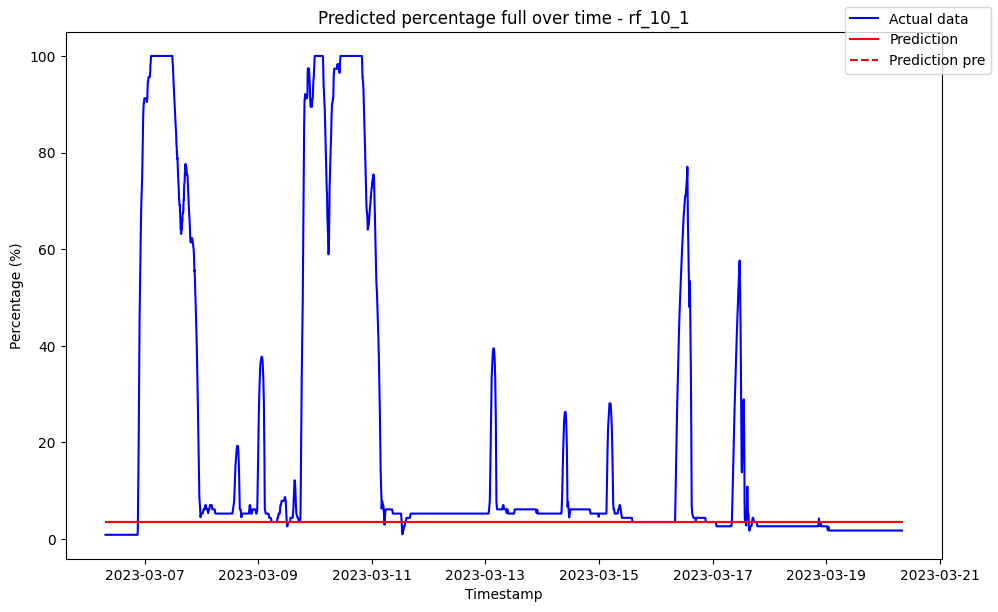

------------------------------------ rf_10_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.026503               0.0
1 2023-03-06 07:35:00            0.325219               0.0
2 2023-03-06 07:40:00            0.674321               0.0
3 2023-03-06 07:45:00            0.838176               0.0
4 2023-03-06 07:50:00            0.671072               0.0
5 2023-03-06 07:55:00            0.364063               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.22130914099180107
Variance (R²) score: 1.00


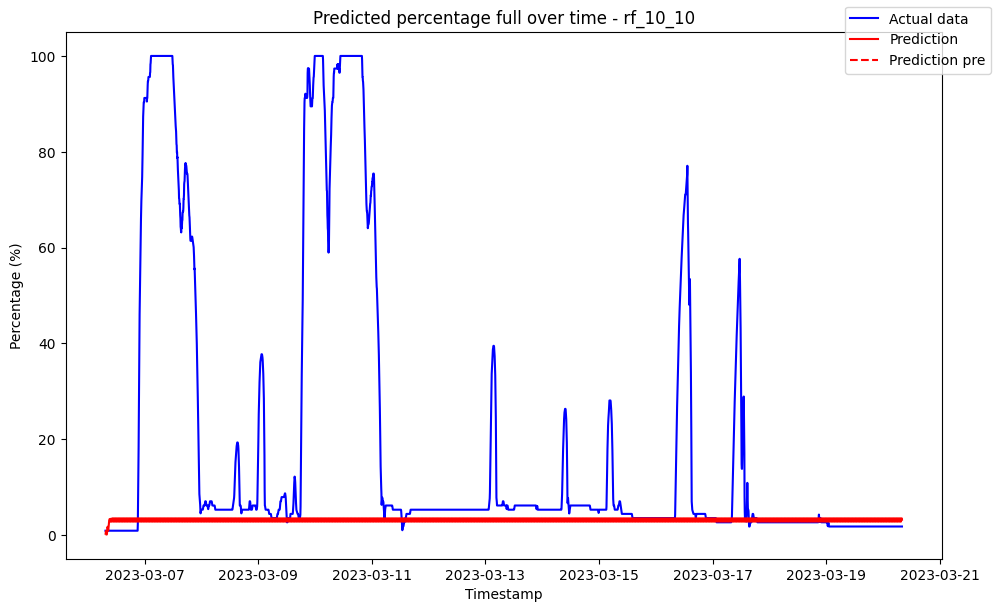

------------------------------------ rf_10_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.022541               0.0
1 2023-03-06 07:35:00            0.302860               0.0
2 2023-03-06 07:40:00            0.634013               0.0
3 2023-03-06 07:45:00            0.836247               0.0
4 2023-03-06 07:50:00            0.634665               0.0
5 2023-03-06 07:55:00            0.361861               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.1642500083748749
Variance (R²) score: 1.00


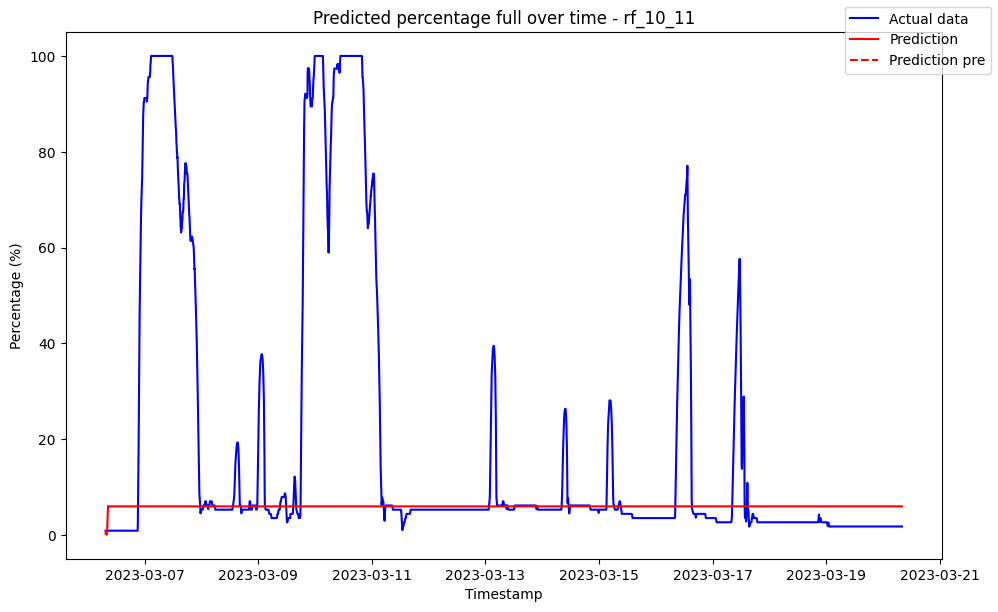

------------------------------------ rf_10_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.014327               0.0
1 2023-03-06 07:35:00            0.157924               0.0
2 2023-03-06 07:40:00            0.492664               0.0
3 2023-03-06 07:45:00            0.787213               0.0
4 2023-03-06 07:50:00            0.841791               0.0
5 2023-03-06 07:55:00            0.516602               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14103338038004648
Variance (R²) score: 1.00


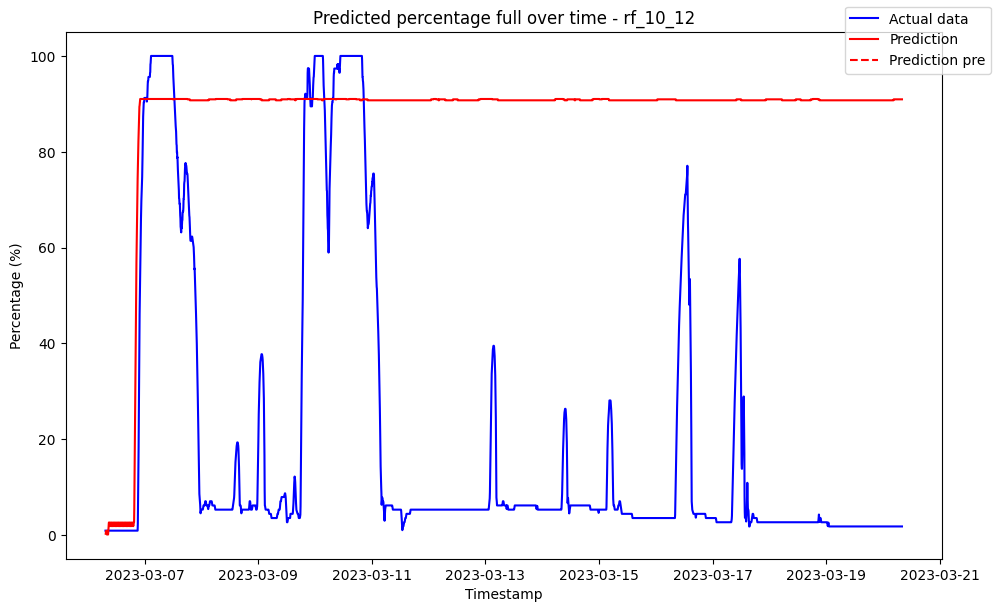

------------------------------------ rf_10_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.014775               0.0
1 2023-03-06 07:35:00            0.142396               0.0
2 2023-03-06 07:40:00            0.480639               0.0
3 2023-03-06 07:45:00            0.778230               0.0
4 2023-03-06 07:50:00            0.839259               0.0
5 2023-03-06 07:55:00            0.529170               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.127767638768035
Variance (R²) score: 1.00


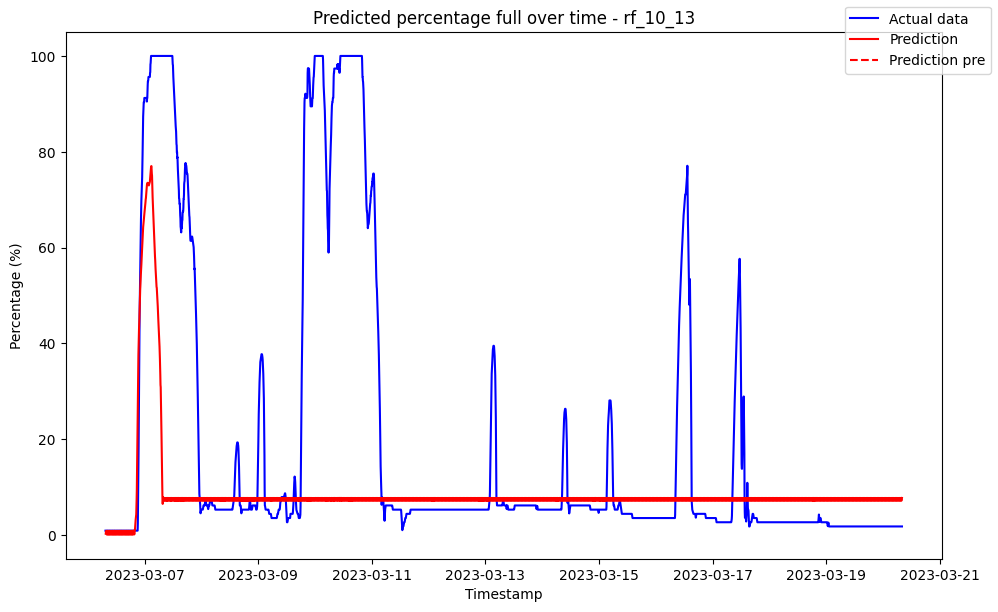

------------------------------------ rf_10_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013744               0.0
1 2023-03-06 07:35:00            0.139938               0.0
2 2023-03-06 07:40:00            0.489064               0.0
3 2023-03-06 07:45:00            0.870374               0.0
4 2023-03-06 07:50:00            0.915240               0.0
5 2023-03-06 07:55:00            1.230507               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11198241364371554
Variance (R²) score: 1.00


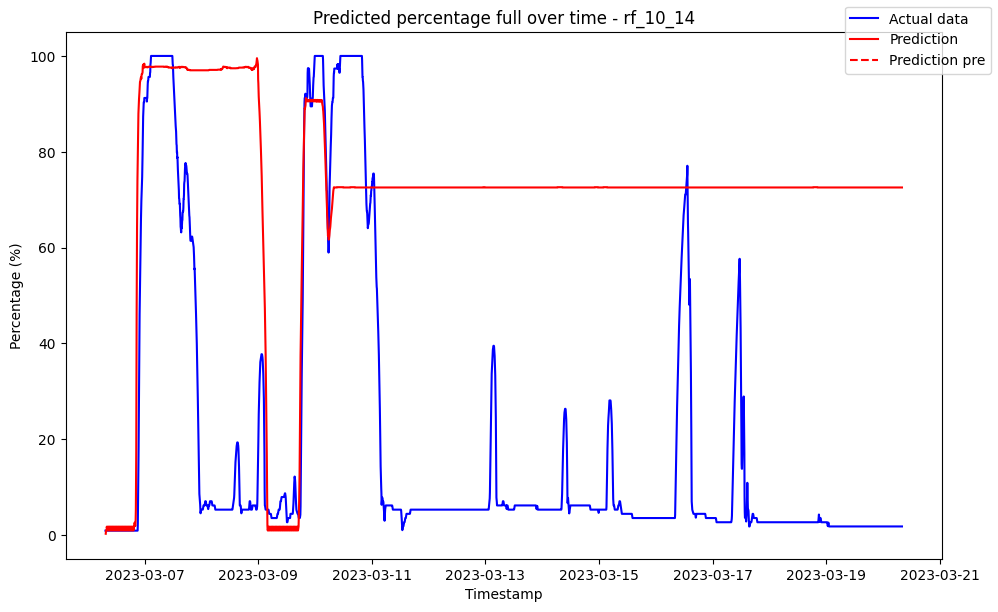

------------------------------------ rf_10_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010178               0.0
1 2023-03-06 07:35:00            0.129100               0.0
2 2023-03-06 07:40:00            0.484900               0.0
3 2023-03-06 07:45:00            0.922269               0.0
4 2023-03-06 07:50:00            2.250079               0.0
5 2023-03-06 07:55:00            3.760525               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10316398807317735
Variance (R²) score: 1.00


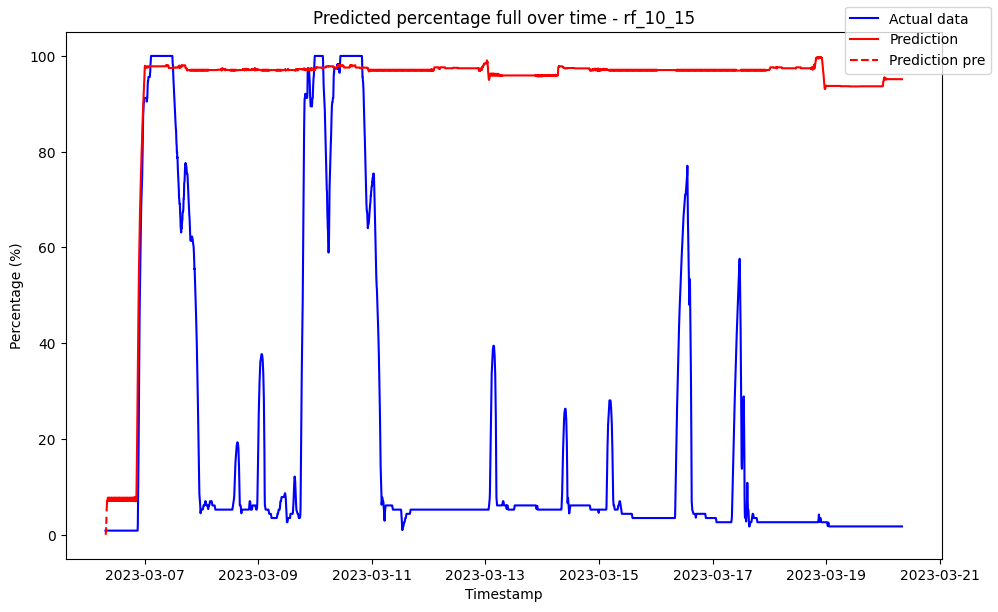

------------------------------------ rf_10_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010792               0.0
1 2023-03-06 07:35:00            0.155220               0.0
2 2023-03-06 07:40:00            0.461466               0.0
3 2023-03-06 07:45:00            0.749645               0.0
4 2023-03-06 07:50:00            0.845879               0.0
5 2023-03-06 07:55:00            0.706131               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1099509439965234
Variance (R²) score: 1.00


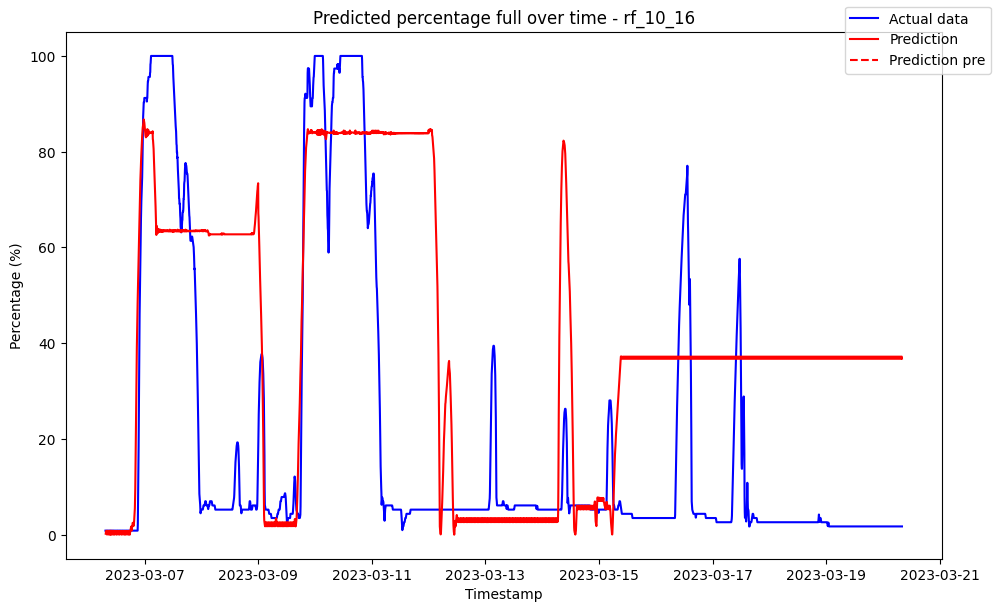

------------------------------------ rf_10_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.008325               0.0
1 2023-03-06 07:35:00            0.143602               0.0
2 2023-03-06 07:40:00            0.504082               0.0
3 2023-03-06 07:45:00            0.776487               0.0
4 2023-03-06 07:50:00            0.846385               0.0
5 2023-03-06 07:55:00            0.589421               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09254673122674735
Variance (R²) score: 1.00


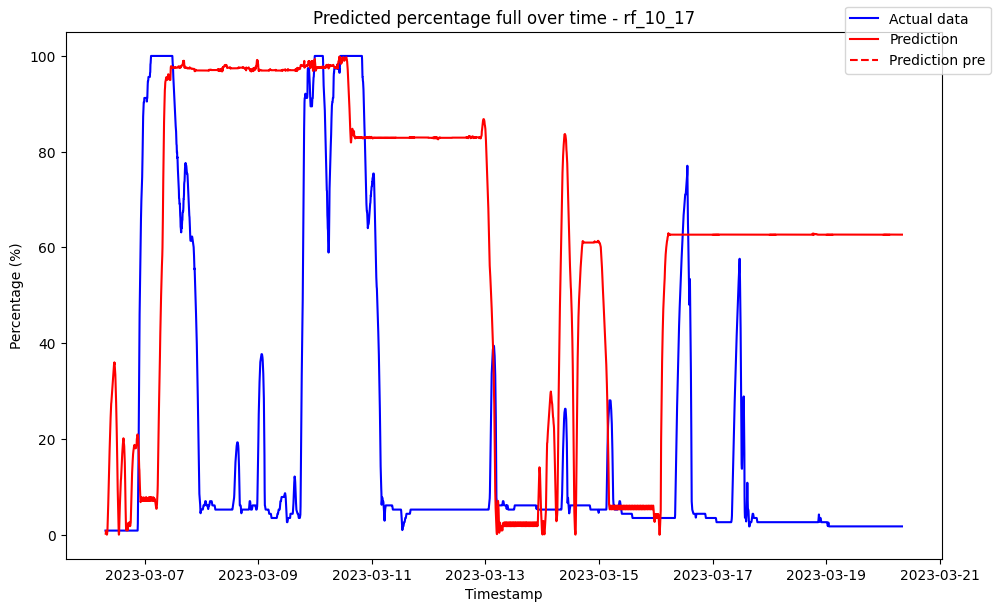

------------------------------------ rf_10_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009297               0.0
1 2023-03-06 07:35:00            0.151699               0.0
2 2023-03-06 07:40:00            0.512034               0.0
3 2023-03-06 07:45:00            0.775646               0.0
4 2023-03-06 07:50:00            0.845884               0.0
5 2023-03-06 07:55:00            0.714778               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10920026120416994
Variance (R²) score: 1.00


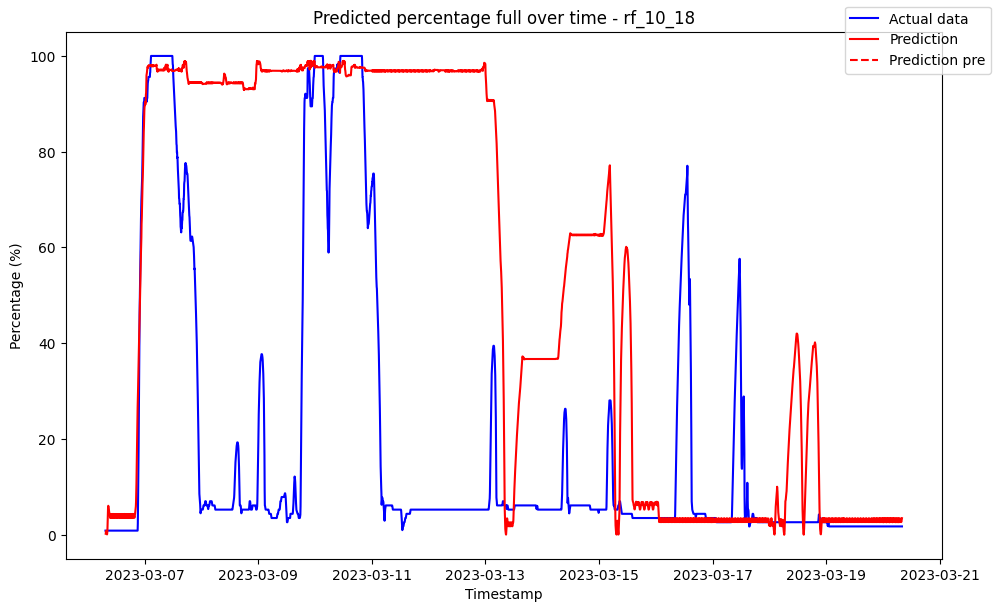

------------------------------------ rf_10_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006733               0.0
1 2023-03-06 07:35:00            0.132566               0.0
2 2023-03-06 07:40:00            0.504921               0.0
3 2023-03-06 07:45:00            0.850455               0.0
4 2023-03-06 07:50:00            0.950680               0.0
5 2023-03-06 07:55:00            1.261751               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09366888156568802
Variance (R²) score: 1.00


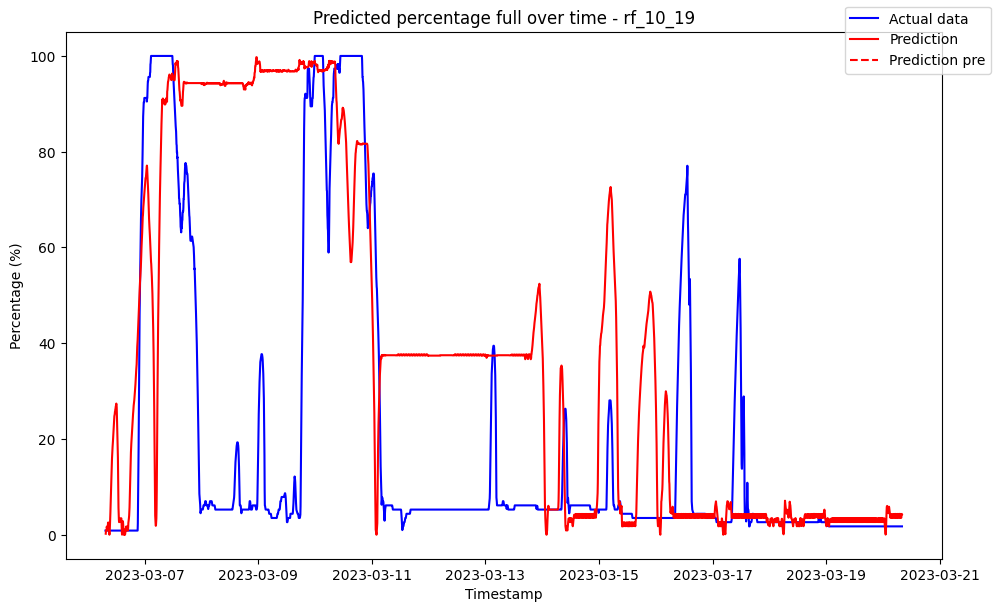

------------------------------------ rf_10_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00             1.16581               0.0
1 2023-03-06 07:35:00             1.16581               0.0
2 2023-03-06 07:40:00             1.16581               0.0
3 2023-03-06 07:45:00             1.16581               0.0
4 2023-03-06 07:50:00             1.16581               0.0
5 2023-03-06 07:55:00             1.16581               0.0

Metrics for this specific prediction:
Accuracy: 96.62%
Mean squared error: 34.562560641461
Variance (R²) score: 0.97


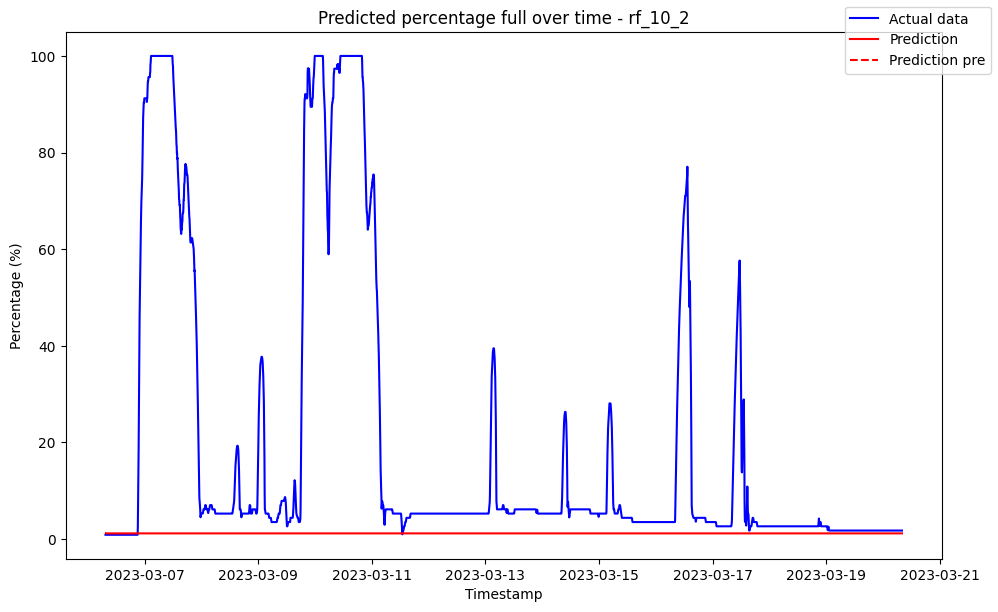

------------------------------------ rf_10_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010450               0.0
1 2023-03-06 07:35:00            0.144929               0.0
2 2023-03-06 07:40:00            0.504579               0.0
3 2023-03-06 07:45:00            0.766173               0.0
4 2023-03-06 07:50:00            0.847177               0.0
5 2023-03-06 07:55:00            0.477176               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09489332605206978
Variance (R²) score: 1.00


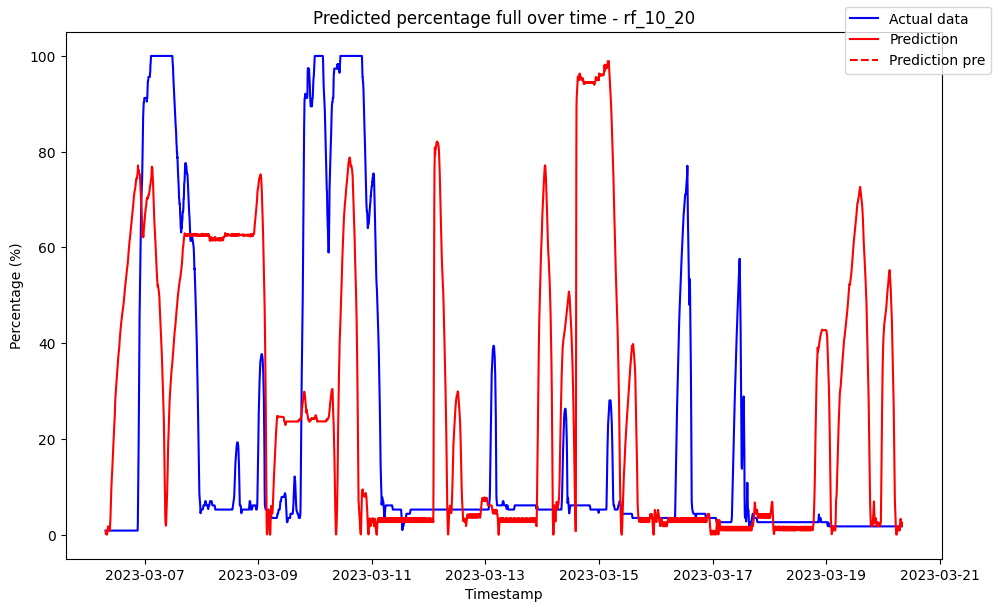

------------------------------------ rf_10_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.003449               0.0
1 2023-03-06 07:35:00            0.109273               0.0
2 2023-03-06 07:40:00            0.377749               0.0
3 2023-03-06 07:45:00            0.677667               0.0
4 2023-03-06 07:50:00            0.838710               0.0
5 2023-03-06 07:55:00            0.533442               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12331607617807339
Variance (R²) score: 1.00


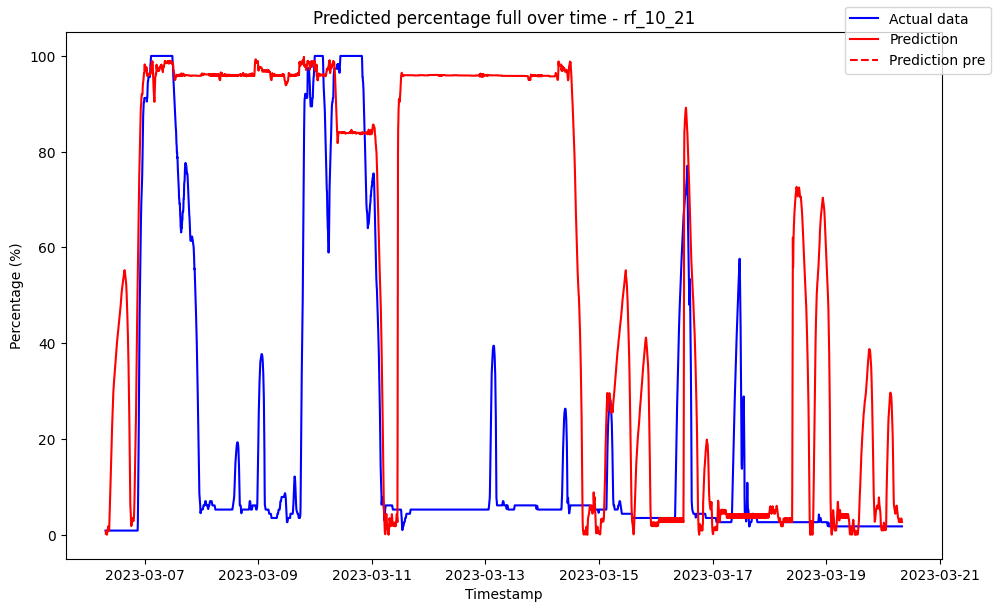

------------------------------------ rf_10_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004838               0.0
1 2023-03-06 07:35:00            0.145933               0.0
2 2023-03-06 07:40:00            0.503094               0.0
3 2023-03-06 07:45:00            0.772671               0.0
4 2023-03-06 07:50:00            0.853996               0.0
5 2023-03-06 07:55:00            0.917300               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1037887696827875
Variance (R²) score: 1.00


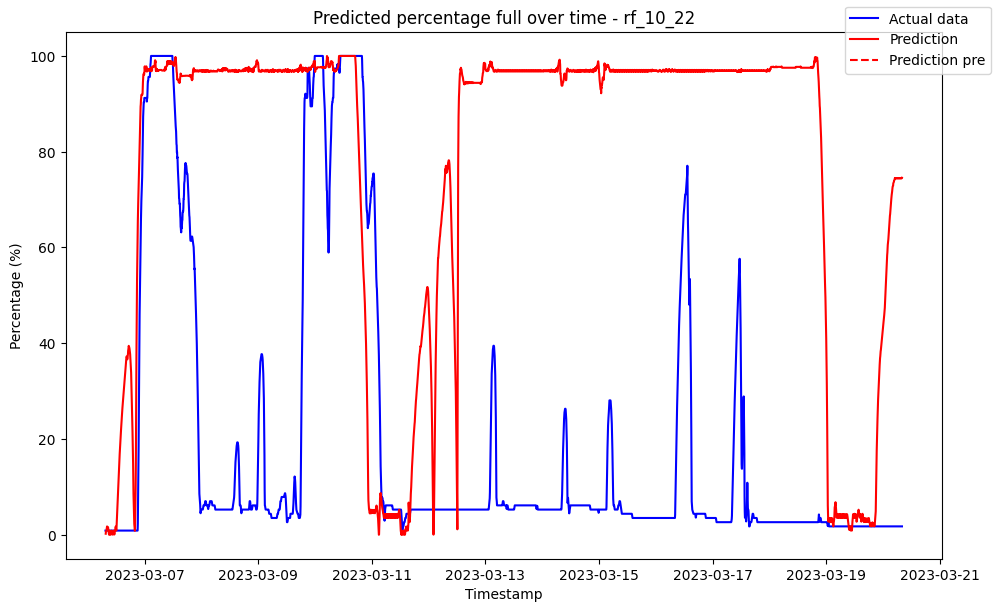

------------------------------------ rf_10_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000336               0.0
1 2023-03-06 07:35:00            0.000336               0.0
2 2023-03-06 07:40:00            0.000336               0.0
3 2023-03-06 07:45:00            0.000336               0.0
4 2023-03-06 07:50:00            0.000336               0.0
5 2023-03-06 07:55:00            0.000336               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0903194608214883
Variance (R²) score: 1.00


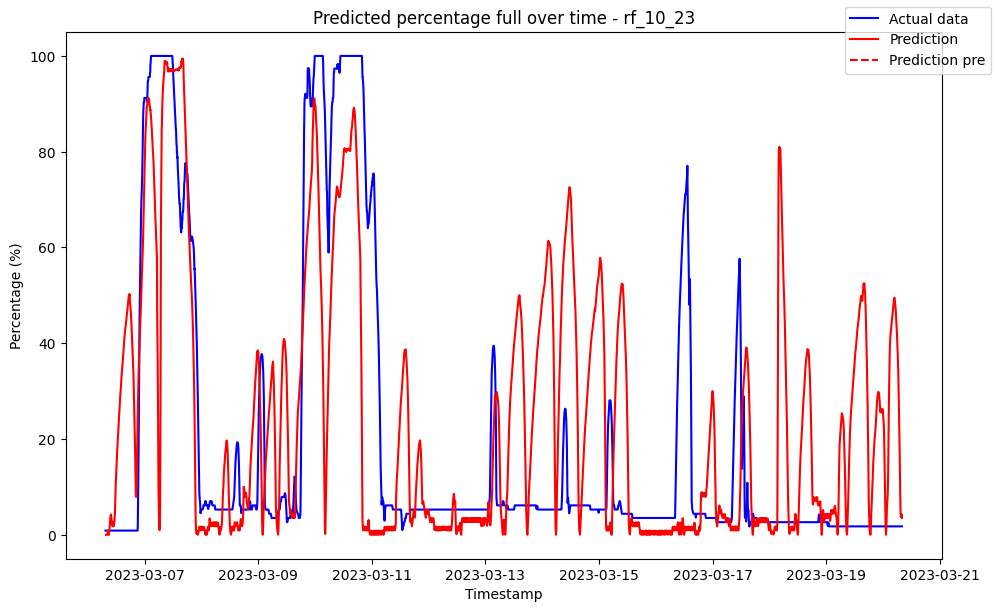

------------------------------------ rf_10_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000687               0.0
1 2023-03-06 07:35:00            0.088770               0.0
2 2023-03-06 07:40:00            0.617100               0.0
3 2023-03-06 07:45:00            2.790600               0.0
4 2023-03-06 07:50:00            6.017600               0.0
5 2023-03-06 07:55:00            9.611800               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10393705068081811
Variance (R²) score: 1.00


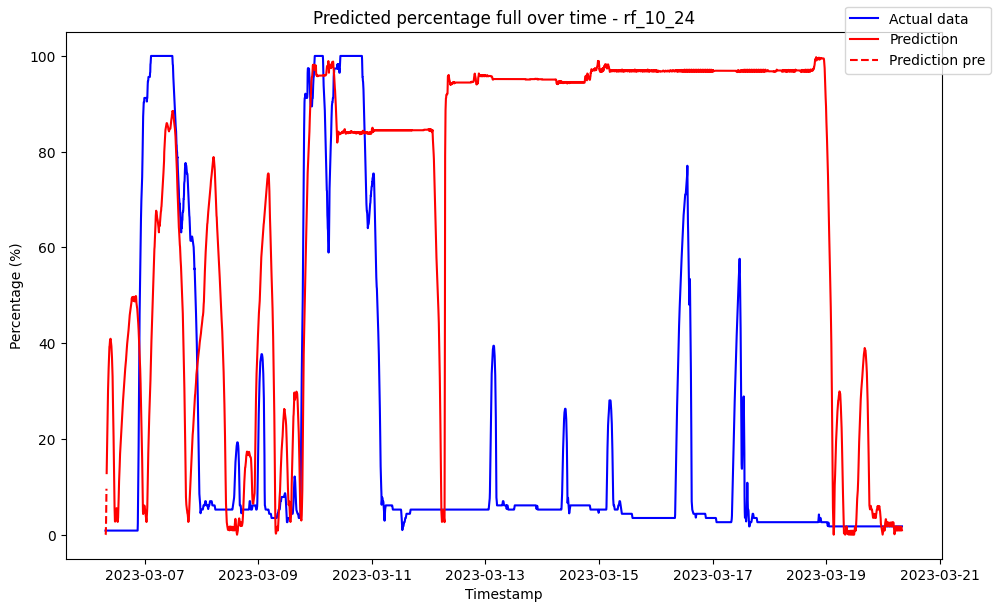

------------------------------------ rf_10_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000058               0.0
1 2023-03-06 07:35:00            0.000058               0.0
2 2023-03-06 07:40:00            0.000058               0.0
3 2023-03-06 07:45:00            0.000058               0.0
4 2023-03-06 07:50:00            0.000058               0.0
5 2023-03-06 07:55:00            0.000058               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10002727239999988
Variance (R²) score: 1.00


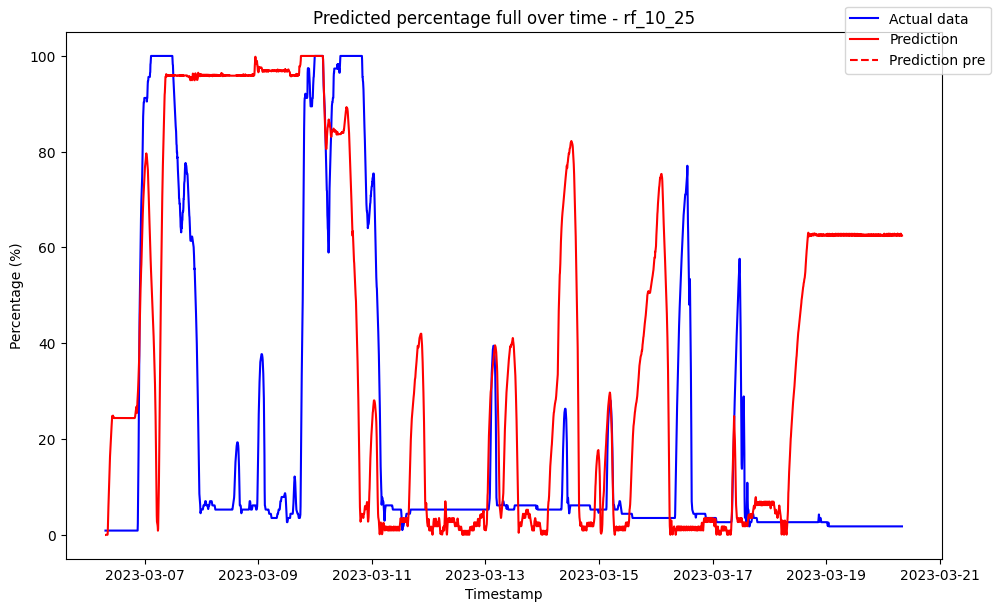

------------------------------------ rf_10_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000234               0.0
1 2023-03-06 07:35:00            0.000234               0.0
2 2023-03-06 07:40:00            0.000234               0.0
3 2023-03-06 07:45:00            0.000234               0.0
4 2023-03-06 07:50:00            0.000234               0.0
5 2023-03-06 07:55:00            0.000234               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11257708139637579
Variance (R²) score: 1.00


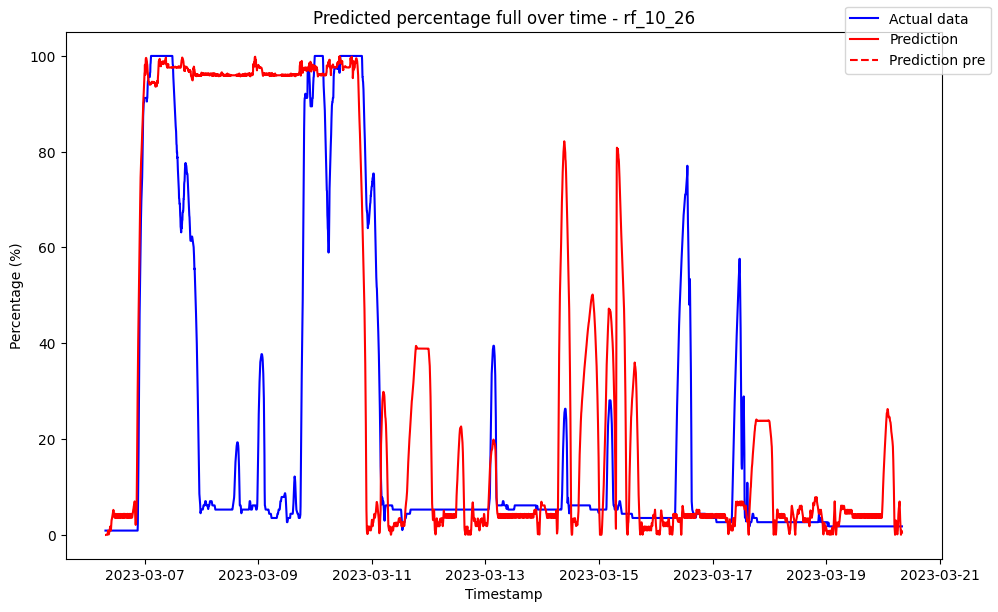

------------------------------------ rf_10_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09557439428954488
Variance (R²) score: 1.00


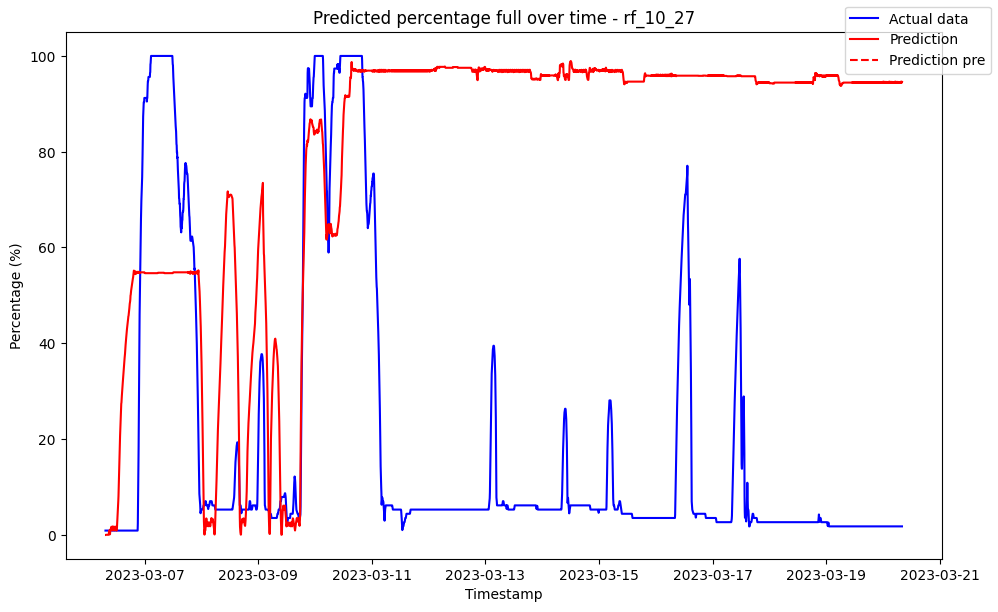

------------------------------------ rf_10_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10847619672341116
Variance (R²) score: 1.00


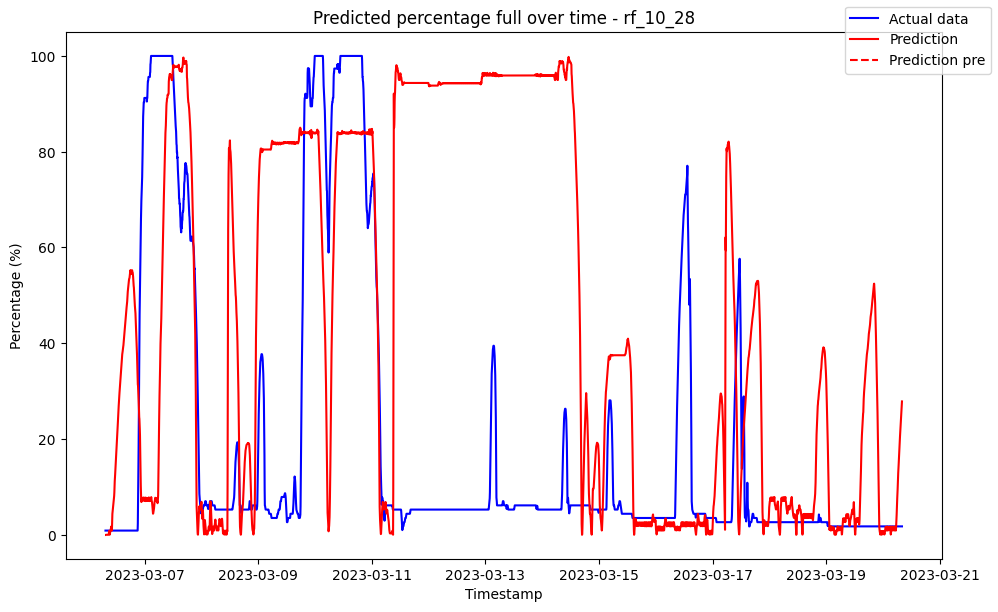

------------------------------------ rf_10_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1117942420192833
Variance (R²) score: 1.00


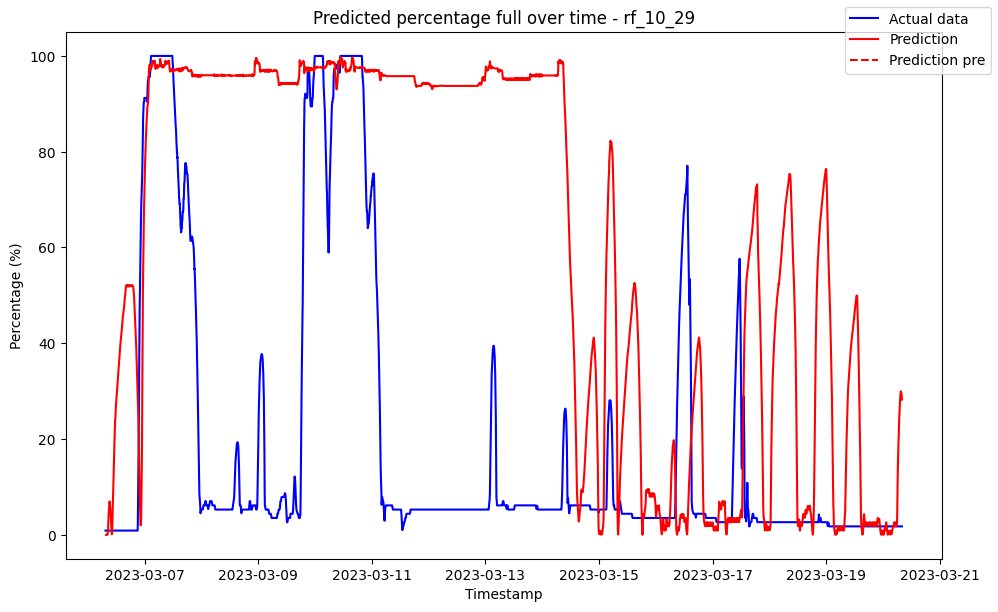

------------------------------------ rf_10_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.361137               0.0
1 2023-03-06 07:35:00            0.361137               0.0
2 2023-03-06 07:40:00            0.361137               0.0
3 2023-03-06 07:45:00            0.361137               0.0
4 2023-03-06 07:50:00            0.361137               0.0
5 2023-03-06 07:55:00            0.361137               0.0

Metrics for this specific prediction:
Accuracy: 99.41%
Mean squared error: 5.98027722815766
Variance (R²) score: 0.99


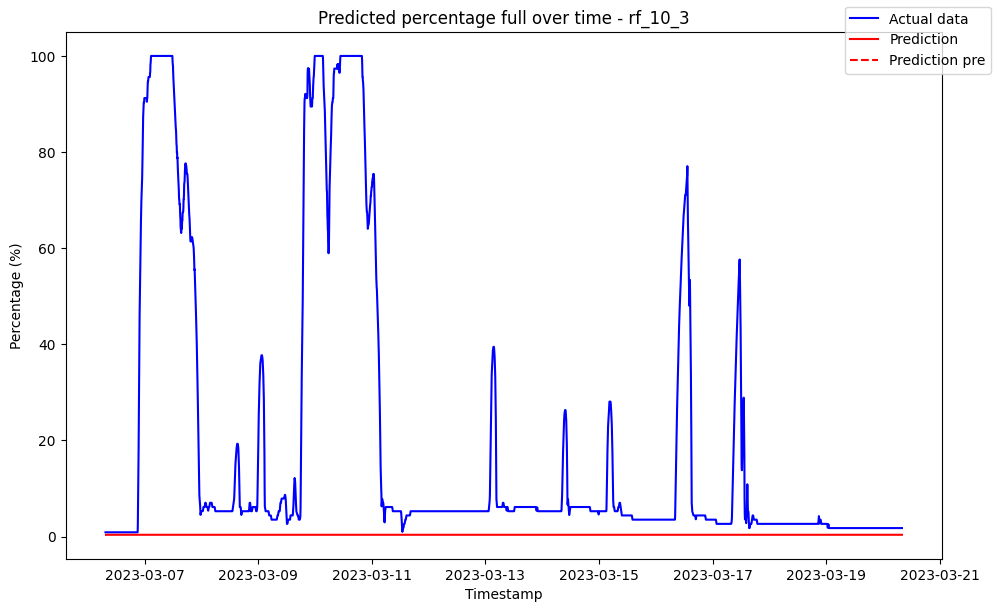

------------------------------------ rf_10_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10898909106882868
Variance (R²) score: 1.00


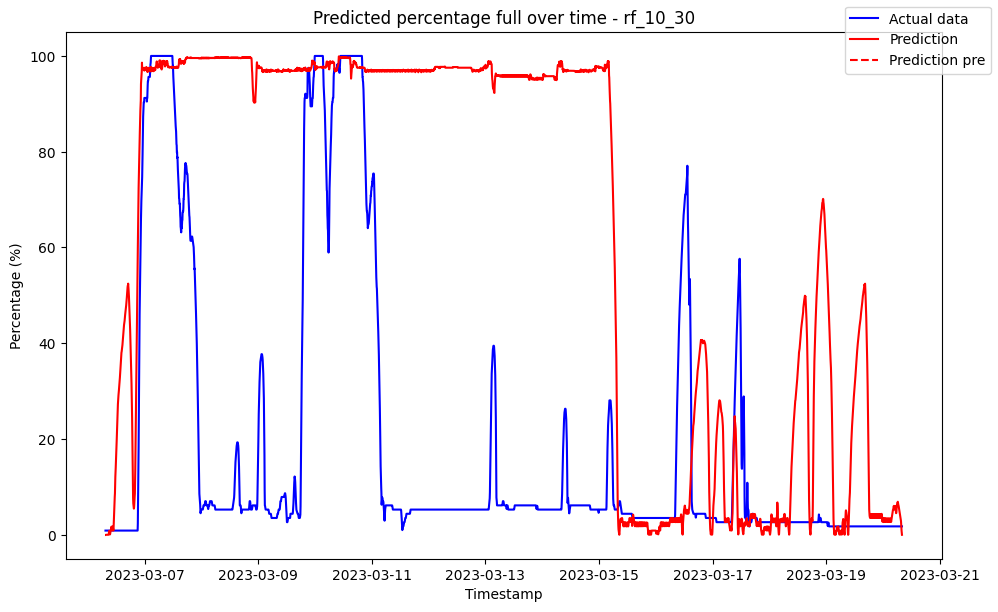

------------------------------------ rf_10_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11264190139147466
Variance (R²) score: 1.00


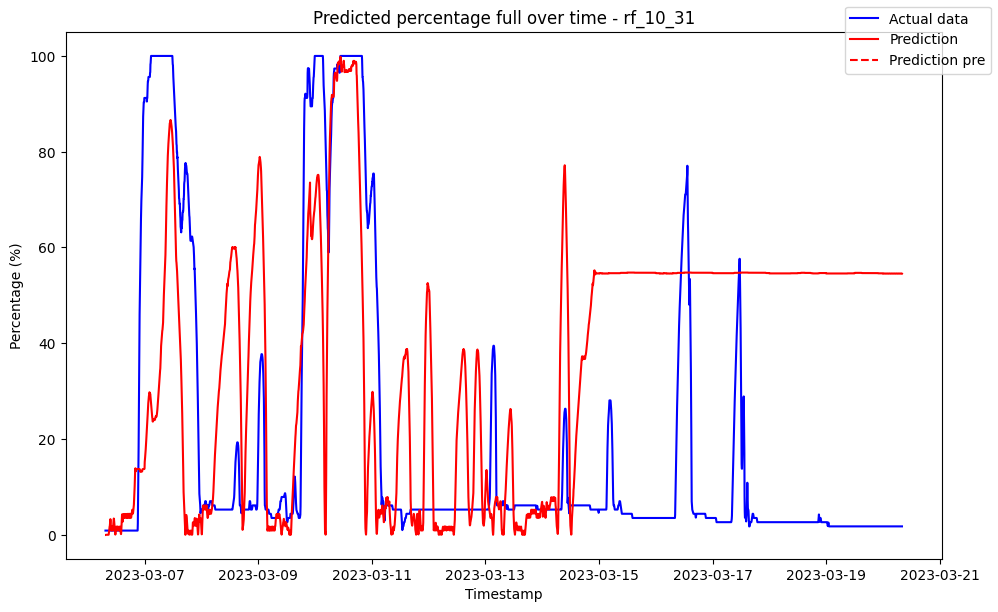

------------------------------------ rf_10_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10244856261668384
Variance (R²) score: 1.00


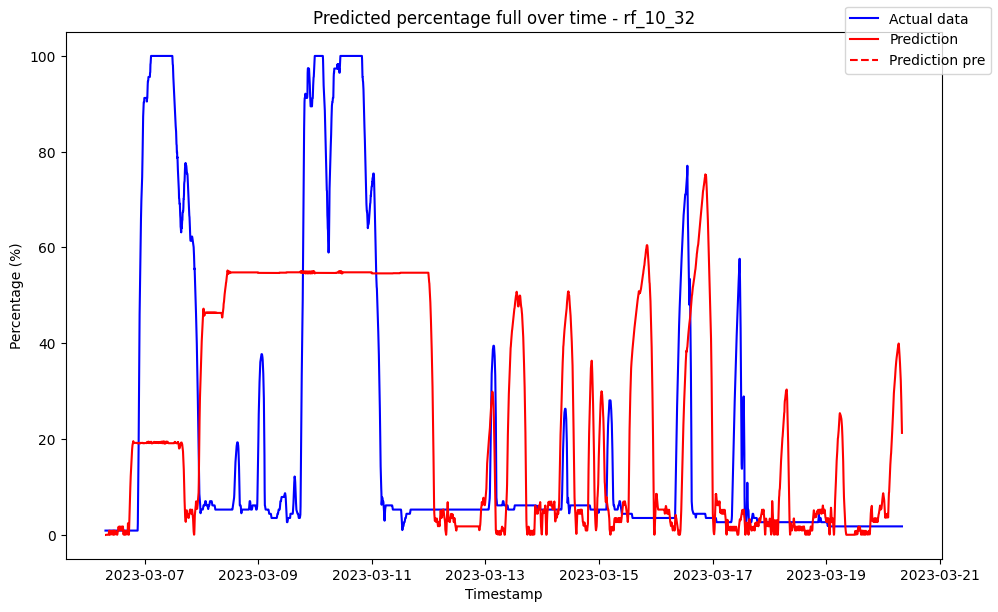

------------------------------------ rf_10_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10485625175636548
Variance (R²) score: 1.00


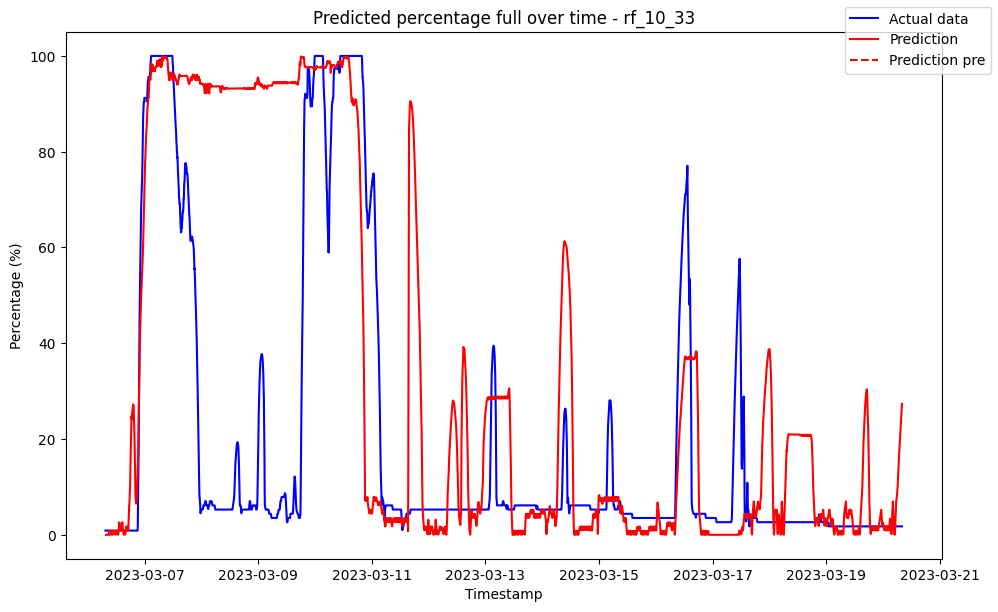

------------------------------------ rf_10_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10353267366431446
Variance (R²) score: 1.00


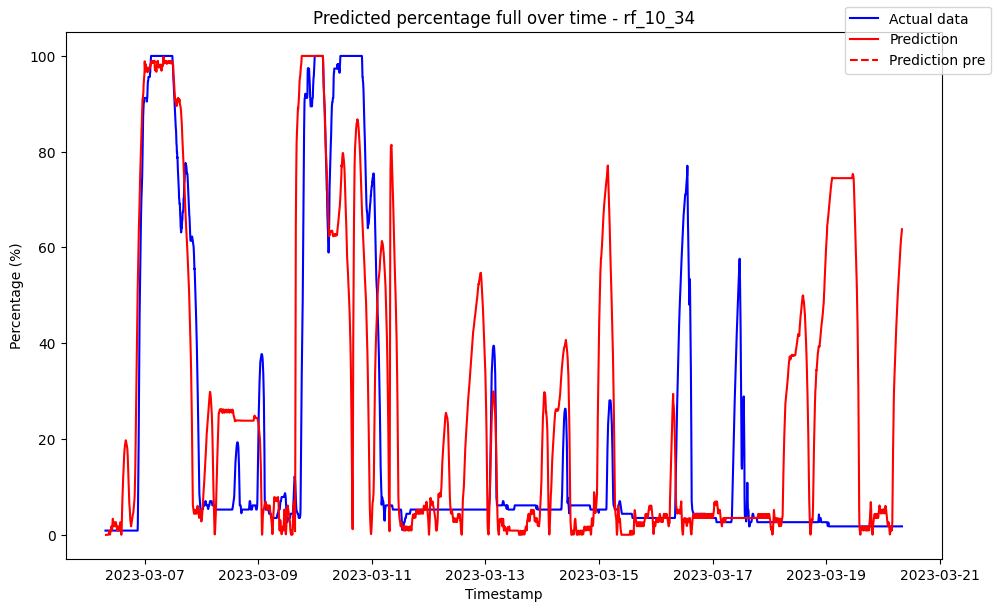

------------------------------------ rf_10_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11737737047937577
Variance (R²) score: 1.00


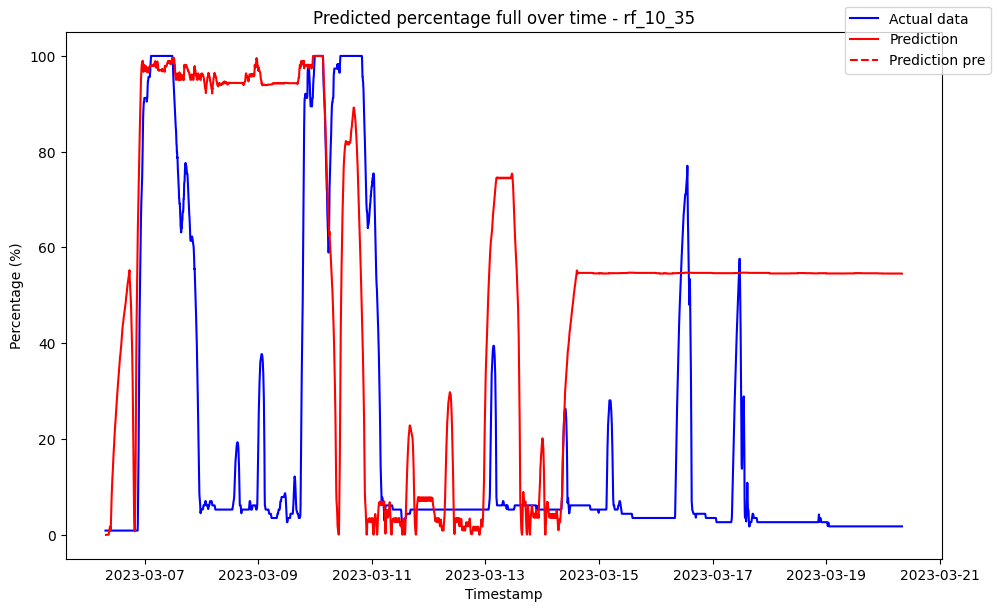

------------------------------------ rf_10_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11091533172990424
Variance (R²) score: 1.00


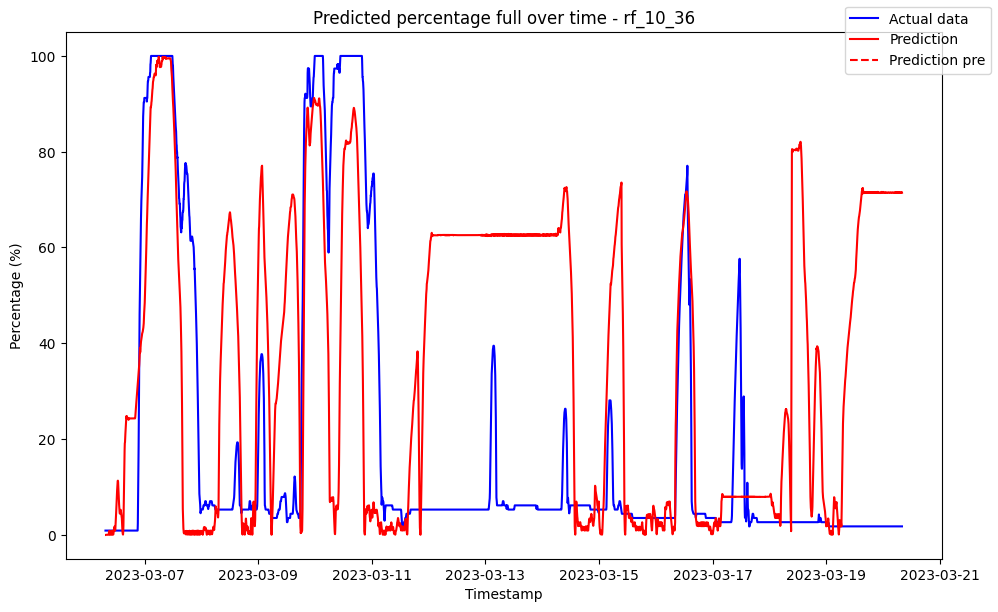

------------------------------------ rf_10_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10310627272634426
Variance (R²) score: 1.00


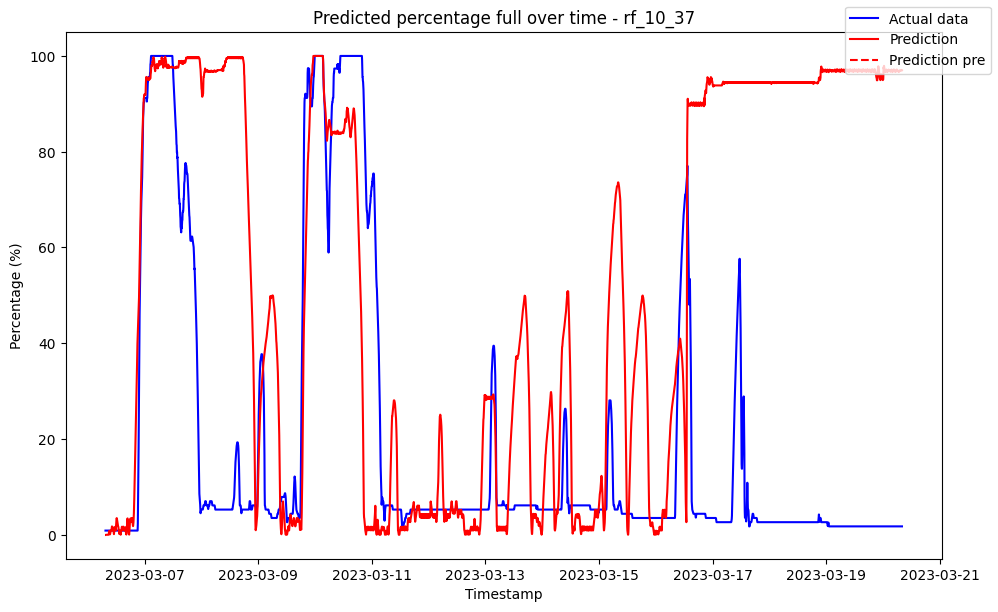

------------------------------------ rf_10_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09676492596404417
Variance (R²) score: 1.00


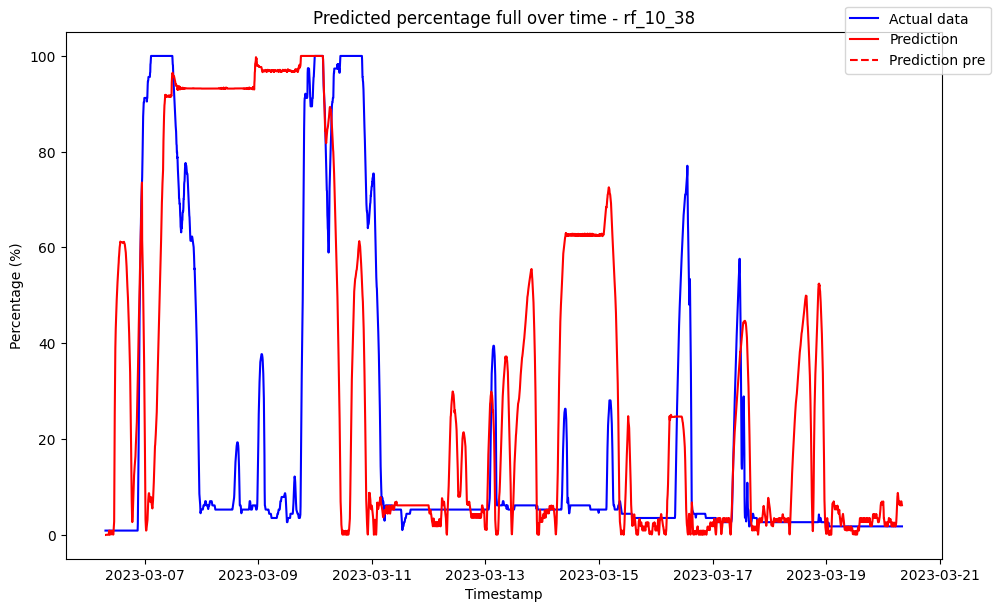

------------------------------------ rf_10_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10222682800814718
Variance (R²) score: 1.00


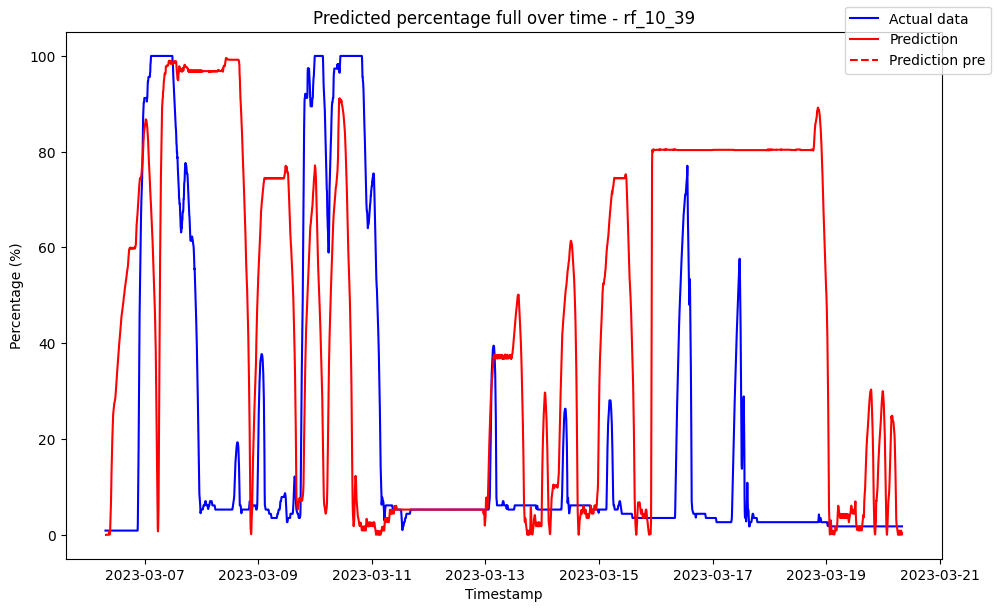

------------------------------------ rf_10_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019138               0.0
1 2023-03-06 07:35:00            0.019138               0.0
2 2023-03-06 07:40:00            0.019138               0.0
3 2023-03-06 07:45:00            0.019138               0.0
4 2023-03-06 07:50:00            0.019138               0.0
5 2023-03-06 07:55:00            0.019138               0.0

Metrics for this specific prediction:
Accuracy: 99.8%
Mean squared error: 2.021726032011463
Variance (R²) score: 1.00


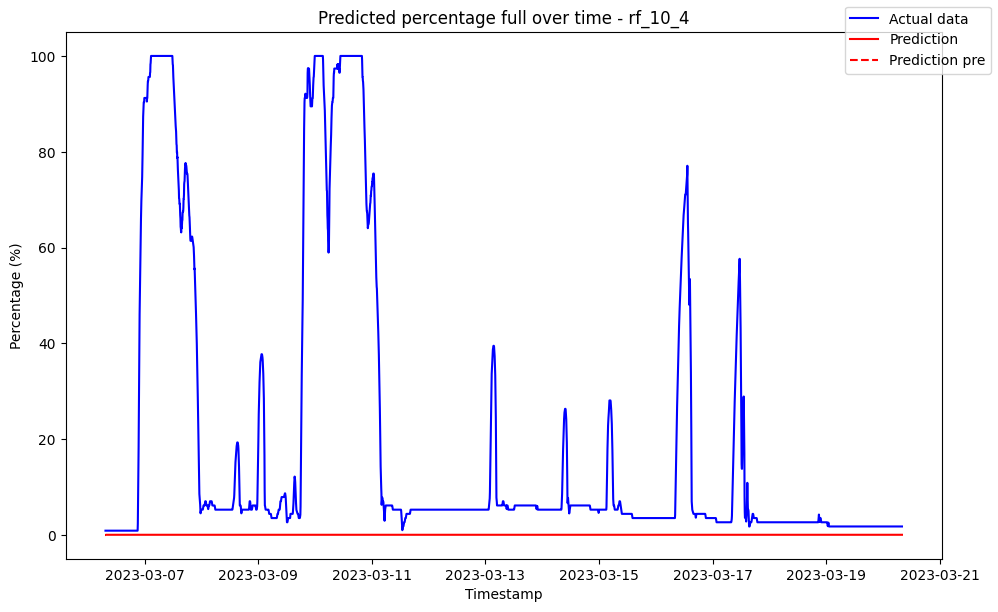

------------------------------------ rf_10_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09670338342081154
Variance (R²) score: 1.00


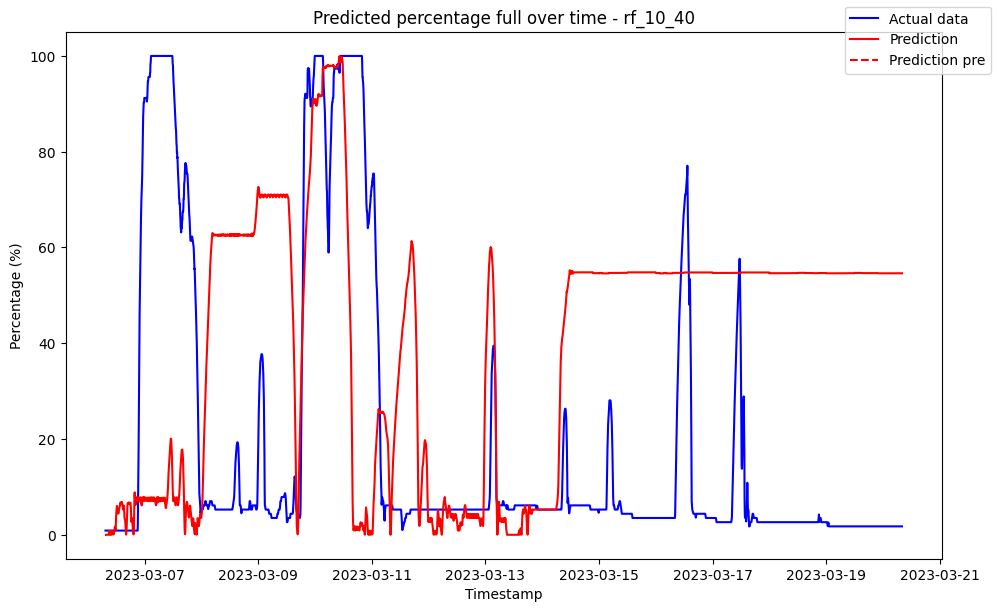

------------------------------------ rf_10_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11048190361384866
Variance (R²) score: 1.00


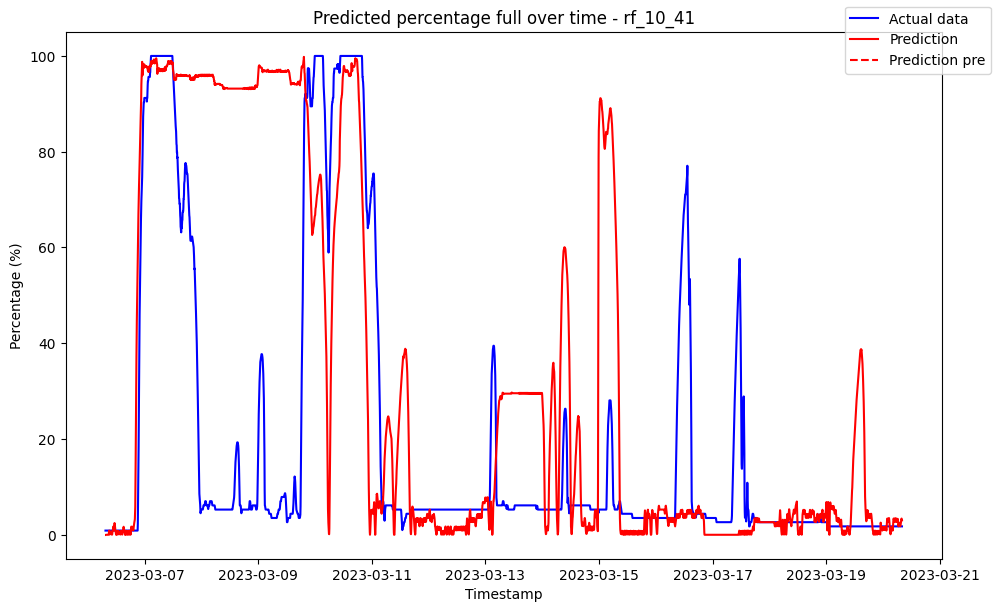

------------------------------------ rf_10_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10805205045633616
Variance (R²) score: 1.00


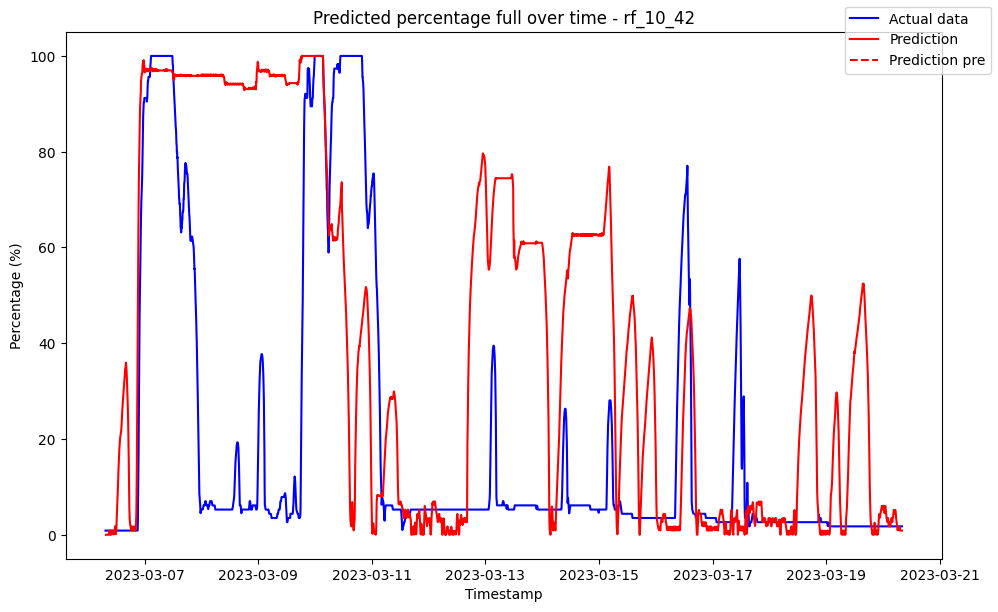

------------------------------------ rf_10_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10964334717008828
Variance (R²) score: 1.00


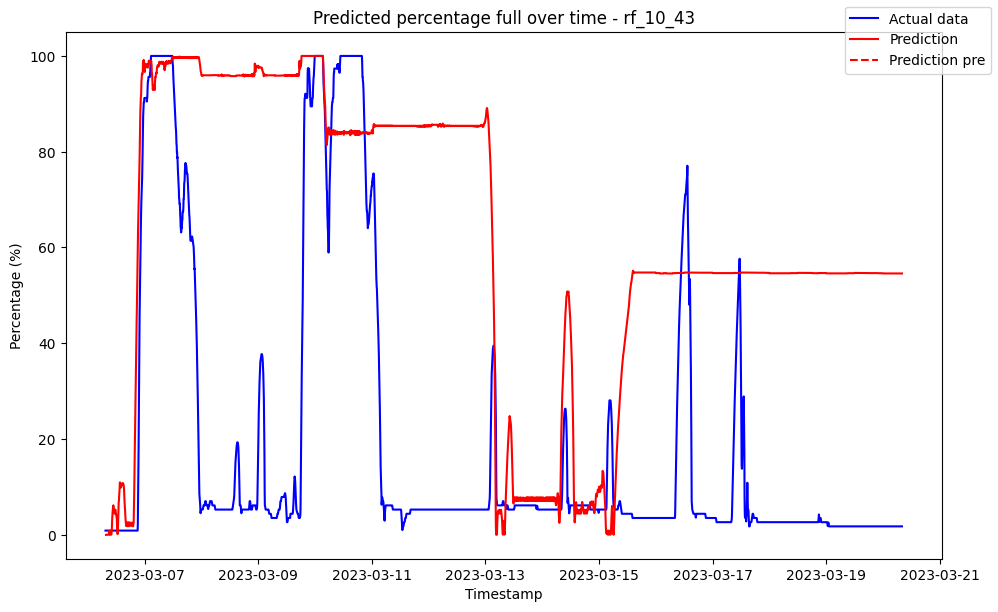

------------------------------------ rf_10_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11263528858682494
Variance (R²) score: 1.00


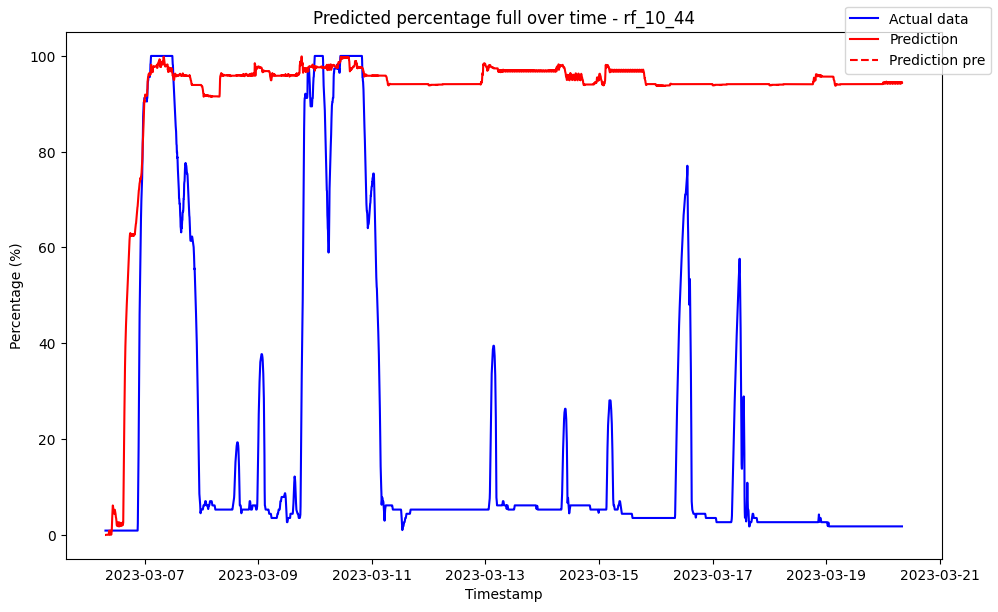

------------------------------------ rf_10_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10393528811646013
Variance (R²) score: 1.00


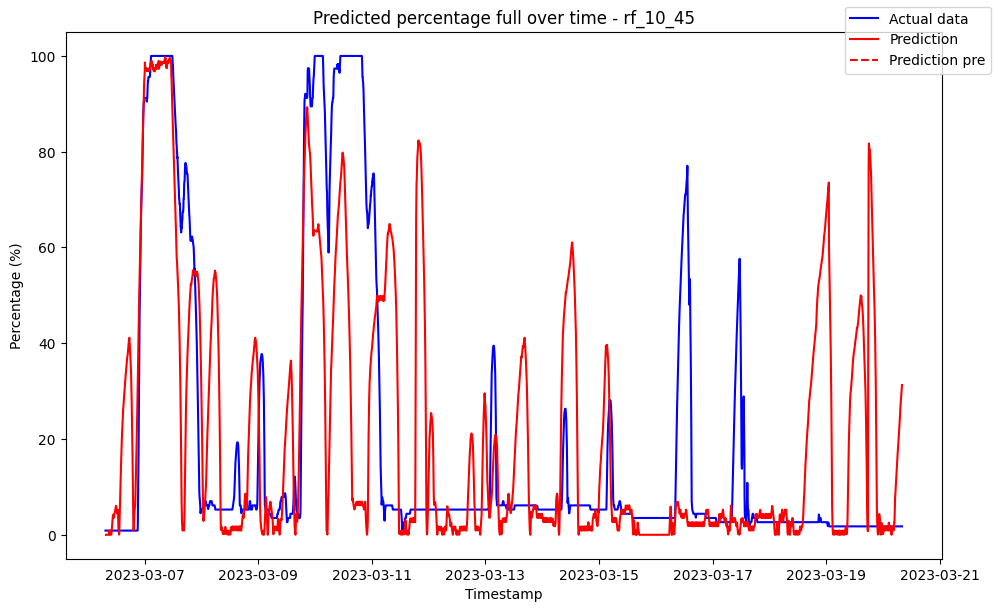

------------------------------------ rf_10_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0776868593017266
Variance (R²) score: 1.00


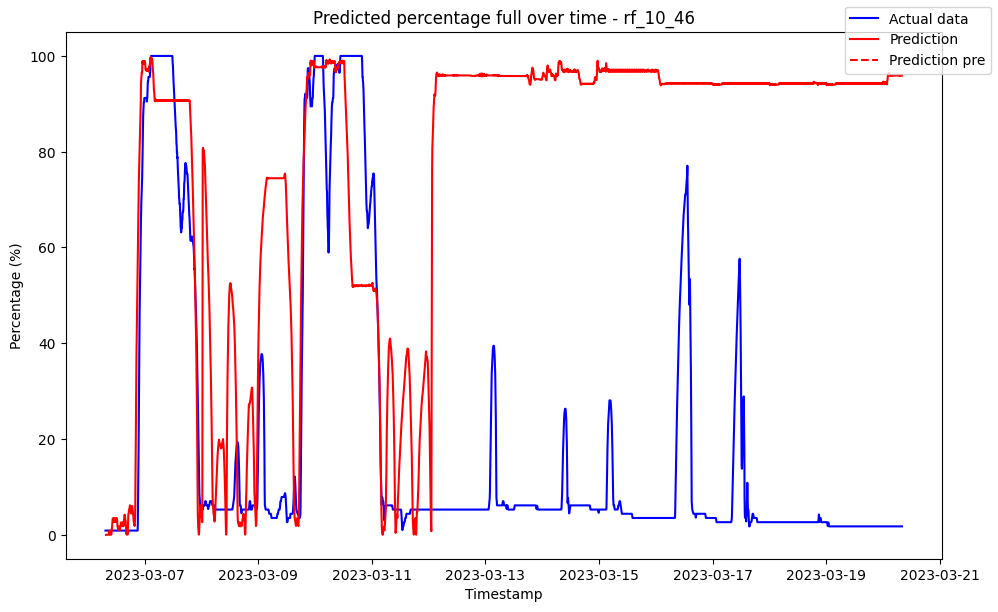

------------------------------------ rf_10_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11122900391699009
Variance (R²) score: 1.00


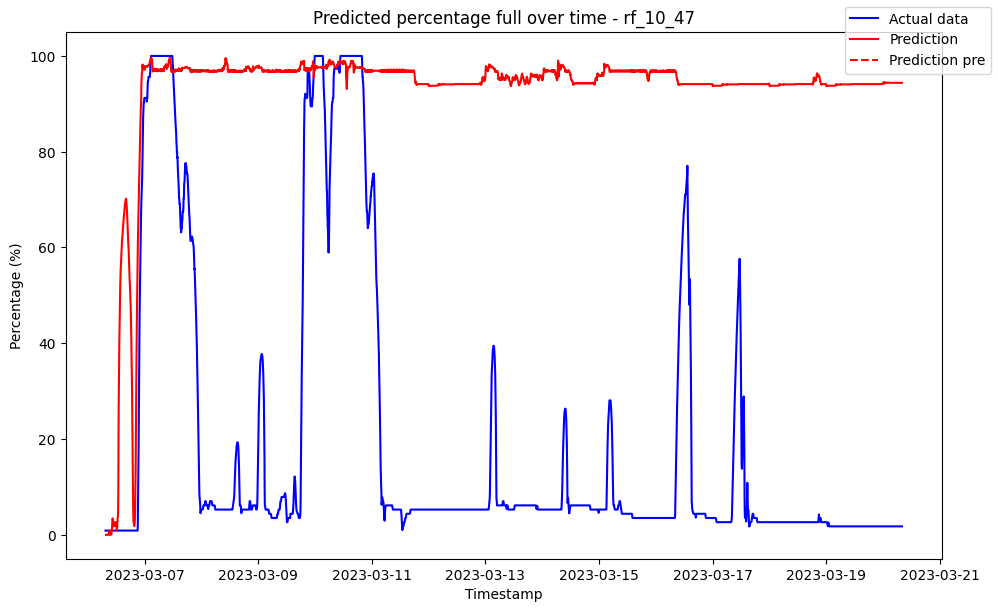

------------------------------------ rf_10_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11197877507002835
Variance (R²) score: 1.00


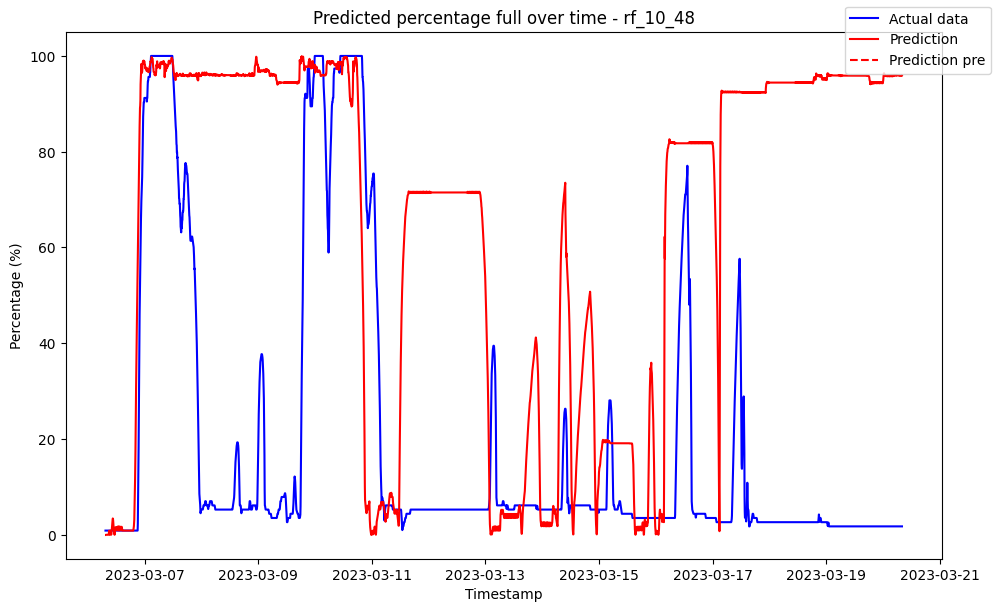

------------------------------------ rf_10_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10425768966218424
Variance (R²) score: 1.00


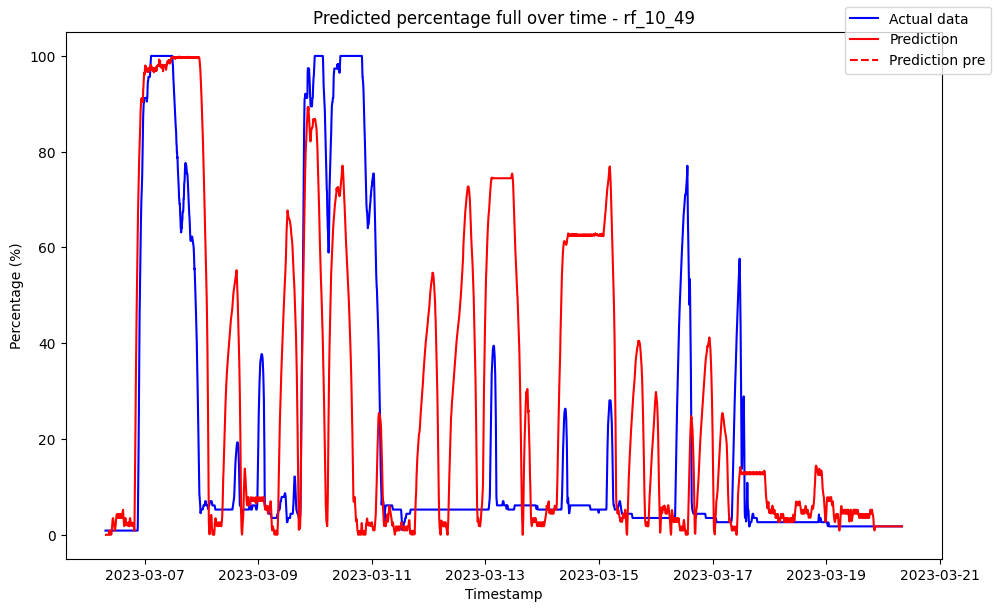

------------------------------------ rf_10_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.017572               0.0
1 2023-03-06 07:35:00            0.017572               0.0
2 2023-03-06 07:40:00            0.017572               0.0
3 2023-03-06 07:45:00            0.017572               0.0
4 2023-03-06 07:50:00            0.017572               0.0
5 2023-03-06 07:55:00            0.017572               0.0

Metrics for this specific prediction:
Accuracy: 99.92%
Mean squared error: 0.807777252038657
Variance (R²) score: 1.00


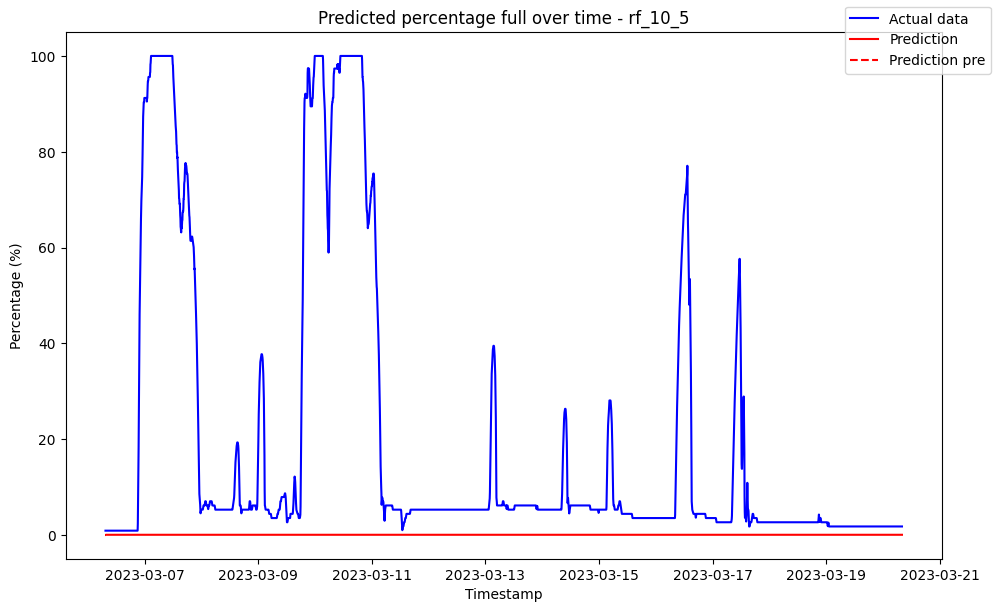

------------------------------------ rf_10_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10475083375214071
Variance (R²) score: 1.00


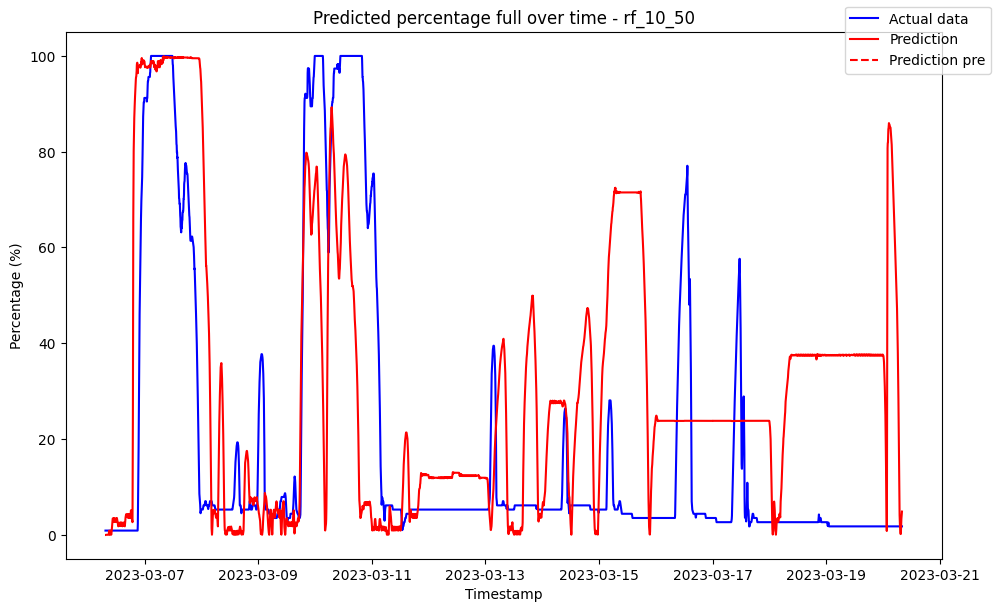

------------------------------------ rf_10_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009939               0.0
1 2023-03-06 07:35:00            0.044143               0.0
2 2023-03-06 07:40:00            0.281735               0.0
3 2023-03-06 07:45:00            0.326020               0.0
4 2023-03-06 07:50:00            0.326020               0.0
5 2023-03-06 07:55:00            0.326020               0.0

Metrics for this specific prediction:
Accuracy: 99.94%
Mean squared error: 0.6005453805887668
Variance (R²) score: 1.00


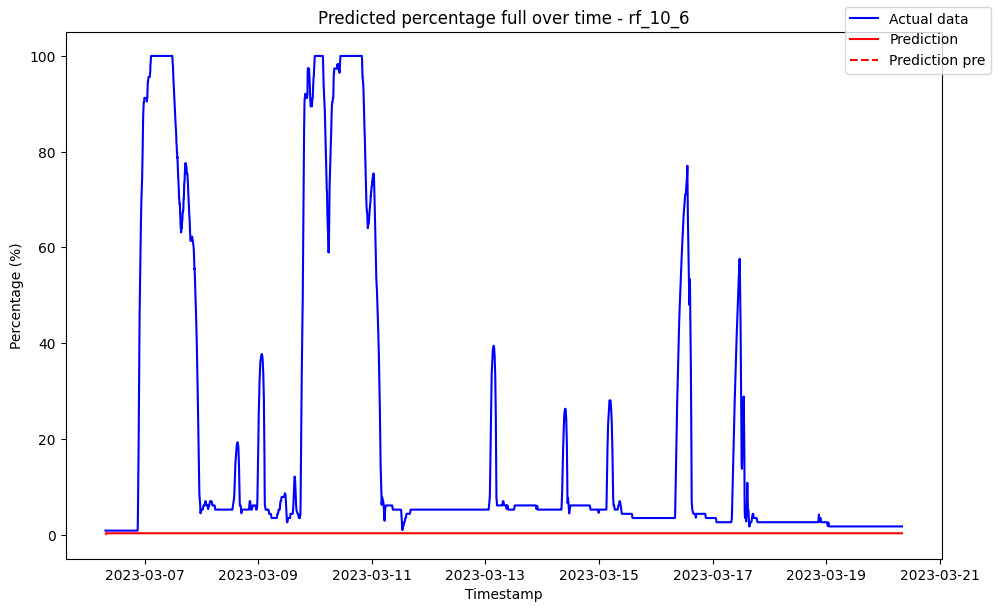

------------------------------------ rf_10_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007206               0.0
1 2023-03-06 07:35:00            0.099643               0.0
2 2023-03-06 07:40:00            0.627951               0.0
3 2023-03-06 07:45:00            0.958567               0.0
4 2023-03-06 07:50:00            0.916159               0.0
5 2023-03-06 07:55:00            0.916159               0.0

Metrics for this specific prediction:
Accuracy: 99.96%
Mean squared error: 0.45022466768202163
Variance (R²) score: 1.00


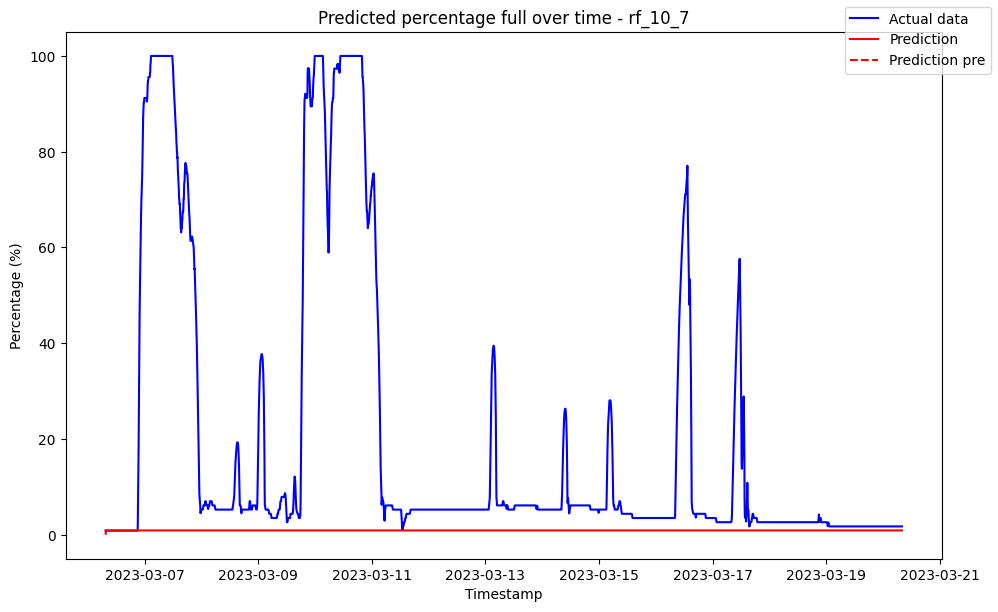

------------------------------------ rf_10_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006459               0.0
1 2023-03-06 07:35:00            0.122654               0.0
2 2023-03-06 07:40:00            0.580373               0.0
3 2023-03-06 07:45:00            0.912115               0.0
4 2023-03-06 07:50:00            1.099231               0.0
5 2023-03-06 07:55:00            1.099231               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.33762735407027716
Variance (R²) score: 1.00


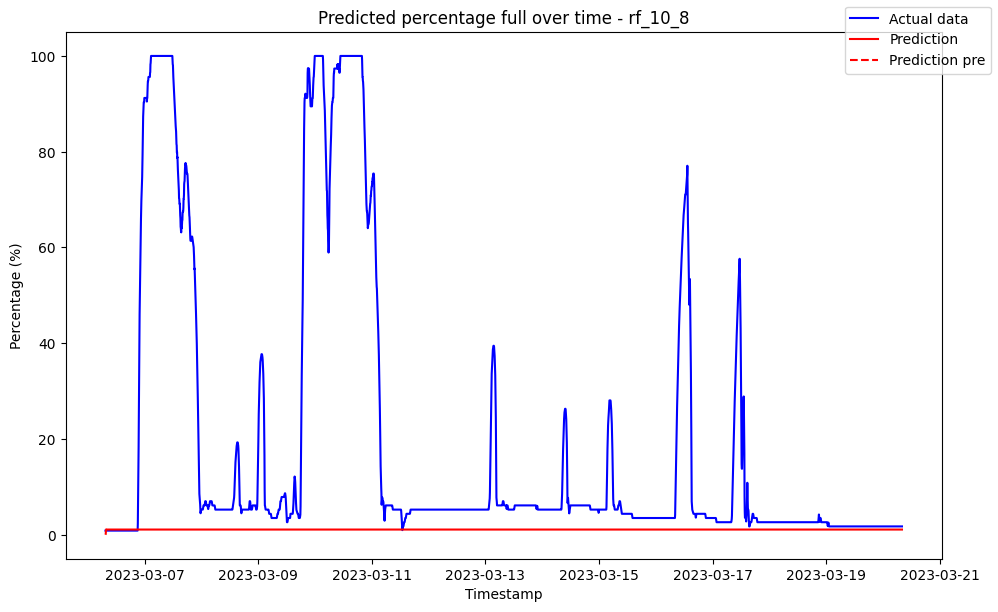

------------------------------------ rf_10_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.018958               0.0
1 2023-03-06 07:35:00            0.312667               0.0
2 2023-03-06 07:40:00            0.688068               0.0
3 2023-03-06 07:45:00            0.813069               0.0
4 2023-03-06 07:50:00            0.811107               0.0
5 2023-03-06 07:55:00            0.811107               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.2529684520067143
Variance (R²) score: 1.00


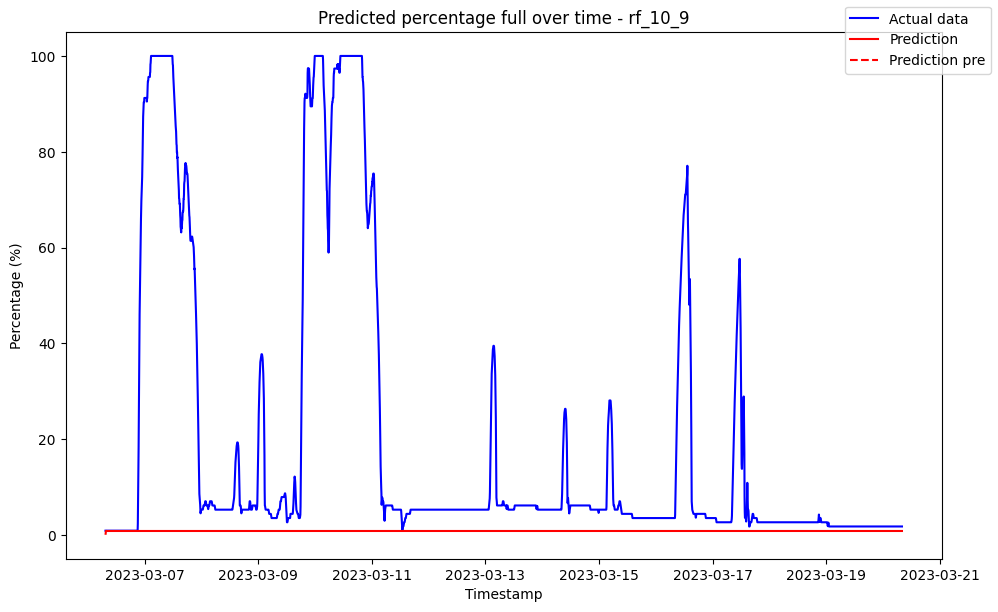

------------------------------------ rf_1_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.530649               0.0
1 2023-03-06 07:35:00            3.530649               0.0
2 2023-03-06 07:40:00            3.530649               0.0
3 2023-03-06 07:45:00            3.530649               0.0
4 2023-03-06 07:50:00            3.530649               0.0
5 2023-03-06 07:55:00            3.530649               0.0

Metrics for this specific prediction:
Accuracy: 89.33%
Mean squared error: 108.92696460829184
Variance (R²) score: 0.89


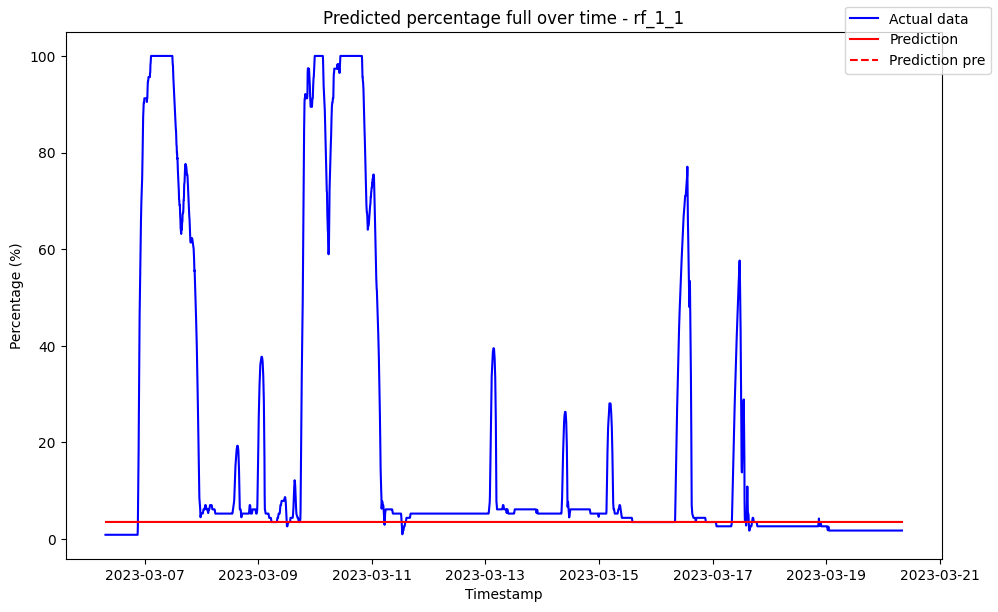

------------------------------------ rf_1_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.031545               0.0
1 2023-03-06 07:35:00            0.612812               0.0
2 2023-03-06 07:40:00            0.816068               0.0
3 2023-03-06 07:45:00            0.674506               0.0
4 2023-03-06 07:50:00            0.359834               0.0
5 2023-03-06 07:55:00            0.133987               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.2799529043067477
Variance (R²) score: 1.00


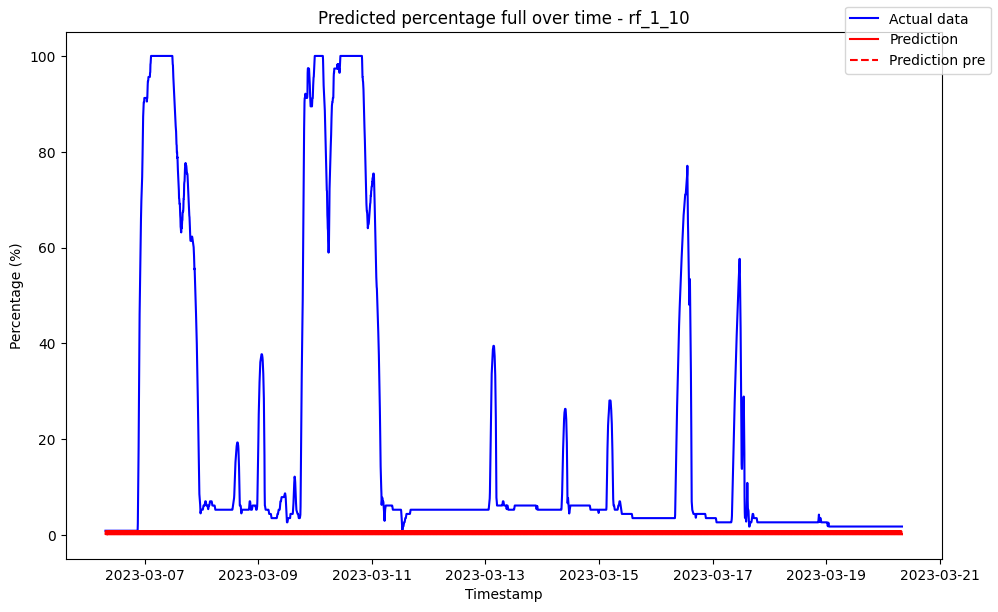

------------------------------------ rf_1_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.021642               0.0
1 2023-03-06 07:35:00            0.594855               0.0
2 2023-03-06 07:40:00            1.808957               0.0
3 2023-03-06 07:45:00            2.893050               0.0
4 2023-03-06 07:50:00            3.675475               0.0
5 2023-03-06 07:55:00            4.156048               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.2020775727242174
Variance (R²) score: 1.00


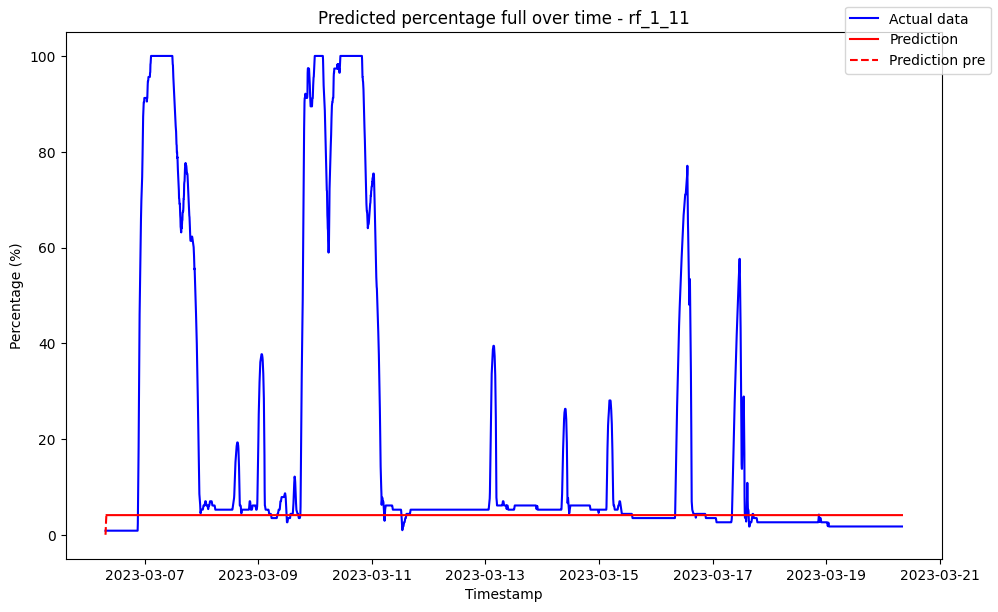

------------------------------------ rf_1_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.016607               0.0
1 2023-03-06 07:35:00            0.016607               0.0
2 2023-03-06 07:40:00            0.016607               0.0
3 2023-03-06 07:45:00            0.016607               0.0
4 2023-03-06 07:50:00            0.016607               0.0
5 2023-03-06 07:55:00            0.016607               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.16305872630423265
Variance (R²) score: 1.00


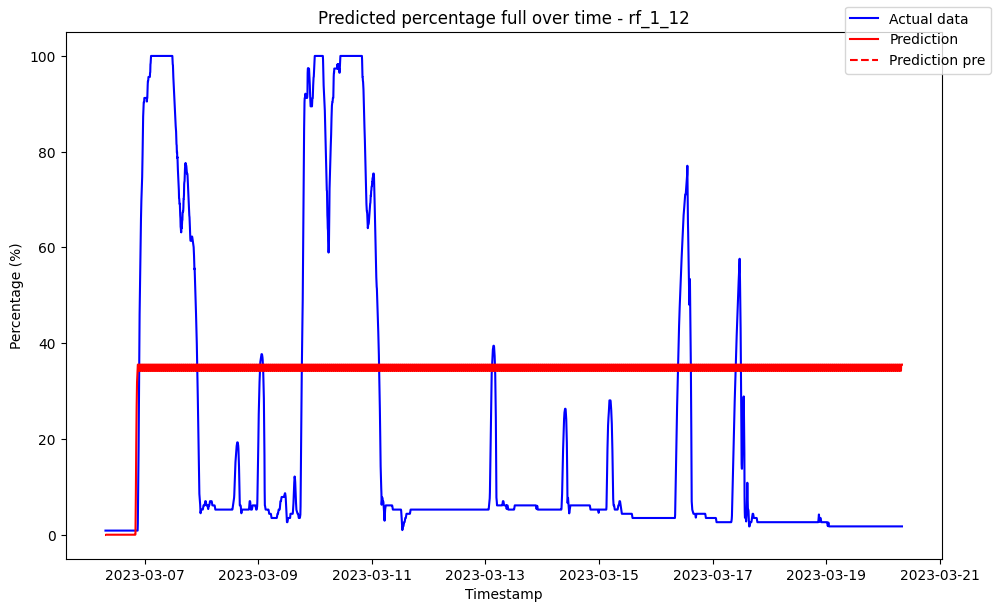

------------------------------------ rf_1_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009402               0.0
1 2023-03-06 07:35:00            0.009402               0.0
2 2023-03-06 07:40:00            0.009402               0.0
3 2023-03-06 07:45:00            0.009402               0.0
4 2023-03-06 07:50:00            0.009402               0.0
5 2023-03-06 07:55:00            0.009402               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1466877399043092
Variance (R²) score: 1.00


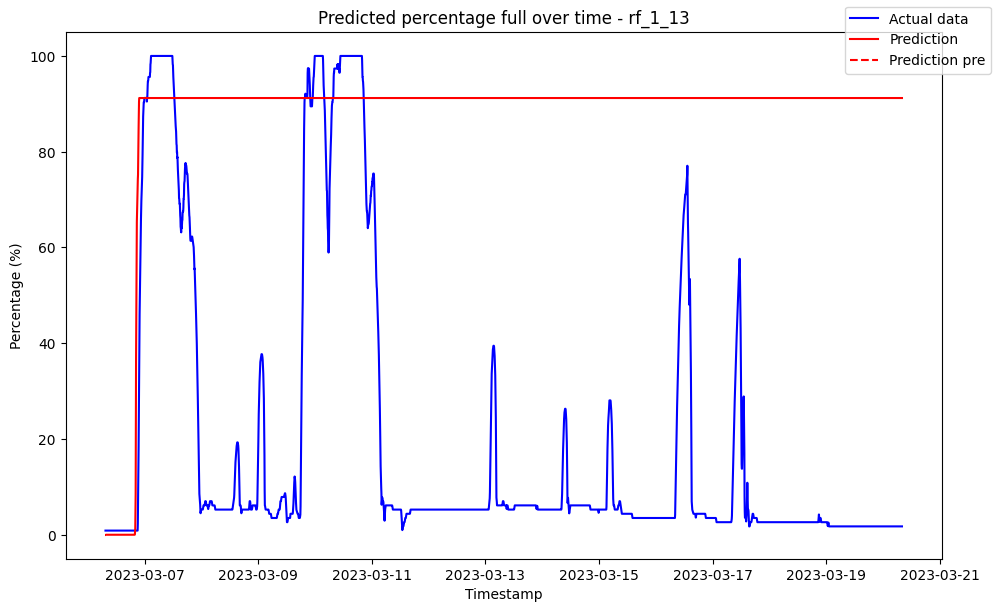

------------------------------------ rf_1_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007985               0.0
1 2023-03-06 07:35:00            0.007985               0.0
2 2023-03-06 07:40:00            0.007985               0.0
3 2023-03-06 07:45:00            0.007985               0.0
4 2023-03-06 07:50:00            0.007985               0.0
5 2023-03-06 07:55:00            0.007985               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.13312545087104607
Variance (R²) score: 1.00


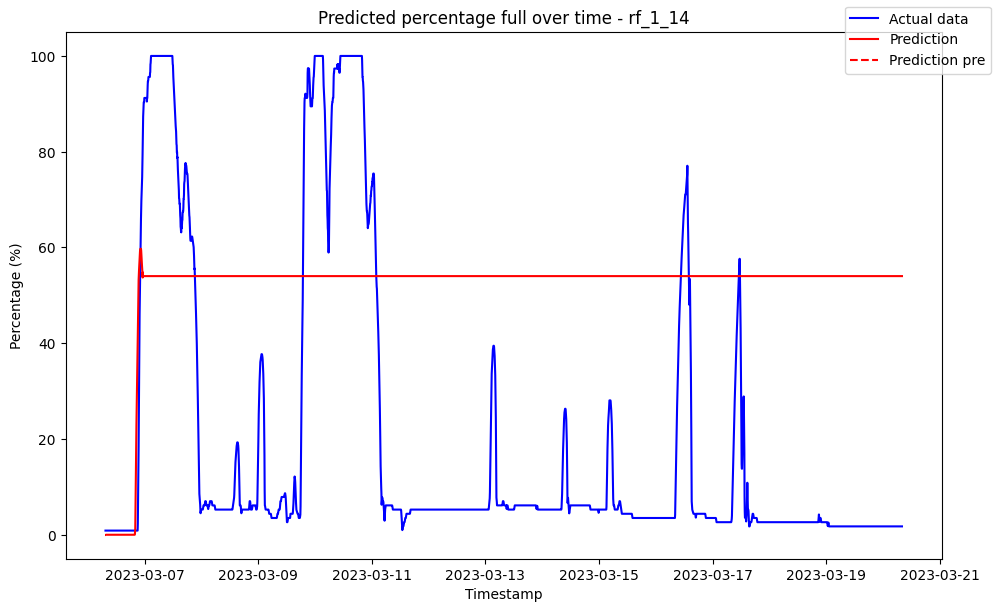

------------------------------------ rf_1_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.012195               0.0
1 2023-03-06 07:35:00            0.012195               0.0
2 2023-03-06 07:40:00            0.012195               0.0
3 2023-03-06 07:45:00            0.012195               0.0
4 2023-03-06 07:50:00            0.012195               0.0
5 2023-03-06 07:55:00            0.012195               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12595195635720233
Variance (R²) score: 1.00


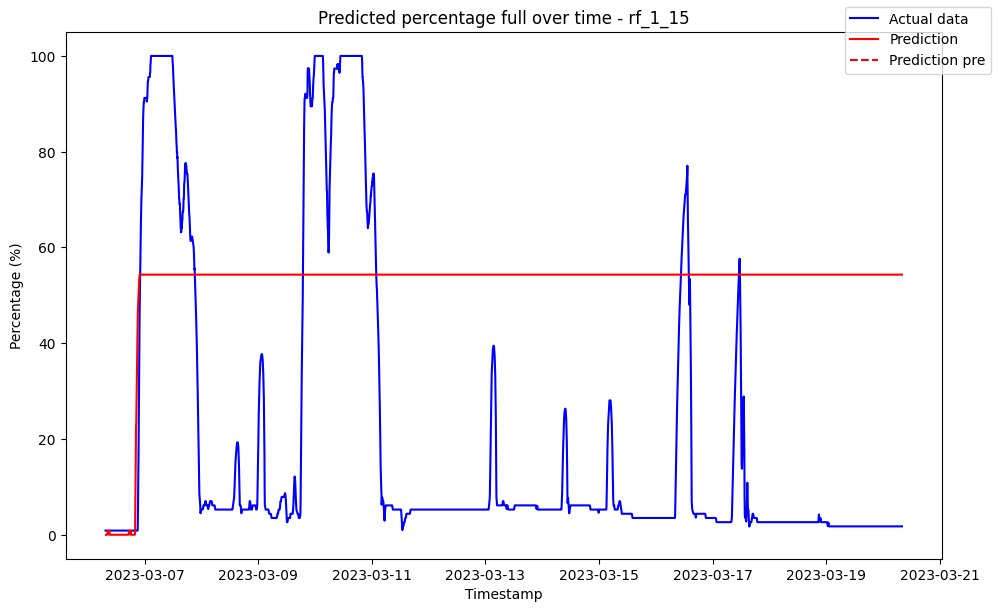

------------------------------------ rf_1_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.011579               0.0
1 2023-03-06 07:35:00            0.011579               0.0
2 2023-03-06 07:40:00            0.011579               0.0
3 2023-03-06 07:45:00            0.011579               0.0
4 2023-03-06 07:50:00            0.011579               0.0
5 2023-03-06 07:55:00            0.011579               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12266109181622224
Variance (R²) score: 1.00


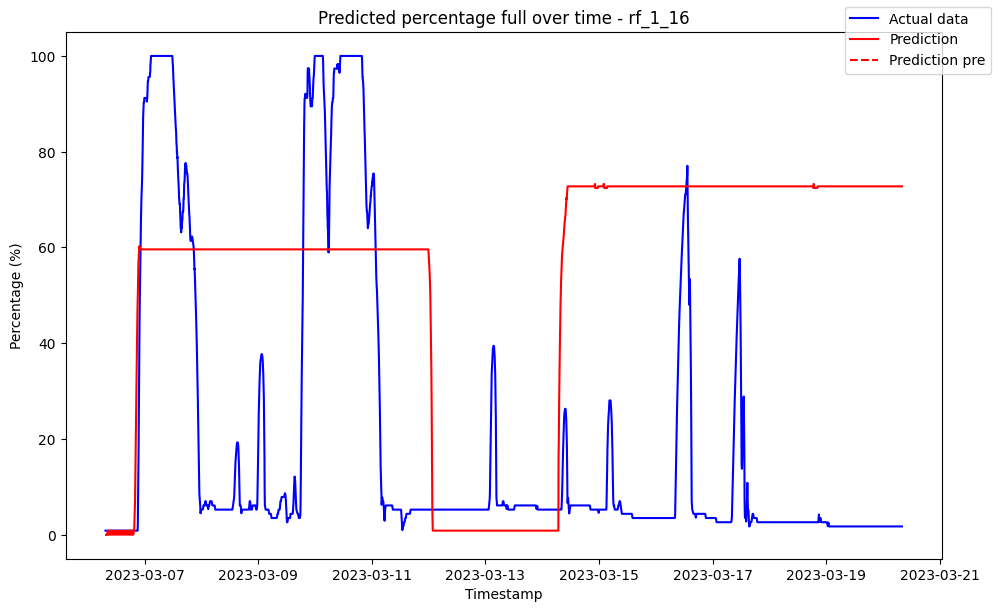

------------------------------------ rf_1_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009146               0.0
1 2023-03-06 07:35:00            0.009146               0.0
2 2023-03-06 07:40:00            0.009146               0.0
3 2023-03-06 07:45:00            0.009146               0.0
4 2023-03-06 07:50:00            0.009146               0.0
5 2023-03-06 07:55:00            0.009146               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11912589679028958
Variance (R²) score: 1.00


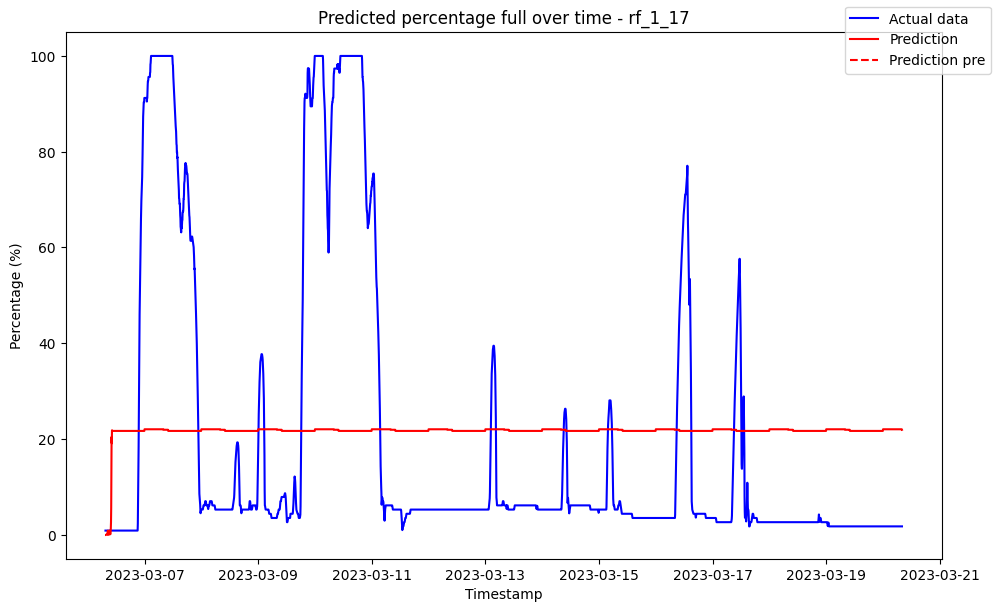

------------------------------------ rf_1_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006495               0.0
1 2023-03-06 07:35:00            0.006495               0.0
2 2023-03-06 07:40:00            0.006495               0.0
3 2023-03-06 07:45:00            0.006495               0.0
4 2023-03-06 07:50:00            0.006495               0.0
5 2023-03-06 07:55:00            0.006495               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11102762484697061
Variance (R²) score: 1.00


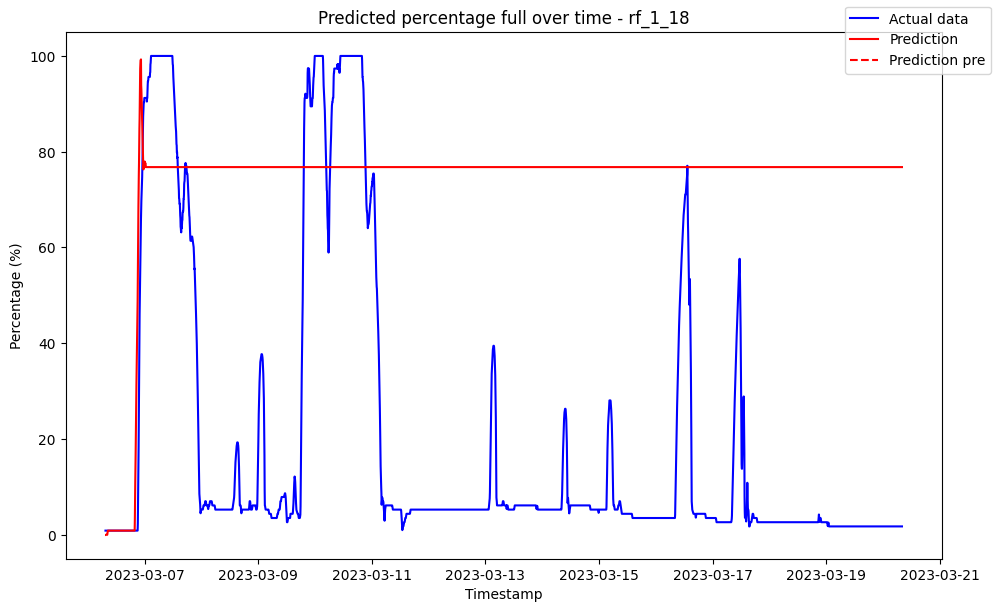

------------------------------------ rf_1_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009144               0.0
1 2023-03-06 07:35:00            0.009144               0.0
2 2023-03-06 07:40:00            0.009144               0.0
3 2023-03-06 07:45:00            0.009144               0.0
4 2023-03-06 07:50:00            0.009144               0.0
5 2023-03-06 07:55:00            0.009144               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12036870938611585
Variance (R²) score: 1.00


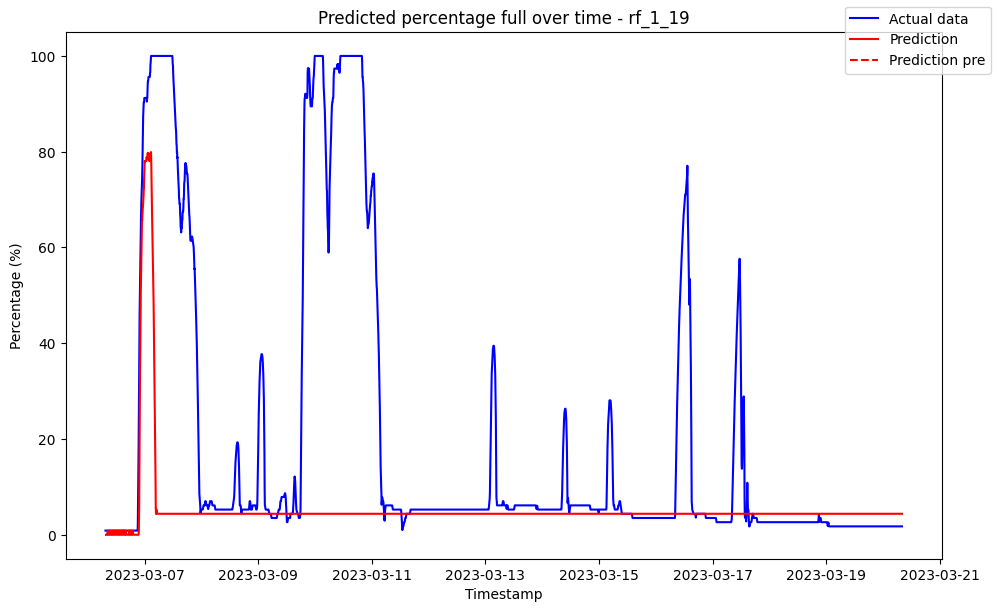

------------------------------------ rf_1_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00             1.20502               0.0
1 2023-03-06 07:35:00             1.20502               0.0
2 2023-03-06 07:40:00             1.20502               0.0
3 2023-03-06 07:45:00             1.20502               0.0
4 2023-03-06 07:50:00             1.20502               0.0
5 2023-03-06 07:55:00             1.20502               0.0

Metrics for this specific prediction:
Accuracy: 96.09%
Mean squared error: 39.89256258346909
Variance (R²) score: 0.96


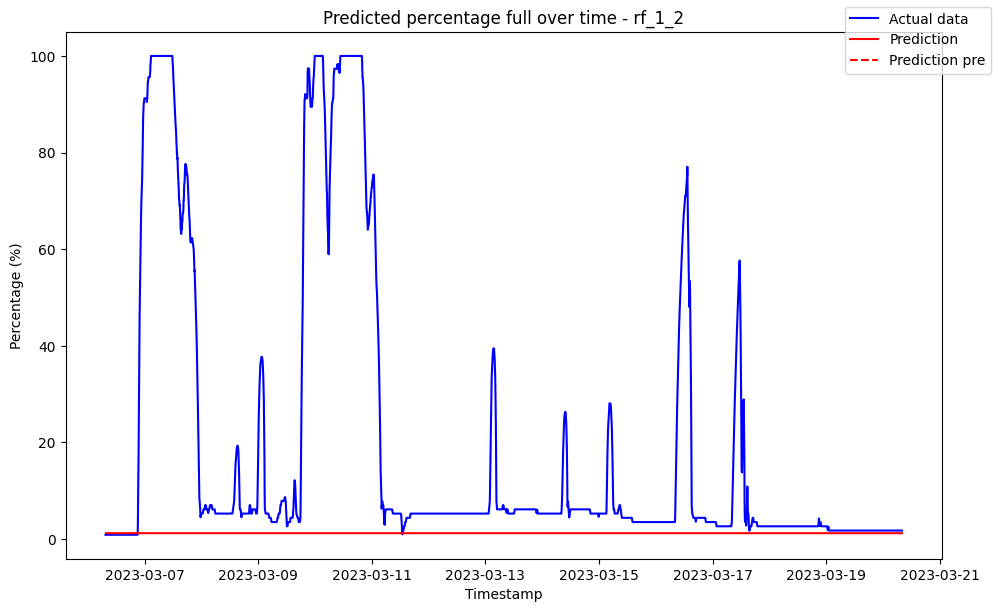

------------------------------------ rf_1_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006541               0.0
1 2023-03-06 07:35:00            0.006541               0.0
2 2023-03-06 07:40:00            0.006541               0.0
3 2023-03-06 07:45:00            0.006541               0.0
4 2023-03-06 07:50:00            0.006541               0.0
5 2023-03-06 07:55:00            0.006541               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12132248947785107
Variance (R²) score: 1.00


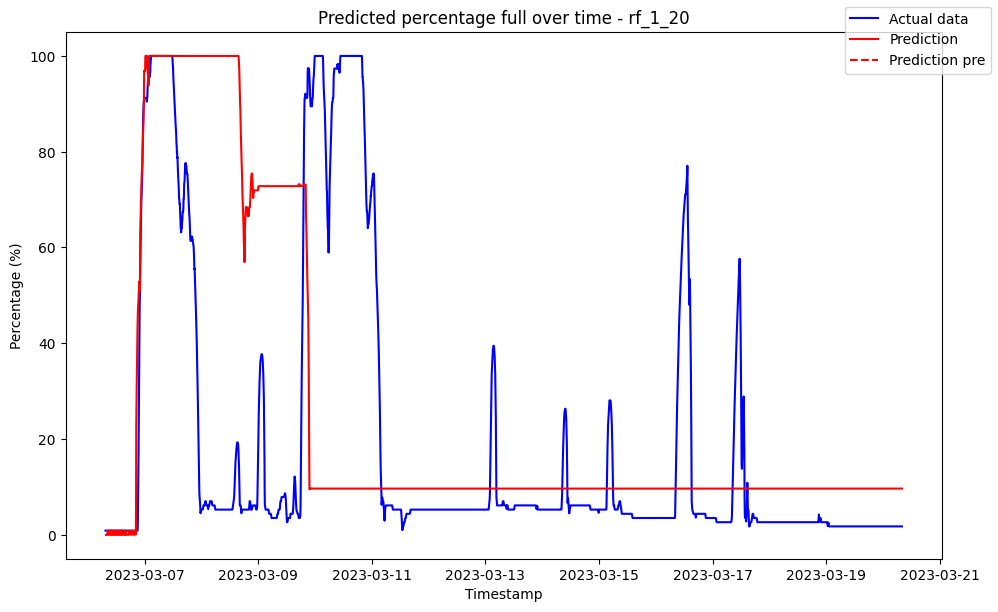

------------------------------------ rf_1_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005868               0.0
1 2023-03-06 07:35:00            0.005868               0.0
2 2023-03-06 07:40:00            0.005868               0.0
3 2023-03-06 07:45:00            0.005868               0.0
4 2023-03-06 07:50:00            0.005868               0.0
5 2023-03-06 07:55:00            0.005868               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11527346886710921
Variance (R²) score: 1.00


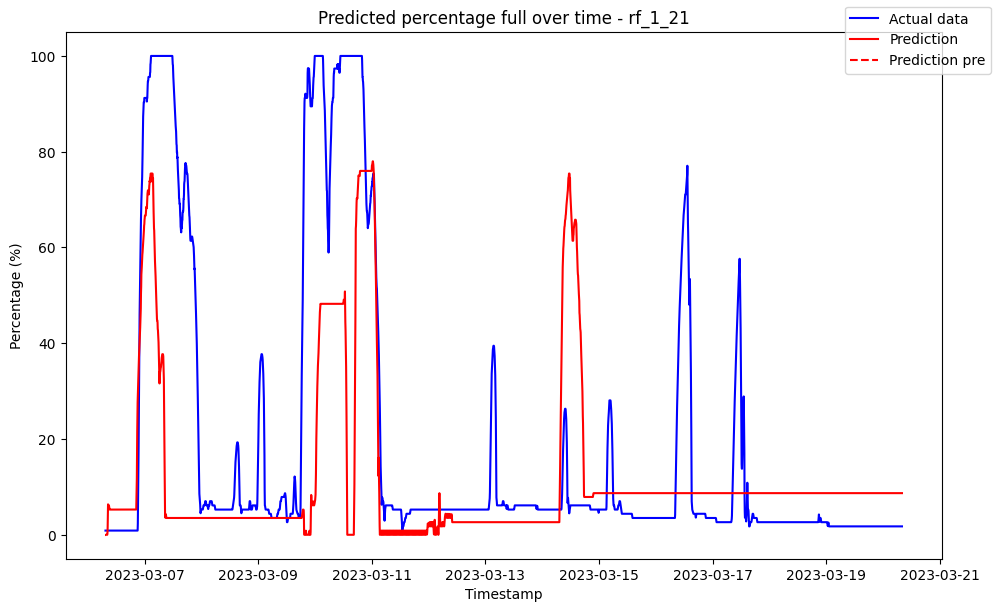

------------------------------------ rf_1_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.038923               0.0
1 2023-03-06 07:35:00            0.323000               0.0
2 2023-03-06 07:40:00            1.456000               0.0
3 2023-03-06 07:45:00            3.129000               0.0
4 2023-03-06 07:50:00            3.509000               0.0
5 2023-03-06 07:55:00            3.500558               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10684586676960002
Variance (R²) score: 1.00


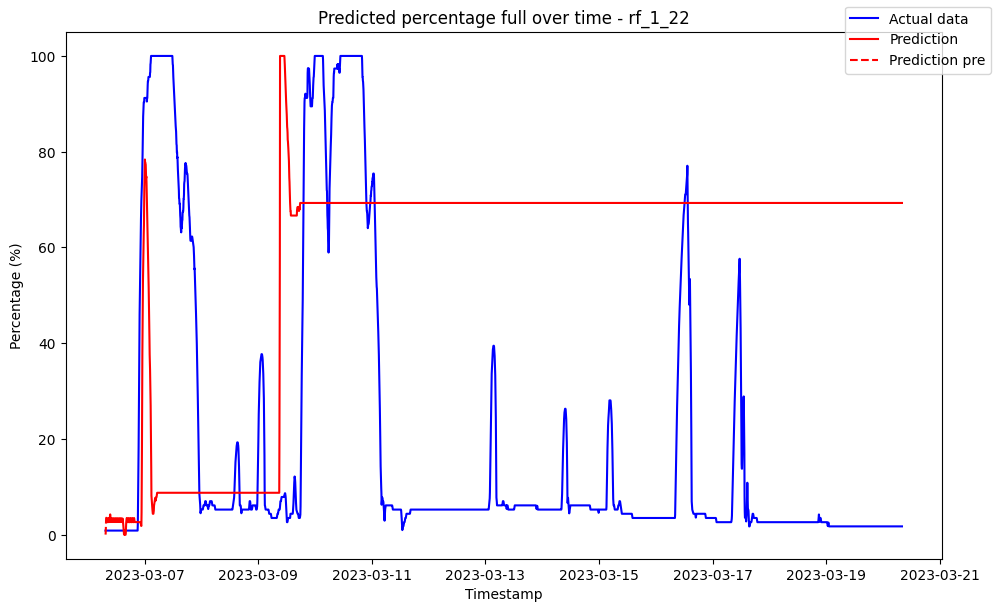

------------------------------------ rf_1_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12148693353683575
Variance (R²) score: 1.00


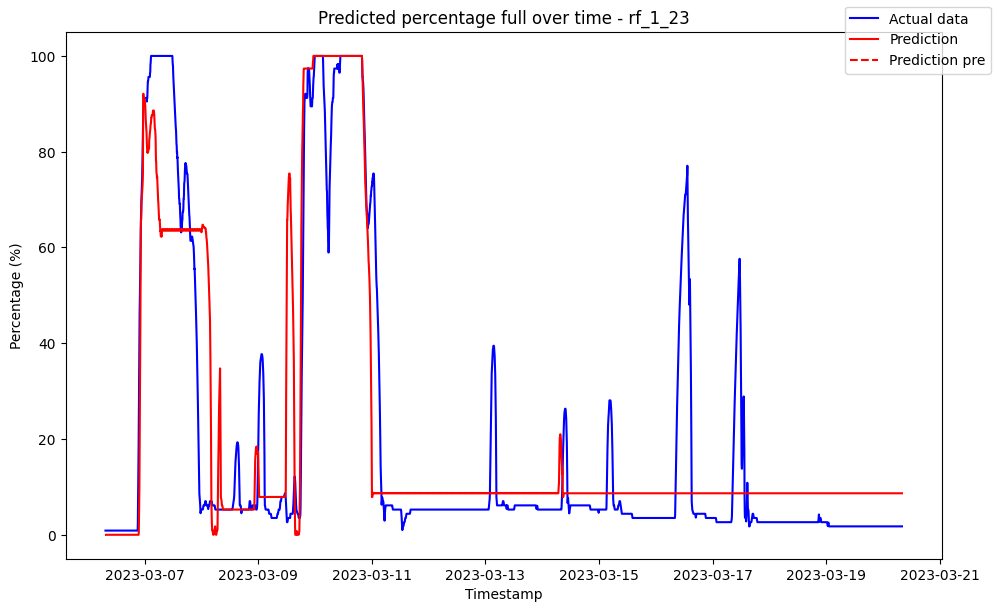

------------------------------------ rf_1_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1195447131249863
Variance (R²) score: 1.00


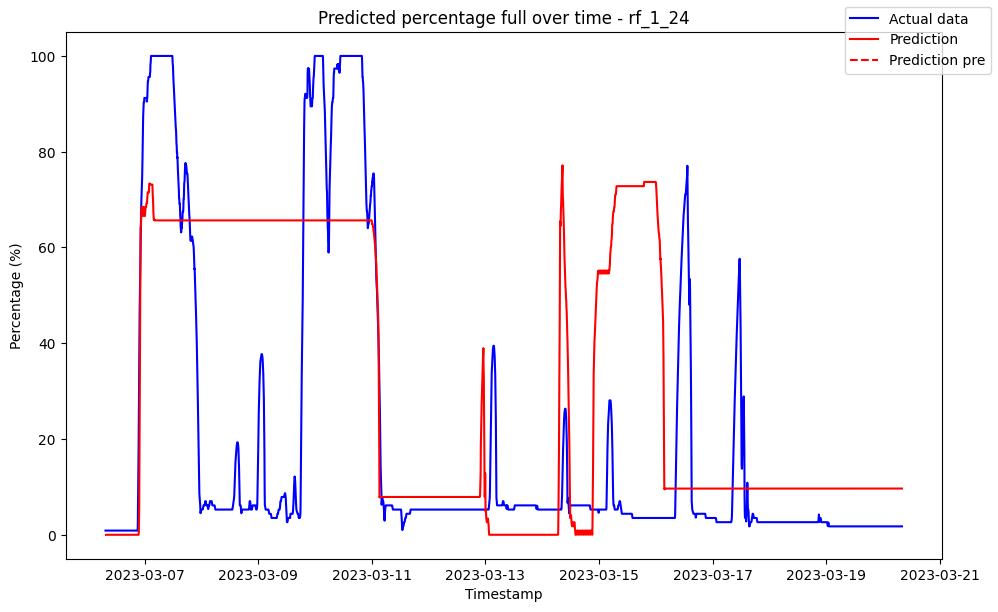

------------------------------------ rf_1_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12185877502339597
Variance (R²) score: 1.00


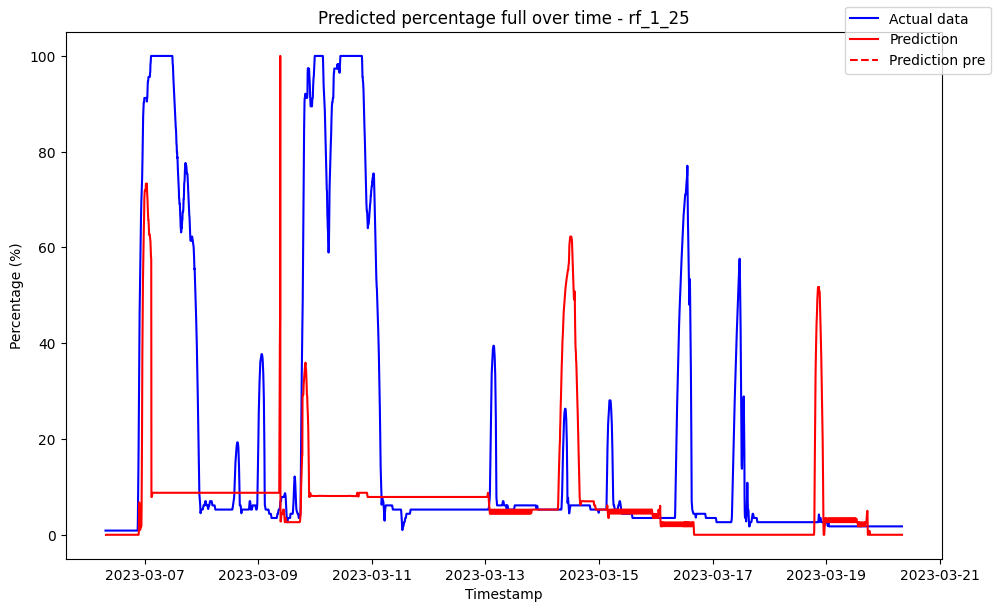

------------------------------------ rf_1_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12032752552648578
Variance (R²) score: 1.00


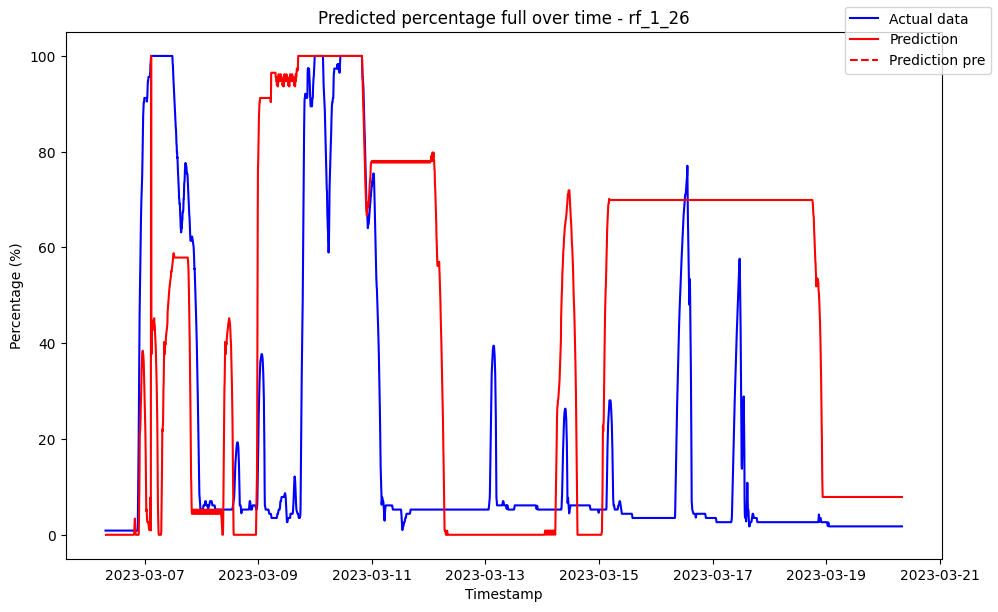

------------------------------------ rf_1_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1207191948883643
Variance (R²) score: 1.00


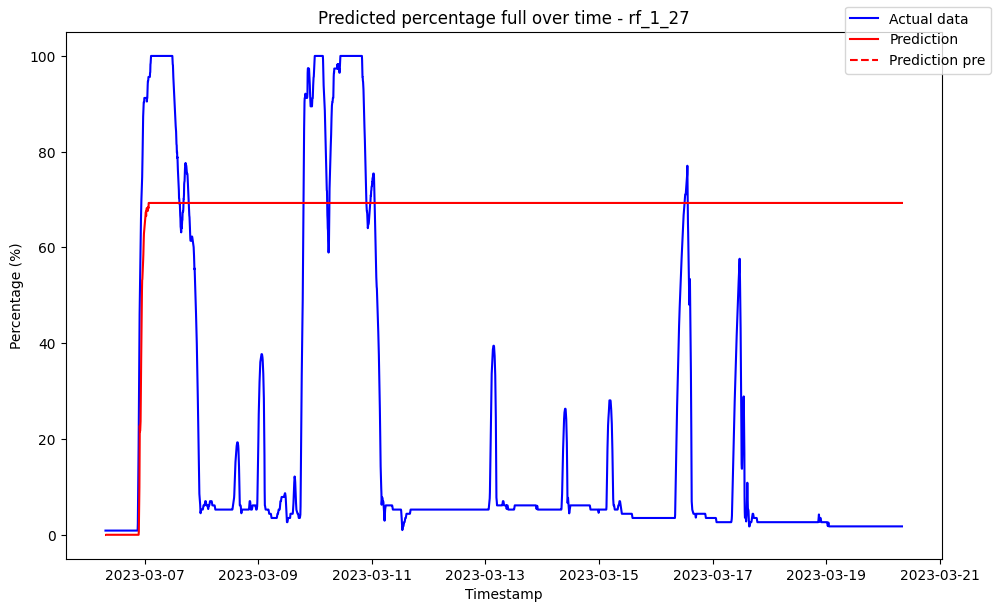

------------------------------------ rf_1_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1170629888924837
Variance (R²) score: 1.00


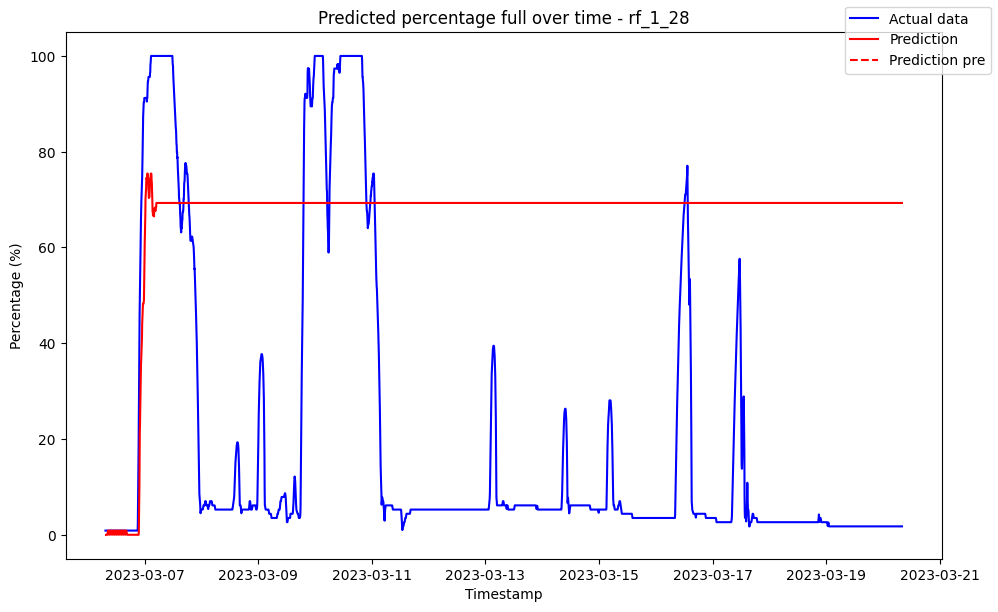

------------------------------------ rf_1_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12164863097107602
Variance (R²) score: 1.00


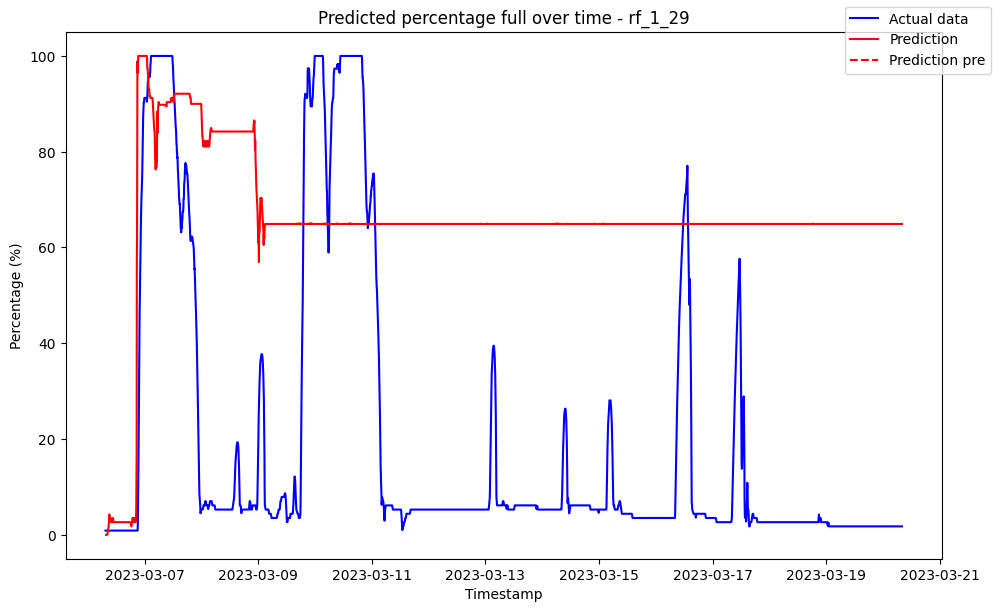

------------------------------------ rf_1_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.457448               0.0
1 2023-03-06 07:35:00            0.457448               0.0
2 2023-03-06 07:40:00            0.457448               0.0
3 2023-03-06 07:45:00            0.457448               0.0
4 2023-03-06 07:50:00            0.457448               0.0
5 2023-03-06 07:55:00            0.457448               0.0

Metrics for this specific prediction:
Accuracy: 99.23%
Mean squared error: 7.872487885057248
Variance (R²) score: 0.99


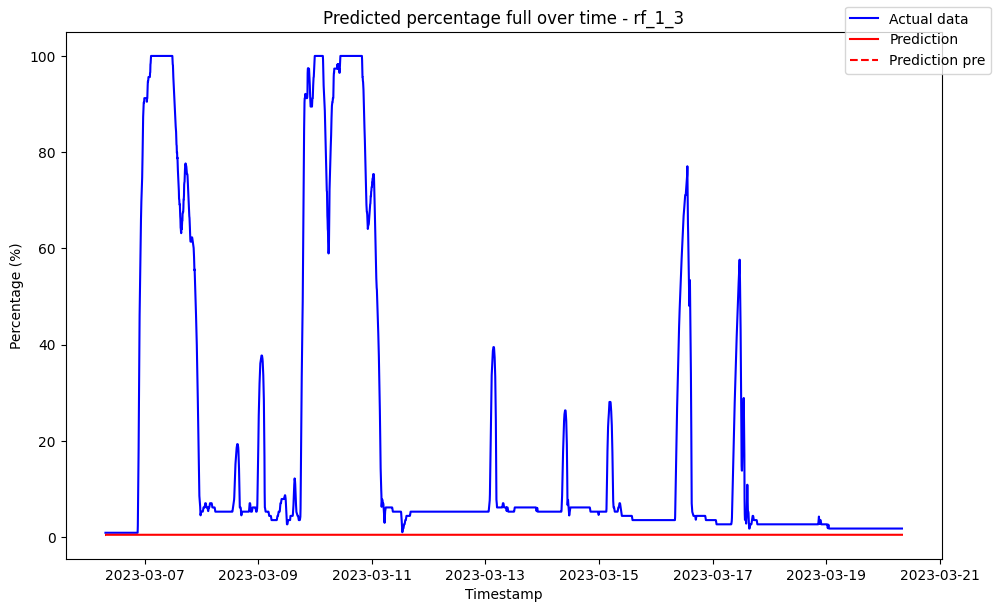

------------------------------------ rf_1_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11657185680433713
Variance (R²) score: 1.00


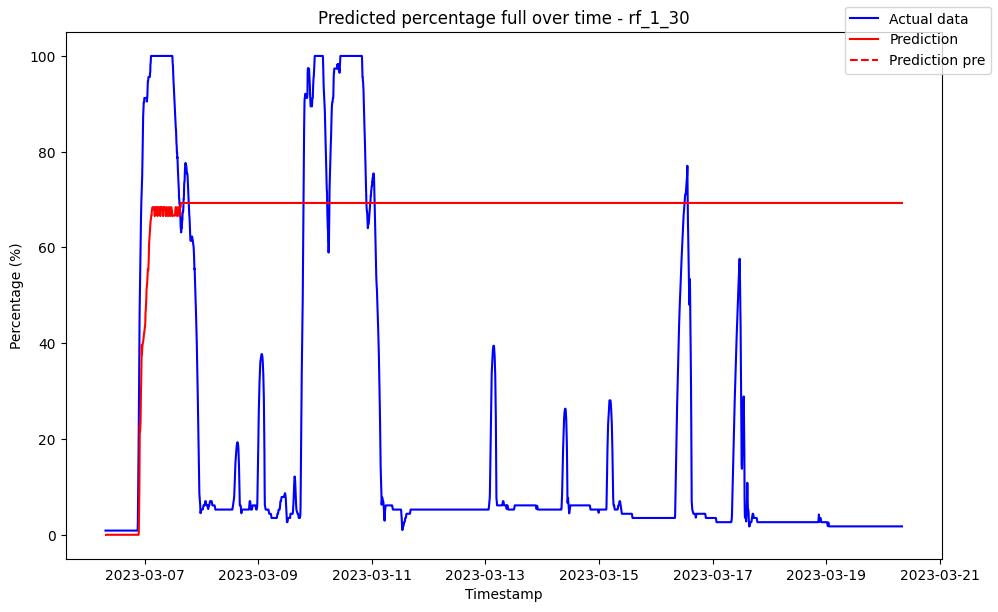

------------------------------------ rf_1_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12032810877850567
Variance (R²) score: 1.00


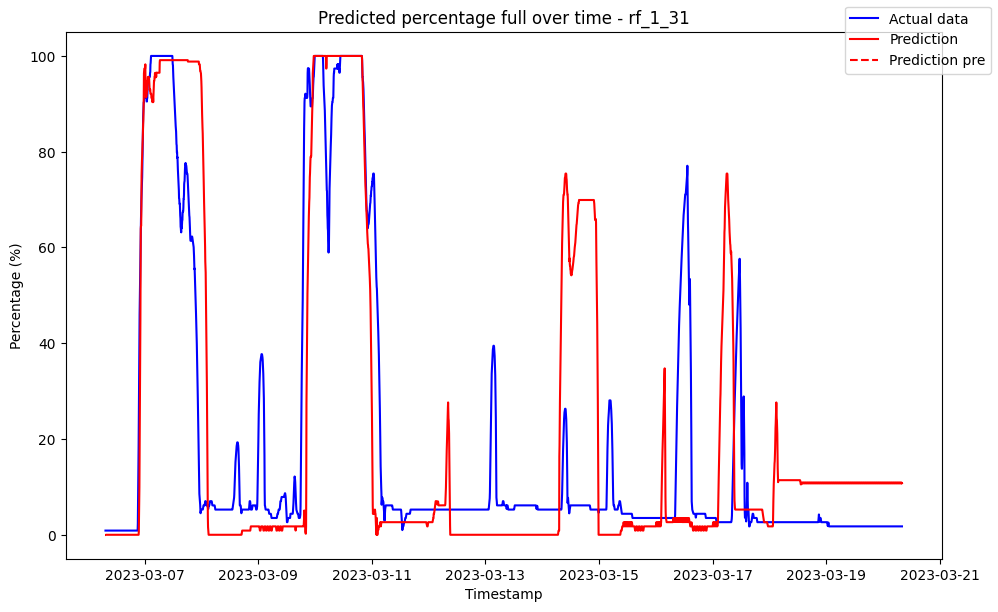

------------------------------------ rf_1_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1169738232351362
Variance (R²) score: 1.00


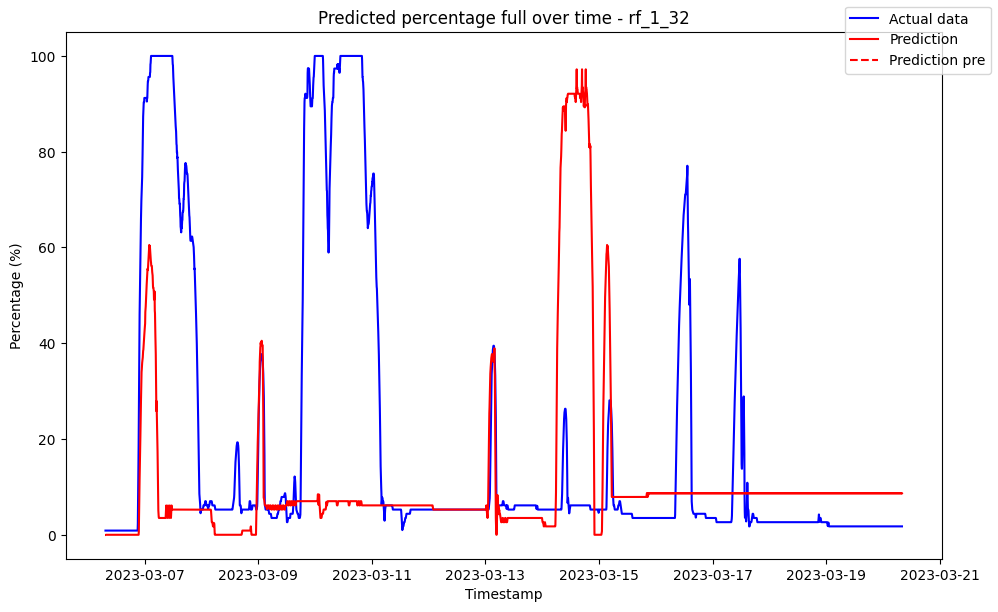

------------------------------------ rf_1_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11957142734895432
Variance (R²) score: 1.00


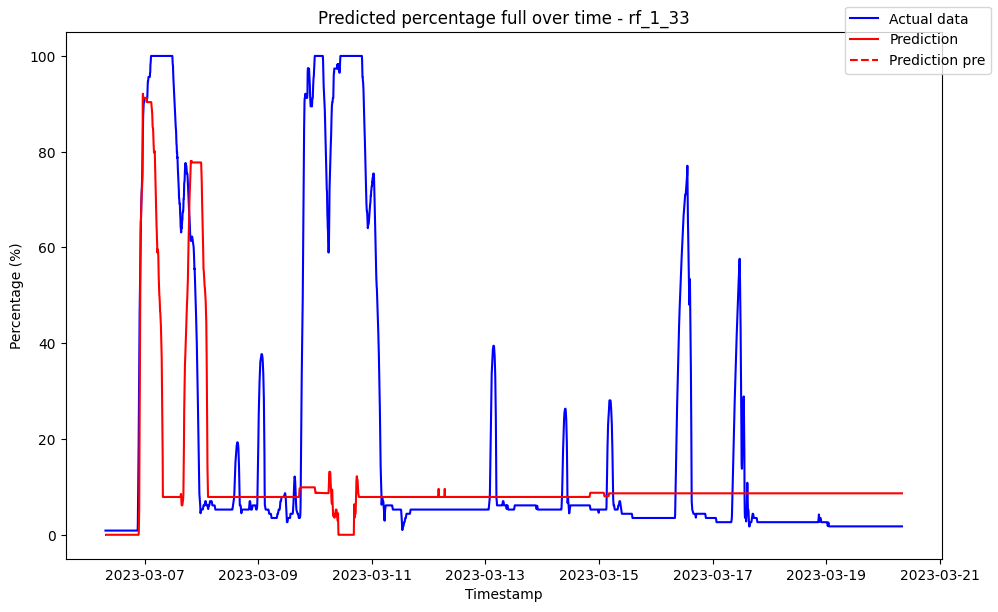

------------------------------------ rf_1_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12112983335745445
Variance (R²) score: 1.00


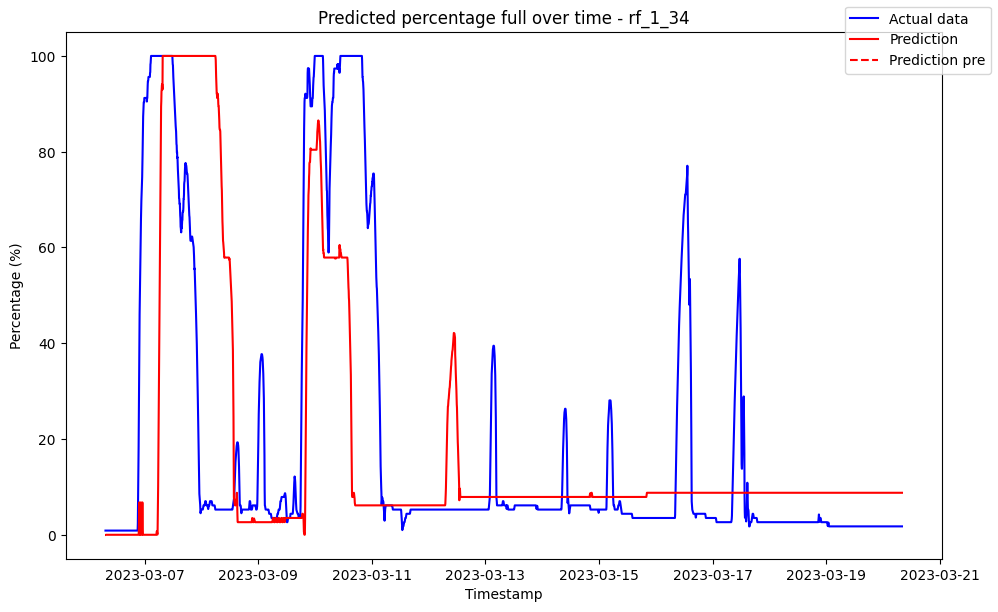

------------------------------------ rf_1_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11683330092805226
Variance (R²) score: 1.00


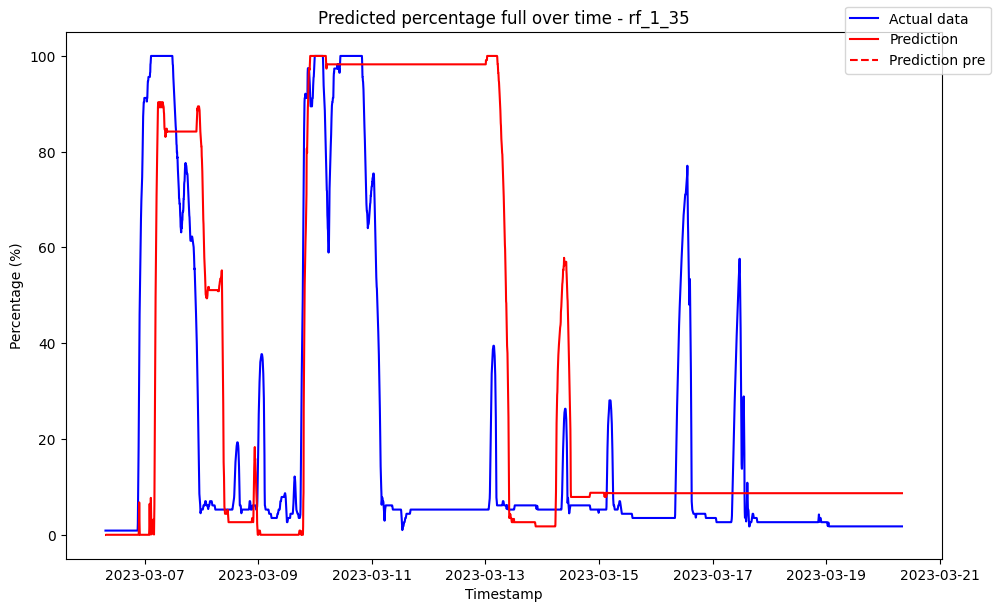

------------------------------------ rf_1_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11840556098349737
Variance (R²) score: 1.00


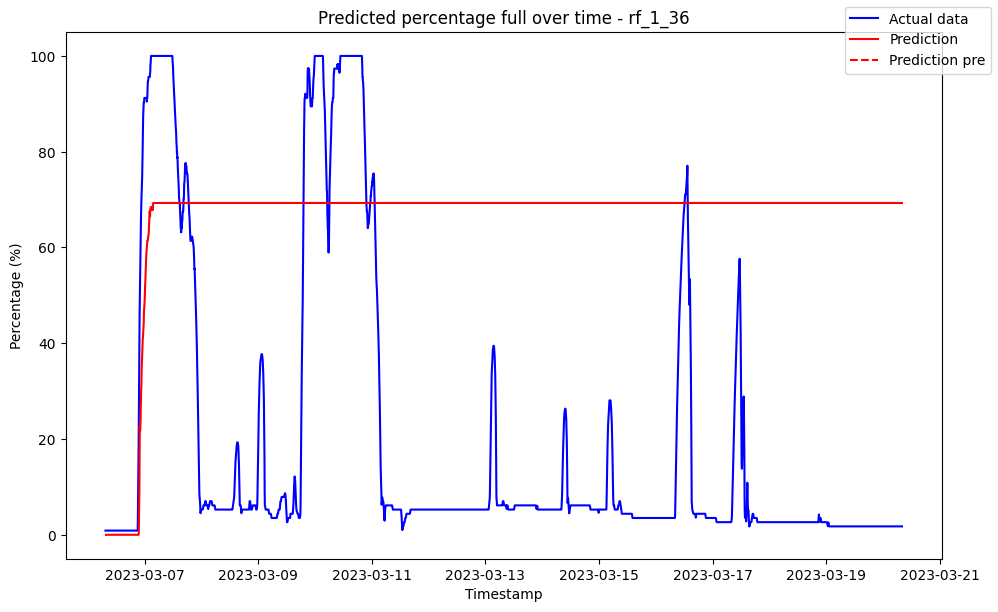

------------------------------------ rf_1_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.118963514121263
Variance (R²) score: 1.00


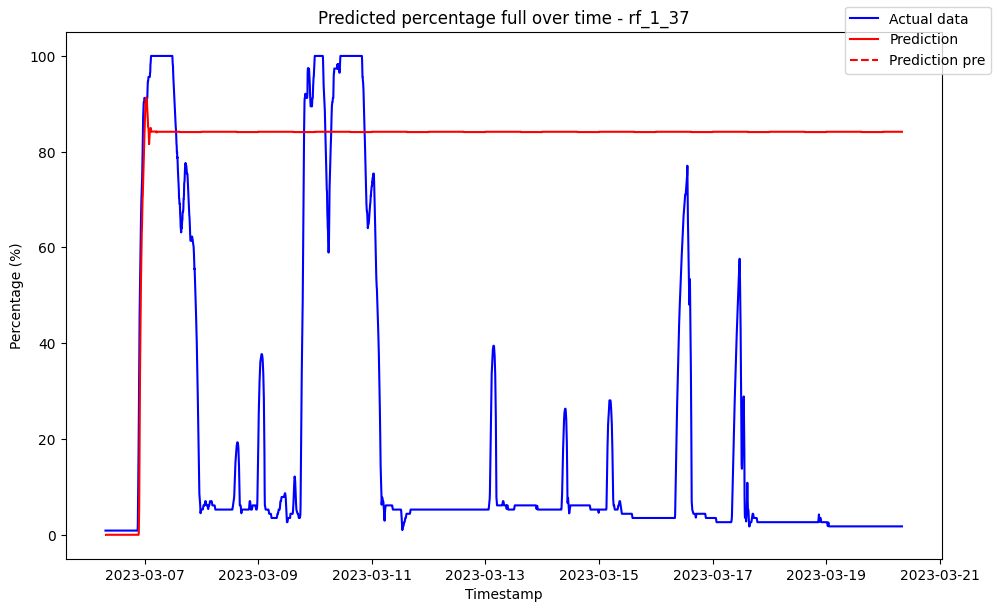

------------------------------------ rf_1_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11666339583748024
Variance (R²) score: 1.00


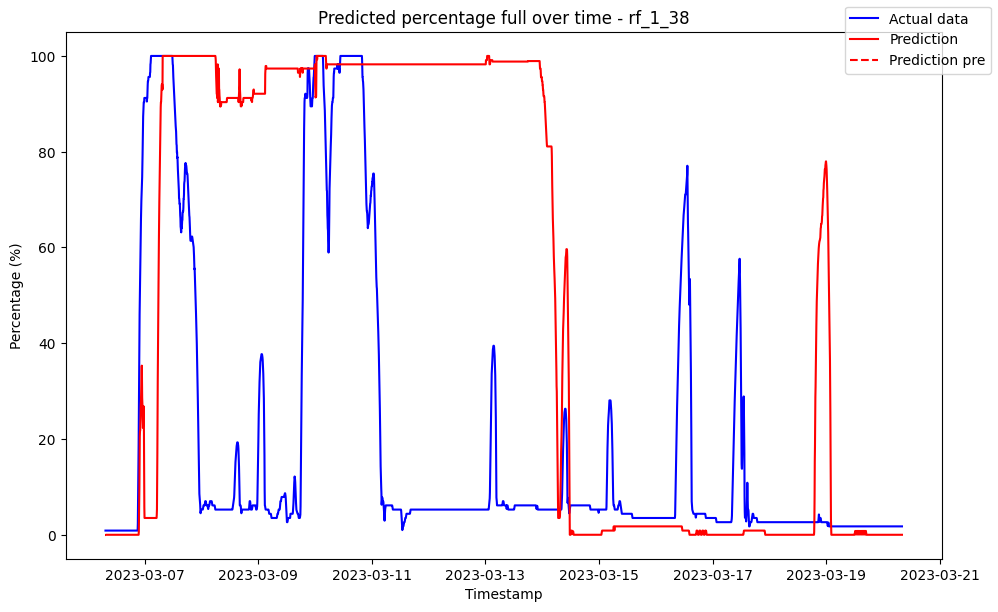

------------------------------------ rf_1_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1130141171415674
Variance (R²) score: 1.00


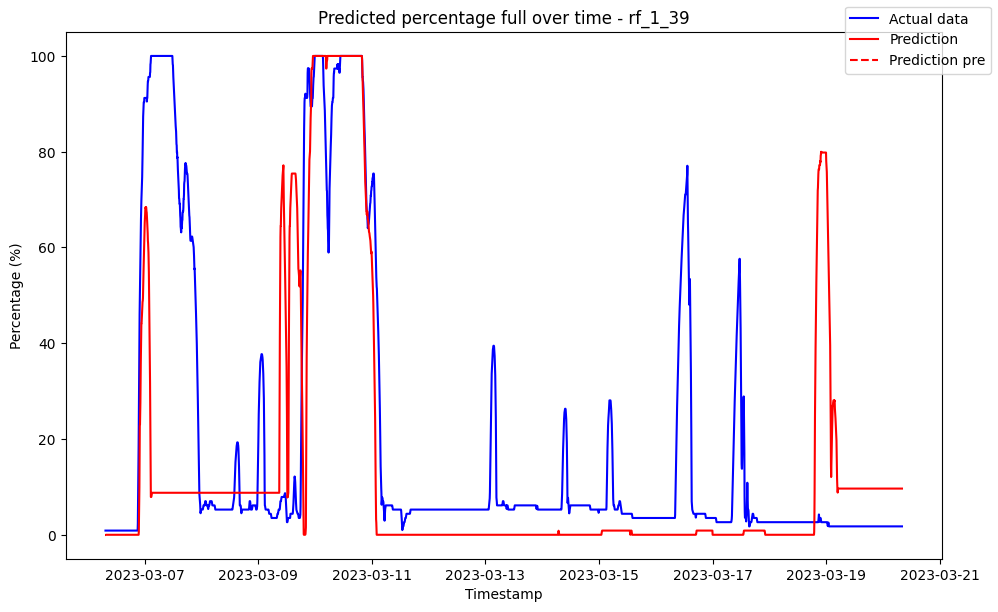

------------------------------------ rf_1_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.021423               0.0
1 2023-03-06 07:35:00            0.021423               0.0
2 2023-03-06 07:40:00            0.021423               0.0
3 2023-03-06 07:45:00            0.021423               0.0
4 2023-03-06 07:50:00            0.021423               0.0
5 2023-03-06 07:55:00            0.021423               0.0

Metrics for this specific prediction:
Accuracy: 99.76%
Mean squared error: 2.4406669072694136
Variance (R²) score: 1.00


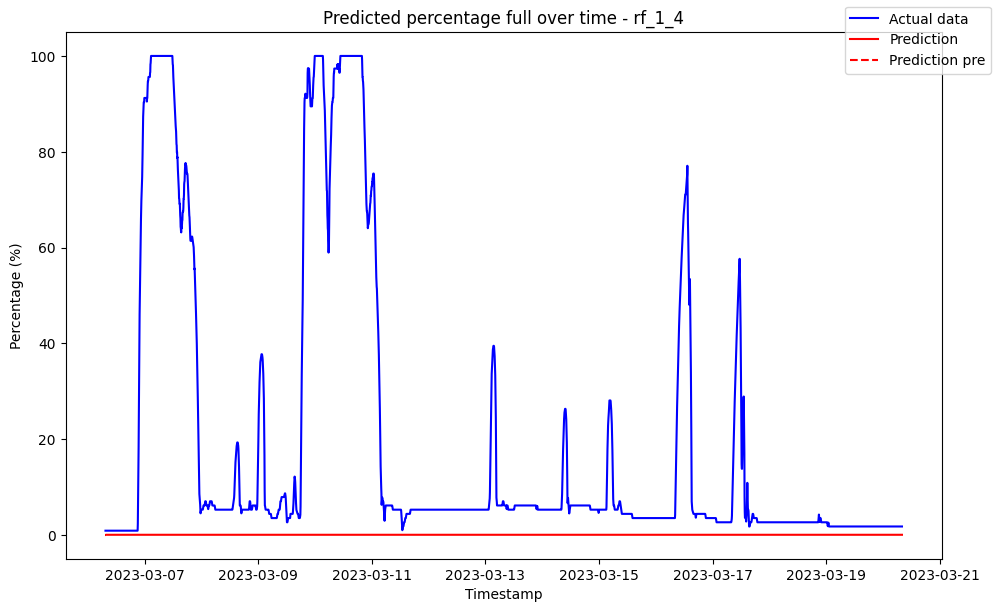

------------------------------------ rf_1_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11933481226311894
Variance (R²) score: 1.00


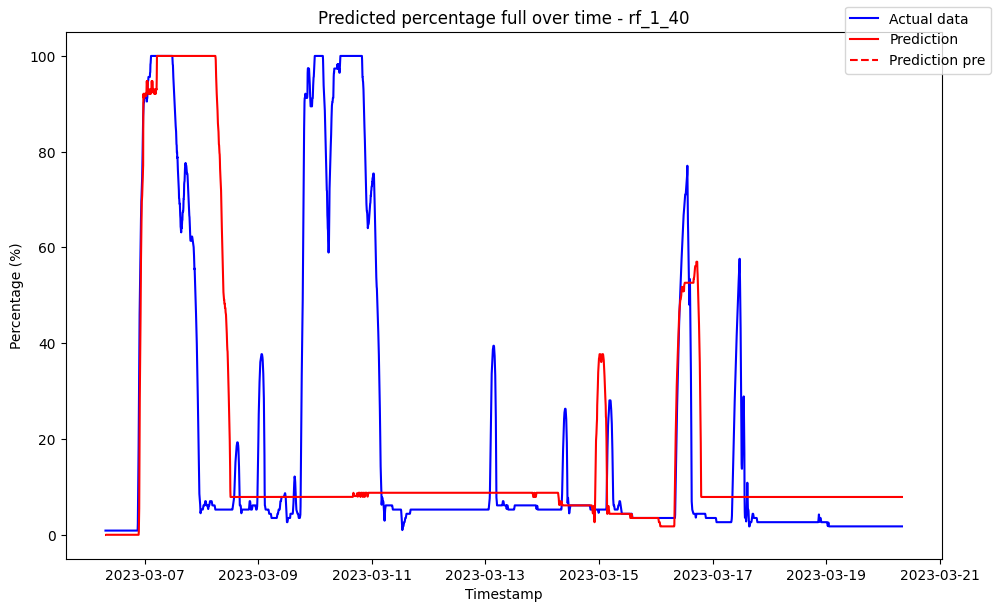

------------------------------------ rf_1_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12032143910407772
Variance (R²) score: 1.00


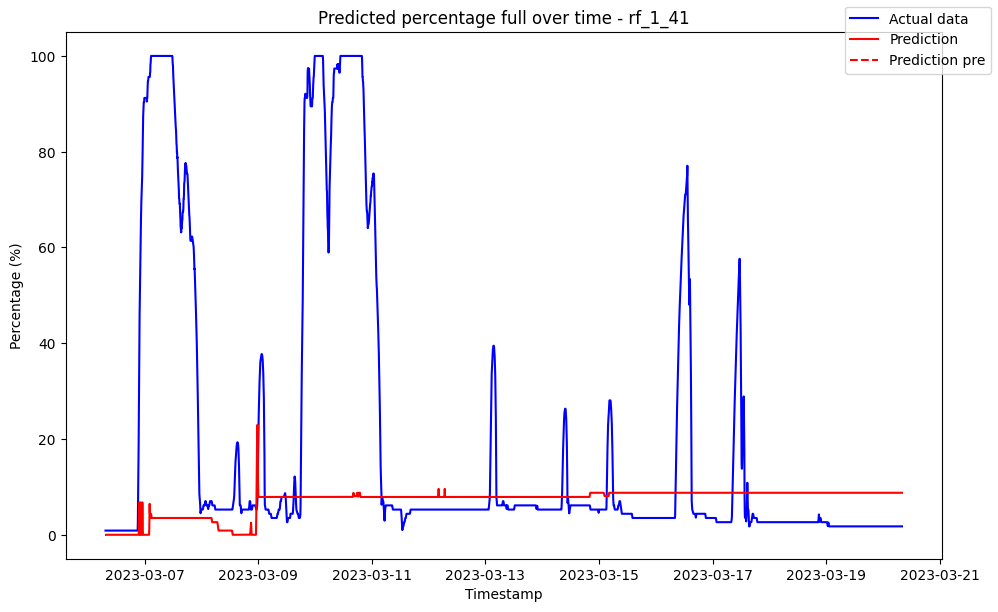

------------------------------------ rf_1_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11383297562224728
Variance (R²) score: 1.00


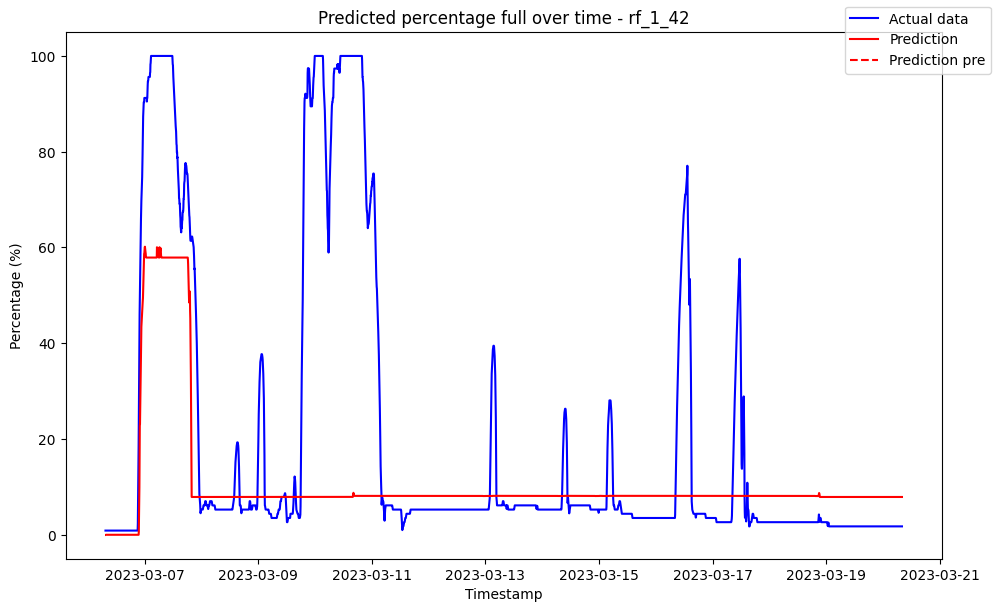

------------------------------------ rf_1_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11826050580380498
Variance (R²) score: 1.00


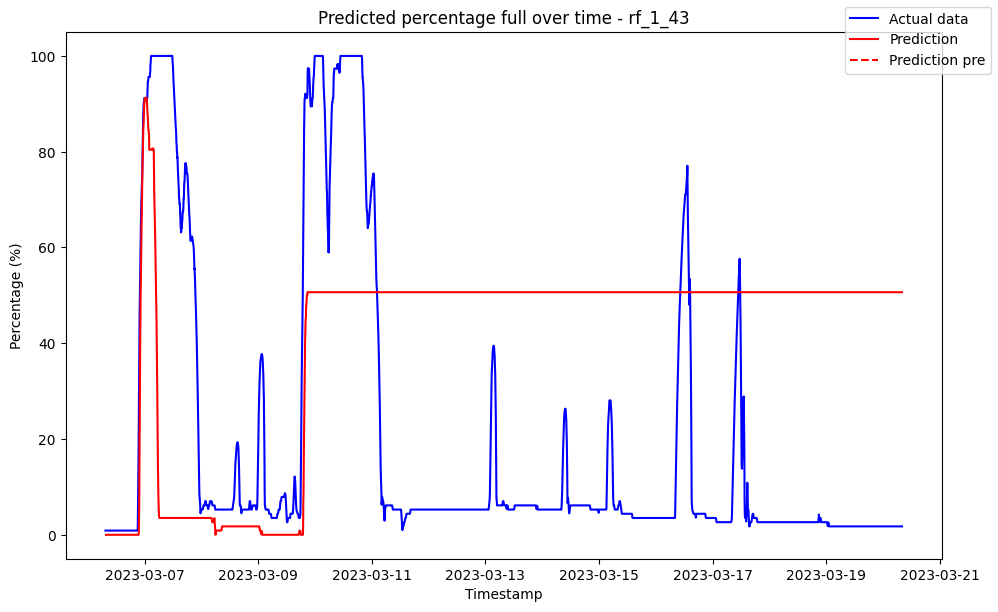

------------------------------------ rf_1_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12301849310303084
Variance (R²) score: 1.00


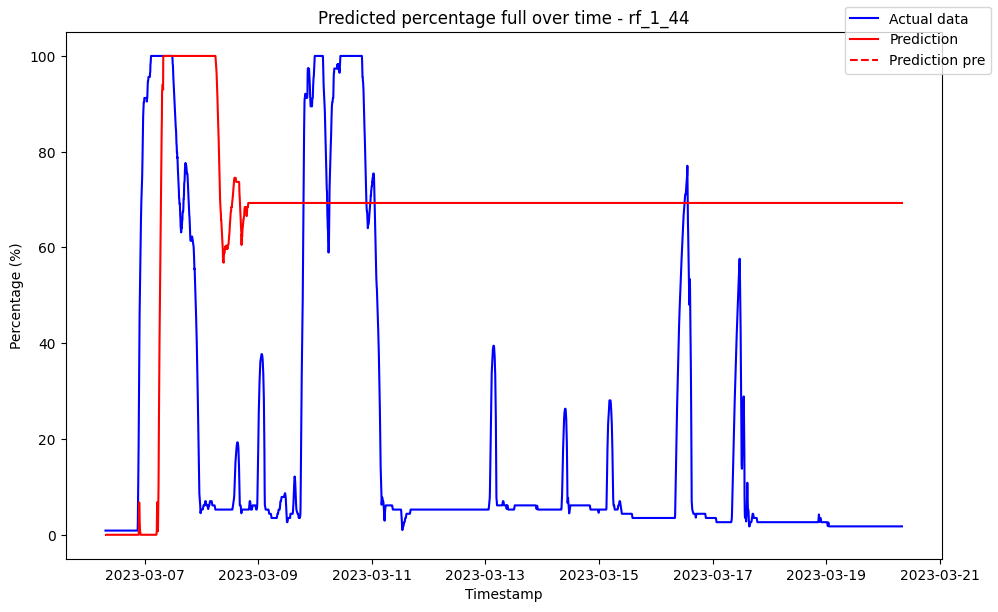

------------------------------------ rf_1_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1178299198876135
Variance (R²) score: 1.00


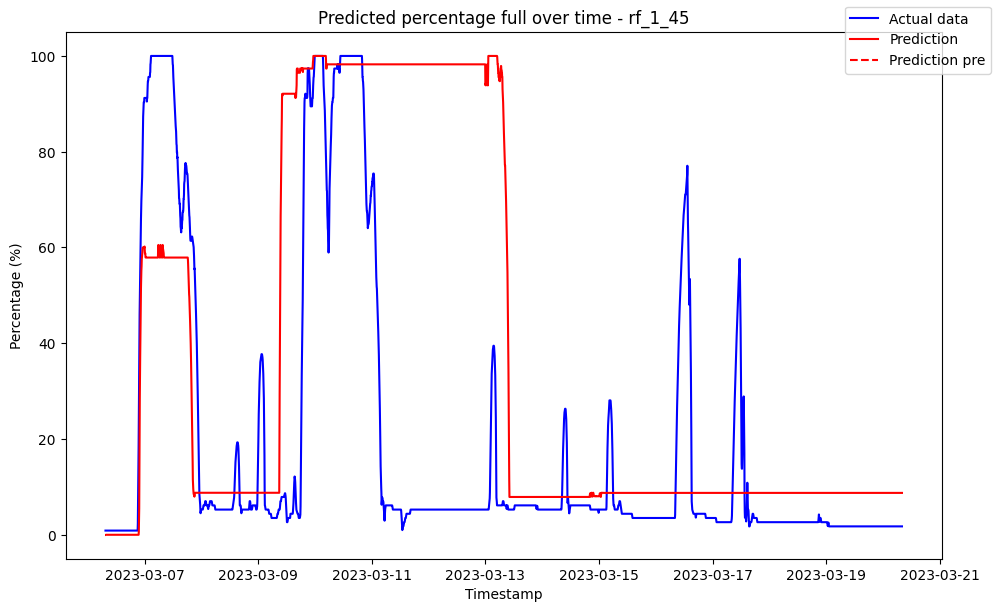

------------------------------------ rf_1_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12071732430120143
Variance (R²) score: 1.00


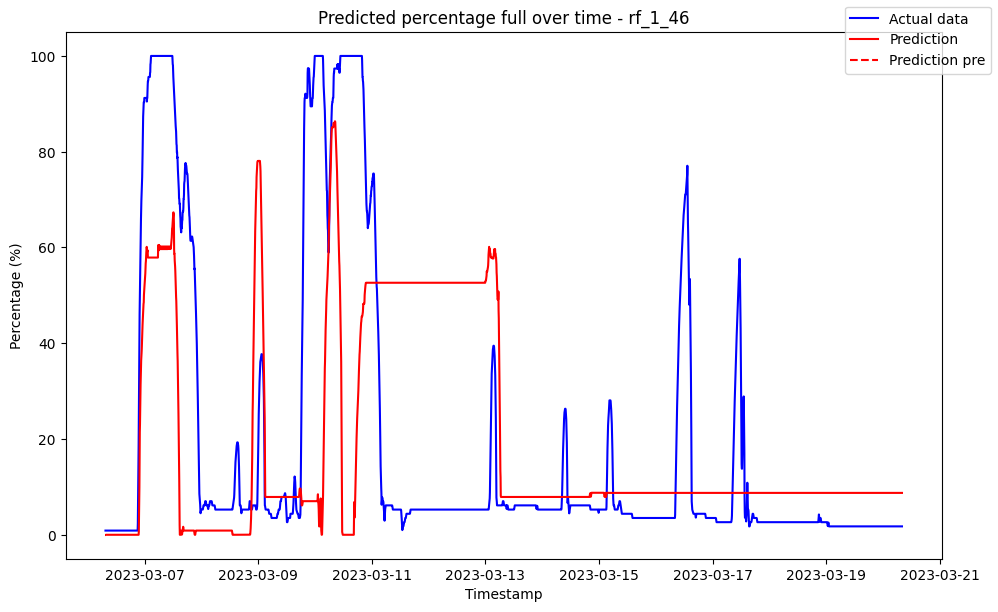

------------------------------------ rf_1_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11430108651295447
Variance (R²) score: 1.00


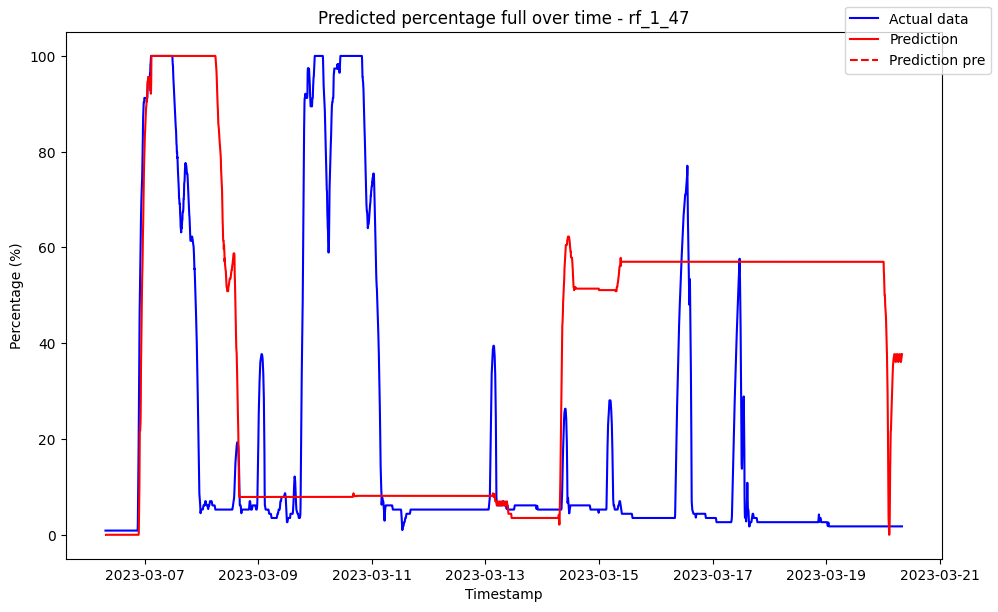

------------------------------------ rf_1_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11902055341104524
Variance (R²) score: 1.00


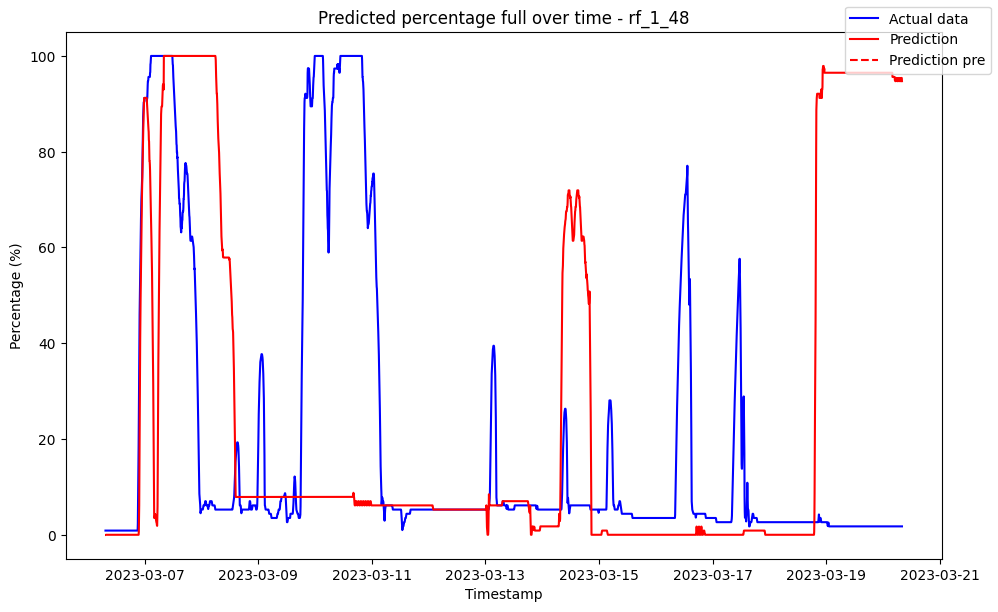

------------------------------------ rf_1_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12101344530293713
Variance (R²) score: 1.00


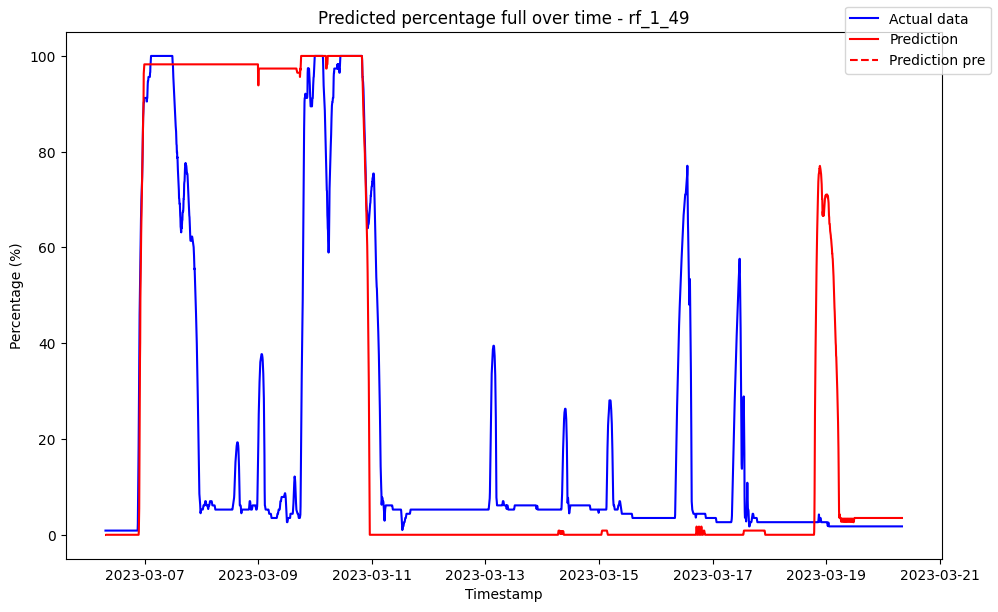

------------------------------------ rf_1_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019676               0.0
1 2023-03-06 07:35:00            0.019676               0.0
2 2023-03-06 07:40:00            0.019676               0.0
3 2023-03-06 07:45:00            0.019676               0.0
4 2023-03-06 07:50:00            0.019676               0.0
5 2023-03-06 07:55:00            0.019676               0.0

Metrics for this specific prediction:
Accuracy: 99.87%
Mean squared error: 1.306437380040289
Variance (R²) score: 1.00


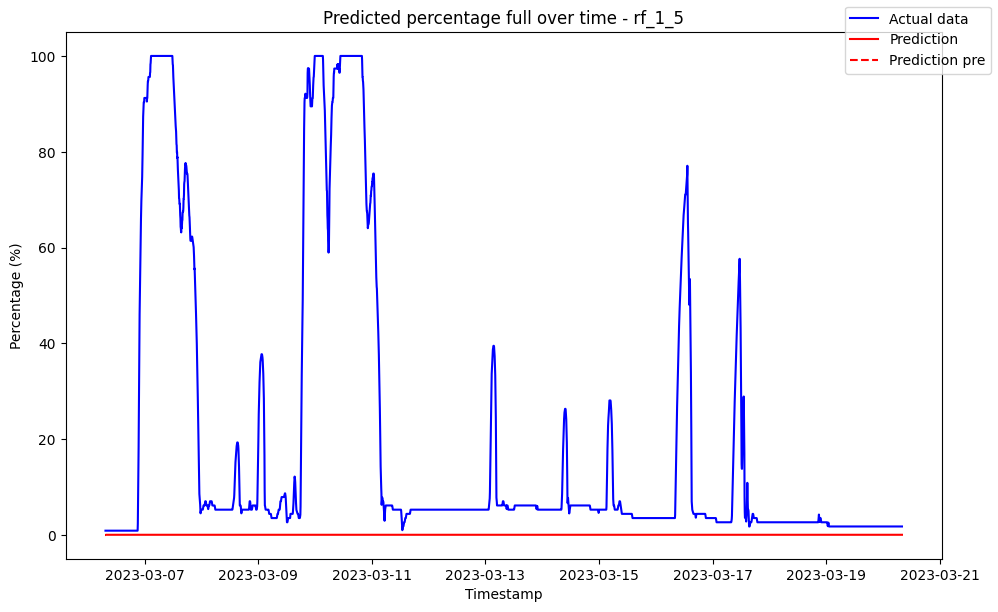

------------------------------------ rf_1_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11741152192083945
Variance (R²) score: 1.00


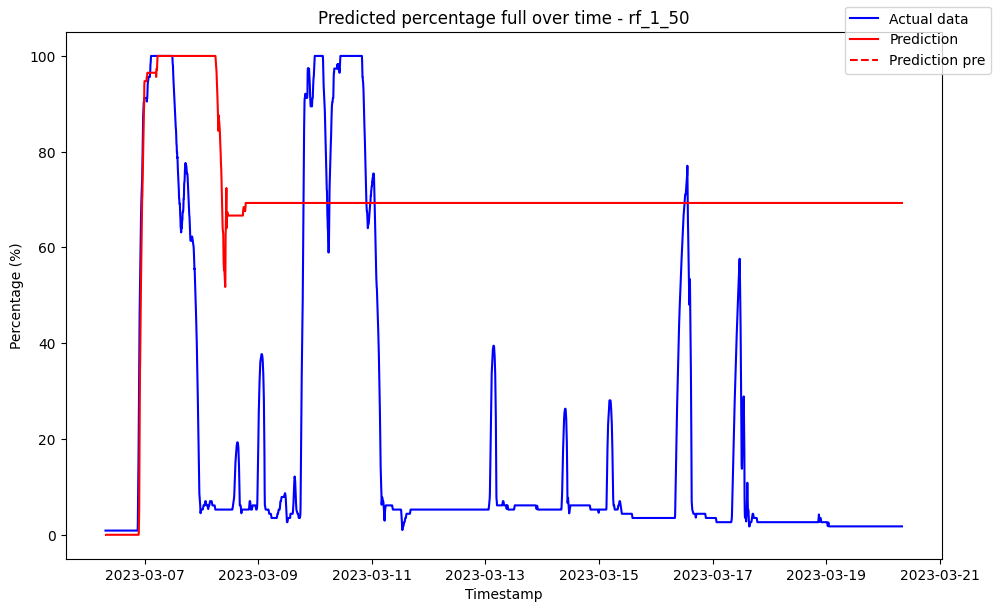

------------------------------------ rf_1_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00             0.01884               0.0
1 2023-03-06 07:35:00             0.01884               0.0
2 2023-03-06 07:40:00             0.01884               0.0
3 2023-03-06 07:45:00             0.01884               0.0
4 2023-03-06 07:50:00             0.01884               0.0
5 2023-03-06 07:55:00             0.01884               0.0

Metrics for this specific prediction:
Accuracy: 99.92%
Mean squared error: 0.7973322713063193
Variance (R²) score: 1.00


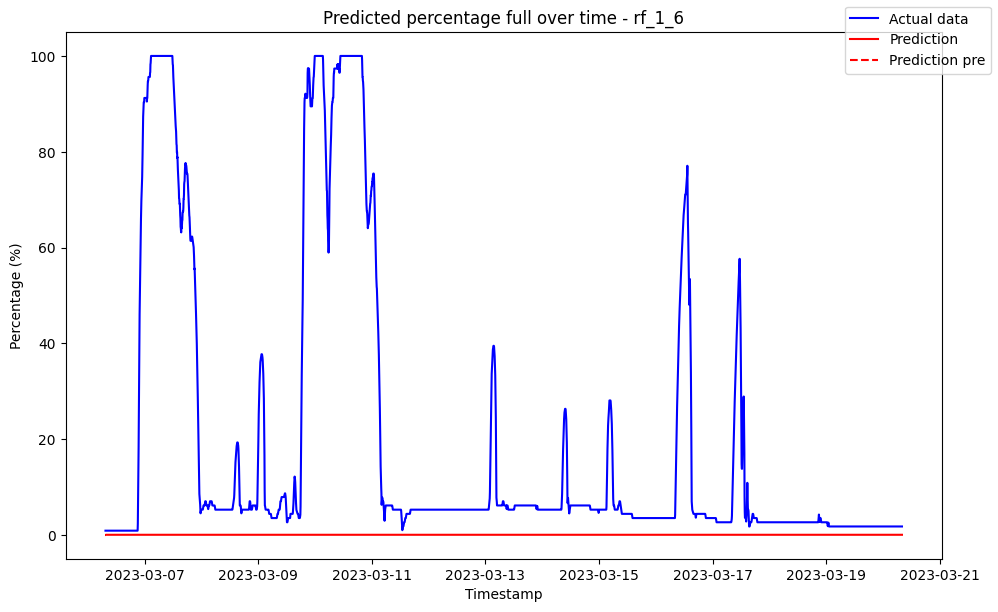

------------------------------------ rf_1_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007317               0.0
1 2023-03-06 07:35:00            0.007317               0.0
2 2023-03-06 07:40:00            0.007317               0.0
3 2023-03-06 07:45:00            0.007317               0.0
4 2023-03-06 07:50:00            0.007317               0.0
5 2023-03-06 07:55:00            0.007317               0.0

Metrics for this specific prediction:
Accuracy: 99.93%
Mean squared error: 0.7043759756038077
Variance (R²) score: 1.00


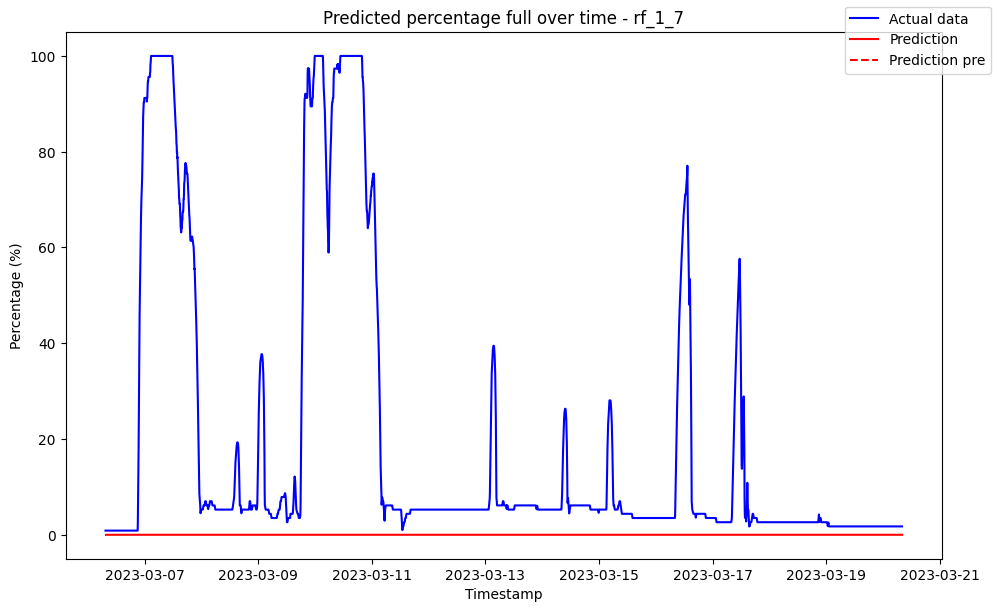

------------------------------------ rf_1_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006365               0.0
1 2023-03-06 07:35:00            0.006365               0.0
2 2023-03-06 07:40:00            0.006365               0.0
3 2023-03-06 07:45:00            0.006365               0.0
4 2023-03-06 07:50:00            0.006365               0.0
5 2023-03-06 07:55:00            0.006365               0.0

Metrics for this specific prediction:
Accuracy: 99.95%
Mean squared error: 0.5121962928923944
Variance (R²) score: 1.00


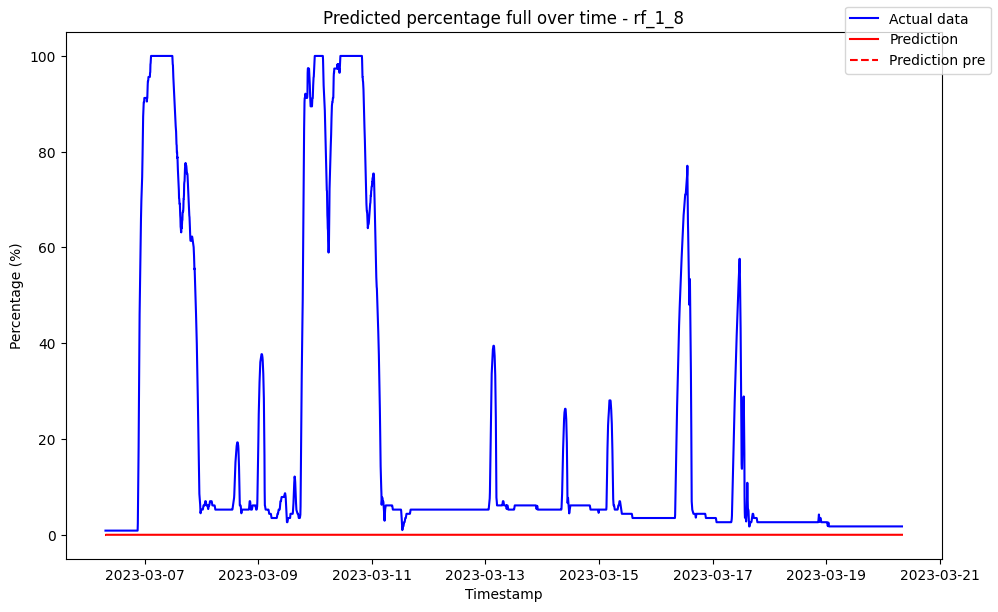

------------------------------------ rf_1_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005707               0.0
1 2023-03-06 07:35:00            0.005707               0.0
2 2023-03-06 07:40:00            0.005707               0.0
3 2023-03-06 07:45:00            0.005707               0.0
4 2023-03-06 07:50:00            0.005707               0.0
5 2023-03-06 07:55:00            0.005707               0.0

Metrics for this specific prediction:
Accuracy: 99.96%
Mean squared error: 0.3865655176620027
Variance (R²) score: 1.00


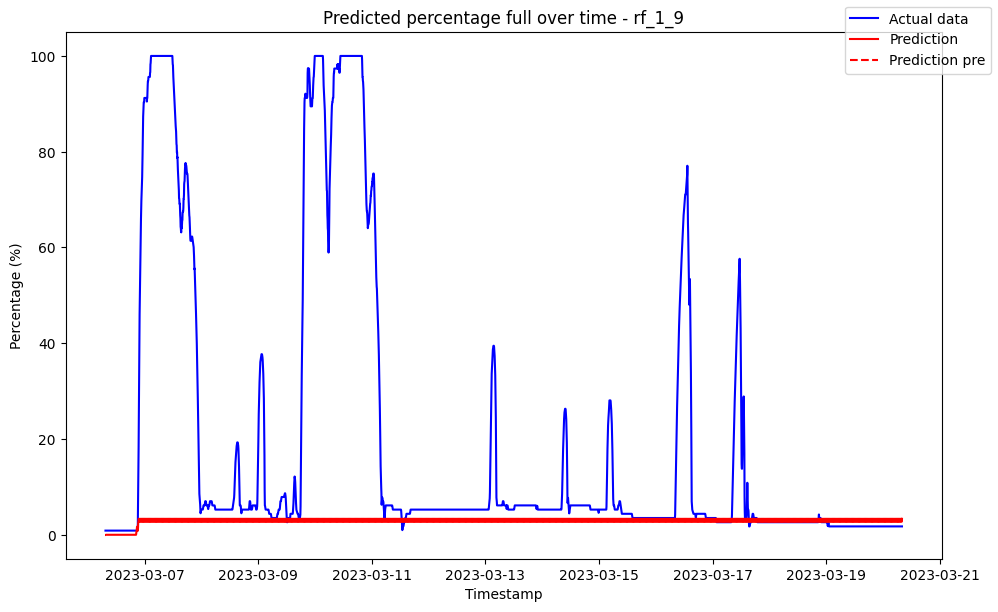

------------------------------------ rf_2_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.536326               0.0
1 2023-03-06 07:35:00            3.536326               0.0
2 2023-03-06 07:40:00            3.536326               0.0
3 2023-03-06 07:45:00            3.536326               0.0
4 2023-03-06 07:50:00            3.536326               0.0
5 2023-03-06 07:55:00            3.536326               0.0

Metrics for this specific prediction:
Accuracy: 89.47%
Mean squared error: 107.56736787845075
Variance (R²) score: 0.89


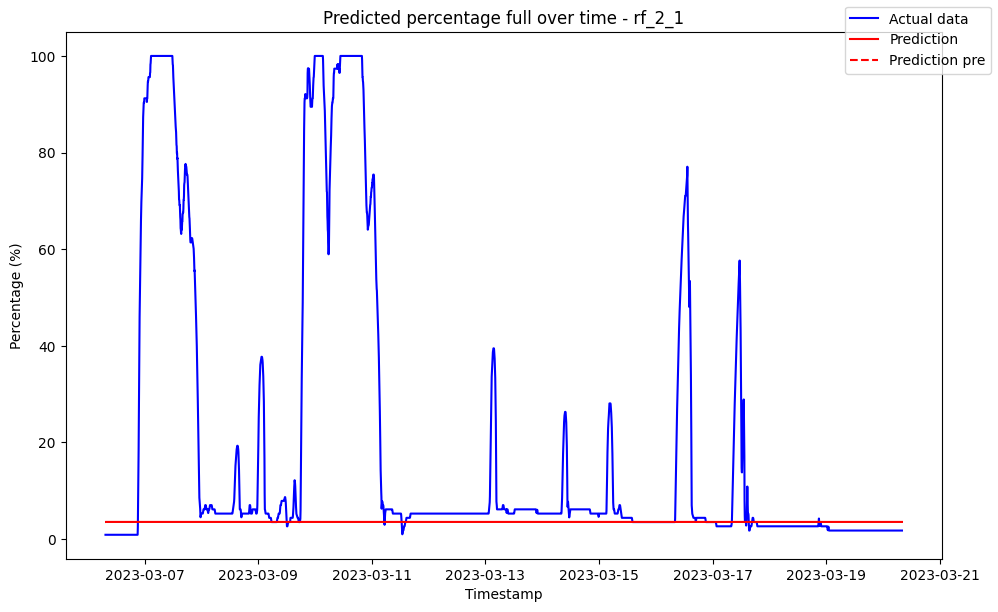

------------------------------------ rf_2_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.031512               0.0
1 2023-03-06 07:35:00            0.322146               0.0
2 2023-03-06 07:40:00            0.588137               0.0
3 2023-03-06 07:45:00            0.837586               0.0
4 2023-03-06 07:50:00            0.776004               0.0
5 2023-03-06 07:55:00            0.666066               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.2329813281332381
Variance (R²) score: 1.00


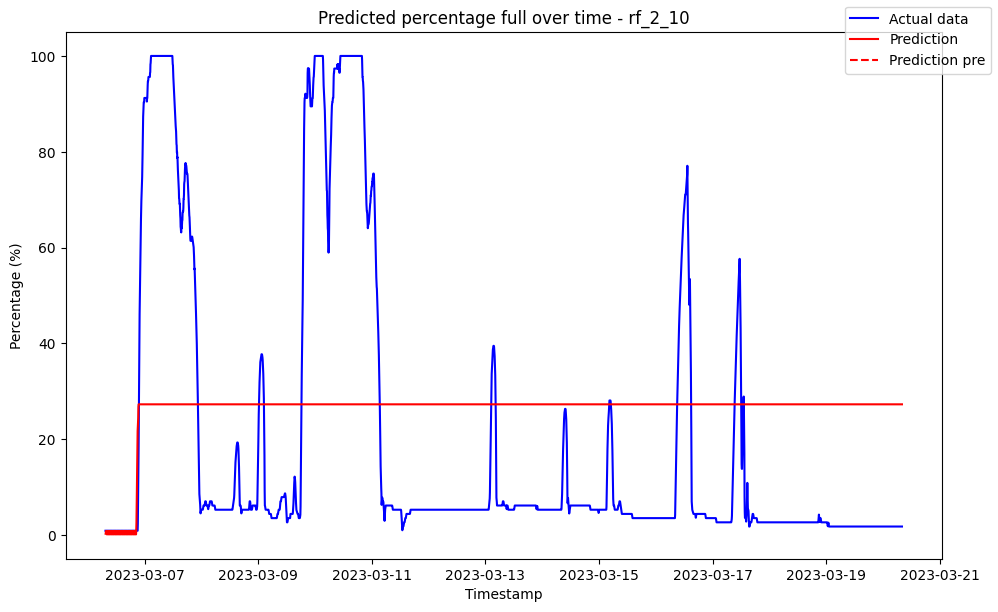

------------------------------------ rf_2_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.022747               0.0
1 2023-03-06 07:35:00            0.309353               0.0
2 2023-03-06 07:40:00            0.593958               0.0
3 2023-03-06 07:45:00            0.835377               0.0
4 2023-03-06 07:50:00            0.682294               0.0
5 2023-03-06 07:55:00            0.357310               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.17946233616476295
Variance (R²) score: 1.00


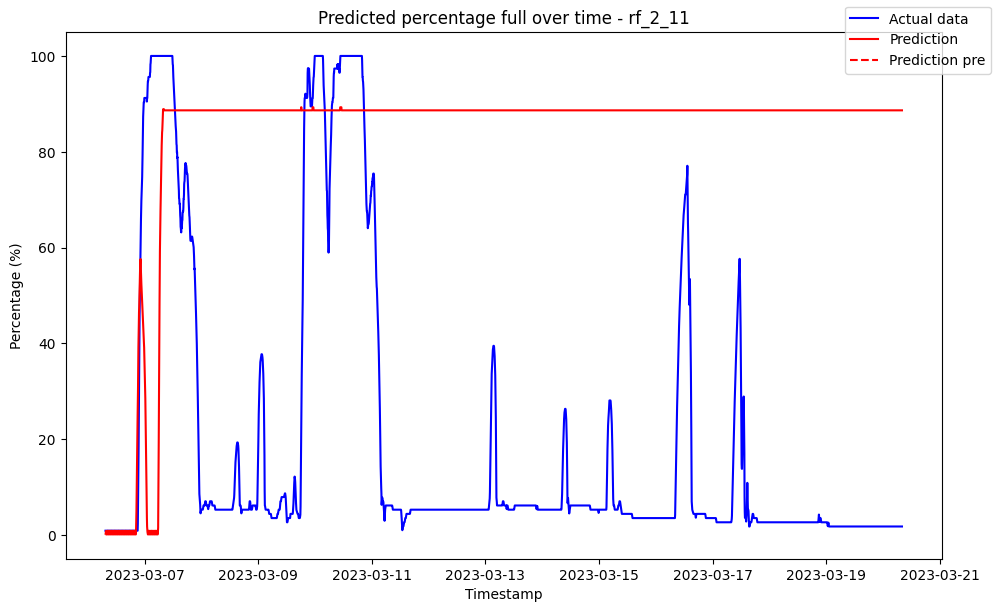

------------------------------------ rf_2_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.015379               0.0
1 2023-03-06 07:35:00            0.015379               0.0
2 2023-03-06 07:40:00            0.015379               0.0
3 2023-03-06 07:45:00            0.015379               0.0
4 2023-03-06 07:50:00            0.015379               0.0
5 2023-03-06 07:55:00            0.015379               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14096422402401498
Variance (R²) score: 1.00


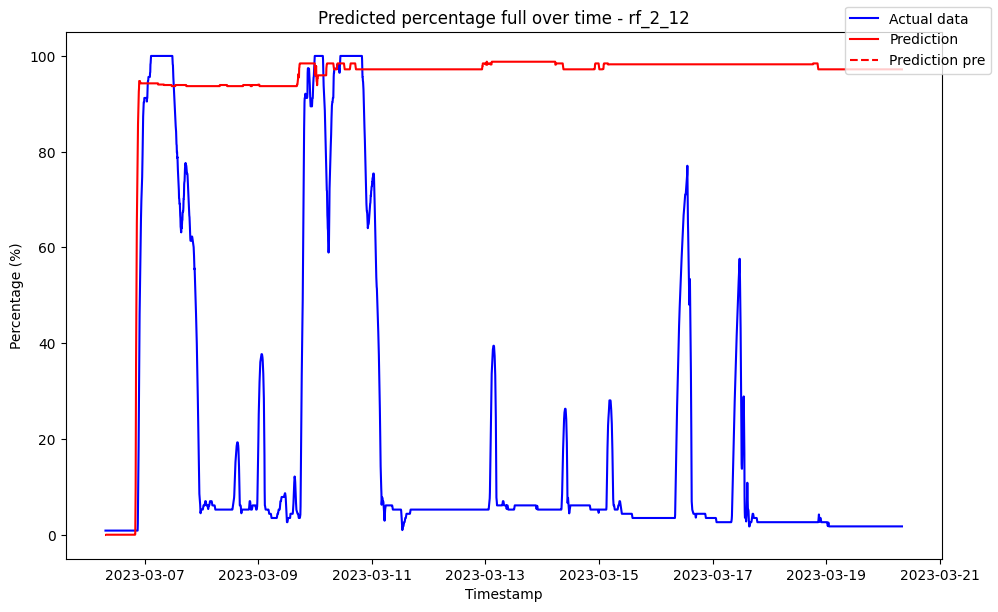

------------------------------------ rf_2_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.008559               0.0
1 2023-03-06 07:35:00            0.008559               0.0
2 2023-03-06 07:40:00            0.008559               0.0
3 2023-03-06 07:45:00            0.008559               0.0
4 2023-03-06 07:50:00            0.008559               0.0
5 2023-03-06 07:55:00            0.008559               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12760238411223895
Variance (R²) score: 1.00


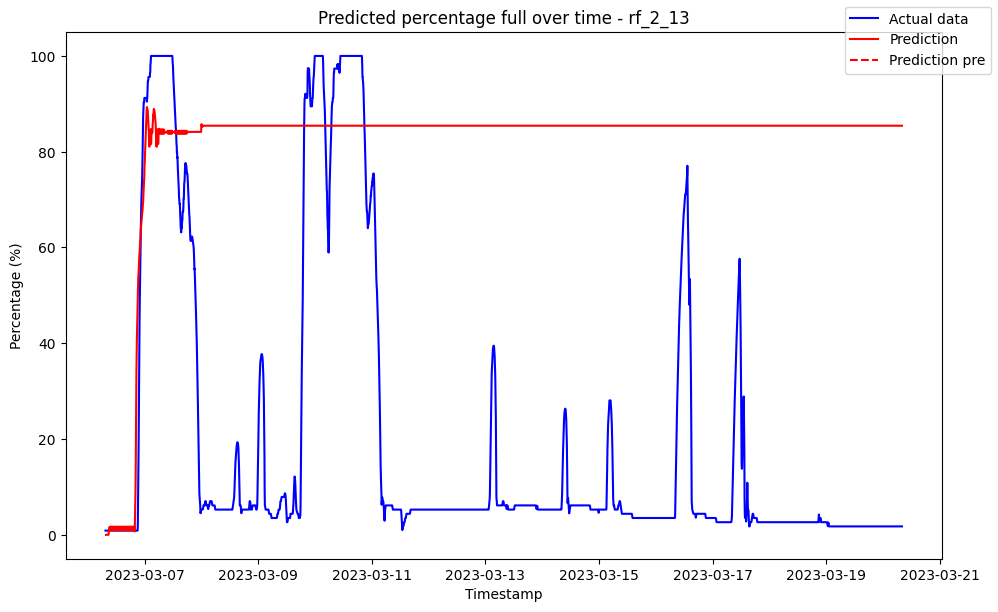

------------------------------------ rf_2_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007484               0.0
1 2023-03-06 07:35:00            0.007484               0.0
2 2023-03-06 07:40:00            0.007484               0.0
3 2023-03-06 07:45:00            0.007484               0.0
4 2023-03-06 07:50:00            0.007484               0.0
5 2023-03-06 07:55:00            0.007484               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1205388288129266
Variance (R²) score: 1.00


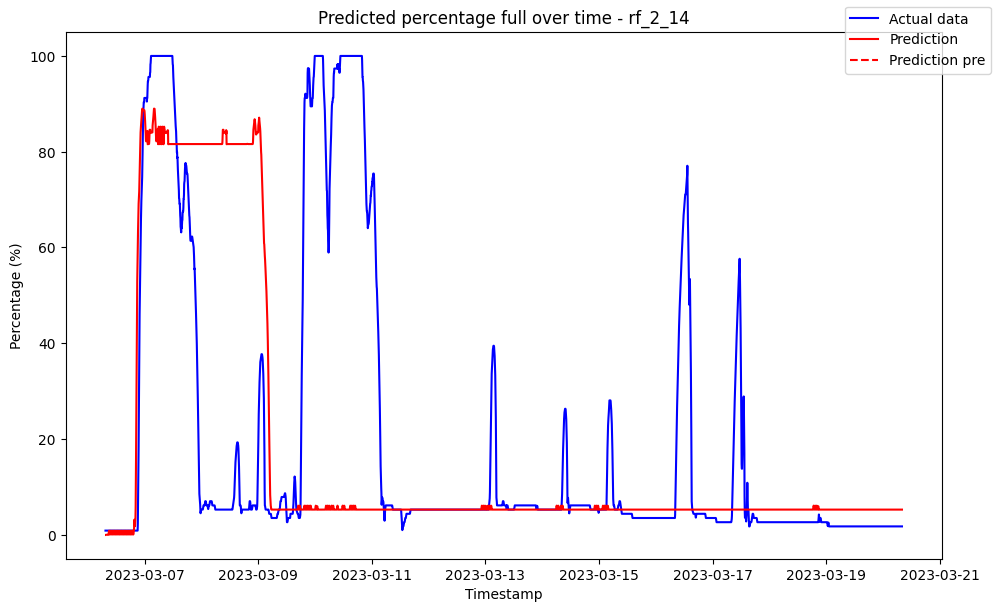

------------------------------------ rf_2_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007915               0.0
1 2023-03-06 07:35:00            0.007915               0.0
2 2023-03-06 07:40:00            0.007915               0.0
3 2023-03-06 07:45:00            0.007915               0.0
4 2023-03-06 07:50:00            0.007915               0.0
5 2023-03-06 07:55:00            0.007915               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11312316966881127
Variance (R²) score: 1.00


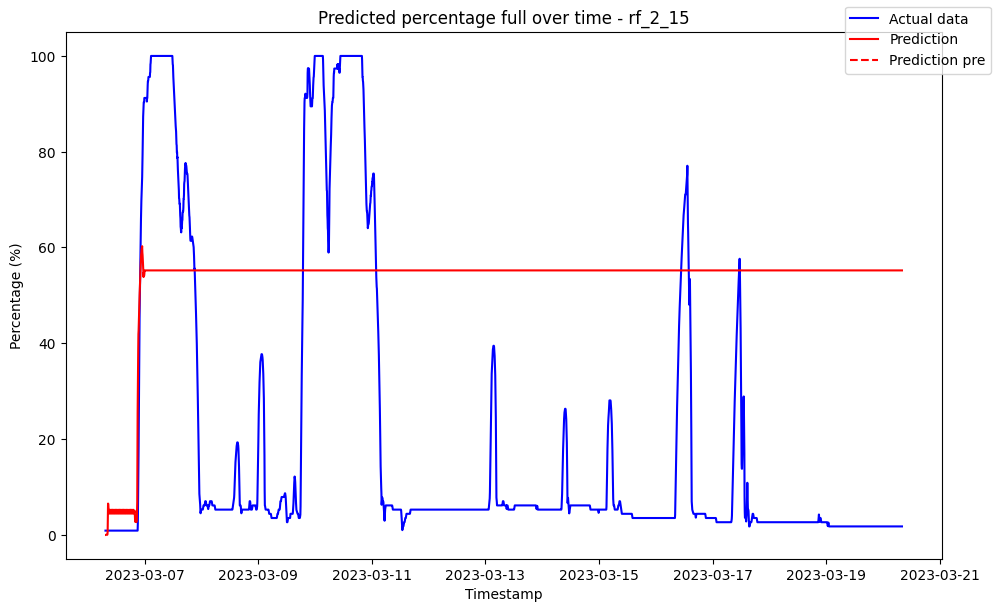

------------------------------------ rf_2_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009307               0.0
1 2023-03-06 07:35:00            0.009307               0.0
2 2023-03-06 07:40:00            0.009307               0.0
3 2023-03-06 07:45:00            0.009307               0.0
4 2023-03-06 07:50:00            0.009307               0.0
5 2023-03-06 07:55:00            0.009307               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10763371933511193
Variance (R²) score: 1.00


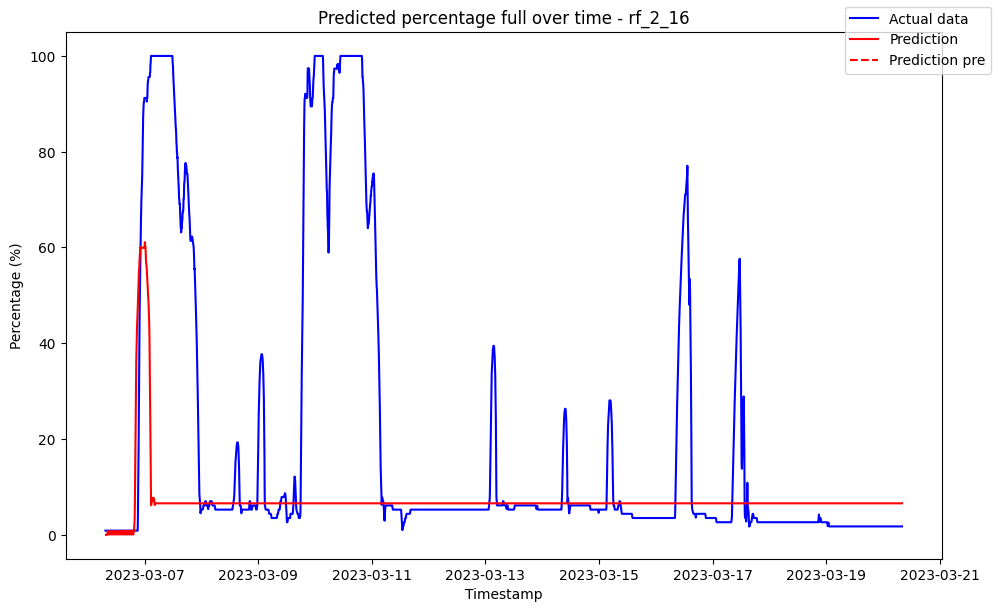

------------------------------------ rf_2_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006632               0.0
1 2023-03-06 07:35:00            0.006632               0.0
2 2023-03-06 07:40:00            0.006632               0.0
3 2023-03-06 07:45:00            0.006632               0.0
4 2023-03-06 07:50:00            0.006632               0.0
5 2023-03-06 07:55:00            0.006632               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10027083610082303
Variance (R²) score: 1.00


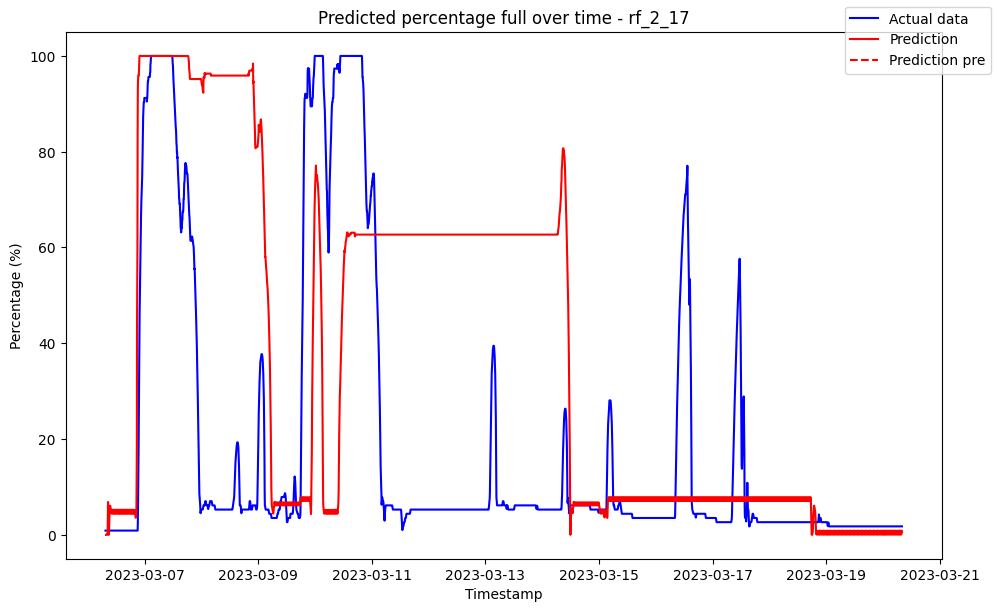

------------------------------------ rf_2_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.011368               0.0
1 2023-03-06 07:35:00            0.011368               0.0
2 2023-03-06 07:40:00            0.011368               0.0
3 2023-03-06 07:45:00            0.011368               0.0
4 2023-03-06 07:50:00            0.011368               0.0
5 2023-03-06 07:55:00            0.011368               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10117525581831642
Variance (R²) score: 1.00


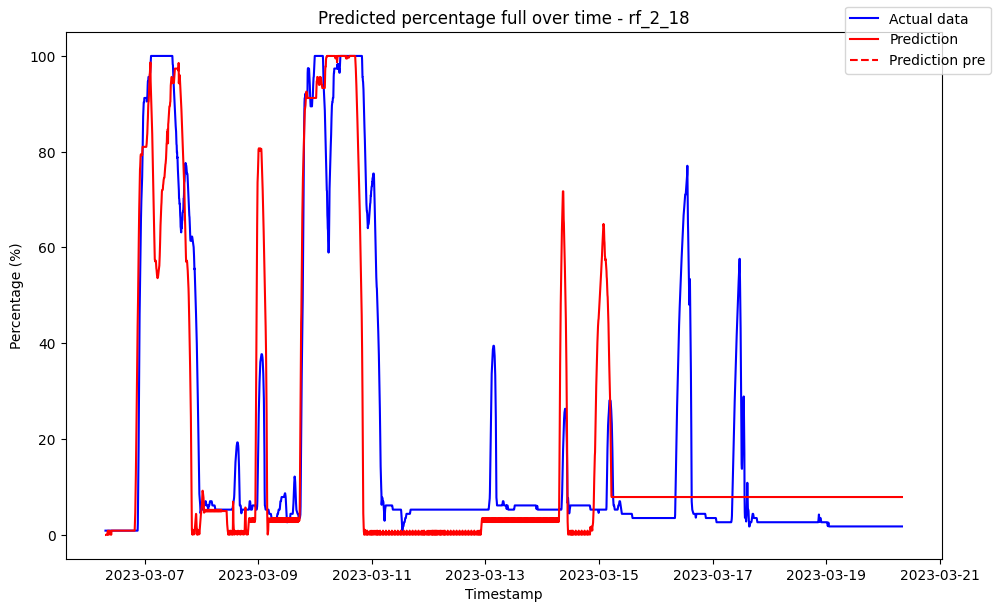

------------------------------------ rf_2_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009634               0.0
1 2023-03-06 07:35:00            0.009634               0.0
2 2023-03-06 07:40:00            0.009634               0.0
3 2023-03-06 07:45:00            0.009634               0.0
4 2023-03-06 07:50:00            0.009634               0.0
5 2023-03-06 07:55:00            0.009634               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10093888551518224
Variance (R²) score: 1.00


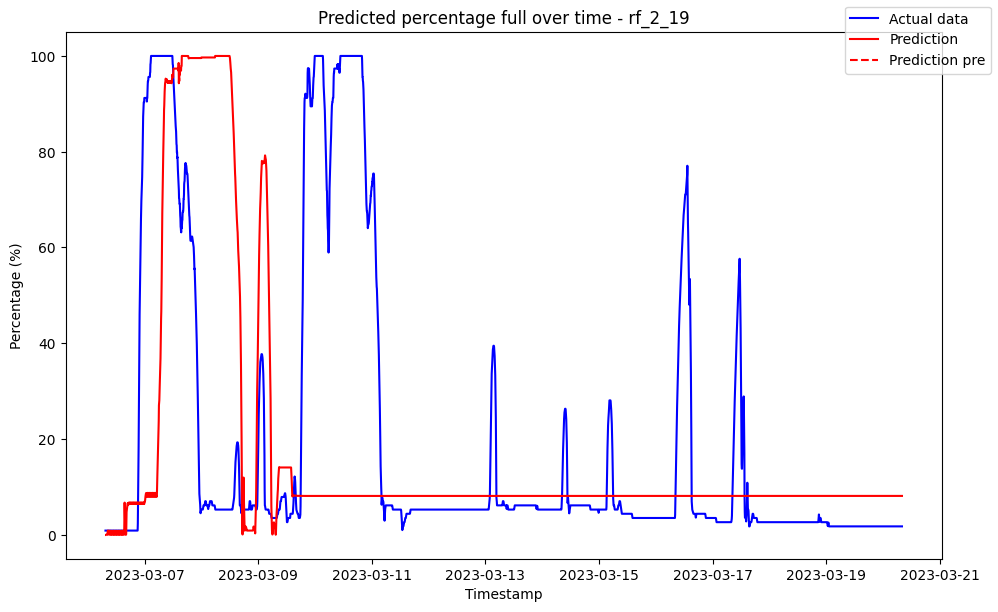

------------------------------------ rf_2_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            1.206466               0.0
1 2023-03-06 07:35:00            1.206466               0.0
2 2023-03-06 07:40:00            1.206466               0.0
3 2023-03-06 07:45:00            1.206466               0.0
4 2023-03-06 07:50:00            1.206466               0.0
5 2023-03-06 07:55:00            1.206466               0.0

Metrics for this specific prediction:
Accuracy: 96.29%
Mean squared error: 37.90448779859316
Variance (R²) score: 0.96


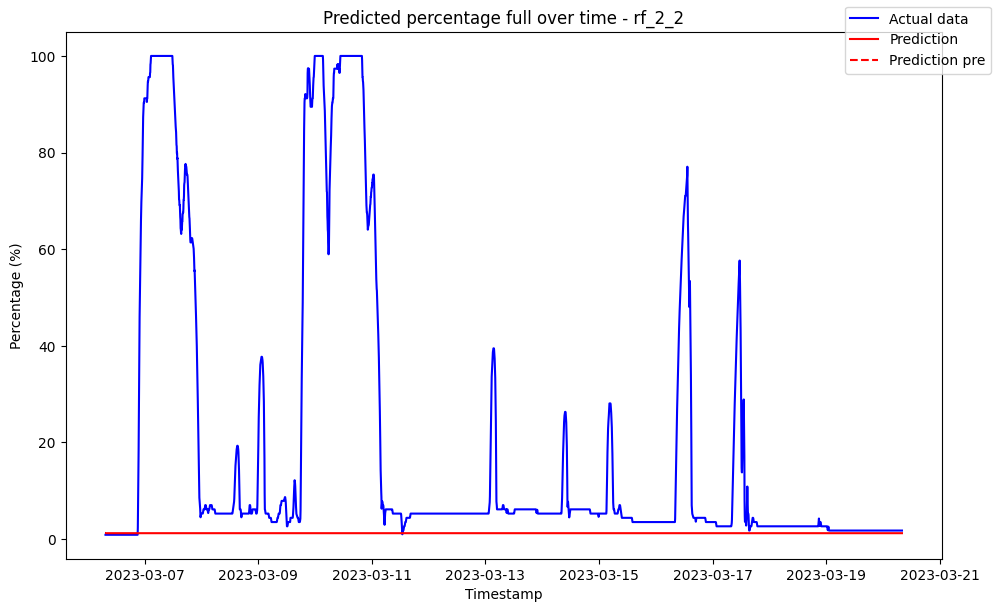

------------------------------------ rf_2_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.003763               0.0
1 2023-03-06 07:35:00            0.003763               0.0
2 2023-03-06 07:40:00            0.003763               0.0
3 2023-03-06 07:45:00            0.003763               0.0
4 2023-03-06 07:50:00            0.003763               0.0
5 2023-03-06 07:55:00            0.003763               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10283256973534384
Variance (R²) score: 1.00


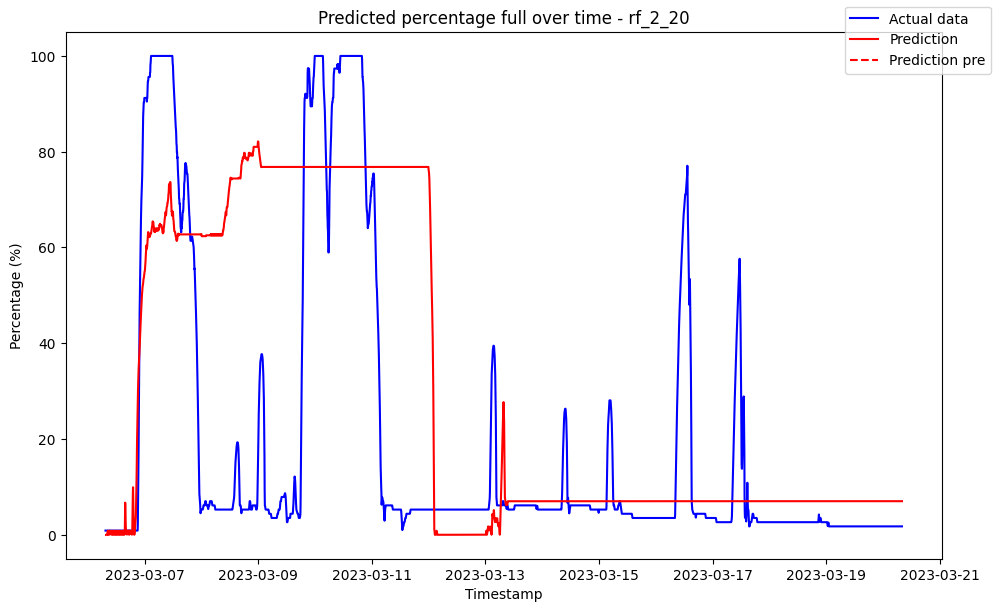

------------------------------------ rf_2_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006327               0.0
1 2023-03-06 07:35:00            0.006327               0.0
2 2023-03-06 07:40:00            0.006327               0.0
3 2023-03-06 07:45:00            0.006327               0.0
4 2023-03-06 07:50:00            0.006327               0.0
5 2023-03-06 07:55:00            0.006327               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09657448905450539
Variance (R²) score: 1.00


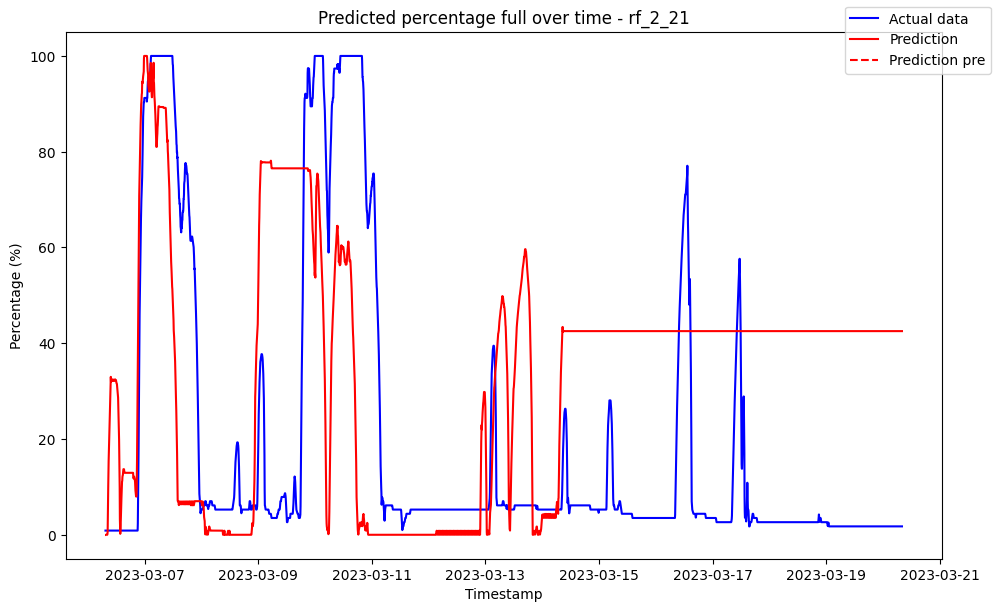

------------------------------------ rf_2_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019462               0.0
1 2023-03-06 07:35:00            0.156500               0.0
2 2023-03-06 07:40:00            0.608278               0.0
3 2023-03-06 07:45:00            0.868500               0.0
4 2023-03-06 07:50:00            0.568500               0.0
5 2023-03-06 07:55:00            0.281000               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09550886726852661
Variance (R²) score: 1.00


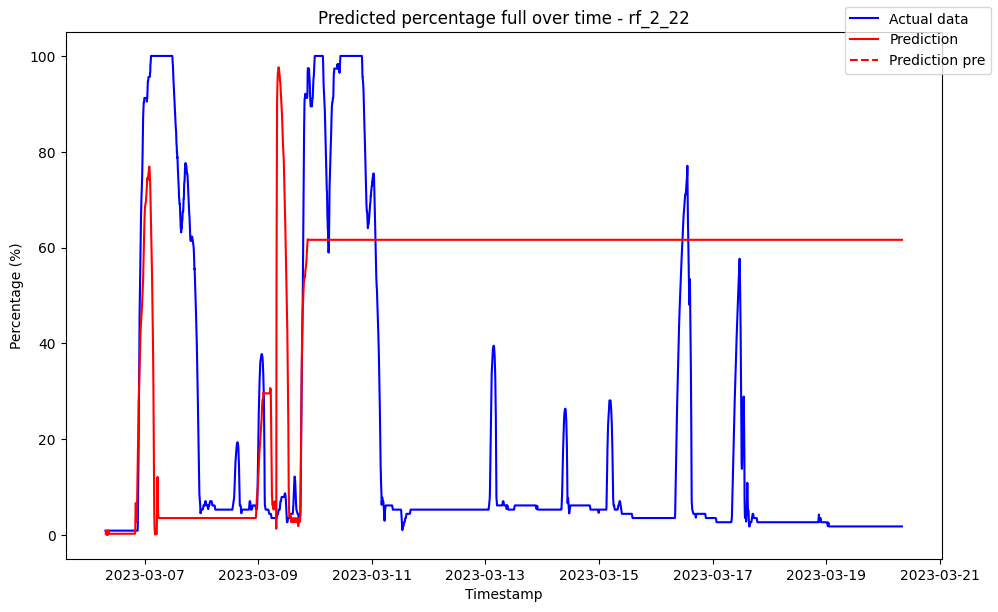

------------------------------------ rf_2_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10224157403205218
Variance (R²) score: 1.00


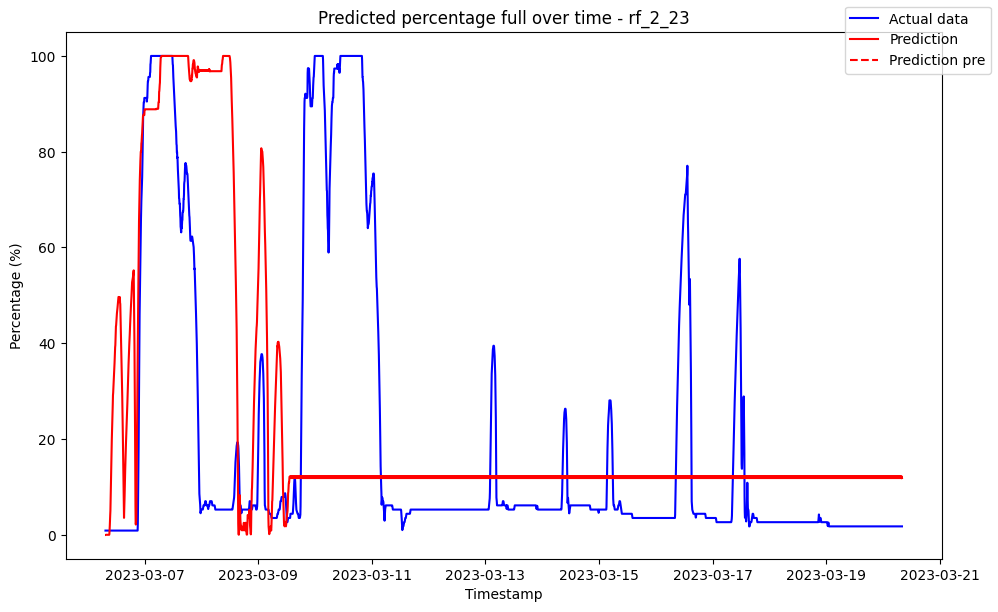

------------------------------------ rf_2_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09956794415674418
Variance (R²) score: 1.00


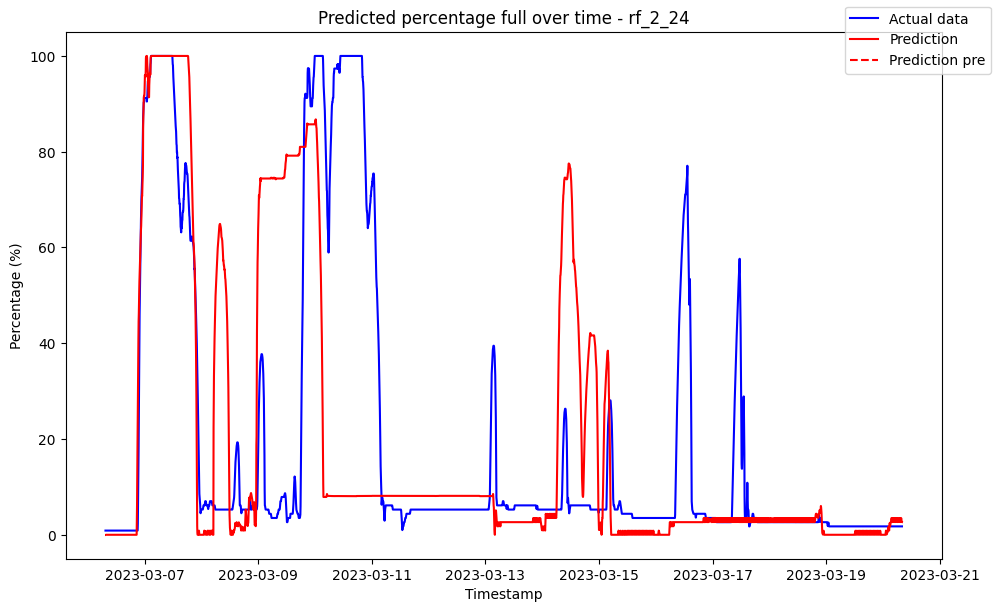

------------------------------------ rf_2_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1017742153039782
Variance (R²) score: 1.00


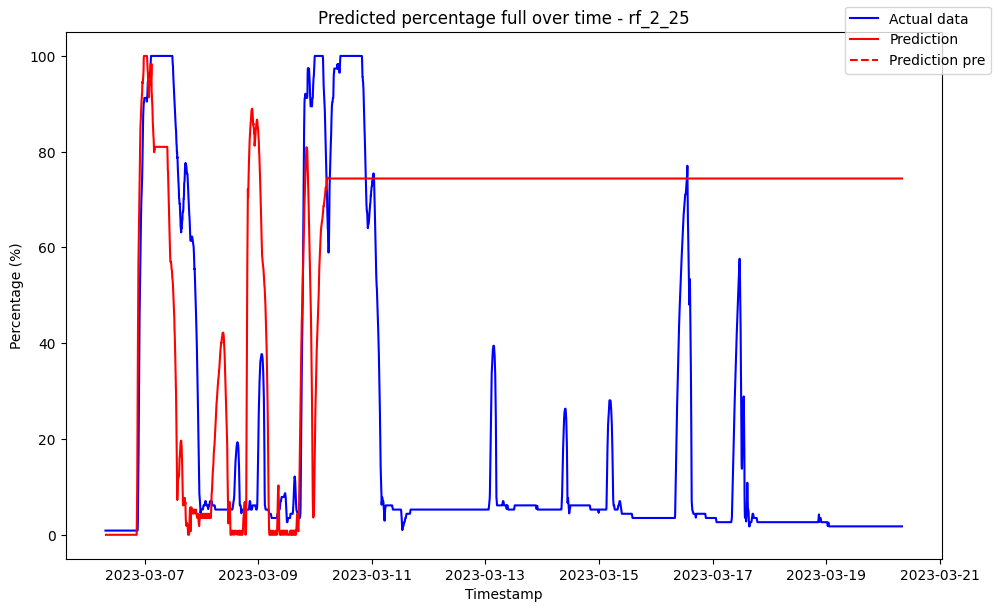

------------------------------------ rf_2_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09788598602643231
Variance (R²) score: 1.00


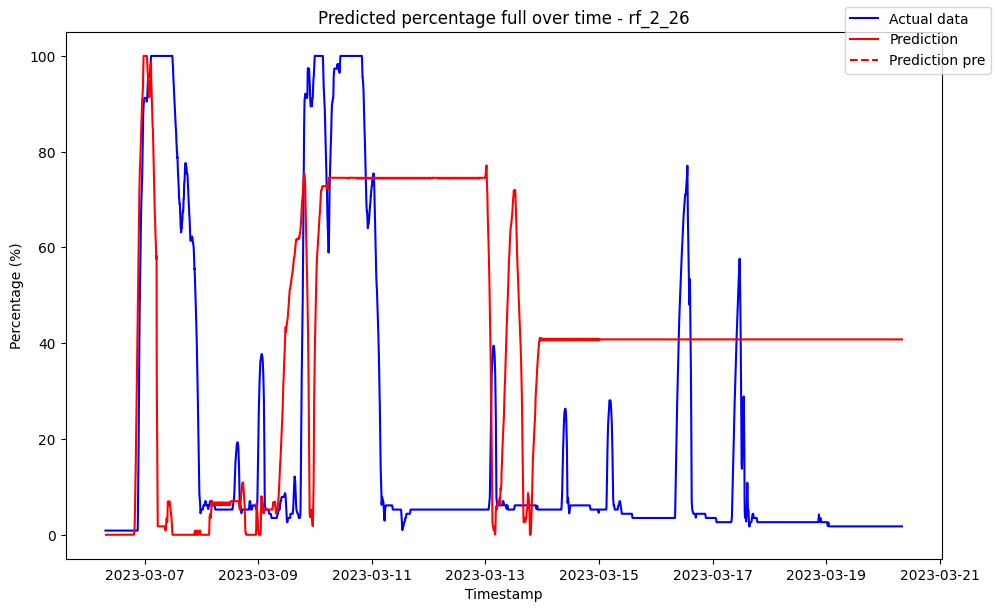

------------------------------------ rf_2_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10448172948540034
Variance (R²) score: 1.00


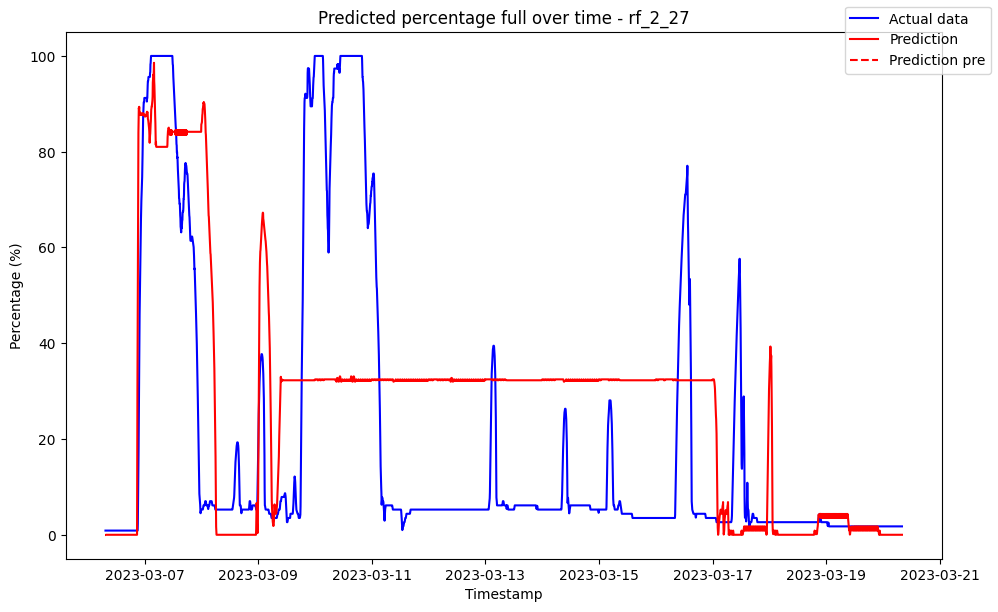

------------------------------------ rf_2_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09623950676201753
Variance (R²) score: 1.00


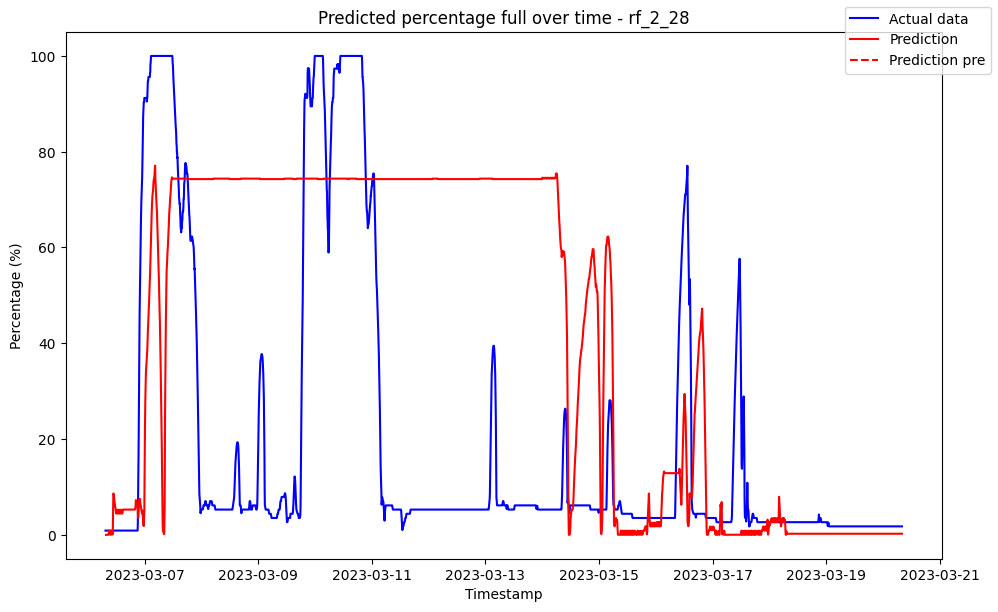

------------------------------------ rf_2_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10046392225684678
Variance (R²) score: 1.00


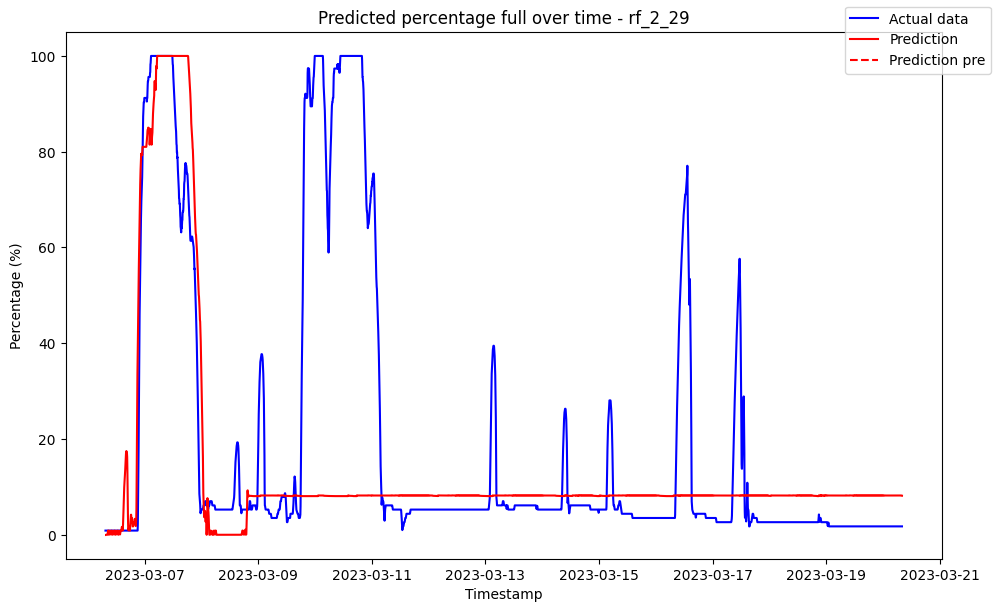

------------------------------------ rf_2_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.457814               0.0
1 2023-03-06 07:35:00            0.457814               0.0
2 2023-03-06 07:40:00            0.457814               0.0
3 2023-03-06 07:45:00            0.457814               0.0
4 2023-03-06 07:50:00            0.457814               0.0
5 2023-03-06 07:55:00            0.457814               0.0

Metrics for this specific prediction:
Accuracy: 99.32%
Mean squared error: 6.993837878321176
Variance (R²) score: 0.99


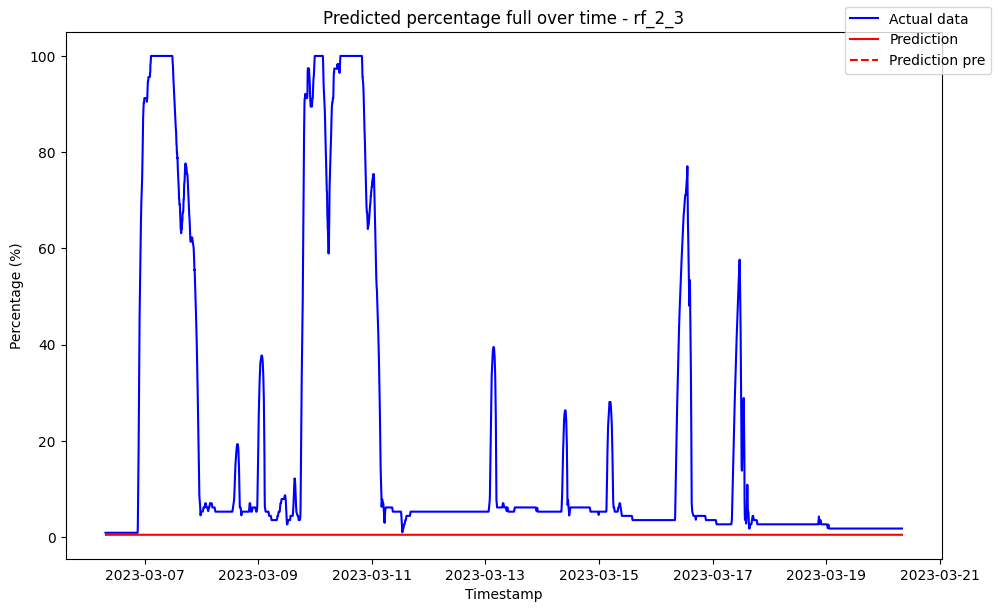

------------------------------------ rf_2_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09881490955971954
Variance (R²) score: 1.00


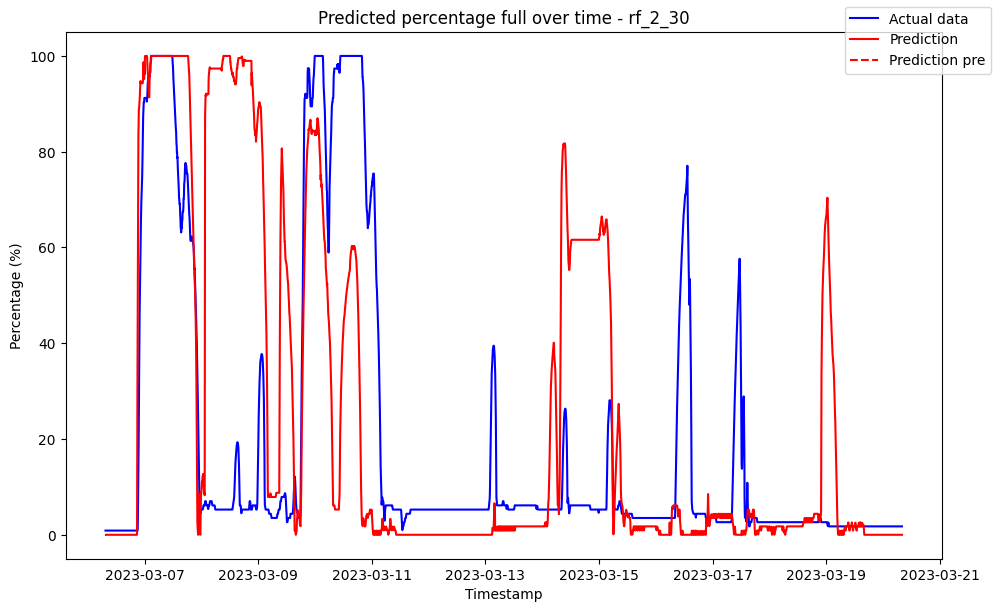

------------------------------------ rf_2_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10336609074677174
Variance (R²) score: 1.00


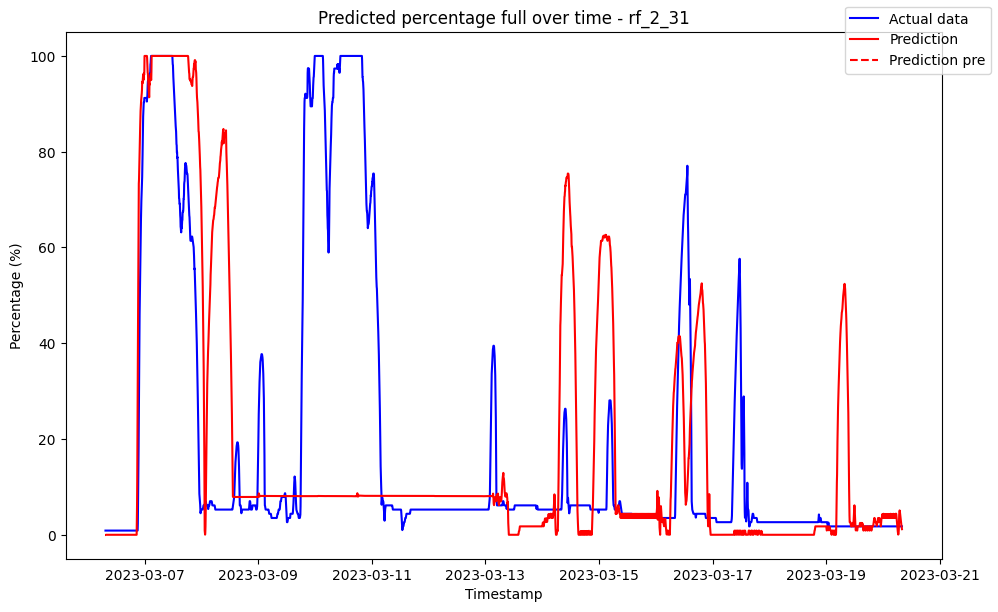

------------------------------------ rf_2_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10533825613063987
Variance (R²) score: 1.00


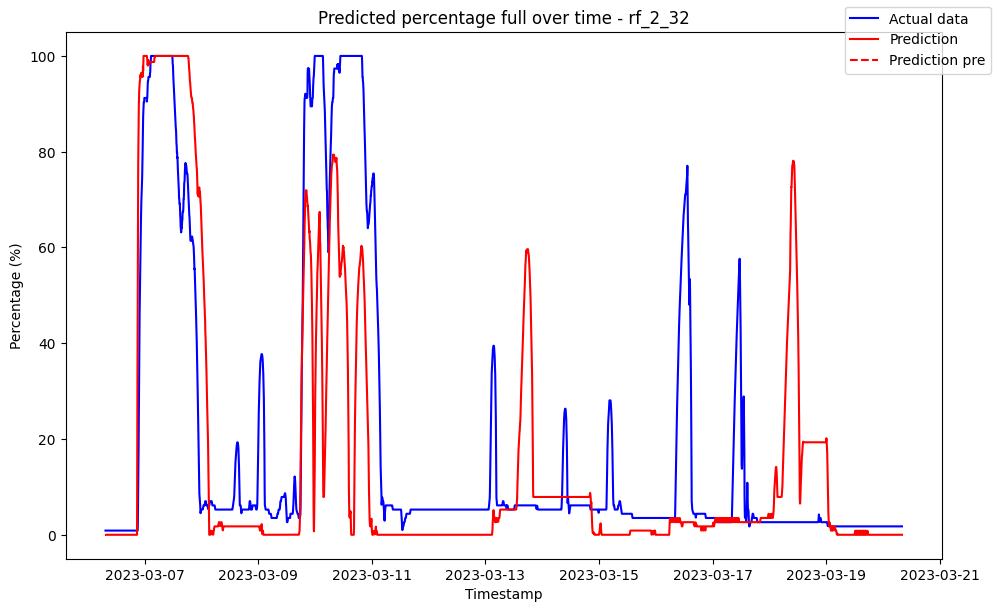

------------------------------------ rf_2_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10432617652735668
Variance (R²) score: 1.00


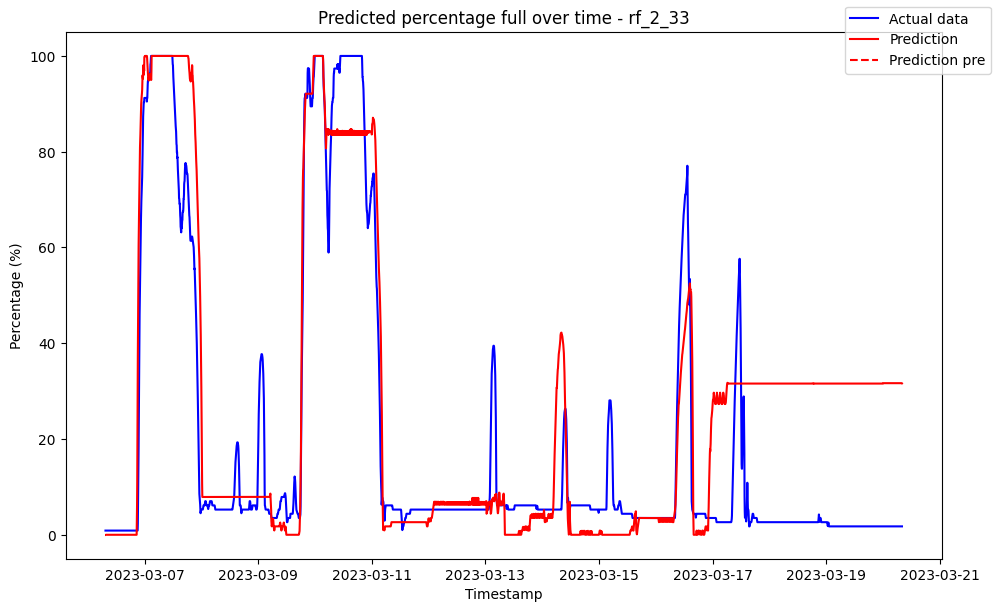

------------------------------------ rf_2_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10610666299952062
Variance (R²) score: 1.00


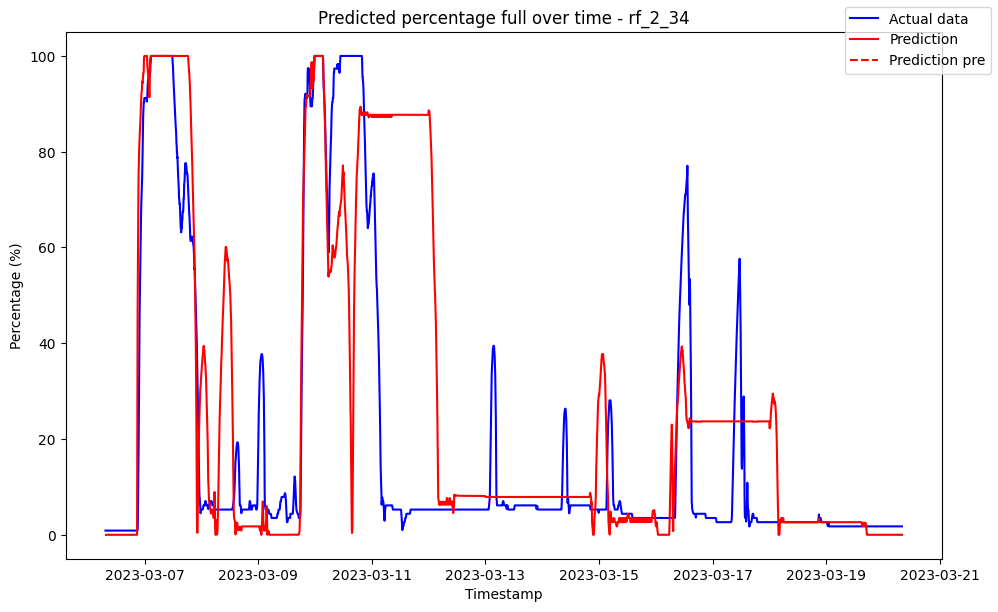

------------------------------------ rf_2_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10483692967924299
Variance (R²) score: 1.00


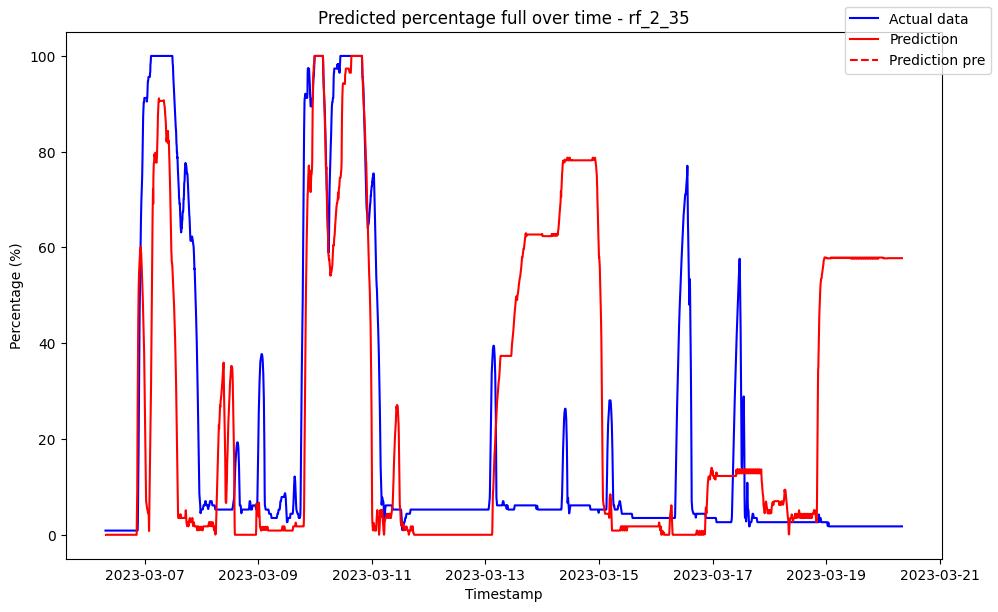

------------------------------------ rf_2_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1024081751412035
Variance (R²) score: 1.00


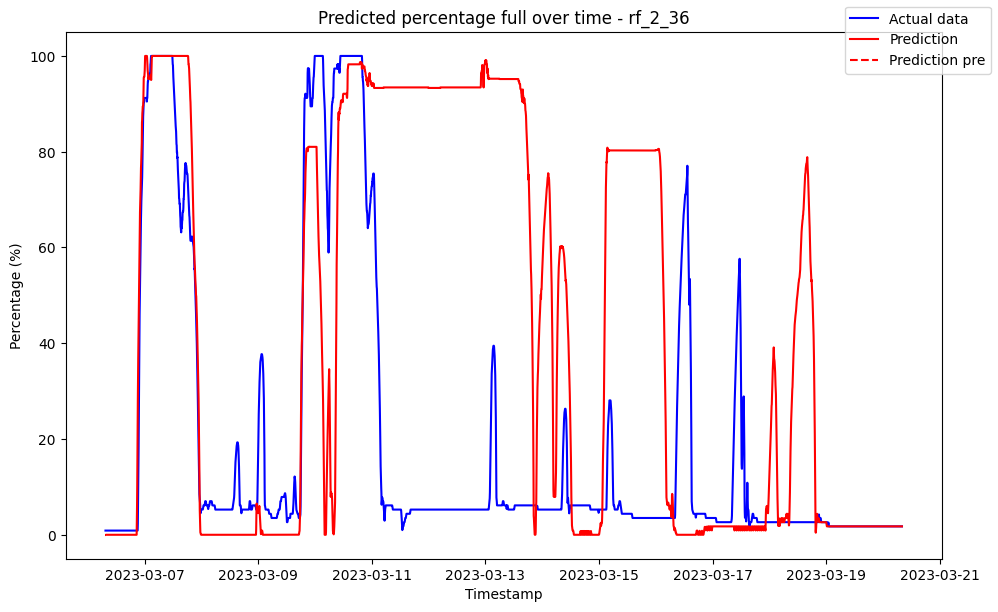

------------------------------------ rf_2_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1009228960734122
Variance (R²) score: 1.00


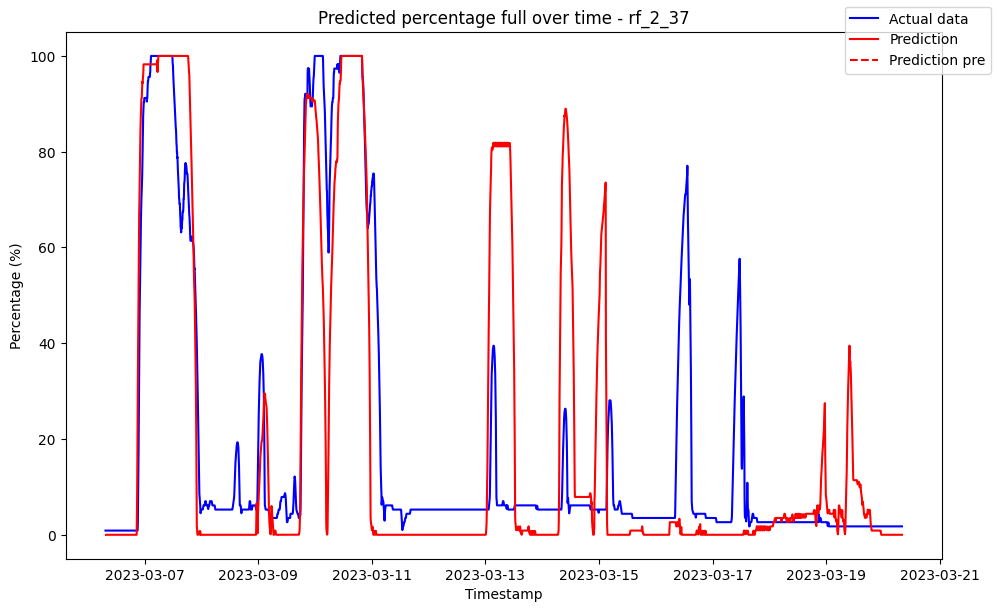

------------------------------------ rf_2_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10407864918108989
Variance (R²) score: 1.00


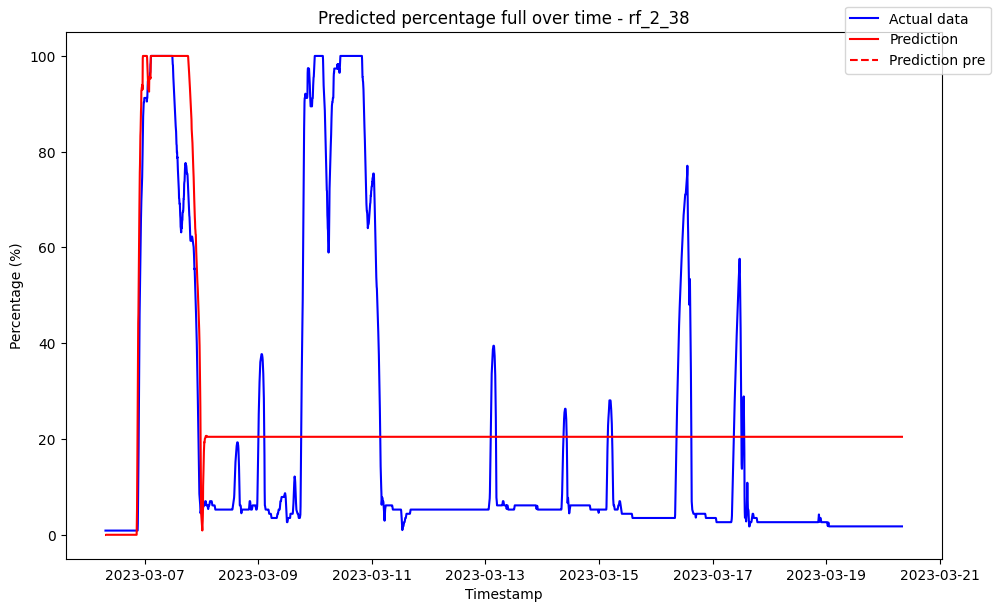

------------------------------------ rf_2_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09746829372044359
Variance (R²) score: 1.00


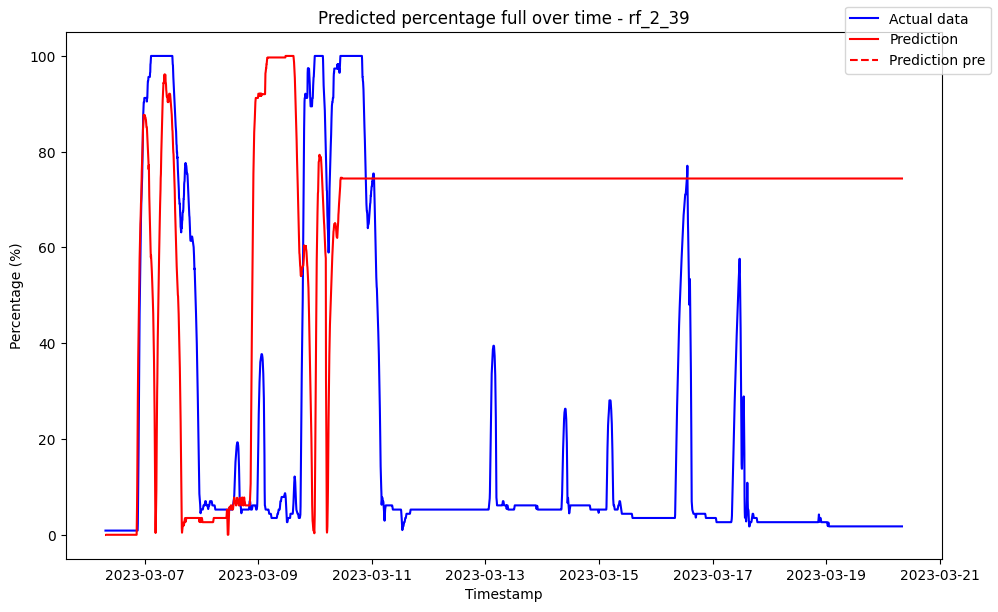

------------------------------------ rf_2_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.021635               0.0
1 2023-03-06 07:35:00            0.021635               0.0
2 2023-03-06 07:40:00            0.021635               0.0
3 2023-03-06 07:45:00            0.021635               0.0
4 2023-03-06 07:50:00            0.021635               0.0
5 2023-03-06 07:55:00            0.021635               0.0

Metrics for this specific prediction:
Accuracy: 99.79%
Mean squared error: 2.1422313202065455
Variance (R²) score: 1.00


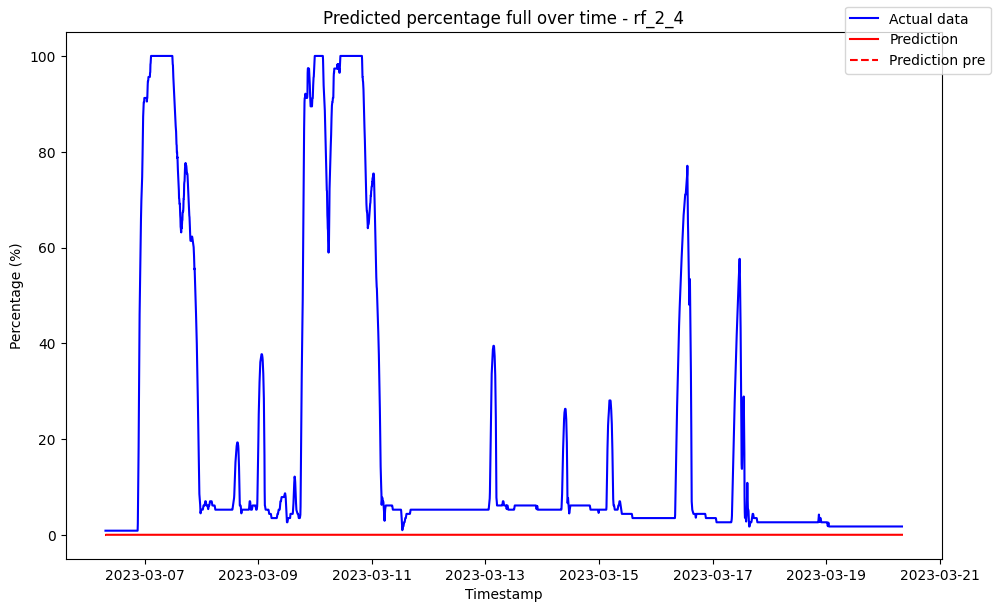

------------------------------------ rf_2_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1065166335801163
Variance (R²) score: 1.00


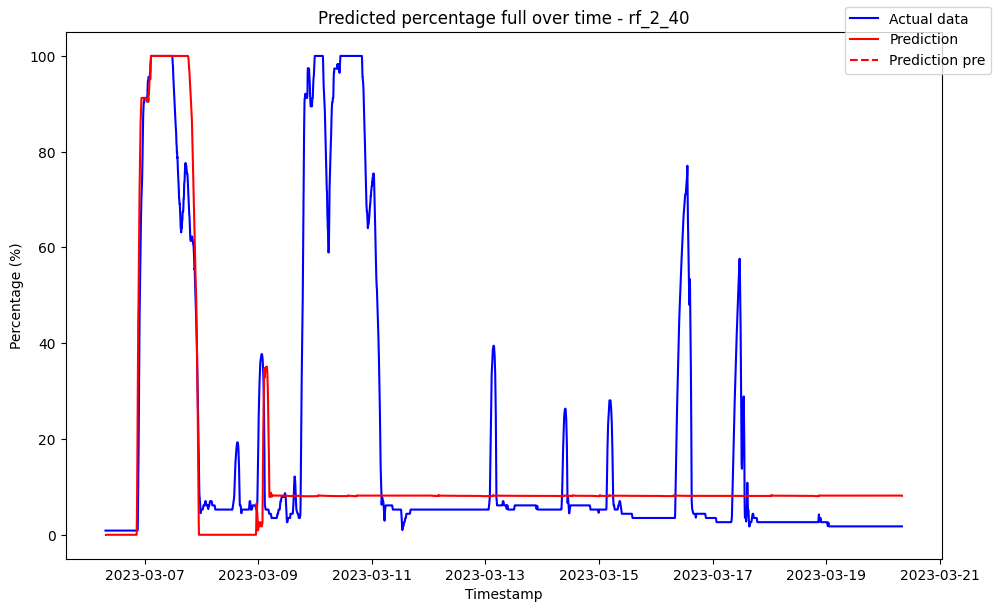

------------------------------------ rf_2_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1047929333729137
Variance (R²) score: 1.00


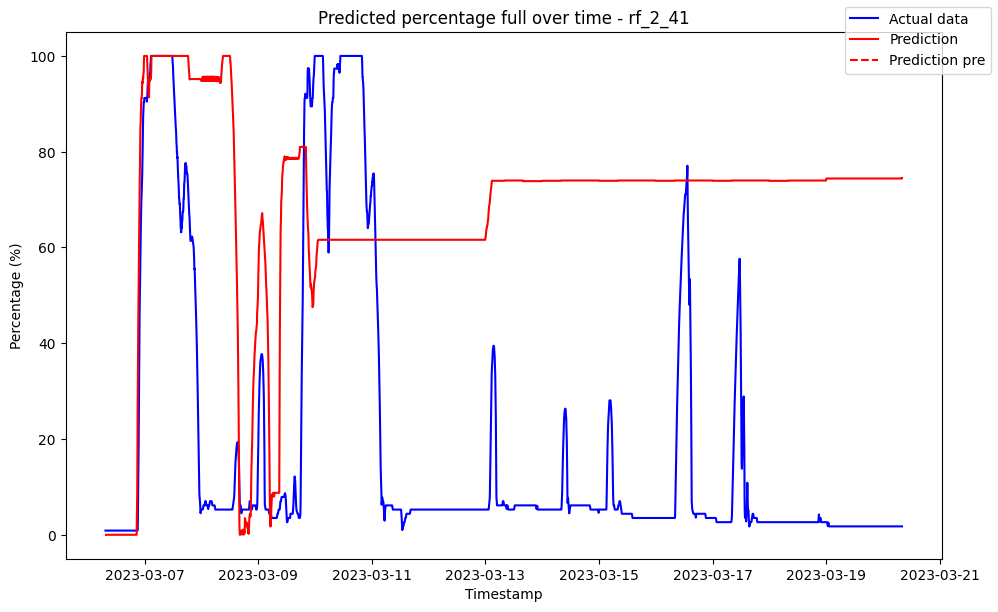

------------------------------------ rf_2_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09433033565574472
Variance (R²) score: 1.00


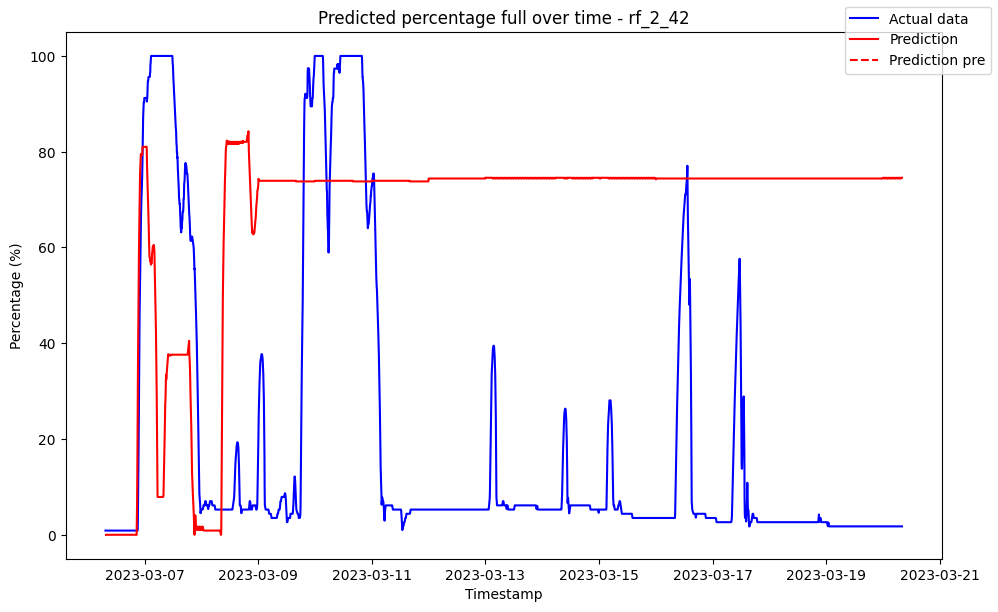

------------------------------------ rf_2_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0985892669274751
Variance (R²) score: 1.00


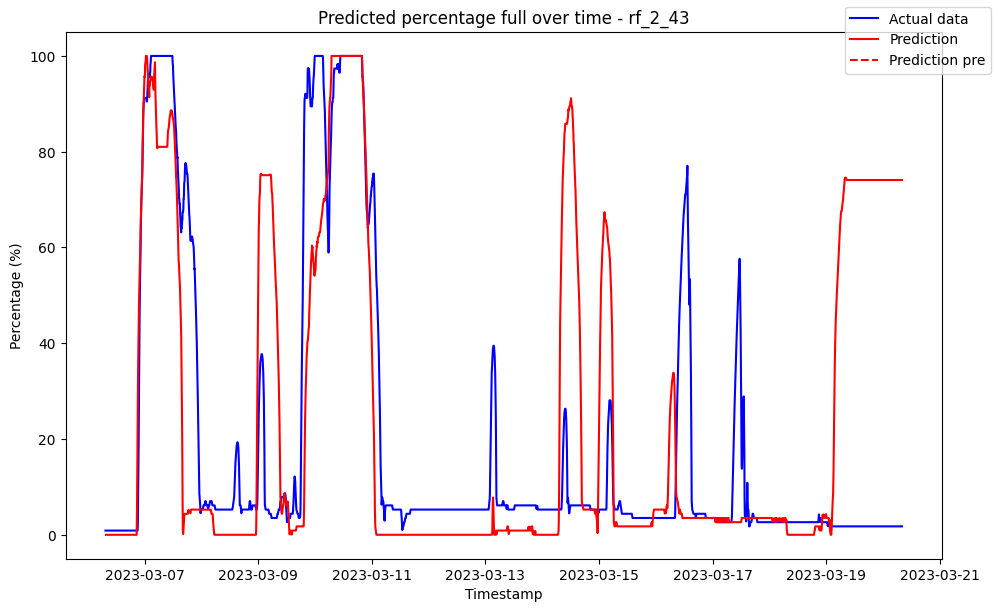

------------------------------------ rf_2_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10262377755507522
Variance (R²) score: 1.00


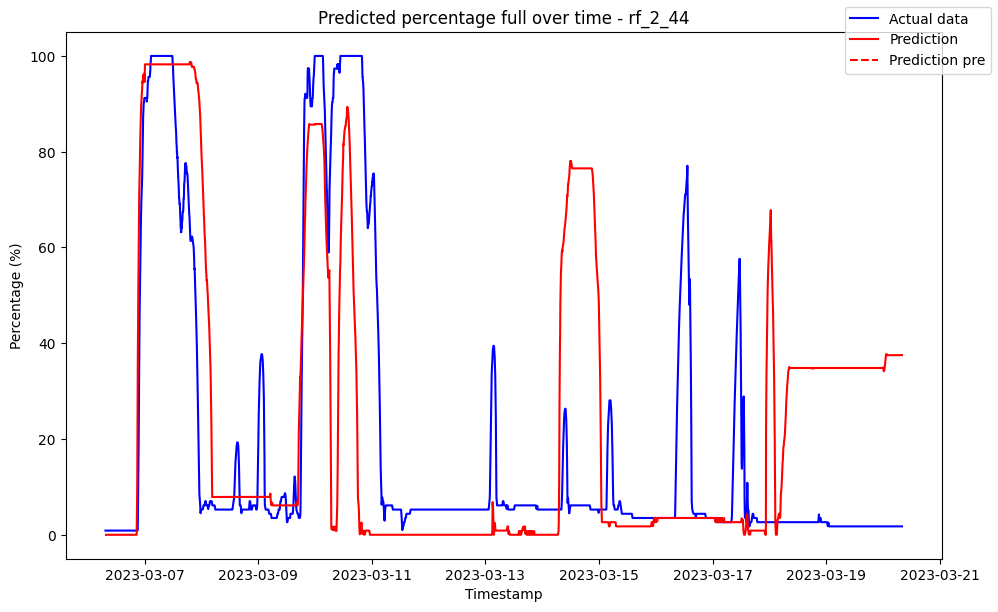

------------------------------------ rf_2_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1031651637784546
Variance (R²) score: 1.00


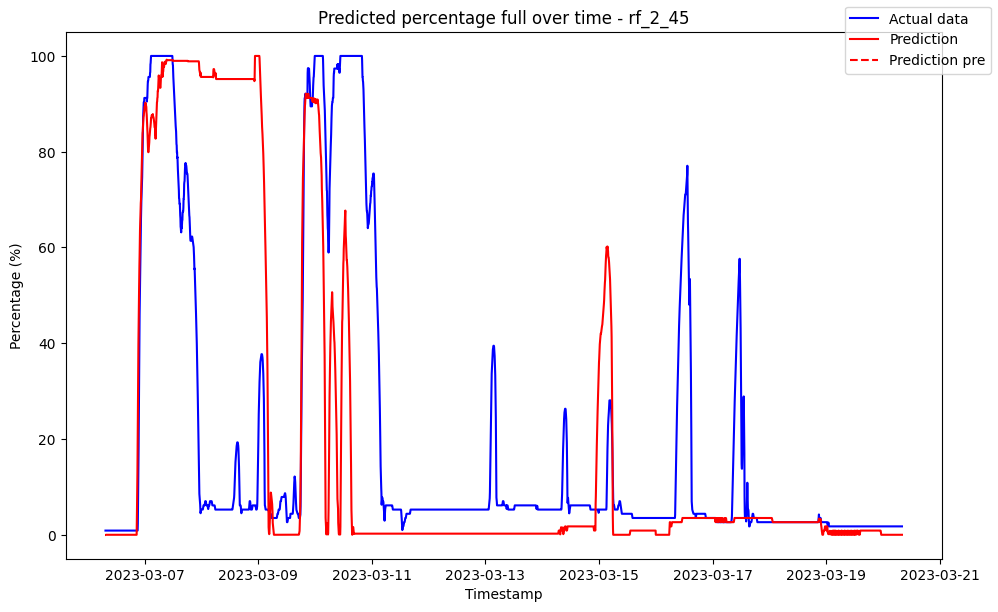

------------------------------------ rf_2_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0990490018022582
Variance (R²) score: 1.00


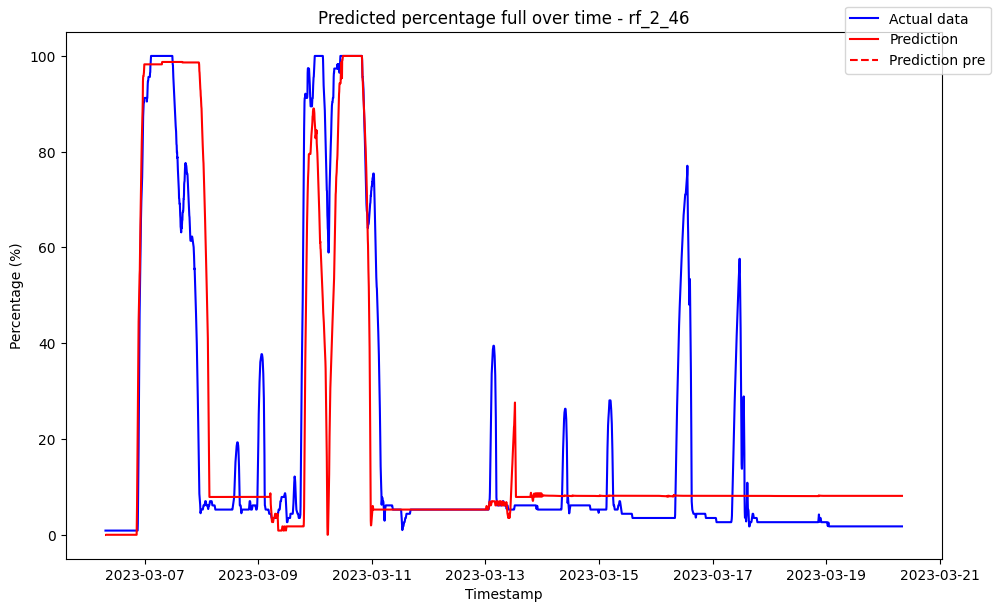

------------------------------------ rf_2_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1016321668158957
Variance (R²) score: 1.00


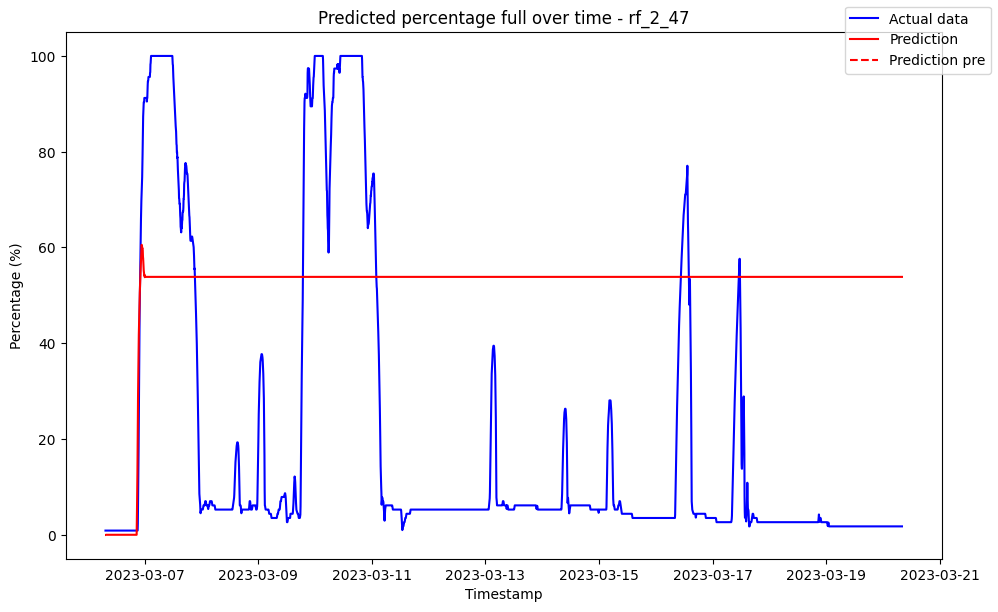

------------------------------------ rf_2_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10234107674646839
Variance (R²) score: 1.00


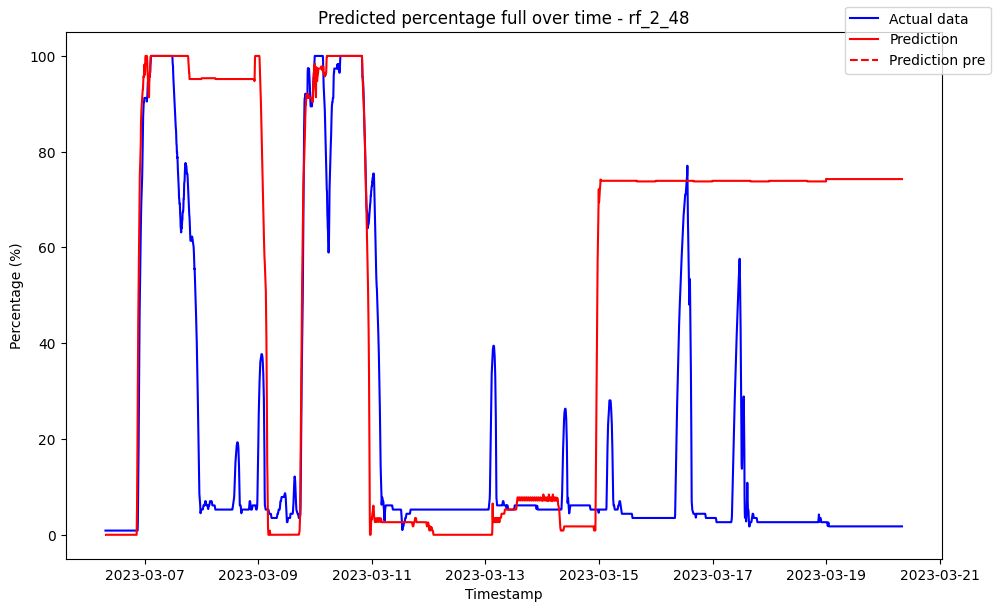

------------------------------------ rf_2_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10115278236263507
Variance (R²) score: 1.00


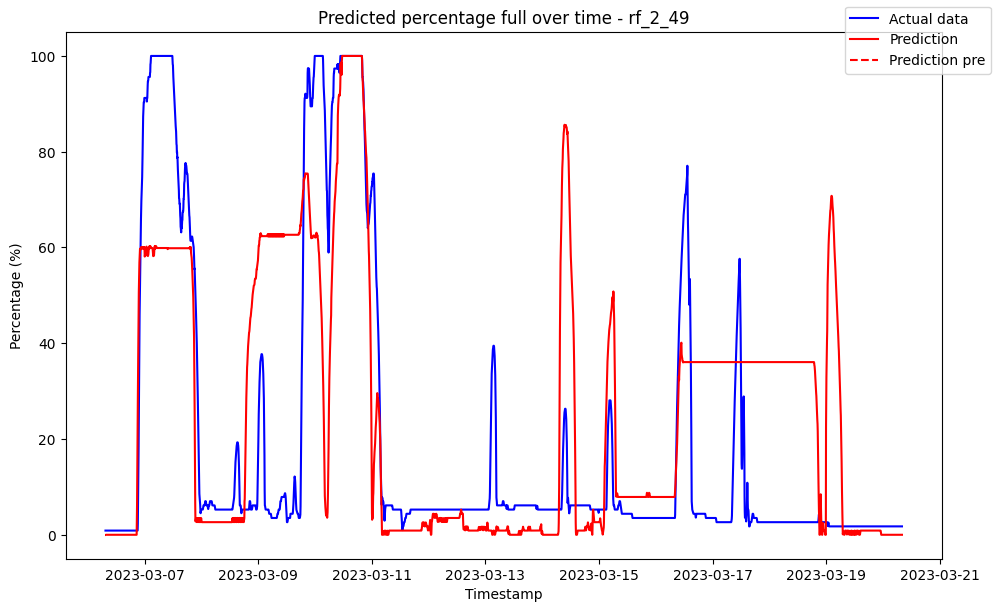

------------------------------------ rf_2_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019895               0.0
1 2023-03-06 07:35:00            0.019895               0.0
2 2023-03-06 07:40:00            0.019895               0.0
3 2023-03-06 07:45:00            0.019895               0.0
4 2023-03-06 07:50:00            0.019895               0.0
5 2023-03-06 07:55:00            0.019895               0.0

Metrics for this specific prediction:
Accuracy: 99.9%
Mean squared error: 1.0684594494169082
Variance (R²) score: 1.00


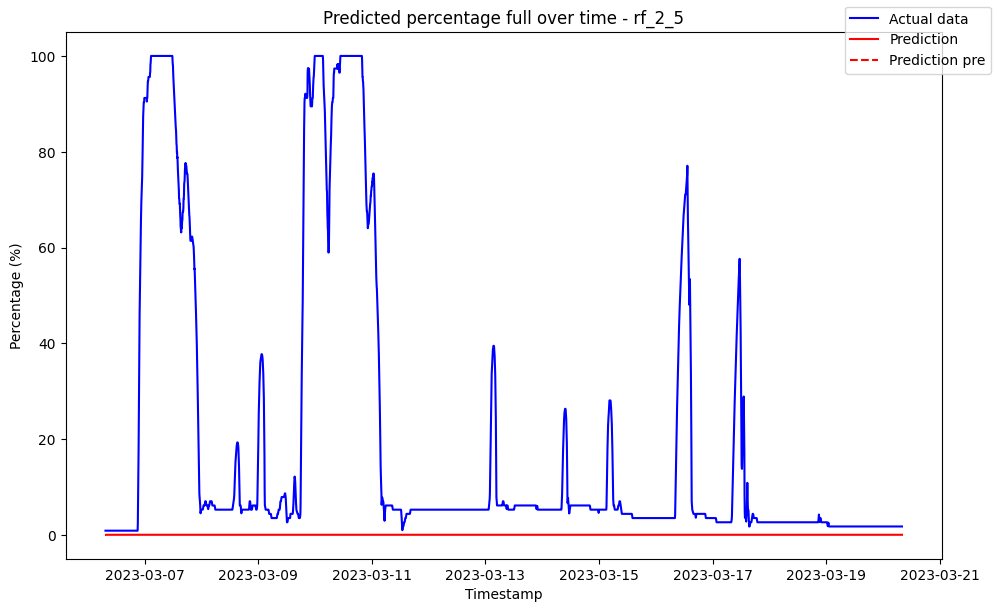

------------------------------------ rf_2_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1009138130469892
Variance (R²) score: 1.00


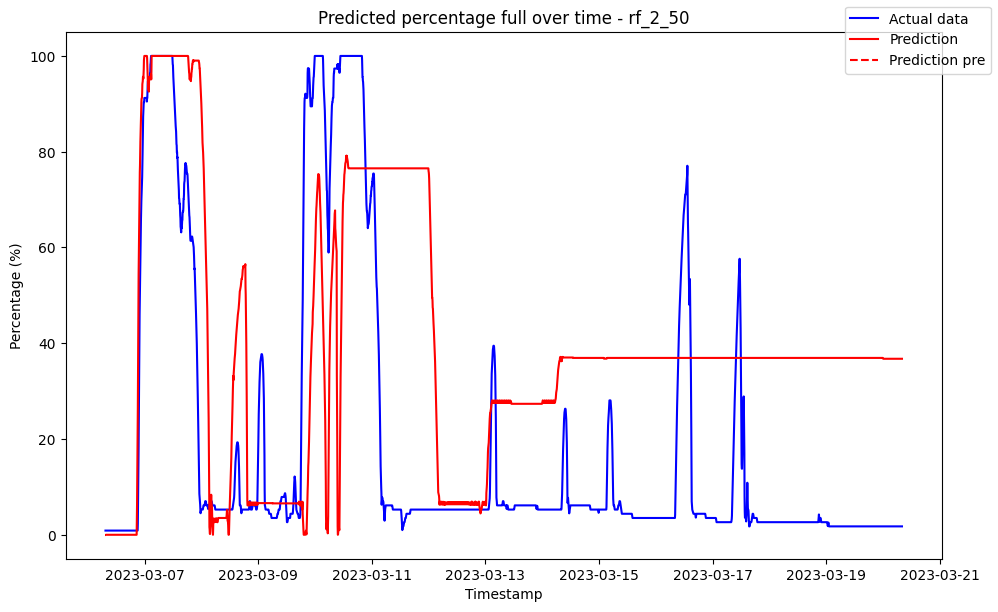

------------------------------------ rf_2_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013723               0.0
1 2023-03-06 07:35:00            0.013723               0.0
2 2023-03-06 07:40:00            0.013723               0.0
3 2023-03-06 07:45:00            0.013723               0.0
4 2023-03-06 07:50:00            0.013723               0.0
5 2023-03-06 07:55:00            0.013723               0.0

Metrics for this specific prediction:
Accuracy: 99.93%
Mean squared error: 0.6905957369665842
Variance (R²) score: 1.00


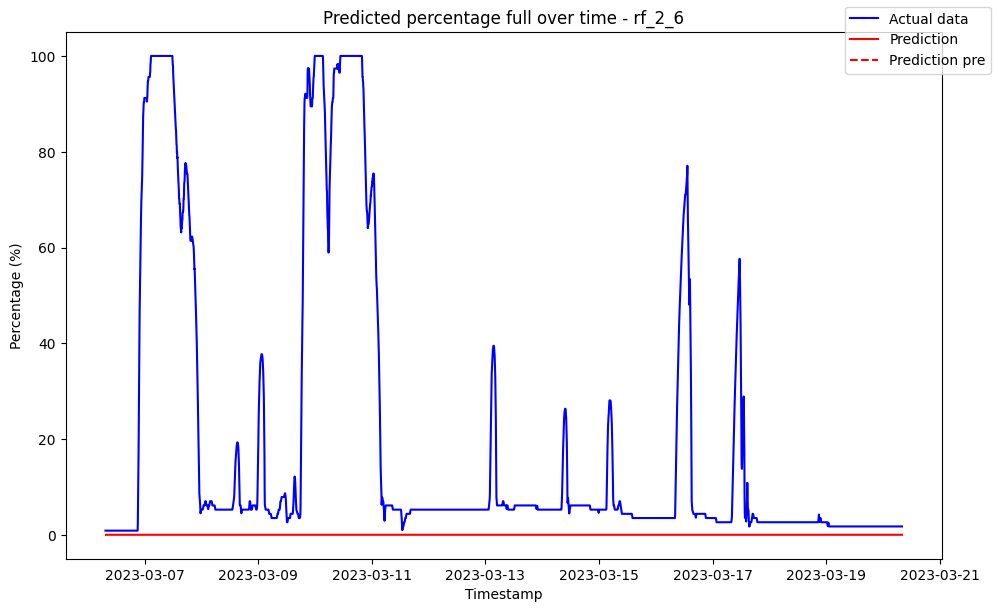

------------------------------------ rf_2_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007279               0.0
1 2023-03-06 07:35:00            0.007279               0.0
2 2023-03-06 07:40:00            0.007279               0.0
3 2023-03-06 07:45:00            0.007279               0.0
4 2023-03-06 07:50:00            0.007279               0.0
5 2023-03-06 07:55:00            0.007279               0.0

Metrics for this specific prediction:
Accuracy: 99.95%
Mean squared error: 0.5556507484388266
Variance (R²) score: 1.00


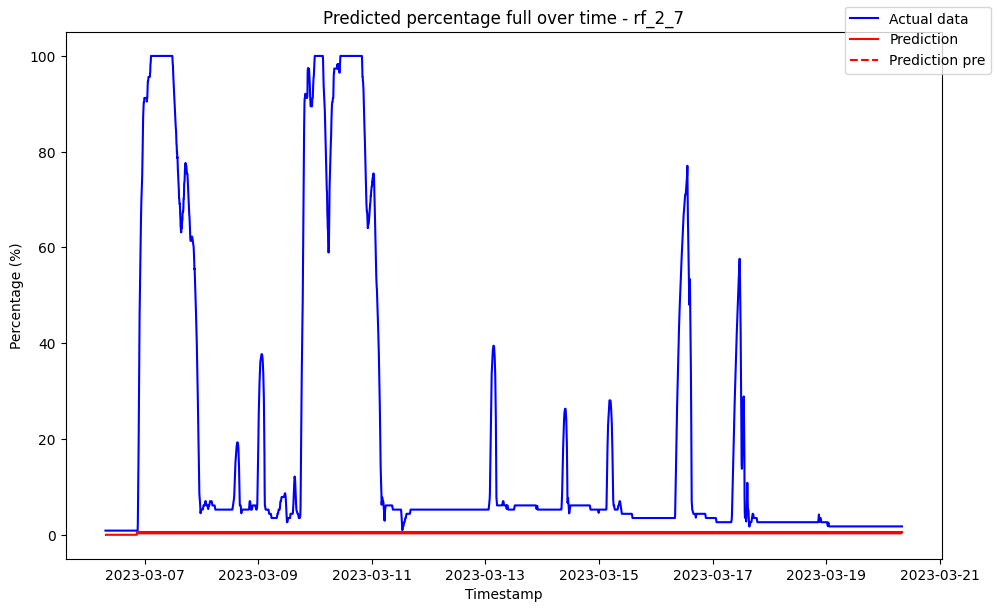

------------------------------------ rf_2_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006007               0.0
1 2023-03-06 07:35:00            0.006007               0.0
2 2023-03-06 07:40:00            0.006007               0.0
3 2023-03-06 07:45:00            0.006007               0.0
4 2023-03-06 07:50:00            0.006007               0.0
5 2023-03-06 07:55:00            0.006007               0.0

Metrics for this specific prediction:
Accuracy: 99.96%
Mean squared error: 0.41359752282352613
Variance (R²) score: 1.00


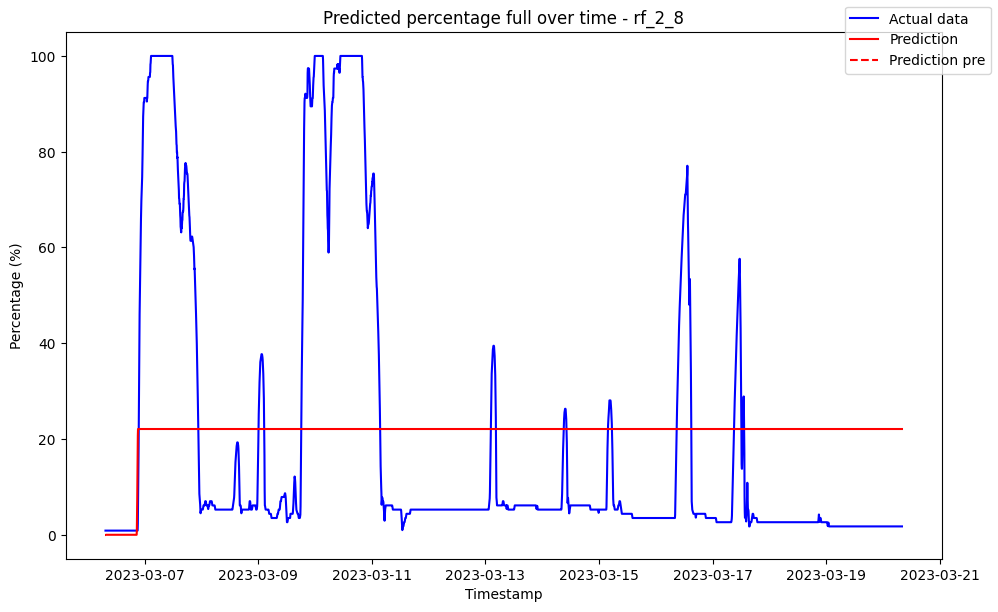

------------------------------------ rf_2_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.021824               0.0
1 2023-03-06 07:35:00            0.330861               0.0
2 2023-03-06 07:40:00            0.604450               0.0
3 2023-03-06 07:45:00            0.848978               0.0
4 2023-03-06 07:50:00            0.872820               0.0
5 2023-03-06 07:55:00            0.872820               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.3150377347285941
Variance (R²) score: 1.00


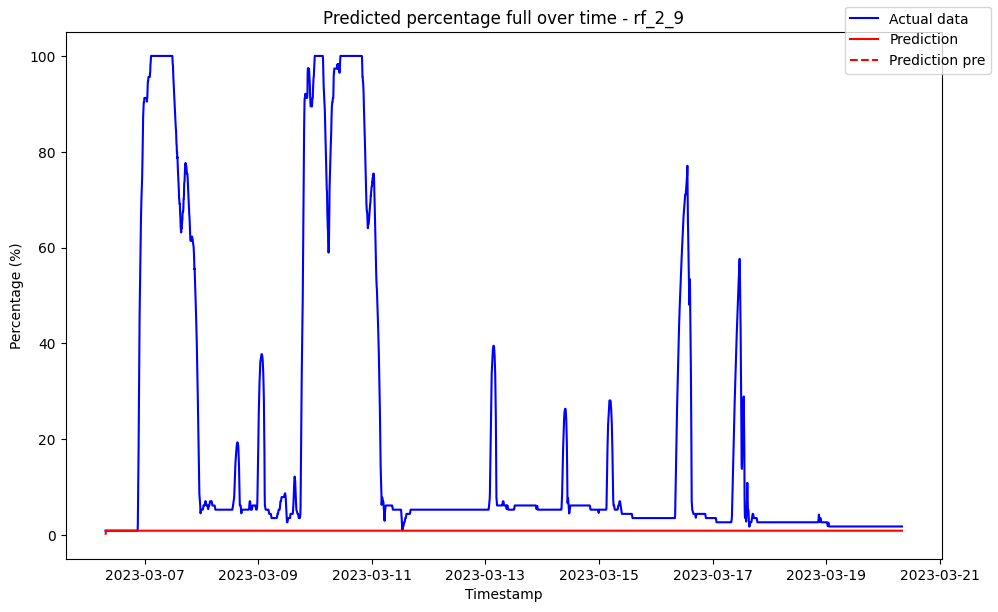

------------------------------------ rf_3_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.537768               0.0
1 2023-03-06 07:35:00            3.537768               0.0
2 2023-03-06 07:40:00            3.537768               0.0
3 2023-03-06 07:45:00            3.537768               0.0
4 2023-03-06 07:50:00            3.537768               0.0
5 2023-03-06 07:55:00            3.537768               0.0

Metrics for this specific prediction:
Accuracy: 89.46%
Mean squared error: 107.61841962522684
Variance (R²) score: 0.89


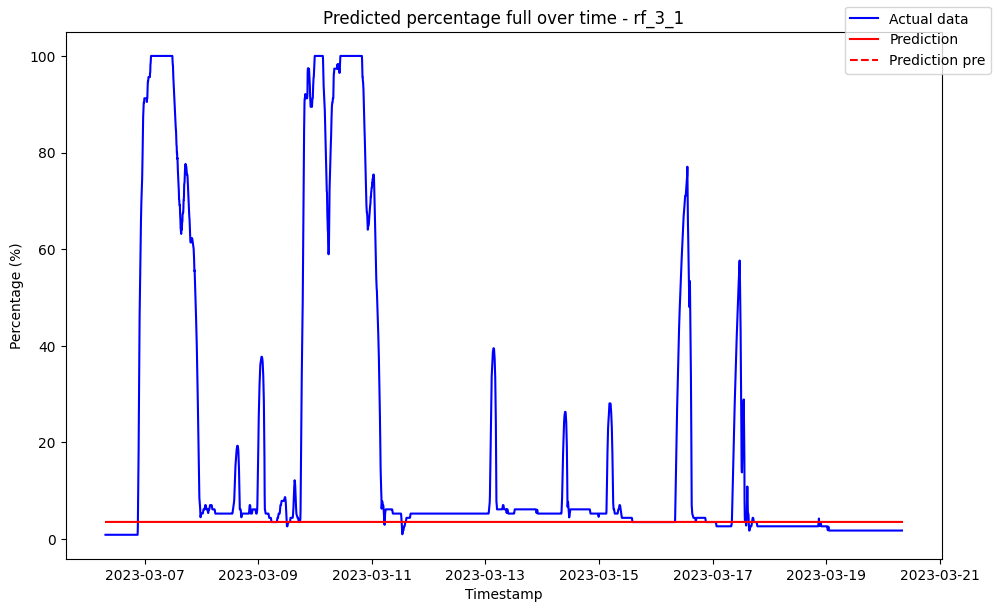

------------------------------------ rf_3_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.035059               0.0
1 2023-03-06 07:35:00            0.339223               0.0
2 2023-03-06 07:40:00            0.654016               0.0
3 2023-03-06 07:45:00            0.837402               0.0
4 2023-03-06 07:50:00            0.748576               0.0
5 2023-03-06 07:55:00            0.675284               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.2546132590339776
Variance (R²) score: 1.00


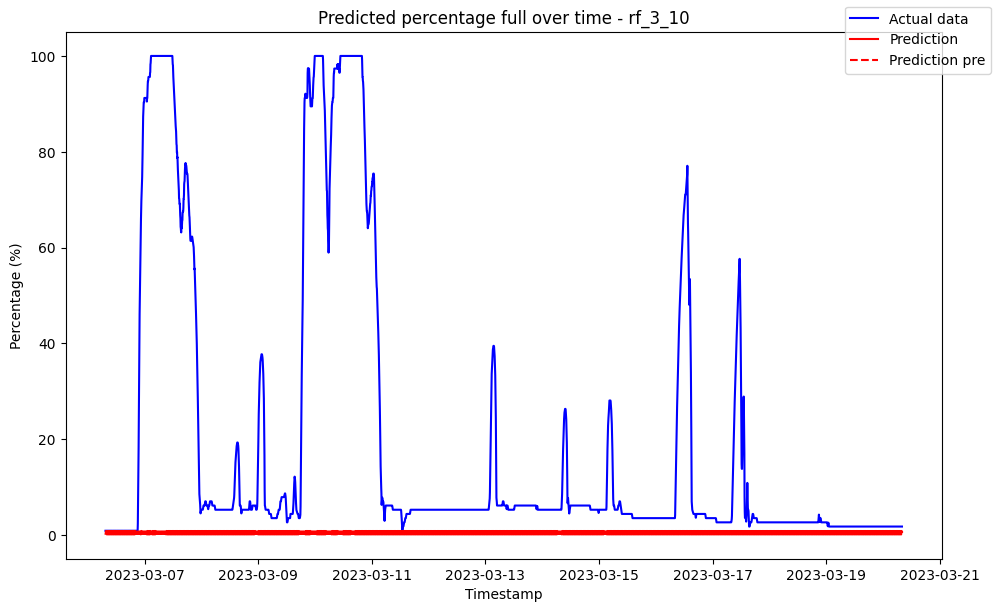

------------------------------------ rf_3_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.023808               0.0
1 2023-03-06 07:35:00            0.327211               0.0
2 2023-03-06 07:40:00            0.611358               0.0
3 2023-03-06 07:45:00            0.829584               0.0
4 2023-03-06 07:50:00            0.613861               0.0
5 2023-03-06 07:55:00            0.362458               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.16923643164001462
Variance (R²) score: 1.00


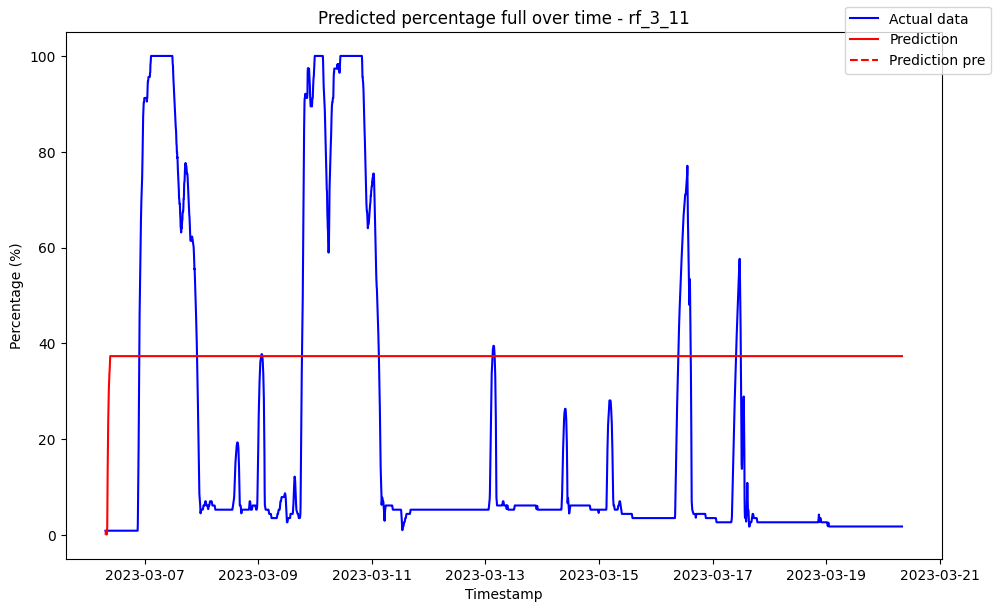

------------------------------------ rf_3_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.015345               0.0
1 2023-03-06 07:35:00            0.015345               0.0
2 2023-03-06 07:40:00            0.015345               0.0
3 2023-03-06 07:45:00            0.015345               0.0
4 2023-03-06 07:50:00            0.015345               0.0
5 2023-03-06 07:55:00            0.015345               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14444349757831187
Variance (R²) score: 1.00


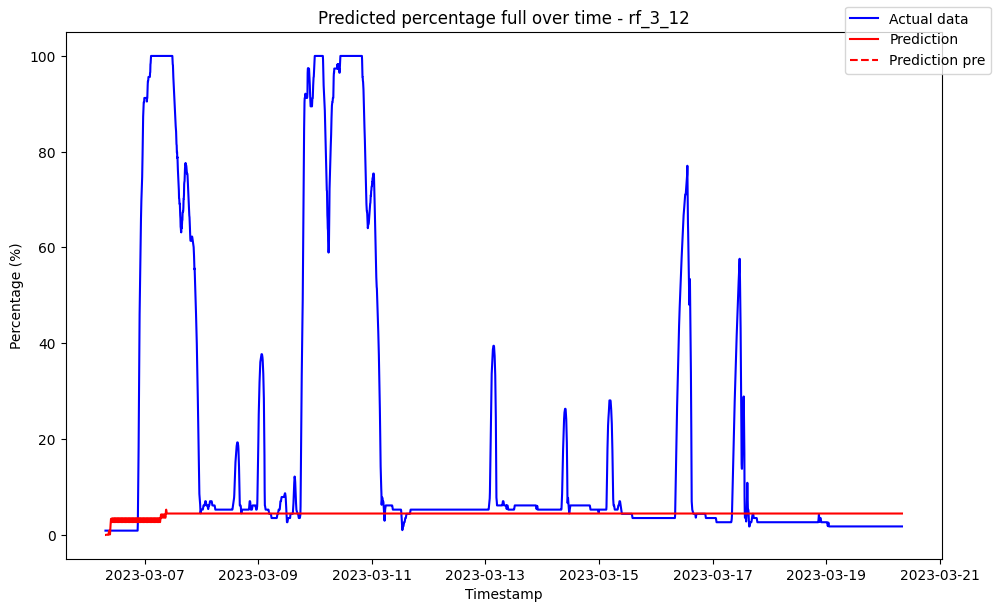

------------------------------------ rf_3_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009147               0.0
1 2023-03-06 07:35:00            0.009147               0.0
2 2023-03-06 07:40:00            0.009147               0.0
3 2023-03-06 07:45:00            0.009147               0.0
4 2023-03-06 07:50:00            0.009147               0.0
5 2023-03-06 07:55:00            0.009147               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.16942777315738142
Variance (R²) score: 1.00


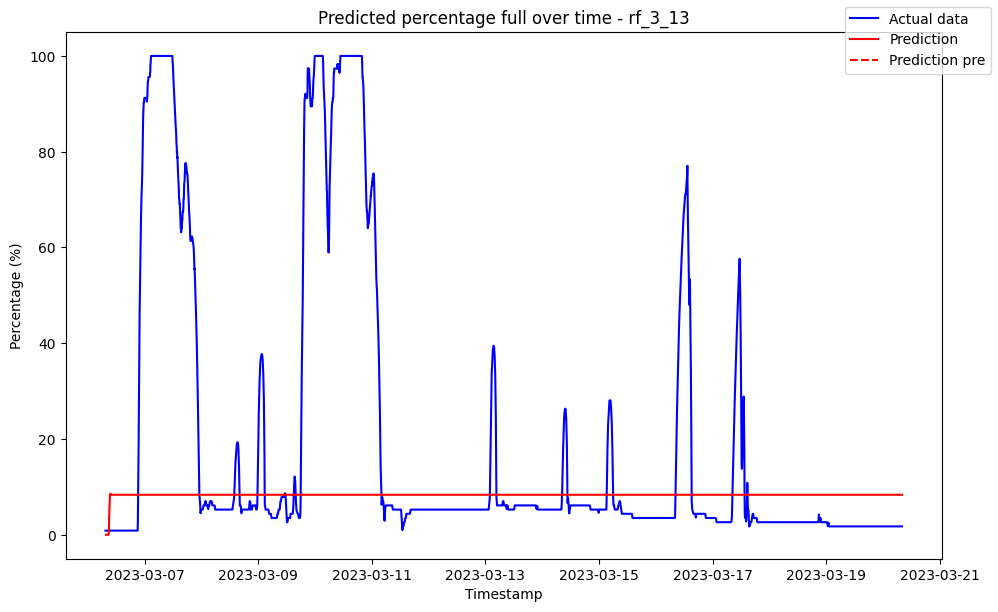

------------------------------------ rf_3_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.012461               0.0
1 2023-03-06 07:35:00            0.012461               0.0
2 2023-03-06 07:40:00            0.012461               0.0
3 2023-03-06 07:45:00            0.012461               0.0
4 2023-03-06 07:50:00            0.012461               0.0
5 2023-03-06 07:55:00            0.012461               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12492947125893433
Variance (R²) score: 1.00


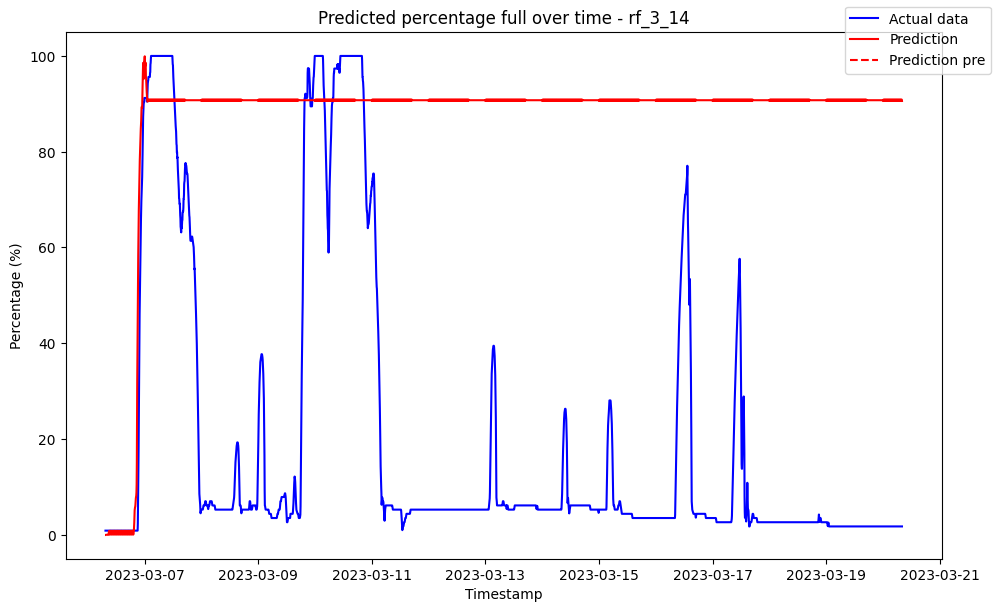

------------------------------------ rf_3_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010114               0.0
1 2023-03-06 07:35:00            0.010114               0.0
2 2023-03-06 07:40:00            0.010114               0.0
3 2023-03-06 07:45:00            0.010114               0.0
4 2023-03-06 07:50:00            0.010114               0.0
5 2023-03-06 07:55:00            0.010114               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12265468397308818
Variance (R²) score: 1.00


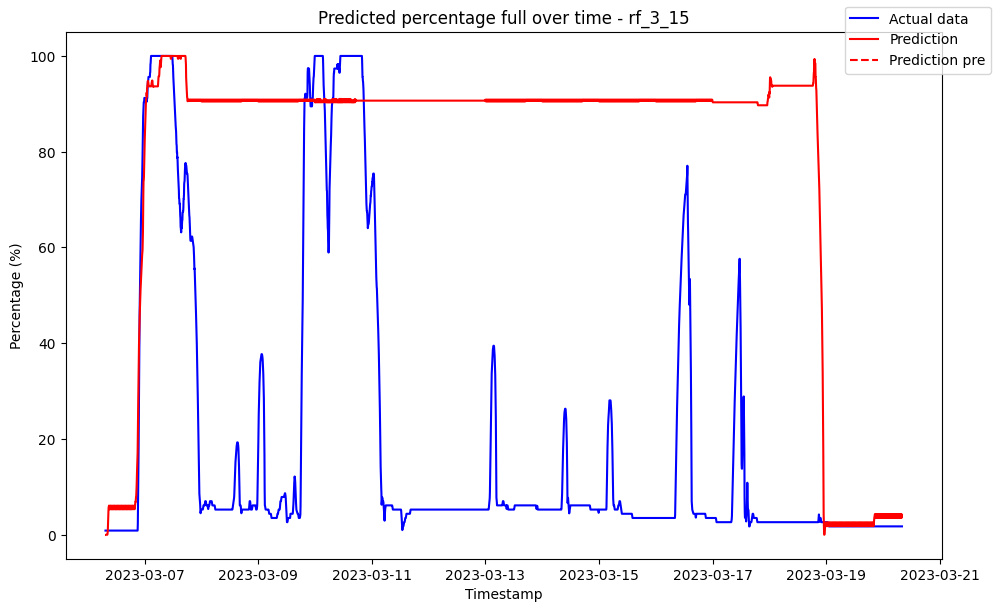

------------------------------------ rf_3_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010023               0.0
1 2023-03-06 07:35:00            0.010023               0.0
2 2023-03-06 07:40:00            0.010023               0.0
3 2023-03-06 07:45:00            0.010023               0.0
4 2023-03-06 07:50:00            0.010023               0.0
5 2023-03-06 07:55:00            0.010023               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.15867306477884277
Variance (R²) score: 1.00


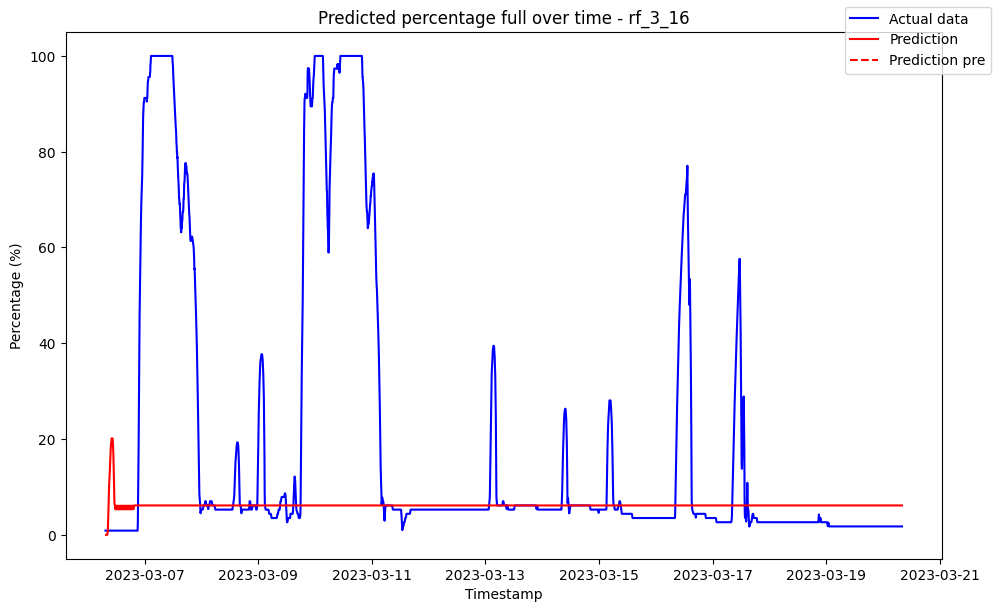

------------------------------------ rf_3_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005555               0.0
1 2023-03-06 07:35:00            0.005555               0.0
2 2023-03-06 07:40:00            0.005555               0.0
3 2023-03-06 07:45:00            0.005555               0.0
4 2023-03-06 07:50:00            0.005555               0.0
5 2023-03-06 07:55:00            0.005555               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.13301196655234415
Variance (R²) score: 1.00


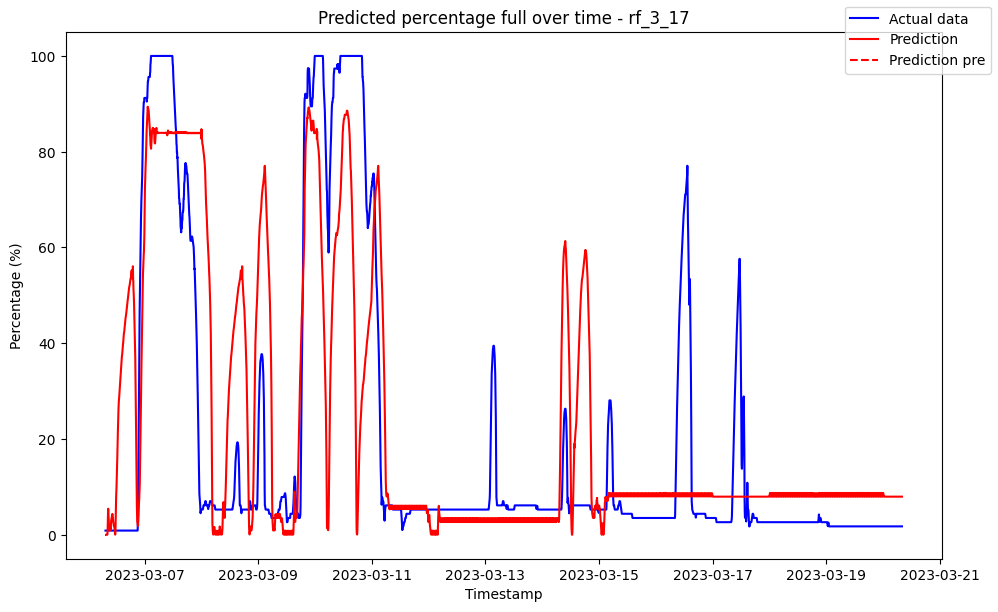

------------------------------------ rf_3_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.008521               0.0
1 2023-03-06 07:35:00            0.008521               0.0
2 2023-03-06 07:40:00            0.008521               0.0
3 2023-03-06 07:45:00            0.008521               0.0
4 2023-03-06 07:50:00            0.008521               0.0
5 2023-03-06 07:55:00            0.008521               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14058497410871193
Variance (R²) score: 1.00


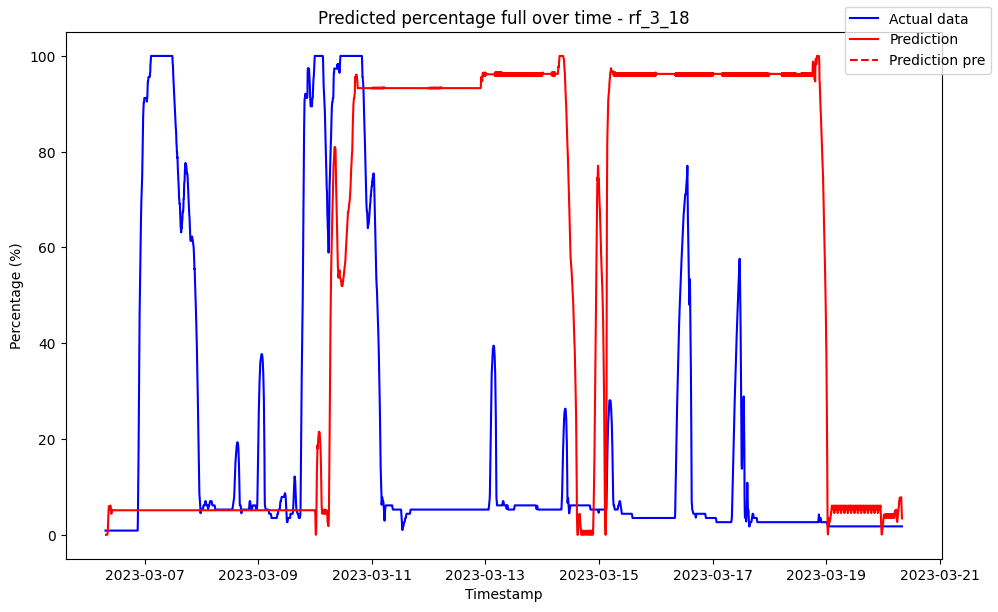

------------------------------------ rf_3_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006957               0.0
1 2023-03-06 07:35:00            0.006957               0.0
2 2023-03-06 07:40:00            0.006957               0.0
3 2023-03-06 07:45:00            0.006957               0.0
4 2023-03-06 07:50:00            0.006957               0.0
5 2023-03-06 07:55:00            0.006957               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09829865579829153
Variance (R²) score: 1.00


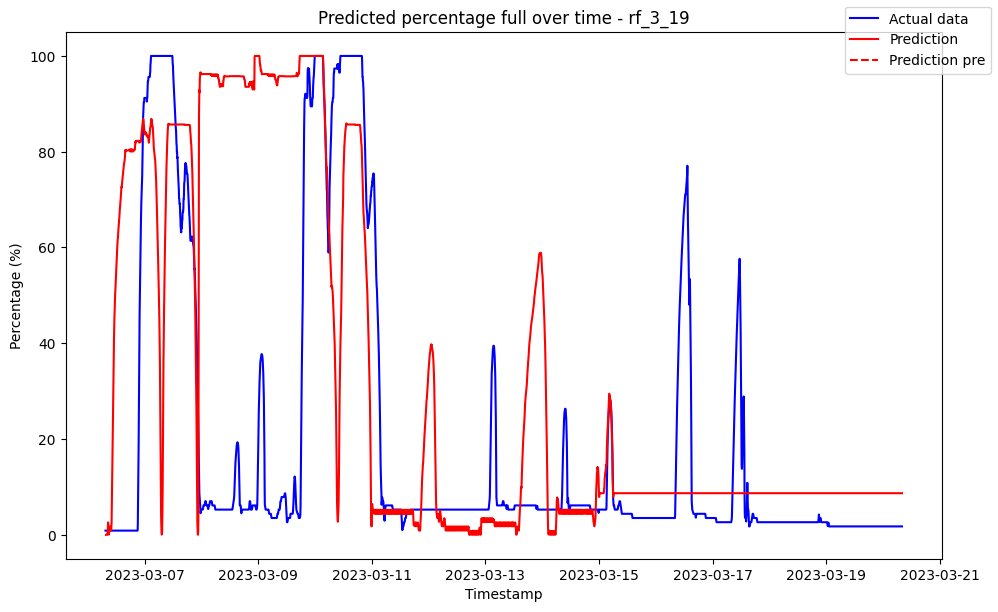

------------------------------------ rf_3_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            1.208654               0.0
1 2023-03-06 07:35:00            1.208654               0.0
2 2023-03-06 07:40:00            1.208654               0.0
3 2023-03-06 07:45:00            1.208654               0.0
4 2023-03-06 07:50:00            1.208654               0.0
5 2023-03-06 07:55:00            1.208654               0.0

Metrics for this specific prediction:
Accuracy: 96.27%
Mean squared error: 38.059317479623985
Variance (R²) score: 0.96


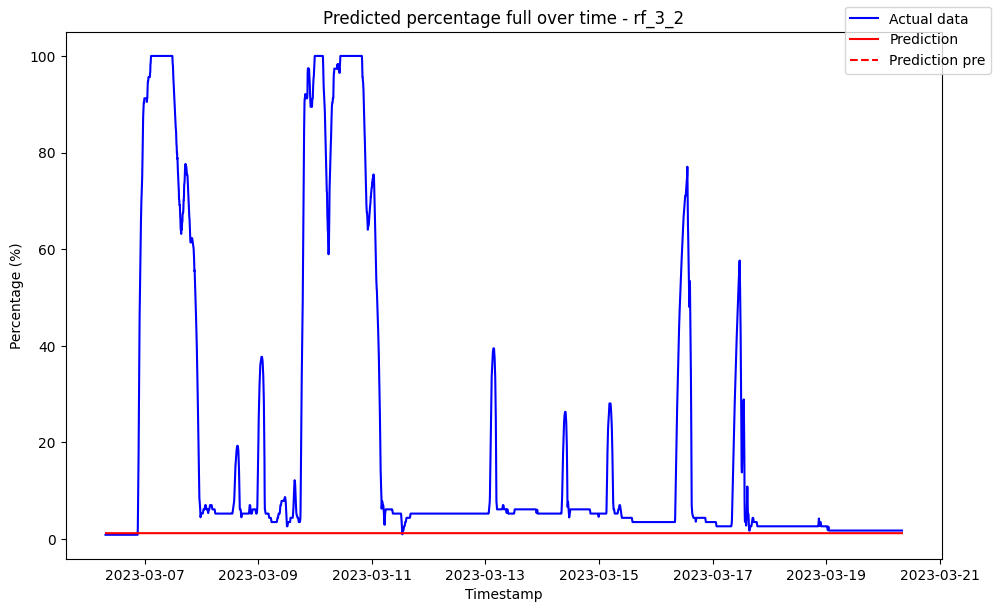

------------------------------------ rf_3_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.002509               0.0
1 2023-03-06 07:35:00            0.002509               0.0
2 2023-03-06 07:40:00            0.002509               0.0
3 2023-03-06 07:45:00            0.002509               0.0
4 2023-03-06 07:50:00            0.002509               0.0
5 2023-03-06 07:55:00            0.002509               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0939112188725198
Variance (R²) score: 1.00


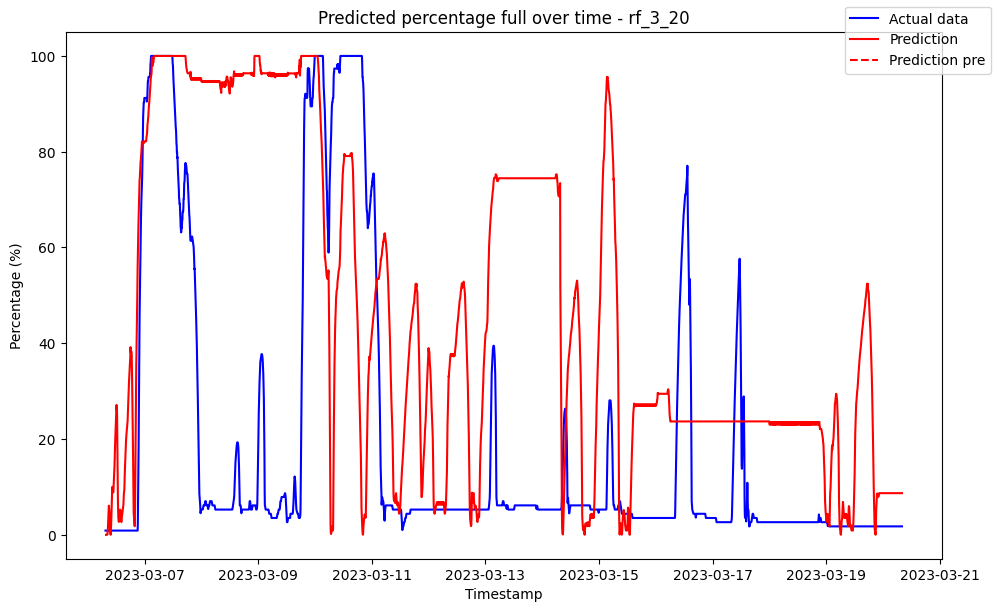

------------------------------------ rf_3_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004218               0.0
1 2023-03-06 07:35:00            0.004218               0.0
2 2023-03-06 07:40:00            0.004218               0.0
3 2023-03-06 07:45:00            0.004218               0.0
4 2023-03-06 07:50:00            0.004218               0.0
5 2023-03-06 07:55:00            0.004218               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14131719378760704
Variance (R²) score: 1.00


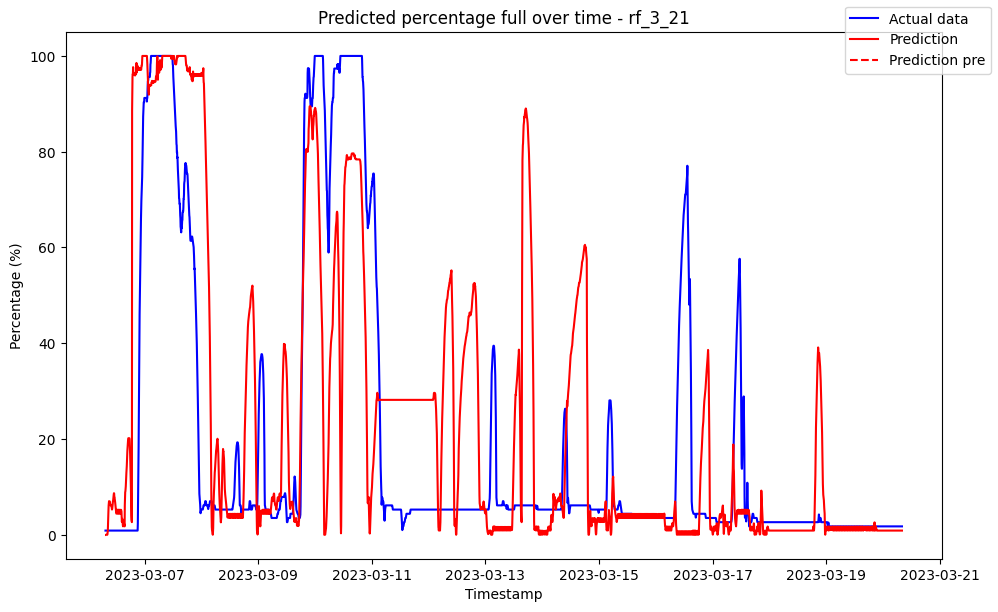

------------------------------------ rf_3_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.012974               0.0
1 2023-03-06 07:35:00            0.012974               0.0
2 2023-03-06 07:40:00            0.012974               0.0
3 2023-03-06 07:45:00            0.012974               0.0
4 2023-03-06 07:50:00            0.012974               0.0
5 2023-03-06 07:55:00            0.012974               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0867462313087759
Variance (R²) score: 1.00


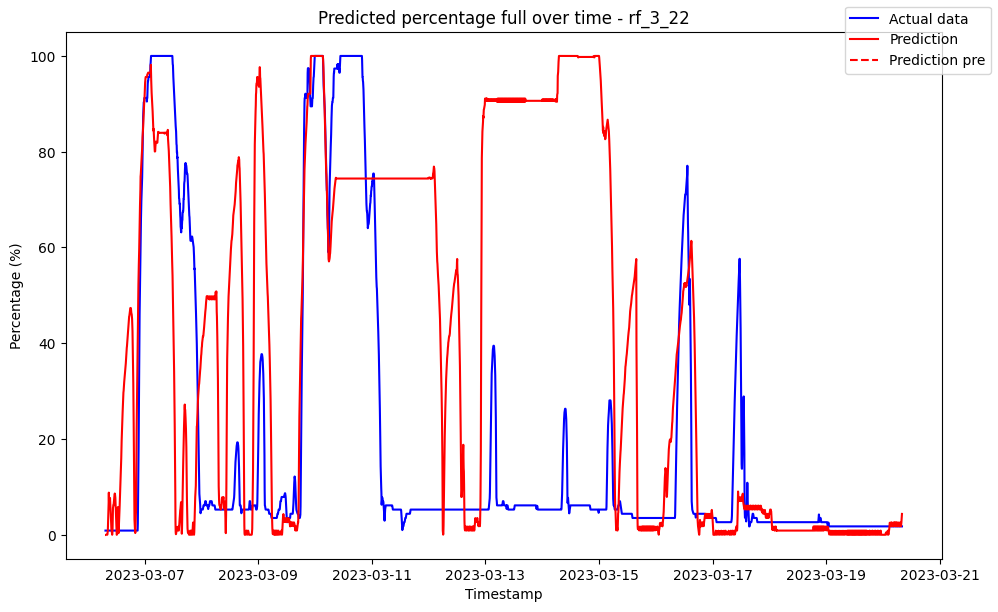

------------------------------------ rf_3_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.13590735261825004
Variance (R²) score: 1.00


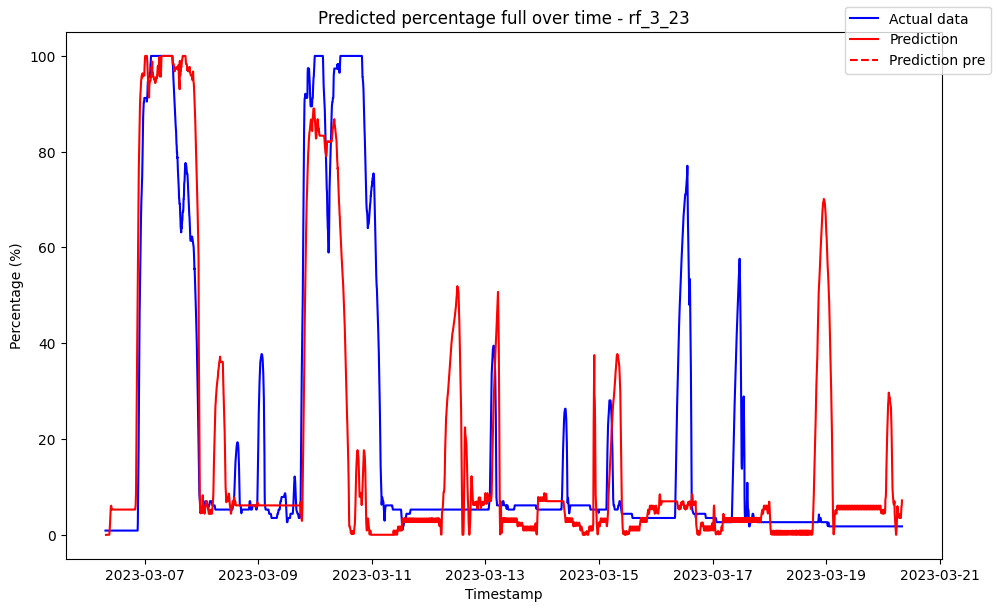

------------------------------------ rf_3_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11250375509306368
Variance (R²) score: 1.00


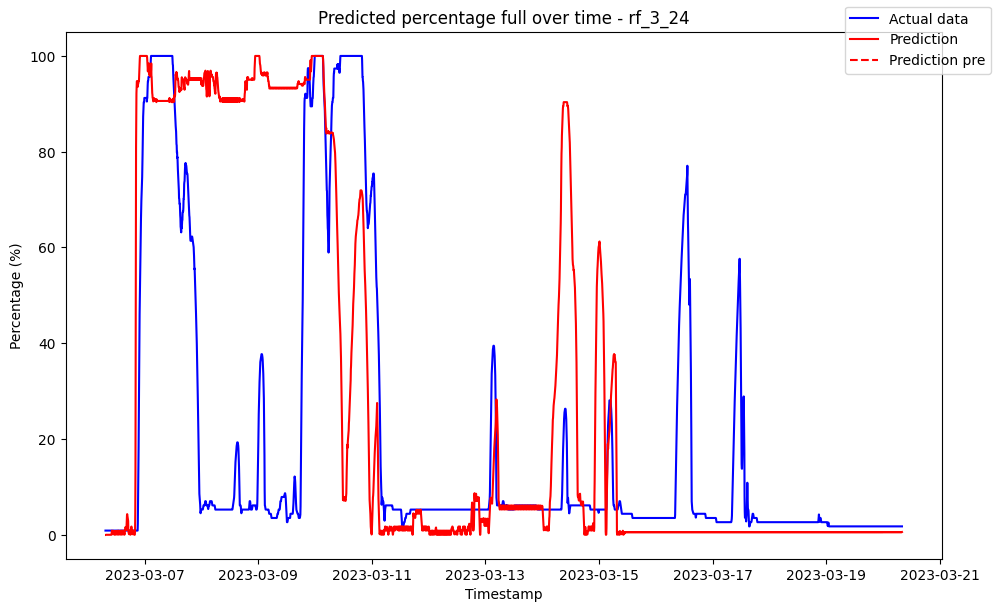

------------------------------------ rf_3_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09463433876936203
Variance (R²) score: 1.00


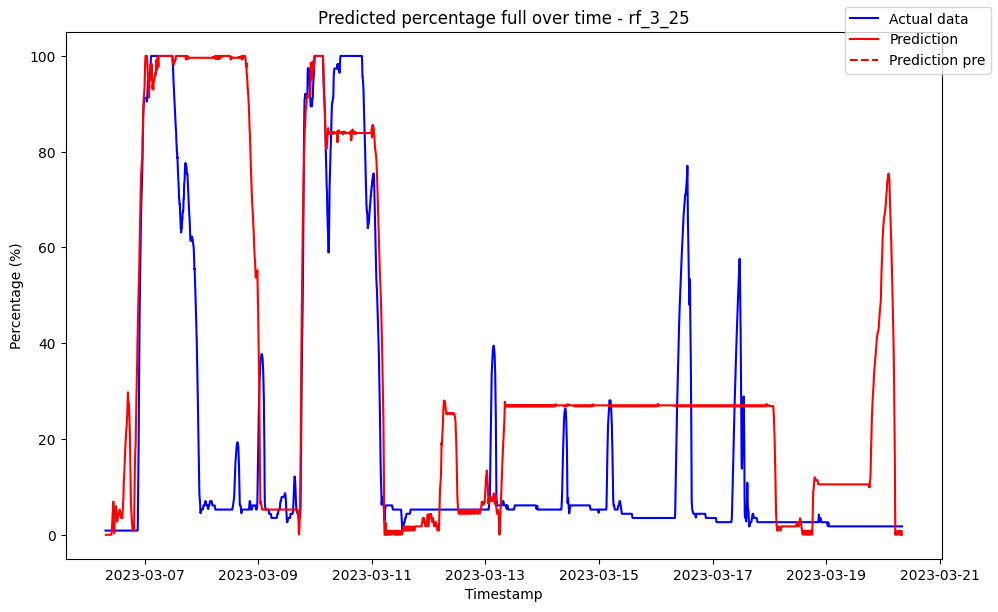

------------------------------------ rf_3_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14660834948313323
Variance (R²) score: 1.00


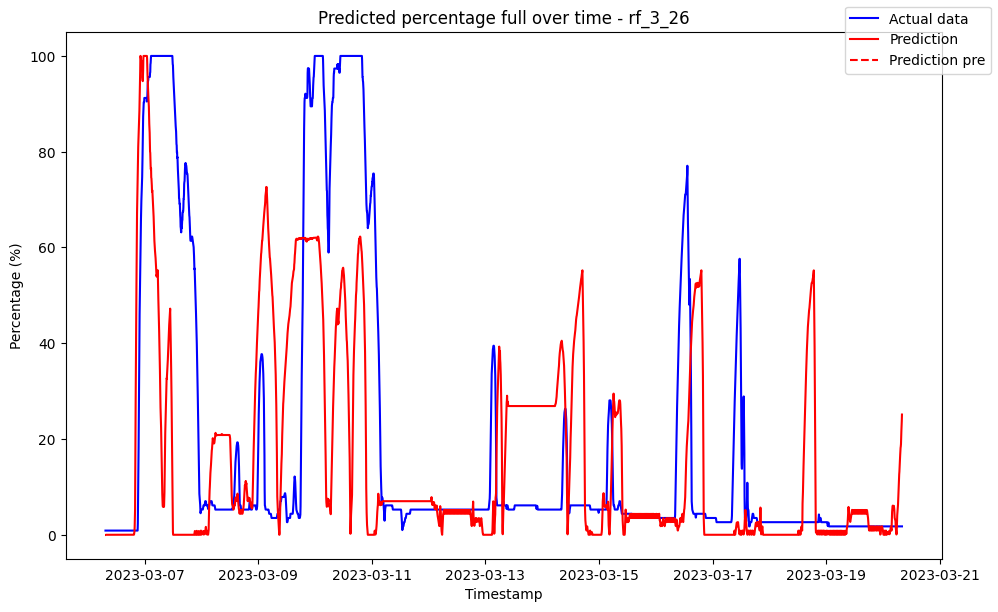

------------------------------------ rf_3_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09199307548541161
Variance (R²) score: 1.00


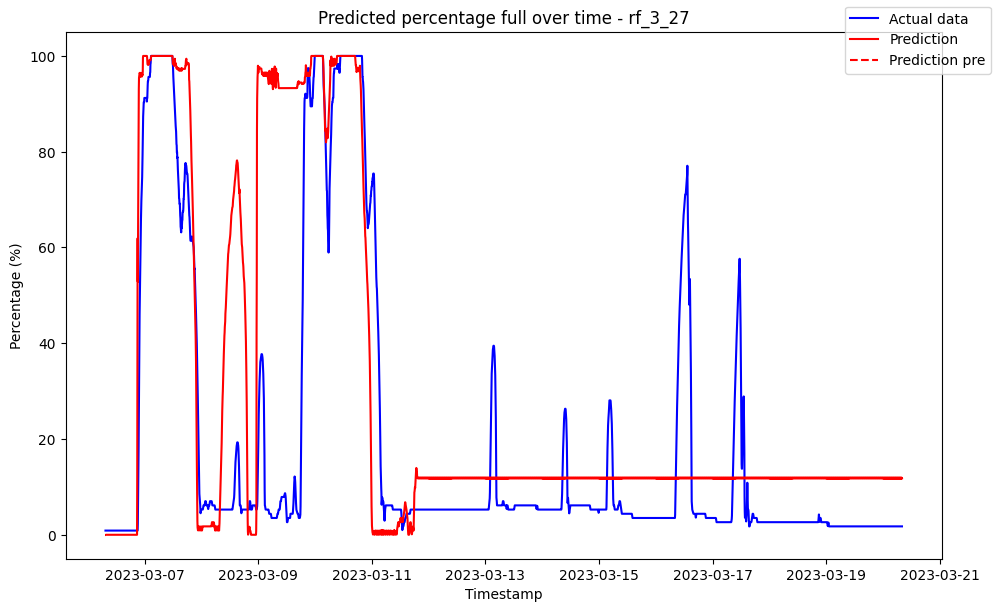

------------------------------------ rf_3_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1319630445304802
Variance (R²) score: 1.00


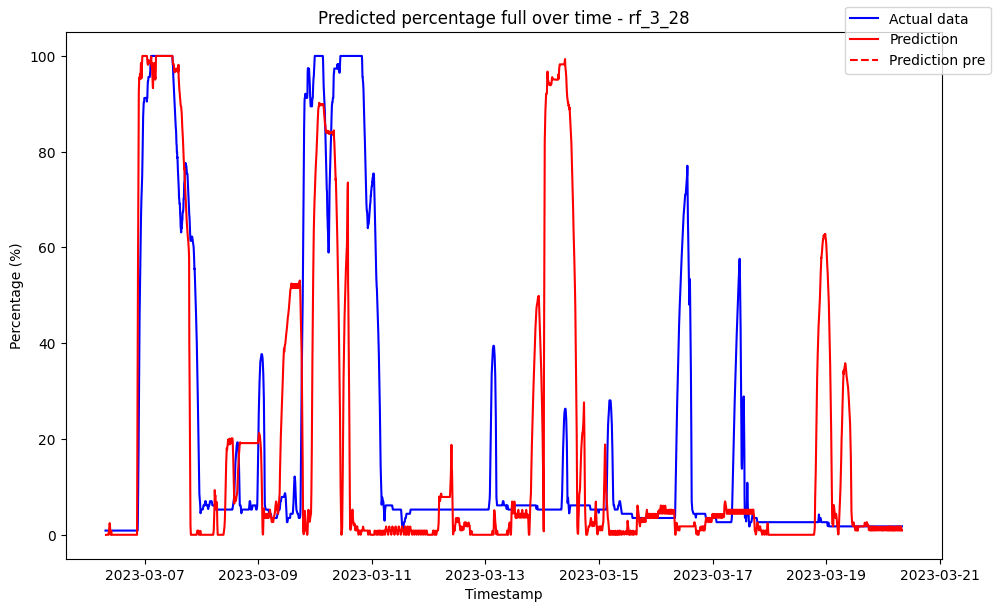

------------------------------------ rf_3_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1466151492797084
Variance (R²) score: 1.00


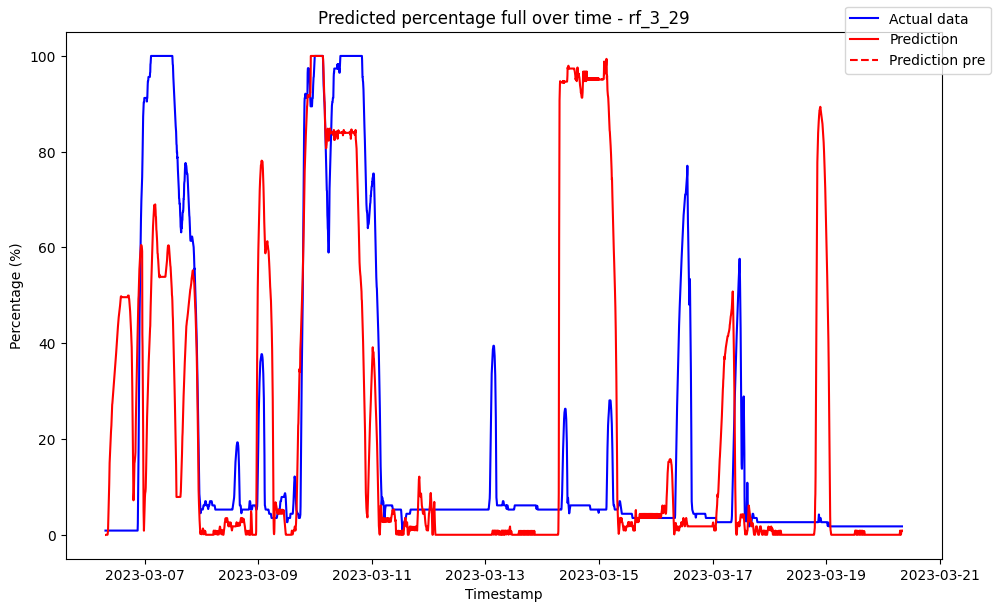

------------------------------------ rf_3_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.459305               0.0
1 2023-03-06 07:35:00            0.459305               0.0
2 2023-03-06 07:40:00            0.459305               0.0
3 2023-03-06 07:45:00            0.459305               0.0
4 2023-03-06 07:50:00            0.459305               0.0
5 2023-03-06 07:55:00            0.459305               0.0

Metrics for this specific prediction:
Accuracy: 99.31%
Mean squared error: 7.084827913337001
Variance (R²) score: 0.99


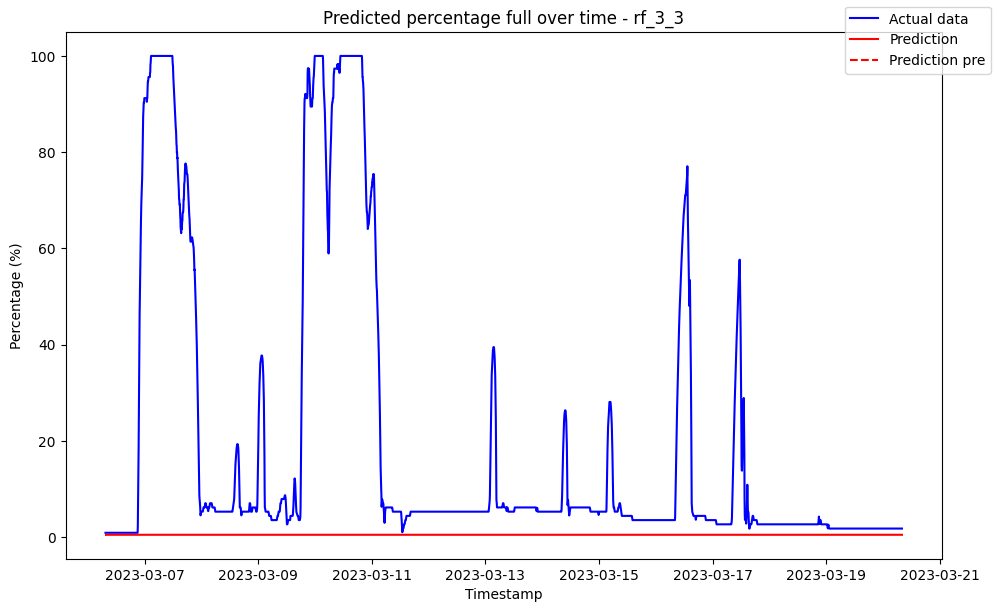

------------------------------------ rf_3_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14744669152020298
Variance (R²) score: 1.00


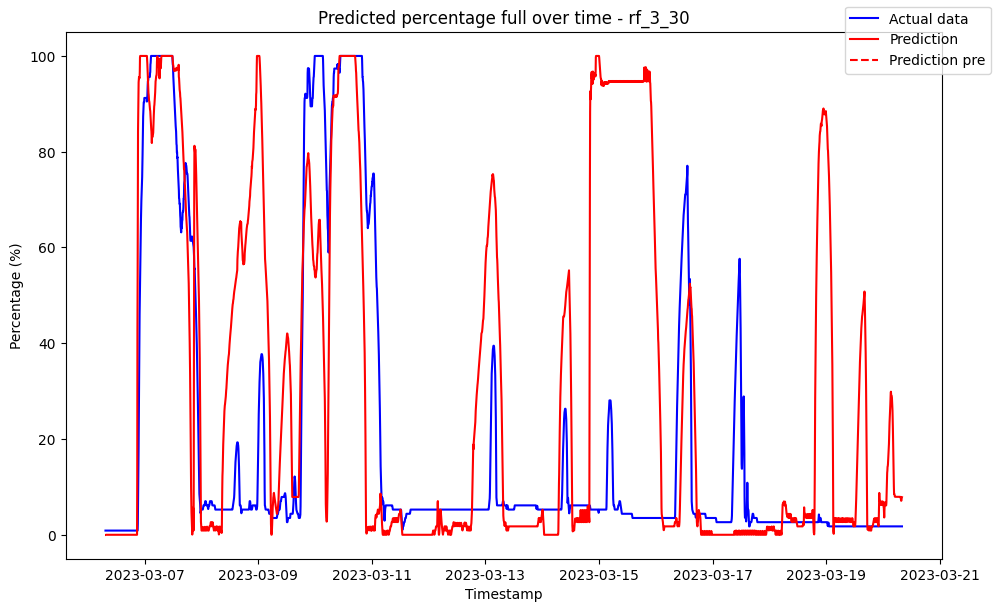

------------------------------------ rf_3_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11723516305718812
Variance (R²) score: 1.00


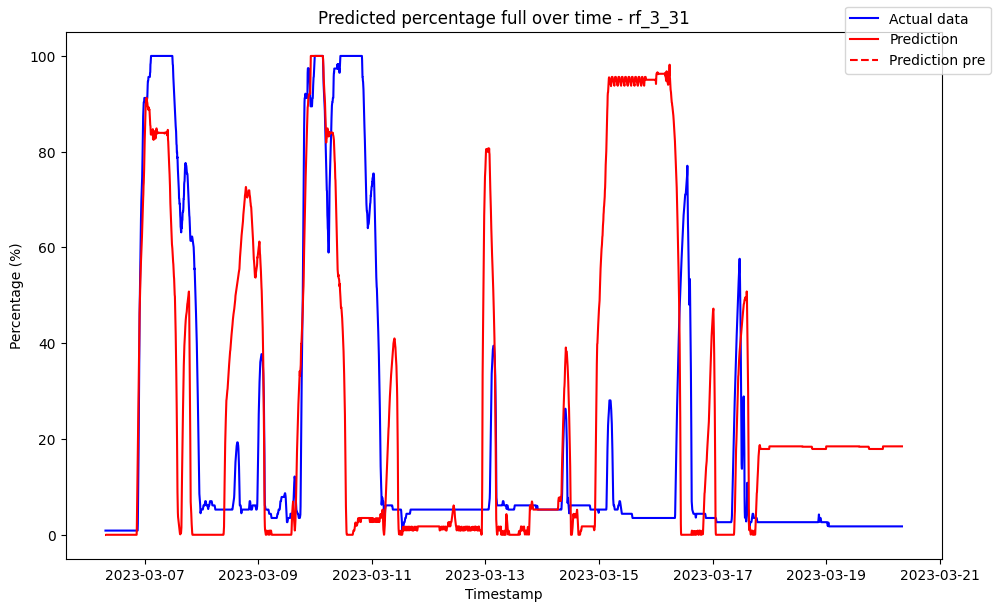

------------------------------------ rf_3_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10150336418202043
Variance (R²) score: 1.00


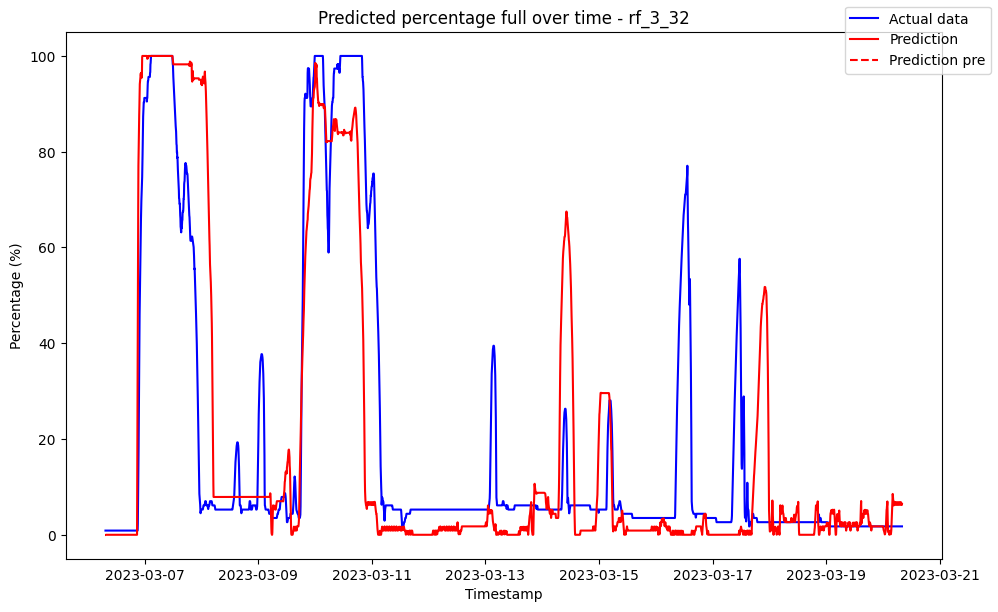

------------------------------------ rf_3_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.15589990051255215
Variance (R²) score: 1.00


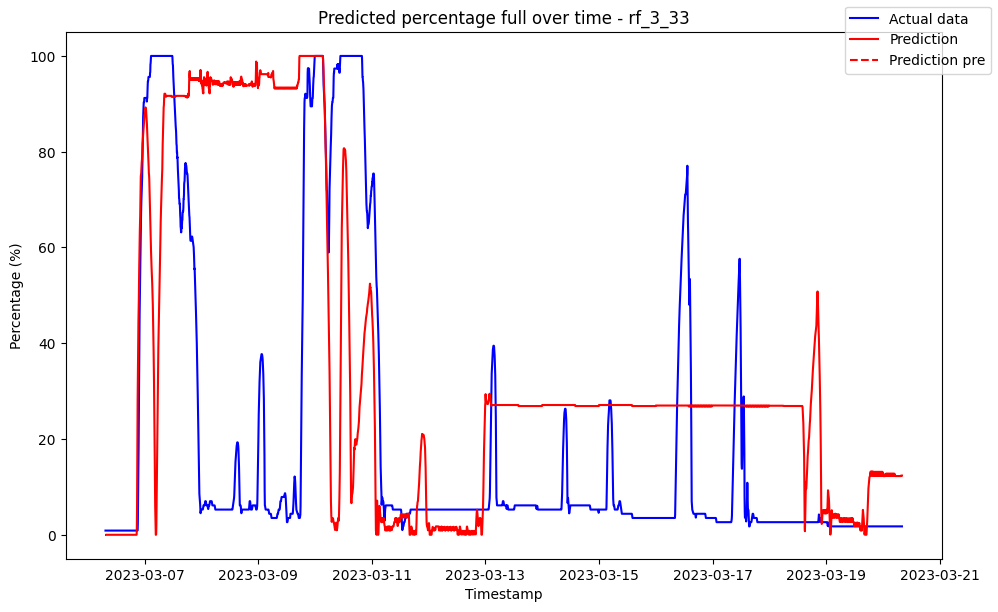

------------------------------------ rf_3_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11146677259713501
Variance (R²) score: 1.00


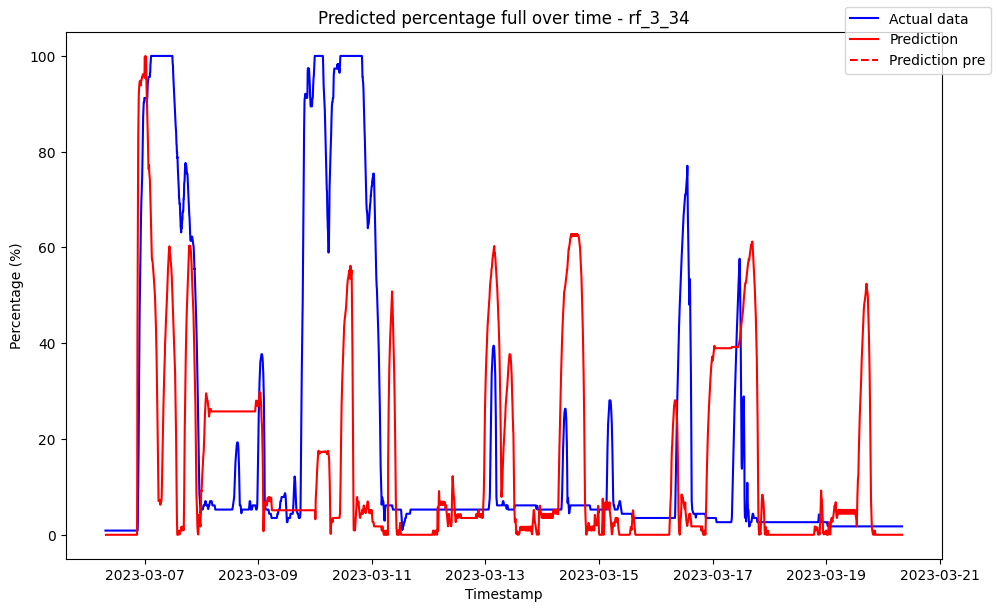

------------------------------------ rf_3_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14465644034987063
Variance (R²) score: 1.00


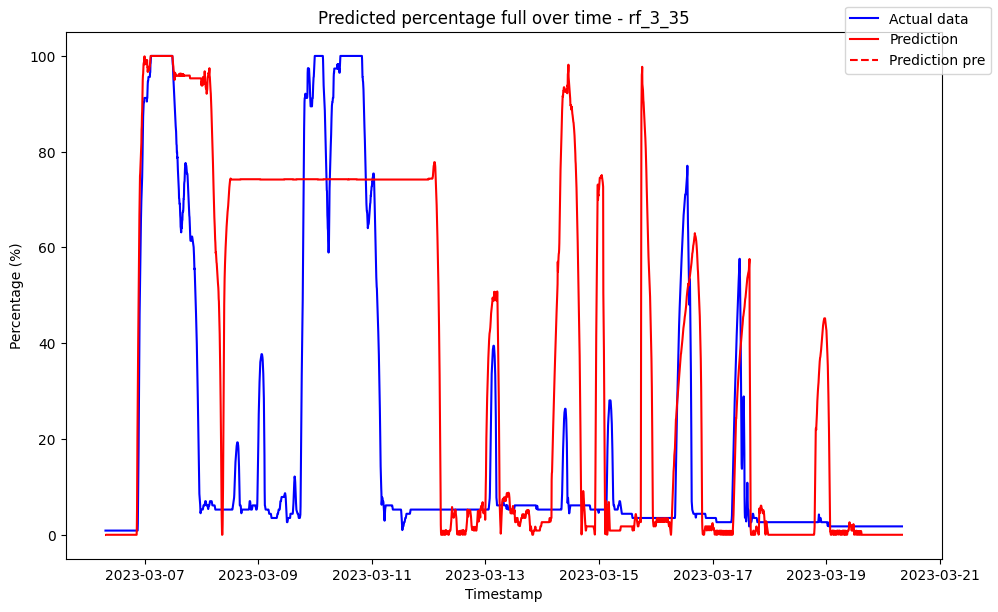

------------------------------------ rf_3_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1515328423143355
Variance (R²) score: 1.00


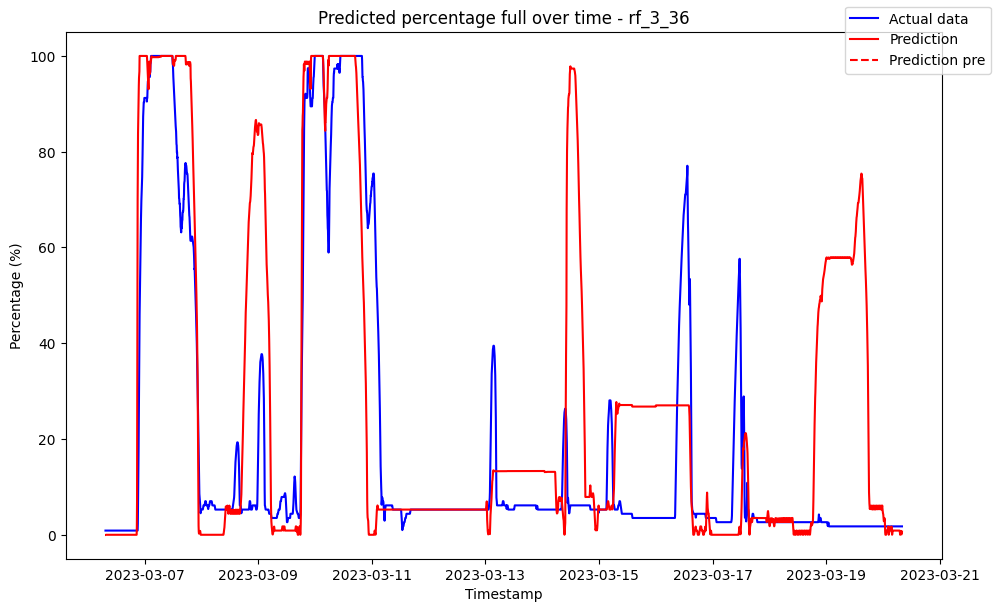

------------------------------------ rf_3_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1528576336035076
Variance (R²) score: 1.00


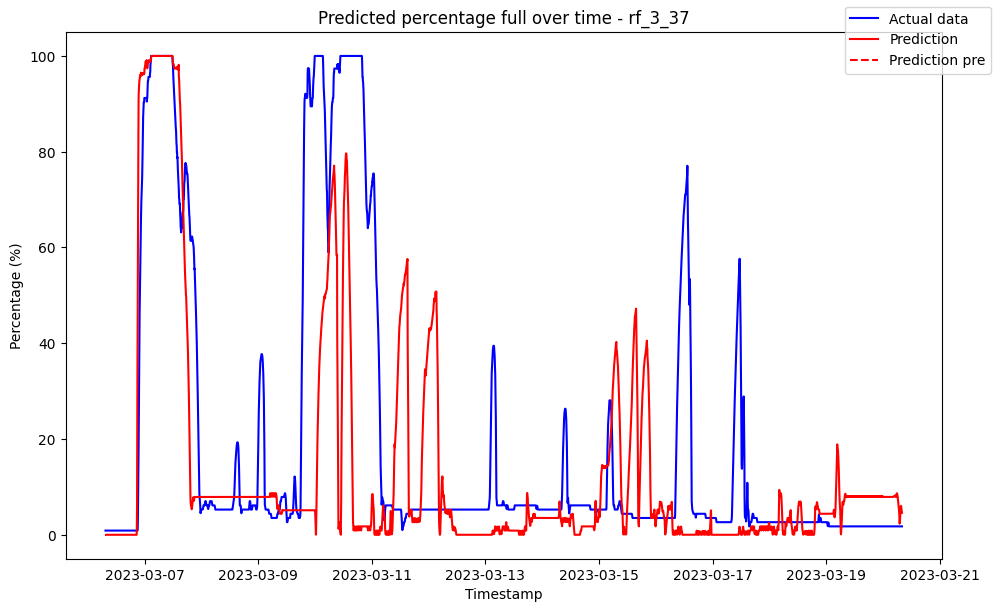

------------------------------------ rf_3_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11825430630621286
Variance (R²) score: 1.00


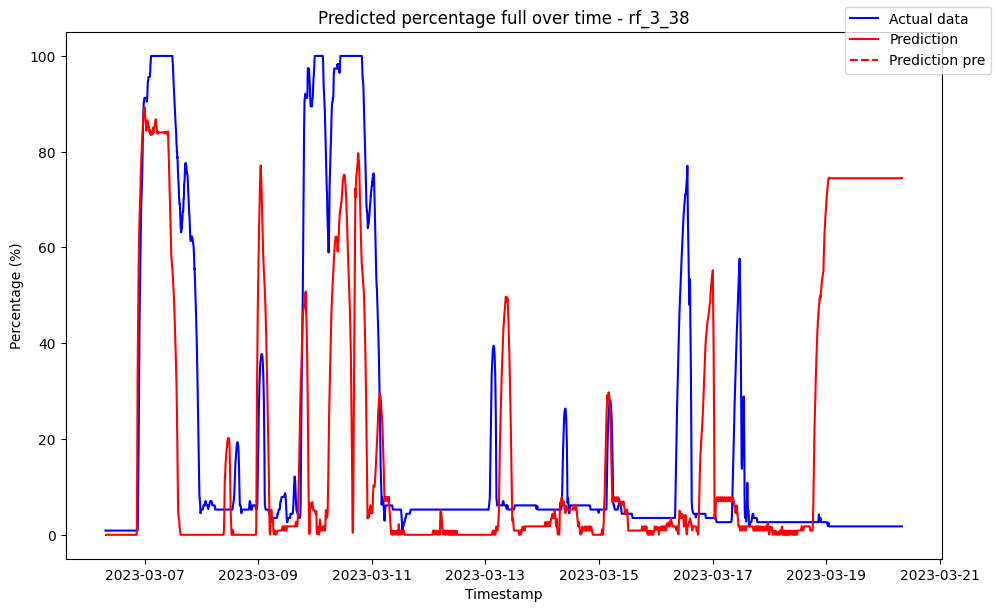

------------------------------------ rf_3_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10497571369757736
Variance (R²) score: 1.00


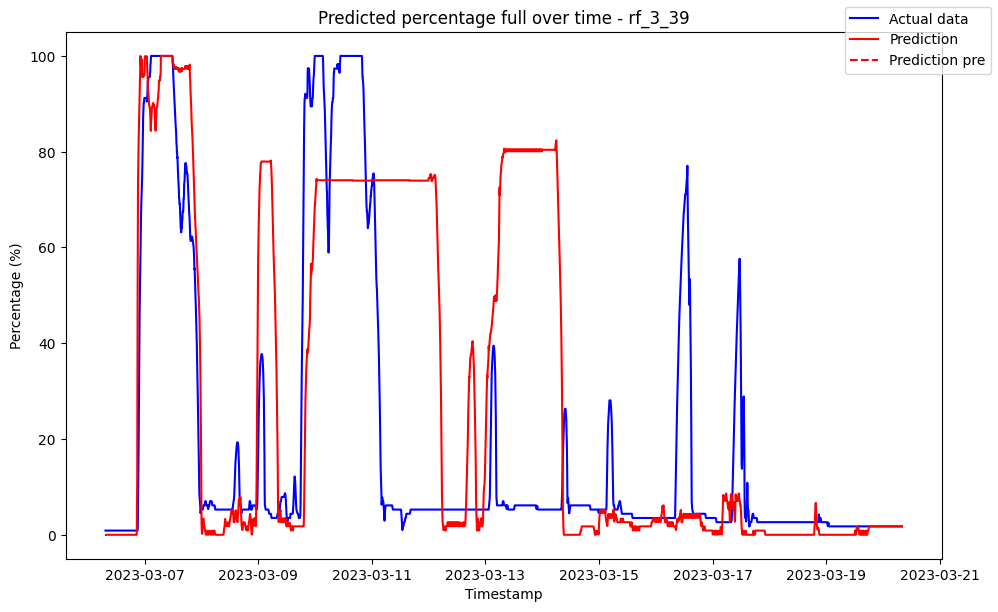

------------------------------------ rf_3_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.022269               0.0
1 2023-03-06 07:35:00            0.022269               0.0
2 2023-03-06 07:40:00            0.022269               0.0
3 2023-03-06 07:45:00            0.022269               0.0
4 2023-03-06 07:50:00            0.022269               0.0
5 2023-03-06 07:55:00            0.022269               0.0

Metrics for this specific prediction:
Accuracy: 99.79%
Mean squared error: 2.1632895812483333
Variance (R²) score: 1.00


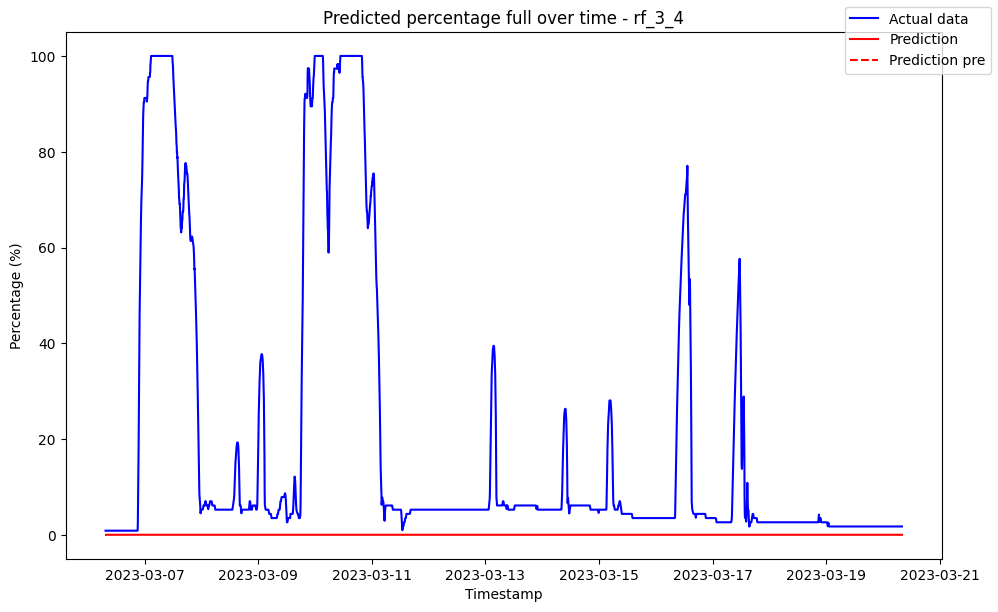

------------------------------------ rf_3_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09371116269502183
Variance (R²) score: 1.00


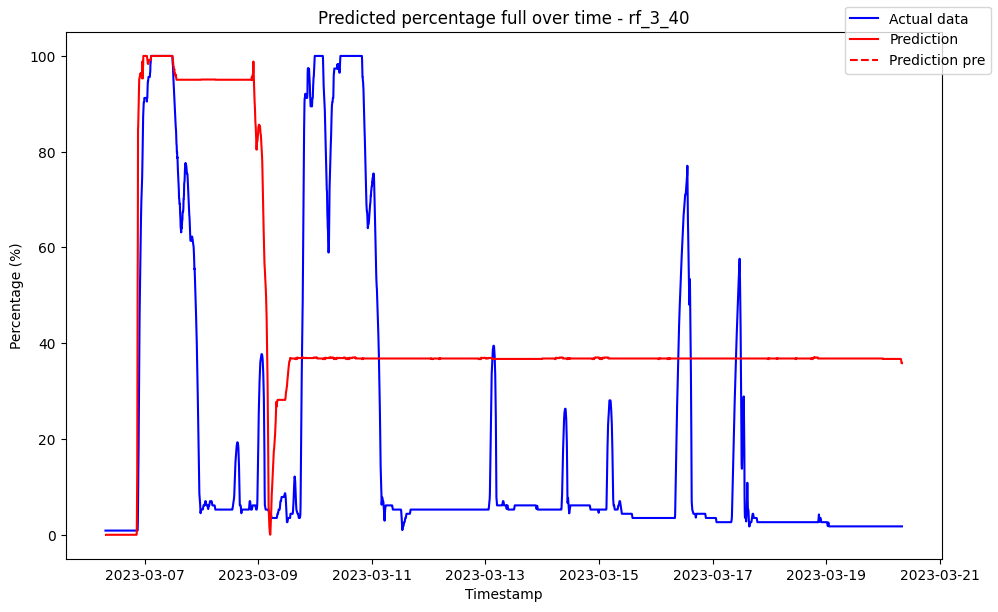

------------------------------------ rf_3_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12990005164418522
Variance (R²) score: 1.00


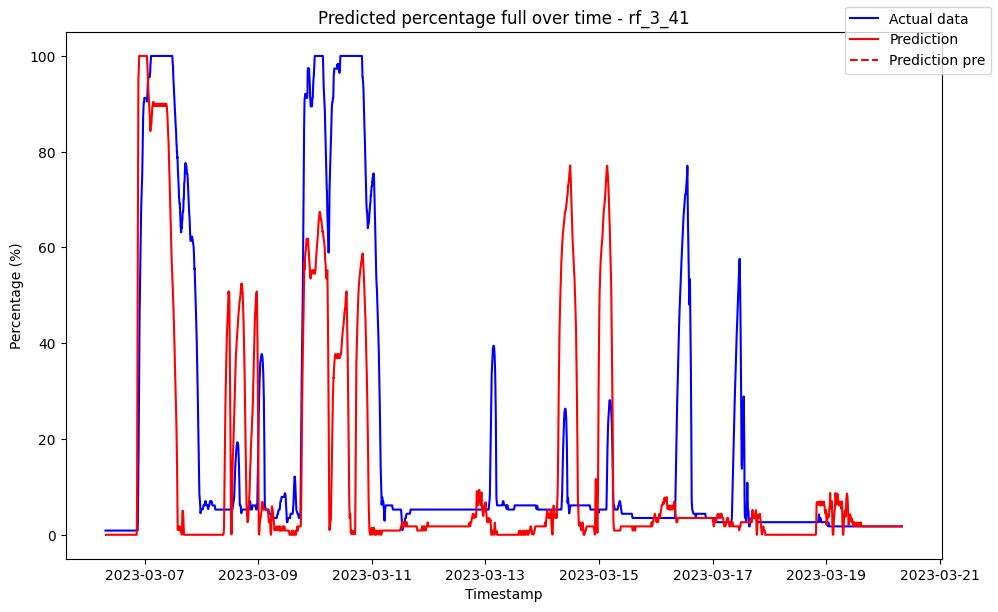

------------------------------------ rf_3_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10898762664186872
Variance (R²) score: 1.00


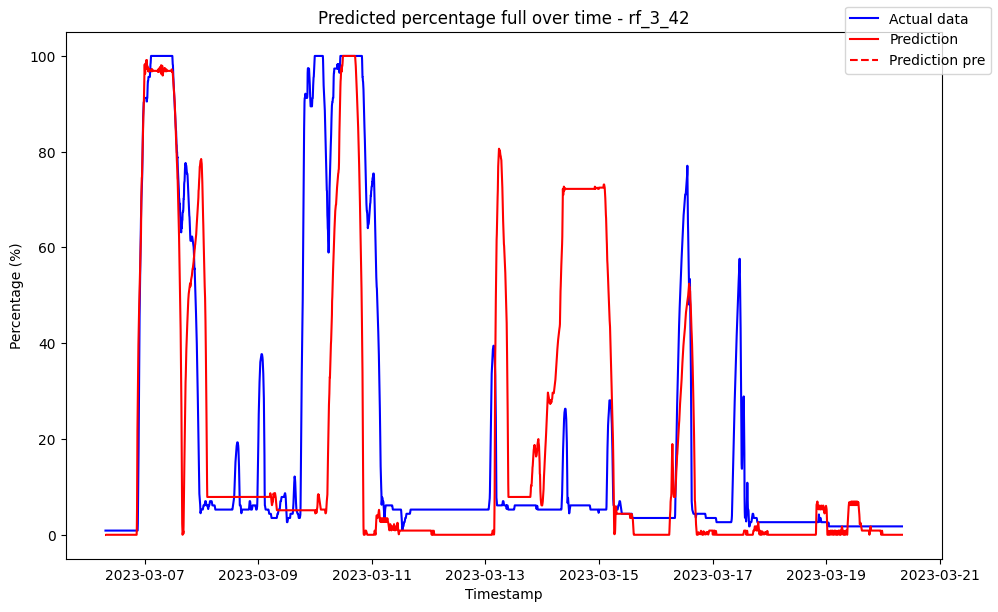

------------------------------------ rf_3_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1466363430190409
Variance (R²) score: 1.00


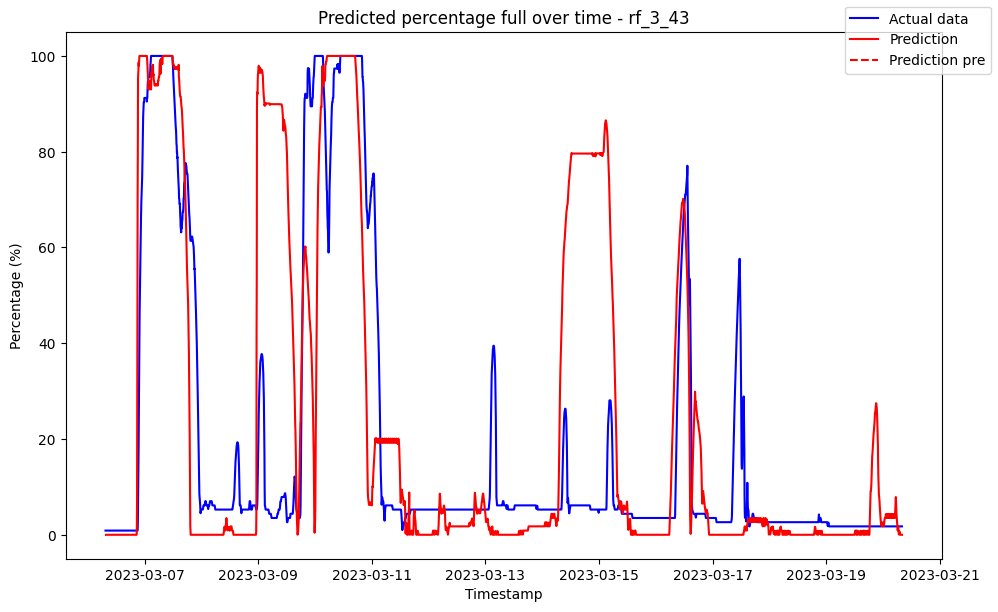

------------------------------------ rf_3_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1169209748902088
Variance (R²) score: 1.00


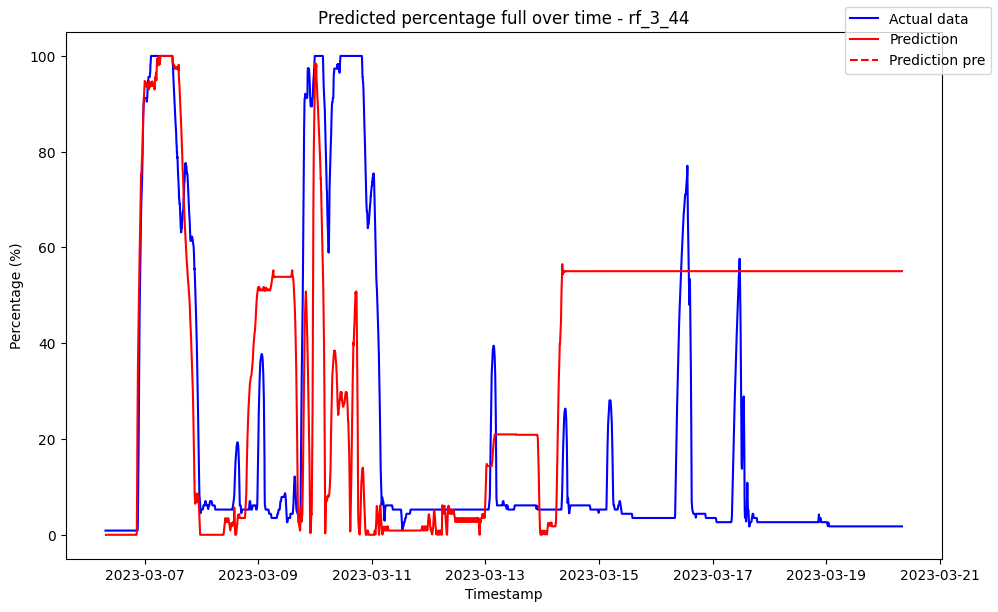

------------------------------------ rf_3_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11451852417312705
Variance (R²) score: 1.00


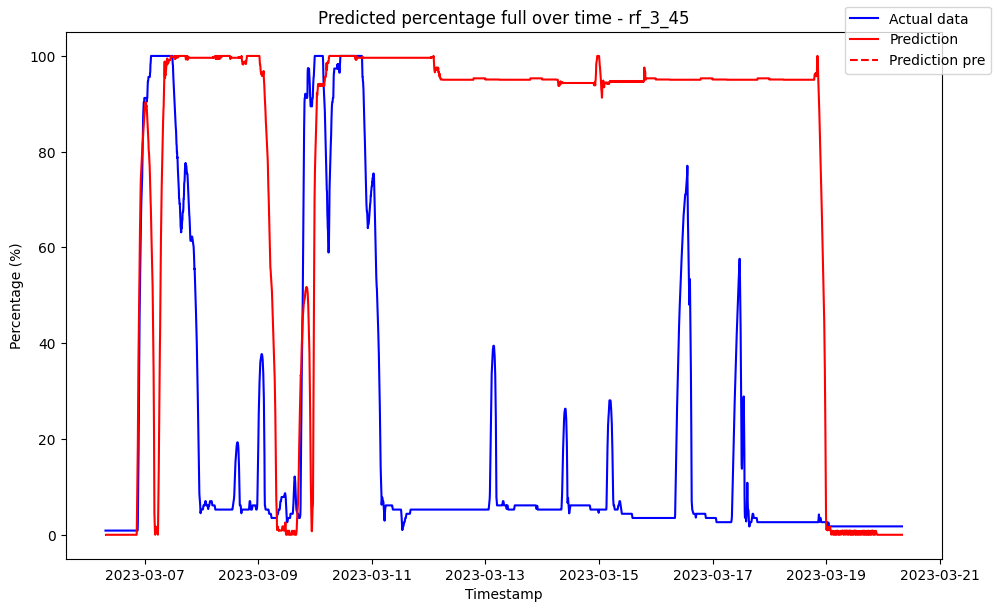

------------------------------------ rf_3_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08740231052599365
Variance (R²) score: 1.00


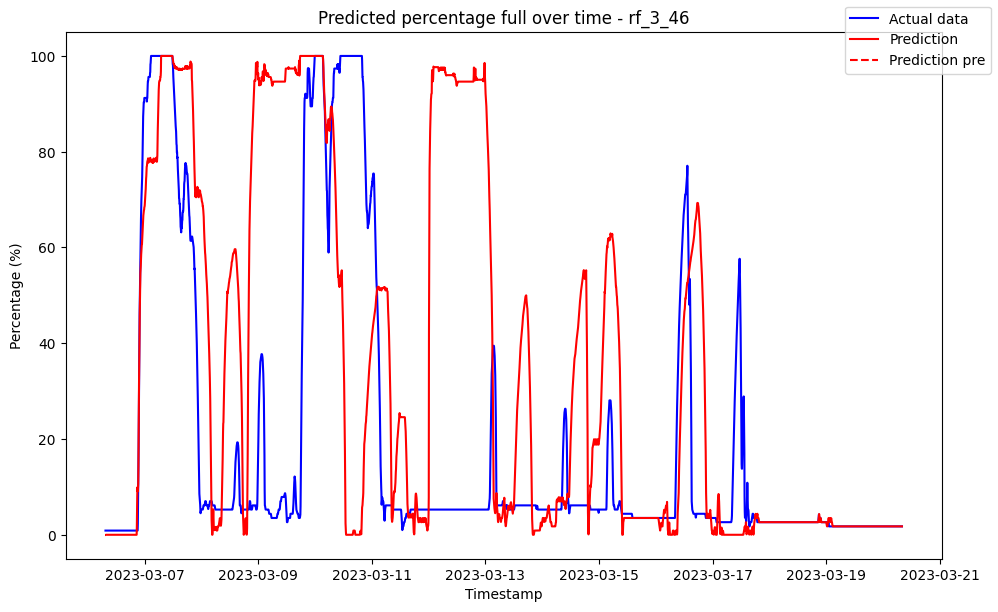

------------------------------------ rf_3_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14257169405631298
Variance (R²) score: 1.00


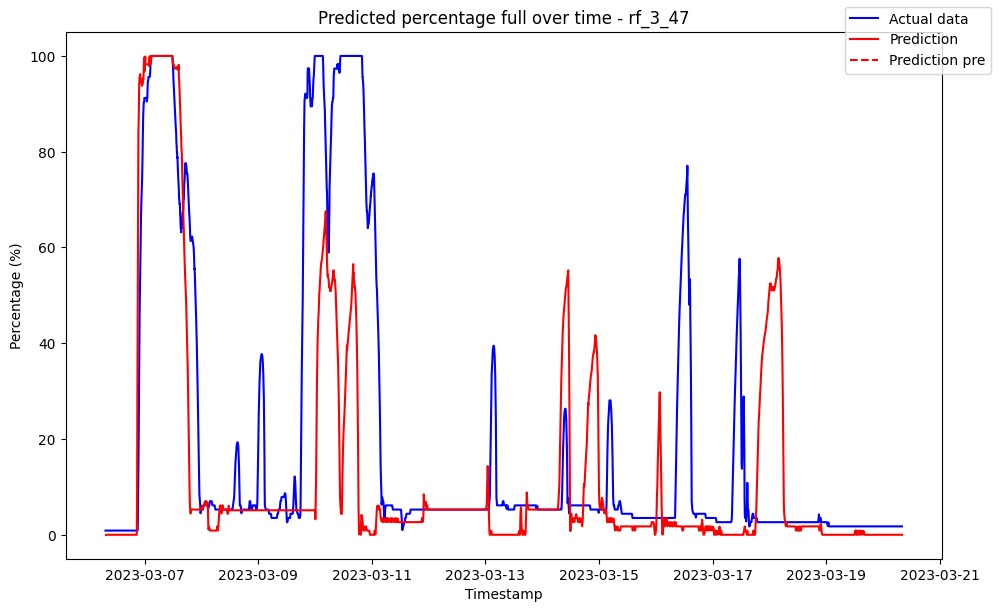

------------------------------------ rf_3_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1087998456941894
Variance (R²) score: 1.00


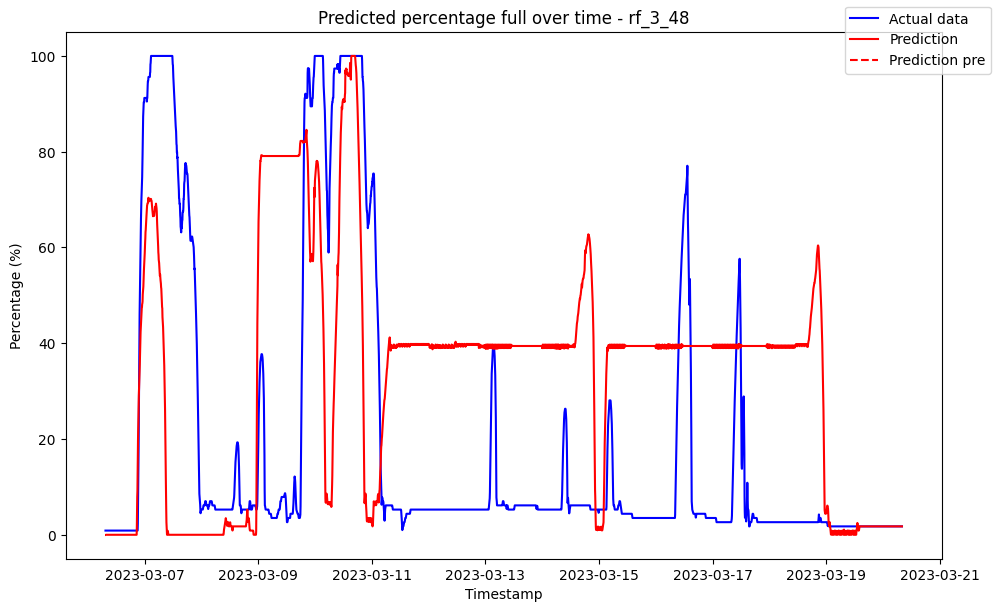

------------------------------------ rf_3_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.13574532250311225
Variance (R²) score: 1.00


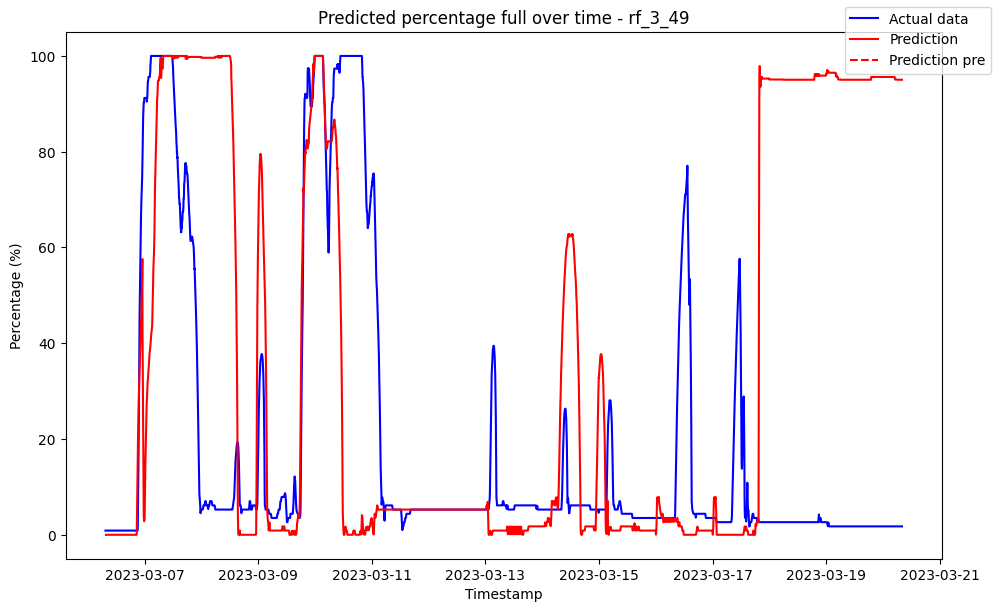

------------------------------------ rf_3_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.020524               0.0
1 2023-03-06 07:35:00            0.020524               0.0
2 2023-03-06 07:40:00            0.020524               0.0
3 2023-03-06 07:45:00            0.020524               0.0
4 2023-03-06 07:50:00            0.020524               0.0
5 2023-03-06 07:55:00            0.020524               0.0

Metrics for this specific prediction:
Accuracy: 99.91%
Mean squared error: 0.9447937095301994
Variance (R²) score: 1.00


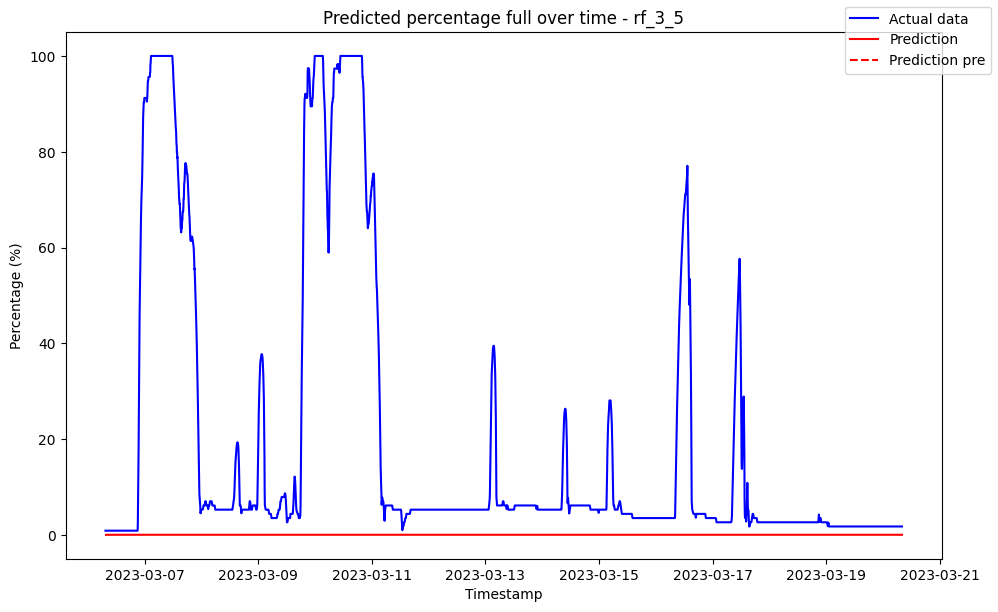

------------------------------------ rf_3_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.136877311841074
Variance (R²) score: 1.00


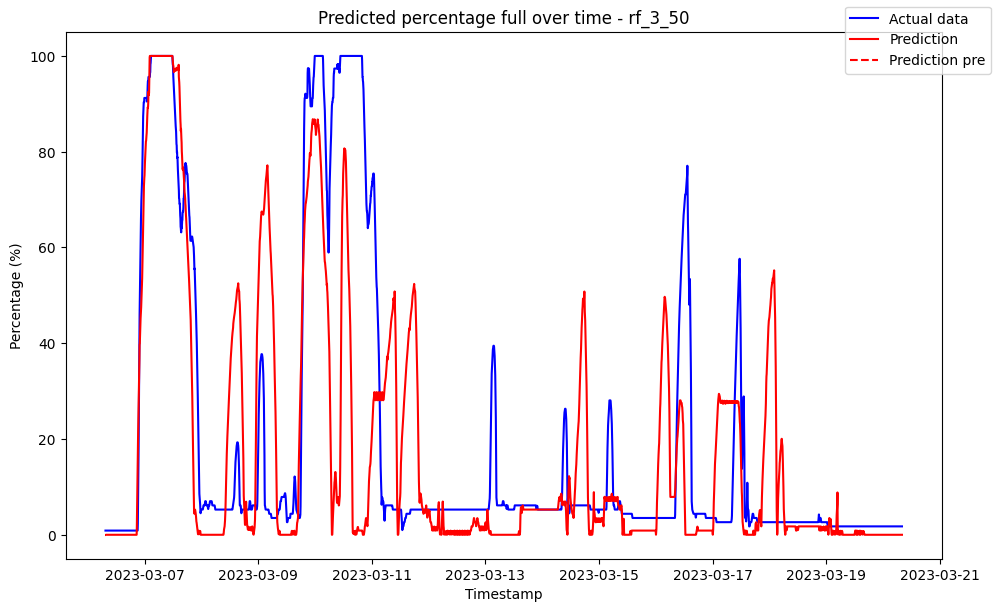

------------------------------------ rf_3_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.012398               0.0
1 2023-03-06 07:35:00            0.012398               0.0
2 2023-03-06 07:40:00            0.012398               0.0
3 2023-03-06 07:45:00            0.012398               0.0
4 2023-03-06 07:50:00            0.012398               0.0
5 2023-03-06 07:55:00            0.012398               0.0

Metrics for this specific prediction:
Accuracy: 99.93%
Mean squared error: 0.6654351614885232
Variance (R²) score: 1.00


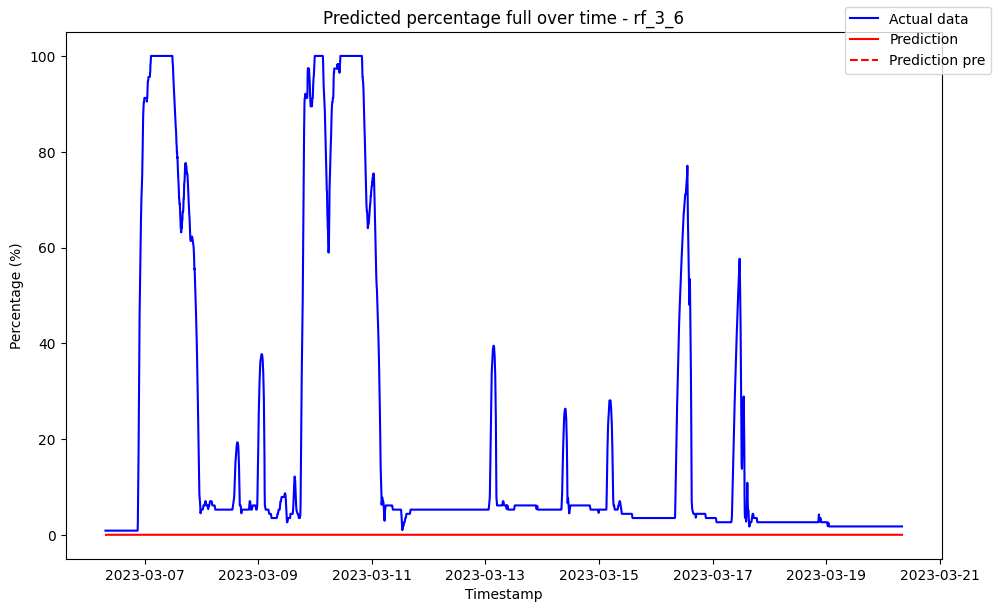

------------------------------------ rf_3_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007821               0.0
1 2023-03-06 07:35:00            0.007821               0.0
2 2023-03-06 07:40:00            0.007821               0.0
3 2023-03-06 07:45:00            0.007821               0.0
4 2023-03-06 07:50:00            0.007821               0.0
5 2023-03-06 07:55:00            0.007821               0.0

Metrics for this specific prediction:
Accuracy: 99.95%
Mean squared error: 0.5304483517832042
Variance (R²) score: 1.00


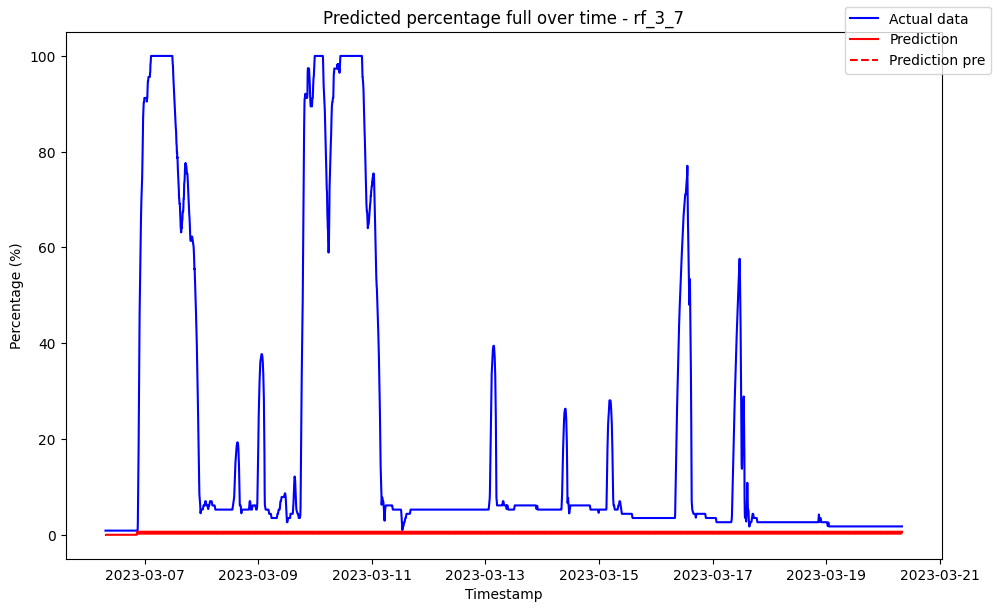

------------------------------------ rf_3_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006563               0.0
1 2023-03-06 07:35:00            0.006563               0.0
2 2023-03-06 07:40:00            0.006563               0.0
3 2023-03-06 07:45:00            0.006563               0.0
4 2023-03-06 07:50:00            0.006563               0.0
5 2023-03-06 07:55:00            0.006563               0.0

Metrics for this specific prediction:
Accuracy: 99.96%
Mean squared error: 0.43342155219138523
Variance (R²) score: 1.00


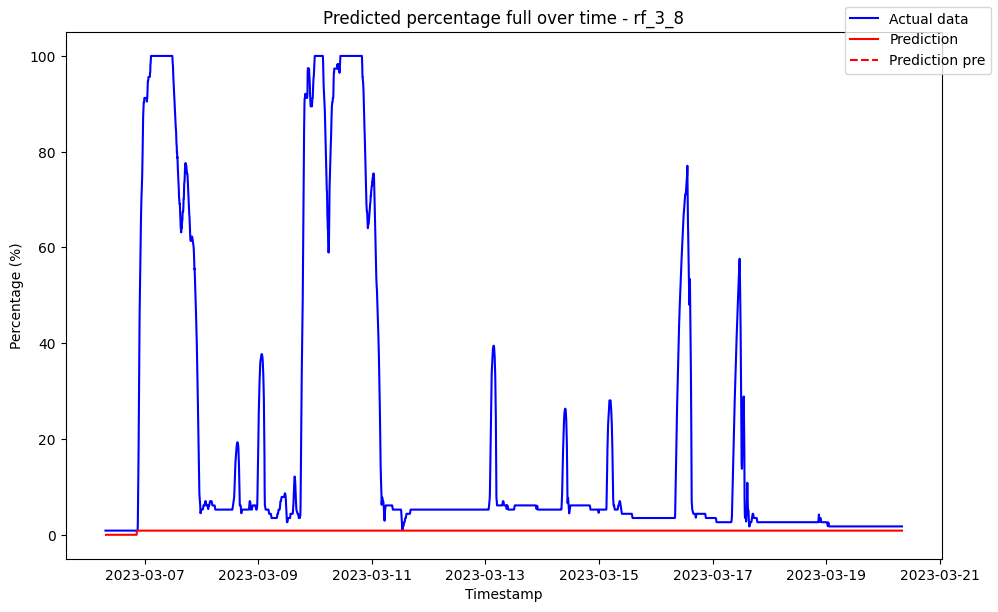

------------------------------------ rf_3_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.030656               0.0
1 2023-03-06 07:35:00            0.330323               0.0
2 2023-03-06 07:40:00            0.659378               0.0
3 2023-03-06 07:45:00            0.822397               0.0
4 2023-03-06 07:50:00            0.873147               0.0
5 2023-03-06 07:55:00            0.873147               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.3026653715148941
Variance (R²) score: 1.00


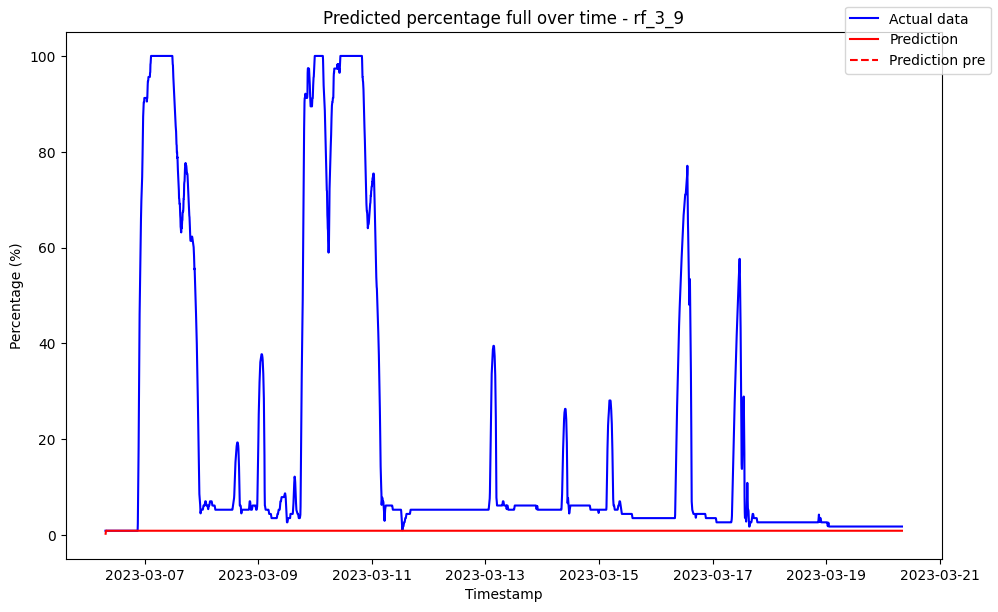

------------------------------------ rf_4_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00             3.53376               0.0
1 2023-03-06 07:35:00             3.53376               0.0
2 2023-03-06 07:40:00             3.53376               0.0
3 2023-03-06 07:45:00             3.53376               0.0
4 2023-03-06 07:50:00             3.53376               0.0
5 2023-03-06 07:55:00             3.53376               0.0

Metrics for this specific prediction:
Accuracy: 89.45%
Mean squared error: 107.69828669239804
Variance (R²) score: 0.89


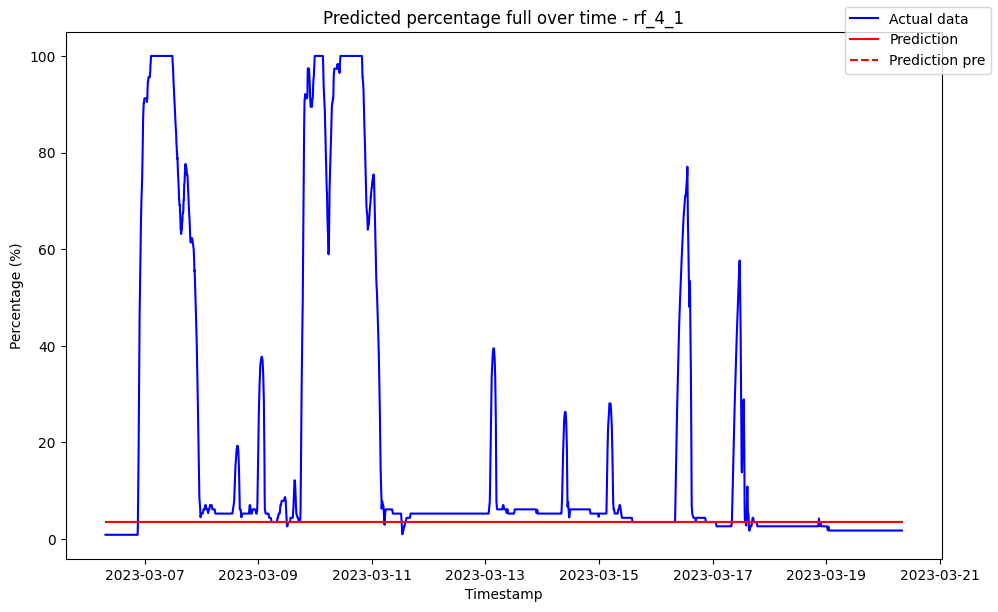

------------------------------------ rf_4_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.034282               0.0
1 2023-03-06 07:35:00            0.372568               0.0
2 2023-03-06 07:40:00            0.729371               0.0
3 2023-03-06 07:45:00            0.724641               0.0
4 2023-03-06 07:50:00            0.595558               0.0
5 2023-03-06 07:55:00            0.351471               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.22804648820966383
Variance (R²) score: 1.00


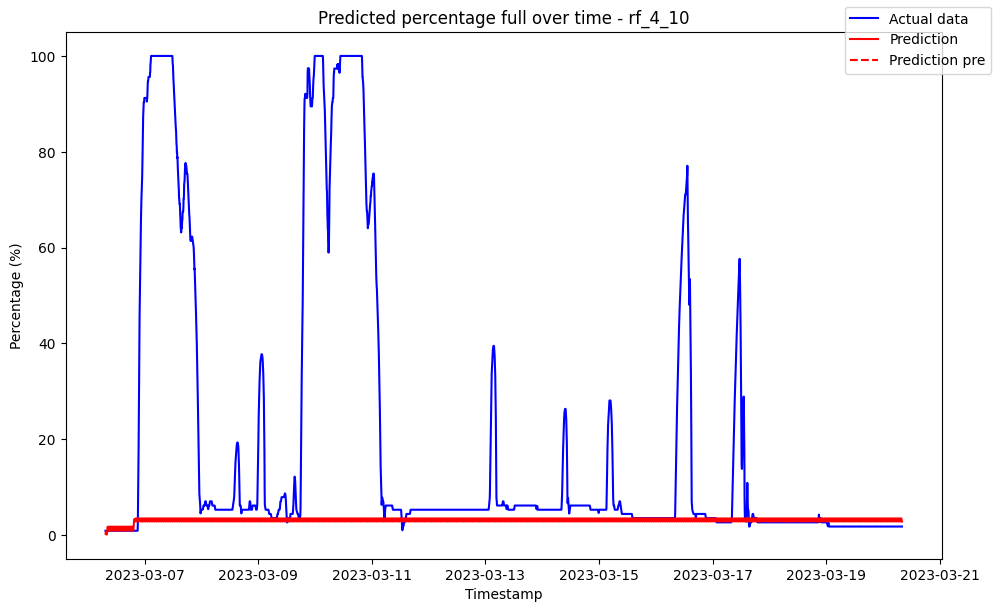

------------------------------------ rf_4_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.022292               0.0
1 2023-03-06 07:35:00            0.362557               0.0
2 2023-03-06 07:40:00            0.649985               0.0
3 2023-03-06 07:45:00            0.838369               0.0
4 2023-03-06 07:50:00            0.667734               0.0
5 2023-03-06 07:55:00            0.378399               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.15978206962005173
Variance (R²) score: 1.00


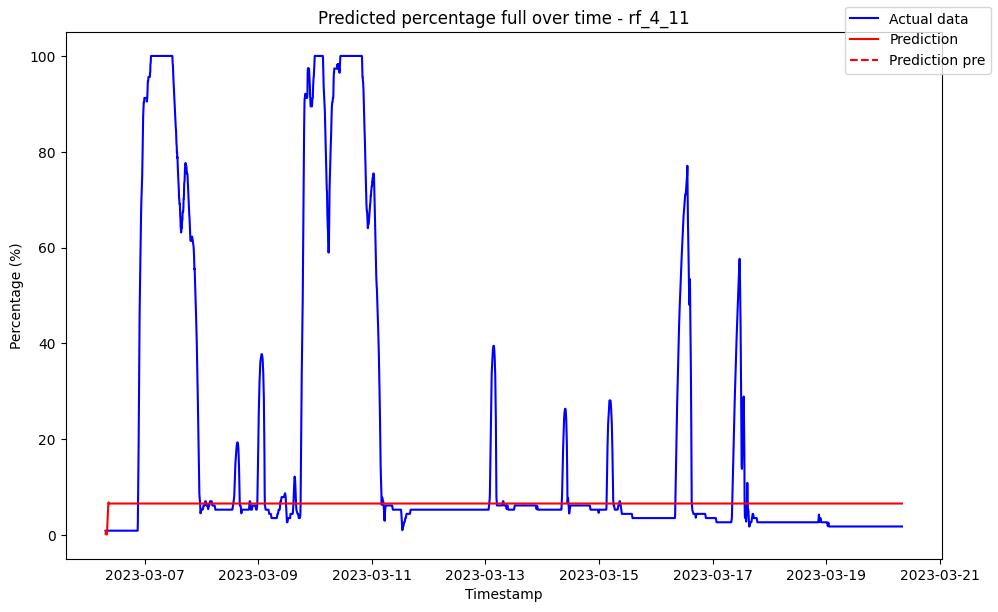

------------------------------------ rf_4_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.014448               0.0
1 2023-03-06 07:35:00            0.111886               0.0
2 2023-03-06 07:40:00            0.483078               0.0
3 2023-03-06 07:45:00            0.907313               0.0
4 2023-03-06 07:50:00            1.604476               0.0
5 2023-03-06 07:55:00            1.768541               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1347883200712235
Variance (R²) score: 1.00


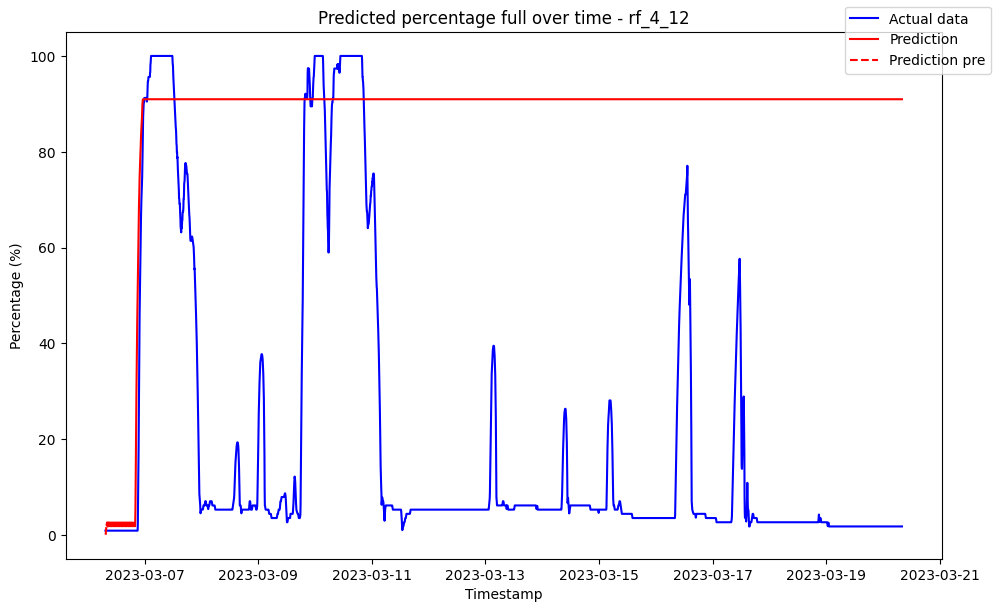

------------------------------------ rf_4_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009402               0.0
1 2023-03-06 07:35:00            0.088932               0.0
2 2023-03-06 07:40:00            0.850877               0.0
3 2023-03-06 07:45:00            1.202955               0.0
4 2023-03-06 07:50:00            1.575191               0.0
5 2023-03-06 07:55:00            1.676694               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.13881631218613952
Variance (R²) score: 1.00


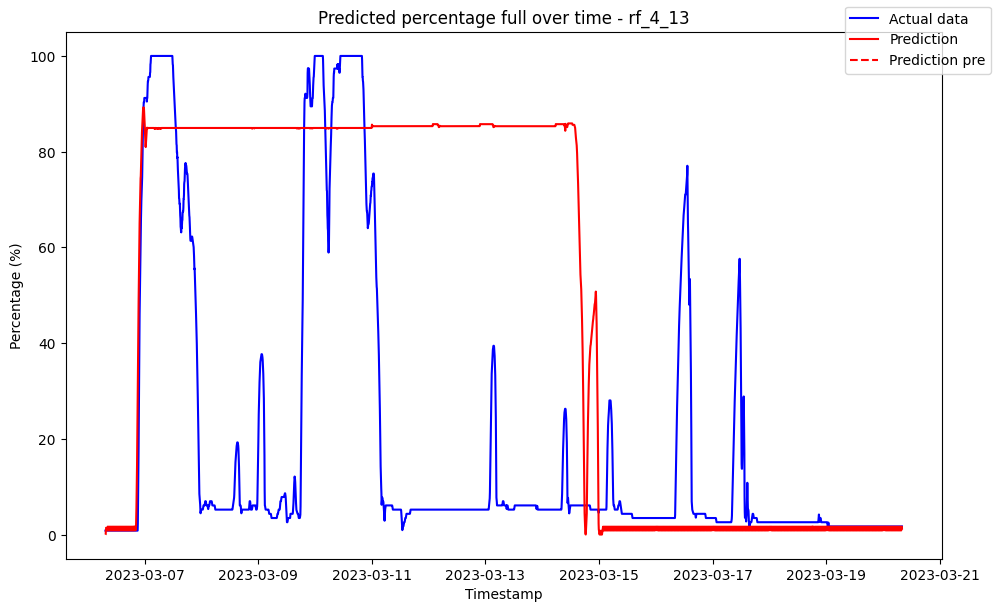

------------------------------------ rf_4_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.011461               0.0
1 2023-03-06 07:35:00            0.092832               0.0
2 2023-03-06 07:40:00            0.821449               0.0
3 2023-03-06 07:45:00            1.493375               0.0
4 2023-03-06 07:50:00            2.689408               0.0
5 2023-03-06 07:55:00            3.938400               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11111629924412153
Variance (R²) score: 1.00


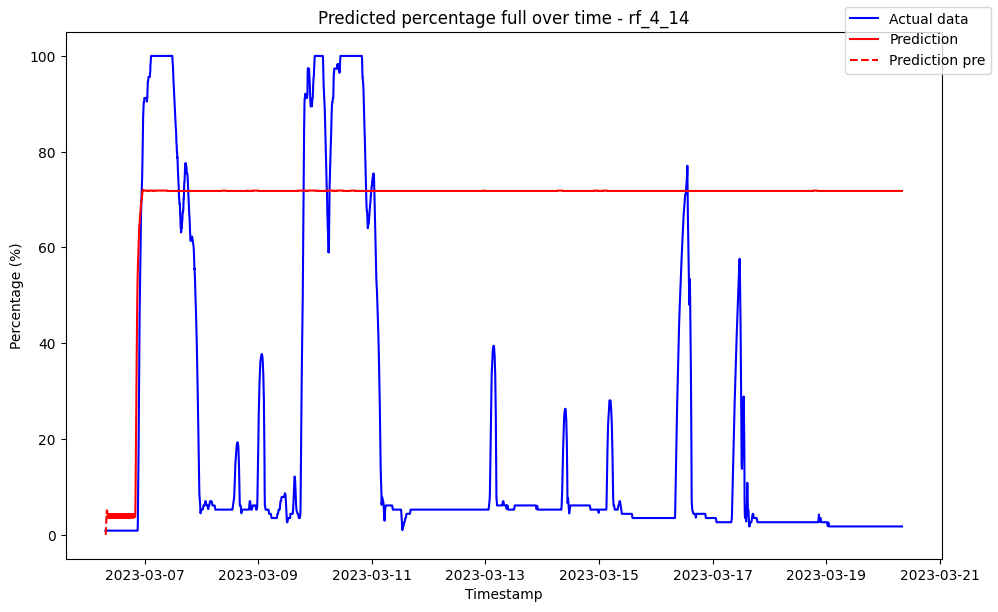

------------------------------------ rf_4_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009537               0.0
1 2023-03-06 07:35:00            0.078933               0.0
2 2023-03-06 07:40:00            0.430161               0.0
3 2023-03-06 07:45:00            0.715777               0.0
4 2023-03-06 07:50:00            0.842029               0.0
5 2023-03-06 07:55:00            0.561176               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1078438034287361
Variance (R²) score: 1.00


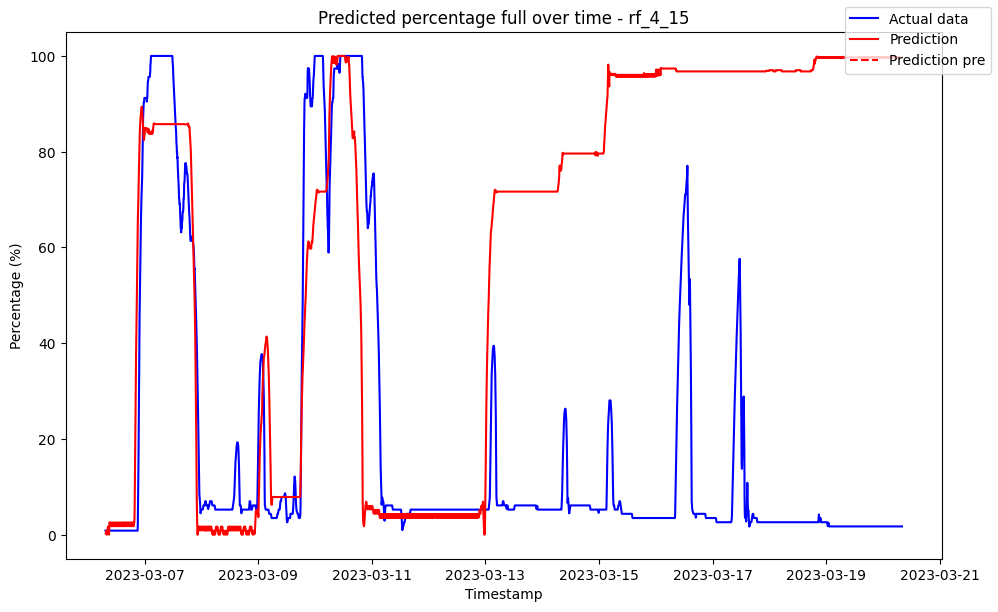

------------------------------------ rf_4_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007719               0.0
1 2023-03-06 07:35:00            0.084184               0.0
2 2023-03-06 07:40:00            0.367547               0.0
3 2023-03-06 07:45:00            0.665436               0.0
4 2023-03-06 07:50:00            0.854636               0.0
5 2023-03-06 07:55:00            0.469227               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12683551411572266
Variance (R²) score: 1.00


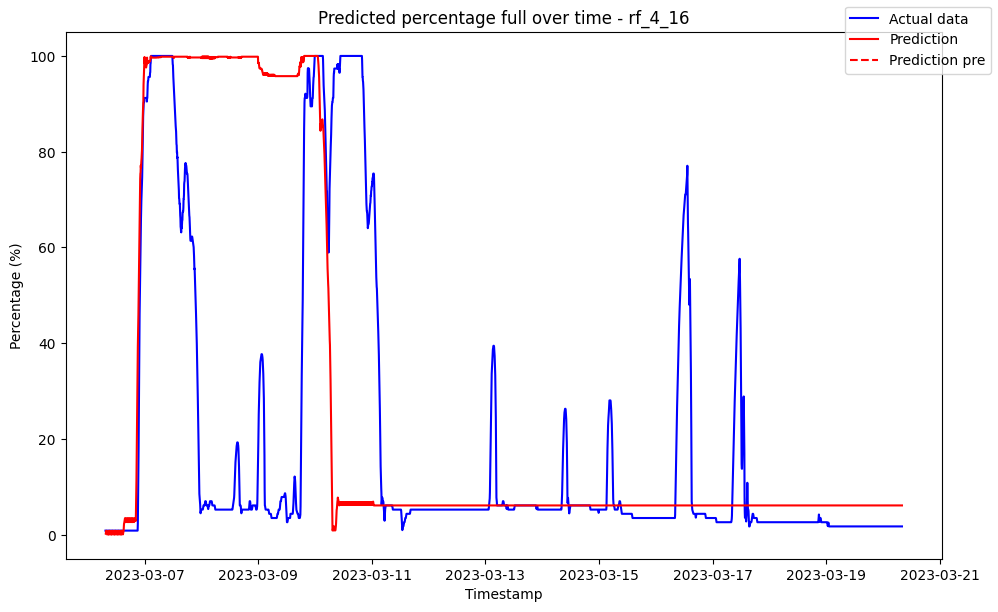

------------------------------------ rf_4_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004266               0.0
1 2023-03-06 07:35:00            0.078666               0.0
2 2023-03-06 07:40:00            0.439414               0.0
3 2023-03-06 07:45:00            0.731346               0.0
4 2023-03-06 07:50:00            0.844782               0.0
5 2023-03-06 07:55:00            0.415351               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10907806442182276
Variance (R²) score: 1.00


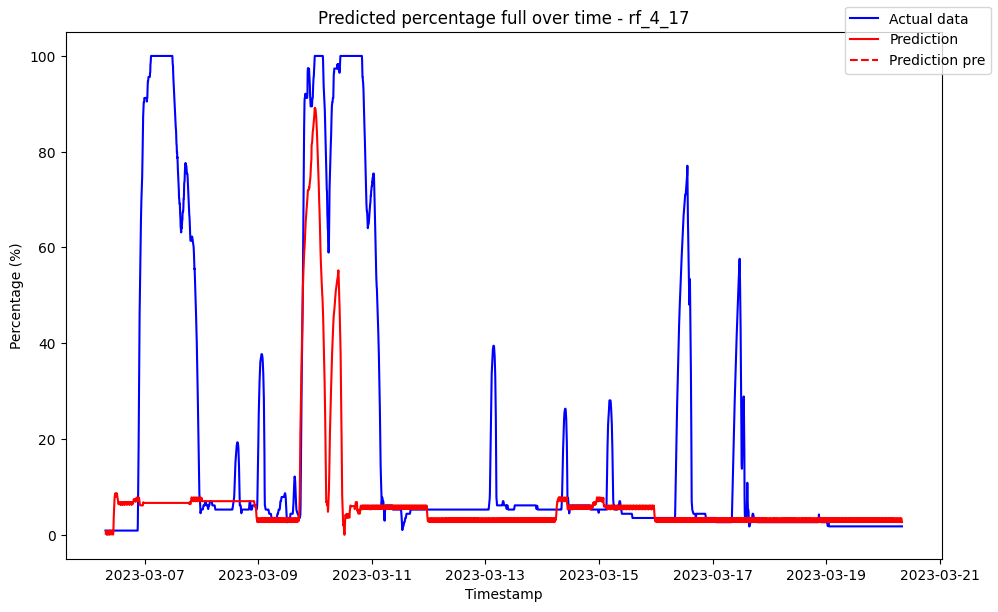

------------------------------------ rf_4_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006460               0.0
1 2023-03-06 07:35:00            0.081891               0.0
2 2023-03-06 07:40:00            0.367632               0.0
3 2023-03-06 07:45:00            0.670917               0.0
4 2023-03-06 07:50:00            0.850534               0.0
5 2023-03-06 07:55:00            0.552584               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11214511864664559
Variance (R²) score: 1.00


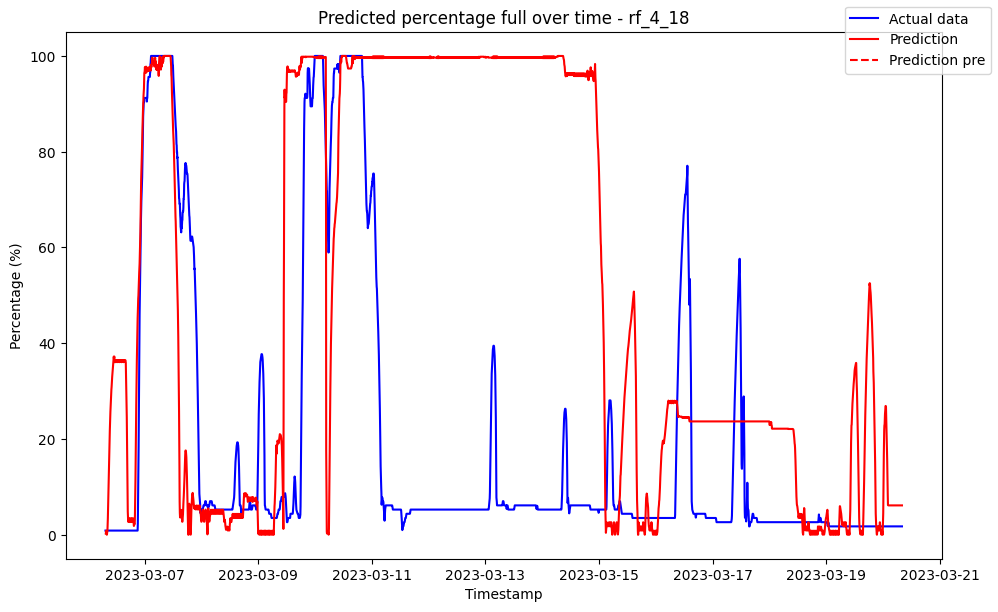

------------------------------------ rf_4_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005456               0.0
1 2023-03-06 07:35:00            0.080968               0.0
2 2023-03-06 07:40:00            0.425760               0.0
3 2023-03-06 07:45:00            0.703425               0.0
4 2023-03-06 07:50:00            0.828576               0.0
5 2023-03-06 07:55:00            0.581408               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09261867580765465
Variance (R²) score: 1.00


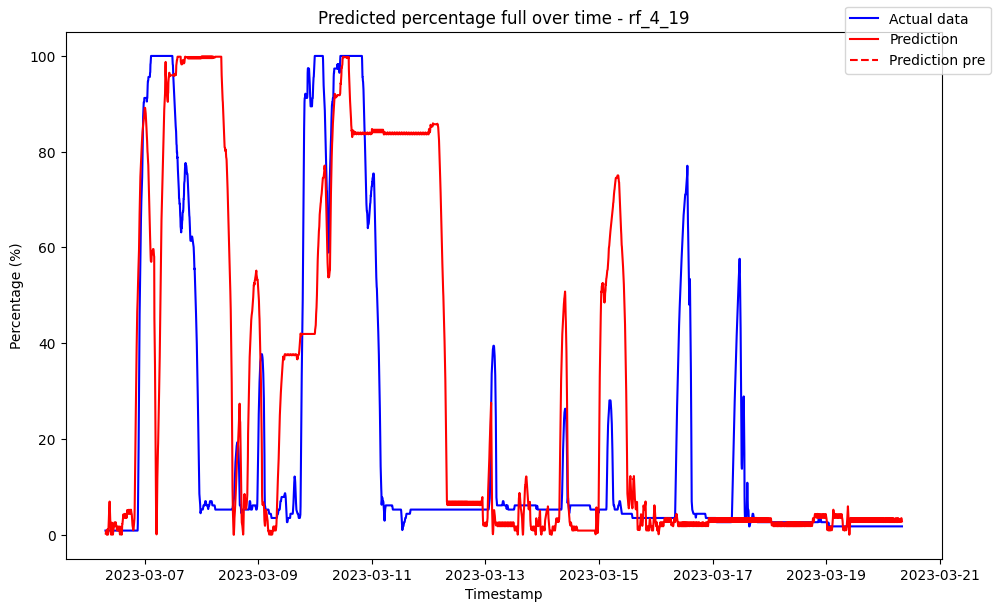

------------------------------------ rf_4_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            1.182635               0.0
1 2023-03-06 07:35:00            1.182635               0.0
2 2023-03-06 07:40:00            1.182635               0.0
3 2023-03-06 07:45:00            1.182635               0.0
4 2023-03-06 07:50:00            1.182635               0.0
5 2023-03-06 07:55:00            1.182635               0.0

Metrics for this specific prediction:
Accuracy: 96.5%
Mean squared error: 35.71920661100229
Variance (R²) score: 0.97


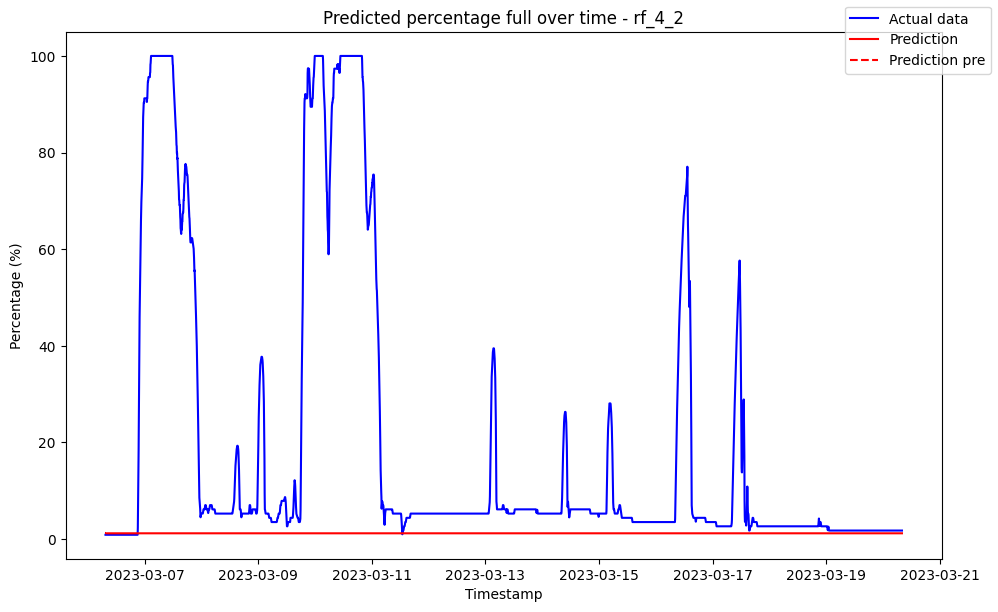

------------------------------------ rf_4_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.002637               0.0
1 2023-03-06 07:35:00            0.077631               0.0
2 2023-03-06 07:40:00            0.439114               0.0
3 2023-03-06 07:45:00            0.729786               0.0
4 2023-03-06 07:50:00            0.797253               0.0
5 2023-03-06 07:55:00            0.511075               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08591193159648888
Variance (R²) score: 1.00


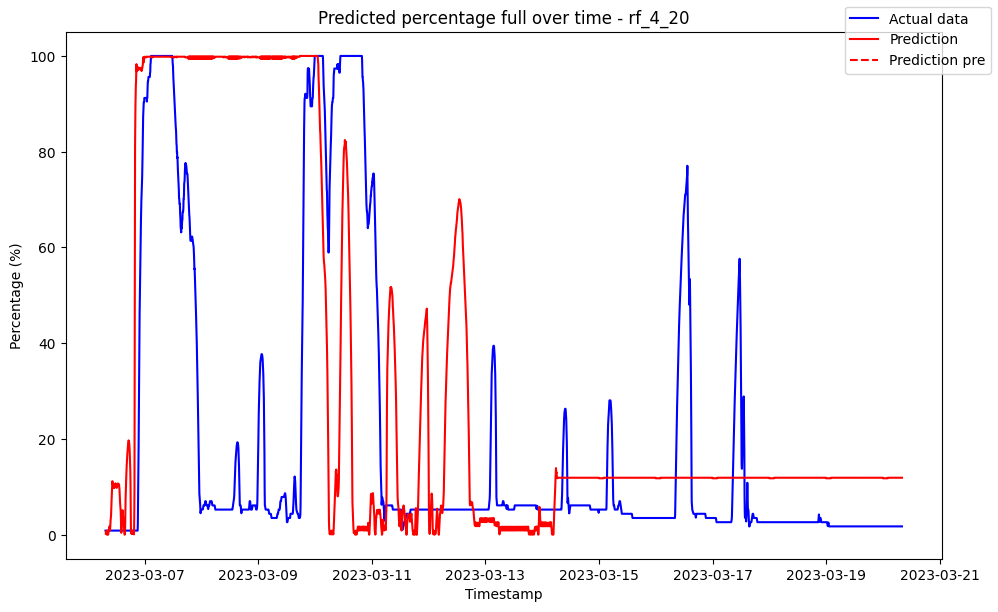

------------------------------------ rf_4_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005459               0.0
1 2023-03-06 07:35:00            0.076914               0.0
2 2023-03-06 07:40:00            0.437250               0.0
3 2023-03-06 07:45:00            0.722867               0.0
4 2023-03-06 07:50:00            0.845267               0.0
5 2023-03-06 07:55:00            0.704875               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11567555451087866
Variance (R²) score: 1.00


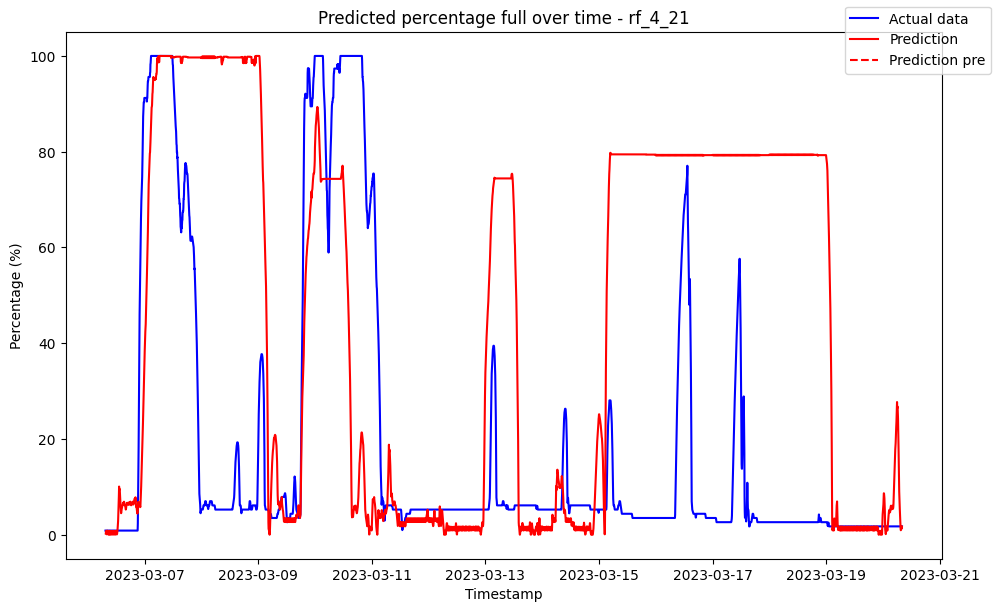

------------------------------------ rf_4_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010338               0.0
1 2023-03-06 07:35:00            0.085481               0.0
2 2023-03-06 07:40:00            0.429000               0.0
3 2023-03-06 07:45:00            0.719865               0.0
4 2023-03-06 07:50:00            0.853477               0.0
5 2023-03-06 07:55:00            0.755500               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08421579568384206
Variance (R²) score: 1.00


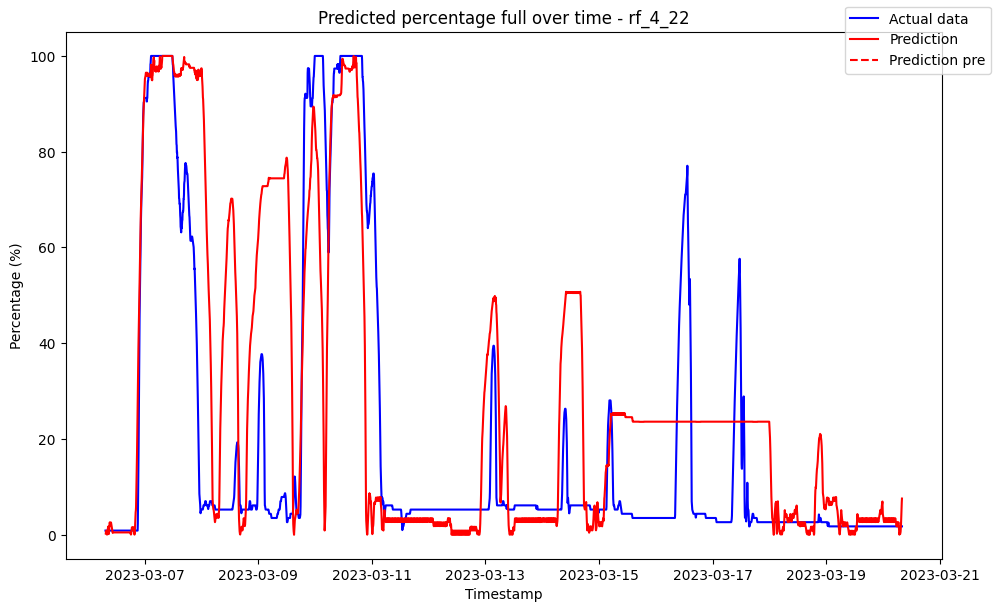

------------------------------------ rf_4_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11229038774453087
Variance (R²) score: 1.00


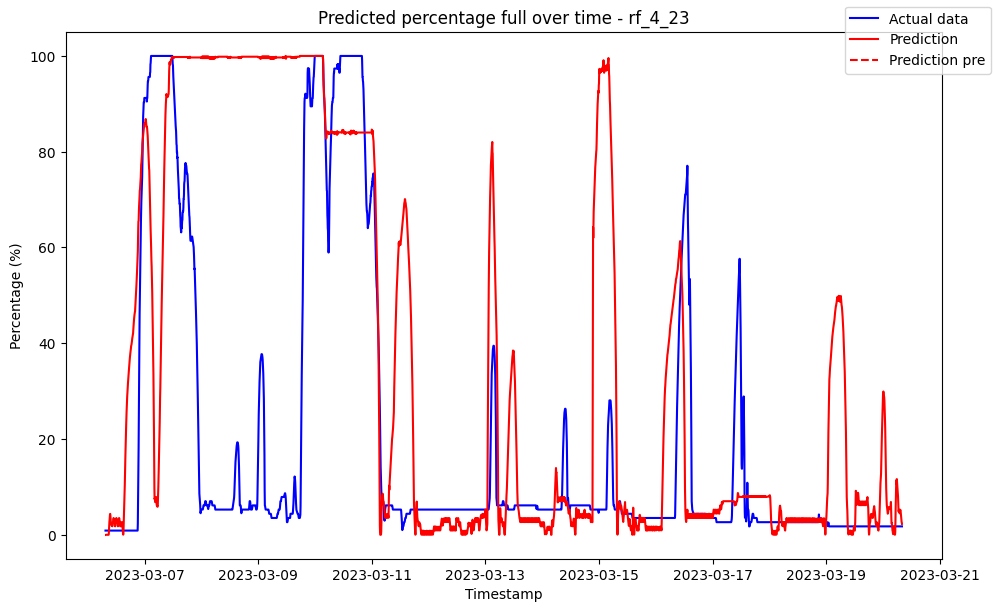

------------------------------------ rf_4_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09903789022151963
Variance (R²) score: 1.00


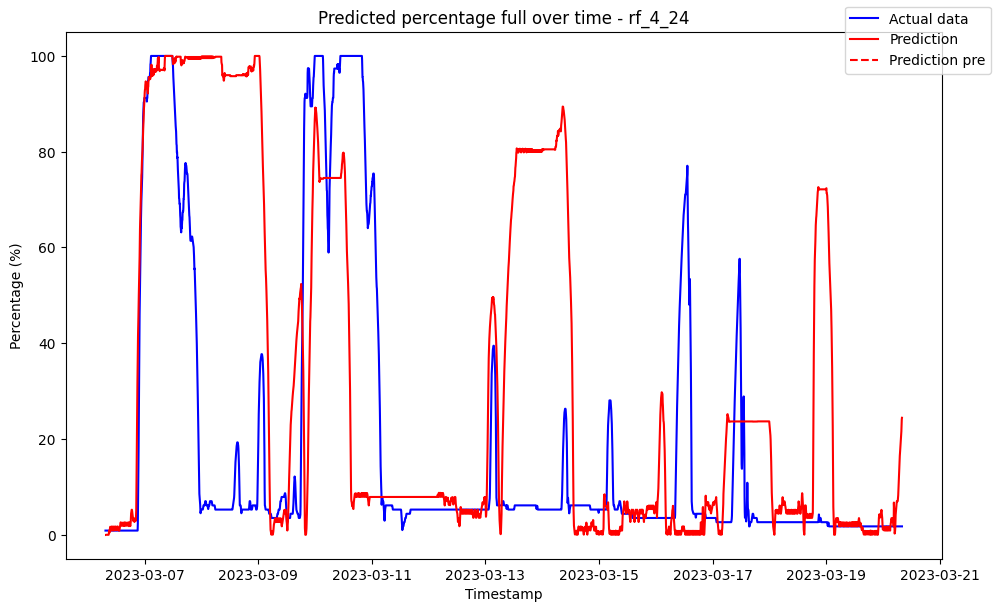

------------------------------------ rf_4_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08518292422299022
Variance (R²) score: 1.00


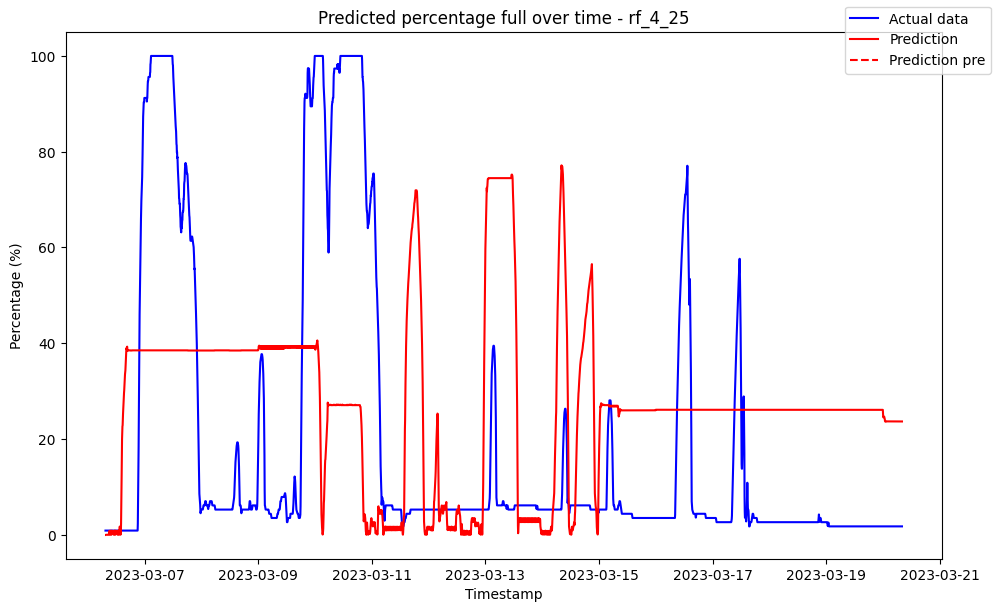

------------------------------------ rf_4_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11690606858114604
Variance (R²) score: 1.00


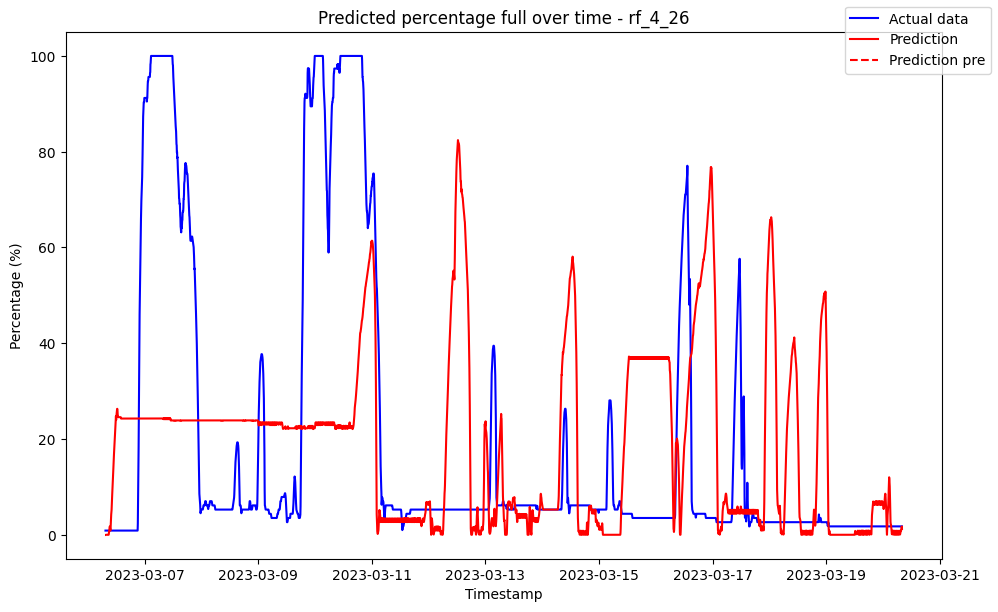

------------------------------------ rf_4_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09065721389237959
Variance (R²) score: 1.00


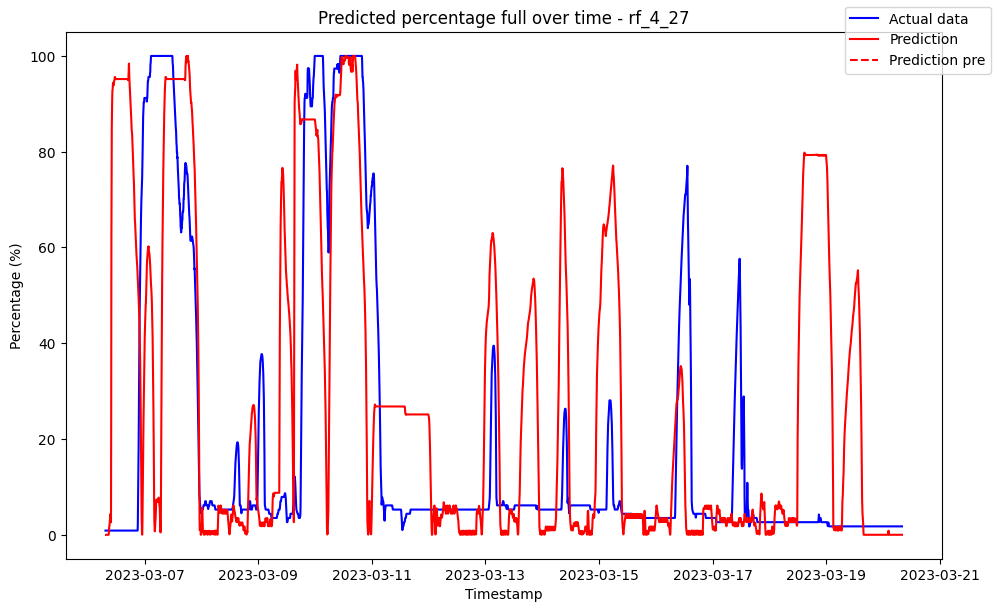

------------------------------------ rf_4_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1102503790622658
Variance (R²) score: 1.00


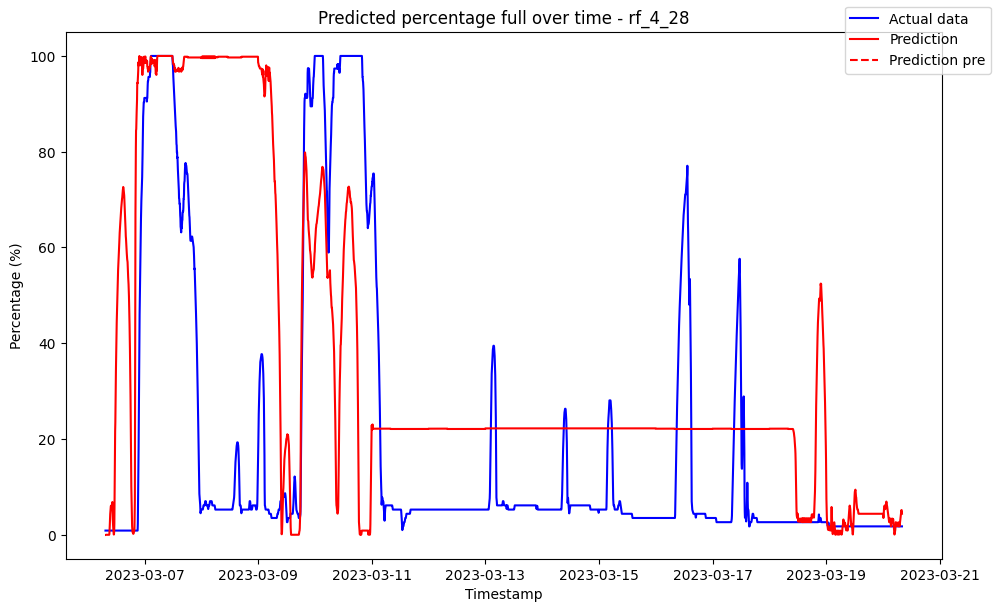

------------------------------------ rf_4_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1170774656501003
Variance (R²) score: 1.00


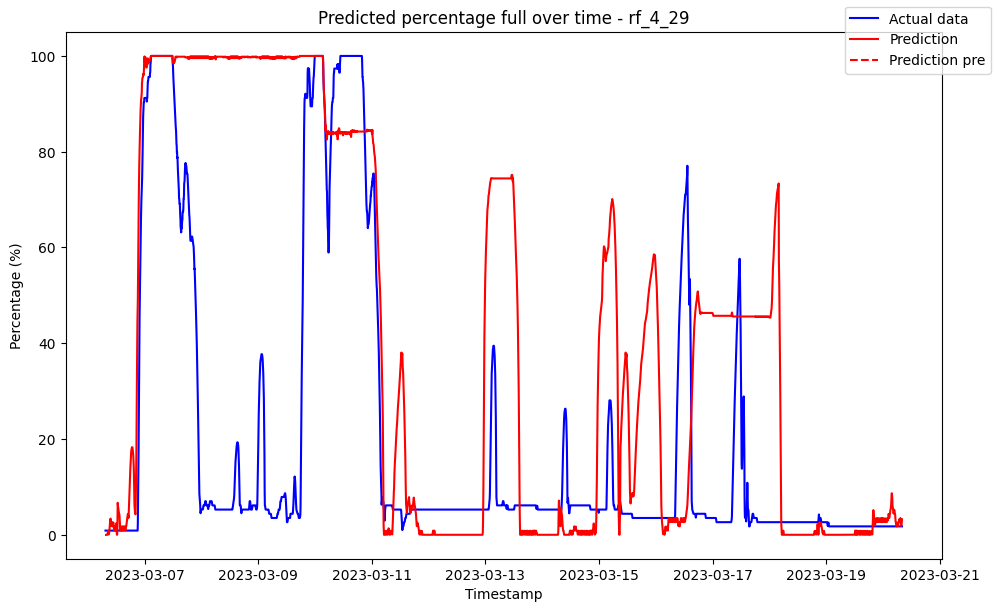

------------------------------------ rf_4_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00             0.39847               0.0
1 2023-03-06 07:35:00             0.39847               0.0
2 2023-03-06 07:40:00             0.39847               0.0
3 2023-03-06 07:45:00             0.39847               0.0
4 2023-03-06 07:50:00             0.39847               0.0
5 2023-03-06 07:55:00             0.39847               0.0

Metrics for this specific prediction:
Accuracy: 99.37%
Mean squared error: 6.398693259877733
Variance (R²) score: 0.99


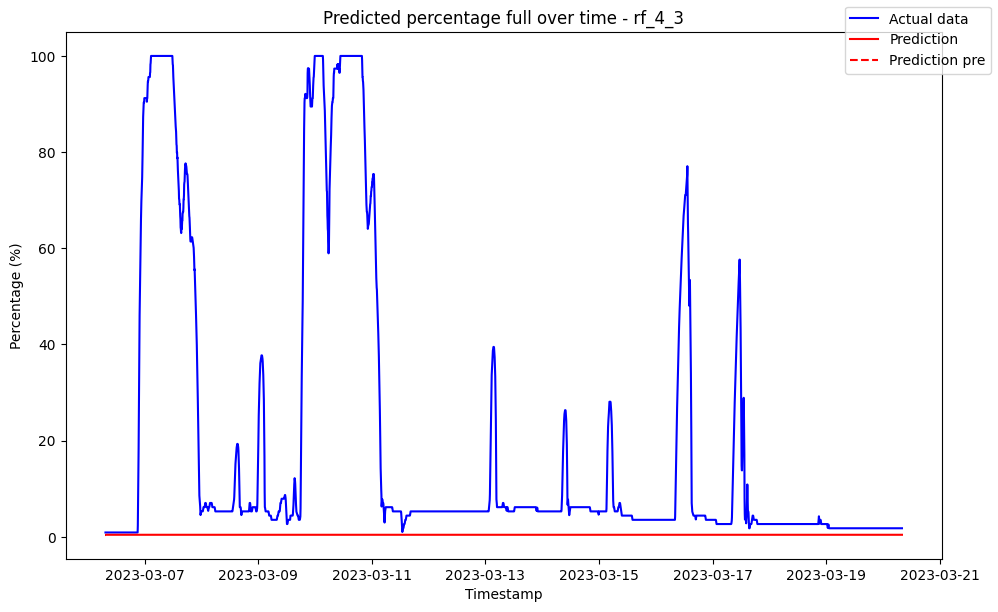

------------------------------------ rf_4_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1172975297729548
Variance (R²) score: 1.00


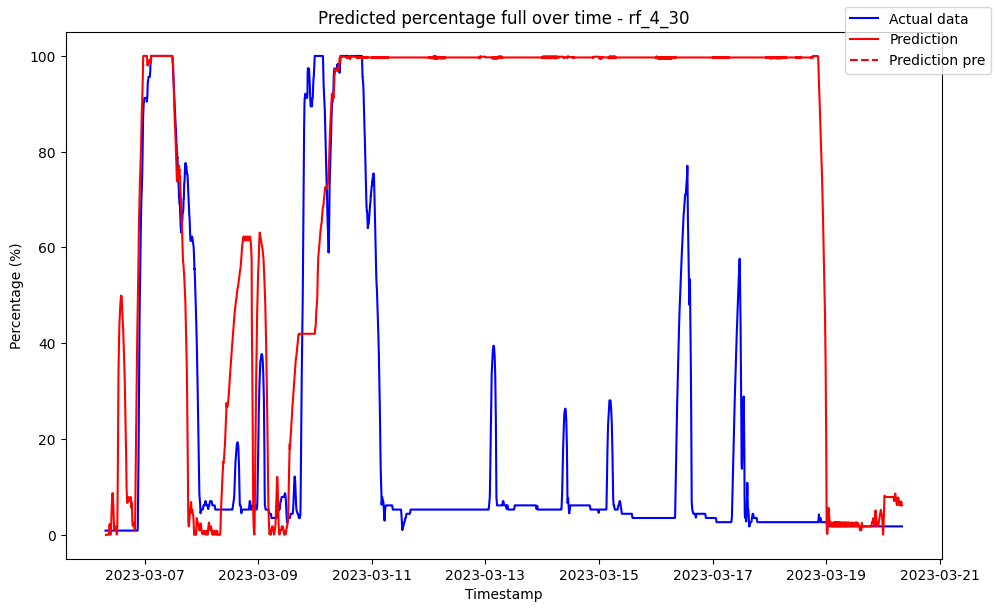

------------------------------------ rf_4_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10220047317346392
Variance (R²) score: 1.00


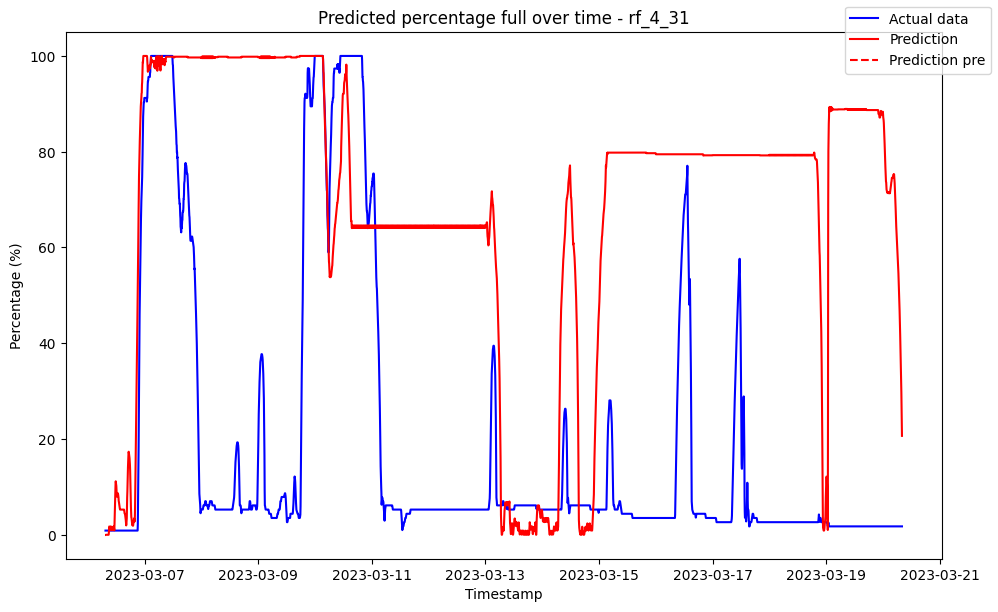

------------------------------------ rf_4_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0941512924315599
Variance (R²) score: 1.00


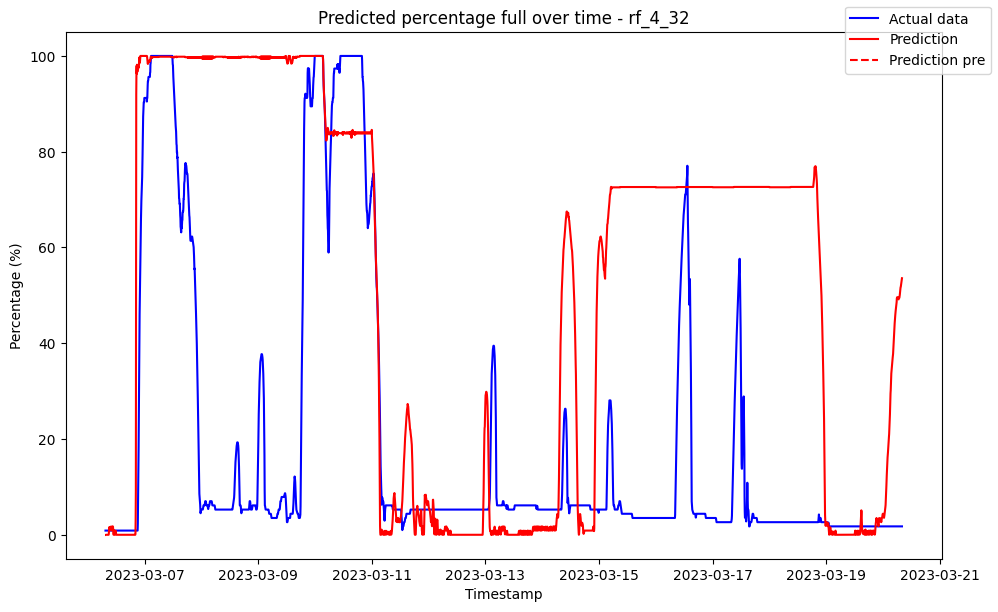

------------------------------------ rf_4_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12470117304673331
Variance (R²) score: 1.00


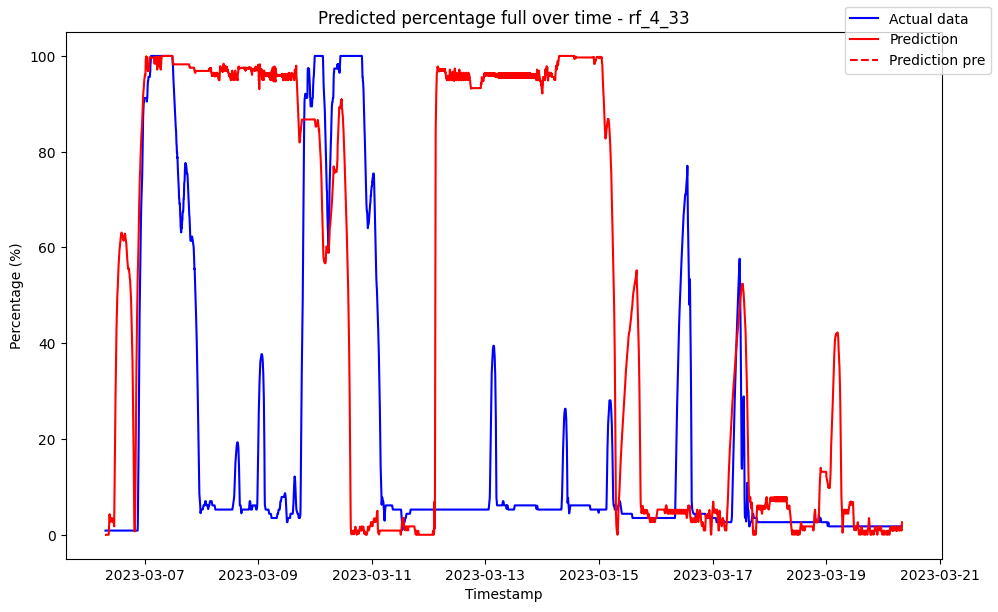

------------------------------------ rf_4_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10060163667781302
Variance (R²) score: 1.00


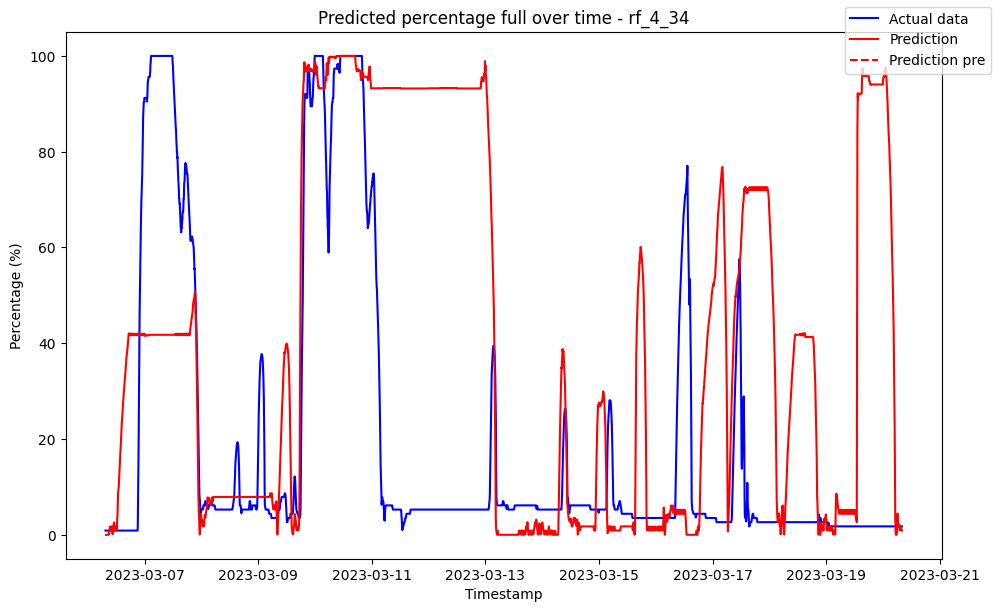

------------------------------------ rf_4_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11787325647491943
Variance (R²) score: 1.00


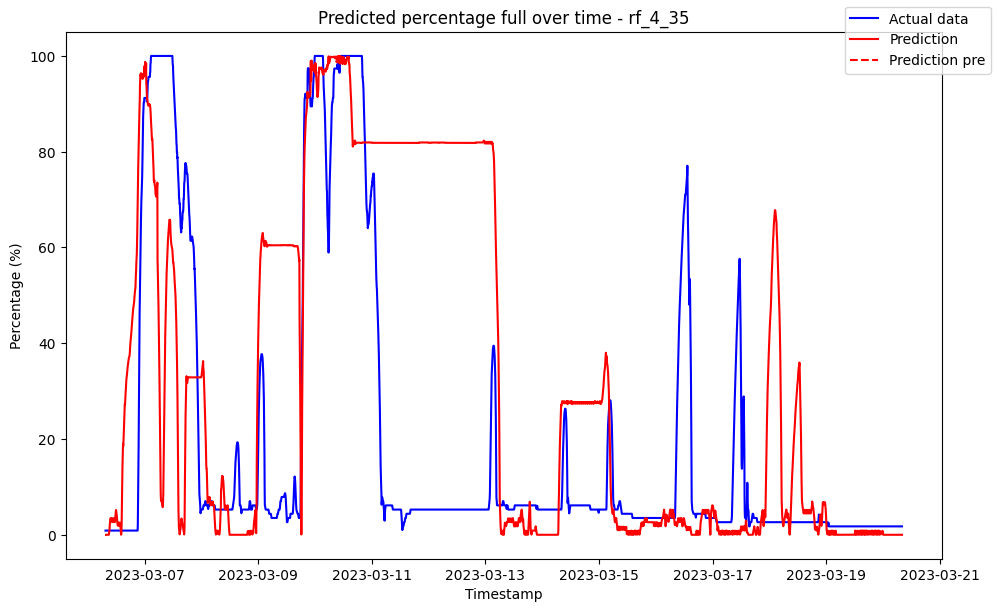

------------------------------------ rf_4_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11987235136030527
Variance (R²) score: 1.00


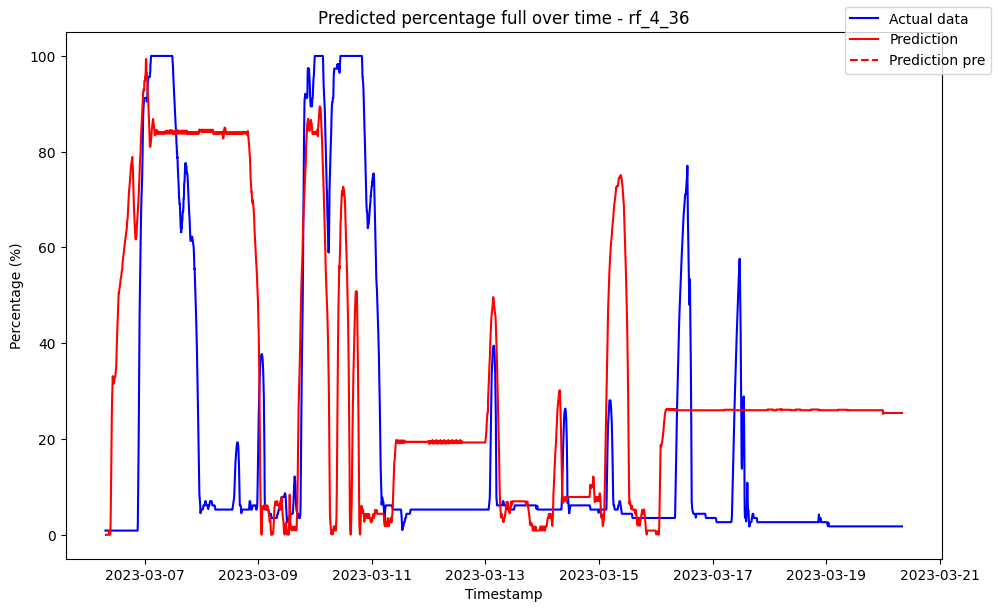

------------------------------------ rf_4_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12256968985685288
Variance (R²) score: 1.00


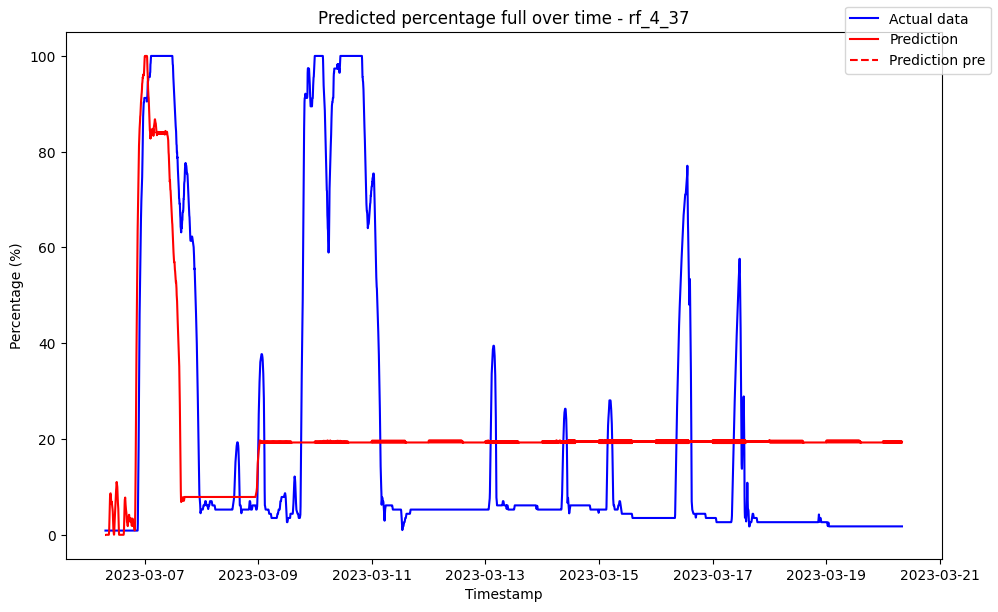

------------------------------------ rf_4_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10100076486389725
Variance (R²) score: 1.00


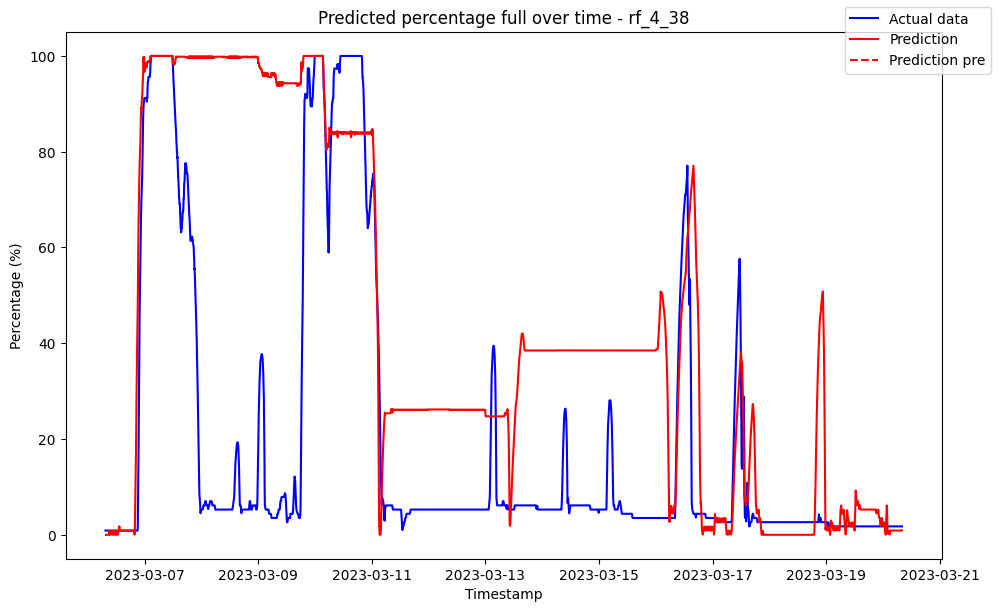

------------------------------------ rf_4_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09228523465628767
Variance (R²) score: 1.00


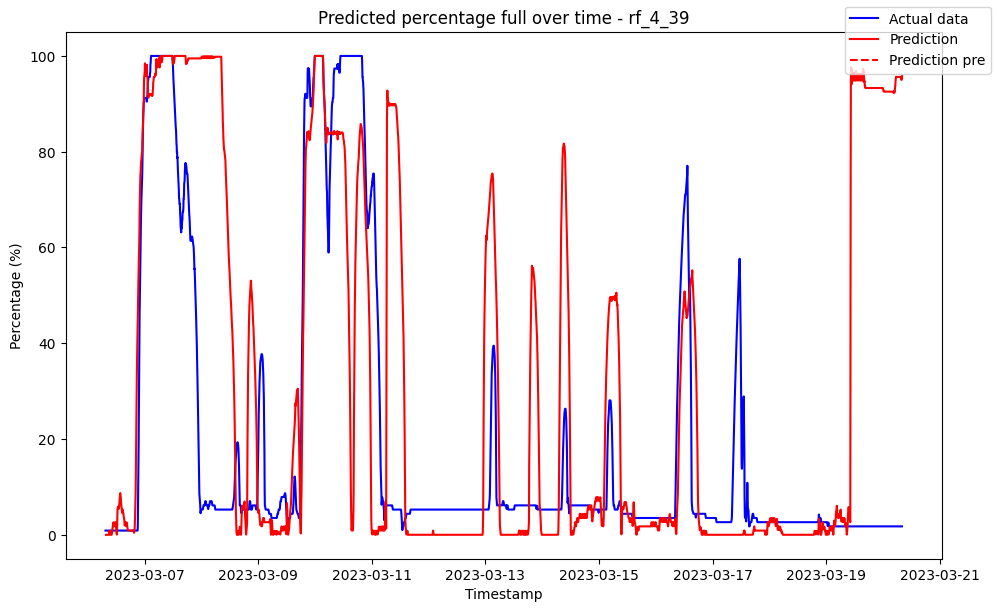

------------------------------------ rf_4_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.020597               0.0
1 2023-03-06 07:35:00            0.020597               0.0
2 2023-03-06 07:40:00            0.020597               0.0
3 2023-03-06 07:45:00            0.020597               0.0
4 2023-03-06 07:50:00            0.020597               0.0
5 2023-03-06 07:55:00            0.020597               0.0

Metrics for this specific prediction:
Accuracy: 99.8%
Mean squared error: 2.0523979986491807
Variance (R²) score: 1.00


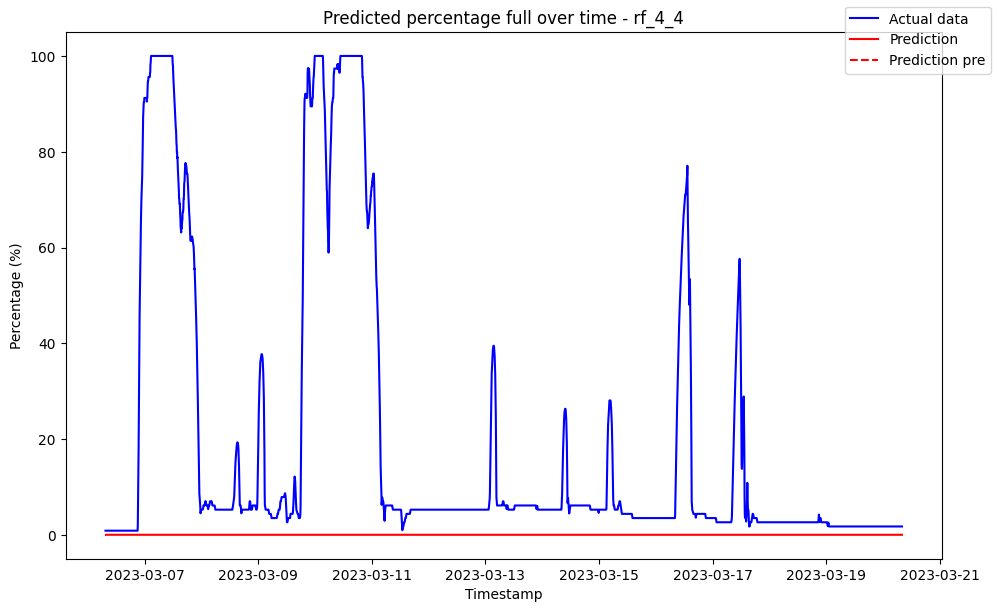

------------------------------------ rf_4_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08992342961672252
Variance (R²) score: 1.00


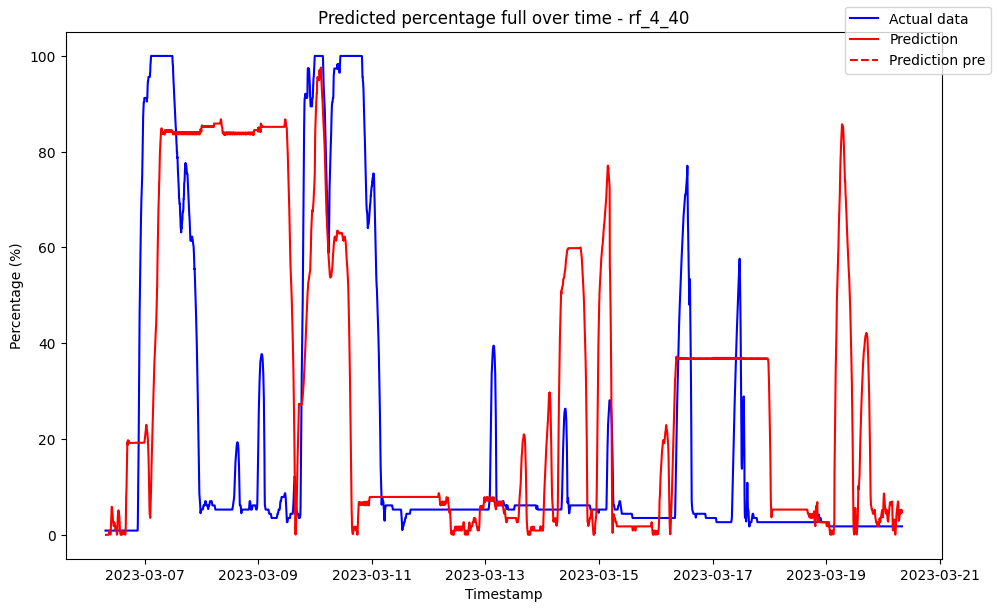

------------------------------------ rf_4_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10860362079844237
Variance (R²) score: 1.00


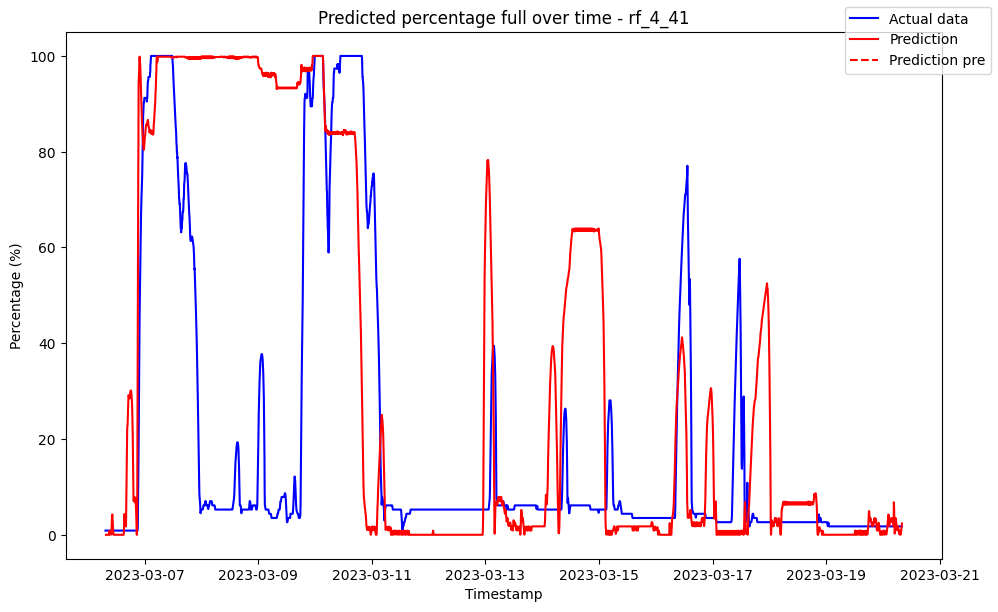

------------------------------------ rf_4_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09364023724147535
Variance (R²) score: 1.00


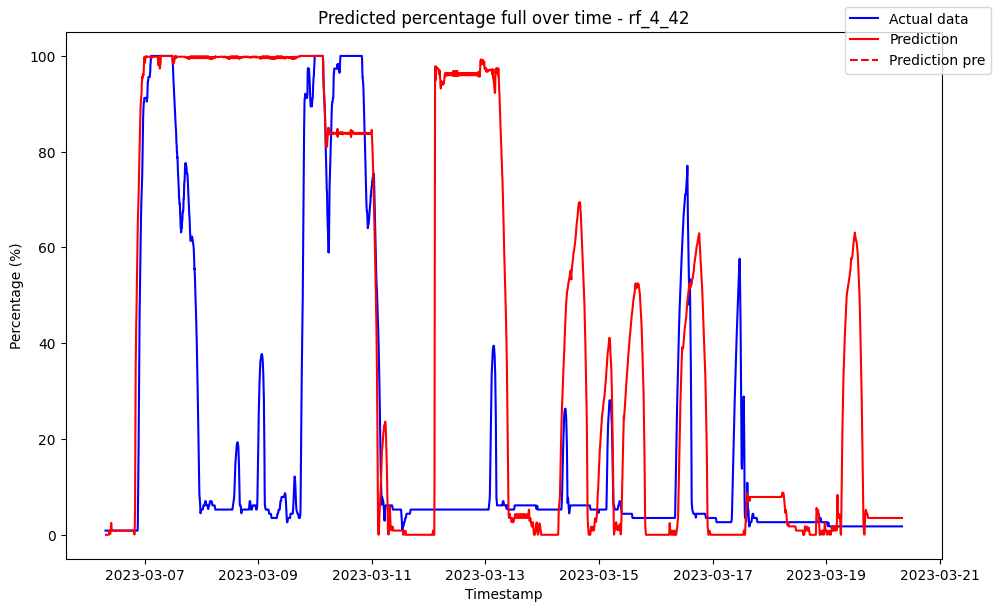

------------------------------------ rf_4_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11660898560752492
Variance (R²) score: 1.00


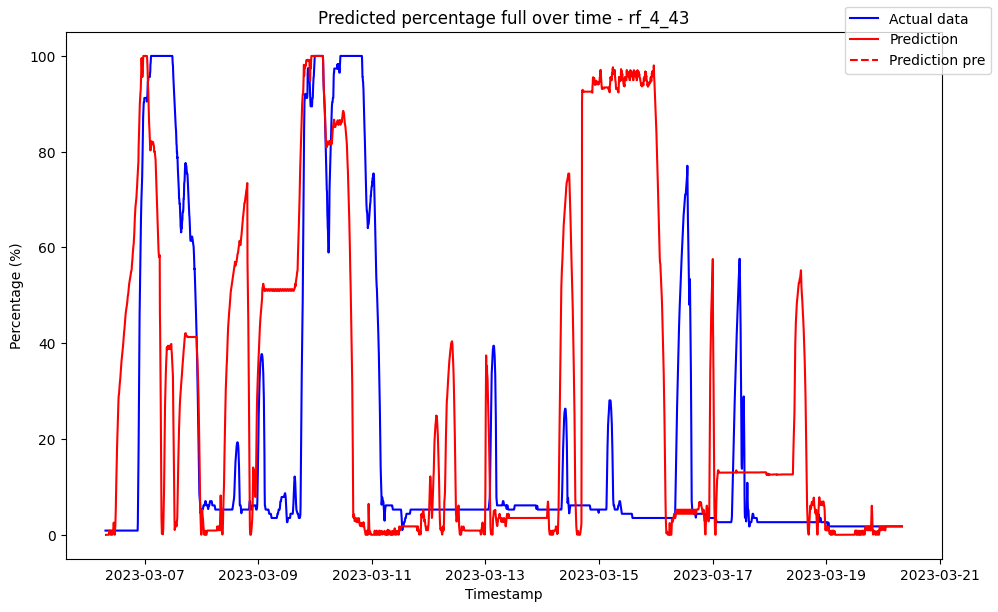

------------------------------------ rf_4_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10247236914344039
Variance (R²) score: 1.00


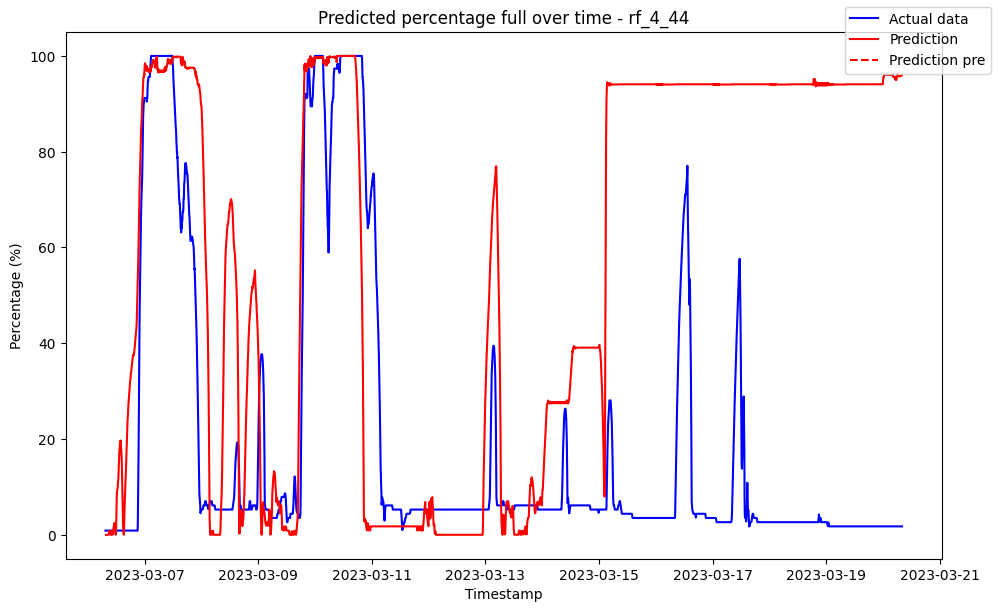

------------------------------------ rf_4_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09887783991235666
Variance (R²) score: 1.00


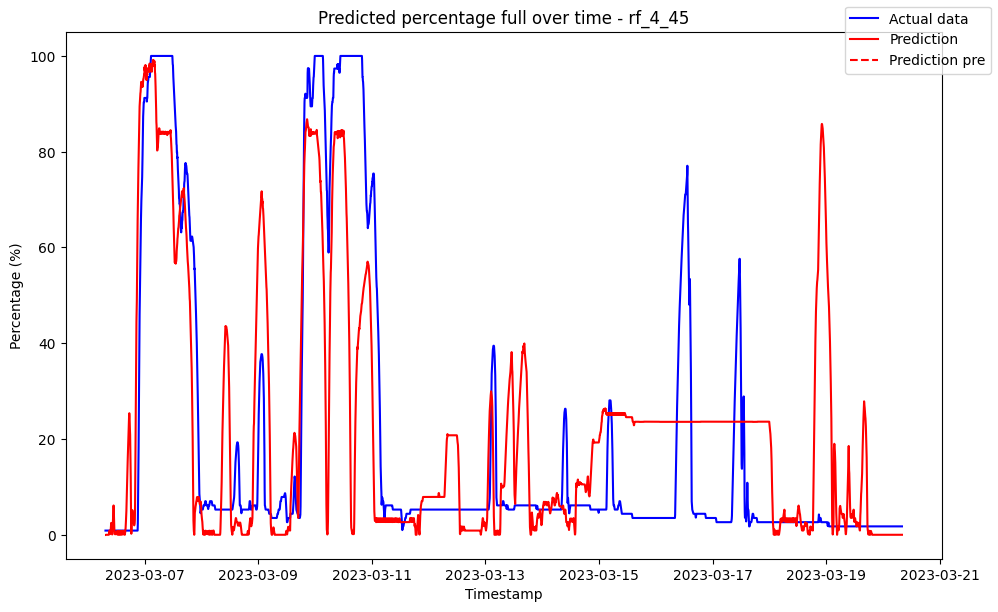

------------------------------------ rf_4_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08144531392751292
Variance (R²) score: 1.00


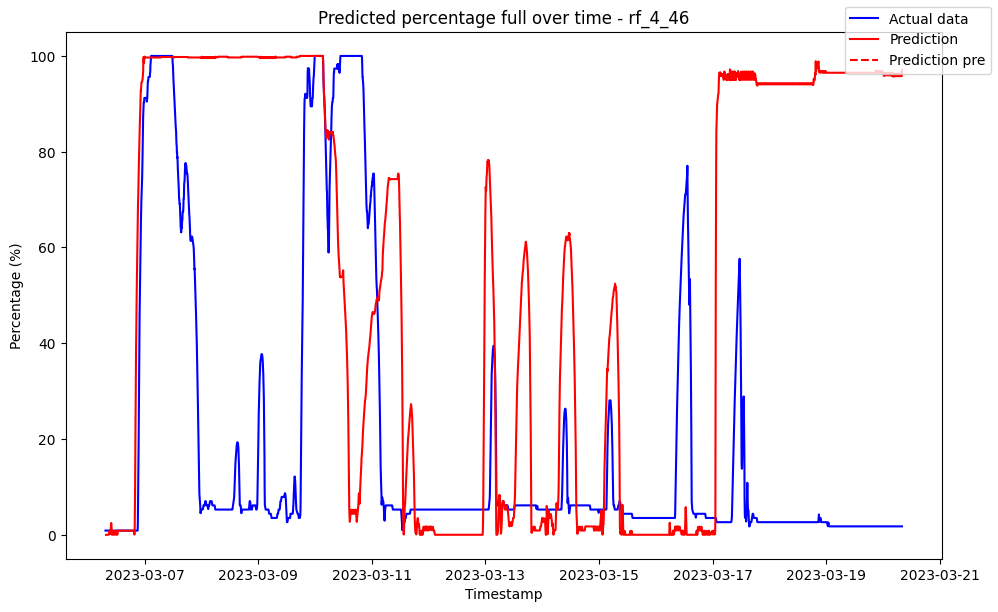

------------------------------------ rf_4_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11615671221972708
Variance (R²) score: 1.00


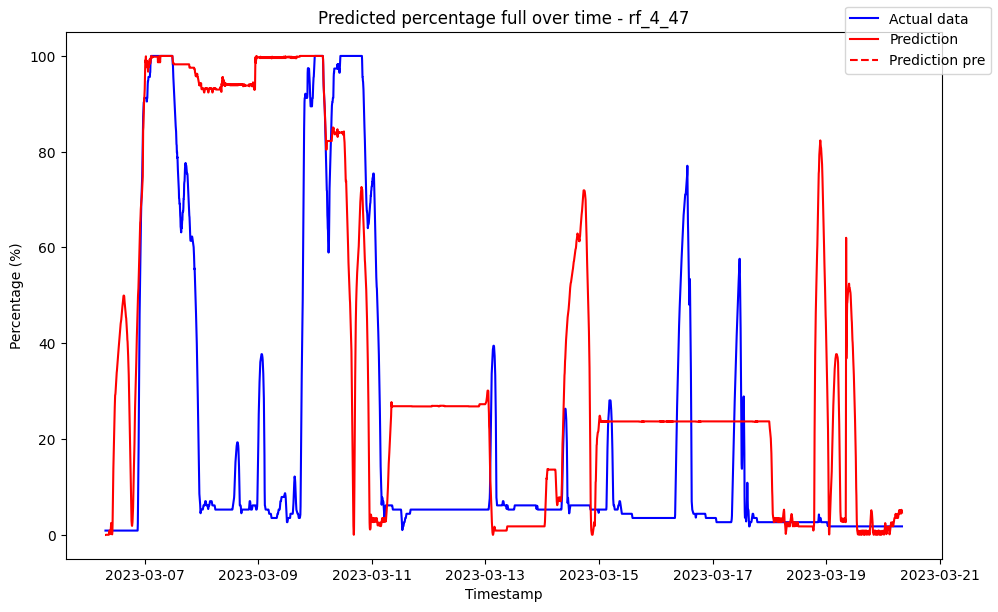

------------------------------------ rf_4_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09551619130911466
Variance (R²) score: 1.00


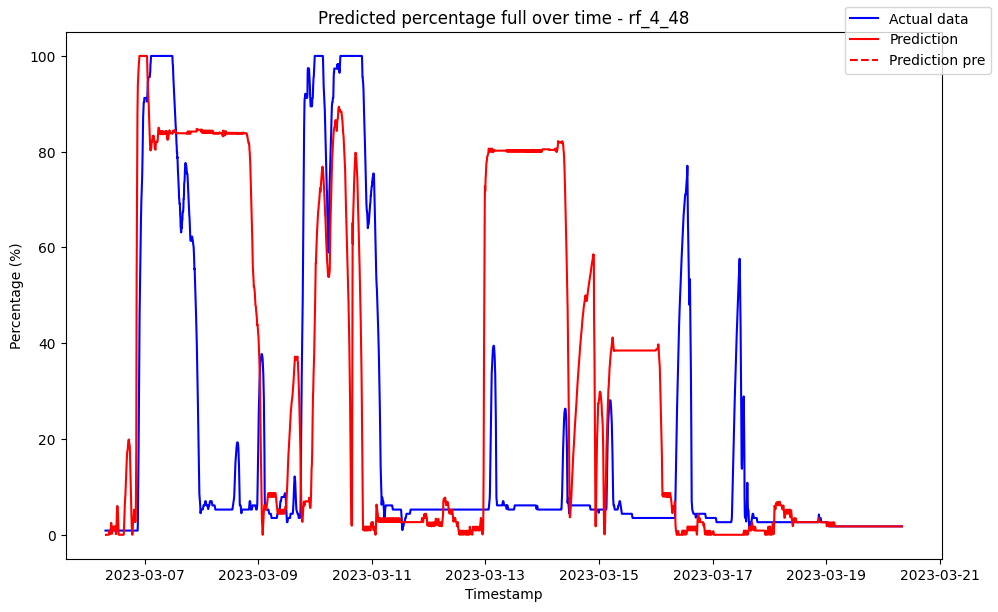

------------------------------------ rf_4_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11497198819727056
Variance (R²) score: 1.00


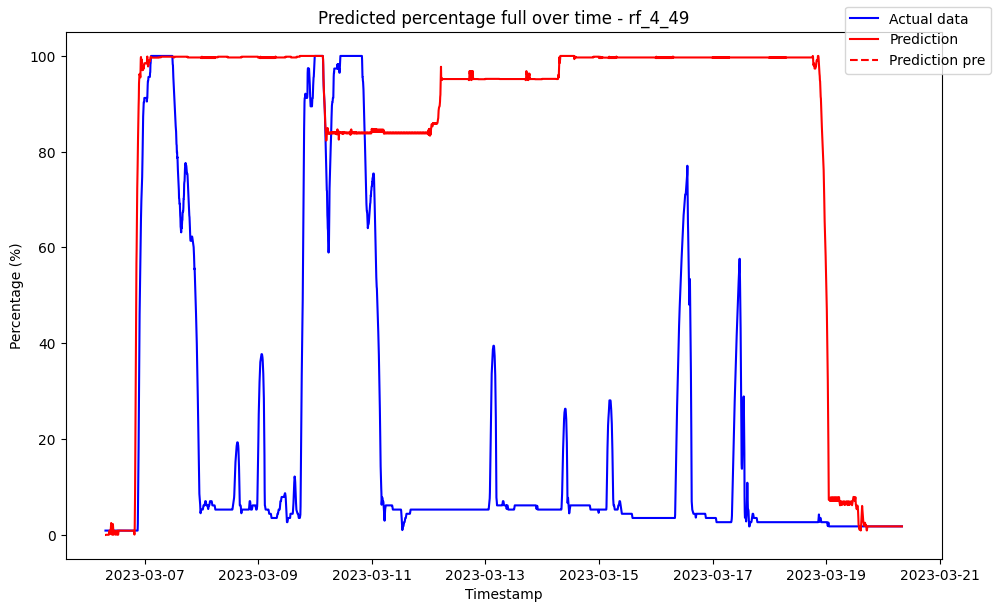

------------------------------------ rf_4_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019085               0.0
1 2023-03-06 07:35:00            0.019085               0.0
2 2023-03-06 07:40:00            0.019085               0.0
3 2023-03-06 07:45:00            0.019085               0.0
4 2023-03-06 07:50:00            0.019085               0.0
5 2023-03-06 07:55:00            0.019085               0.0

Metrics for this specific prediction:
Accuracy: 99.91%
Mean squared error: 0.8897797504941062
Variance (R²) score: 1.00


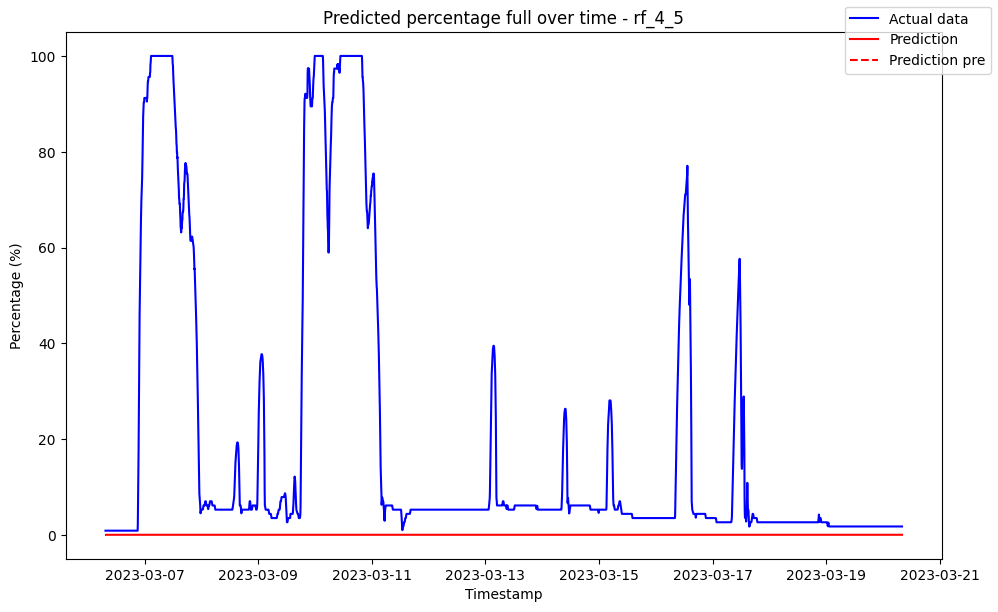

------------------------------------ rf_4_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11357652709511337
Variance (R²) score: 1.00


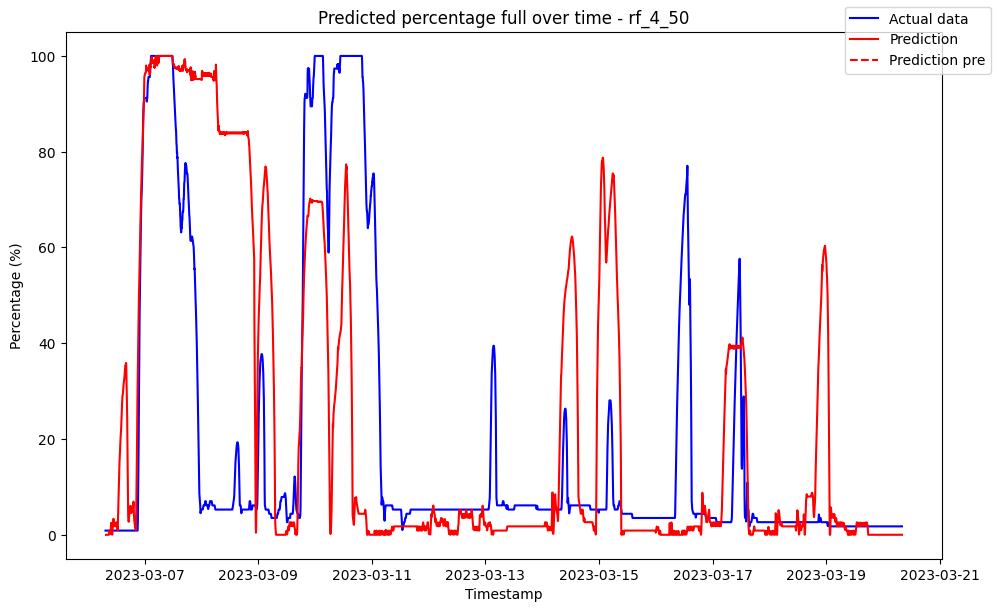

------------------------------------ rf_4_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.011452               0.0
1 2023-03-06 07:35:00            0.096963               0.0
2 2023-03-06 07:40:00            0.315253               0.0
3 2023-03-06 07:45:00            0.315253               0.0
4 2023-03-06 07:50:00            0.315253               0.0
5 2023-03-06 07:55:00            0.315253               0.0

Metrics for this specific prediction:
Accuracy: 99.94%
Mean squared error: 0.649741672806186
Variance (R²) score: 1.00


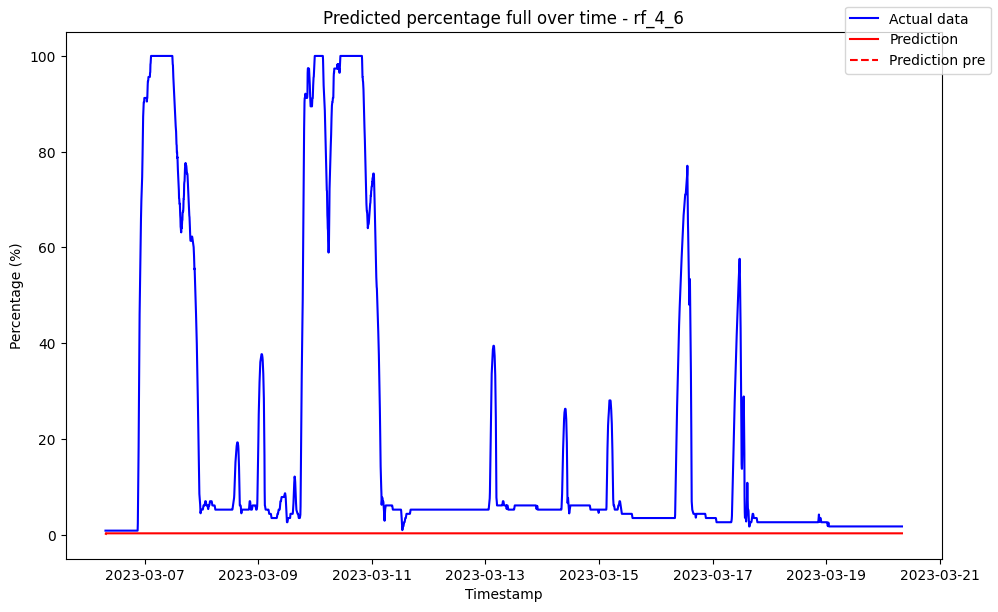

------------------------------------ rf_4_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007723               0.0
1 2023-03-06 07:35:00            0.158849               0.0
2 2023-03-06 07:40:00            0.634254               0.0
3 2023-03-06 07:45:00            0.696702               0.0
4 2023-03-06 07:50:00            0.732352               0.0
5 2023-03-06 07:55:00            0.879208               0.0

Metrics for this specific prediction:
Accuracy: 99.95%
Mean squared error: 0.4965072966251062
Variance (R²) score: 1.00


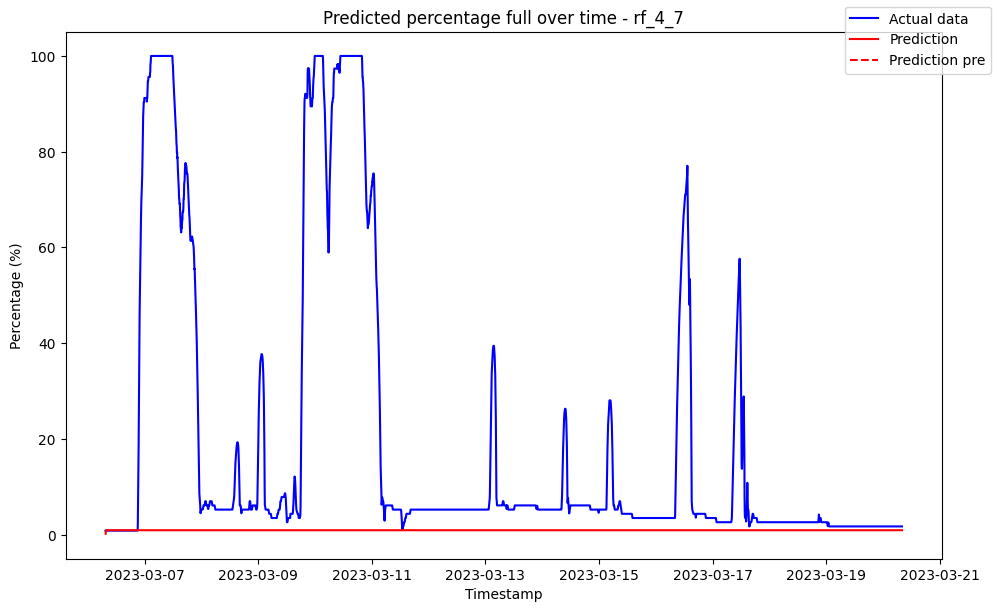

------------------------------------ rf_4_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006738               0.0
1 2023-03-06 07:35:00            0.151697               0.0
2 2023-03-06 07:40:00            0.604375               0.0
3 2023-03-06 07:45:00            0.743815               0.0
4 2023-03-06 07:50:00            0.798759               0.0
5 2023-03-06 07:55:00            0.873959               0.0

Metrics for this specific prediction:
Accuracy: 99.96%
Mean squared error: 0.3833526288909785
Variance (R²) score: 1.00


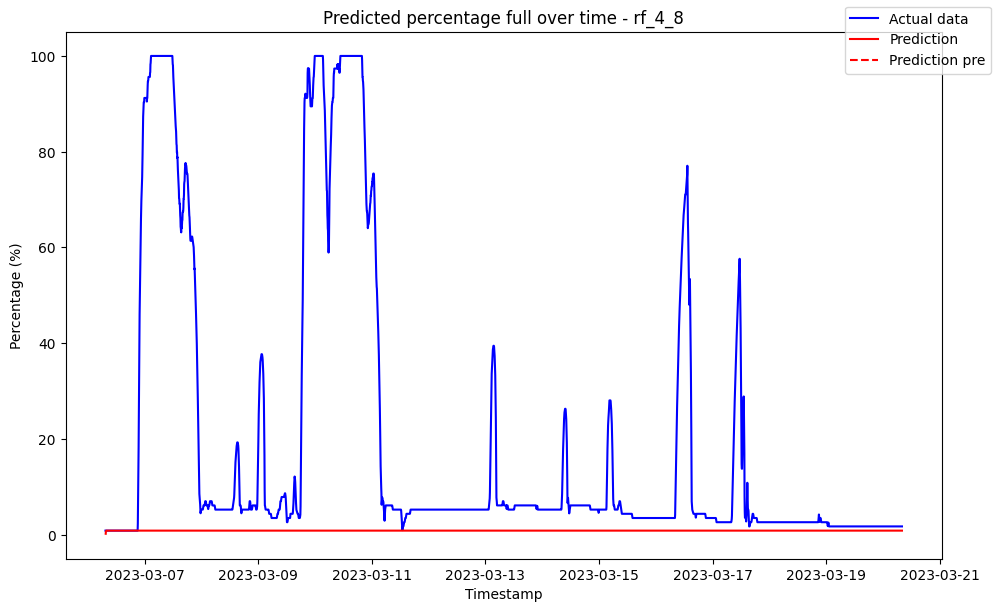

------------------------------------ rf_4_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.024344               0.0
1 2023-03-06 07:35:00            0.358518               0.0
2 2023-03-06 07:40:00            0.721782               0.0
3 2023-03-06 07:45:00            0.864637               0.0
4 2023-03-06 07:50:00            0.873583               0.0
5 2023-03-06 07:55:00            0.873583               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.2851354704112271
Variance (R²) score: 1.00


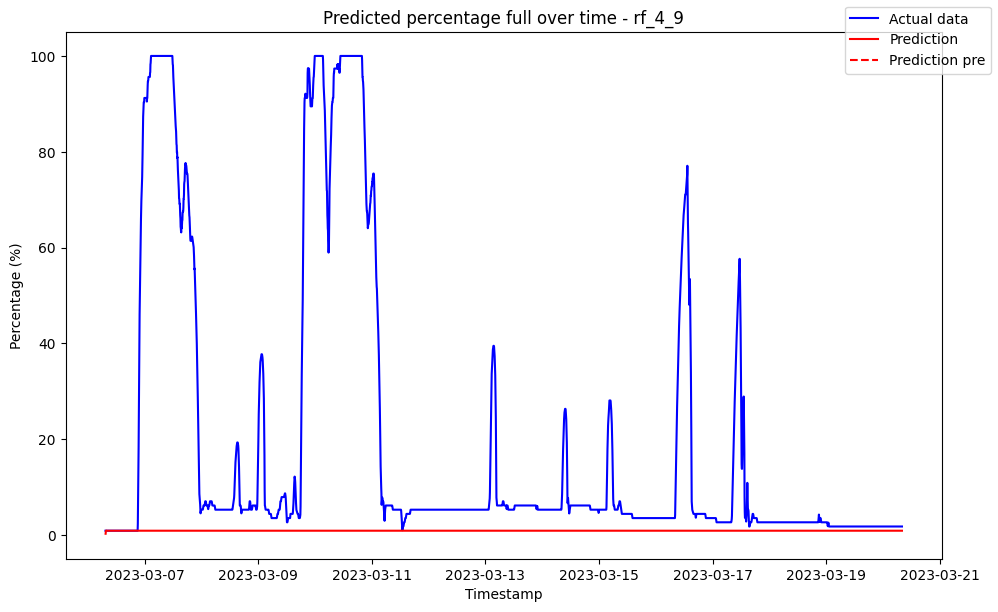

------------------------------------ rf_5_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.533605               0.0
1 2023-03-06 07:35:00            3.533605               0.0
2 2023-03-06 07:40:00            3.533605               0.0
3 2023-03-06 07:45:00            3.533605               0.0
4 2023-03-06 07:50:00            3.533605               0.0
5 2023-03-06 07:55:00            3.533605               0.0

Metrics for this specific prediction:
Accuracy: 89.46%
Mean squared error: 107.68955751445931
Variance (R²) score: 0.89


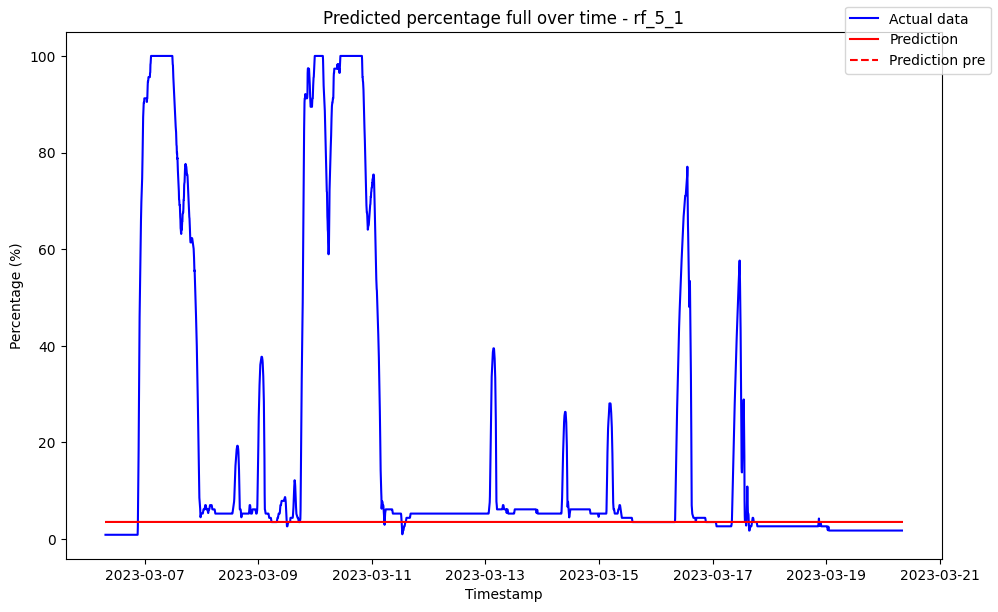

------------------------------------ rf_5_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.028514               0.0
1 2023-03-06 07:35:00            0.389203               0.0
2 2023-03-06 07:40:00            0.717275               0.0
3 2023-03-06 07:45:00            0.778791               0.0
4 2023-03-06 07:50:00            0.617912               0.0
5 2023-03-06 07:55:00            0.348563               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.2105569290810575
Variance (R²) score: 1.00


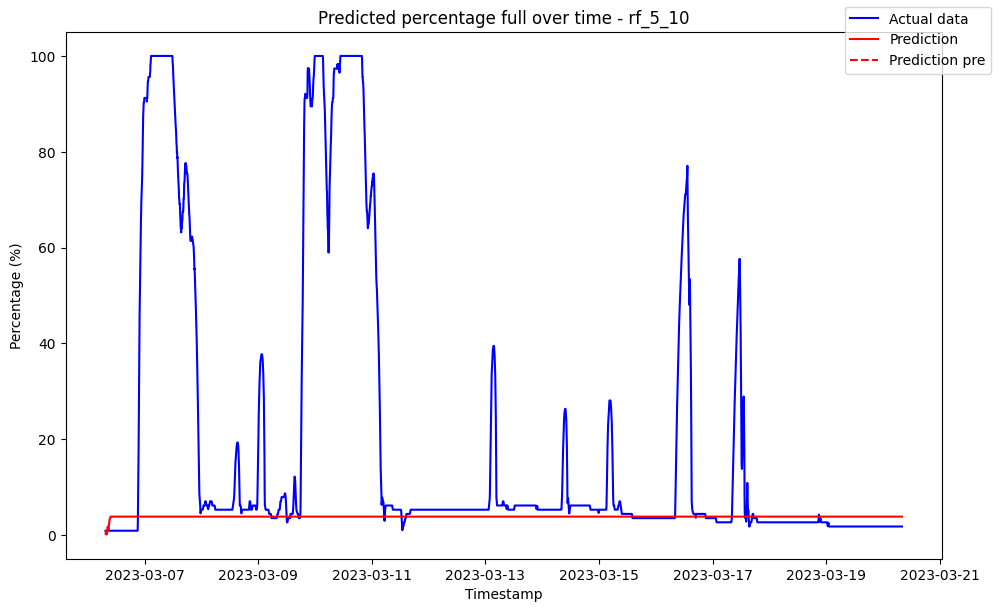

------------------------------------ rf_5_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.018905               0.0
1 2023-03-06 07:35:00            0.380404               0.0
2 2023-03-06 07:40:00            0.651048               0.0
3 2023-03-06 07:45:00            0.839186               0.0
4 2023-03-06 07:50:00            0.700134               0.0
5 2023-03-06 07:55:00            0.401749               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14963670024186507
Variance (R²) score: 1.00


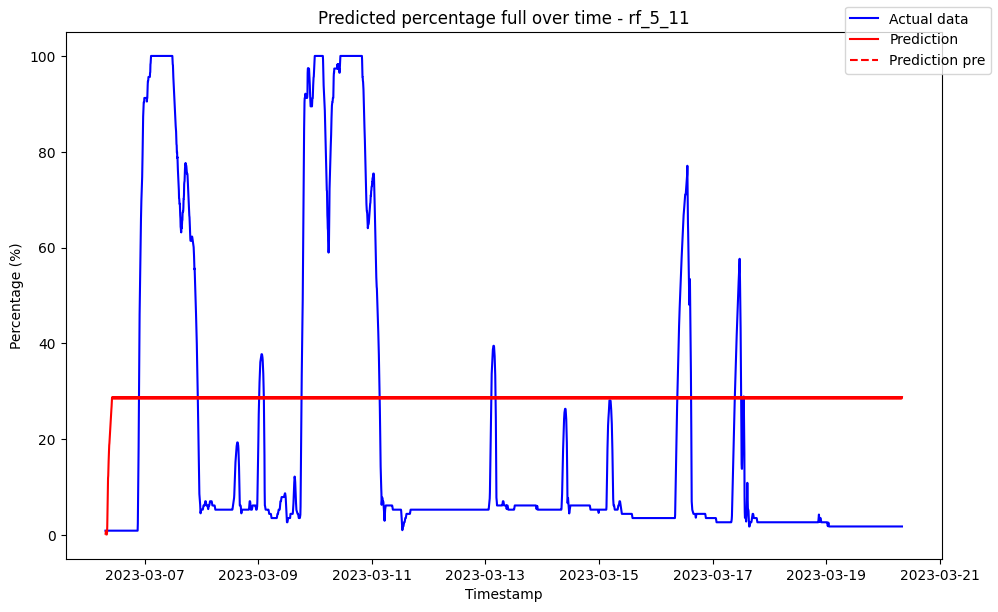

------------------------------------ rf_5_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.012345               0.0
1 2023-03-06 07:35:00            0.161757               0.0
2 2023-03-06 07:40:00            0.518931               0.0
3 2023-03-06 07:45:00            0.818683               0.0
4 2023-03-06 07:50:00            0.834574               0.0
5 2023-03-06 07:55:00            0.545331               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12502887441633817
Variance (R²) score: 1.00


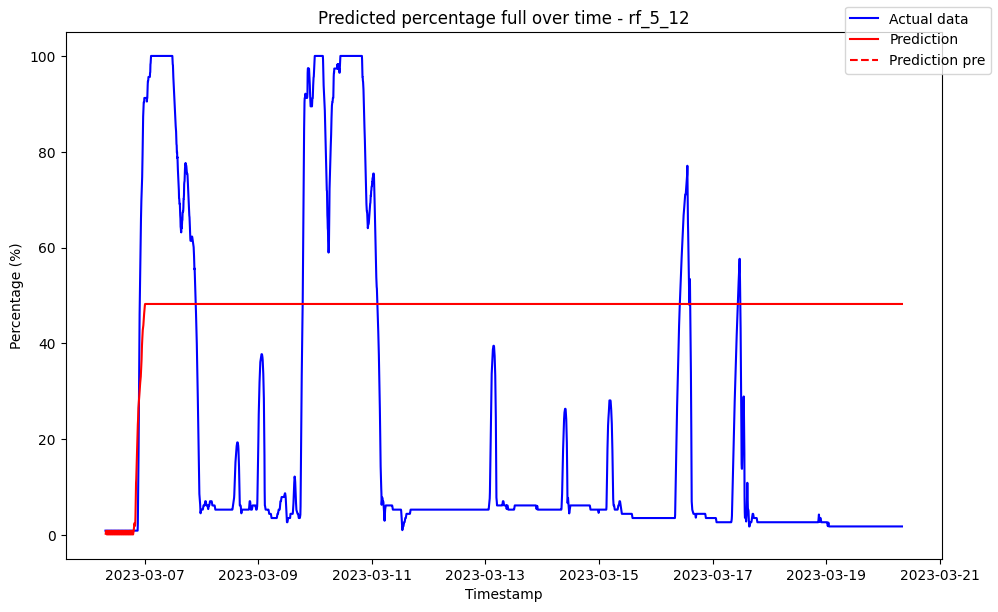

------------------------------------ rf_5_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013305               0.0
1 2023-03-06 07:35:00            0.138754               0.0
2 2023-03-06 07:40:00            0.500795               0.0
3 2023-03-06 07:45:00            0.782929               0.0
4 2023-03-06 07:50:00            0.836533               0.0
5 2023-03-06 07:55:00            0.547015               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12123441491429333
Variance (R²) score: 1.00


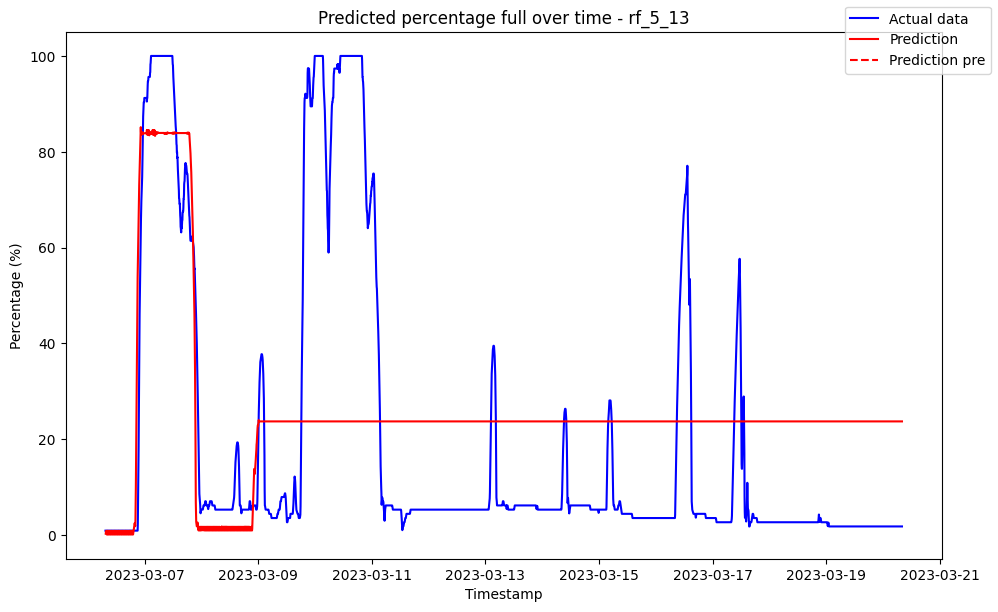

------------------------------------ rf_5_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013450               0.0
1 2023-03-06 07:35:00            0.140150               0.0
2 2023-03-06 07:40:00            0.526315               0.0
3 2023-03-06 07:45:00            0.907872               0.0
4 2023-03-06 07:50:00            1.986508               0.0
5 2023-03-06 07:55:00            3.281069               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09854797134653492
Variance (R²) score: 1.00


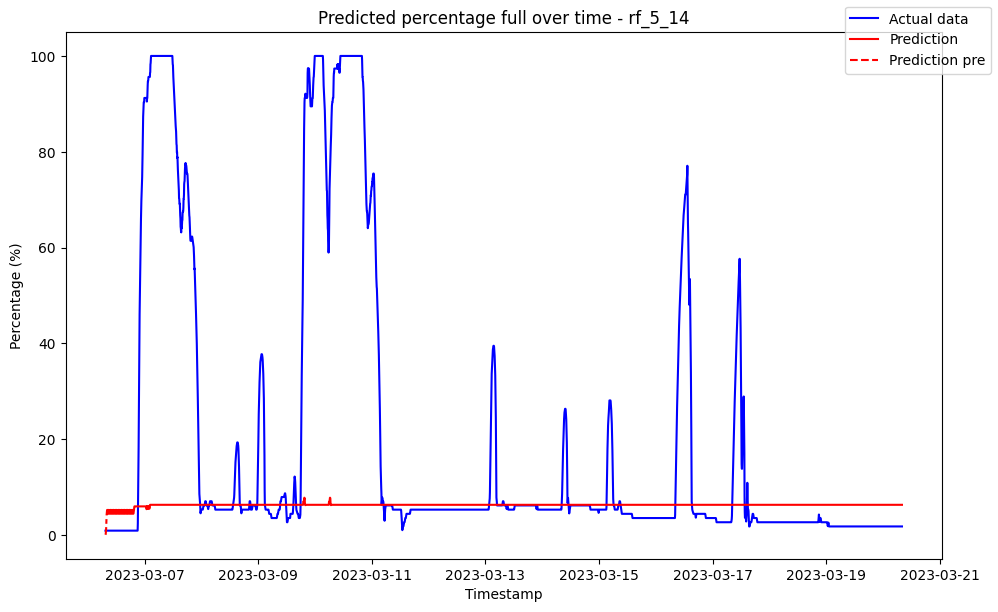

------------------------------------ rf_5_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009938               0.0
1 2023-03-06 07:35:00            0.133671               0.0
2 2023-03-06 07:40:00            0.525336               0.0
3 2023-03-06 07:45:00            1.992482               0.0
4 2023-03-06 07:50:00            4.193171               0.0
5 2023-03-06 07:55:00            6.280524               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09365481198104199
Variance (R²) score: 1.00


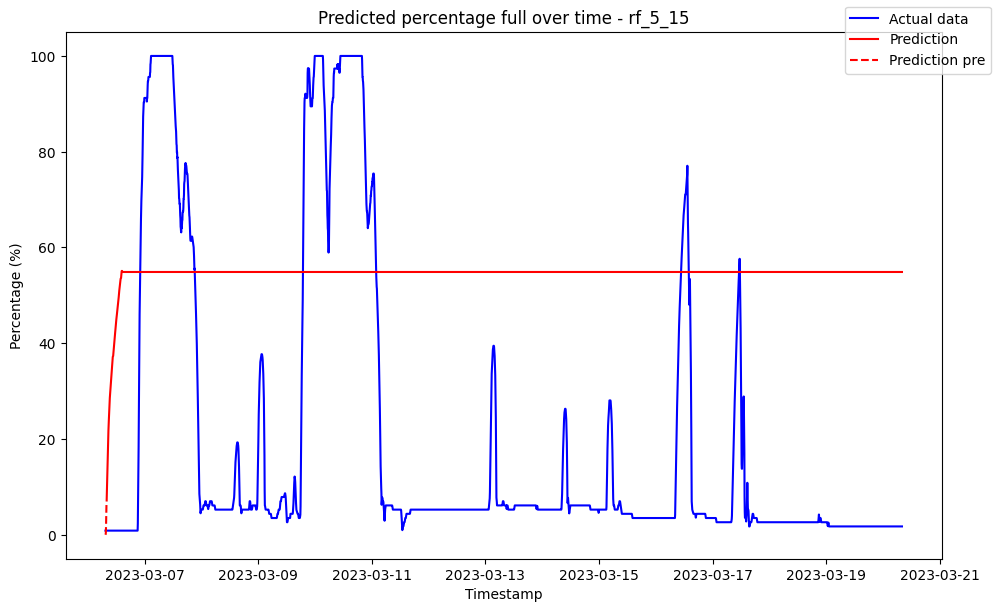

------------------------------------ rf_5_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.008215               0.0
1 2023-03-06 07:35:00            0.136687               0.0
2 2023-03-06 07:40:00            0.472309               0.0
3 2023-03-06 07:45:00            0.867099               0.0
4 2023-03-06 07:50:00            0.716124               0.0
5 2023-03-06 07:55:00            0.430401               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1039610123881728
Variance (R²) score: 1.00


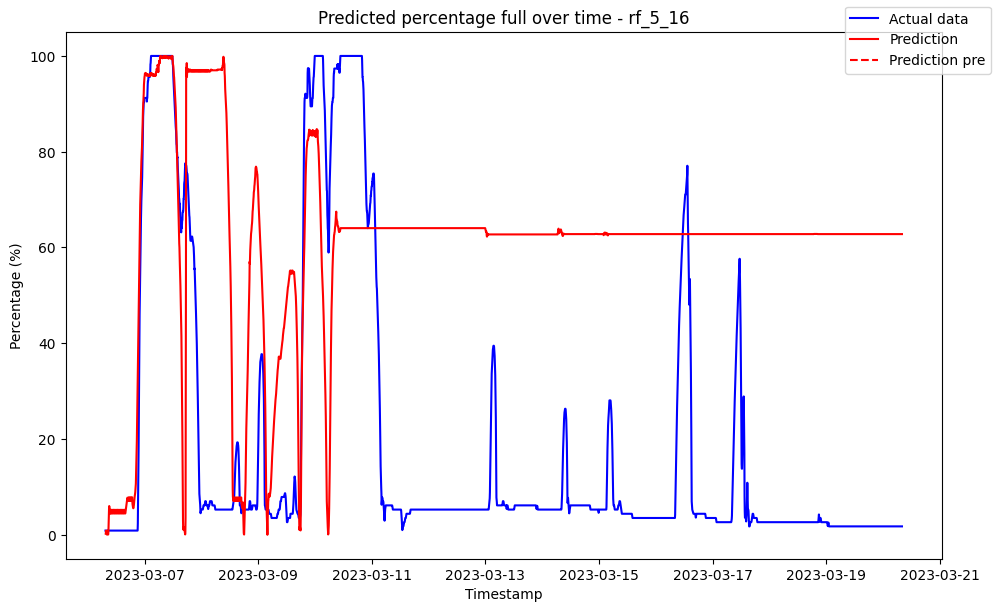

------------------------------------ rf_5_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004967               0.0
1 2023-03-06 07:35:00            0.124395               0.0
2 2023-03-06 07:40:00            0.515415               0.0
3 2023-03-06 07:45:00            0.889339               0.0
4 2023-03-06 07:50:00            1.824178               0.0
5 2023-03-06 07:55:00            2.987133               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09174863240775416
Variance (R²) score: 1.00


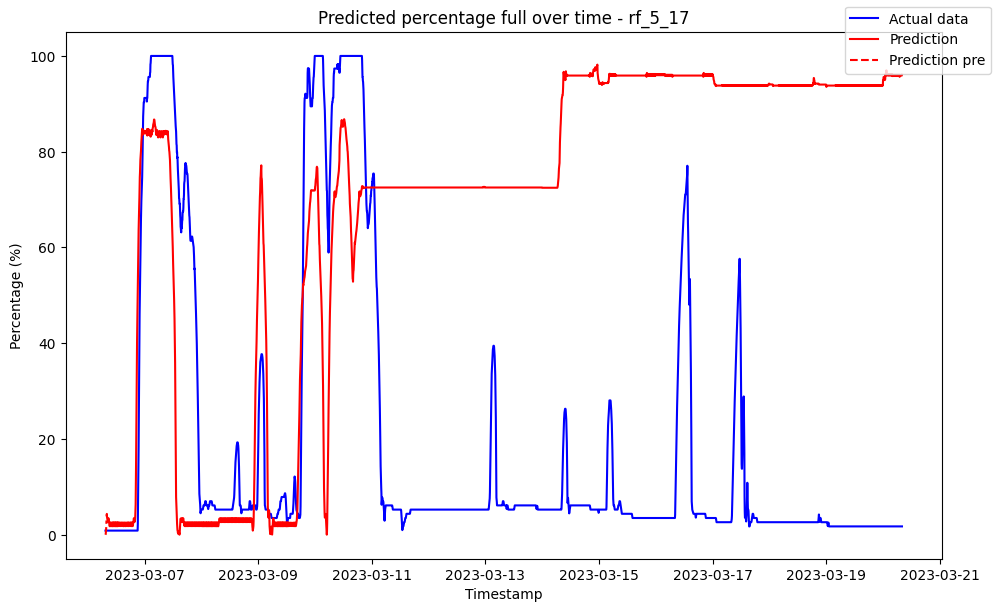

------------------------------------ rf_5_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.008060               0.0
1 2023-03-06 07:35:00            0.120355               0.0
2 2023-03-06 07:40:00            0.979900               0.0
3 2023-03-06 07:45:00            2.128600               0.0
4 2023-03-06 07:50:00            3.553400               0.0
5 2023-03-06 07:55:00            4.264000               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09262598251314548
Variance (R²) score: 1.00


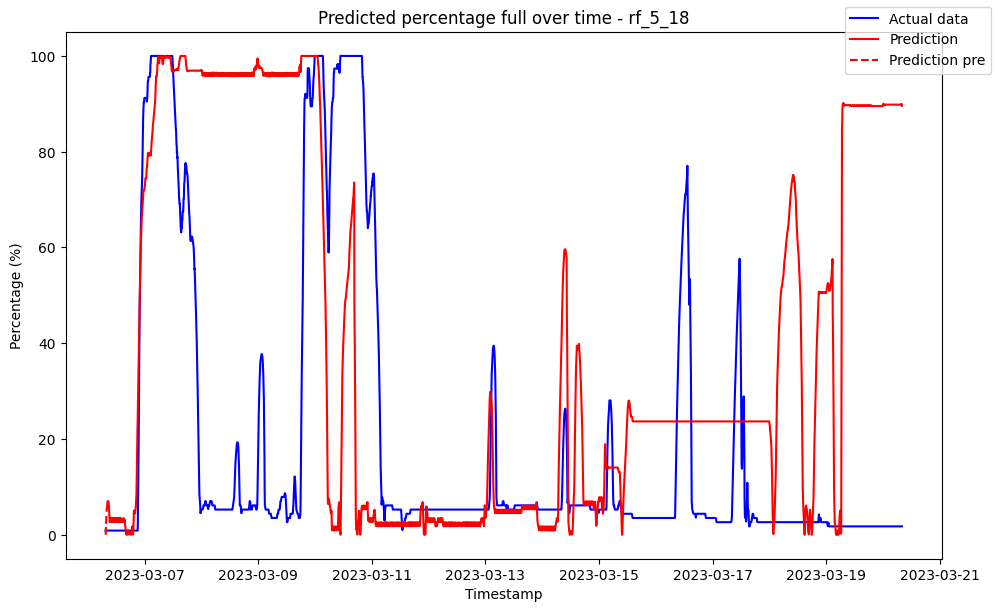

------------------------------------ rf_5_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006001               0.0
1 2023-03-06 07:35:00            0.107517               0.0
2 2023-03-06 07:40:00            0.375117               0.0
3 2023-03-06 07:45:00            0.674661               0.0
4 2023-03-06 07:50:00            0.854169               0.0
5 2023-03-06 07:55:00            0.439330               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08047146964421101
Variance (R²) score: 1.00


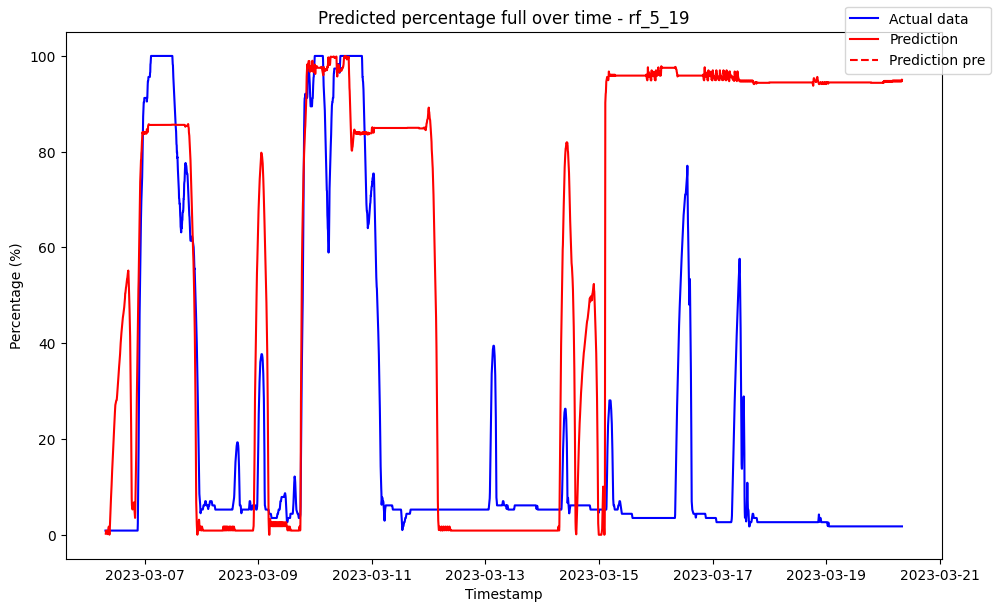

------------------------------------ rf_5_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            1.166455               0.0
1 2023-03-06 07:35:00            1.166455               0.0
2 2023-03-06 07:40:00            1.166455               0.0
3 2023-03-06 07:45:00            1.166455               0.0
4 2023-03-06 07:50:00            1.166455               0.0
5 2023-03-06 07:55:00            1.166455               0.0

Metrics for this specific prediction:
Accuracy: 96.55%
Mean squared error: 35.2170645719162
Variance (R²) score: 0.97


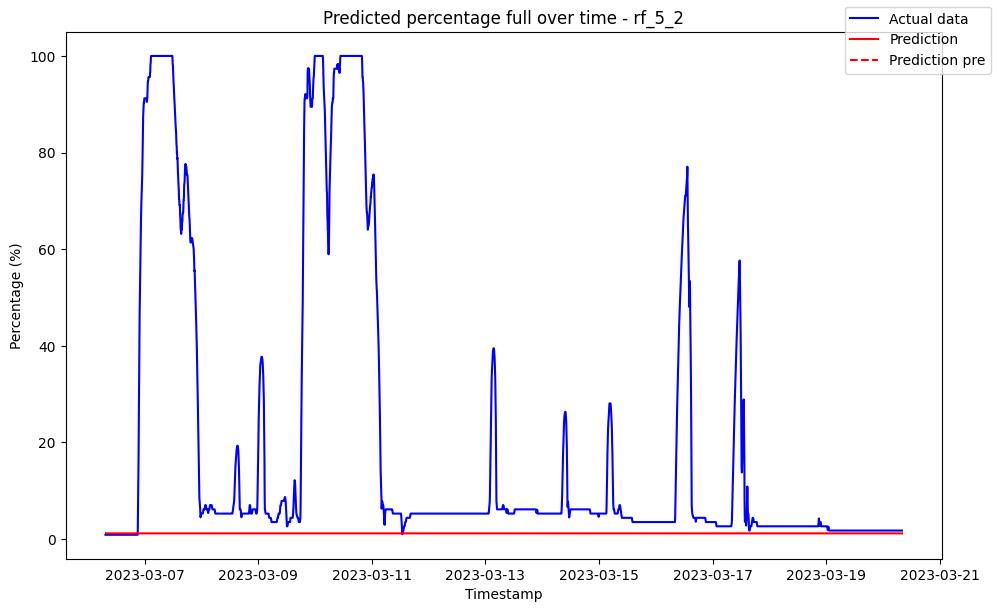

------------------------------------ rf_5_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.003484               0.0
1 2023-03-06 07:35:00            0.063480               0.0
2 2023-03-06 07:40:00            0.412000               0.0
3 2023-03-06 07:45:00            0.694050               0.0
4 2023-03-06 07:50:00            0.842644               0.0
5 2023-03-06 07:55:00            0.462789               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07686940170526181
Variance (R²) score: 1.00


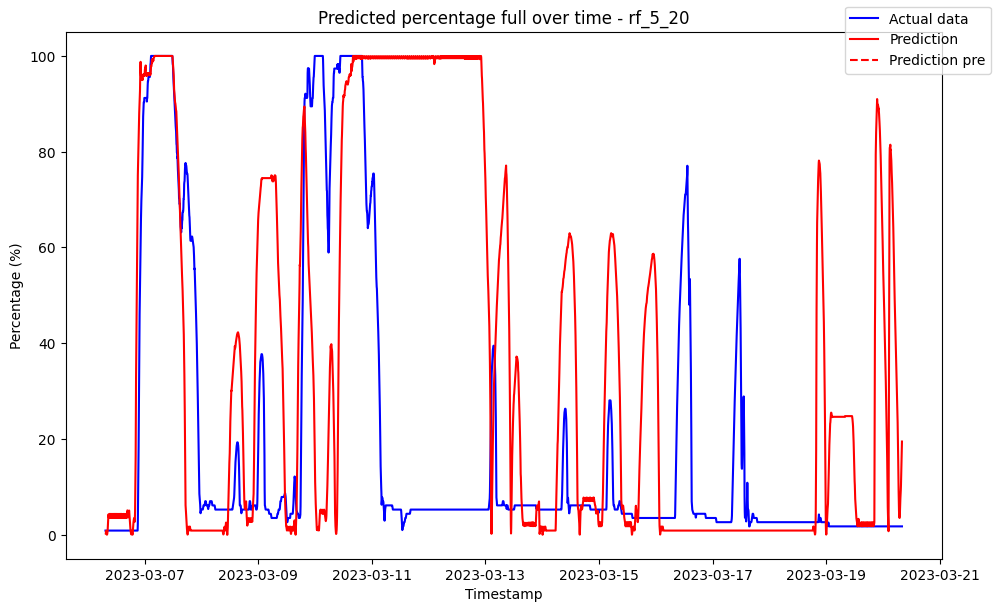

------------------------------------ rf_5_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004591               0.0
1 2023-03-06 07:35:00            0.094131               0.0
2 2023-03-06 07:40:00            0.696640               0.0
3 2023-03-06 07:45:00            1.348600               0.0
4 2023-03-06 07:50:00            2.762400               0.0
5 2023-03-06 07:55:00            4.485800               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09565941271644443
Variance (R²) score: 1.00


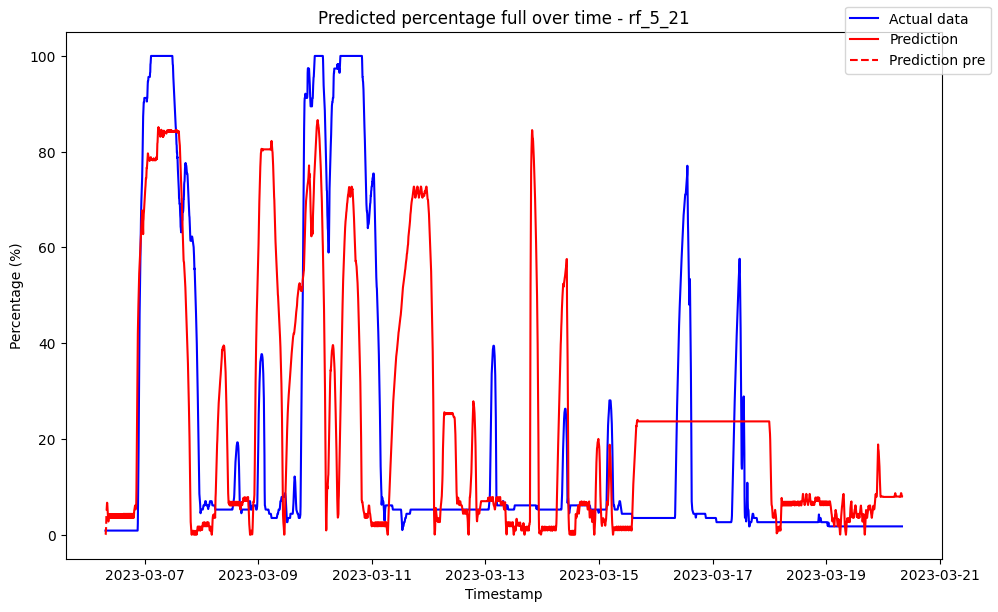

------------------------------------ rf_5_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.008302               0.0
1 2023-03-06 07:35:00            0.128385               0.0
2 2023-03-06 07:40:00            0.495725               0.0
3 2023-03-06 07:45:00            0.907000               0.0
4 2023-03-06 07:50:00            2.254788               0.0
5 2023-03-06 07:55:00            4.012200               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0759750380575204
Variance (R²) score: 1.00


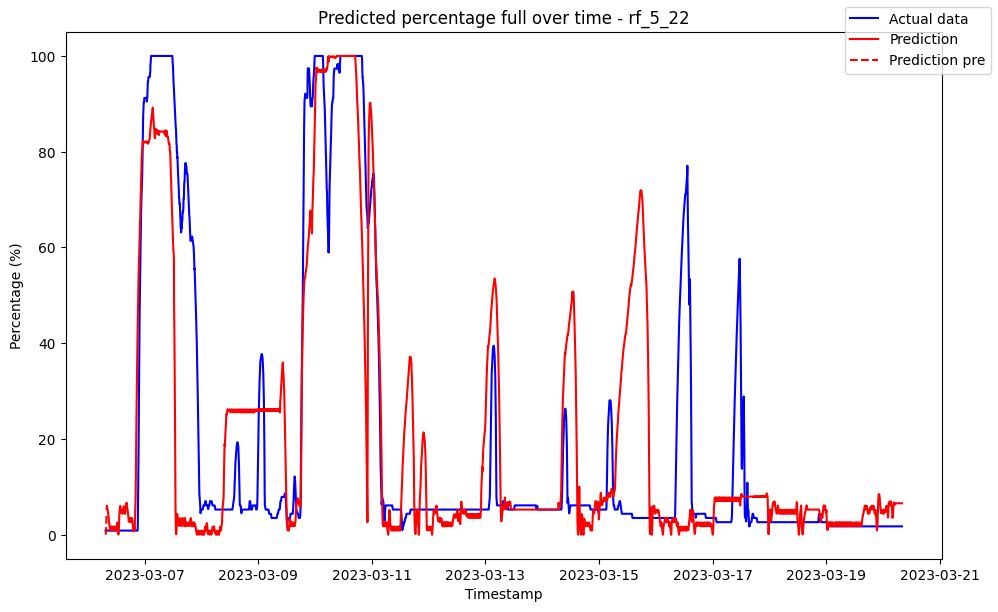

------------------------------------ rf_5_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09534502799153899
Variance (R²) score: 1.00


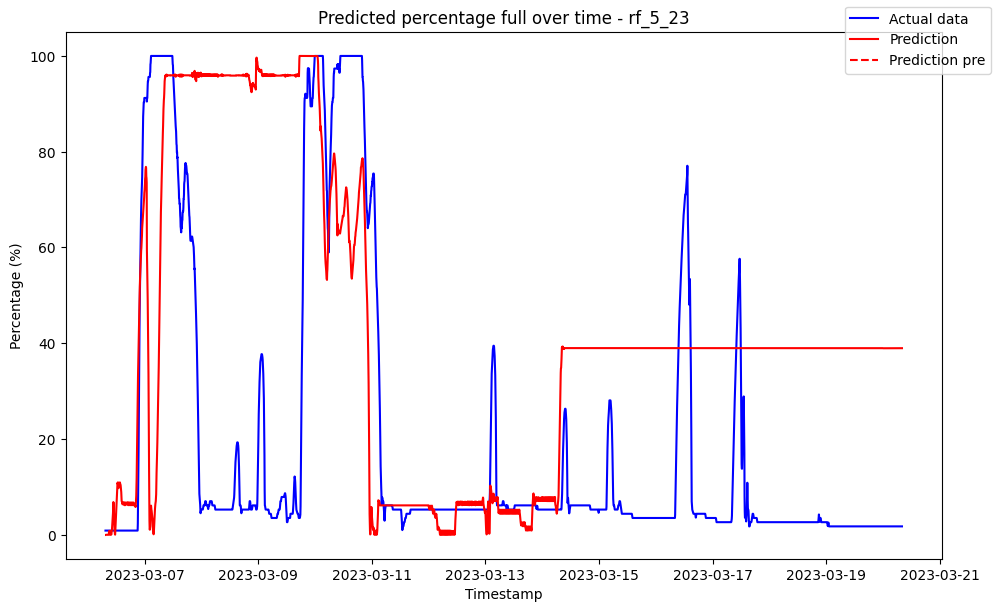

------------------------------------ rf_5_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08457919133771631
Variance (R²) score: 1.00


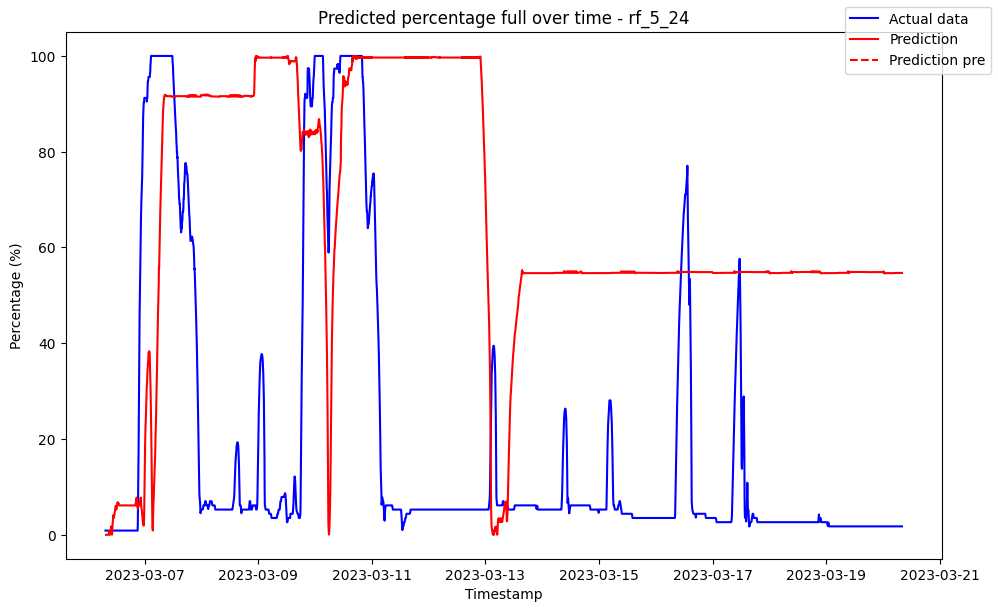

------------------------------------ rf_5_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07640997163511765
Variance (R²) score: 1.00


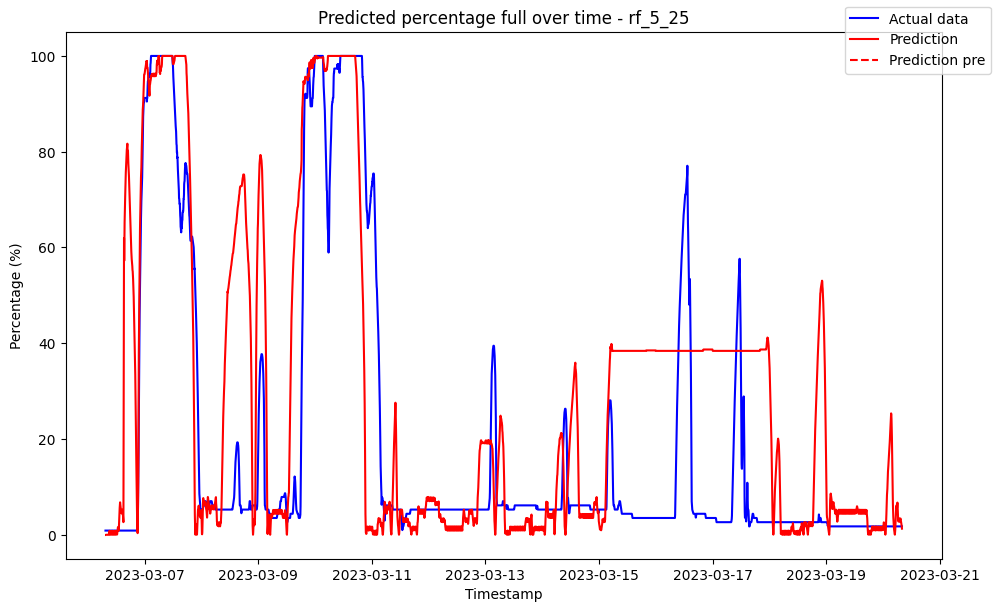

------------------------------------ rf_5_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09578797902207108
Variance (R²) score: 1.00


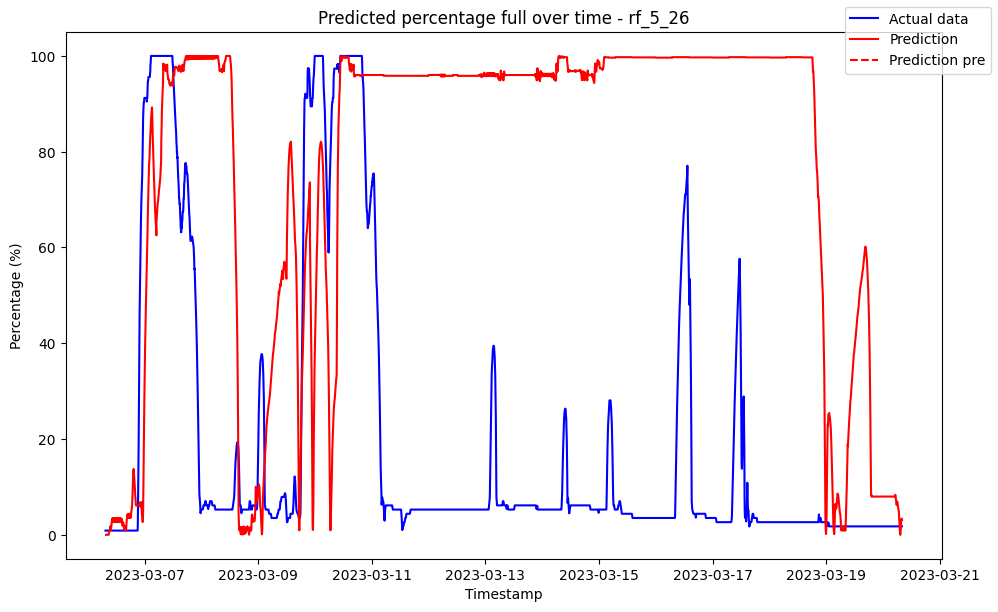

------------------------------------ rf_5_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07882785345761635
Variance (R²) score: 1.00


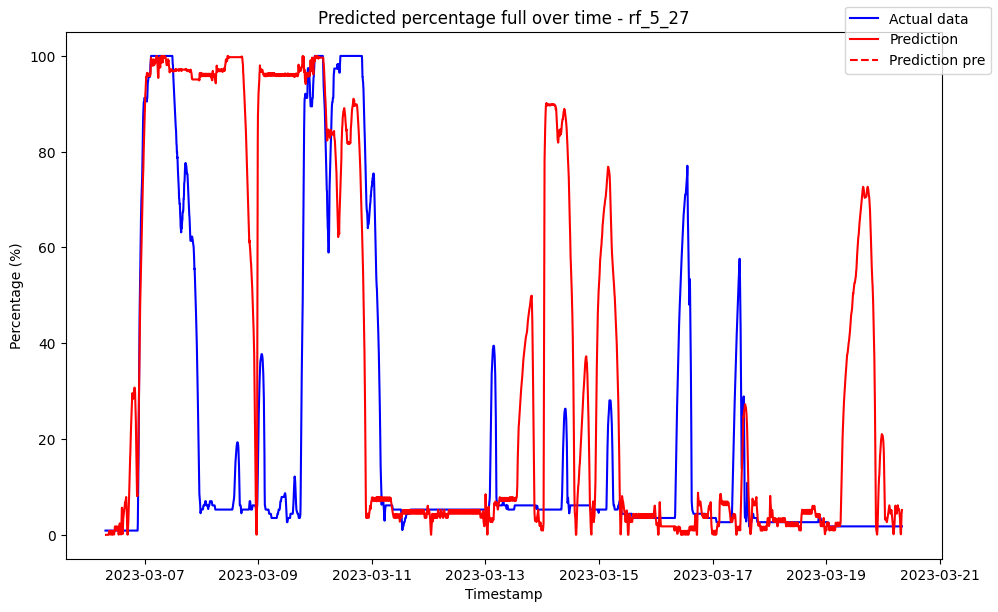

------------------------------------ rf_5_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09245213505598429
Variance (R²) score: 1.00


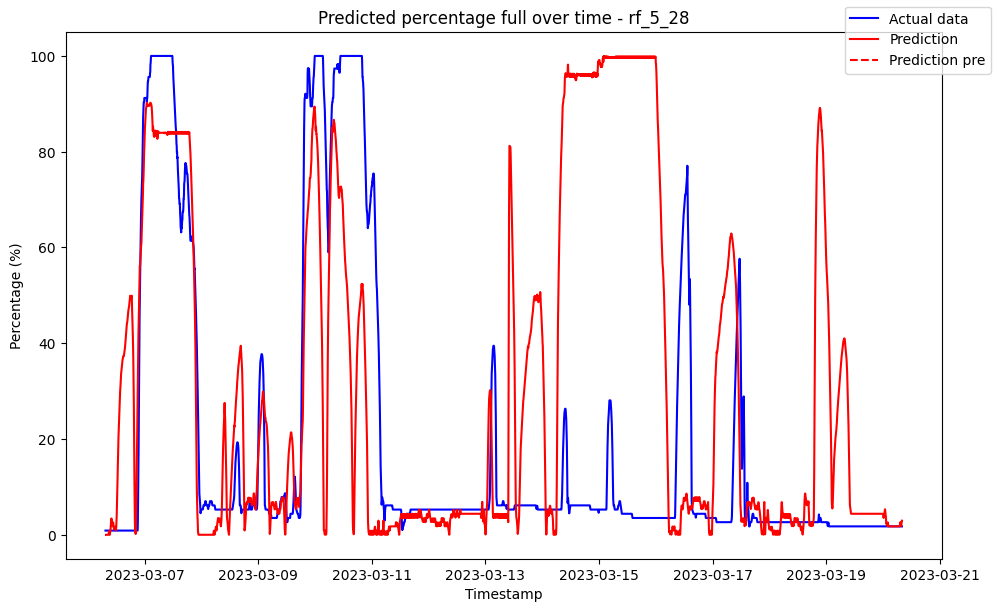

------------------------------------ rf_5_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09512081880595614
Variance (R²) score: 1.00


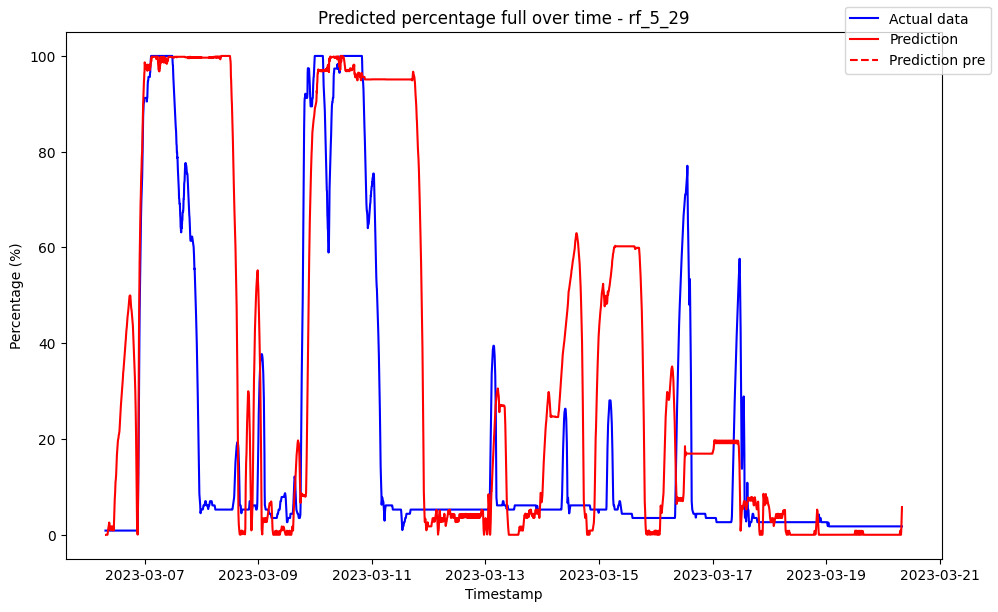

------------------------------------ rf_5_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.361725               0.0
1 2023-03-06 07:35:00            0.361725               0.0
2 2023-03-06 07:40:00            0.361725               0.0
3 2023-03-06 07:45:00            0.361725               0.0
4 2023-03-06 07:50:00            0.361725               0.0
5 2023-03-06 07:55:00            0.361725               0.0

Metrics for this specific prediction:
Accuracy: 99.39%
Mean squared error: 6.255839683817714
Variance (R²) score: 0.99


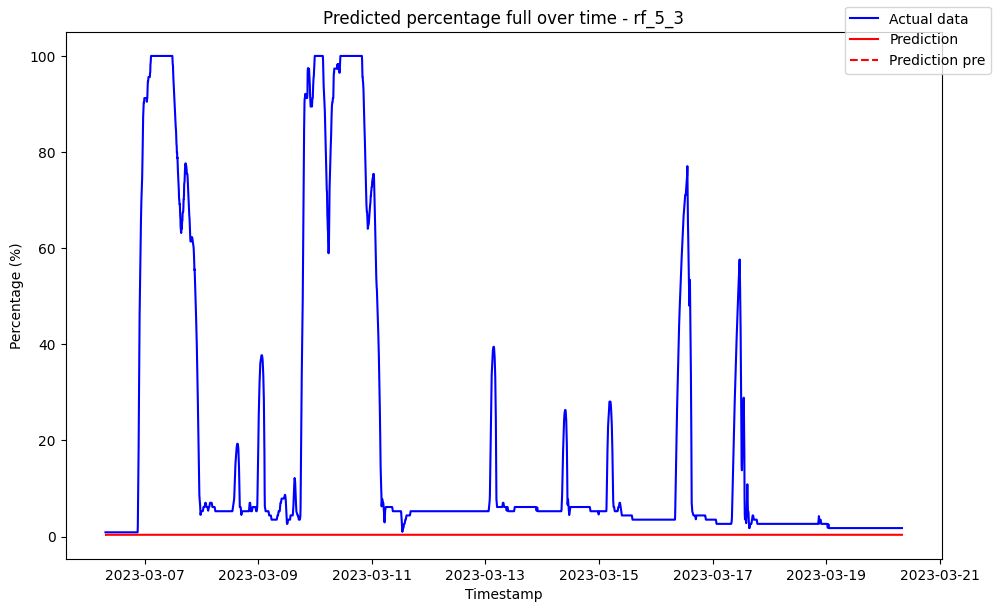

------------------------------------ rf_5_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09660844677000743
Variance (R²) score: 1.00


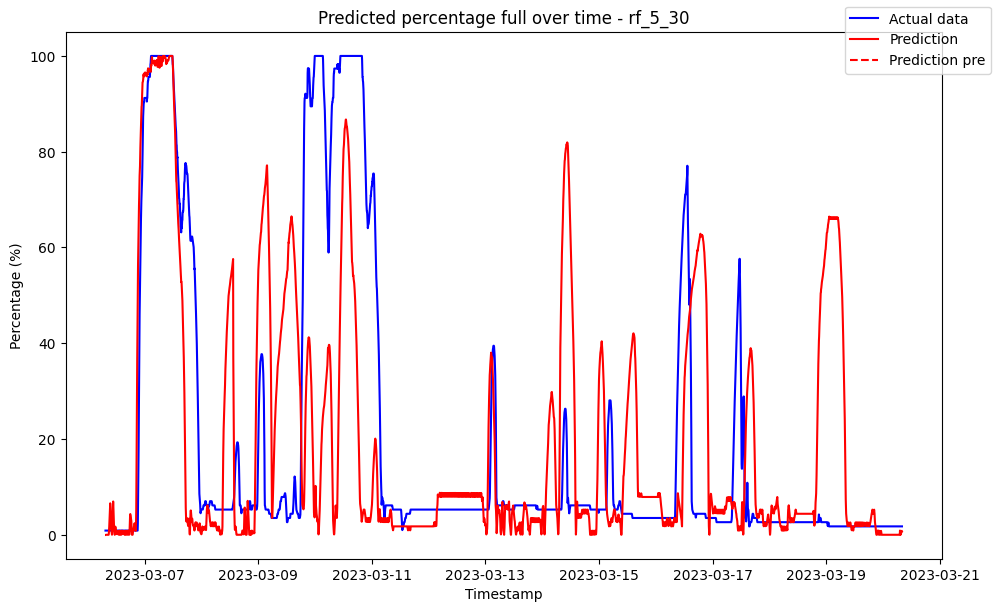

------------------------------------ rf_5_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0880209961031219
Variance (R²) score: 1.00


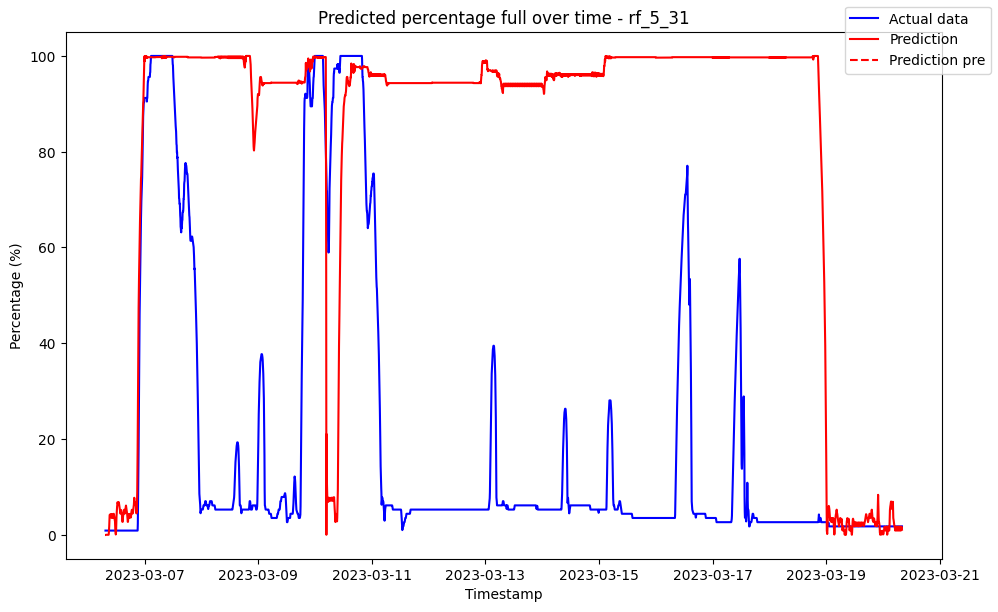

------------------------------------ rf_5_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0825656126105271
Variance (R²) score: 1.00


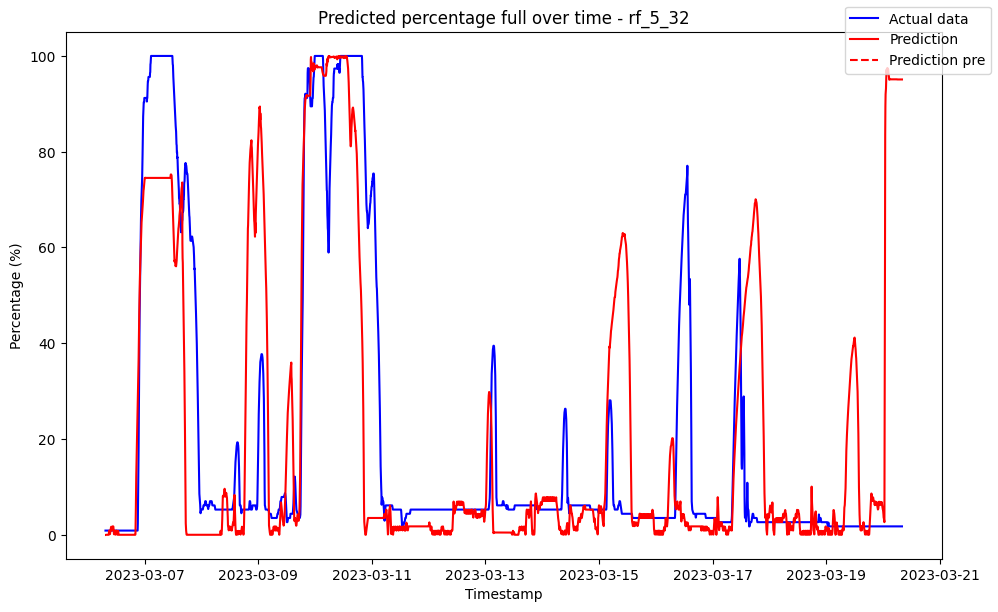

------------------------------------ rf_5_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10187149802306895
Variance (R²) score: 1.00


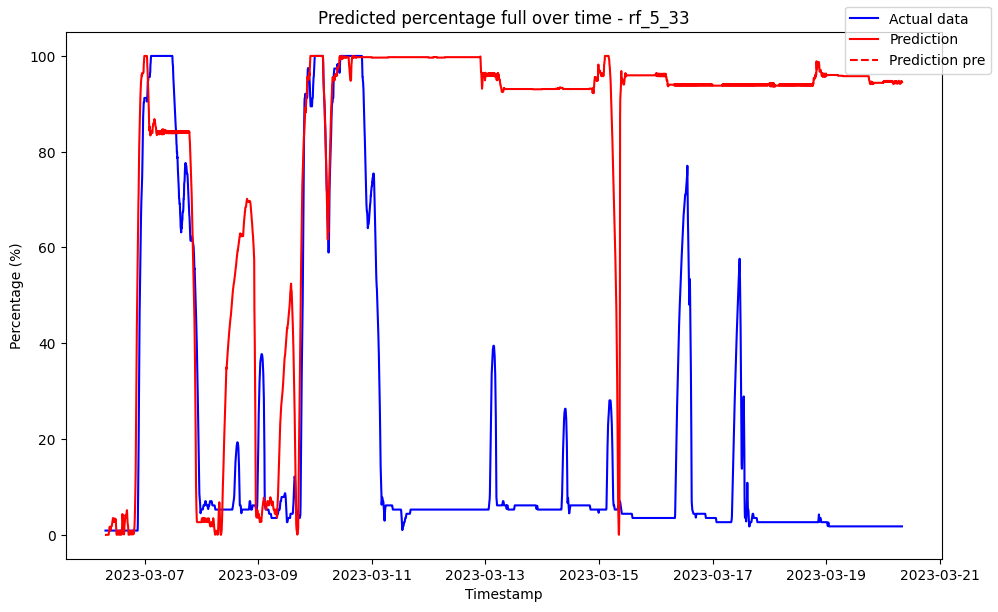

------------------------------------ rf_5_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08738442997316381
Variance (R²) score: 1.00


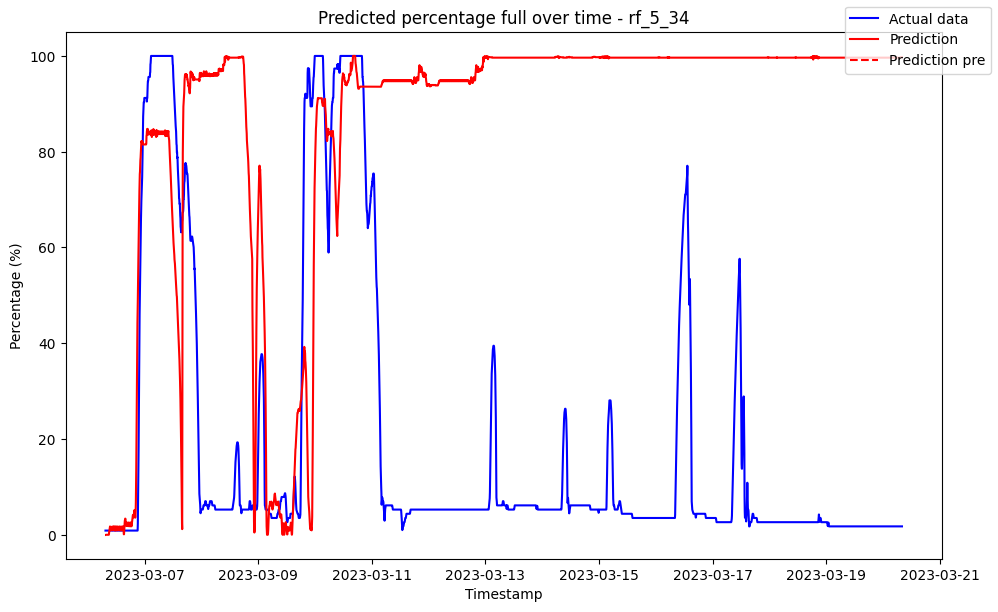

------------------------------------ rf_5_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0969719112490388
Variance (R²) score: 1.00


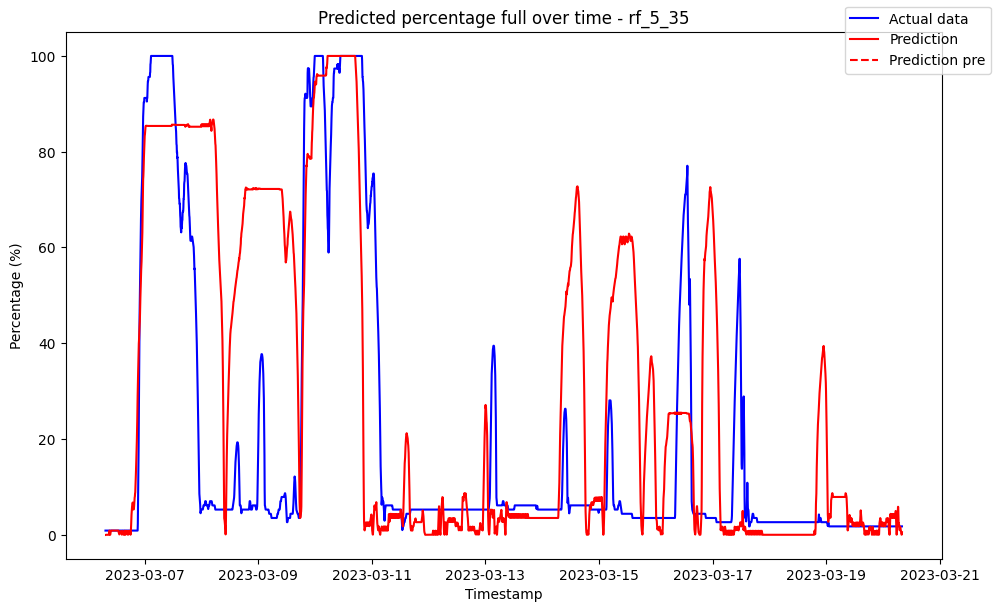

------------------------------------ rf_5_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09822777213880848
Variance (R²) score: 1.00


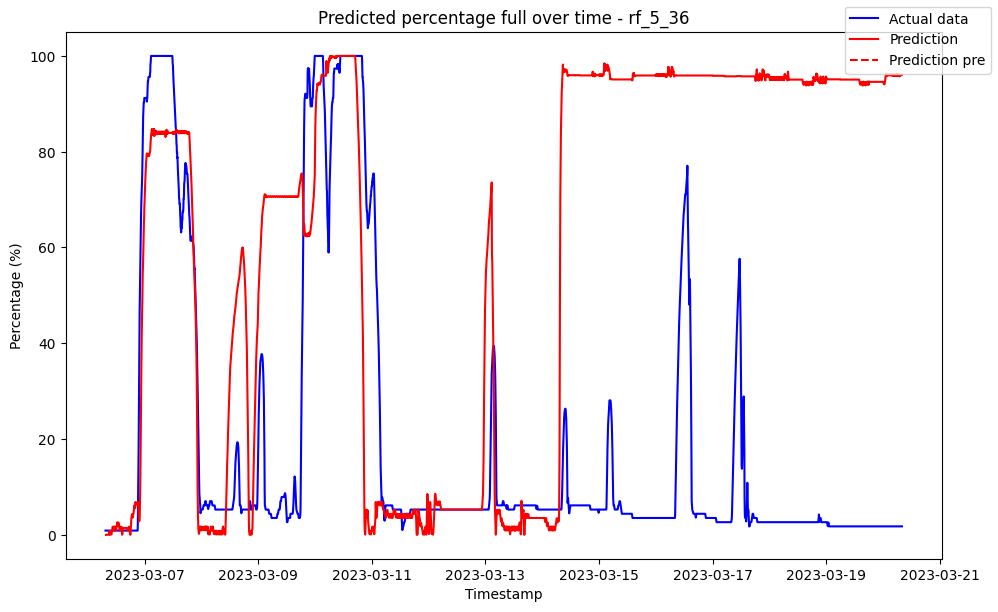

------------------------------------ rf_5_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09903624206294727
Variance (R²) score: 1.00


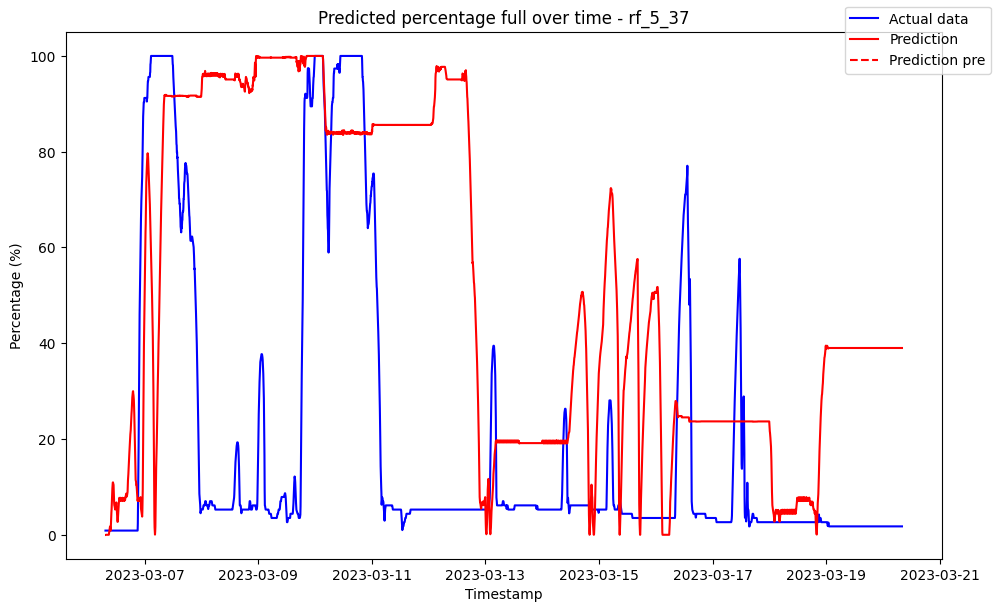

------------------------------------ rf_5_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08456548823039857
Variance (R²) score: 1.00


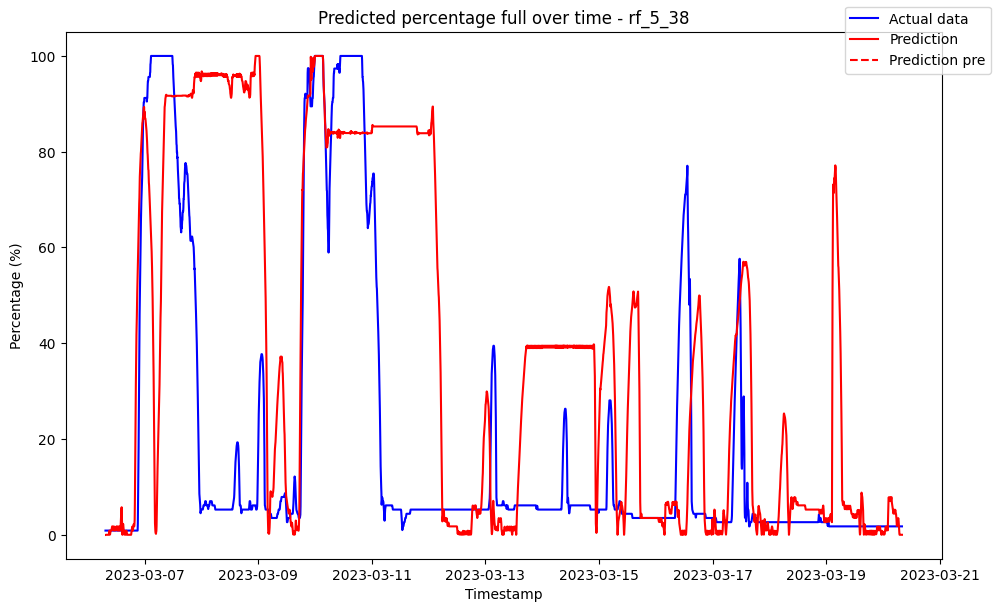

------------------------------------ rf_5_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07890866368867167
Variance (R²) score: 1.00


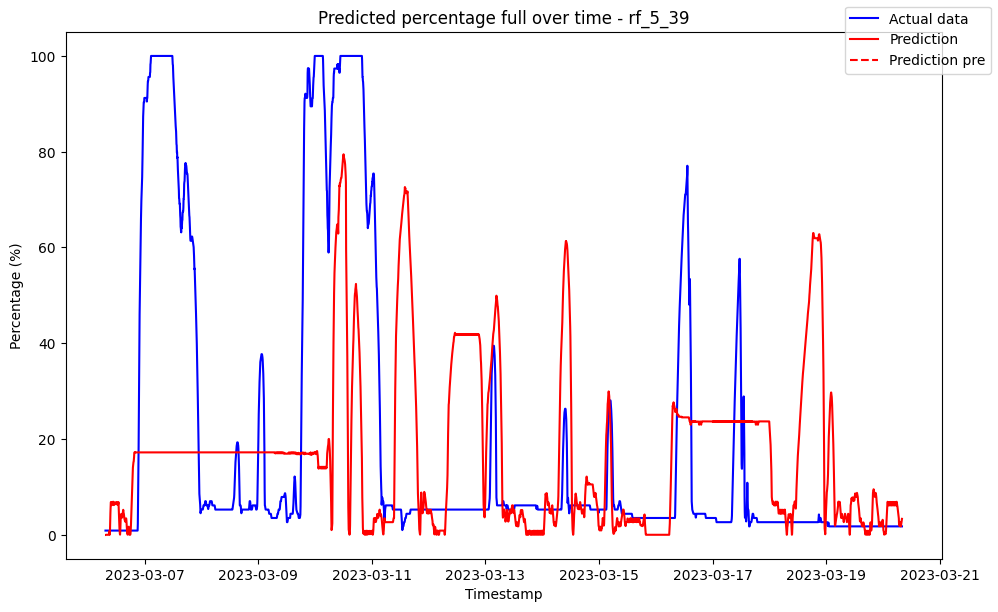

------------------------------------ rf_5_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019525               0.0
1 2023-03-06 07:35:00            0.019525               0.0
2 2023-03-06 07:40:00            0.019525               0.0
3 2023-03-06 07:45:00            0.019525               0.0
4 2023-03-06 07:50:00            0.019525               0.0
5 2023-03-06 07:55:00            0.019525               0.0

Metrics for this specific prediction:
Accuracy: 99.79%
Mean squared error: 2.109963003529888
Variance (R²) score: 1.00


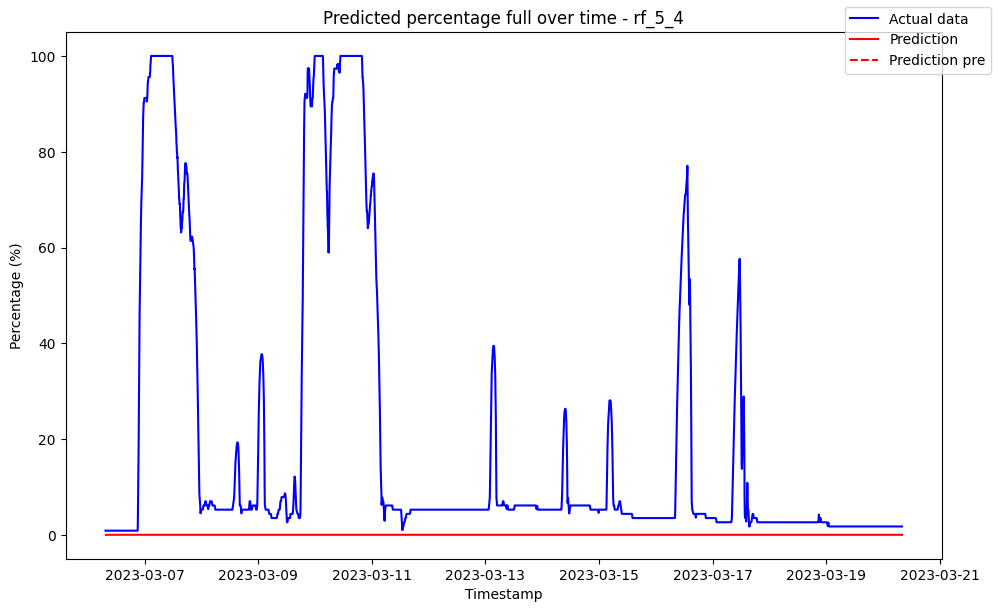

------------------------------------ rf_5_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08055441461496829
Variance (R²) score: 1.00


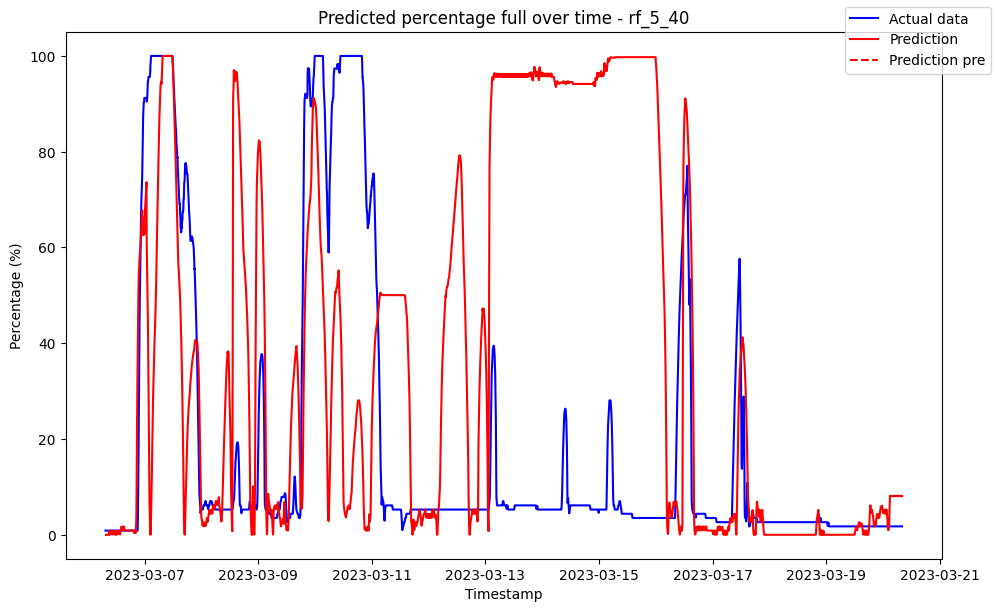

------------------------------------ rf_5_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09135152762705506
Variance (R²) score: 1.00


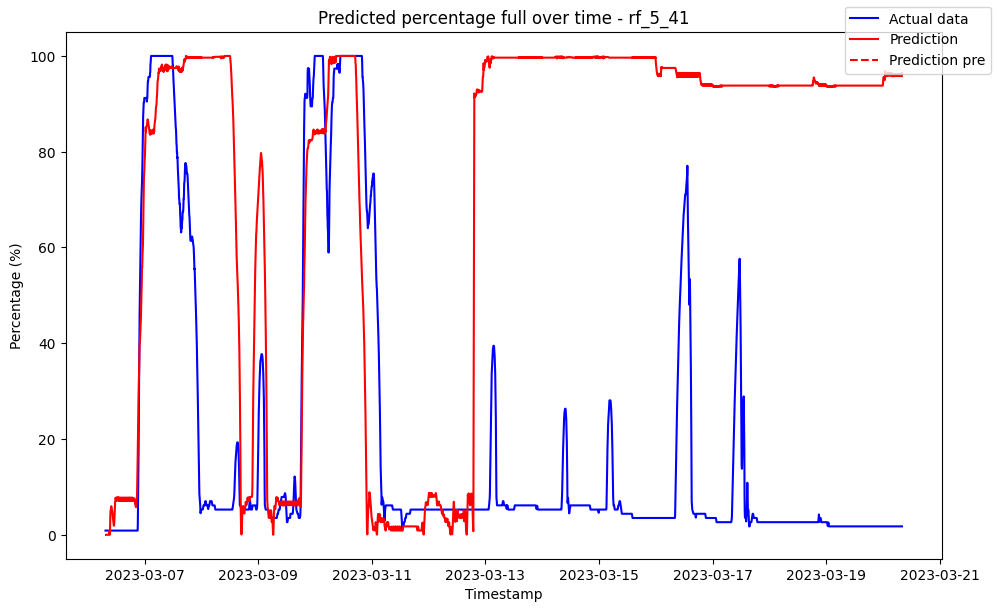

------------------------------------ rf_5_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07980751164205695
Variance (R²) score: 1.00


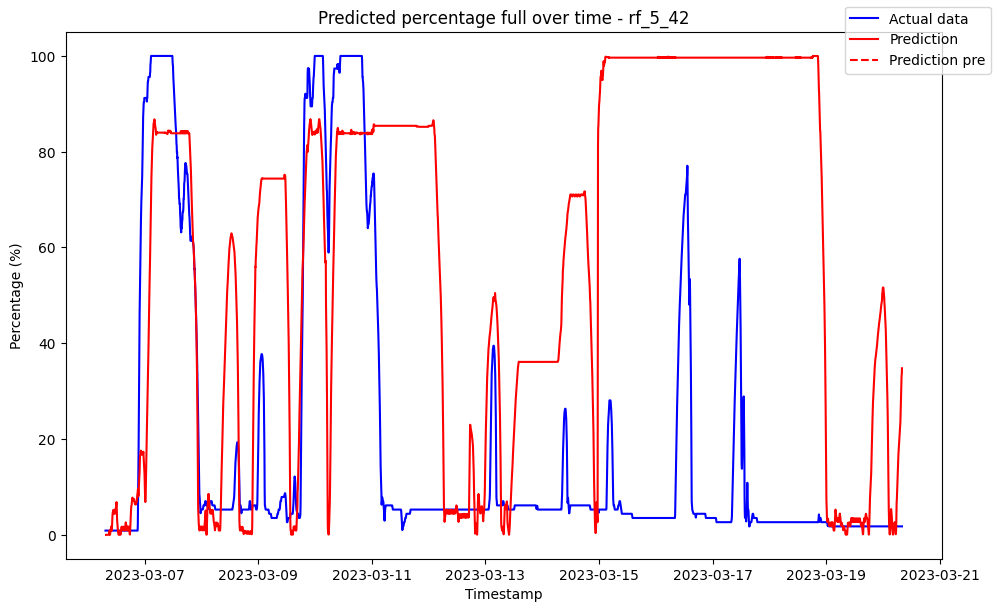

------------------------------------ rf_5_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0947703110350246
Variance (R²) score: 1.00


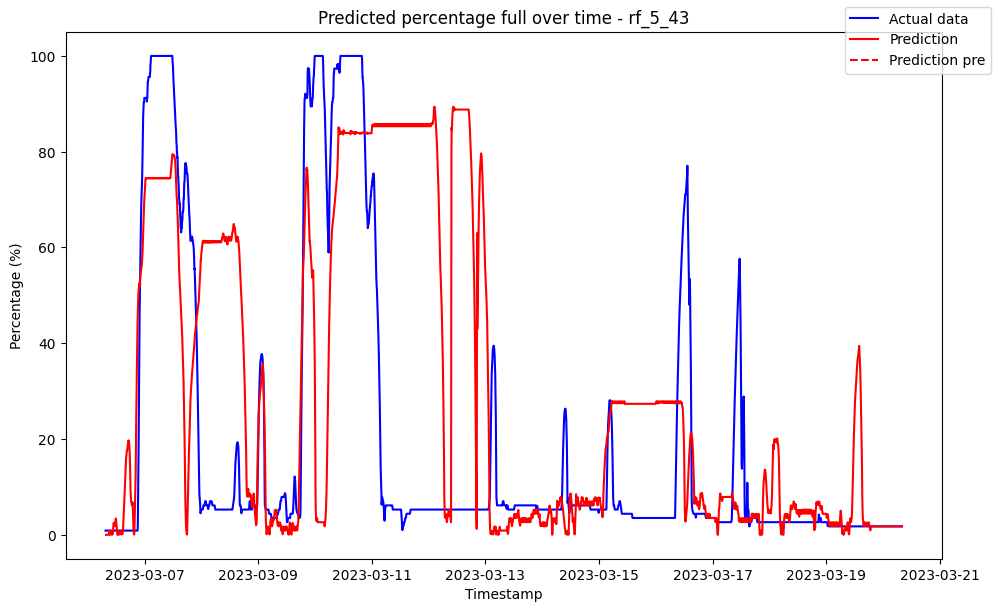

------------------------------------ rf_5_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08650907572406405
Variance (R²) score: 1.00


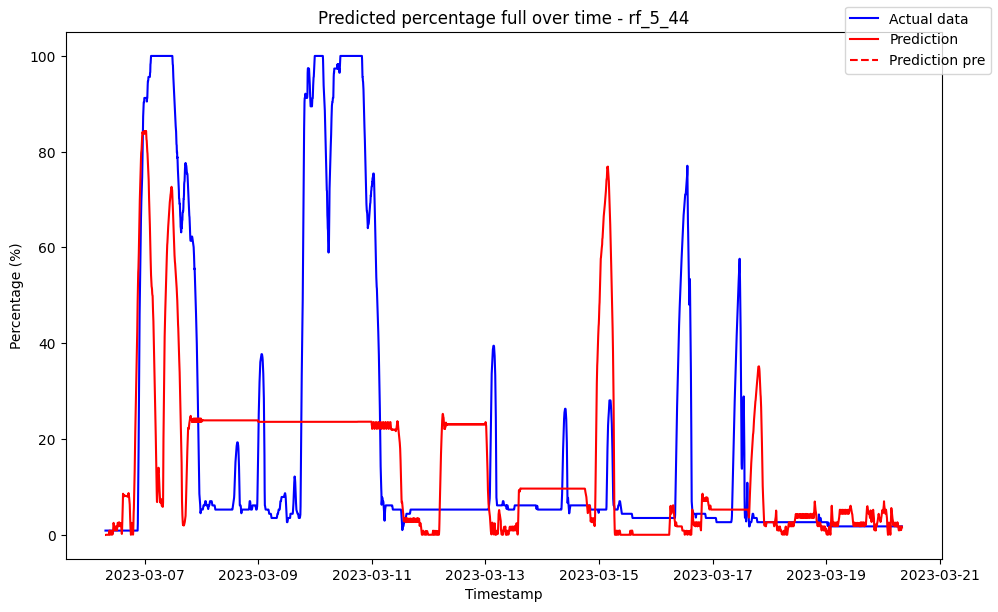

------------------------------------ rf_5_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08576392289073949
Variance (R²) score: 1.00


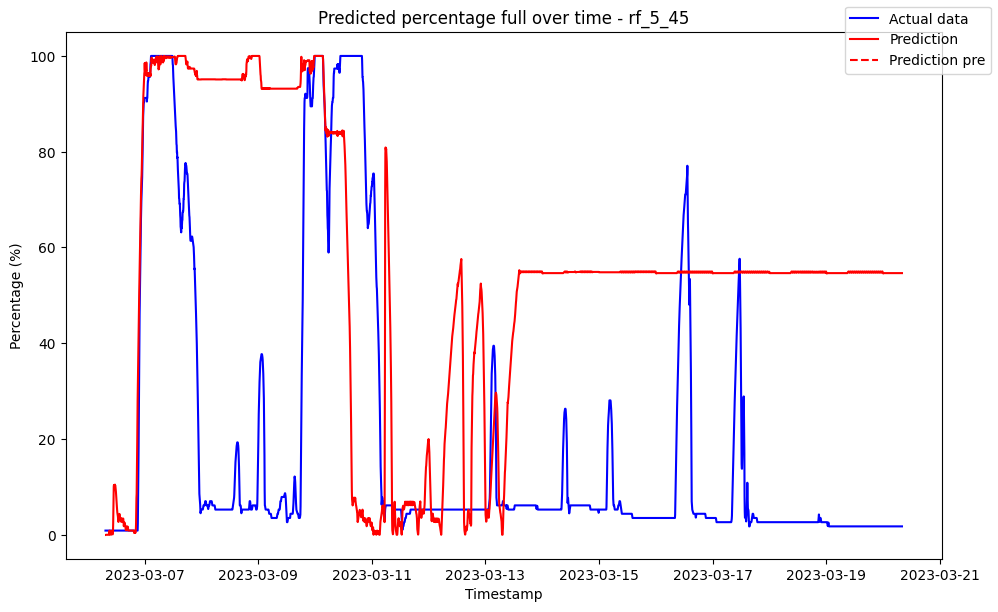

------------------------------------ rf_5_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07372402301161729
Variance (R²) score: 1.00


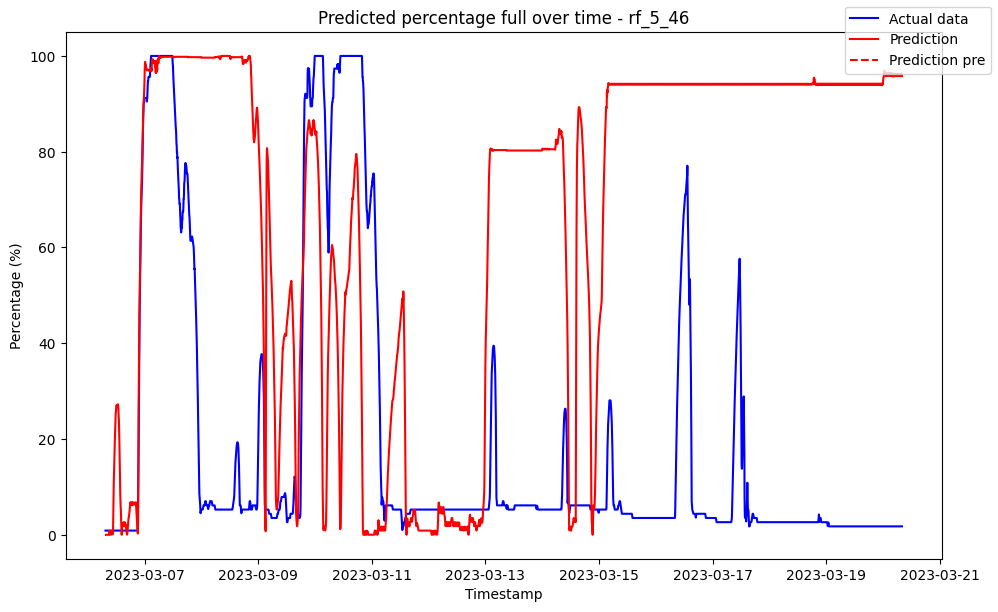

------------------------------------ rf_5_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09385488684561186
Variance (R²) score: 1.00


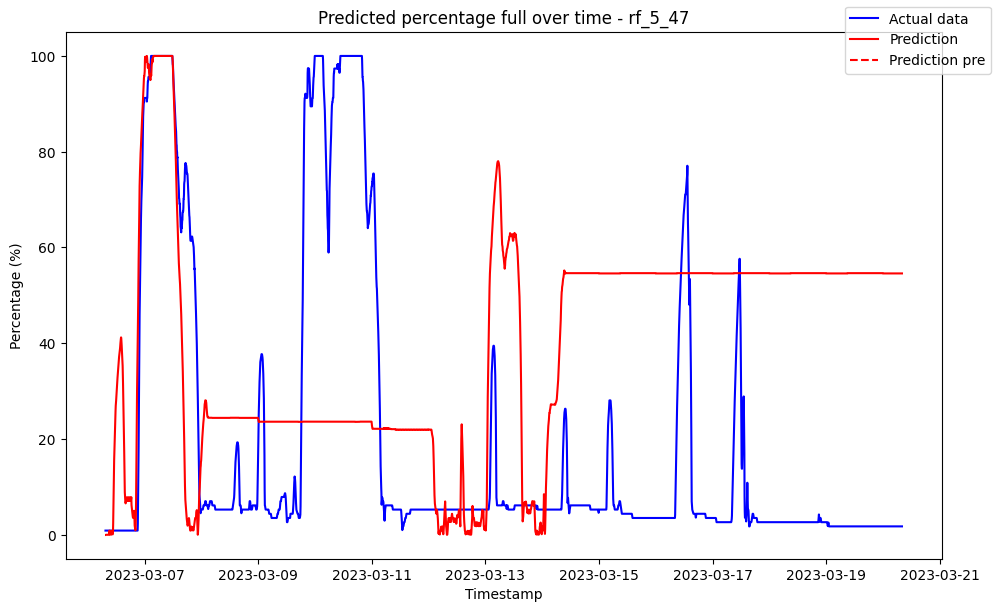

------------------------------------ rf_5_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08242826822540358
Variance (R²) score: 1.00


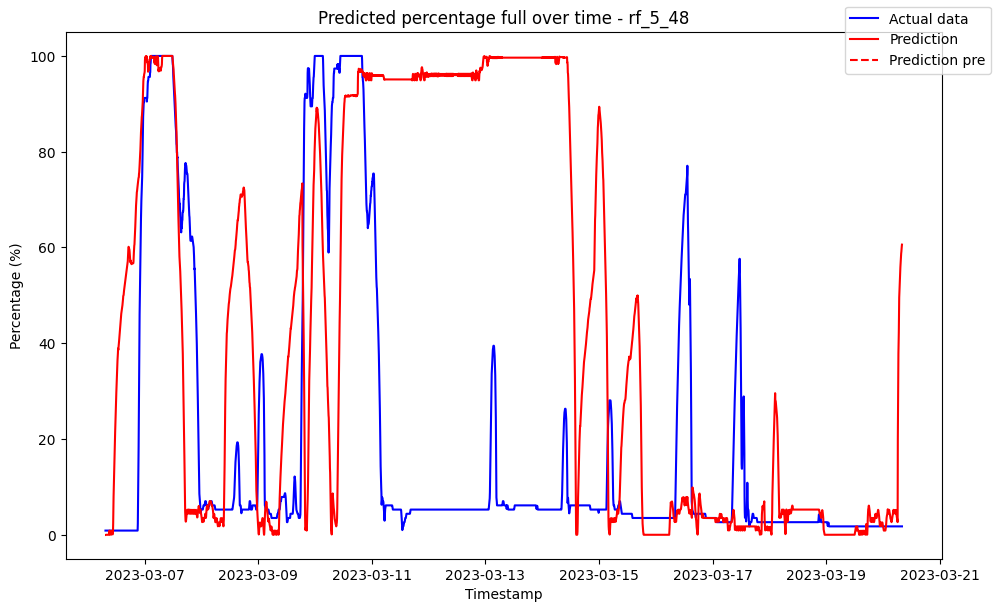

------------------------------------ rf_5_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09335178965522188
Variance (R²) score: 1.00


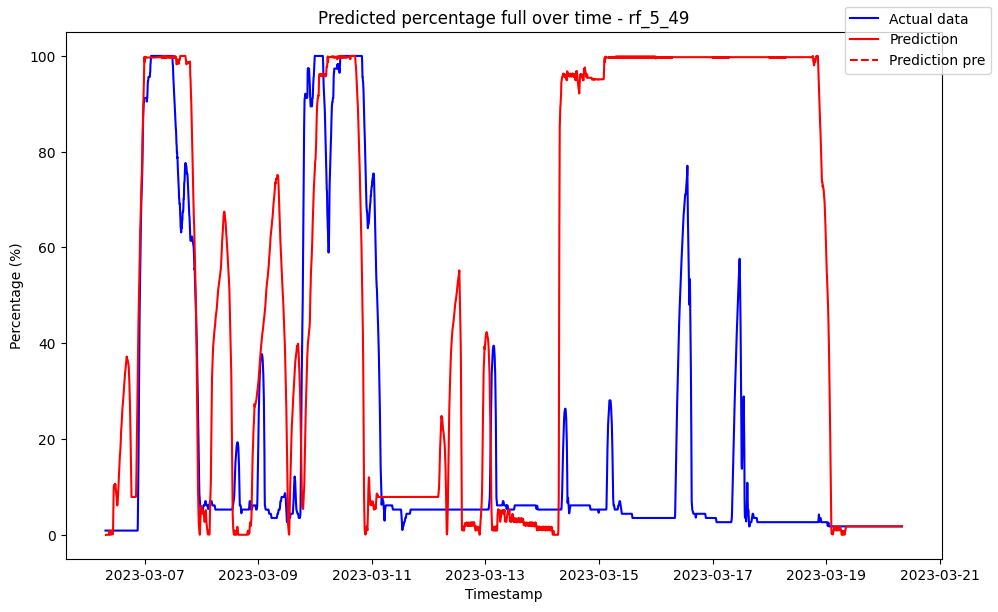

------------------------------------ rf_5_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.017971               0.0
1 2023-03-06 07:35:00            0.017971               0.0
2 2023-03-06 07:40:00            0.017971               0.0
3 2023-03-06 07:45:00            0.017971               0.0
4 2023-03-06 07:50:00            0.017971               0.0
5 2023-03-06 07:55:00            0.017971               0.0

Metrics for this specific prediction:
Accuracy: 99.92%
Mean squared error: 0.8600614879818338
Variance (R²) score: 1.00


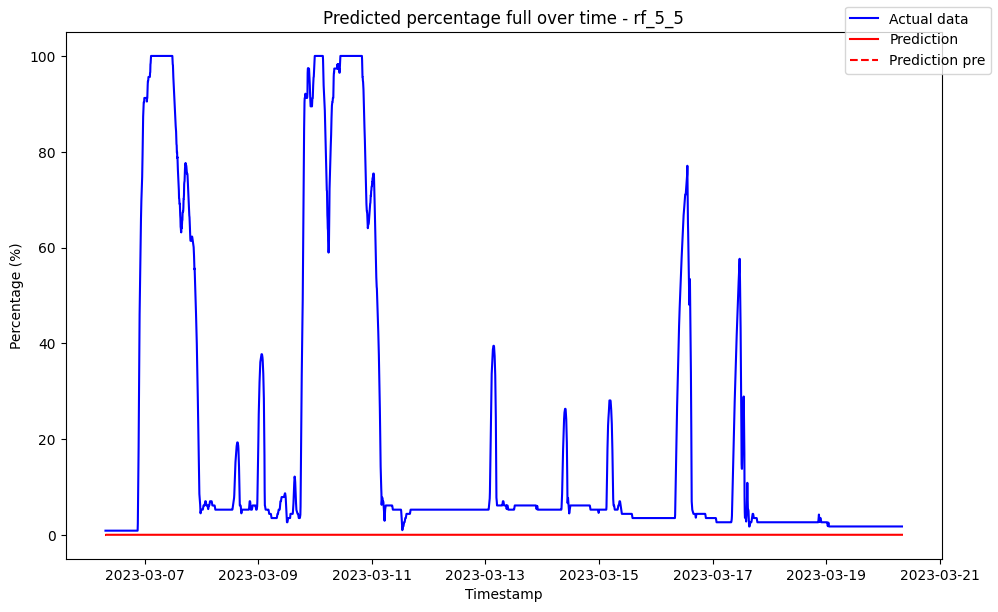

------------------------------------ rf_5_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09364406545425476
Variance (R²) score: 1.00


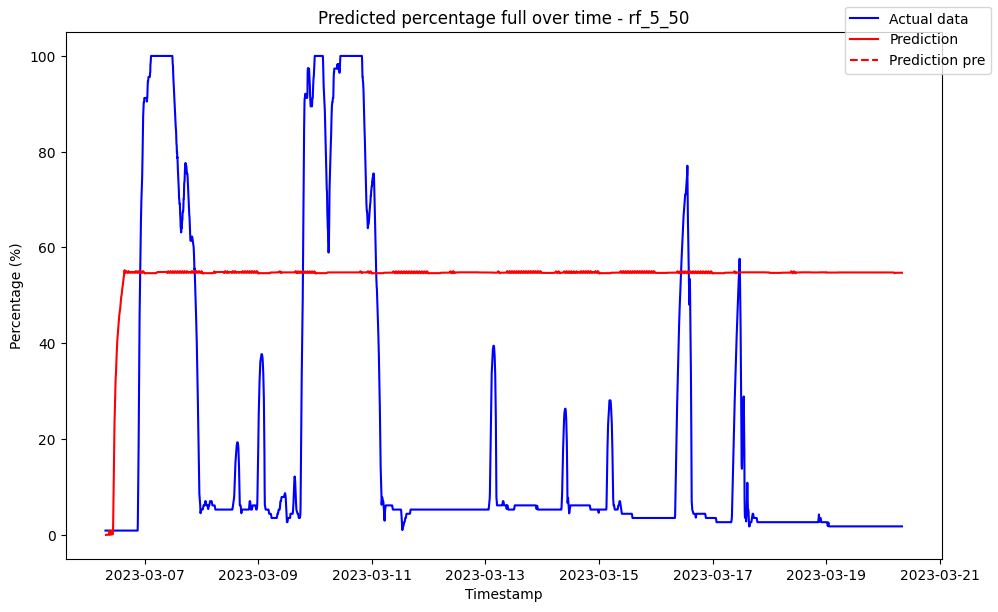

------------------------------------ rf_5_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.011683               0.0
1 2023-03-06 07:35:00            0.080091               0.0
2 2023-03-06 07:40:00            0.254724               0.0
3 2023-03-06 07:45:00            0.254724               0.0
4 2023-03-06 07:50:00            0.254724               0.0
5 2023-03-06 07:55:00            0.254724               0.0

Metrics for this specific prediction:
Accuracy: 99.94%
Mean squared error: 0.6348835392994834
Variance (R²) score: 1.00


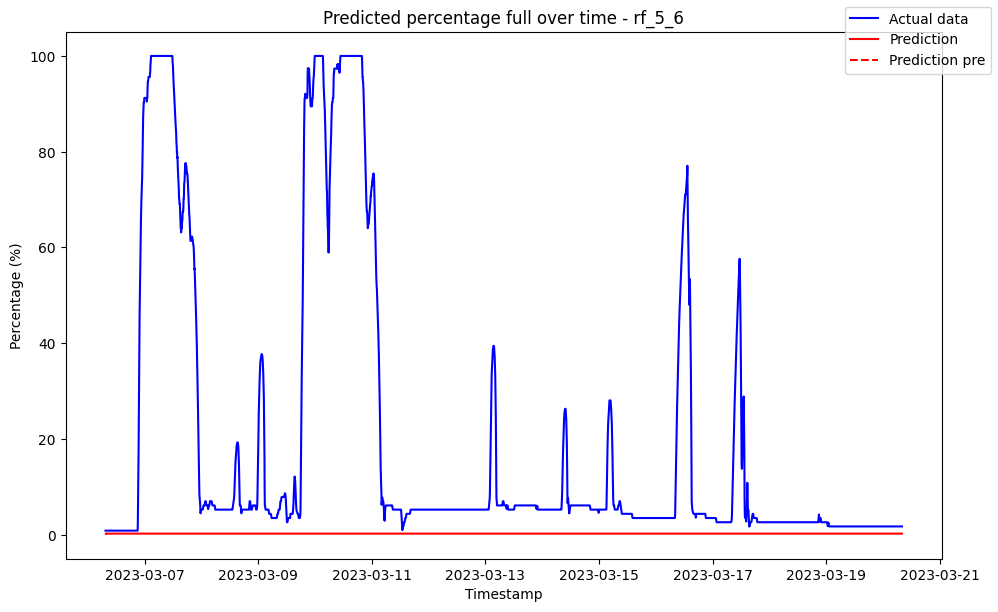

------------------------------------ rf_5_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007655               0.0
1 2023-03-06 07:35:00            0.192528               0.0
2 2023-03-06 07:40:00            0.572852               0.0
3 2023-03-06 07:45:00            0.724723               0.0
4 2023-03-06 07:50:00            0.870728               0.0
5 2023-03-06 07:55:00            0.880770               0.0

Metrics for this specific prediction:
Accuracy: 99.95%
Mean squared error: 0.48492839753725486
Variance (R²) score: 1.00


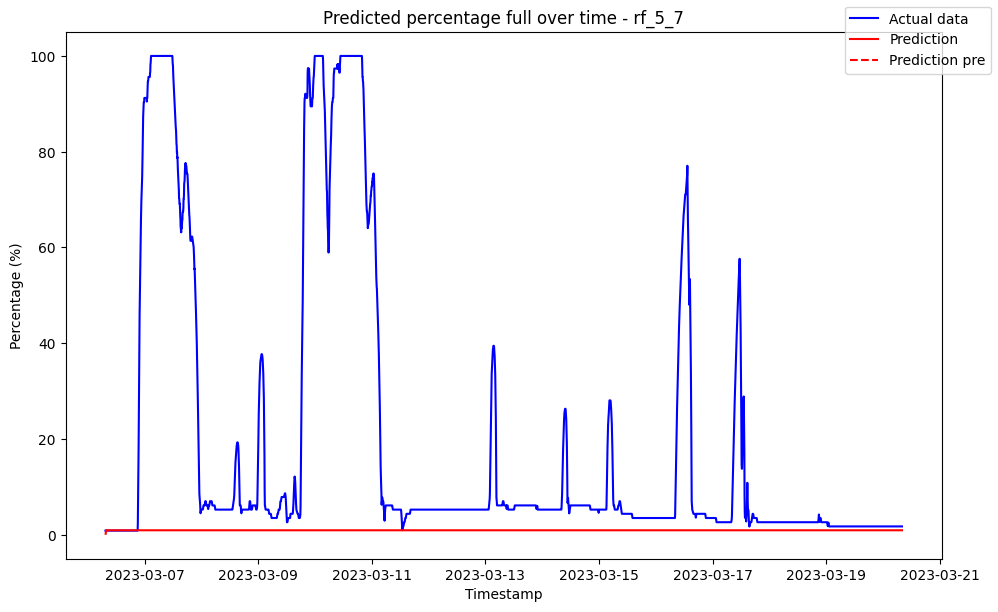

------------------------------------ rf_5_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006676               0.0
1 2023-03-06 07:35:00            0.239067               0.0
2 2023-03-06 07:40:00            0.668833               0.0
3 2023-03-06 07:45:00            0.760687               0.0
4 2023-03-06 07:50:00            0.816288               0.0
5 2023-03-06 07:55:00            0.876447               0.0

Metrics for this specific prediction:
Accuracy: 99.96%
Mean squared error: 0.36082120721330846
Variance (R²) score: 1.00


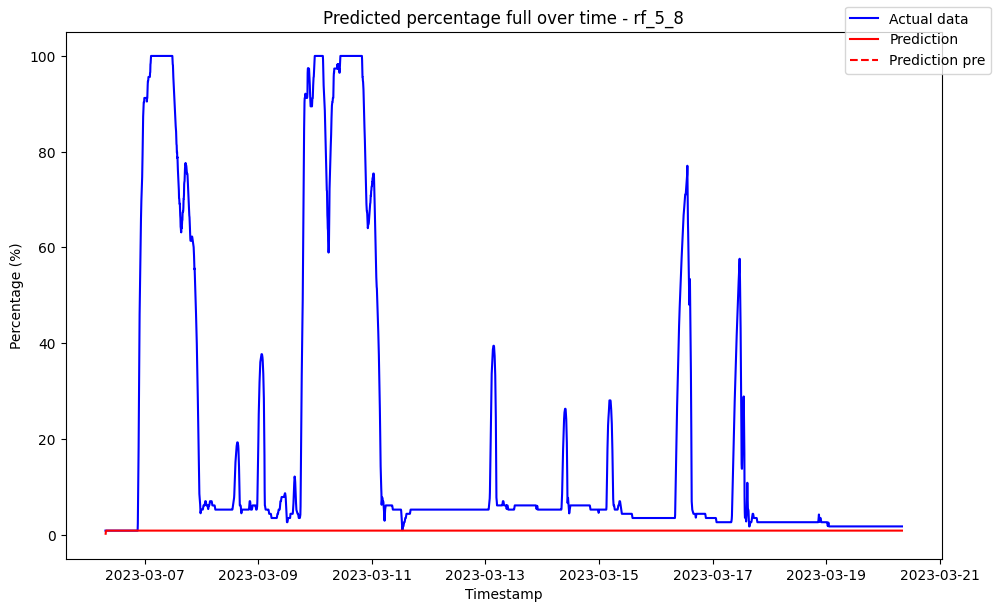

------------------------------------ rf_5_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.020748               0.0
1 2023-03-06 07:35:00            0.379128               0.0
2 2023-03-06 07:40:00            0.717492               0.0
3 2023-03-06 07:45:00            0.834142               0.0
4 2023-03-06 07:50:00            0.873722               0.0
5 2023-03-06 07:55:00            0.873722               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.26650698759112573
Variance (R²) score: 1.00


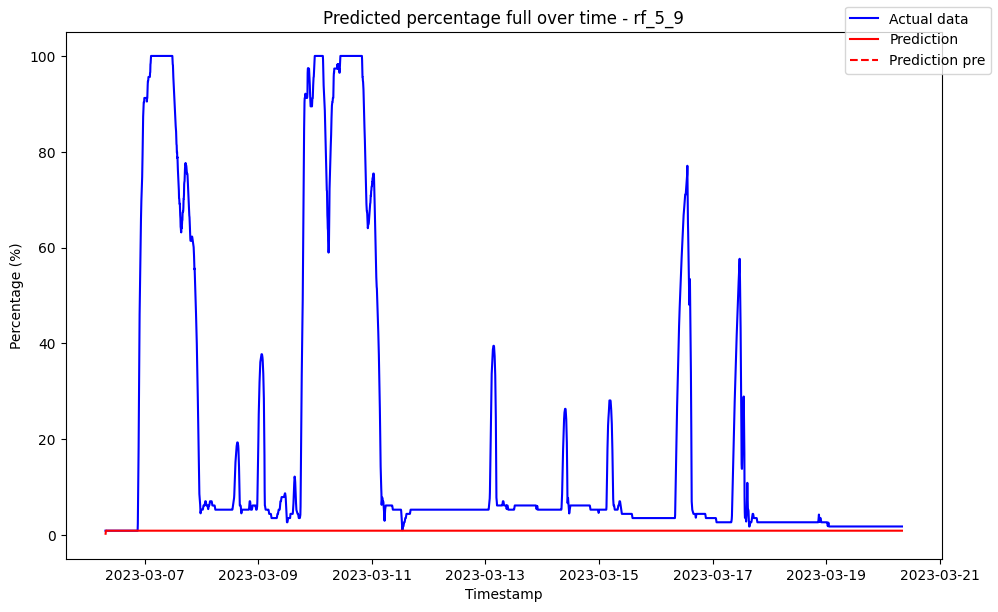

------------------------------------ rf_6_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.529592               0.0
1 2023-03-06 07:35:00            3.529592               0.0
2 2023-03-06 07:40:00            3.529592               0.0
3 2023-03-06 07:45:00            3.529592               0.0
4 2023-03-06 07:50:00            3.529592               0.0
5 2023-03-06 07:55:00            3.529592               0.0

Metrics for this specific prediction:
Accuracy: 89.45%
Mean squared error: 107.70336617560463
Variance (R²) score: 0.89


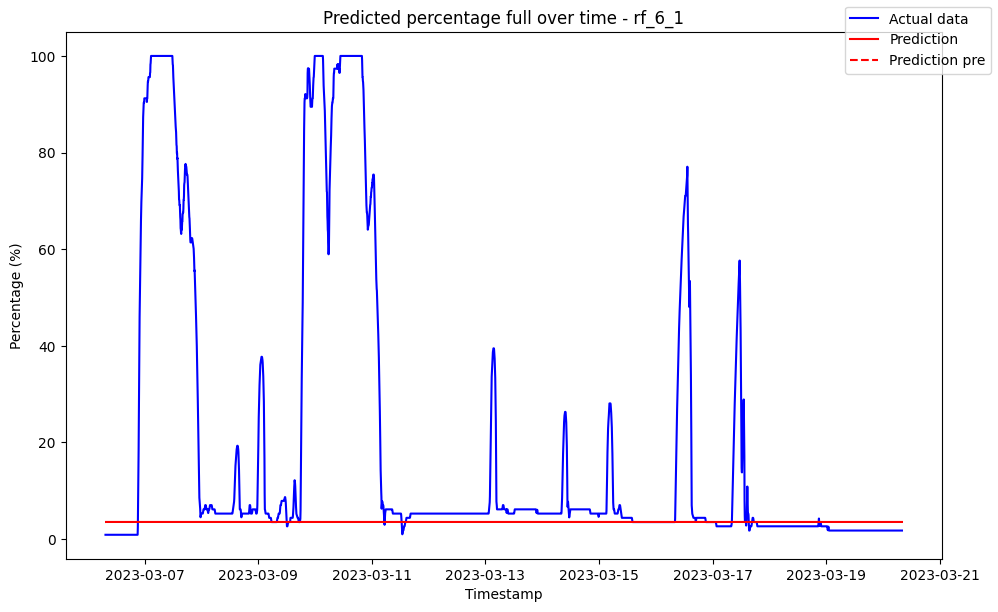

------------------------------------ rf_6_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.026986               0.0
1 2023-03-06 07:35:00            0.405510               0.0
2 2023-03-06 07:40:00            0.707653               0.0
3 2023-03-06 07:45:00            0.785454               0.0
4 2023-03-06 07:50:00            0.591106               0.0
5 2023-03-06 07:55:00            0.326380               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.20344495735846263
Variance (R²) score: 1.00


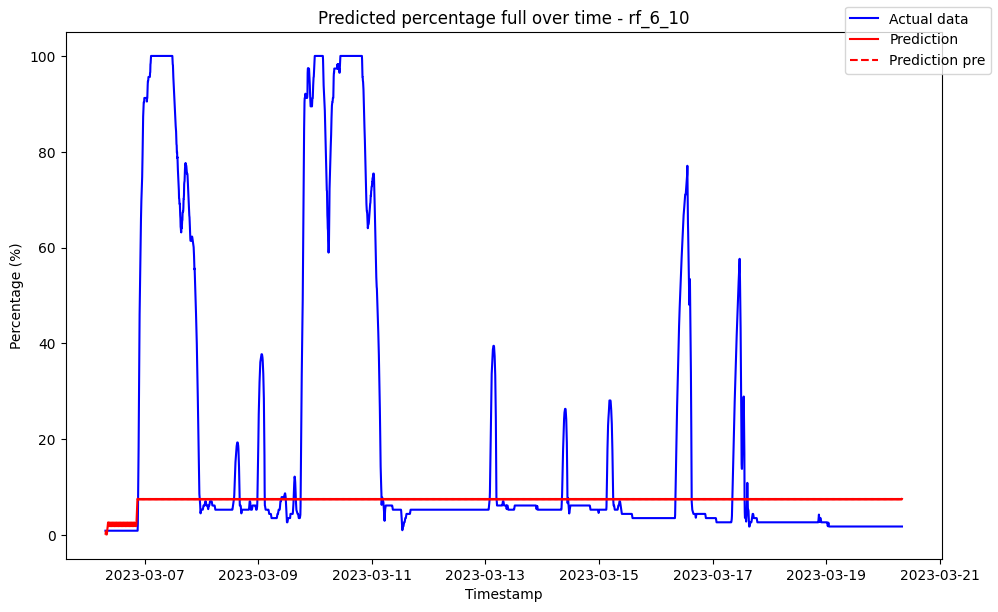

------------------------------------ rf_6_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.017285               0.0
1 2023-03-06 07:35:00            0.230549               0.0
2 2023-03-06 07:40:00            0.629756               0.0
3 2023-03-06 07:45:00            0.835250               0.0
4 2023-03-06 07:50:00            0.677214               0.0
5 2023-03-06 07:55:00            0.388640               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14675371192714143
Variance (R²) score: 1.00


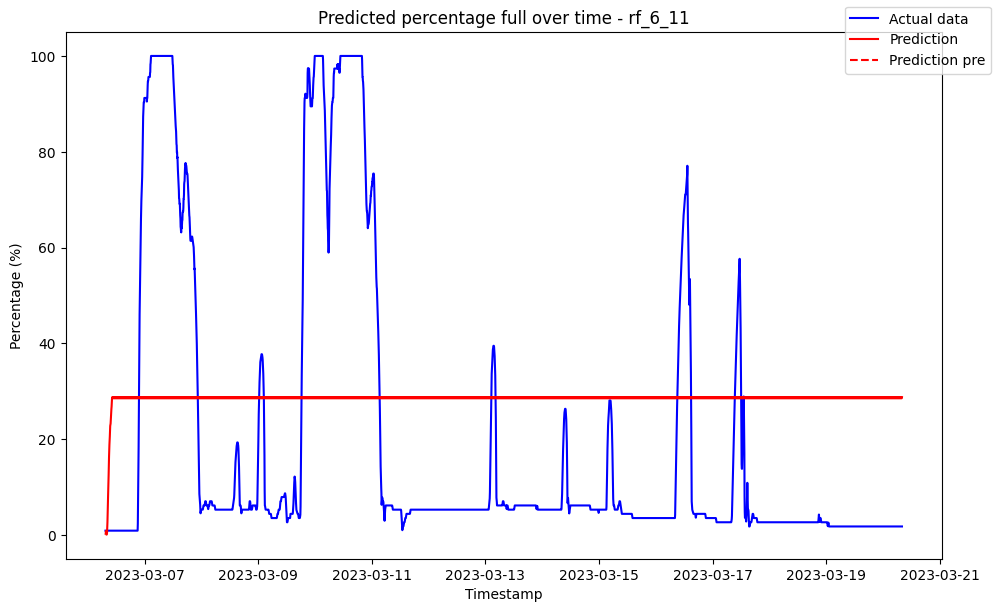

------------------------------------ rf_6_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.011661               0.0
1 2023-03-06 07:35:00            0.195834               0.0
2 2023-03-06 07:40:00            0.516240               0.0
3 2023-03-06 07:45:00            0.783518               0.0
4 2023-03-06 07:50:00            0.847241               0.0
5 2023-03-06 07:55:00            0.593151               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12069044739427603
Variance (R²) score: 1.00


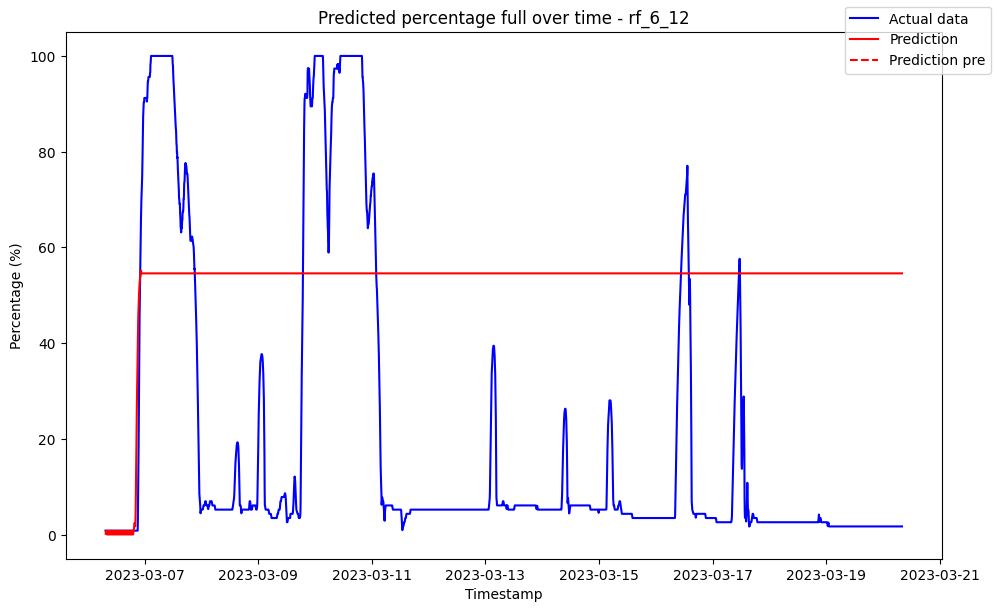

------------------------------------ rf_6_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.012177               0.0
1 2023-03-06 07:35:00            0.170954               0.0
2 2023-03-06 07:40:00            0.497901               0.0
3 2023-03-06 07:45:00            0.780043               0.0
4 2023-03-06 07:50:00            0.836840               0.0
5 2023-03-06 07:55:00            0.544398               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10813152233136948
Variance (R²) score: 1.00


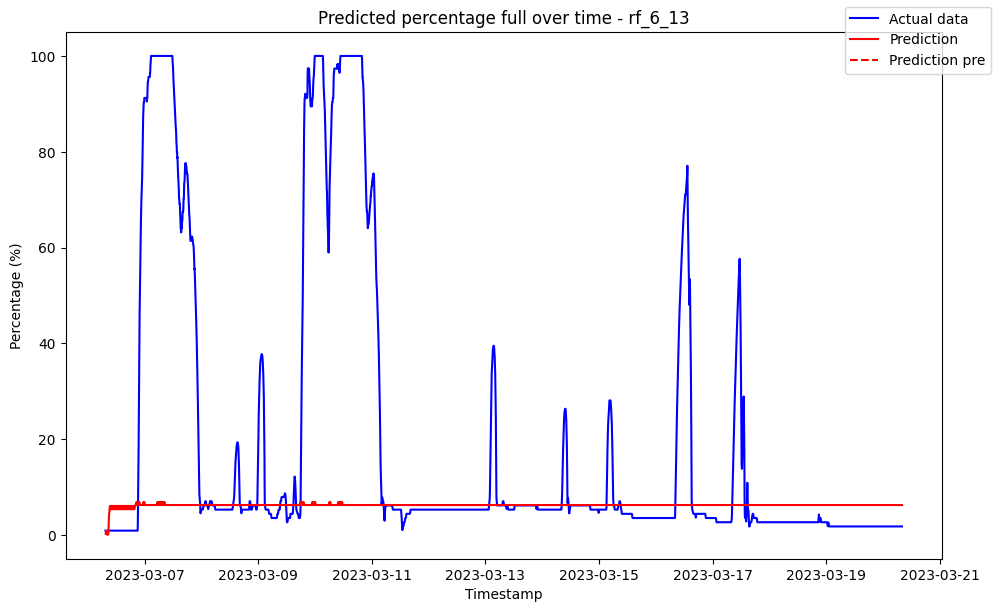

------------------------------------ rf_6_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.012138               0.0
1 2023-03-06 07:35:00            0.172968               0.0
2 2023-03-06 07:40:00            0.531209               0.0
3 2023-03-06 07:45:00            0.788093               0.0
4 2023-03-06 07:50:00            0.835096               0.0
5 2023-03-06 07:55:00            0.533279               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09347210169457629
Variance (R²) score: 1.00


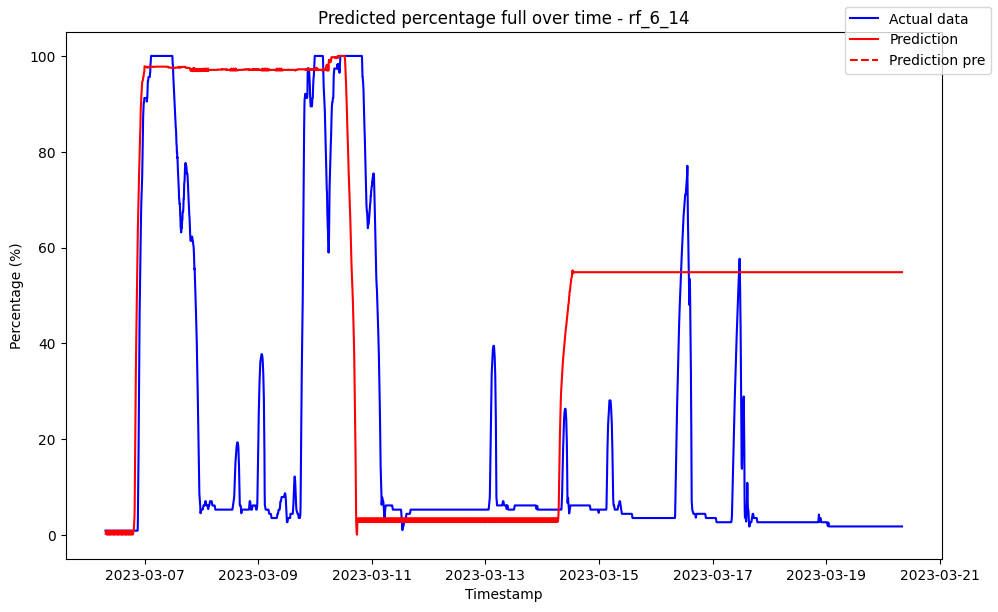

------------------------------------ rf_6_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009203               0.0
1 2023-03-06 07:35:00            0.160559               0.0
2 2023-03-06 07:40:00            0.513323               0.0
3 2023-03-06 07:45:00            0.784186               0.0
4 2023-03-06 07:50:00            0.851829               0.0
5 2023-03-06 07:55:00            0.809568               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08915293458579102
Variance (R²) score: 1.00


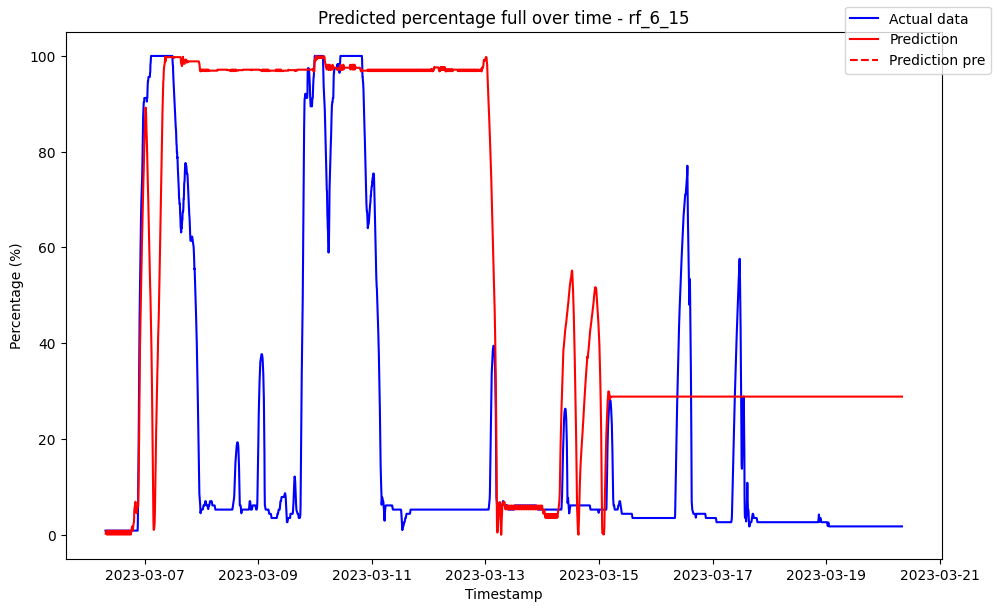

------------------------------------ rf_6_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007618               0.0
1 2023-03-06 07:35:00            0.163073               0.0
2 2023-03-06 07:40:00            0.478281               0.0
3 2023-03-06 07:45:00            0.764505               0.0
4 2023-03-06 07:50:00            0.847223               0.0
5 2023-03-06 07:55:00            0.760205               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09279385601114117
Variance (R²) score: 1.00


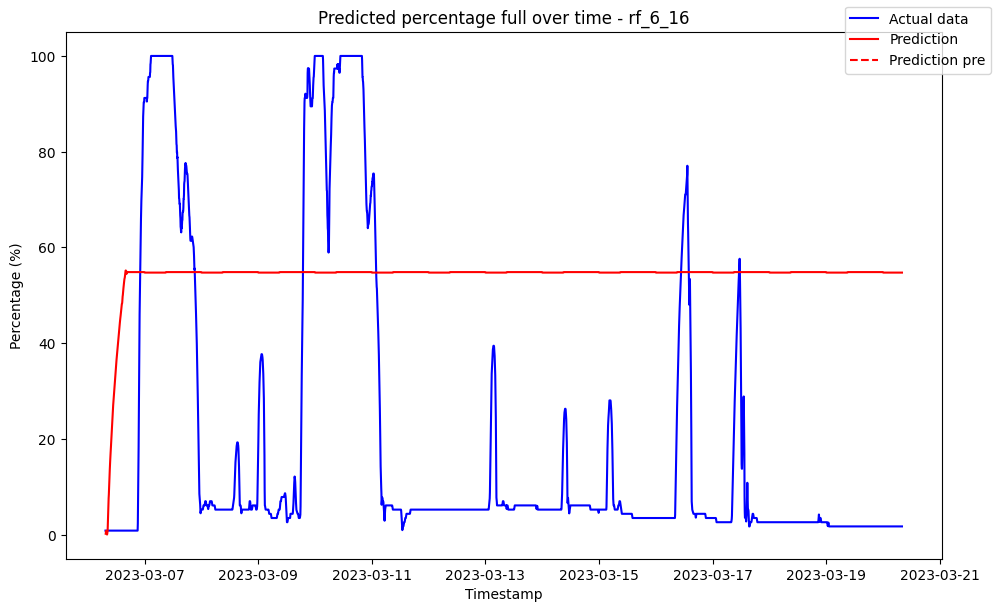

------------------------------------ rf_6_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005488               0.0
1 2023-03-06 07:35:00            0.152829               0.0
2 2023-03-06 07:40:00            0.518705               0.0
3 2023-03-06 07:45:00            0.666574               0.0
4 2023-03-06 07:50:00            0.679245               0.0
5 2023-03-06 07:55:00            0.544941               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08416509645941413
Variance (R²) score: 1.00


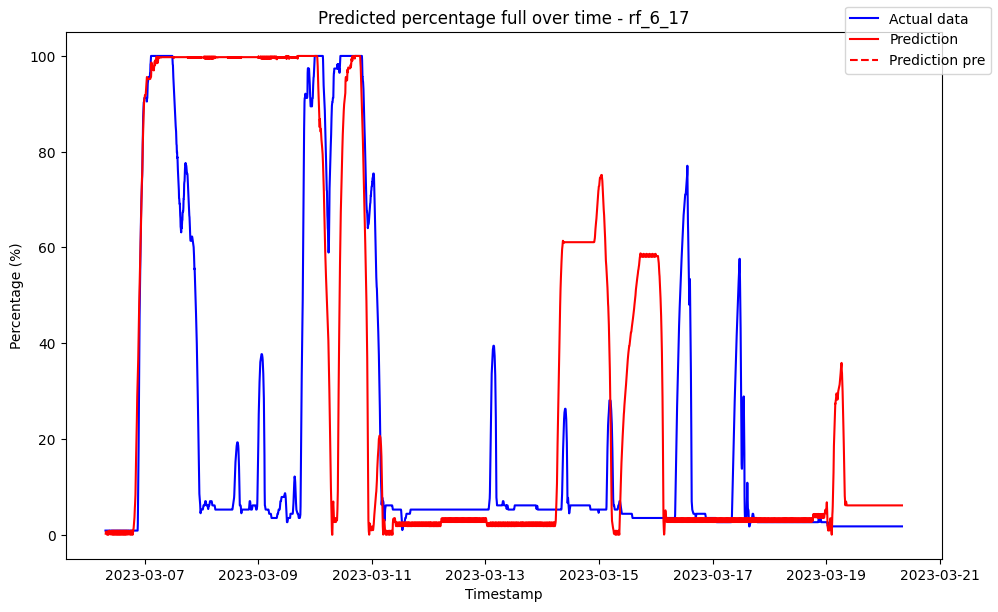

------------------------------------ rf_6_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007549               0.0
1 2023-03-06 07:35:00            0.149462               0.0
2 2023-03-06 07:40:00            0.516125               0.0
3 2023-03-06 07:45:00            0.779596               0.0
4 2023-03-06 07:50:00            0.681594               0.0
5 2023-03-06 07:55:00            0.400090               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09506808849303217
Variance (R²) score: 1.00


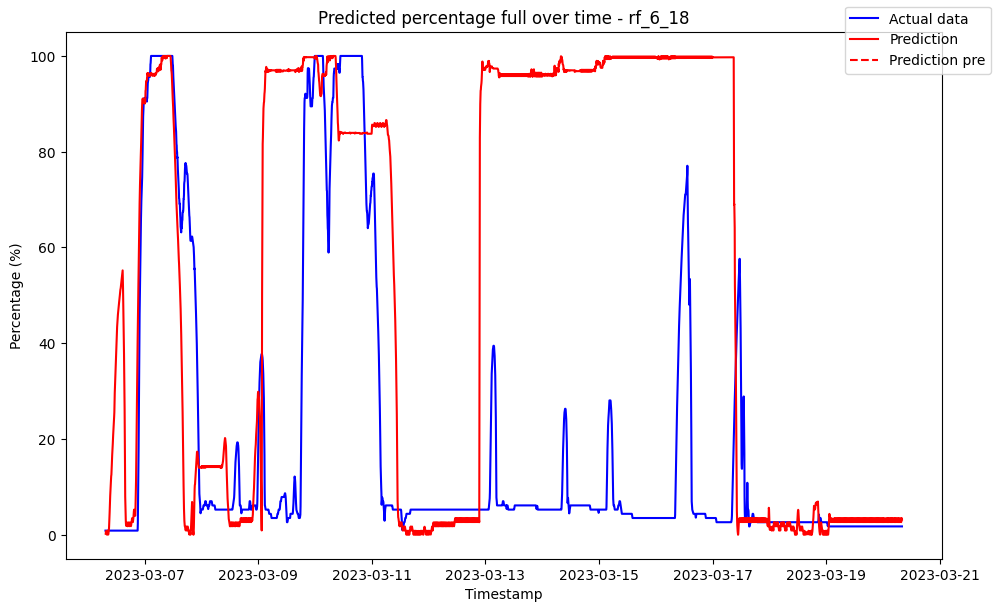

------------------------------------ rf_6_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006478               0.0
1 2023-03-06 07:35:00            0.138764               0.0
2 2023-03-06 07:40:00            0.504149               0.0
3 2023-03-06 07:45:00            0.771550               0.0
4 2023-03-06 07:50:00            0.865625               0.0
5 2023-03-06 07:55:00            0.527840               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07684294636325974
Variance (R²) score: 1.00


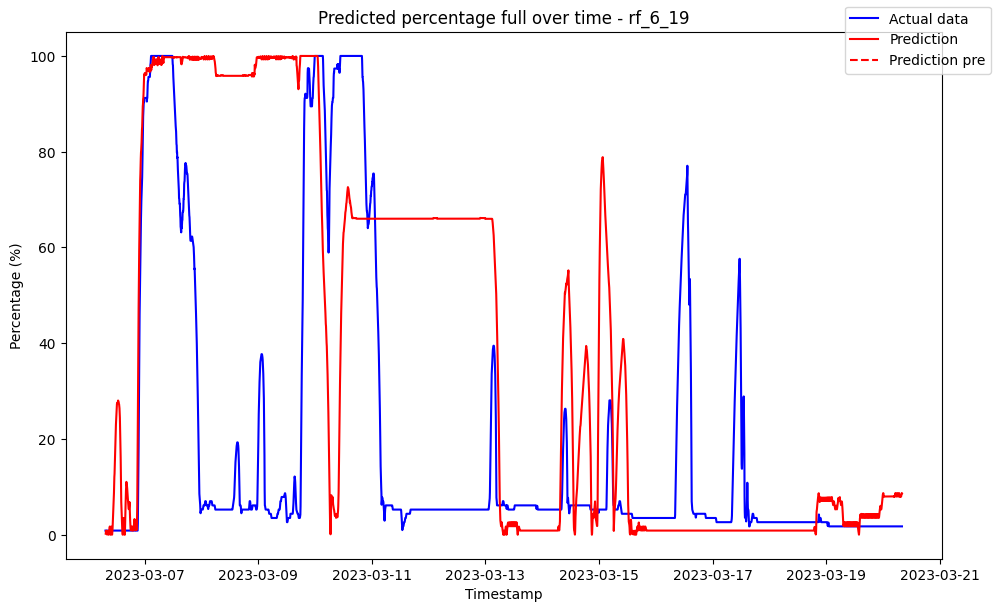

------------------------------------ rf_6_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            1.155176               0.0
1 2023-03-06 07:35:00            1.155176               0.0
2 2023-03-06 07:40:00            1.155176               0.0
3 2023-03-06 07:45:00            1.155176               0.0
4 2023-03-06 07:50:00            1.155176               0.0
5 2023-03-06 07:55:00            1.155176               0.0

Metrics for this specific prediction:
Accuracy: 96.59%
Mean squared error: 34.85234204010441
Variance (R²) score: 0.97


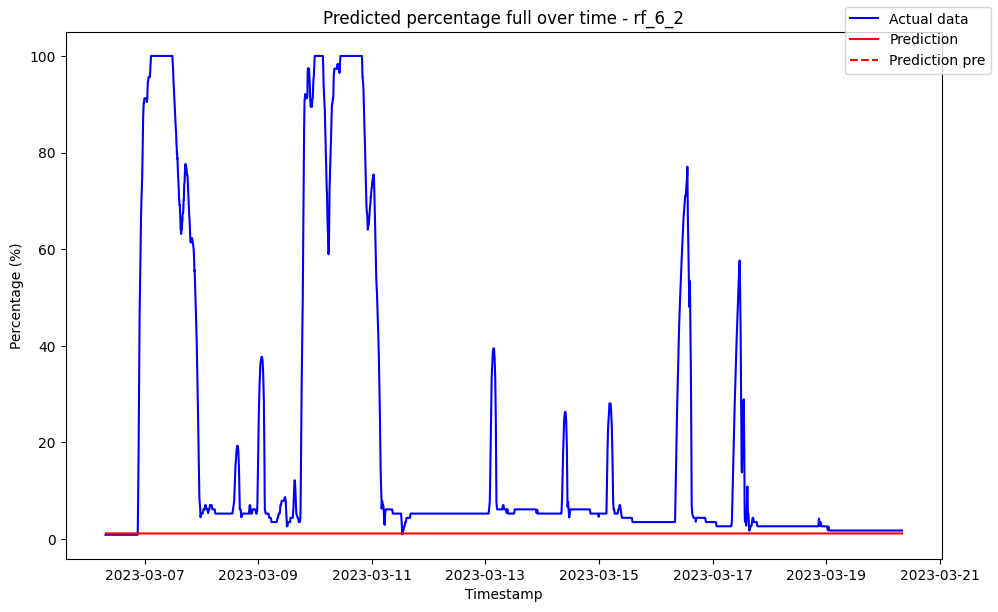

------------------------------------ rf_6_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.003876               0.0
1 2023-03-06 07:35:00            0.130788               0.0
2 2023-03-06 07:40:00            0.494824               0.0
3 2023-03-06 07:45:00            0.850954               0.0
4 2023-03-06 07:50:00            1.041109               0.0
5 2023-03-06 07:55:00            1.339151               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07887872940531038
Variance (R²) score: 1.00


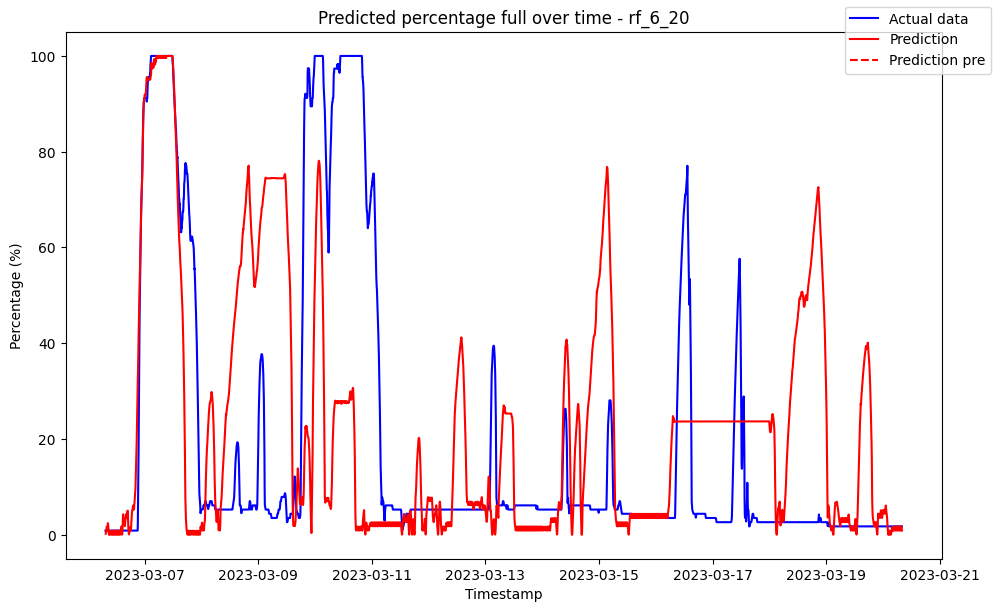

------------------------------------ rf_6_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004128               0.0
1 2023-03-06 07:35:00            0.127609               0.0
2 2023-03-06 07:40:00            0.491403               0.0
3 2023-03-06 07:45:00            0.847741               0.0
4 2023-03-06 07:50:00            0.969567               0.0
5 2023-03-06 07:55:00            1.257758               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10027221871823852
Variance (R²) score: 1.00


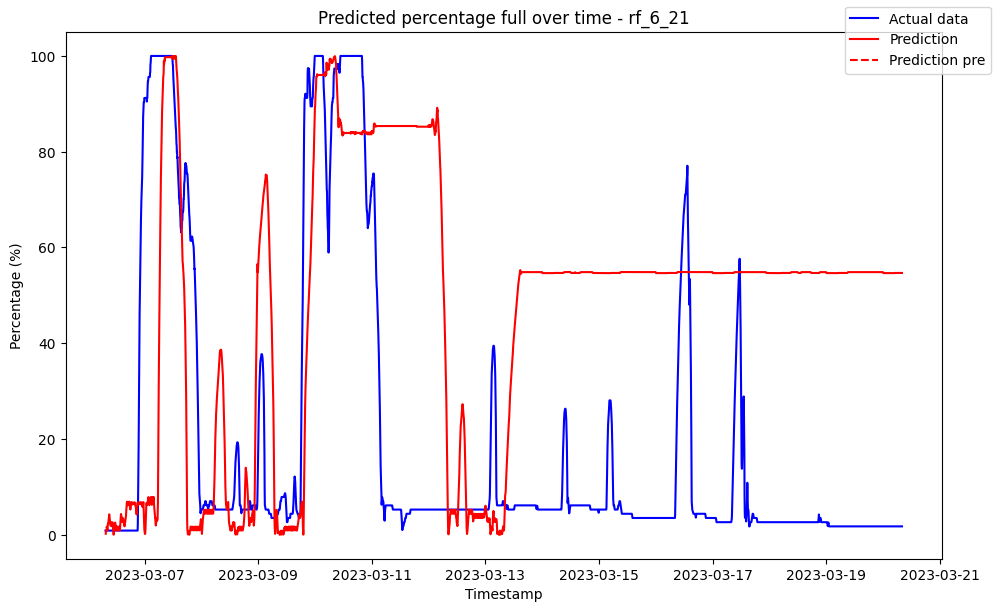

------------------------------------ rf_6_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007140               0.0
1 2023-03-06 07:35:00            0.156154               0.0
2 2023-03-06 07:40:00            0.503583               0.0
3 2023-03-06 07:45:00            0.777452               0.0
4 2023-03-06 07:50:00            0.875725               0.0
5 2023-03-06 07:55:00            0.872433               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0783051858018477
Variance (R²) score: 1.00


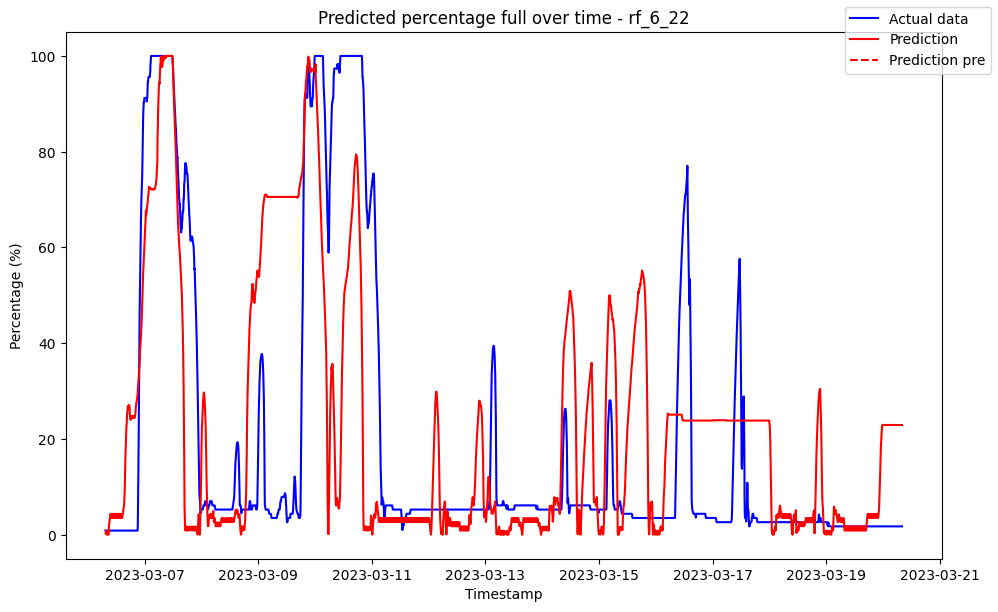

------------------------------------ rf_6_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000144               0.0
1 2023-03-06 07:35:00            0.000144               0.0
2 2023-03-06 07:40:00            0.000144               0.0
3 2023-03-06 07:45:00            0.000144               0.0
4 2023-03-06 07:50:00            0.000144               0.0
5 2023-03-06 07:55:00            0.000144               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.084633718921541
Variance (R²) score: 1.00


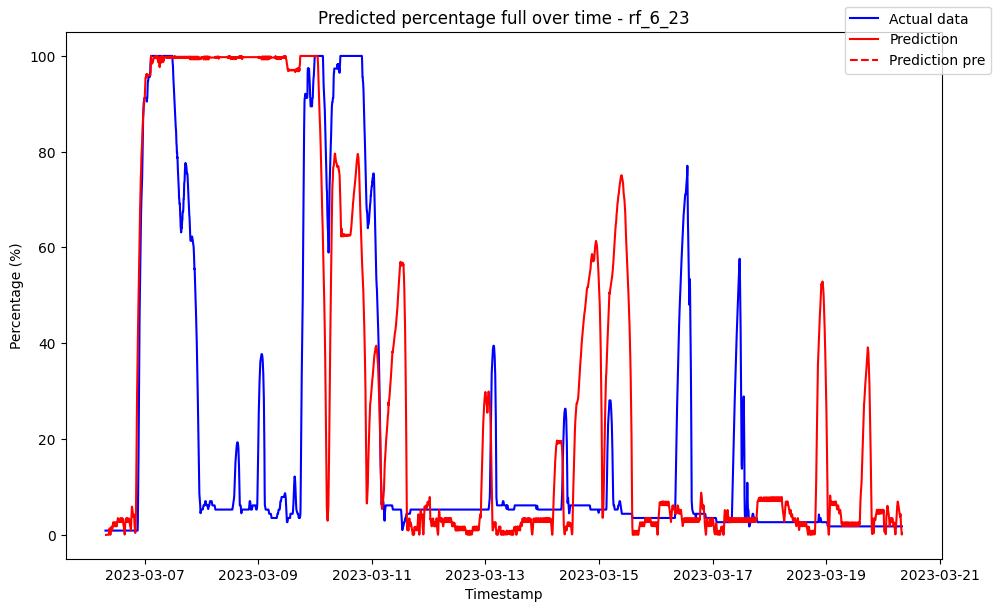

------------------------------------ rf_6_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000951               0.0
1 2023-03-06 07:35:00            0.050117               0.0
2 2023-03-06 07:40:00            0.383000               0.0
3 2023-03-06 07:45:00            0.669000               0.0
4 2023-03-06 07:50:00            0.832111               0.0
5 2023-03-06 07:55:00            0.537000               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09125782601206663
Variance (R²) score: 1.00


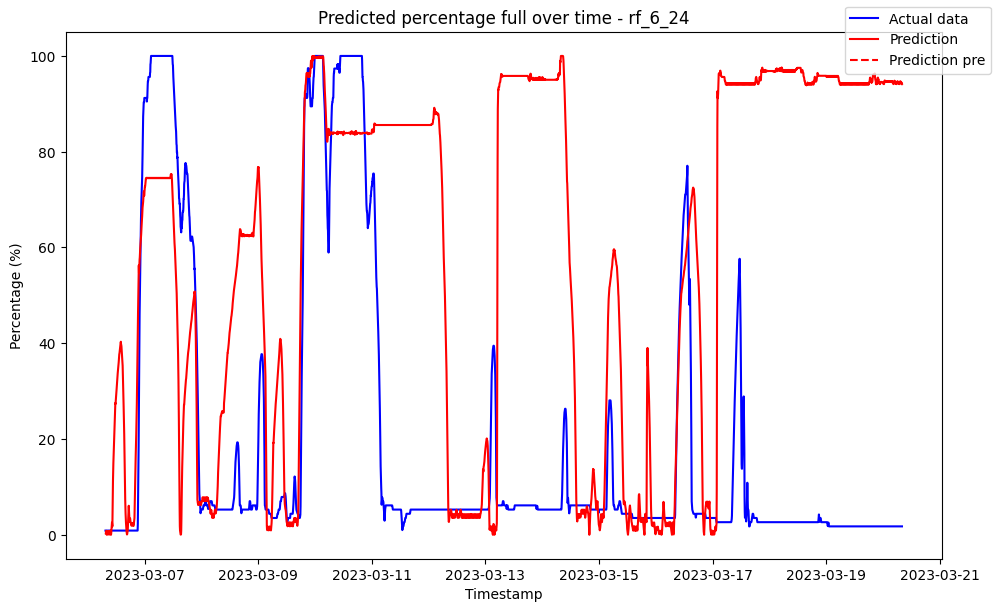

------------------------------------ rf_6_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07686826162173639
Variance (R²) score: 1.00


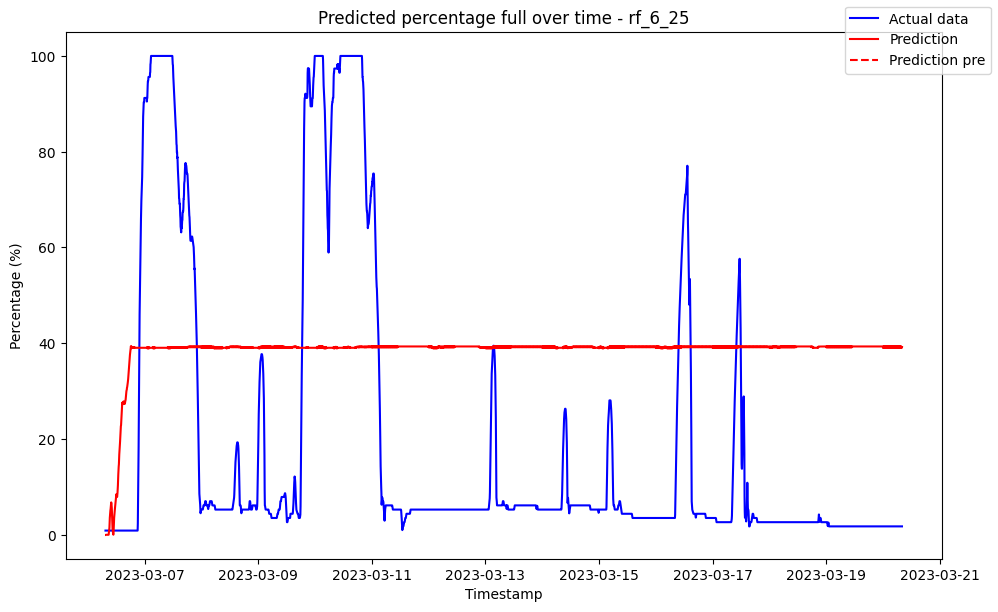

------------------------------------ rf_6_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10124815776238405
Variance (R²) score: 1.00


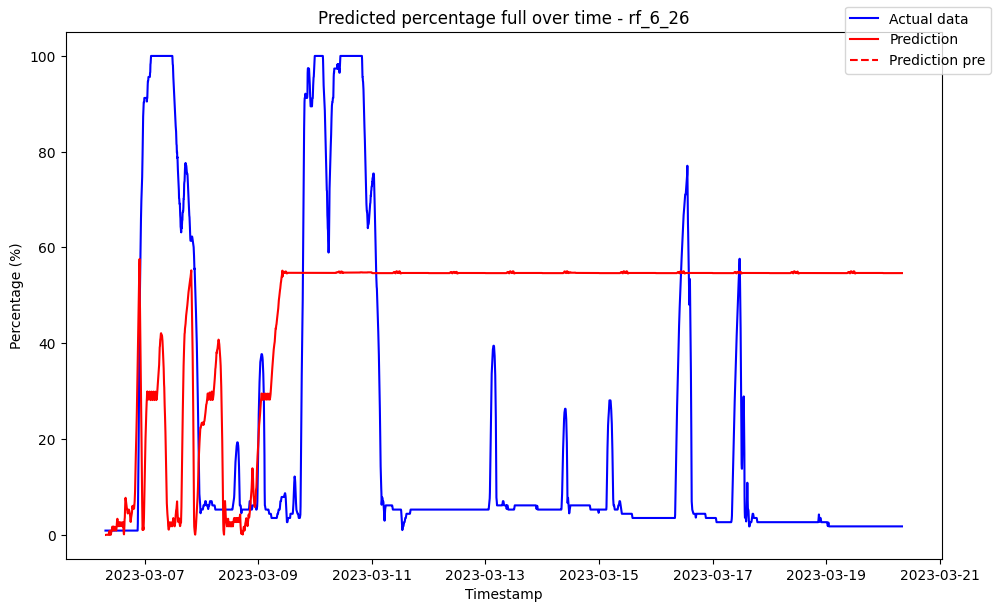

------------------------------------ rf_6_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07654428547900693
Variance (R²) score: 1.00


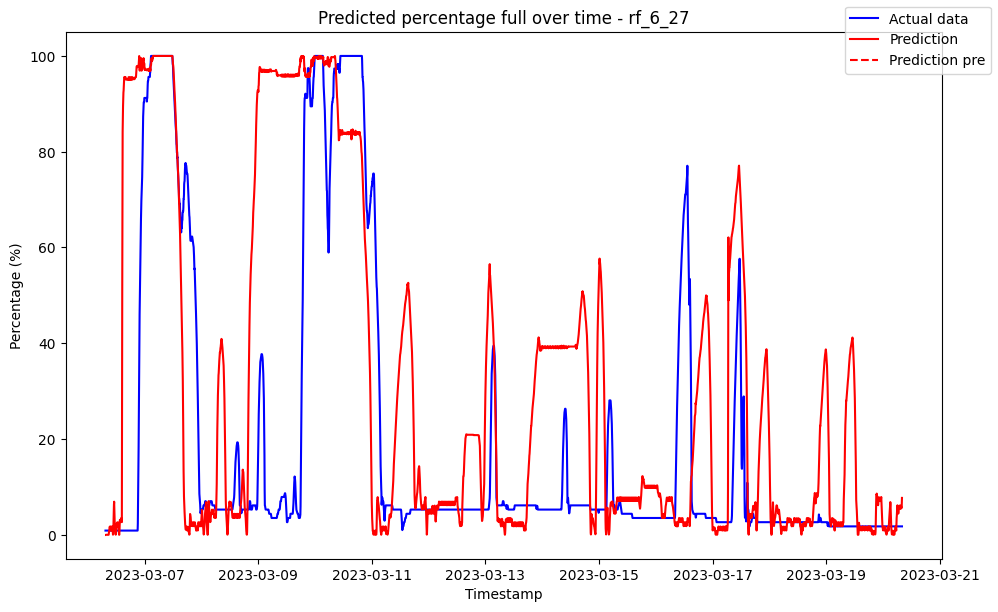

------------------------------------ rf_6_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09010021401747692
Variance (R²) score: 1.00


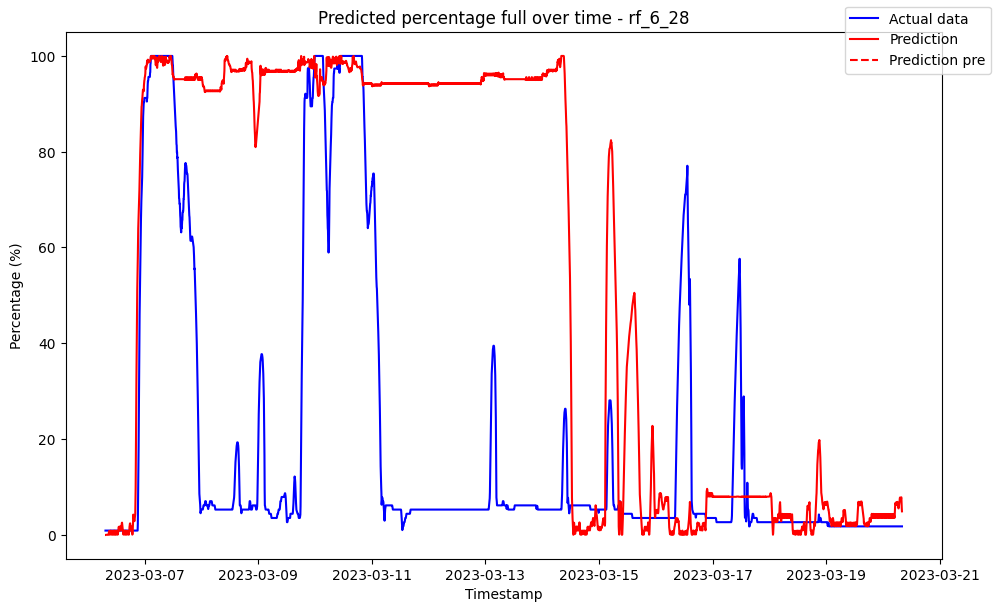

------------------------------------ rf_6_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09888461487012204
Variance (R²) score: 1.00


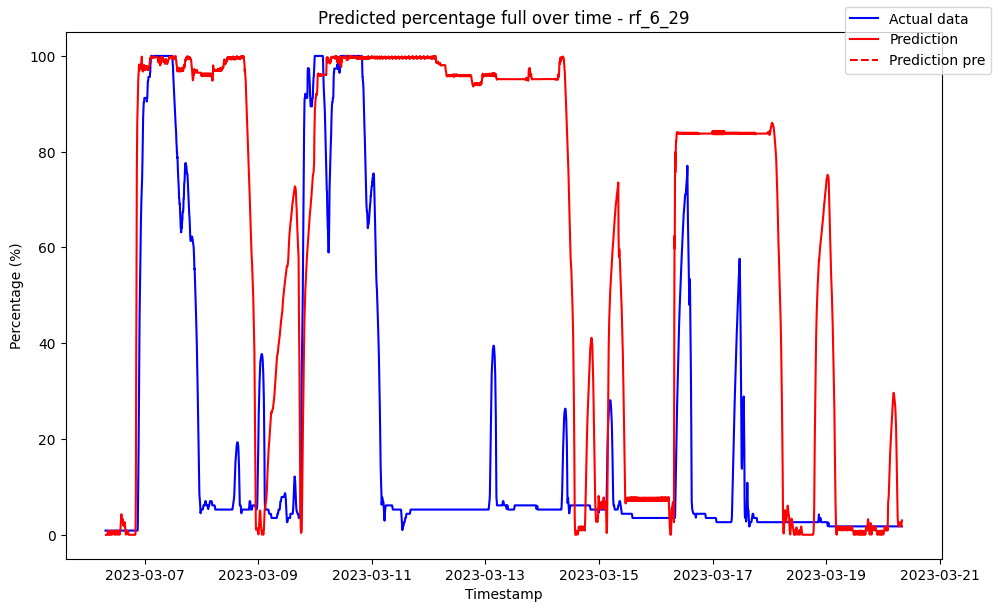

------------------------------------ rf_6_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00             0.33722               0.0
1 2023-03-06 07:35:00             0.33722               0.0
2 2023-03-06 07:40:00             0.33722               0.0
3 2023-03-06 07:45:00             0.33722               0.0
4 2023-03-06 07:50:00             0.33722               0.0
5 2023-03-06 07:55:00             0.33722               0.0

Metrics for this specific prediction:
Accuracy: 99.39%
Mean squared error: 6.249963037013951
Variance (R²) score: 0.99


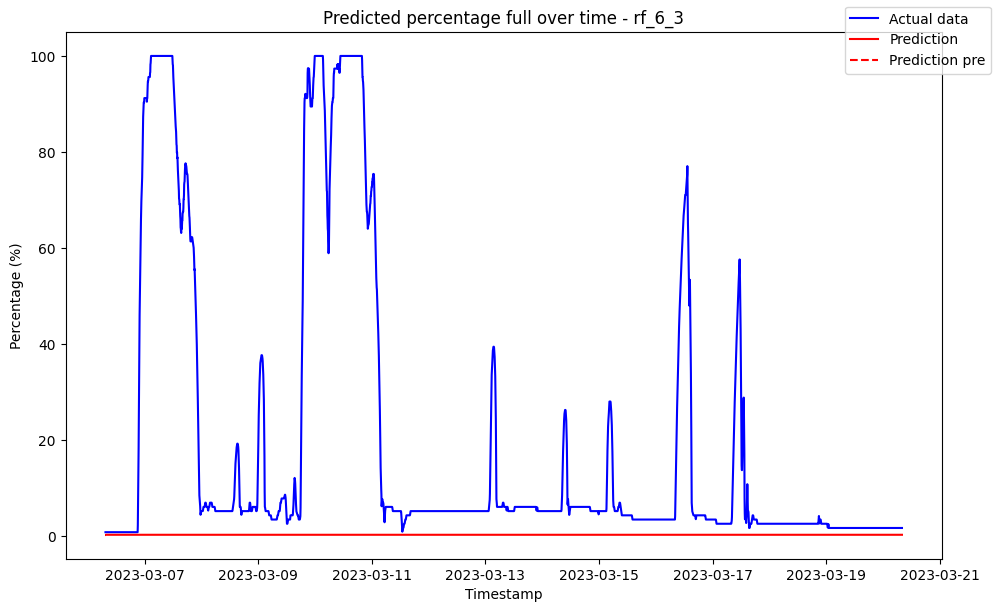

------------------------------------ rf_6_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08476690937148258
Variance (R²) score: 1.00


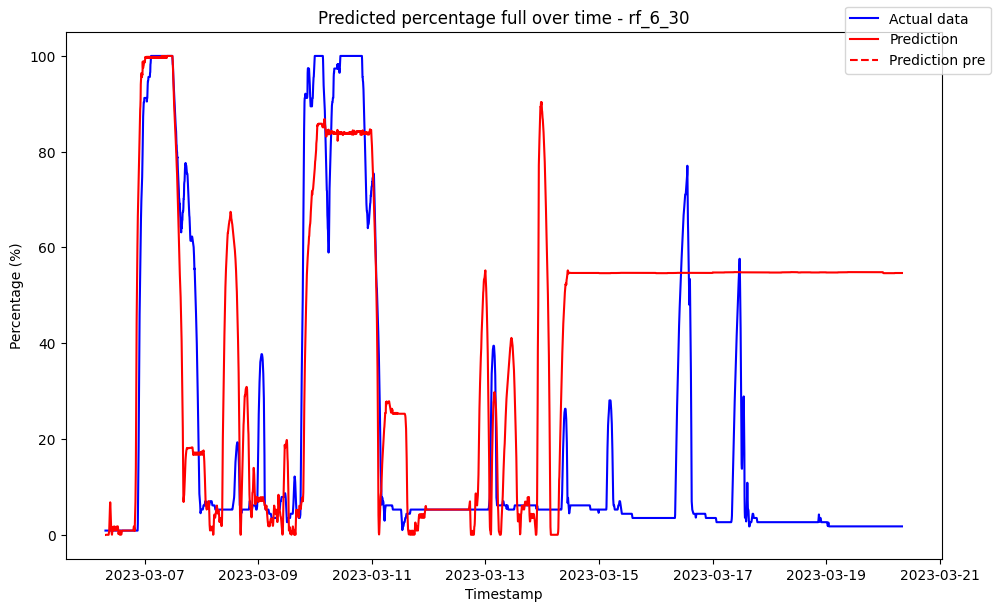

------------------------------------ rf_6_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09257288198175825
Variance (R²) score: 1.00


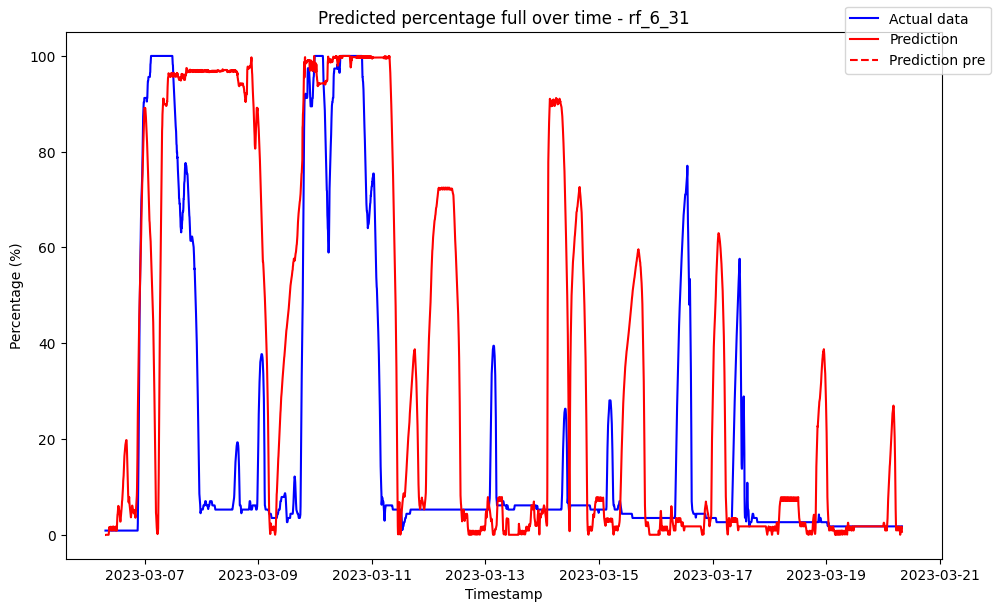

------------------------------------ rf_6_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08132666068067843
Variance (R²) score: 1.00


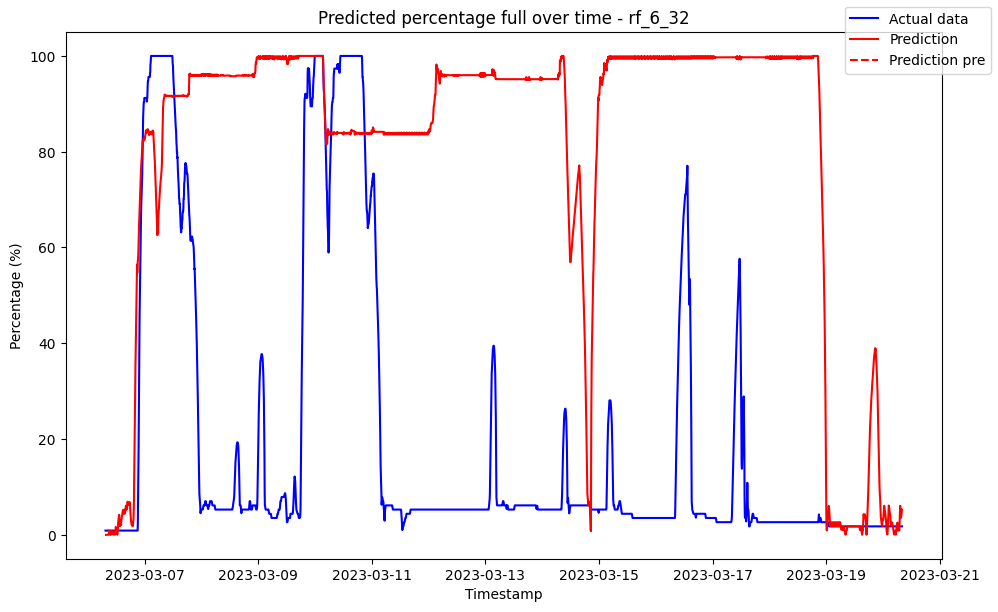

------------------------------------ rf_6_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08954891259072756
Variance (R²) score: 1.00


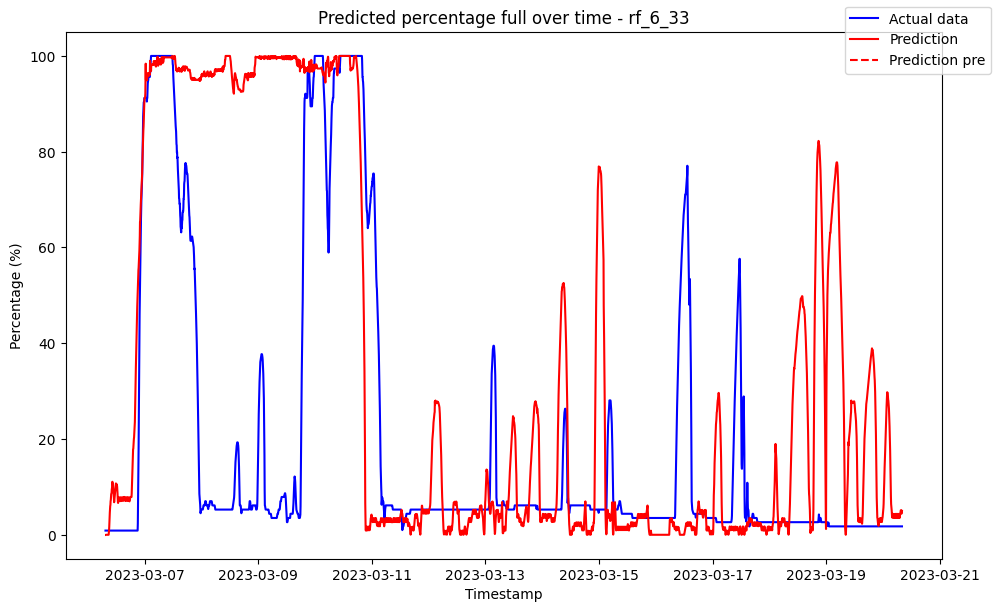

------------------------------------ rf_6_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09339699683652078
Variance (R²) score: 1.00


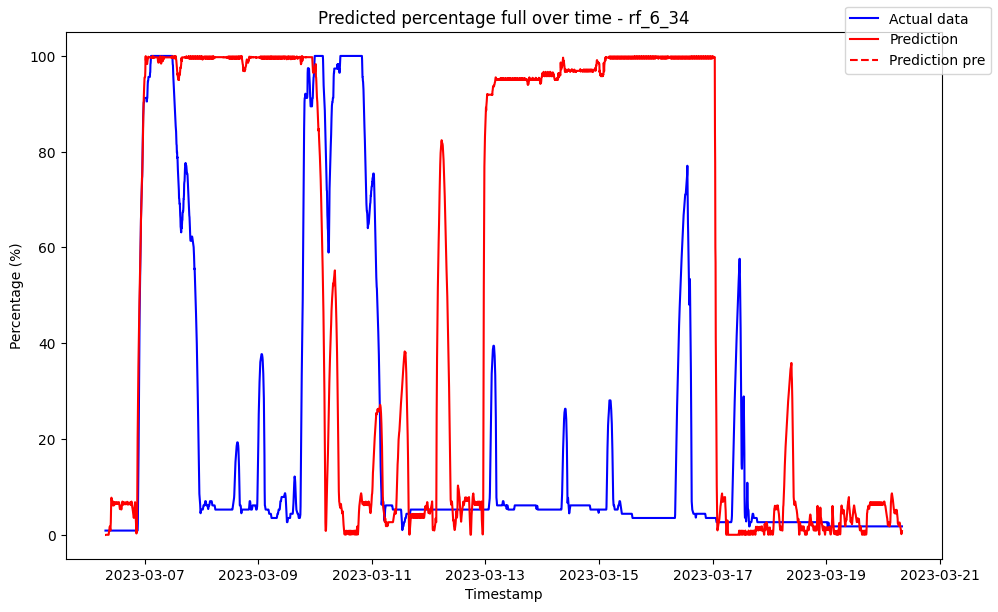

------------------------------------ rf_6_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08658782738524816
Variance (R²) score: 1.00


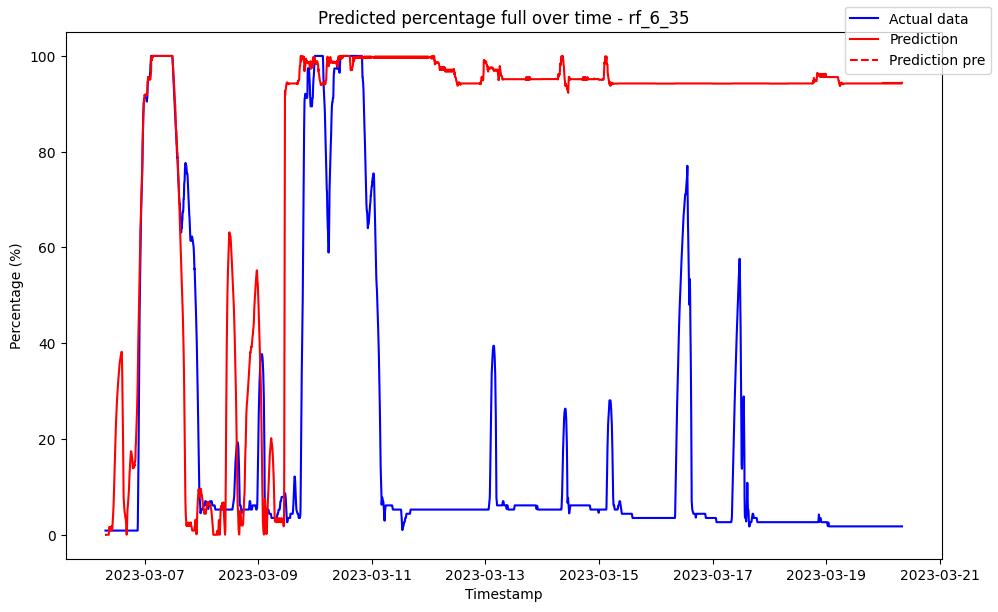

------------------------------------ rf_6_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09932016222908474
Variance (R²) score: 1.00


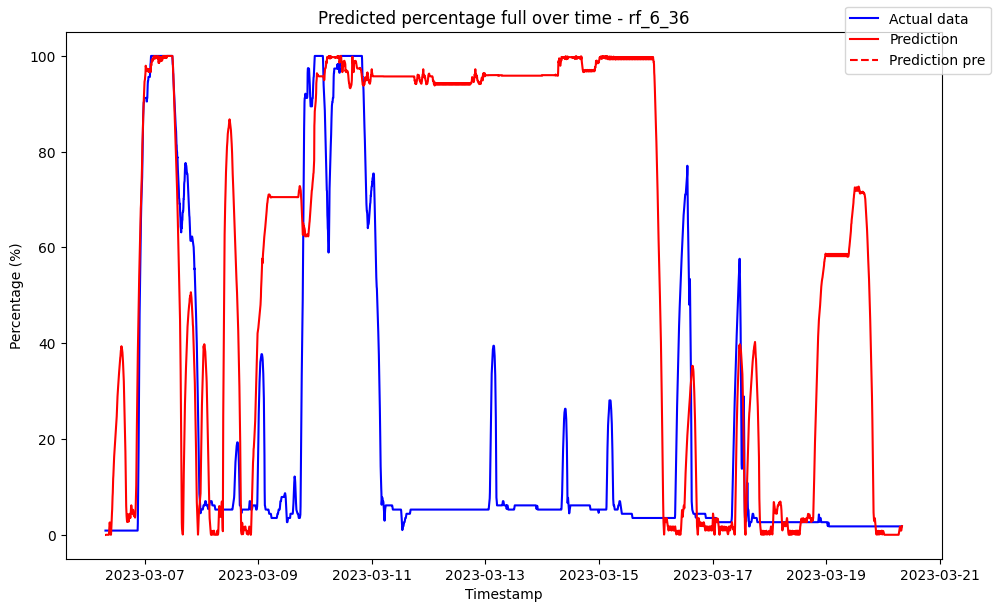

------------------------------------ rf_6_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1019655904524828
Variance (R²) score: 1.00


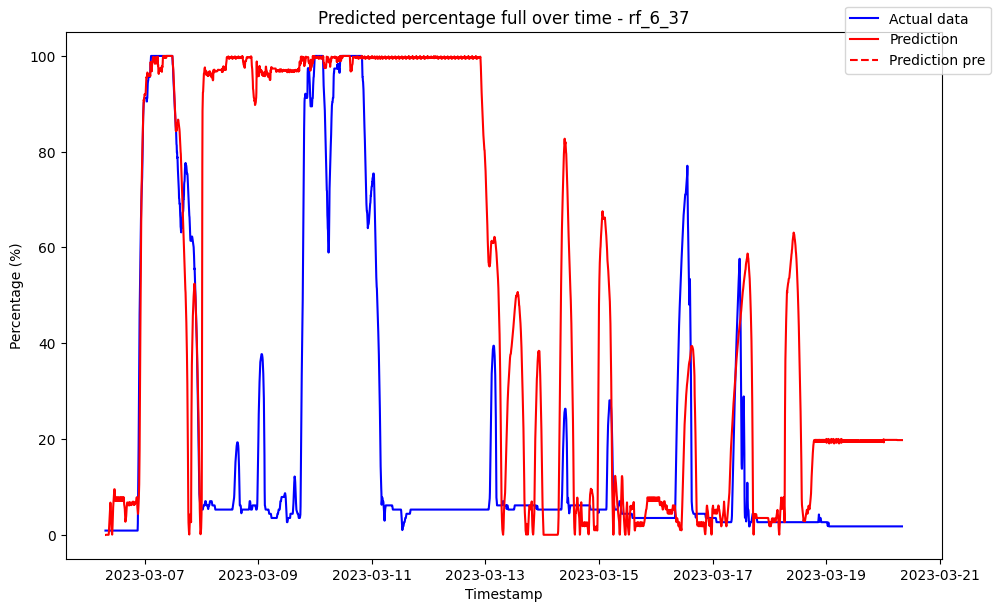

------------------------------------ rf_6_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0779859422114158
Variance (R²) score: 1.00


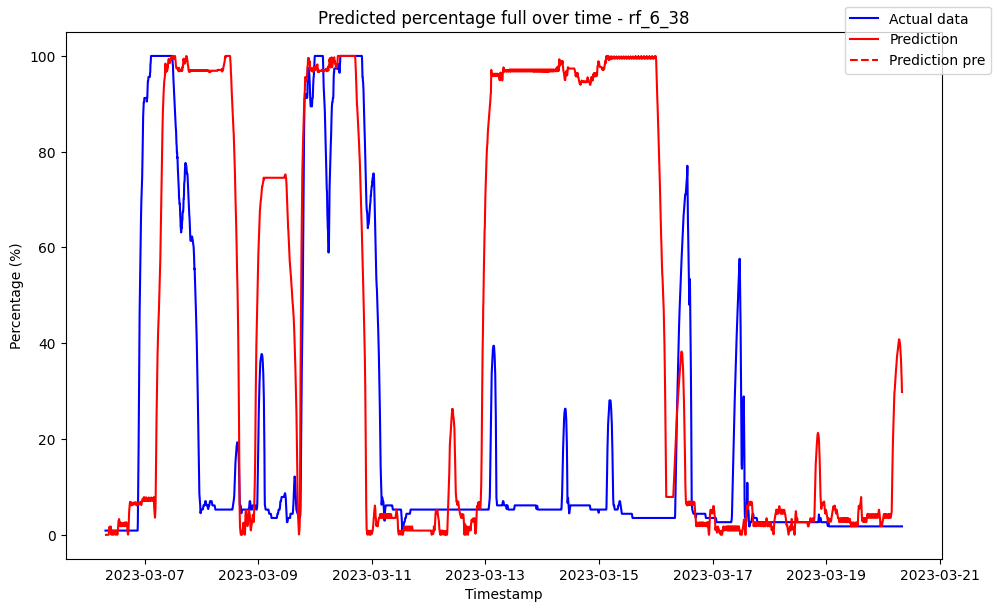

------------------------------------ rf_6_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08908161152832605
Variance (R²) score: 1.00


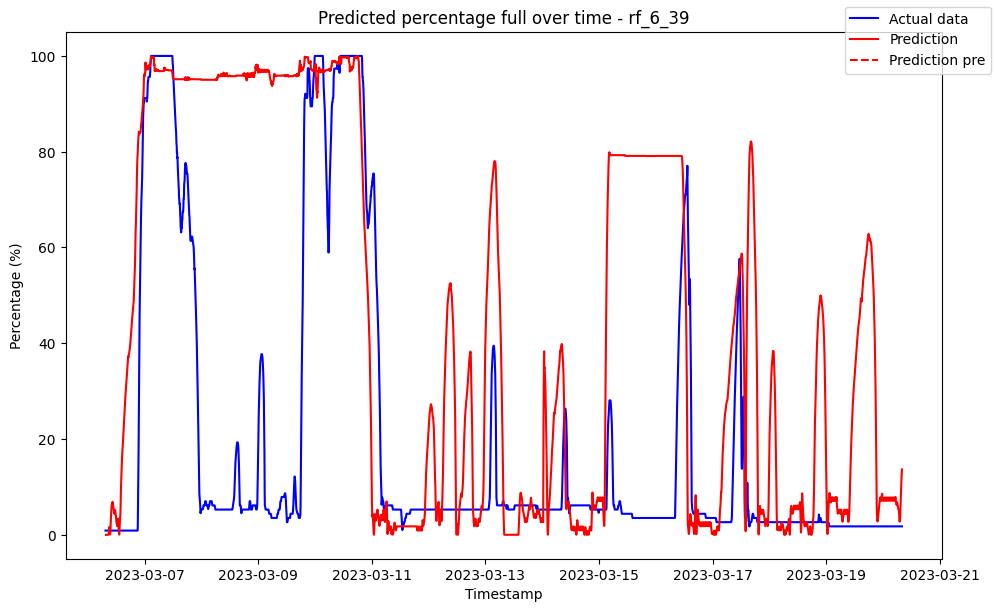

------------------------------------ rf_6_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.018449               0.0
1 2023-03-06 07:35:00            0.018449               0.0
2 2023-03-06 07:40:00            0.018449               0.0
3 2023-03-06 07:45:00            0.018449               0.0
4 2023-03-06 07:50:00            0.018449               0.0
5 2023-03-06 07:55:00            0.018449               0.0

Metrics for this specific prediction:
Accuracy: 99.79%
Mean squared error: 2.174353956817552
Variance (R²) score: 1.00


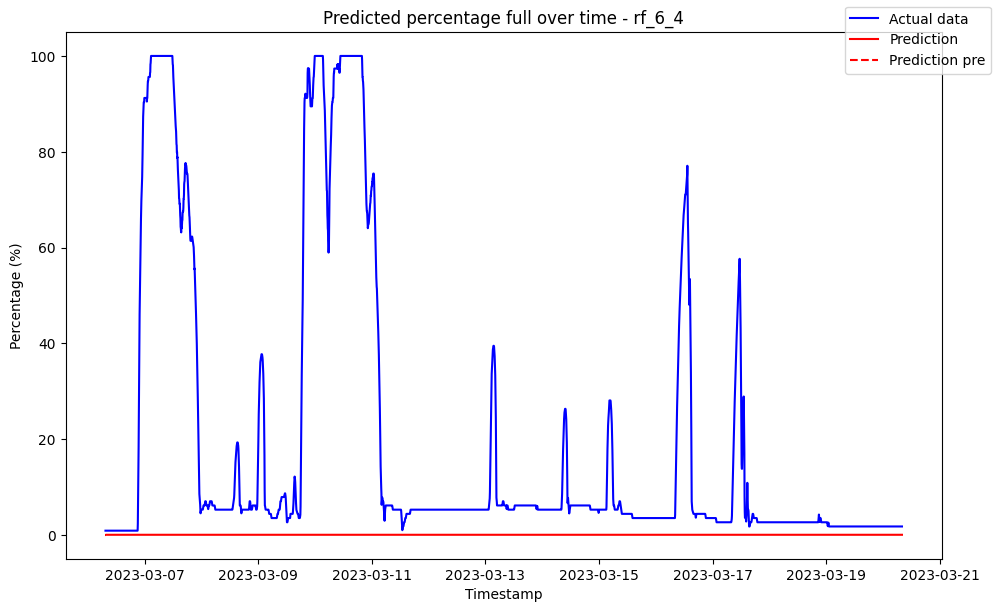

------------------------------------ rf_6_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08181016579192996
Variance (R²) score: 1.00


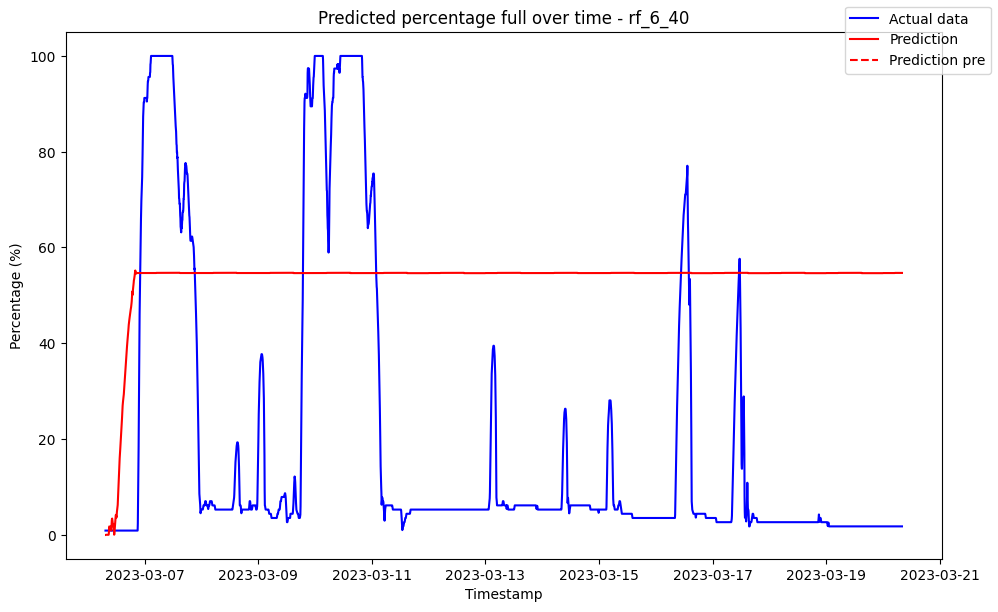

------------------------------------ rf_6_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08528218748215362
Variance (R²) score: 1.00


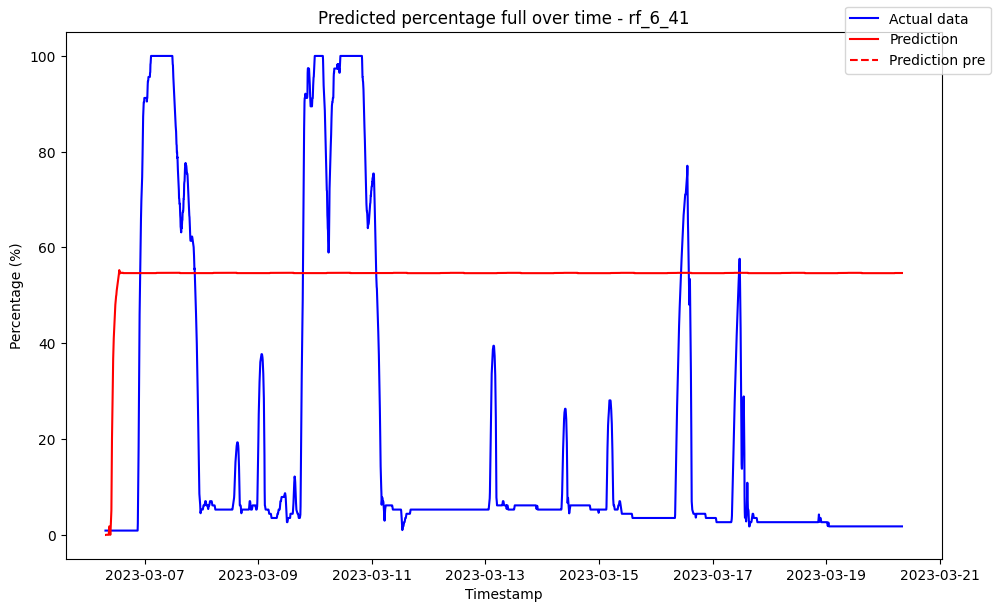

------------------------------------ rf_6_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07543507374495055
Variance (R²) score: 1.00


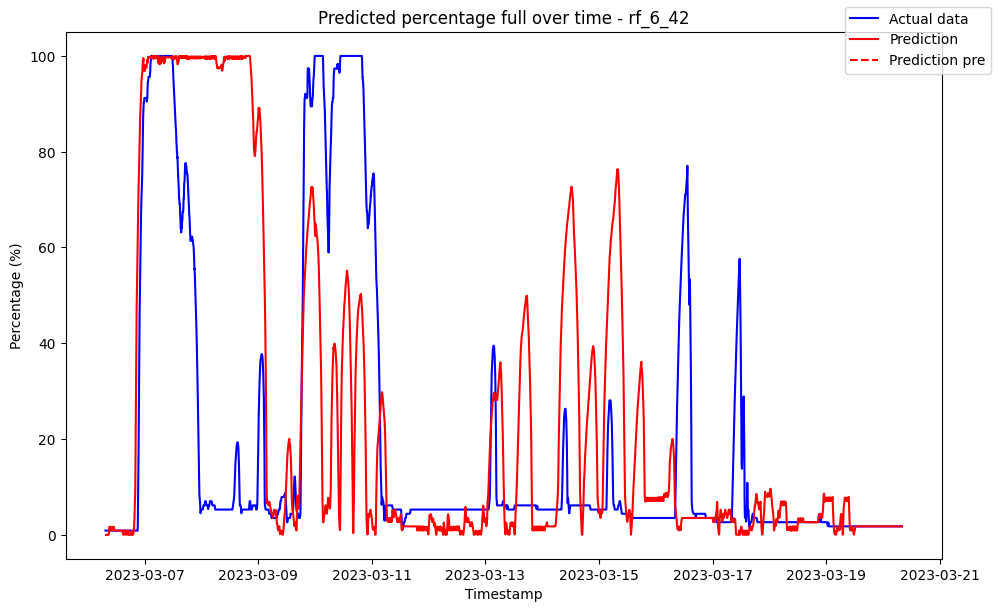

------------------------------------ rf_6_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09554827084818357
Variance (R²) score: 1.00


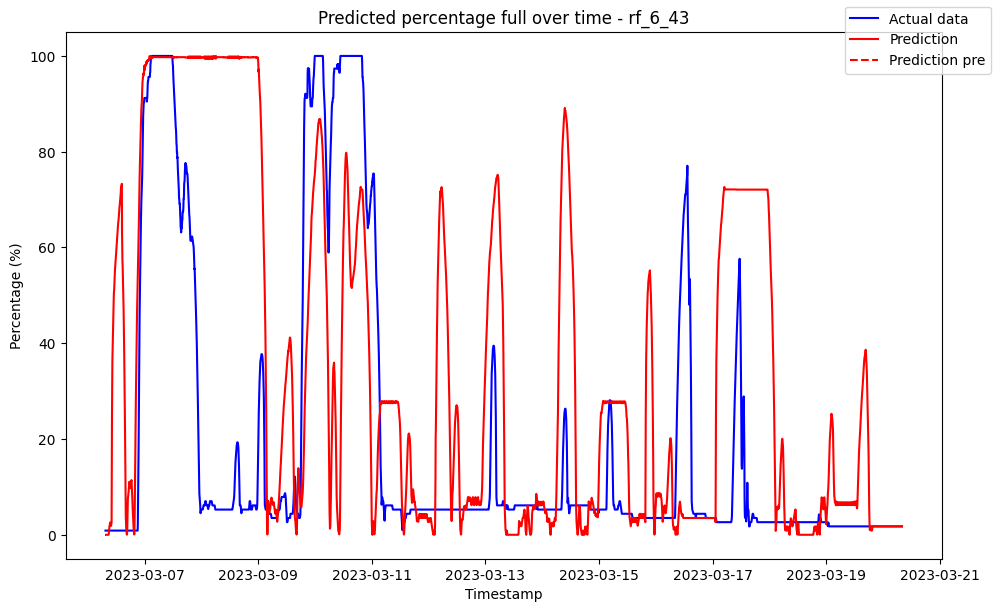

------------------------------------ rf_6_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.092090371889555
Variance (R²) score: 1.00


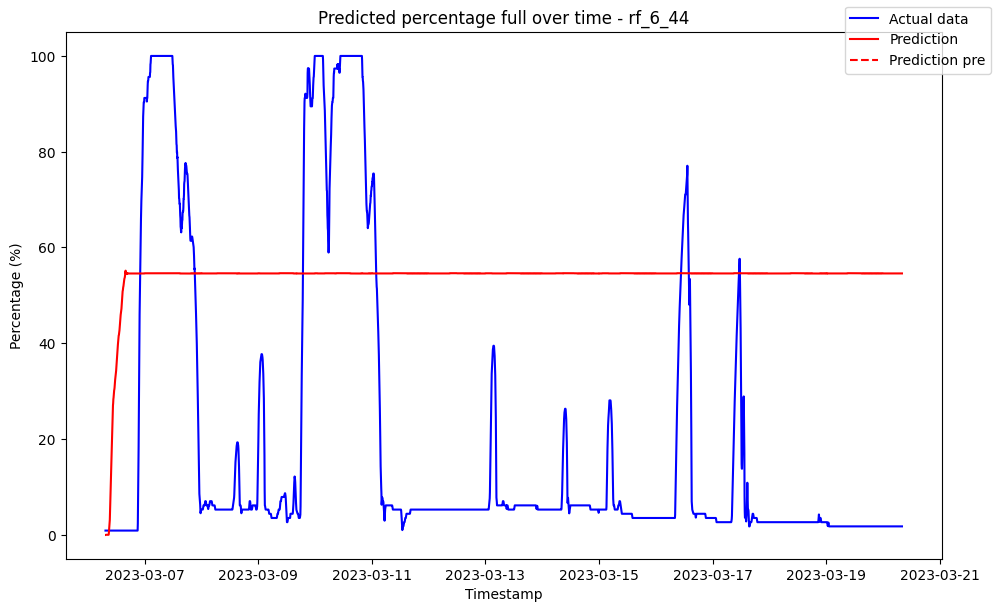

------------------------------------ rf_6_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08072095857739825
Variance (R²) score: 1.00


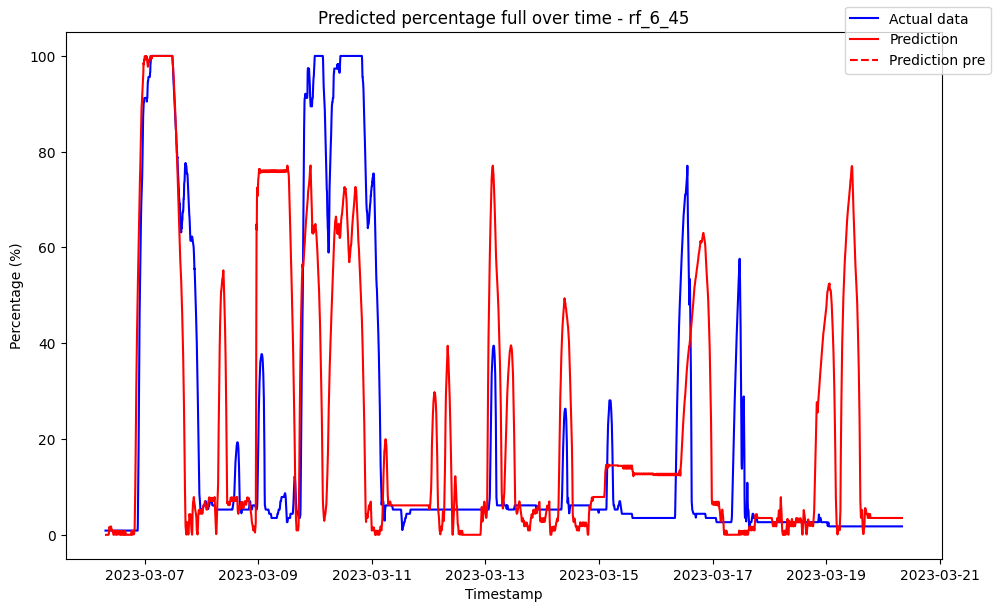

------------------------------------ rf_6_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07150162377484925
Variance (R²) score: 1.00


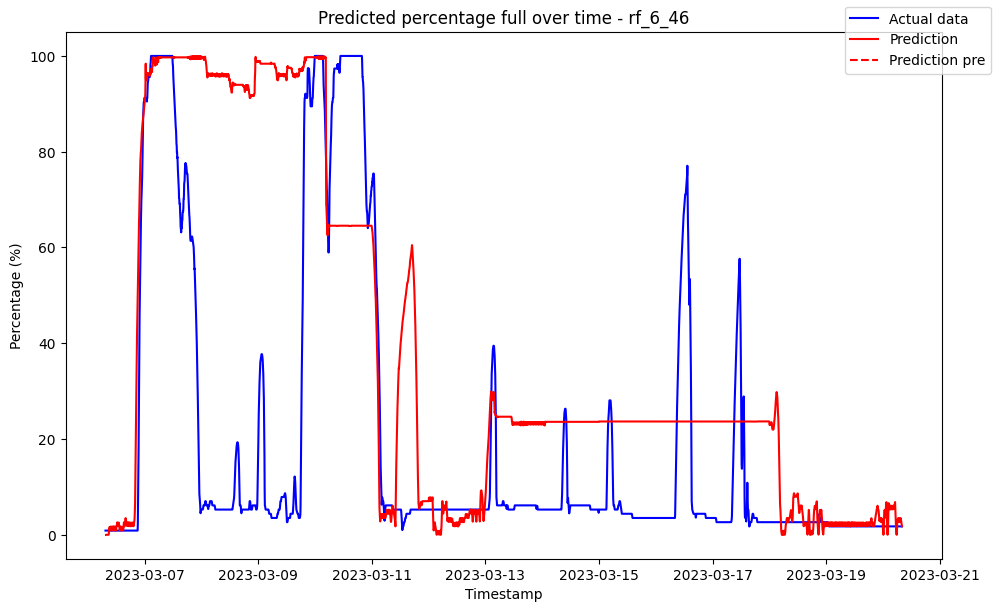

------------------------------------ rf_6_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09748564377693271
Variance (R²) score: 1.00


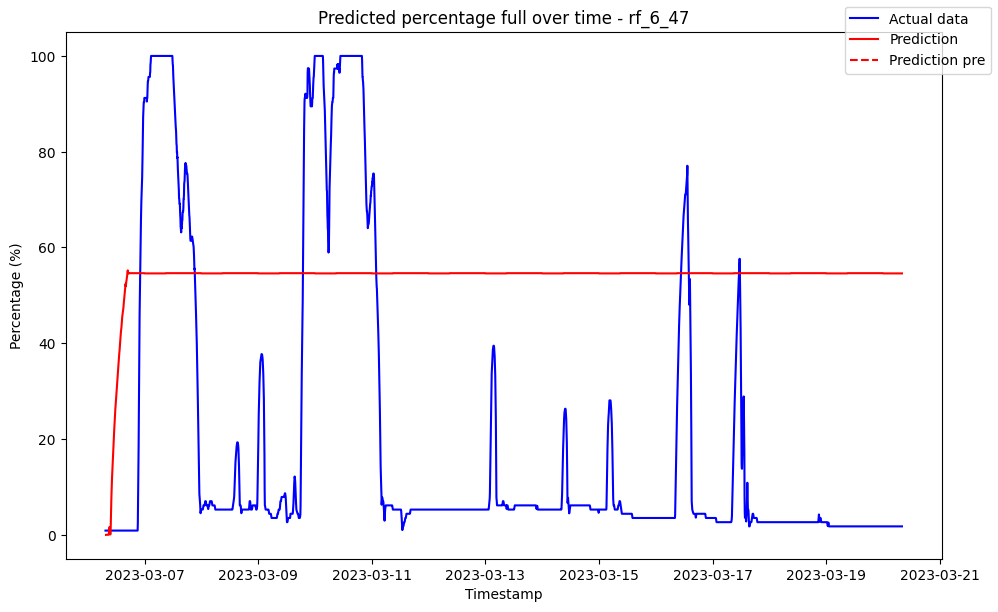

------------------------------------ rf_6_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08979016447848863
Variance (R²) score: 1.00


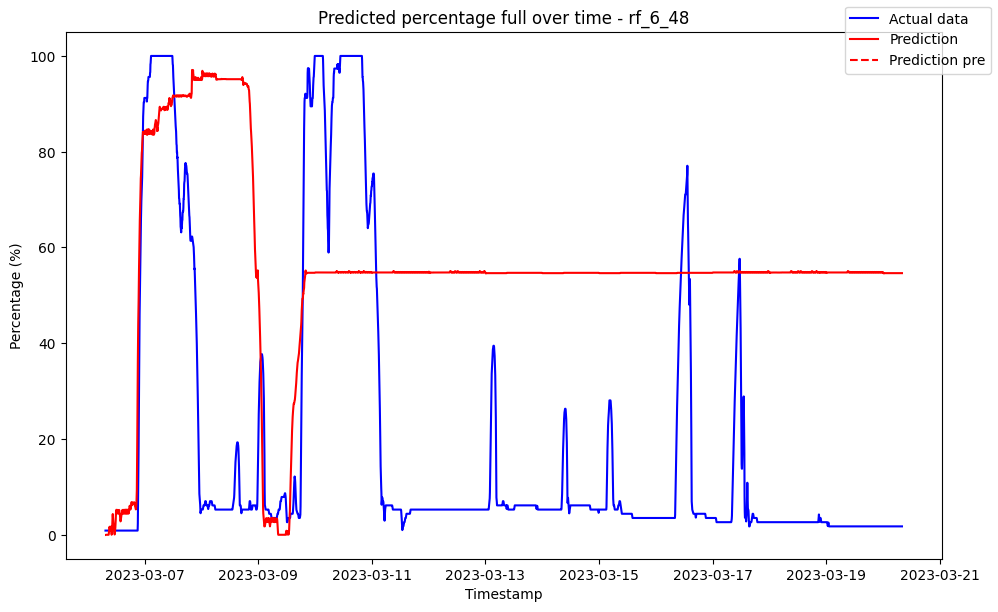

------------------------------------ rf_6_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08808656792579063
Variance (R²) score: 1.00


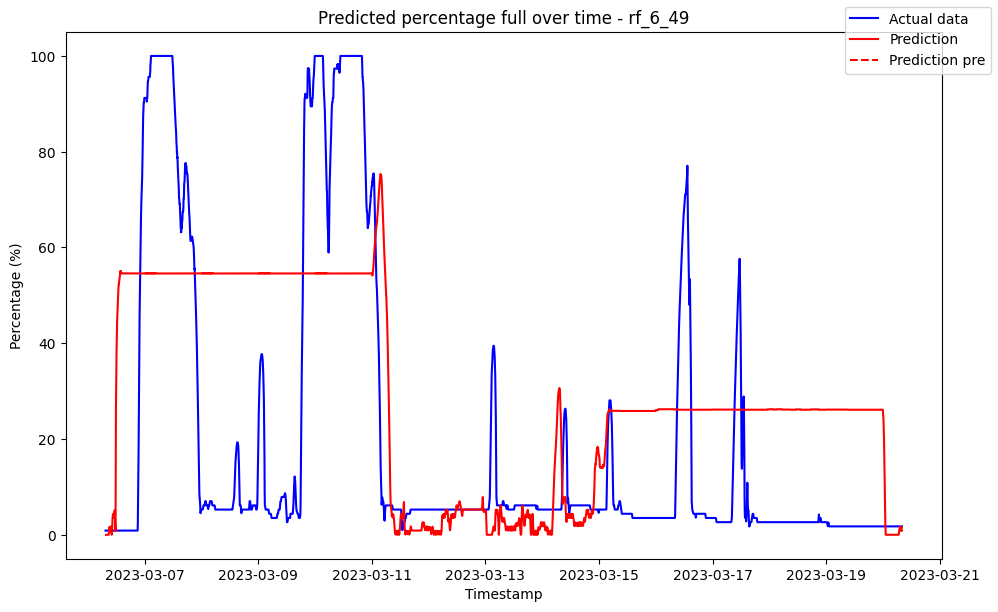

------------------------------------ rf_6_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.016851               0.0
1 2023-03-06 07:35:00            0.016851               0.0
2 2023-03-06 07:40:00            0.016851               0.0
3 2023-03-06 07:45:00            0.016851               0.0
4 2023-03-06 07:50:00            0.016851               0.0
5 2023-03-06 07:55:00            0.016851               0.0

Metrics for this specific prediction:
Accuracy: 99.92%
Mean squared error: 0.845064183525569
Variance (R²) score: 1.00


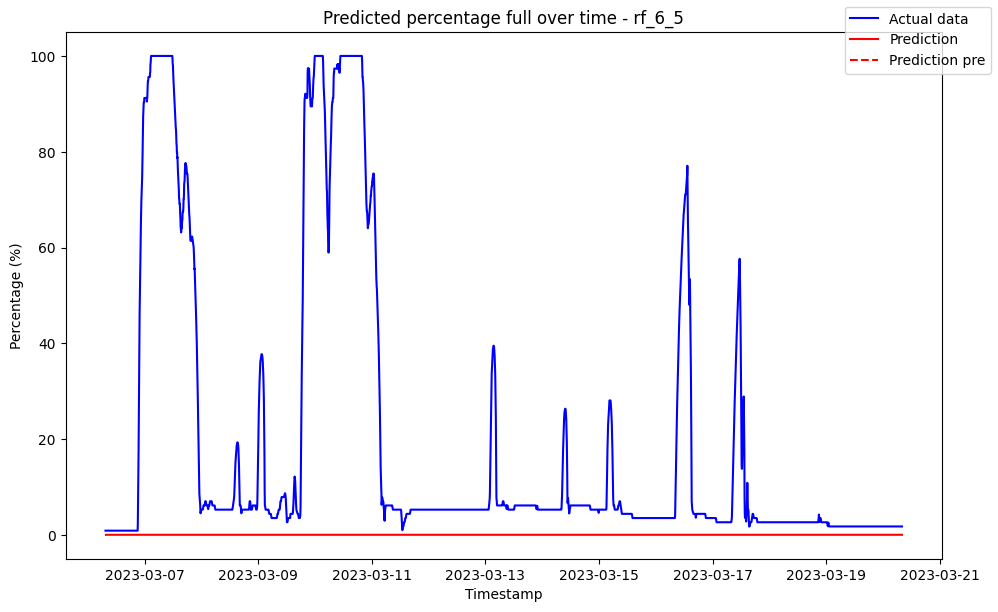

------------------------------------ rf_6_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08844633029897235
Variance (R²) score: 1.00


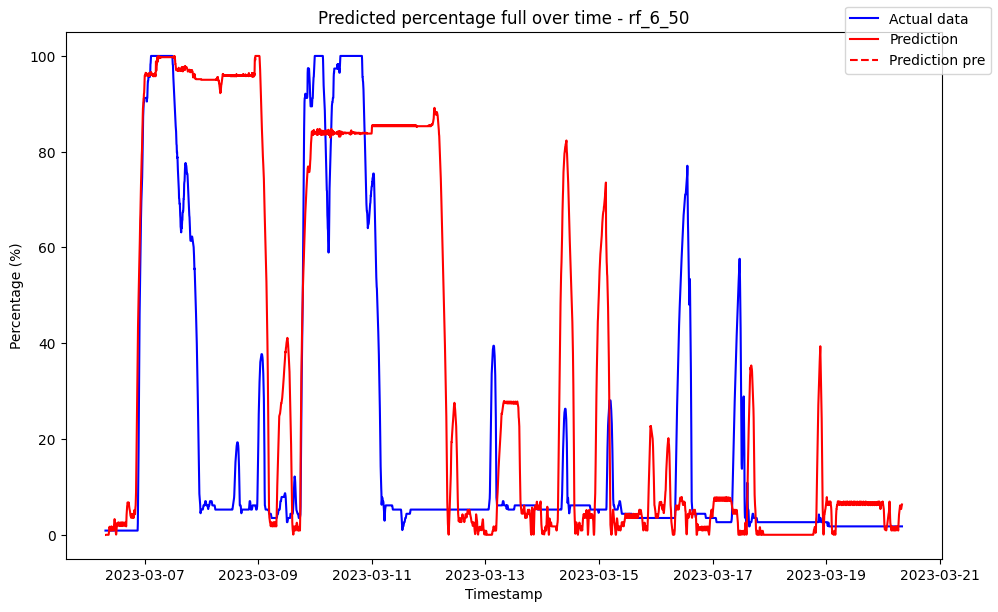

------------------------------------ rf_6_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010809               0.0
1 2023-03-06 07:35:00            0.118893               0.0
2 2023-03-06 07:40:00            0.264420               0.0
3 2023-03-06 07:45:00            0.264420               0.0
4 2023-03-06 07:50:00            0.264420               0.0
5 2023-03-06 07:55:00            0.264420               0.0

Metrics for this specific prediction:
Accuracy: 99.94%
Mean squared error: 0.6219233084972337
Variance (R²) score: 1.00


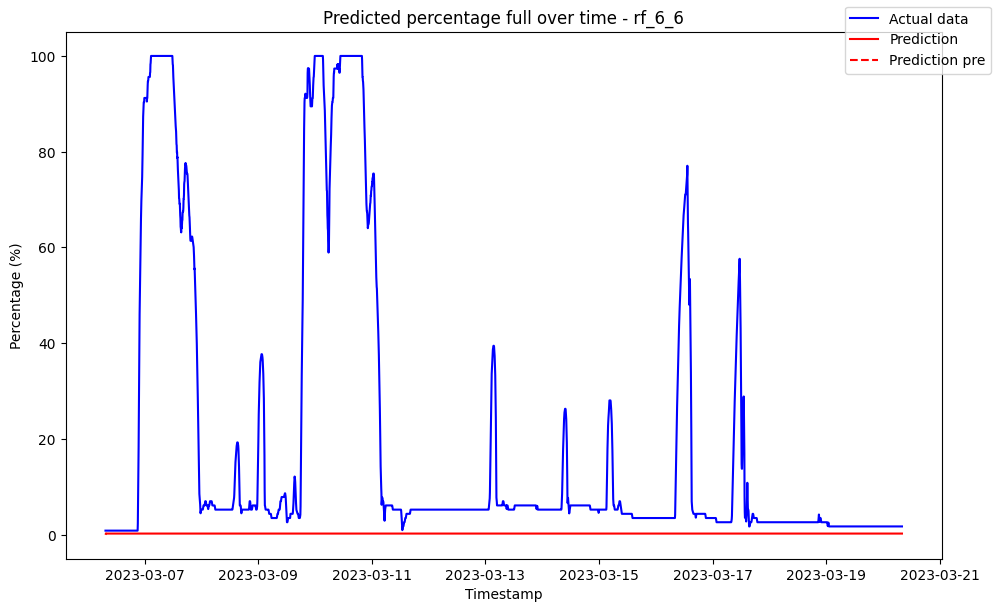

------------------------------------ rf_6_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007082               0.0
1 2023-03-06 07:35:00            0.161143               0.0
2 2023-03-06 07:40:00            0.576049               0.0
3 2023-03-06 07:45:00            0.703196               0.0
4 2023-03-06 07:50:00            0.800801               0.0
5 2023-03-06 07:55:00            0.833234               0.0

Metrics for this specific prediction:
Accuracy: 99.95%
Mean squared error: 0.4689930351436209
Variance (R²) score: 1.00


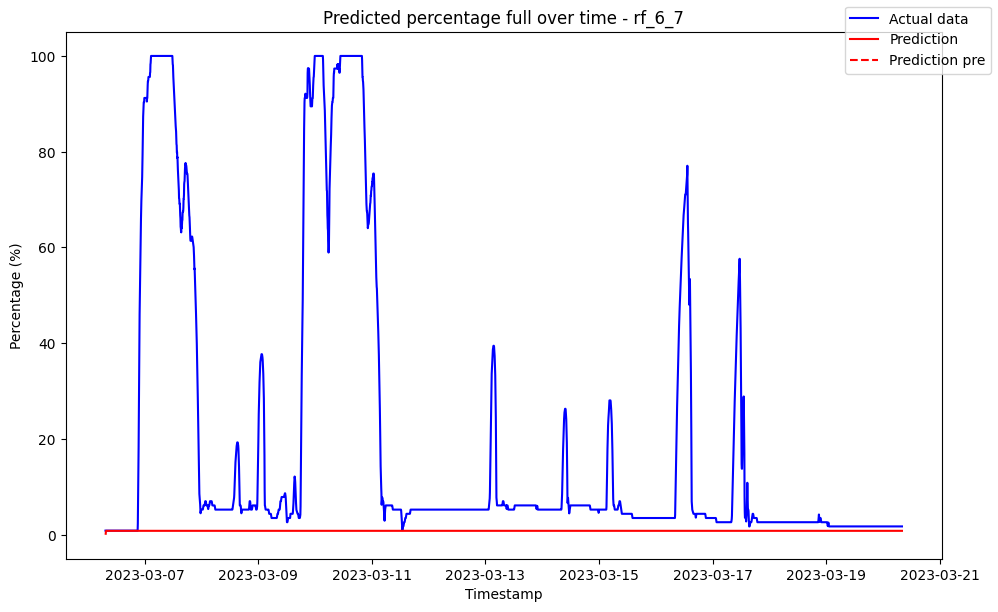

------------------------------------ rf_6_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006242               0.0
1 2023-03-06 07:35:00            0.199901               0.0
2 2023-03-06 07:40:00            0.596396               0.0
3 2023-03-06 07:45:00            0.774734               0.0
4 2023-03-06 07:50:00            0.737192               0.0
5 2023-03-06 07:55:00            0.646833               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.34328712033167075
Variance (R²) score: 1.00


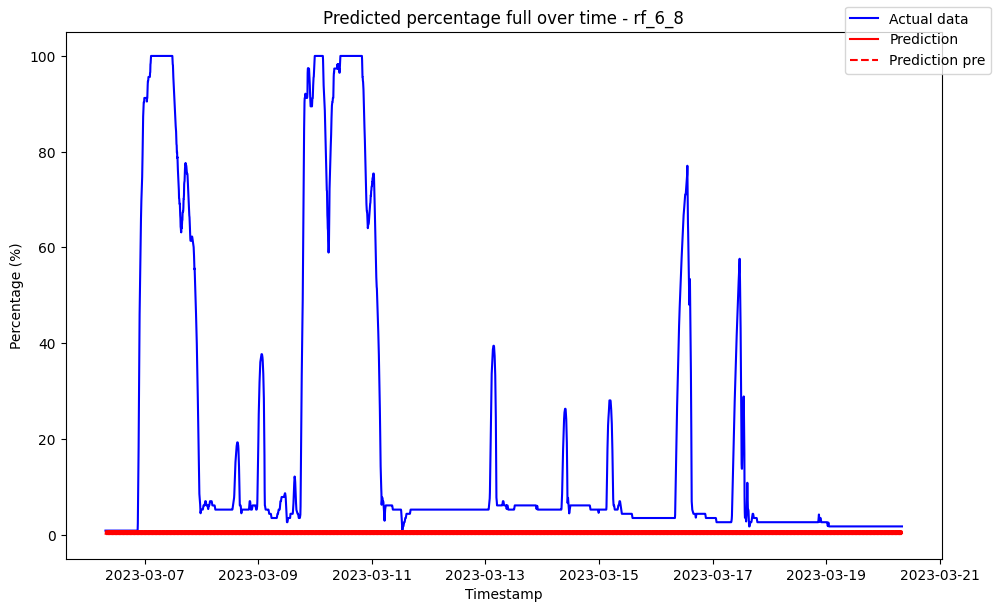

------------------------------------ rf_6_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.021738               0.0
1 2023-03-06 07:35:00            0.397995               0.0
2 2023-03-06 07:40:00            0.710176               0.0
3 2023-03-06 07:45:00            0.833248               0.0
4 2023-03-06 07:50:00            0.798506               0.0
5 2023-03-06 07:55:00            0.798506               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.2539840090006414
Variance (R²) score: 1.00


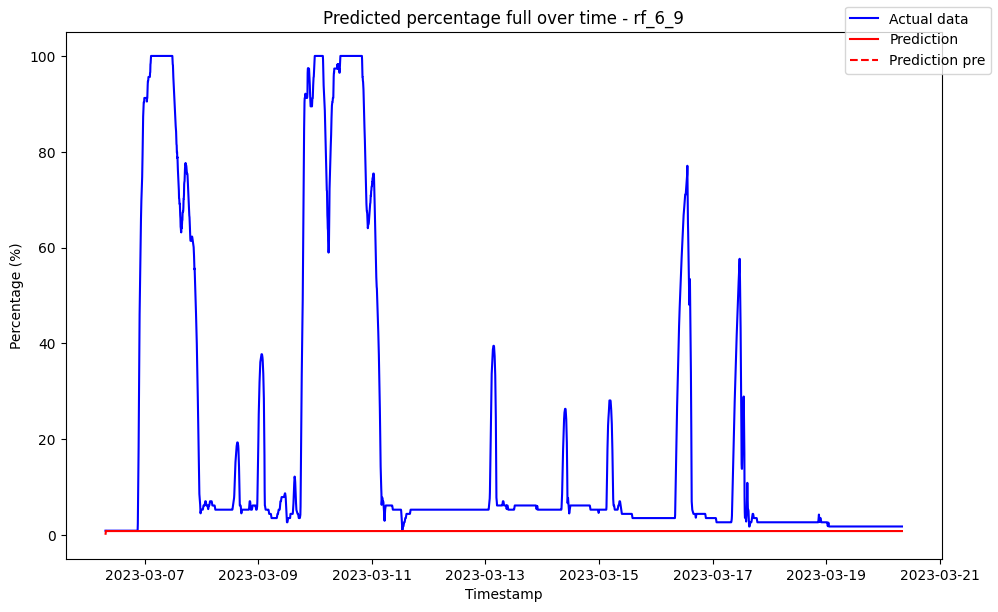

------------------------------------ rf_7_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.531593               0.0
1 2023-03-06 07:35:00            3.531593               0.0
2 2023-03-06 07:40:00            3.531593               0.0
3 2023-03-06 07:45:00            3.531593               0.0
4 2023-03-06 07:50:00            3.531593               0.0
5 2023-03-06 07:55:00            3.531593               0.0

Metrics for this specific prediction:
Accuracy: 89.46%
Mean squared error: 107.60814141192847
Variance (R²) score: 0.89


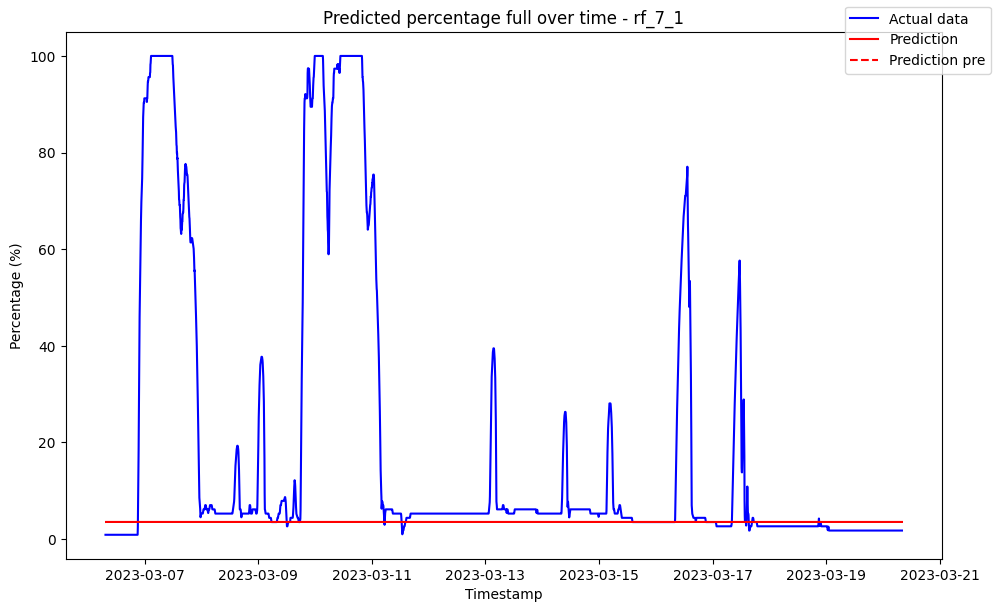

------------------------------------ rf_7_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.032885               0.0
1 2023-03-06 07:35:00            0.357334               0.0
2 2023-03-06 07:40:00            0.703140               0.0
3 2023-03-06 07:45:00            0.771166               0.0
4 2023-03-06 07:50:00            0.604583               0.0
5 2023-03-06 07:55:00            0.323711               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.19908847358213988
Variance (R²) score: 1.00


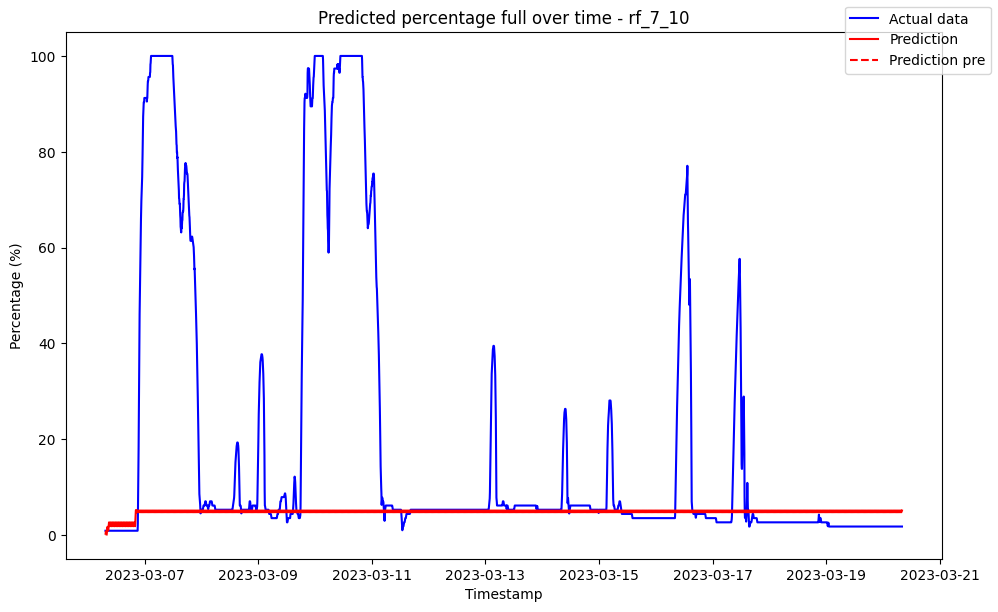

------------------------------------ rf_7_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.021916               0.0
1 2023-03-06 07:35:00            0.334744               0.0
2 2023-03-06 07:40:00            0.653729               0.0
3 2023-03-06 07:45:00            0.838804               0.0
4 2023-03-06 07:50:00            0.649306               0.0
5 2023-03-06 07:55:00            0.371306               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14473462129996198
Variance (R²) score: 1.00


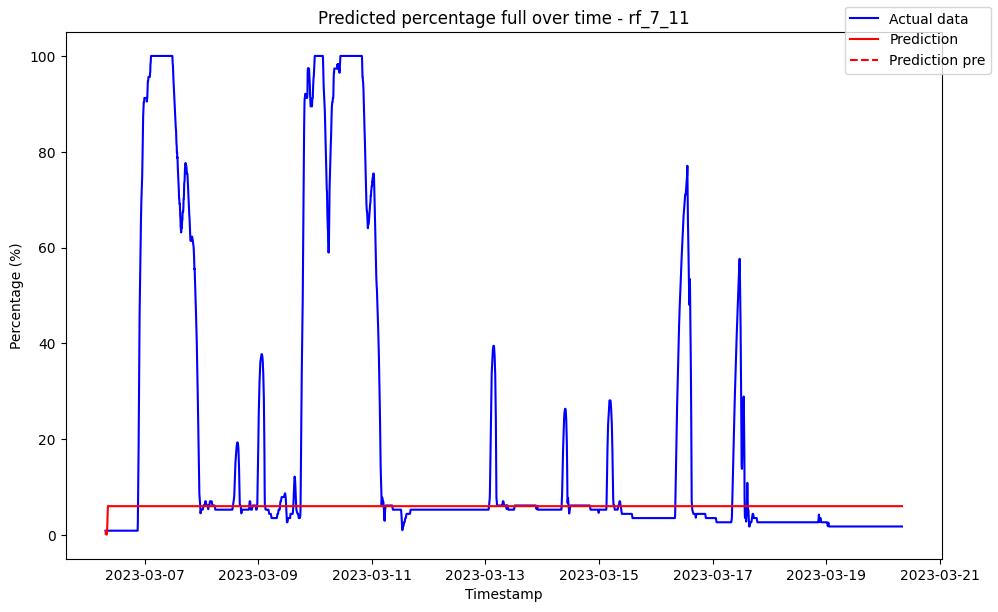

------------------------------------ rf_7_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.014626               0.0
1 2023-03-06 07:35:00            0.172488               0.0
2 2023-03-06 07:40:00            0.511903               0.0
3 2023-03-06 07:45:00            0.777311               0.0
4 2023-03-06 07:50:00            0.847338               0.0
5 2023-03-06 07:55:00            0.575092               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12011242351066657
Variance (R²) score: 1.00


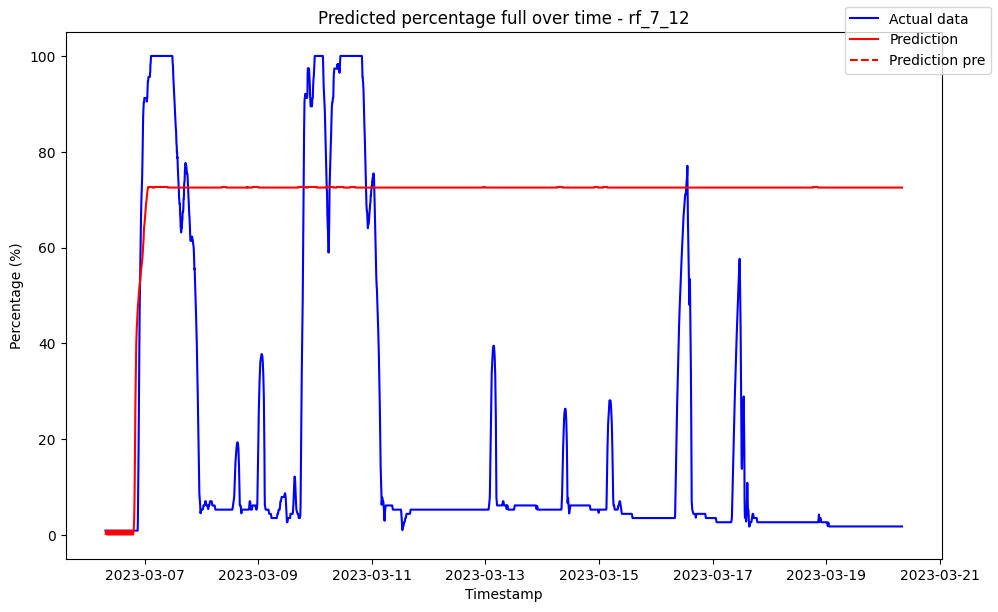

------------------------------------ rf_7_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013806               0.0
1 2023-03-06 07:35:00            0.149901               0.0
2 2023-03-06 07:40:00            0.492091               0.0
3 2023-03-06 07:45:00            0.778269               0.0
4 2023-03-06 07:50:00            0.837689               0.0
5 2023-03-06 07:55:00            0.536857               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11040730177092653
Variance (R²) score: 1.00


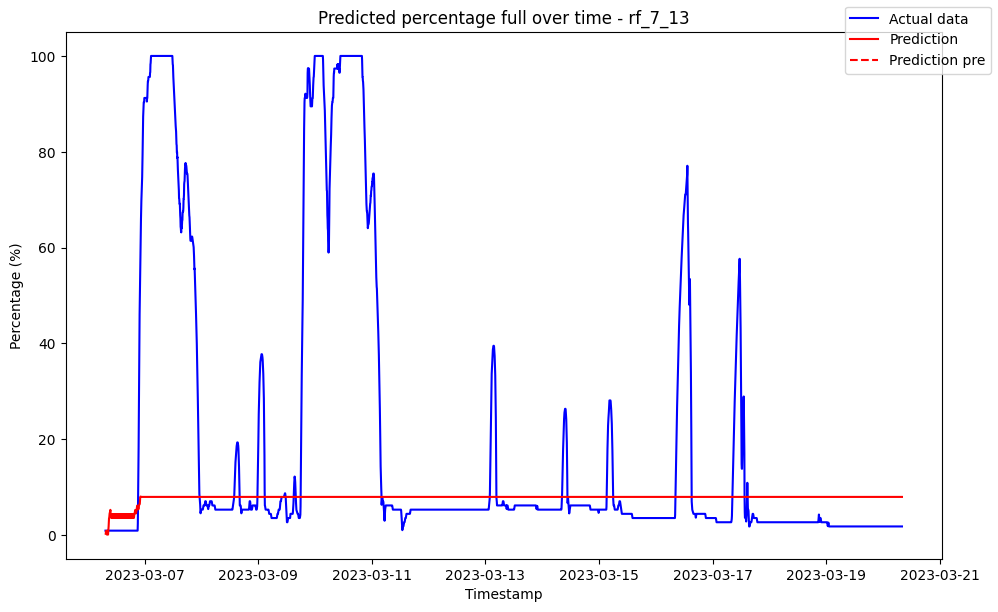

------------------------------------ rf_7_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013680               0.0
1 2023-03-06 07:35:00            0.151534               0.0
2 2023-03-06 07:40:00            0.512094               0.0
3 2023-03-06 07:45:00            0.780793               0.0
4 2023-03-06 07:50:00            0.844329               0.0
5 2023-03-06 07:55:00            0.748942               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10075451951157856
Variance (R²) score: 1.00


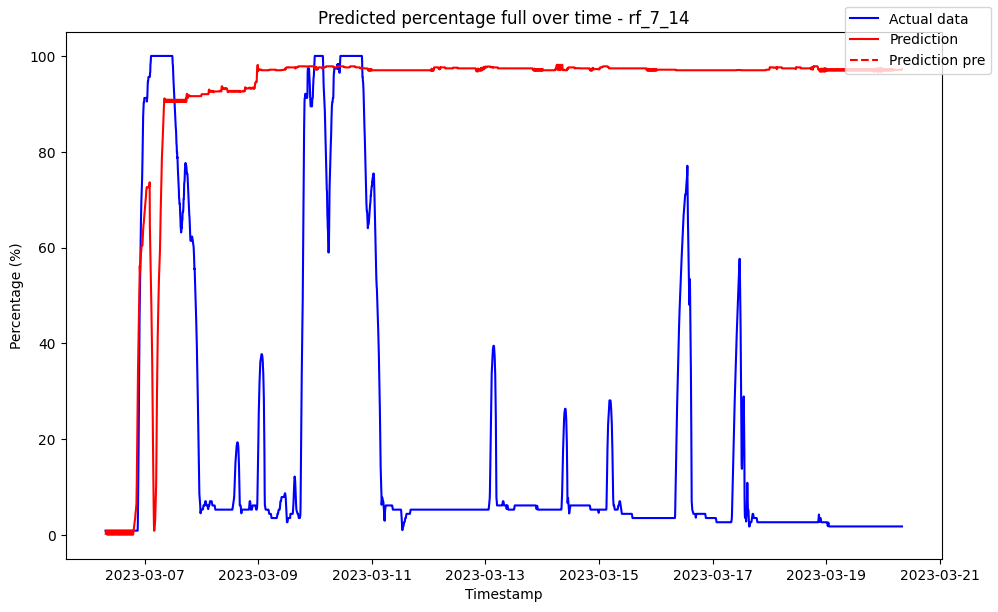

------------------------------------ rf_7_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009460               0.0
1 2023-03-06 07:35:00            0.139193               0.0
2 2023-03-06 07:40:00            0.508268               0.0
3 2023-03-06 07:45:00            0.772017               0.0
4 2023-03-06 07:50:00            0.823201               0.0
5 2023-03-06 07:55:00            0.528002               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08714695946575905
Variance (R²) score: 1.00


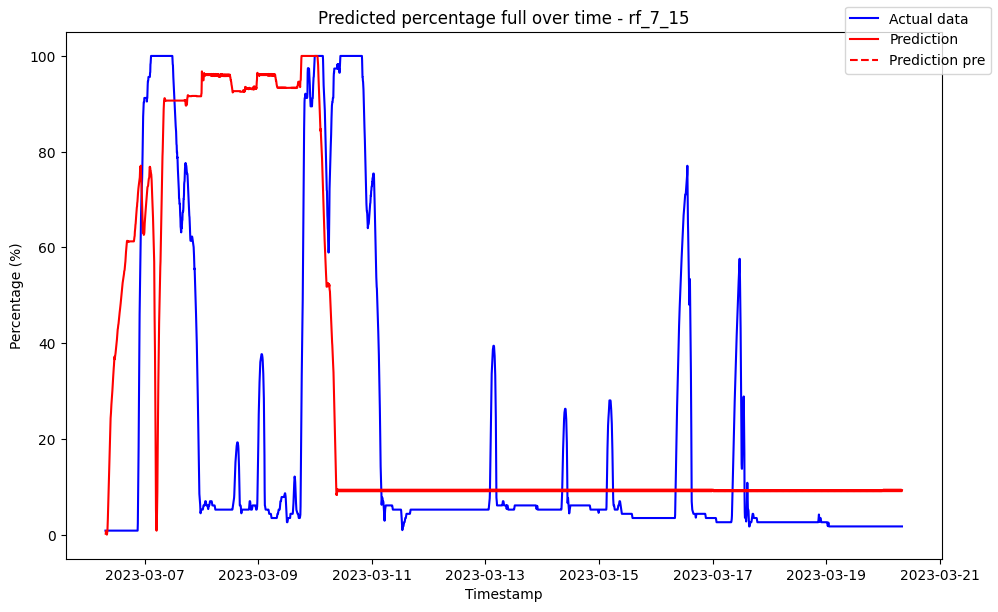

------------------------------------ rf_7_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009596               0.0
1 2023-03-06 07:35:00            0.142843               0.0
2 2023-03-06 07:40:00            0.474003               0.0
3 2023-03-06 07:45:00            0.762878               0.0
4 2023-03-06 07:50:00            0.802993               0.0
5 2023-03-06 07:55:00            0.521289               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08805693583440806
Variance (R²) score: 1.00


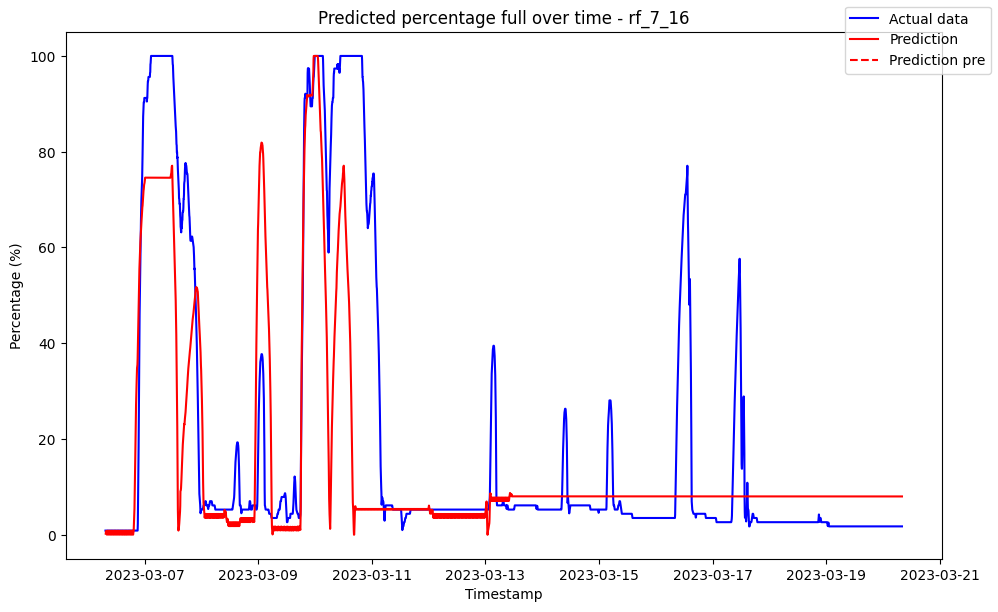

------------------------------------ rf_7_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006737               0.0
1 2023-03-06 07:35:00            0.133029               0.0
2 2023-03-06 07:40:00            0.537813               0.0
3 2023-03-06 07:45:00            0.888810               0.0
4 2023-03-06 07:50:00            1.961841               0.0
5 2023-03-06 07:55:00            3.274381               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08147763663381696
Variance (R²) score: 1.00


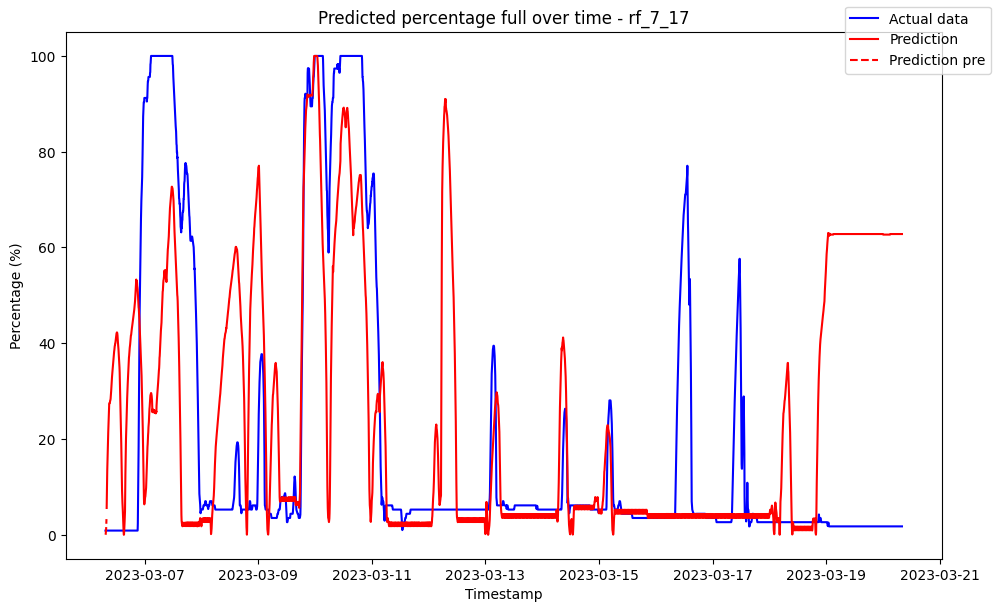

------------------------------------ rf_7_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007681               0.0
1 2023-03-06 07:35:00            0.129321               0.0
2 2023-03-06 07:40:00            0.538180               0.0
3 2023-03-06 07:45:00            0.888088               0.0
4 2023-03-06 07:50:00            1.971999               0.0
5 2023-03-06 07:55:00            3.325857               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10395935712467792
Variance (R²) score: 1.00


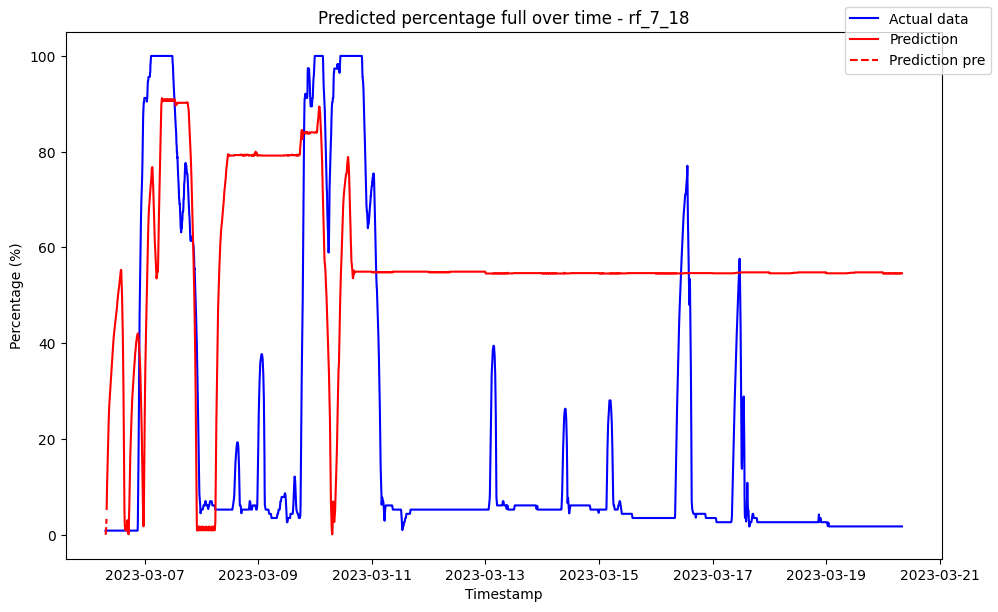

------------------------------------ rf_7_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006041               0.0
1 2023-03-06 07:35:00            0.119429               0.0
2 2023-03-06 07:40:00            1.798238               0.0
3 2023-03-06 07:45:00            3.260857               0.0
4 2023-03-06 07:50:00            4.460286               0.0
5 2023-03-06 07:55:00            5.325071               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07618897970271357
Variance (R²) score: 1.00


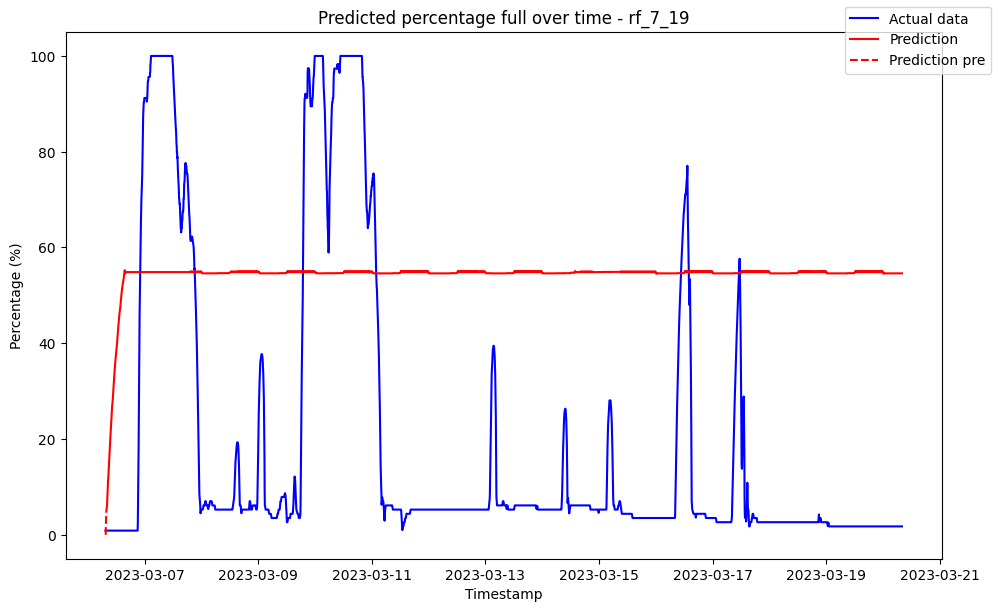

------------------------------------ rf_7_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            1.162877               0.0
1 2023-03-06 07:35:00            1.162877               0.0
2 2023-03-06 07:40:00            1.162877               0.0
3 2023-03-06 07:45:00            1.162877               0.0
4 2023-03-06 07:50:00            1.162877               0.0
5 2023-03-06 07:55:00            1.162877               0.0

Metrics for this specific prediction:
Accuracy: 96.57%
Mean squared error: 34.993620473245834
Variance (R²) score: 0.97


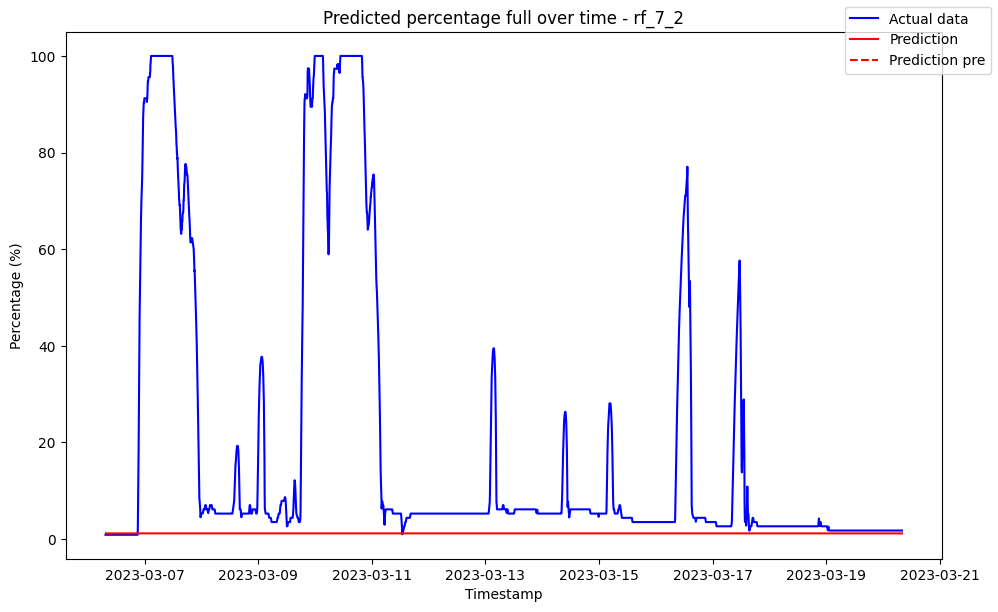

------------------------------------ rf_7_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004800               0.0
1 2023-03-06 07:35:00            0.113582               0.0
2 2023-03-06 07:40:00            0.339083               0.0
3 2023-03-06 07:45:00            0.658143               0.0
4 2023-03-06 07:50:00            0.851752               0.0
5 2023-03-06 07:55:00            0.509468               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07696647405678046
Variance (R²) score: 1.00


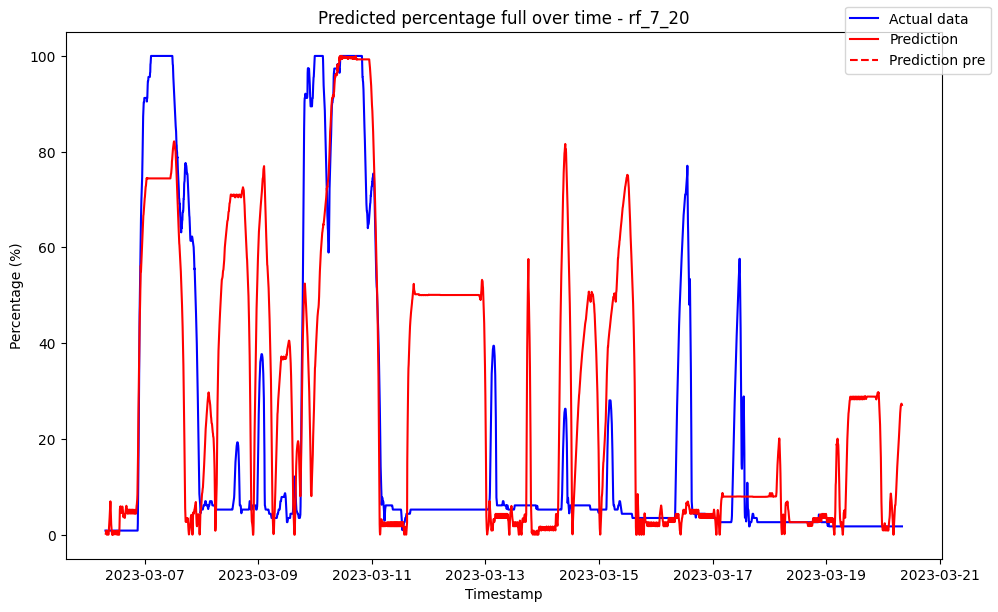

------------------------------------ rf_7_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004104               0.0
1 2023-03-06 07:35:00            0.109945               0.0
2 2023-03-06 07:40:00            0.389845               0.0
3 2023-03-06 07:45:00            0.687554               0.0
4 2023-03-06 07:50:00            0.844902               0.0
5 2023-03-06 07:55:00            0.747711               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10841165397718049
Variance (R²) score: 1.00


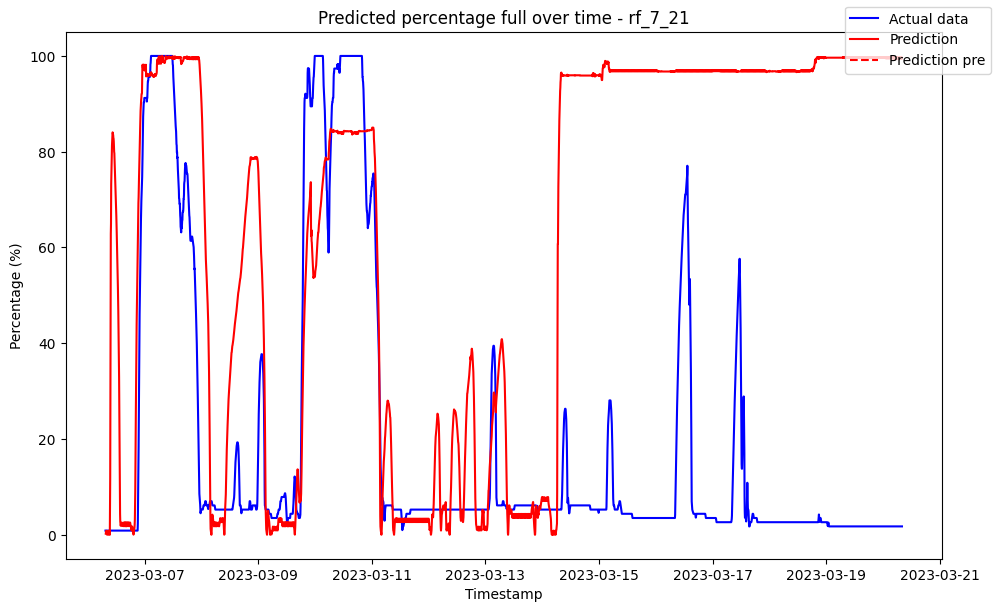

------------------------------------ rf_7_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006464               0.0
1 2023-03-06 07:35:00            0.134190               0.0
2 2023-03-06 07:40:00            0.521391               0.0
3 2023-03-06 07:45:00            0.949102               0.0
4 2023-03-06 07:50:00            2.120286               0.0
5 2023-03-06 07:55:00            3.514286               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0861905215371838
Variance (R²) score: 1.00


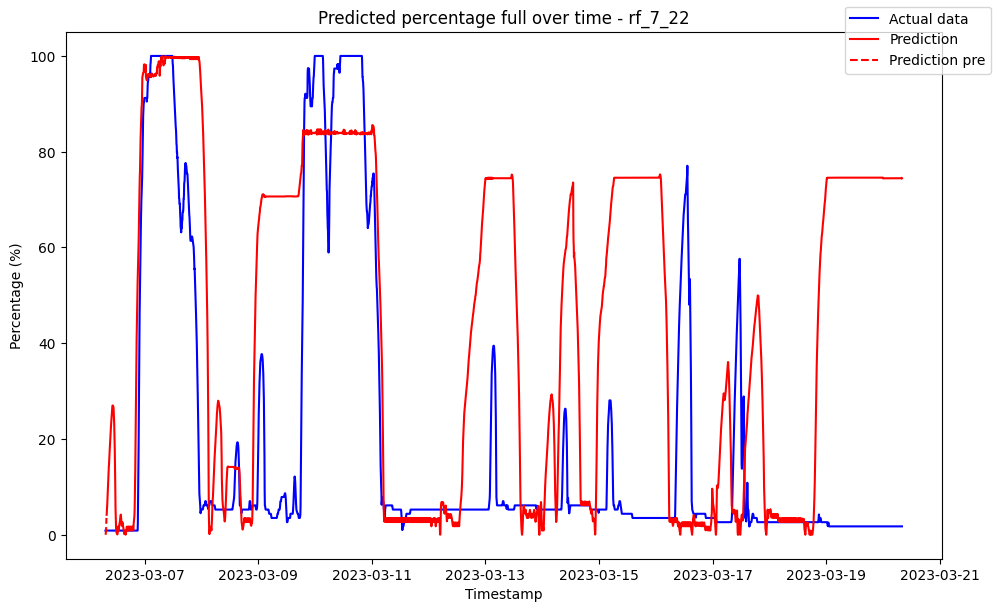

------------------------------------ rf_7_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000124               0.0
1 2023-03-06 07:35:00            0.000124               0.0
2 2023-03-06 07:40:00            0.000124               0.0
3 2023-03-06 07:45:00            0.000124               0.0
4 2023-03-06 07:50:00            0.000124               0.0
5 2023-03-06 07:55:00            0.000124               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08277012199289593
Variance (R²) score: 1.00


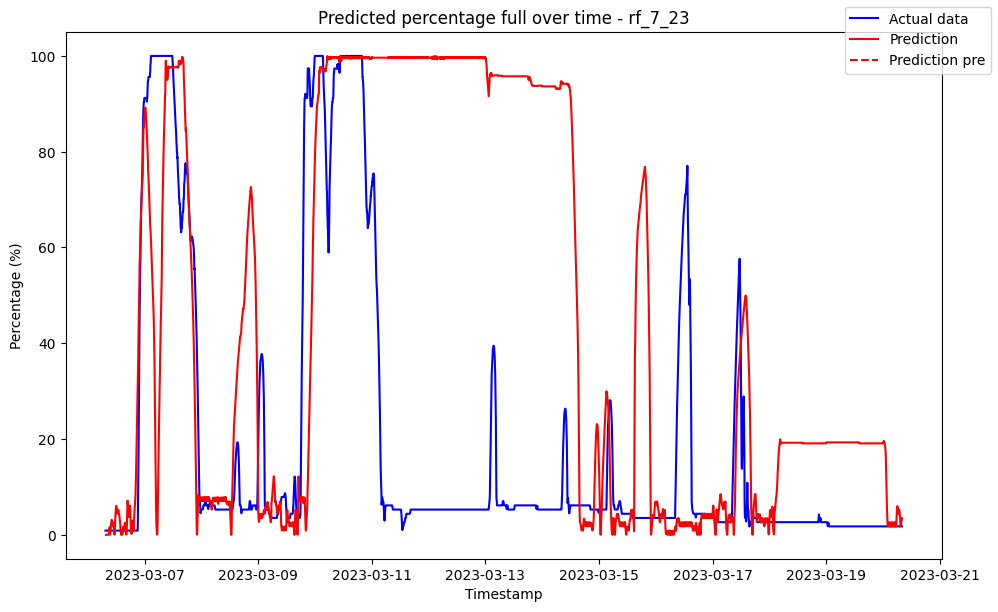

------------------------------------ rf_7_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000815               0.0
1 2023-03-06 07:35:00            0.042958               0.0
2 2023-03-06 07:40:00            0.343000               0.0
3 2023-03-06 07:45:00            0.670286               0.0
4 2023-03-06 07:50:00            0.853095               0.0
5 2023-03-06 07:55:00            0.755286               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08606781196899228
Variance (R²) score: 1.00


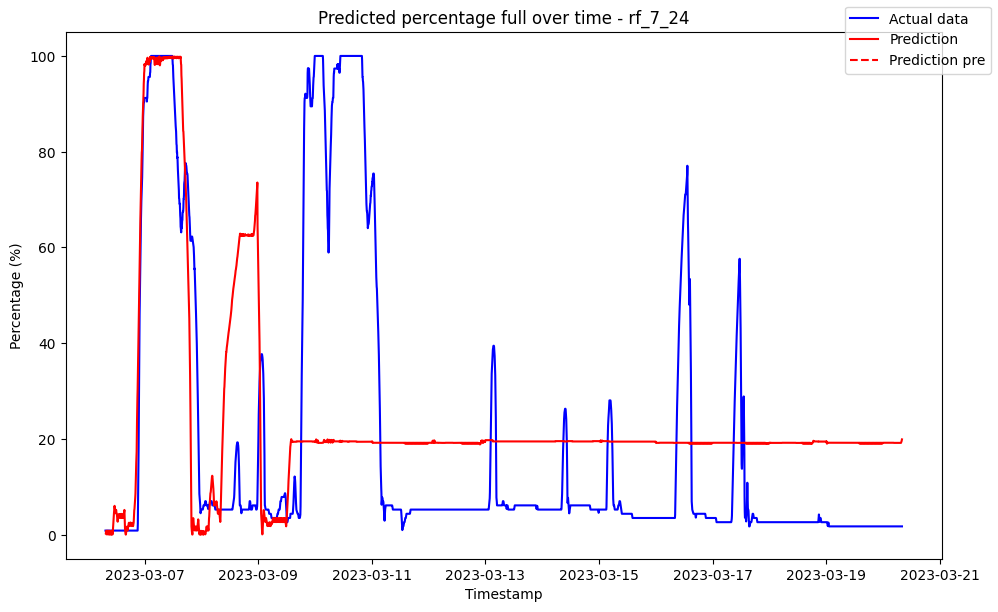

------------------------------------ rf_7_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08480411959604908
Variance (R²) score: 1.00


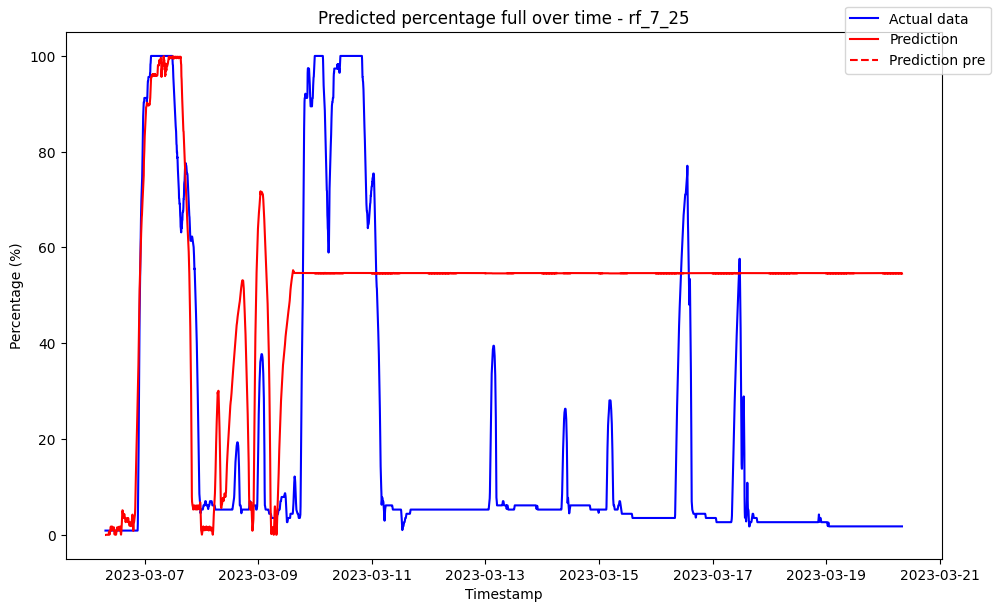

------------------------------------ rf_7_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09357685266811362
Variance (R²) score: 1.00


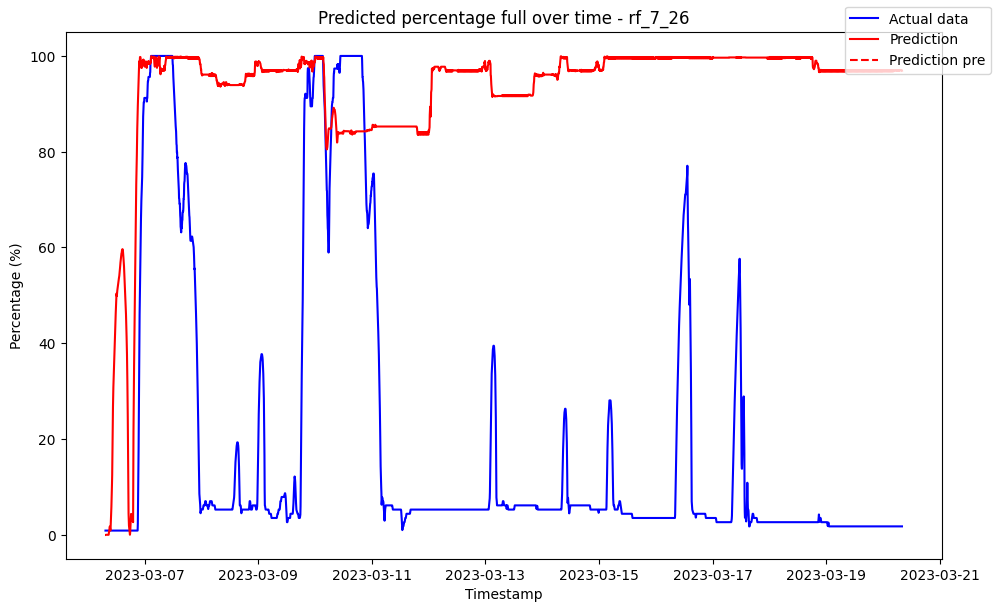

------------------------------------ rf_7_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07871546494617253
Variance (R²) score: 1.00


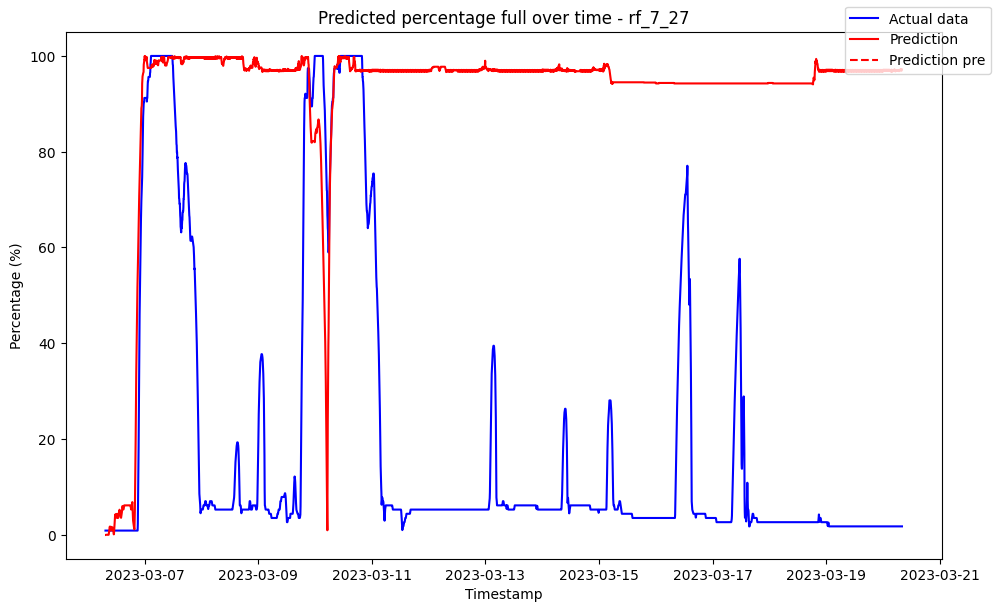

------------------------------------ rf_7_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08629152747304157
Variance (R²) score: 1.00


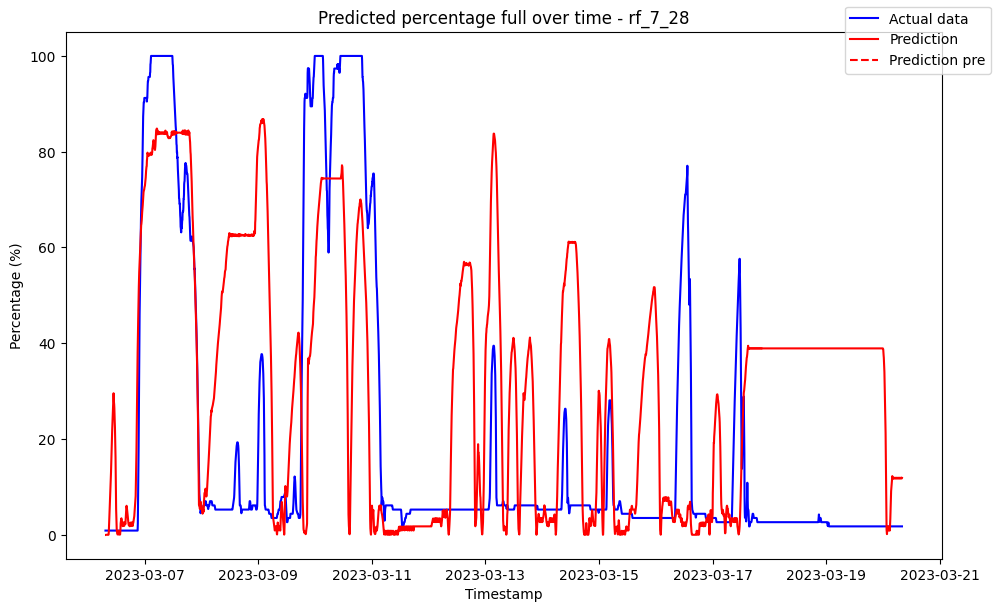

------------------------------------ rf_7_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09202360267354319
Variance (R²) score: 1.00


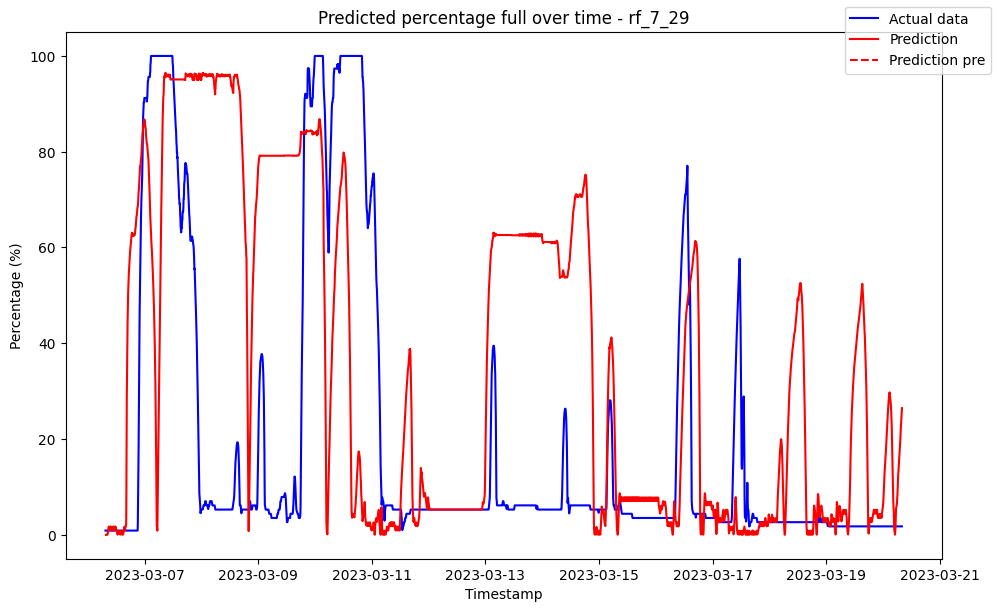

------------------------------------ rf_7_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.354897               0.0
1 2023-03-06 07:35:00            0.354897               0.0
2 2023-03-06 07:40:00            0.354897               0.0
3 2023-03-06 07:45:00            0.354897               0.0
4 2023-03-06 07:50:00            0.354897               0.0
5 2023-03-06 07:55:00            0.354897               0.0

Metrics for this specific prediction:
Accuracy: 99.4%
Mean squared error: 6.162089215522581
Variance (R²) score: 0.99


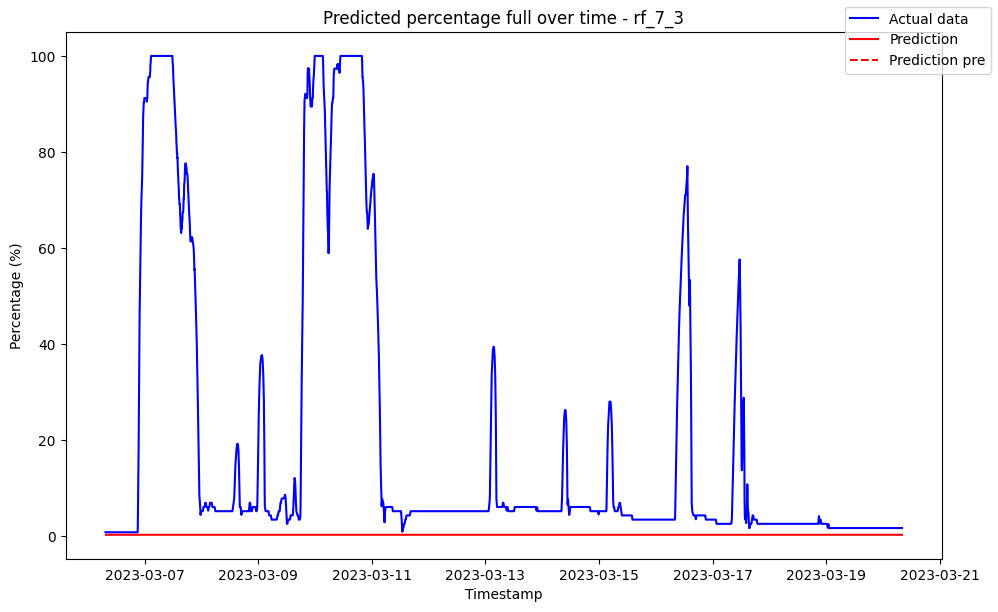

------------------------------------ rf_7_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0888908824106705
Variance (R²) score: 1.00


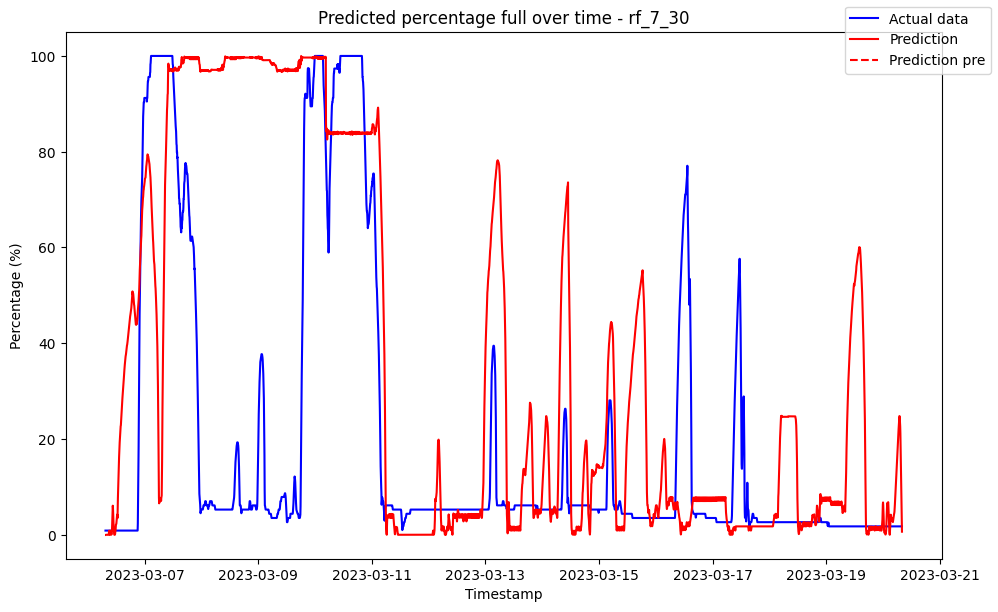

------------------------------------ rf_7_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08770632267636268
Variance (R²) score: 1.00


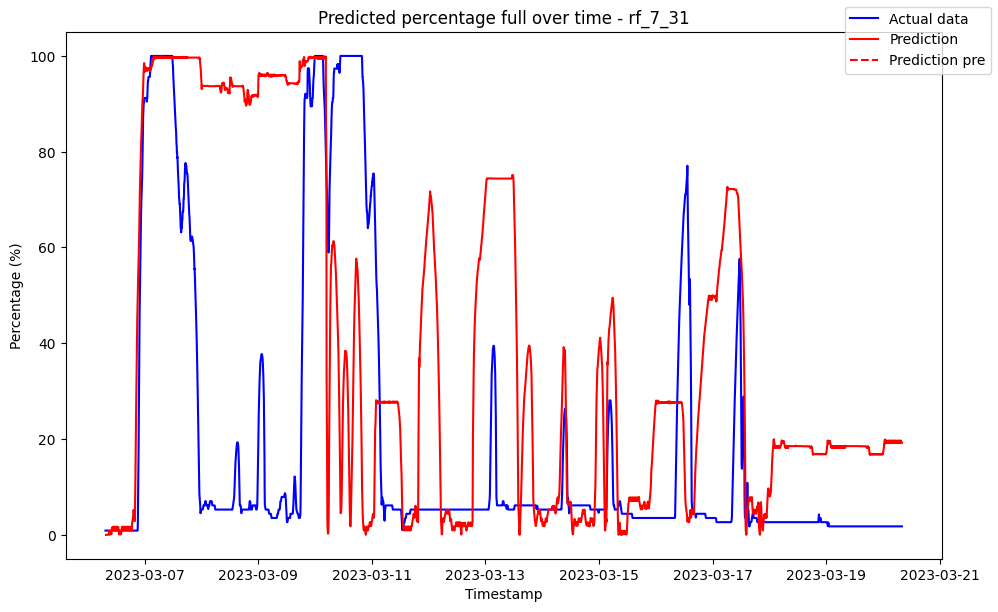

------------------------------------ rf_7_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08743651588459714
Variance (R²) score: 1.00


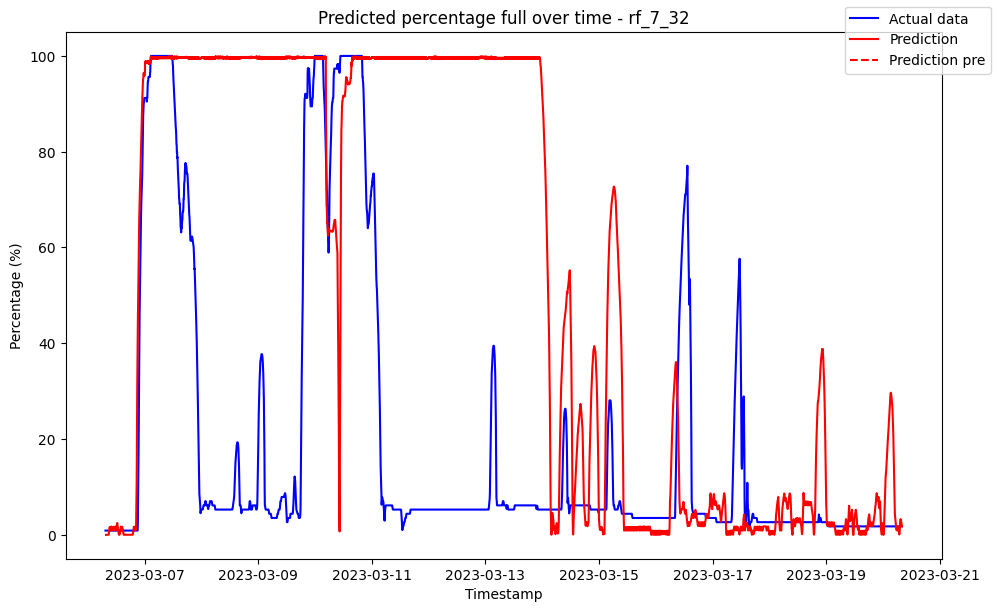

------------------------------------ rf_7_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08491881879703012
Variance (R²) score: 1.00


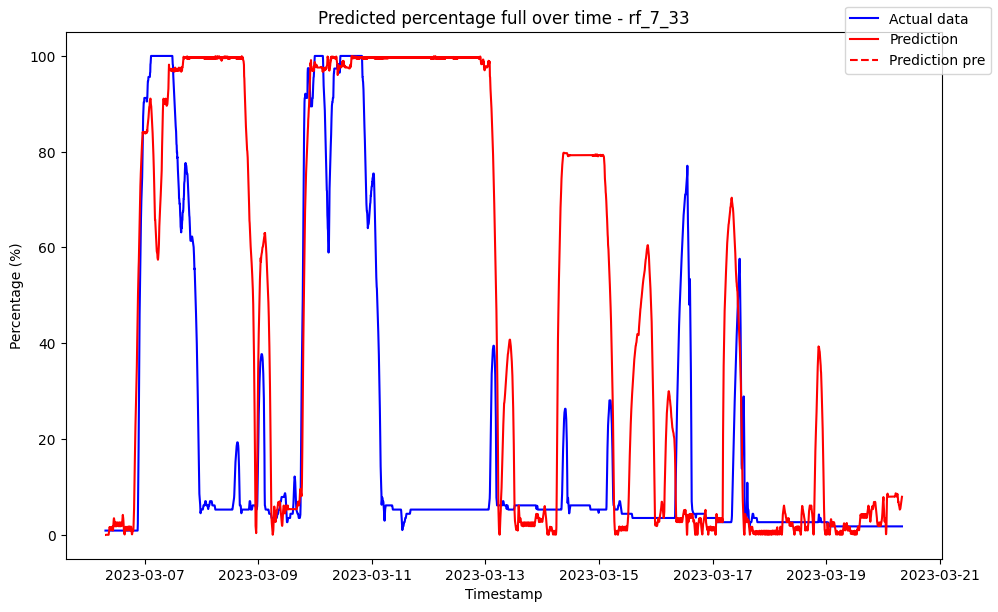

------------------------------------ rf_7_34 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10310333675770973
Variance (R²) score: 1.00


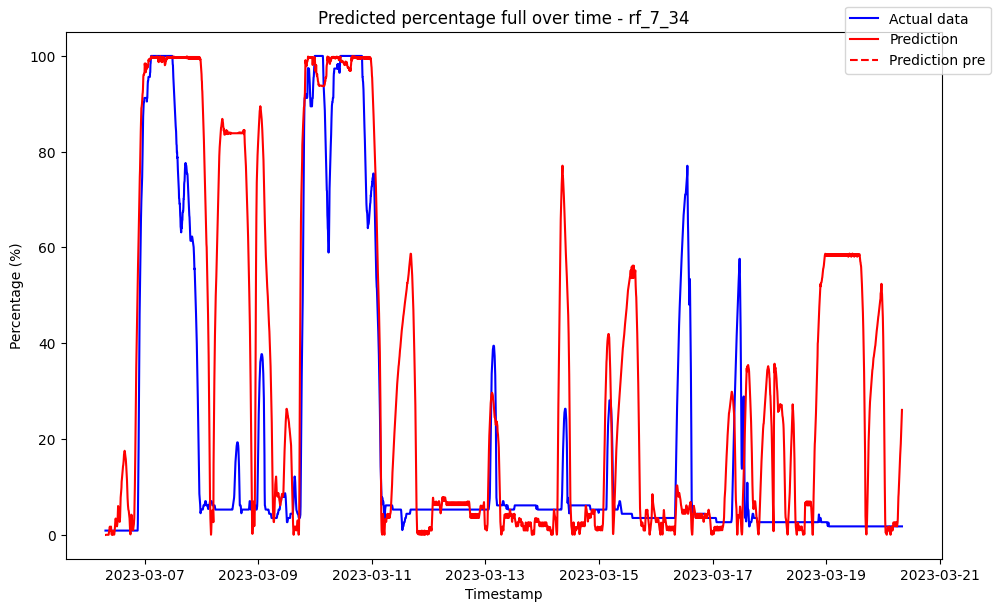

------------------------------------ rf_7_35 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09161445516322626
Variance (R²) score: 1.00


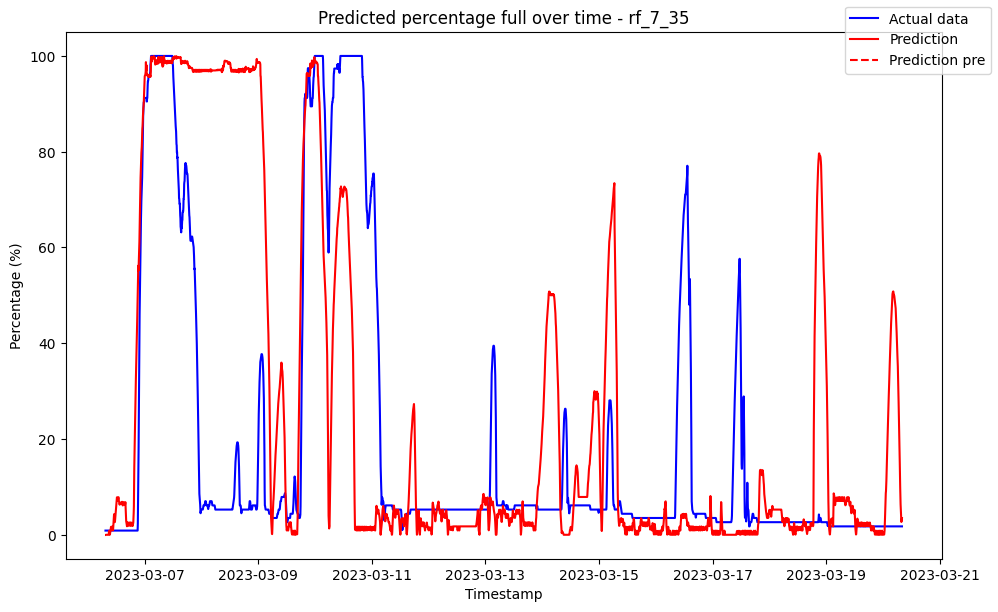

------------------------------------ rf_7_36 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09229736454978966
Variance (R²) score: 1.00


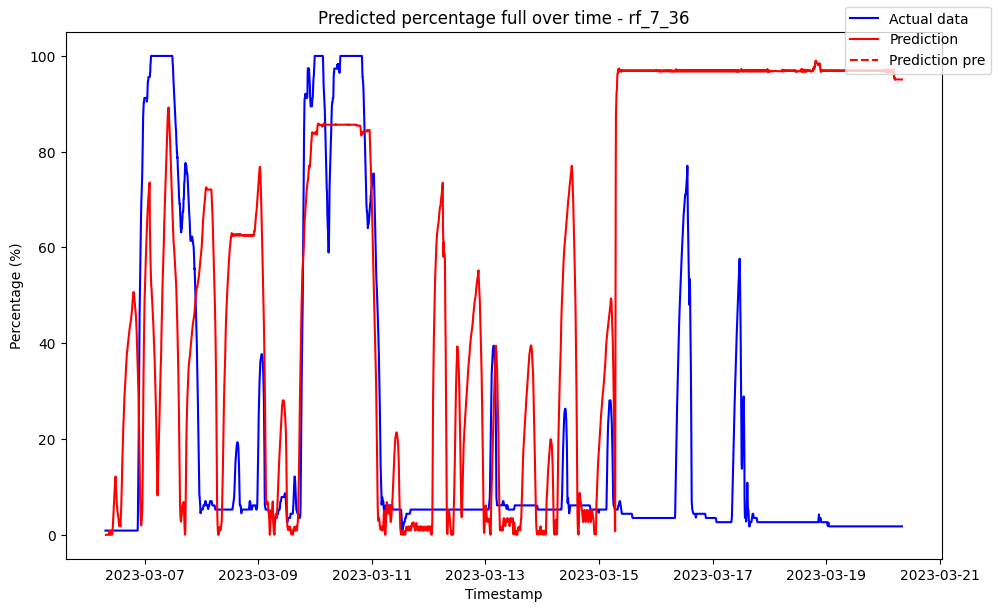

------------------------------------ rf_7_37 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09526762816196731
Variance (R²) score: 1.00


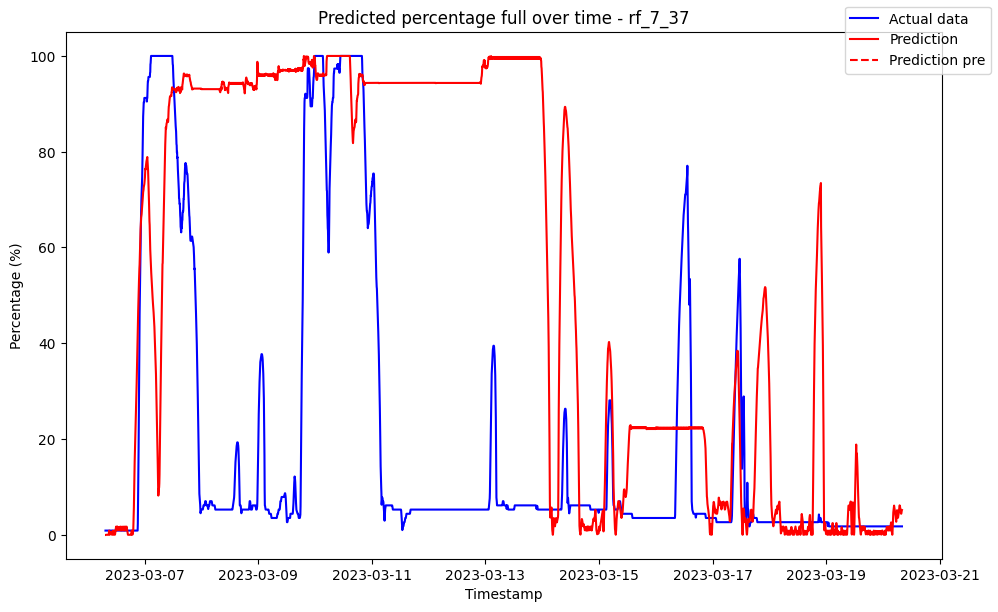

------------------------------------ rf_7_38 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07747137338389427
Variance (R²) score: 1.00


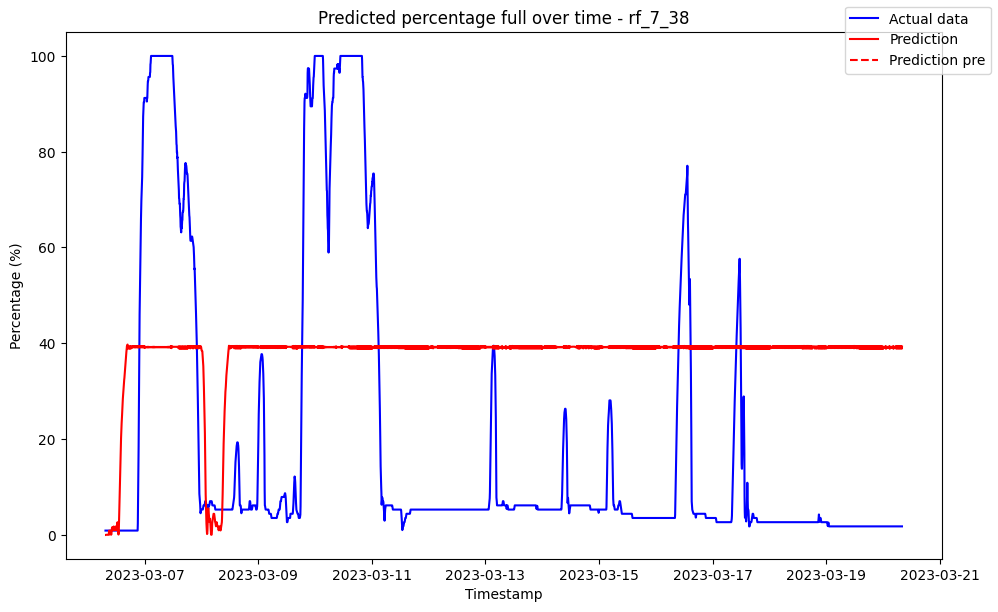

------------------------------------ rf_7_39 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0848492432176544
Variance (R²) score: 1.00


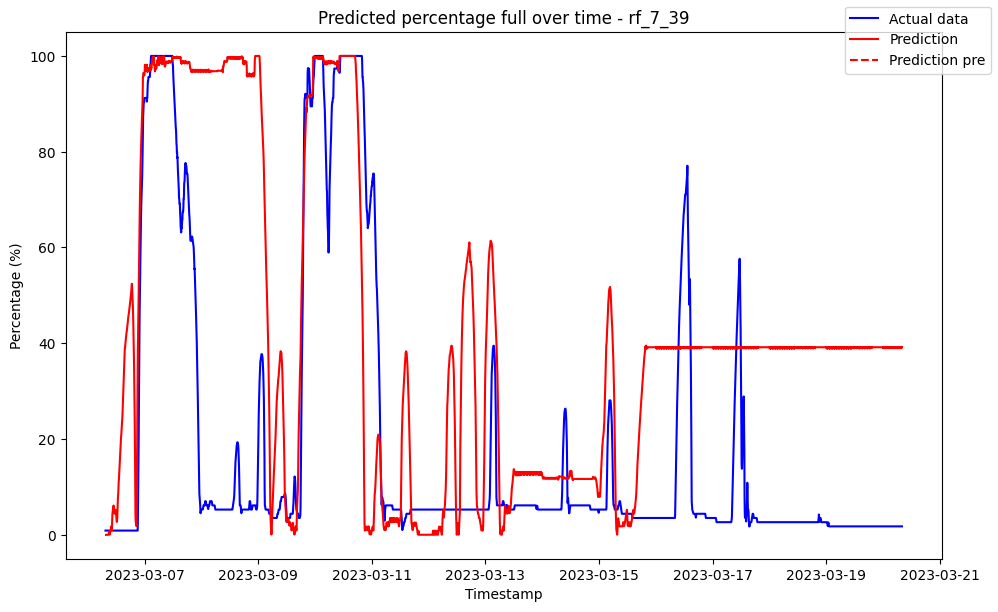

------------------------------------ rf_7_4 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019067               0.0
1 2023-03-06 07:35:00            0.019067               0.0
2 2023-03-06 07:40:00            0.019067               0.0
3 2023-03-06 07:45:00            0.019067               0.0
4 2023-03-06 07:50:00            0.019067               0.0
5 2023-03-06 07:55:00            0.019067               0.0

Metrics for this specific prediction:
Accuracy: 99.79%
Mean squared error: 2.097503267975864
Variance (R²) score: 1.00


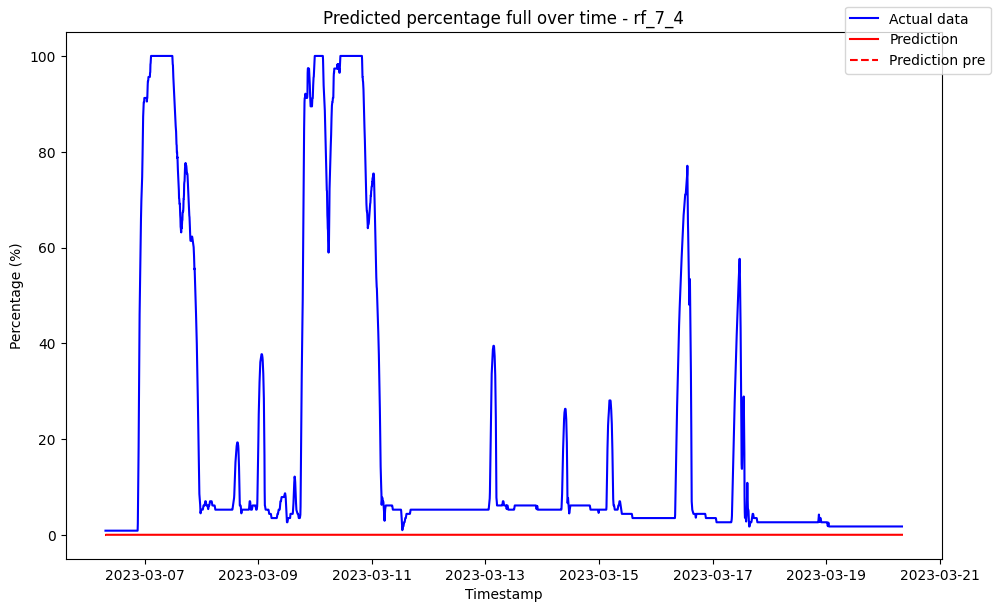

------------------------------------ rf_7_40 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07981585006639194
Variance (R²) score: 1.00


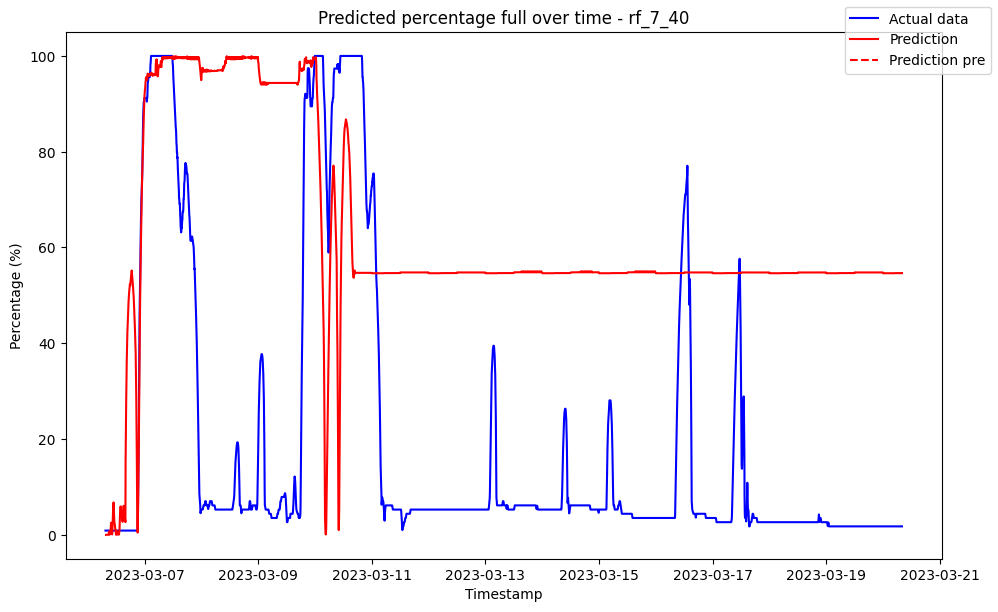

------------------------------------ rf_7_41 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09061941087261827
Variance (R²) score: 1.00


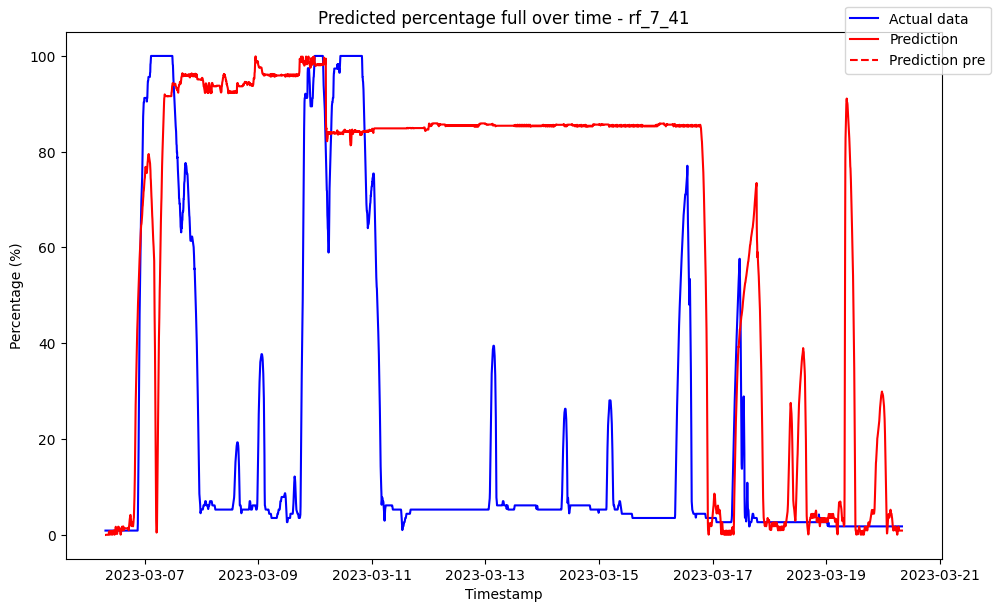

------------------------------------ rf_7_42 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0823107665990998
Variance (R²) score: 1.00


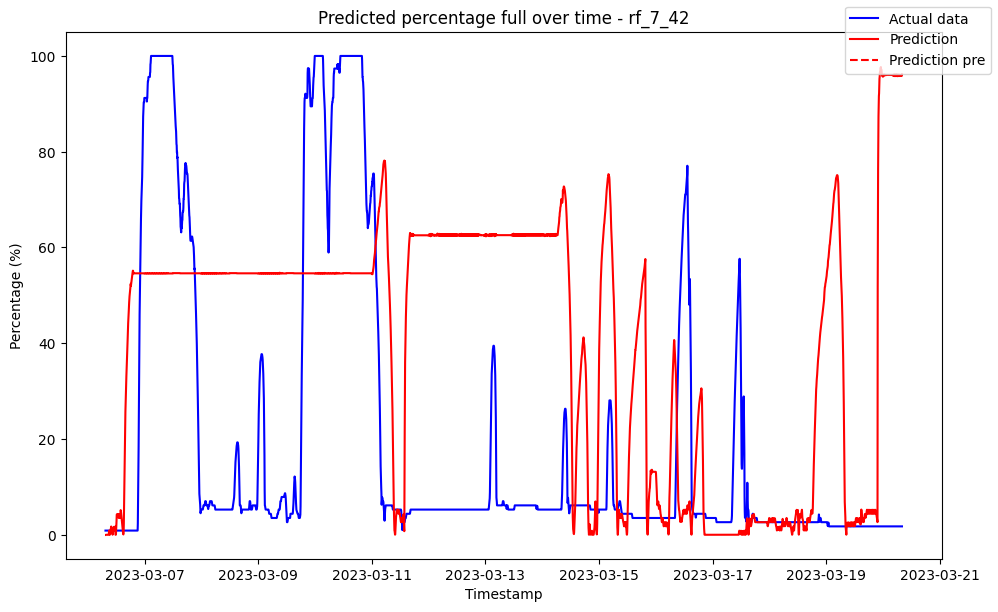

------------------------------------ rf_7_43 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08969328464011156
Variance (R²) score: 1.00


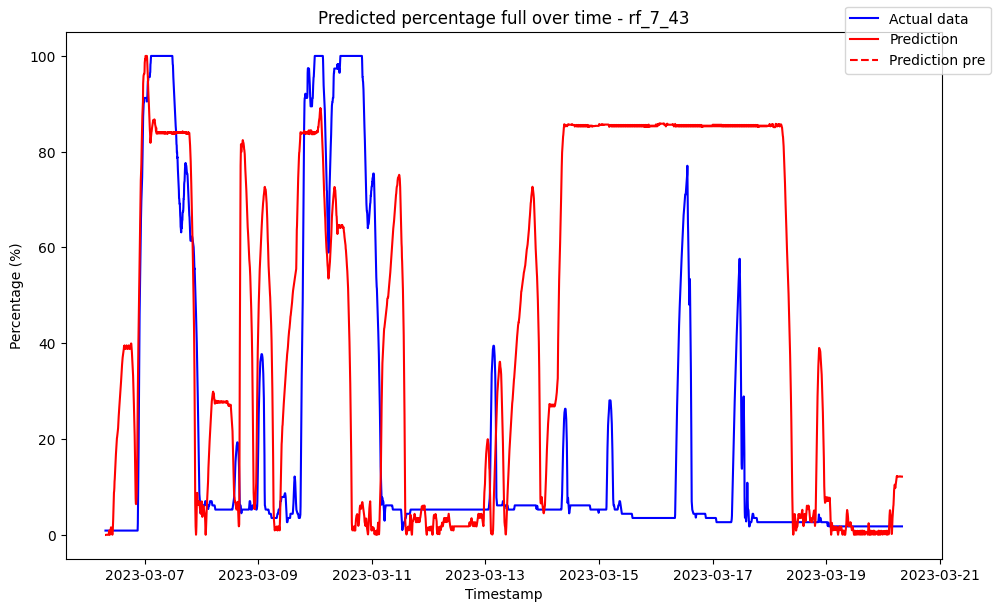

------------------------------------ rf_7_44 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10038179306250618
Variance (R²) score: 1.00


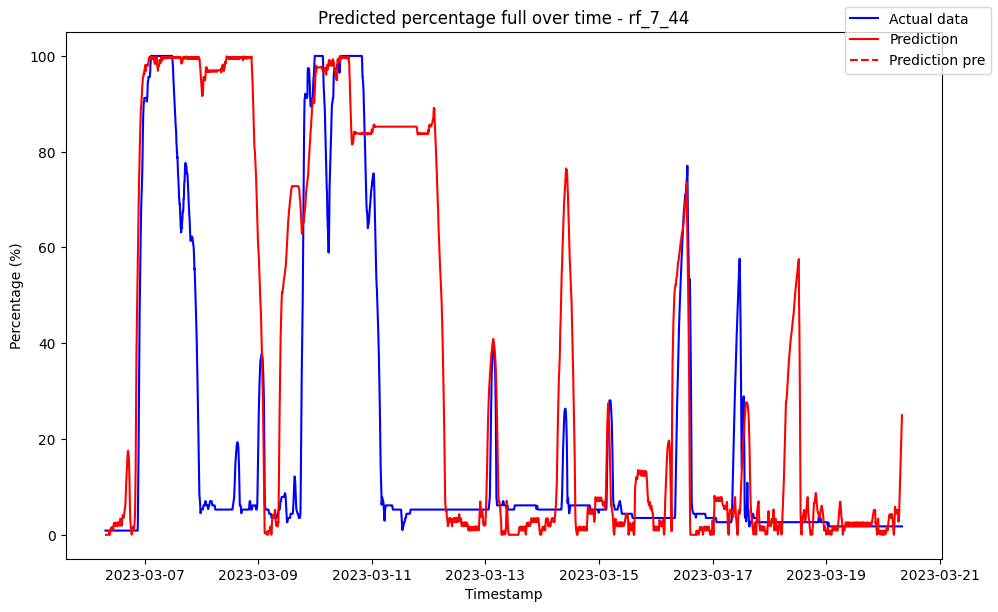

------------------------------------ rf_7_45 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07798017893591644
Variance (R²) score: 1.00


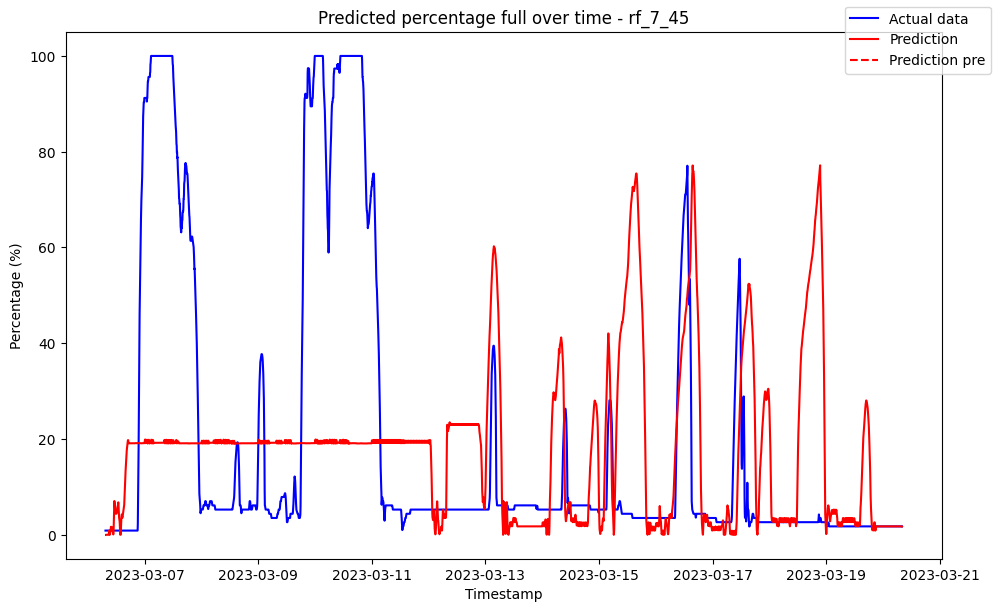

------------------------------------ rf_7_46 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.07187616196211111
Variance (R²) score: 1.00


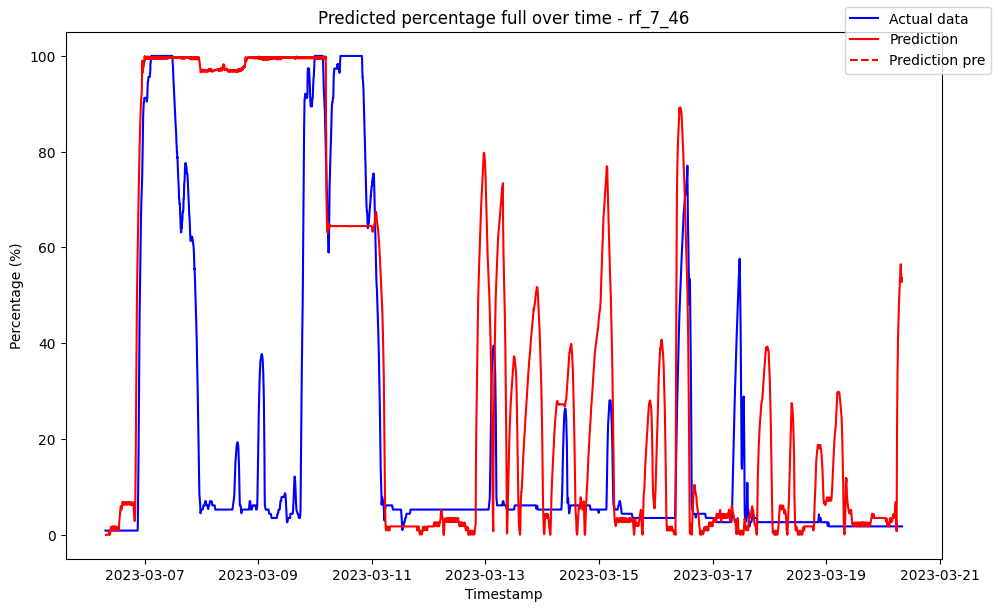

------------------------------------ rf_7_47 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10569530358829952
Variance (R²) score: 1.00


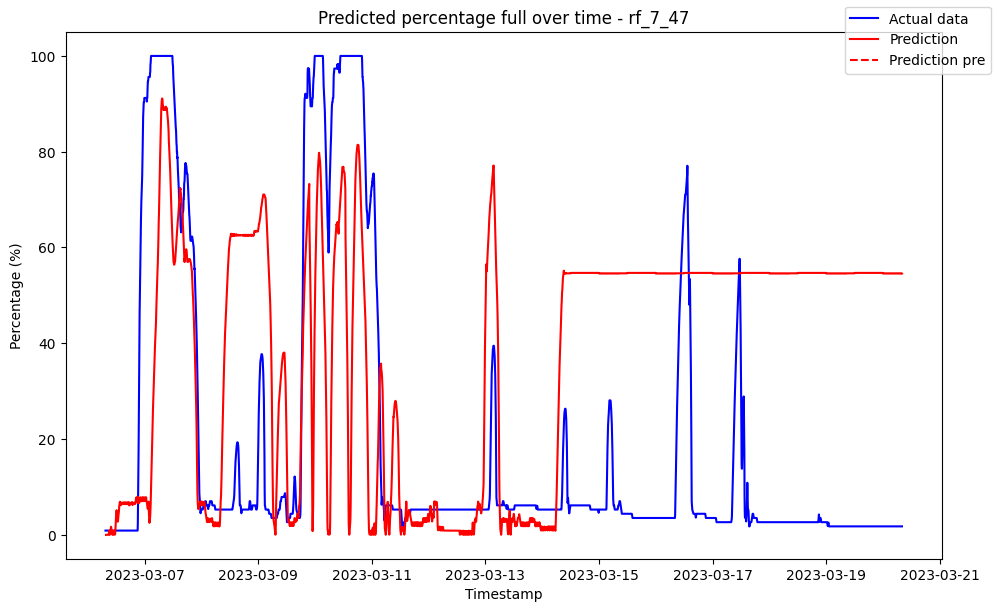

------------------------------------ rf_7_48 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0989048293485988
Variance (R²) score: 1.00


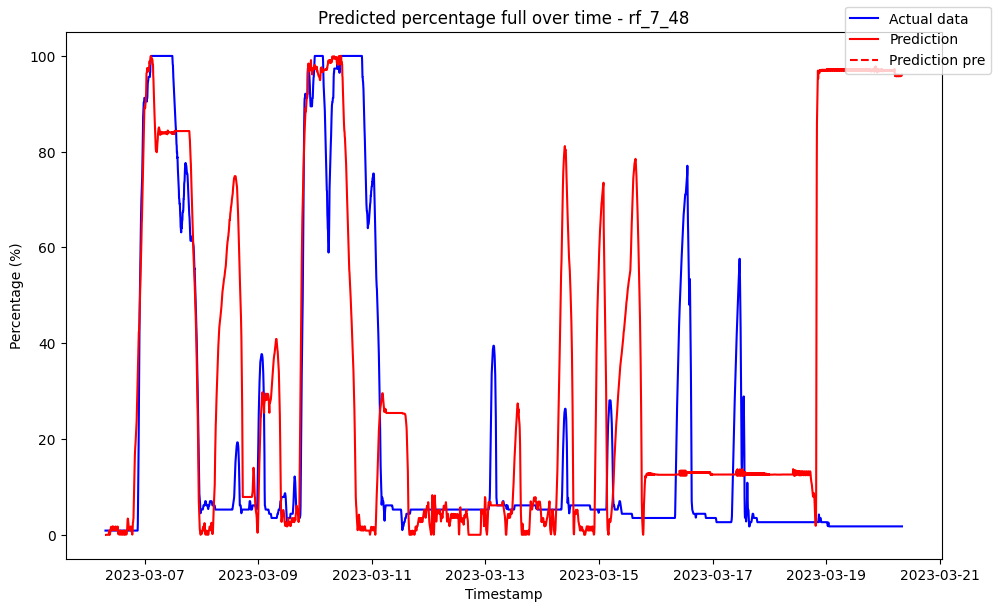

------------------------------------ rf_7_49 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08454661814848387
Variance (R²) score: 1.00


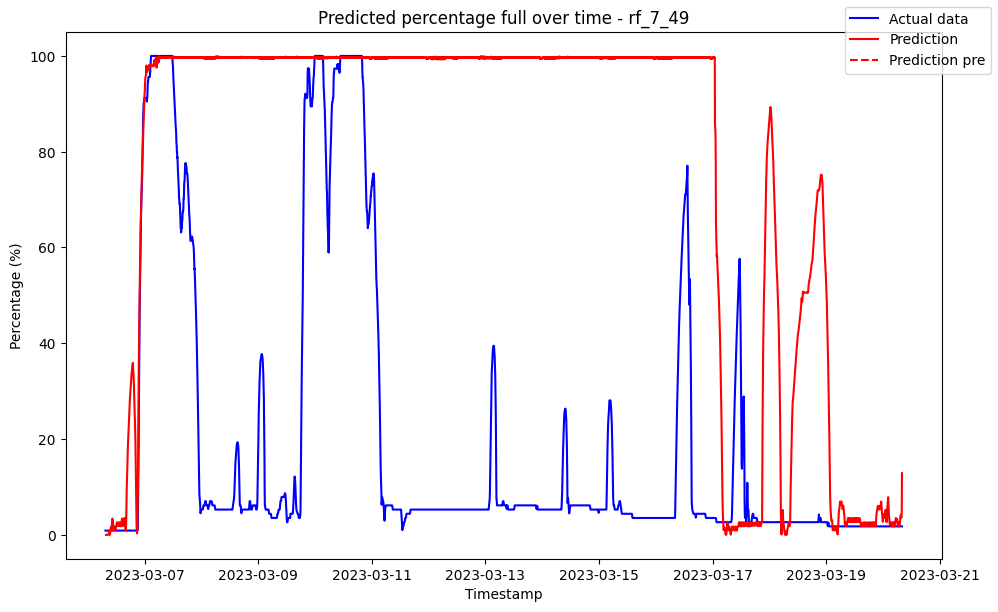

------------------------------------ rf_7_5 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.017453               0.0
1 2023-03-06 07:35:00            0.017453               0.0
2 2023-03-06 07:40:00            0.017453               0.0
3 2023-03-06 07:45:00            0.017453               0.0
4 2023-03-06 07:50:00            0.017453               0.0
5 2023-03-06 07:55:00            0.017453               0.0

Metrics for this specific prediction:
Accuracy: 99.92%
Mean squared error: 0.8337113886209927
Variance (R²) score: 1.00


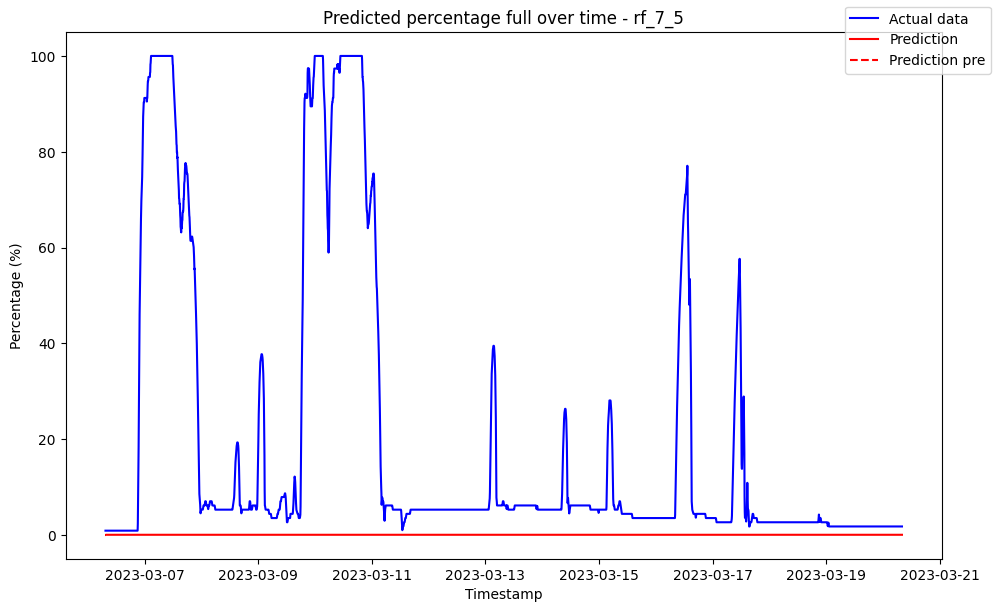

------------------------------------ rf_7_50 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.08390566800349382
Variance (R²) score: 1.00


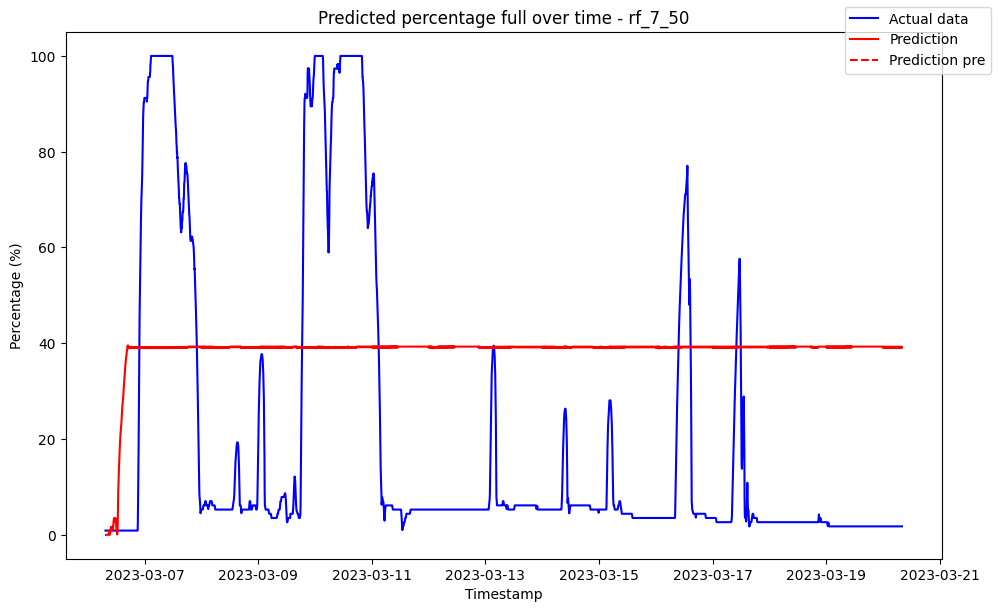

------------------------------------ rf_7_6 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.010668               0.0
1 2023-03-06 07:35:00            0.103312               0.0
2 2023-03-06 07:40:00            0.288931               0.0
3 2023-03-06 07:45:00            0.288931               0.0
4 2023-03-06 07:50:00            0.288931               0.0
5 2023-03-06 07:55:00            0.288931               0.0

Metrics for this specific prediction:
Accuracy: 99.94%
Mean squared error: 0.6180311537373022
Variance (R²) score: 1.00


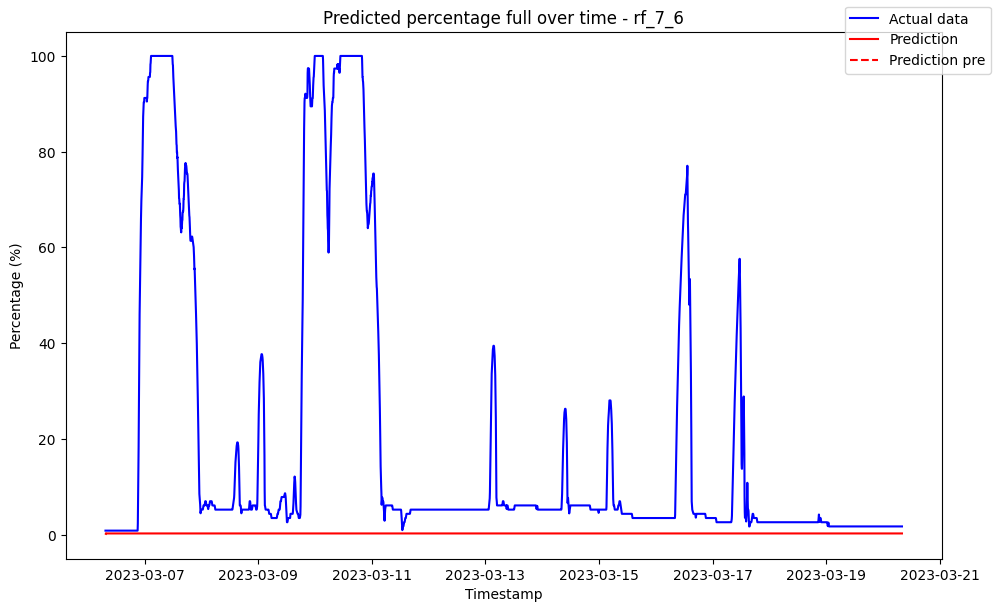

------------------------------------ rf_7_7 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007352               0.0
1 2023-03-06 07:35:00            0.139403               0.0
2 2023-03-06 07:40:00            0.598997               0.0
3 2023-03-06 07:45:00            0.707981               0.0
4 2023-03-06 07:50:00            0.732680               0.0
5 2023-03-06 07:55:00            0.753308               0.0

Metrics for this specific prediction:
Accuracy: 99.95%
Mean squared error: 0.46846483451180937
Variance (R²) score: 1.00


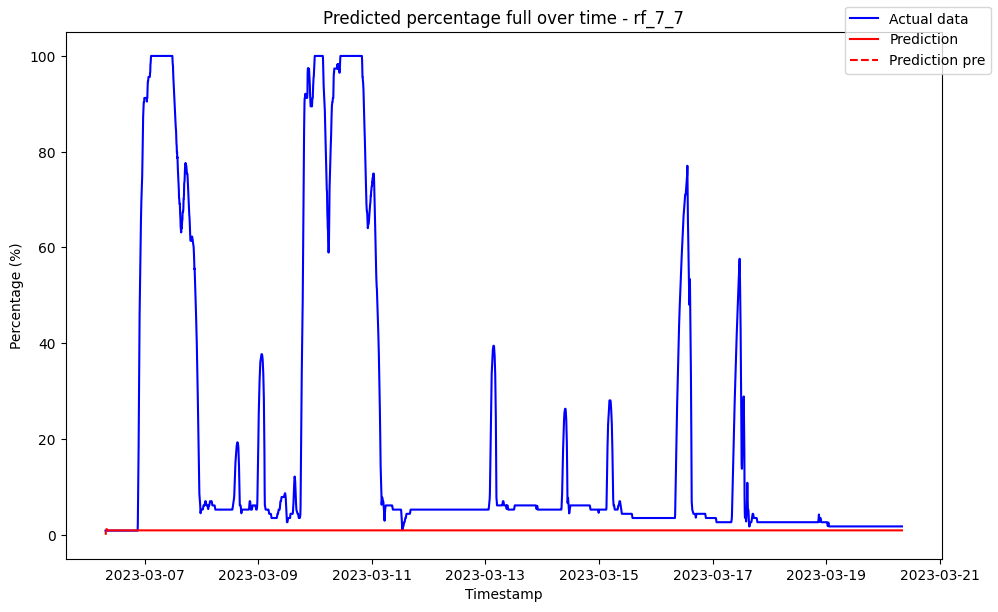

------------------------------------ rf_7_8 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006536               0.0
1 2023-03-06 07:35:00            0.172529               0.0
2 2023-03-06 07:40:00            0.599960               0.0
3 2023-03-06 07:45:00            0.796949               0.0
4 2023-03-06 07:50:00            0.801270               0.0
5 2023-03-06 07:55:00            0.801270               0.0

Metrics for this specific prediction:
Accuracy: 99.97%
Mean squared error: 0.3388925999449092
Variance (R²) score: 1.00


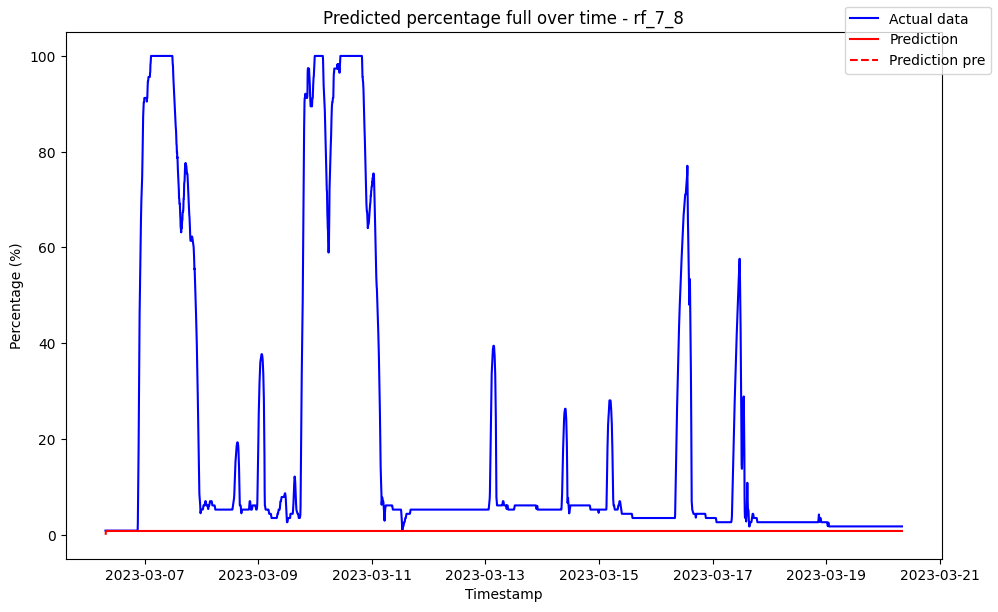

------------------------------------ rf_7_9 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.019788               0.0
1 2023-03-06 07:35:00            0.342294               0.0
2 2023-03-06 07:40:00            0.695871               0.0
3 2023-03-06 07:45:00            0.844633               0.0
4 2023-03-06 07:50:00            0.809153               0.0
5 2023-03-06 07:55:00            0.809153               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.25088279321030327
Variance (R²) score: 1.00


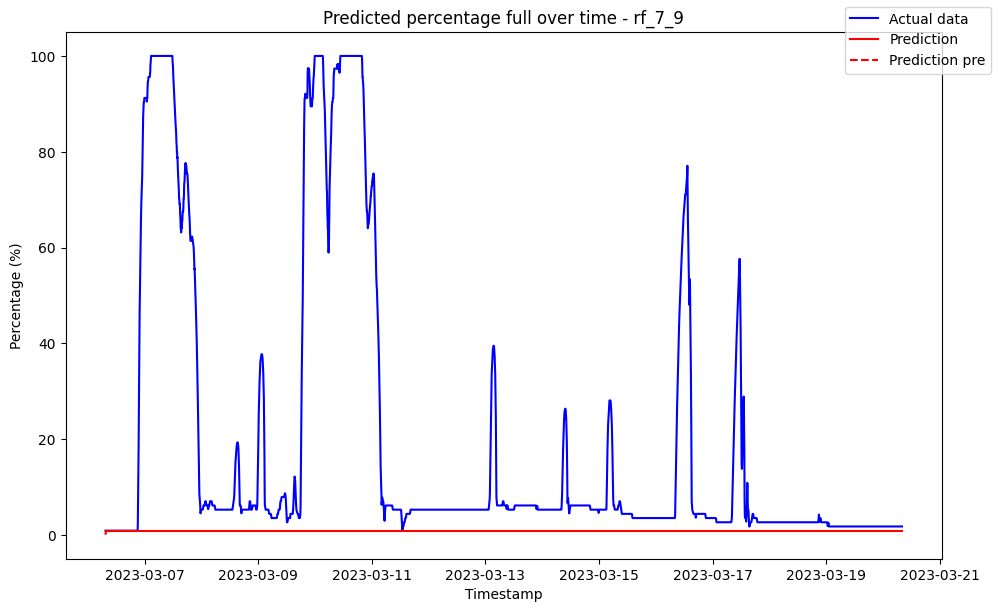

------------------------------------ rf_8_1 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            3.532283               0.0
1 2023-03-06 07:35:00            3.532283               0.0
2 2023-03-06 07:40:00            3.532283               0.0
3 2023-03-06 07:45:00            3.532283               0.0
4 2023-03-06 07:50:00            3.532283               0.0
5 2023-03-06 07:55:00            3.532283               0.0

Metrics for this specific prediction:
Accuracy: 89.46%
Mean squared error: 107.6432506514984
Variance (R²) score: 0.89


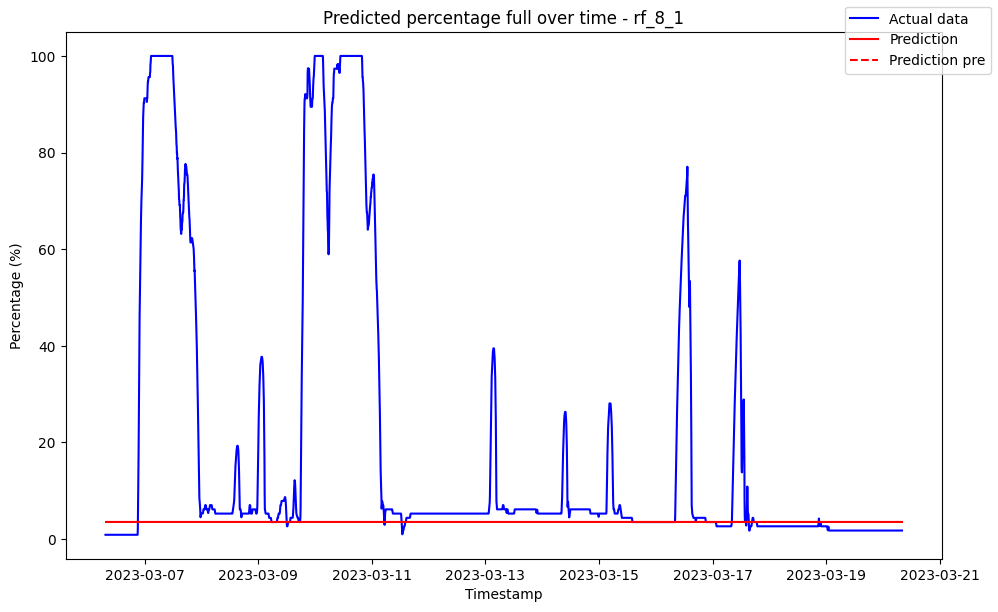

------------------------------------ rf_8_10 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.031894               0.0
1 2023-03-06 07:35:00            0.315786               0.0
2 2023-03-06 07:40:00            0.675234               0.0
3 2023-03-06 07:45:00            0.836777               0.0
4 2023-03-06 07:50:00            0.685872               0.0
5 2023-03-06 07:55:00            0.364110               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.23584946465147666
Variance (R²) score: 1.00


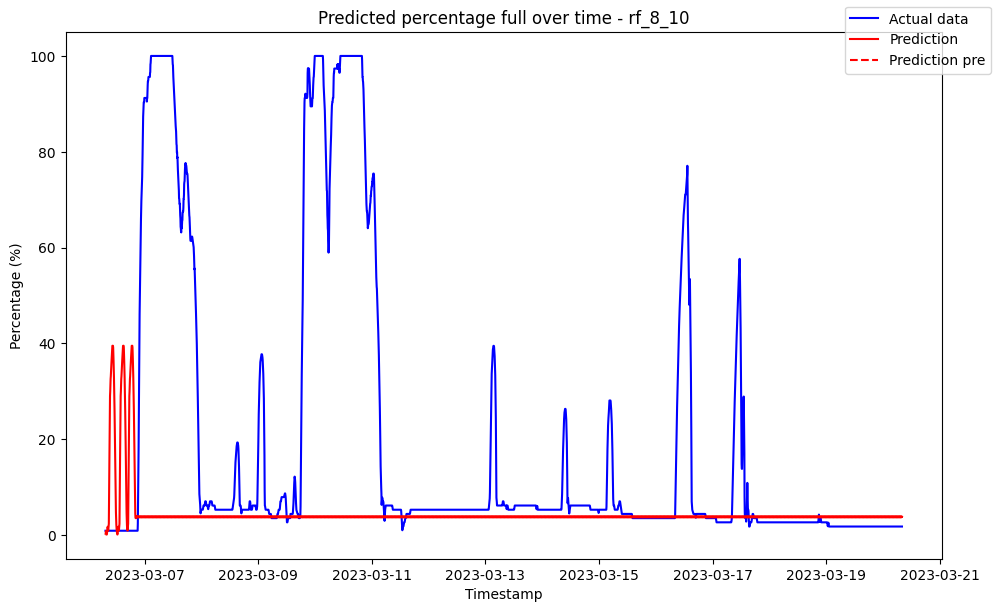

------------------------------------ rf_8_11 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.021104               0.0
1 2023-03-06 07:35:00            0.294828               0.0
2 2023-03-06 07:40:00            0.635594               0.0
3 2023-03-06 07:45:00            0.836063               0.0
4 2023-03-06 07:50:00            0.628172               0.0
5 2023-03-06 07:55:00            0.364845               0.0

Metrics for this specific prediction:
Accuracy: 99.98%
Mean squared error: 0.1721538270767474
Variance (R²) score: 1.00


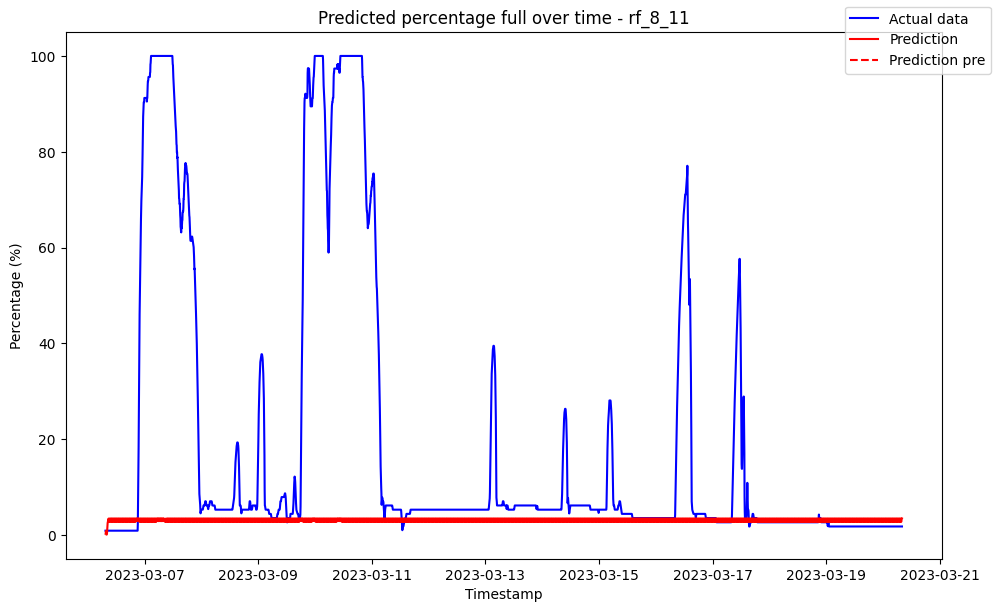

------------------------------------ rf_8_12 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.014032               0.0
1 2023-03-06 07:35:00            0.152161               0.0
2 2023-03-06 07:40:00            0.506828               0.0
3 2023-03-06 07:45:00            0.781793               0.0
4 2023-03-06 07:50:00            0.849065               0.0
5 2023-03-06 07:55:00            0.566838               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.14762385610362086
Variance (R²) score: 1.00


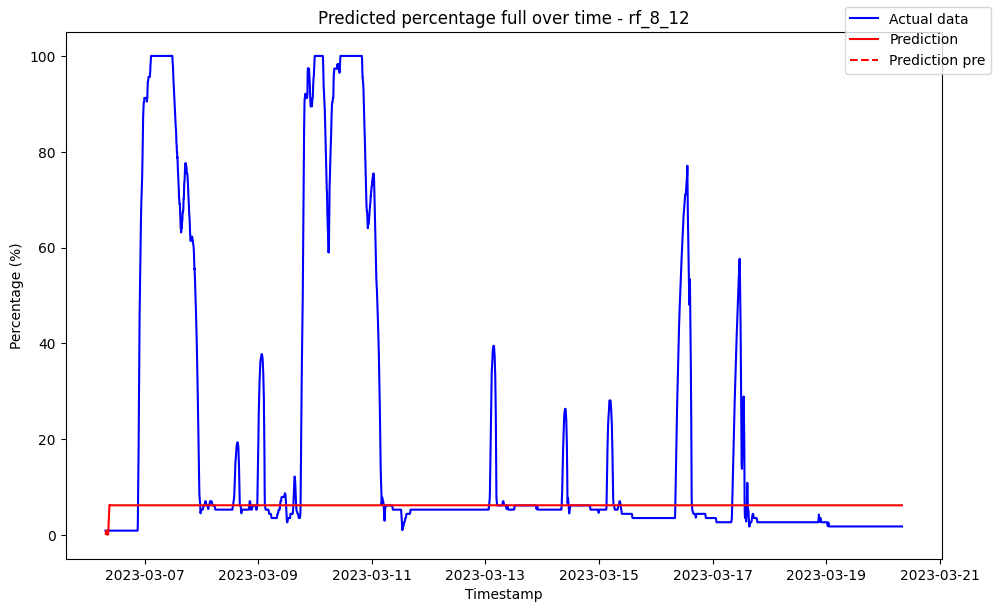

------------------------------------ rf_8_13 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013234               0.0
1 2023-03-06 07:35:00            0.132317               0.0
2 2023-03-06 07:40:00            0.492386               0.0
3 2023-03-06 07:45:00            0.842180               0.0
4 2023-03-06 07:50:00            0.838854               0.0
5 2023-03-06 07:55:00            0.534223               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1386305935792423
Variance (R²) score: 1.00


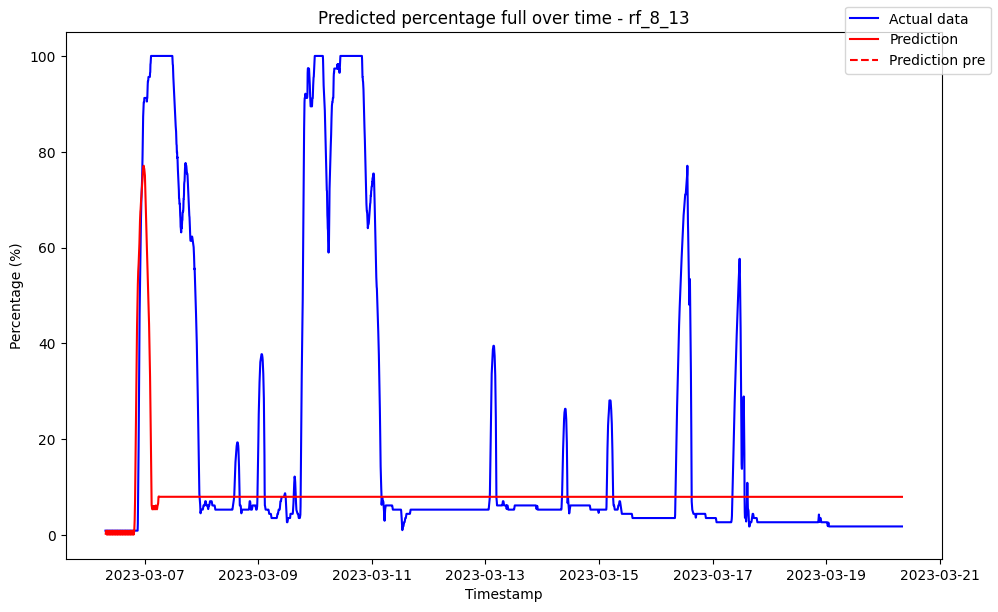

------------------------------------ rf_8_14 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.013038               0.0
1 2023-03-06 07:35:00            0.133661               0.0
2 2023-03-06 07:40:00            0.507383               0.0
3 2023-03-06 07:45:00            0.841243               0.0
4 2023-03-06 07:50:00            0.871019               0.0
5 2023-03-06 07:55:00            0.619890               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12044809399052463
Variance (R²) score: 1.00


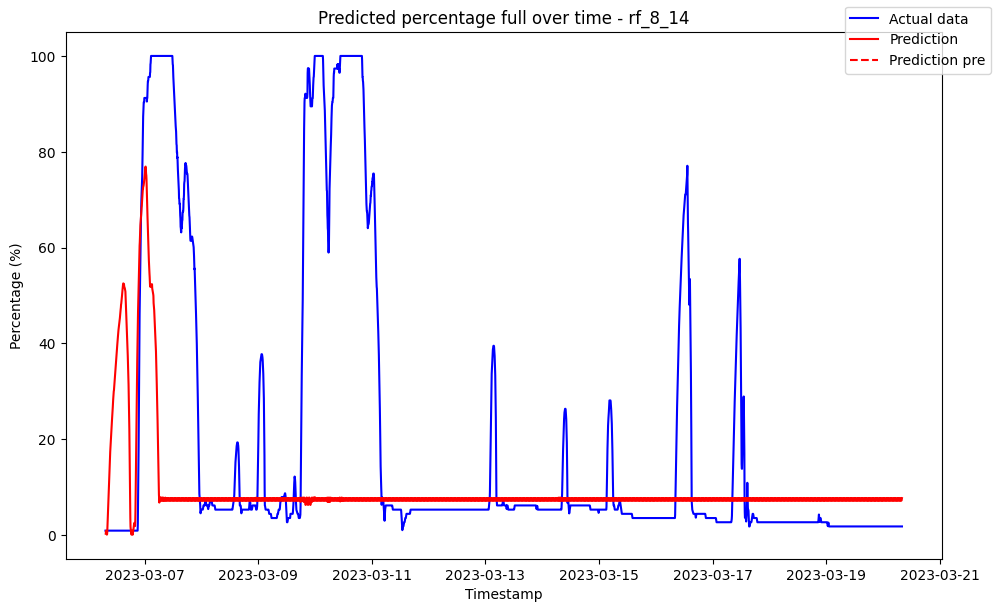

------------------------------------ rf_8_15 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009020               0.0
1 2023-03-06 07:35:00            0.122537               0.0
2 2023-03-06 07:40:00            0.500278               0.0
3 2023-03-06 07:45:00            0.840288               0.0
4 2023-03-06 07:50:00            0.773286               0.0
5 2023-03-06 07:55:00            0.509794               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11052914480329931
Variance (R²) score: 1.00


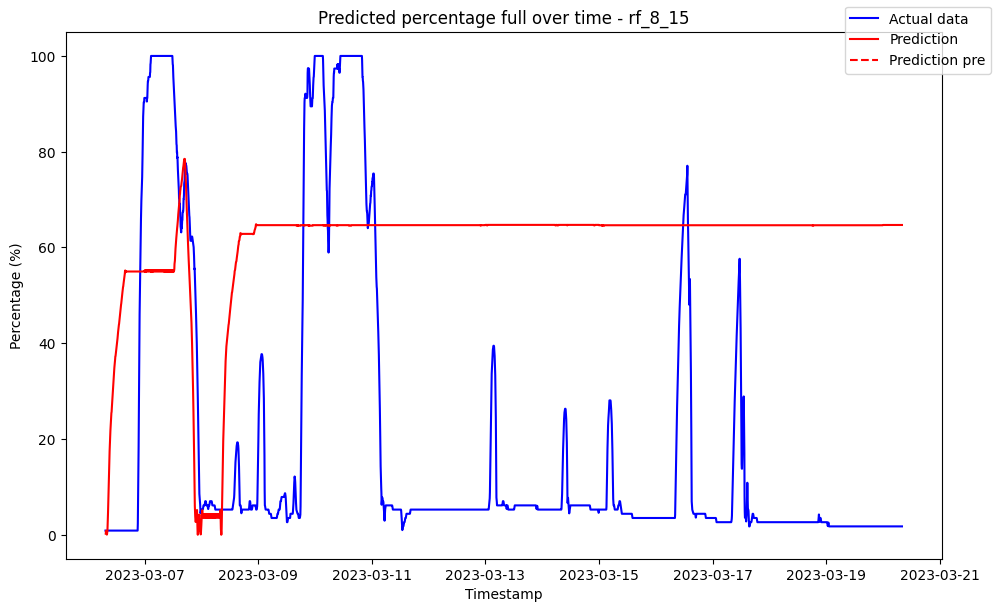

------------------------------------ rf_8_16 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.009117               0.0
1 2023-03-06 07:35:00            0.163321               0.0
2 2023-03-06 07:40:00            0.468489               0.0
3 2023-03-06 07:45:00            0.753067               0.0
4 2023-03-06 07:50:00            0.855825               0.0
5 2023-03-06 07:55:00            0.753055               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11721992309739478
Variance (R²) score: 1.00


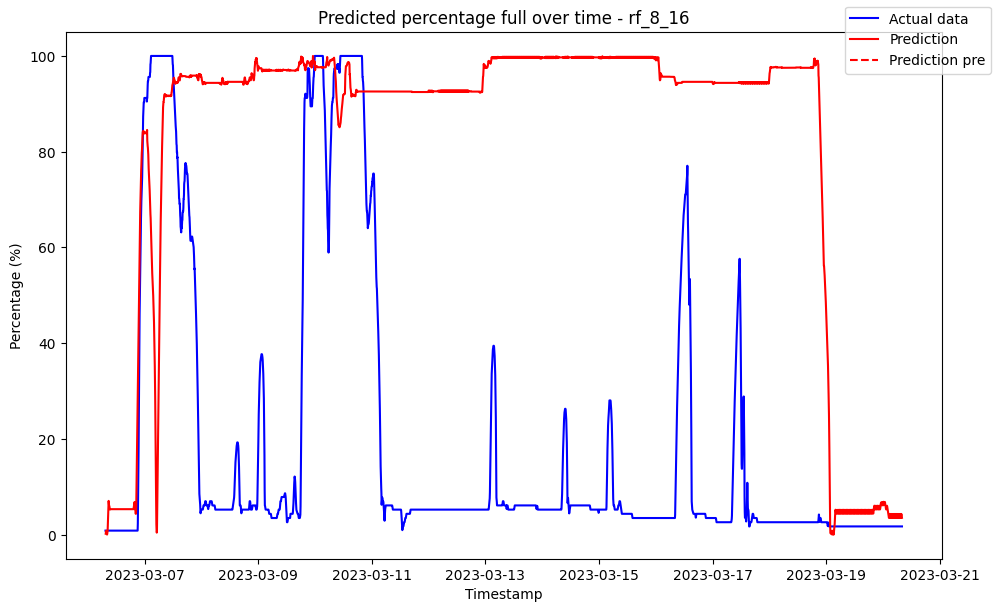

------------------------------------ rf_8_17 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.006138               0.0
1 2023-03-06 07:35:00            0.153275               0.0
2 2023-03-06 07:40:00            0.532006               0.0
3 2023-03-06 07:45:00            0.664151               0.0
4 2023-03-06 07:50:00            0.715219               0.0
5 2023-03-06 07:55:00            0.406205               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09399430002901821
Variance (R²) score: 1.00


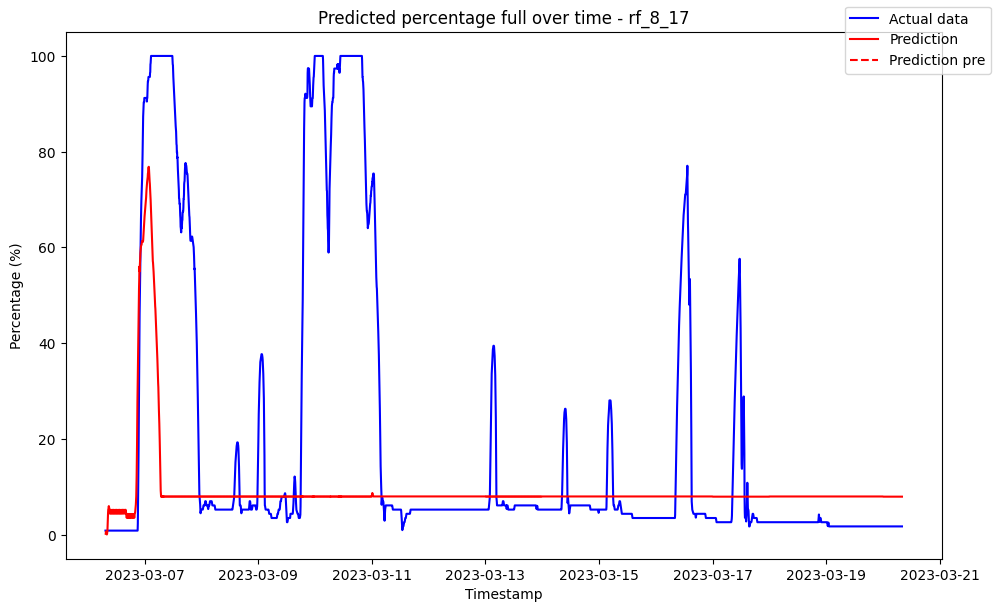

------------------------------------ rf_8_18 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.007424               0.0
1 2023-03-06 07:35:00            0.150031               0.0
2 2023-03-06 07:40:00            0.532605               0.0
3 2023-03-06 07:45:00            0.663072               0.0
4 2023-03-06 07:50:00            0.742751               0.0
5 2023-03-06 07:55:00            0.447660               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11011478018080012
Variance (R²) score: 1.00


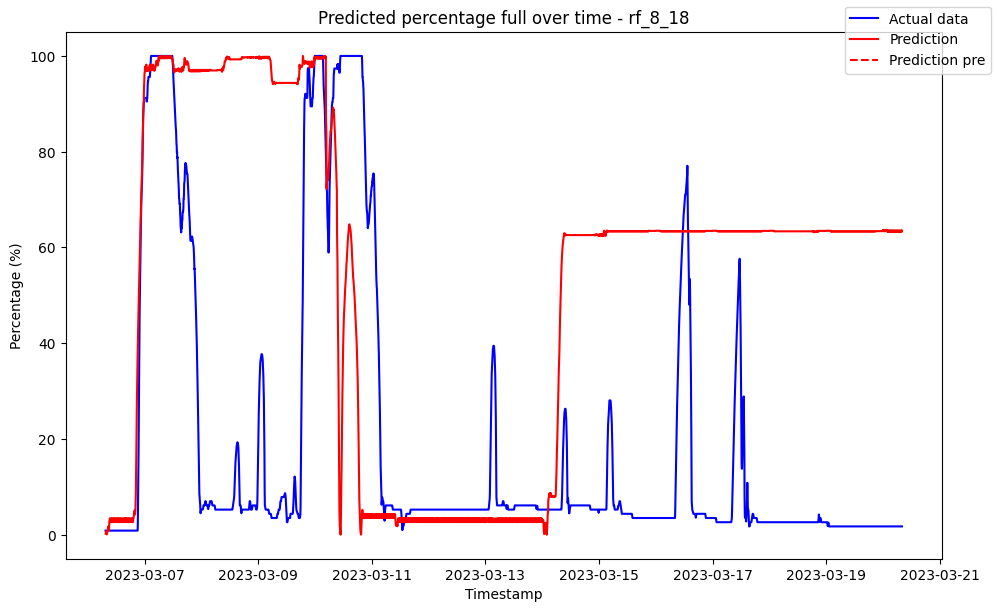

------------------------------------ rf_8_19 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005718               0.0
1 2023-03-06 07:35:00            0.141375               0.0
2 2023-03-06 07:40:00            0.525874               0.0
3 2023-03-06 07:45:00            0.837569               0.0
4 2023-03-06 07:50:00            0.749724               0.0
5 2023-03-06 07:55:00            0.449953               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.0994919298133291
Variance (R²) score: 1.00


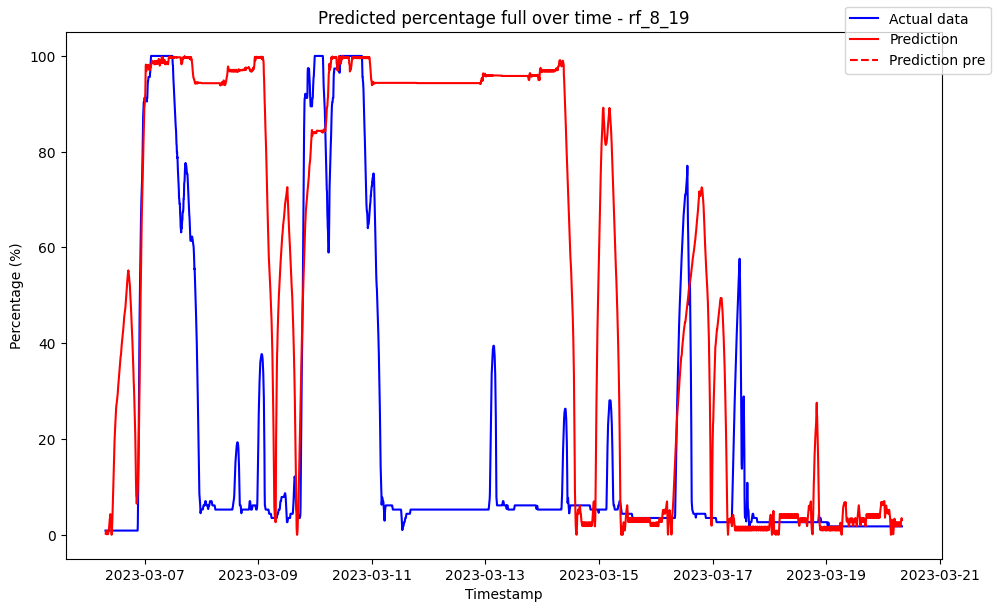

------------------------------------ rf_8_2 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            1.168676               0.0
1 2023-03-06 07:35:00            1.168676               0.0
2 2023-03-06 07:40:00            1.168676               0.0
3 2023-03-06 07:45:00            1.168676               0.0
4 2023-03-06 07:50:00            1.168676               0.0
5 2023-03-06 07:55:00            1.168676               0.0

Metrics for this specific prediction:
Accuracy: 96.57%
Mean squared error: 35.03536305837554
Variance (R²) score: 0.97


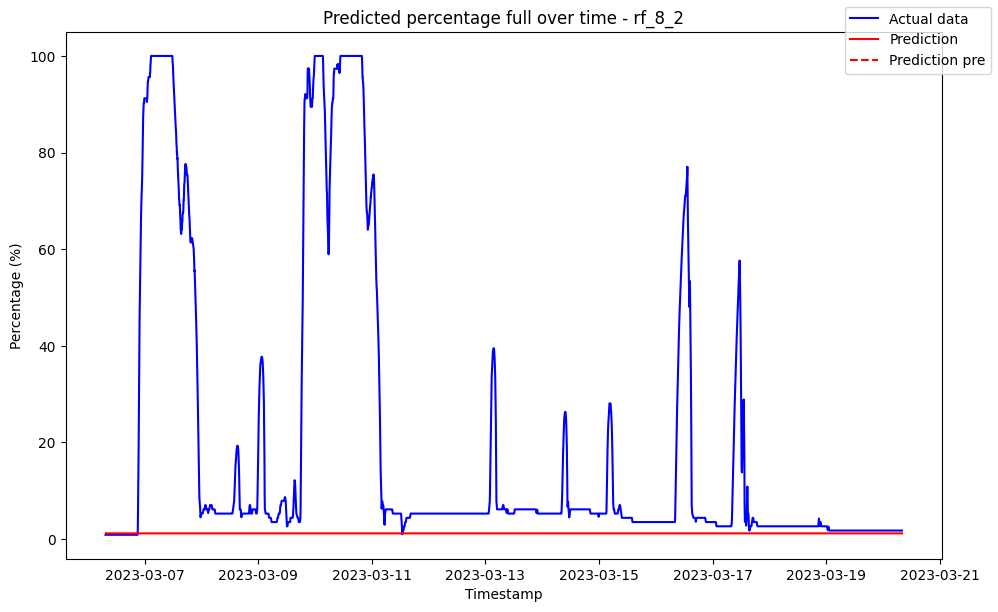

------------------------------------ rf_8_20 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.004472               0.0
1 2023-03-06 07:35:00            0.136259               0.0
2 2023-03-06 07:40:00            0.518025               0.0
3 2023-03-06 07:45:00            0.814216               0.0
4 2023-03-06 07:50:00            0.756941               0.0
5 2023-03-06 07:55:00            0.427257               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09784431876070812
Variance (R²) score: 1.00


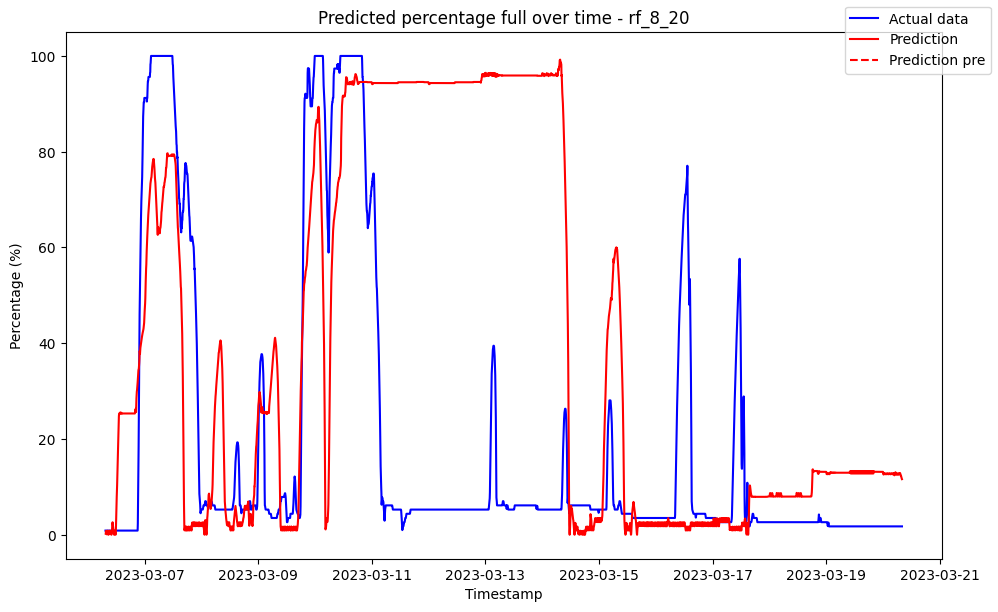

------------------------------------ rf_8_21 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.003625               0.0
1 2023-03-06 07:35:00            0.133077               0.0
2 2023-03-06 07:40:00            0.512927               0.0
3 2023-03-06 07:45:00            0.813431               0.0
4 2023-03-06 07:50:00            0.910613               0.0
5 2023-03-06 07:55:00            1.208340               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.13322698445616338
Variance (R²) score: 1.00


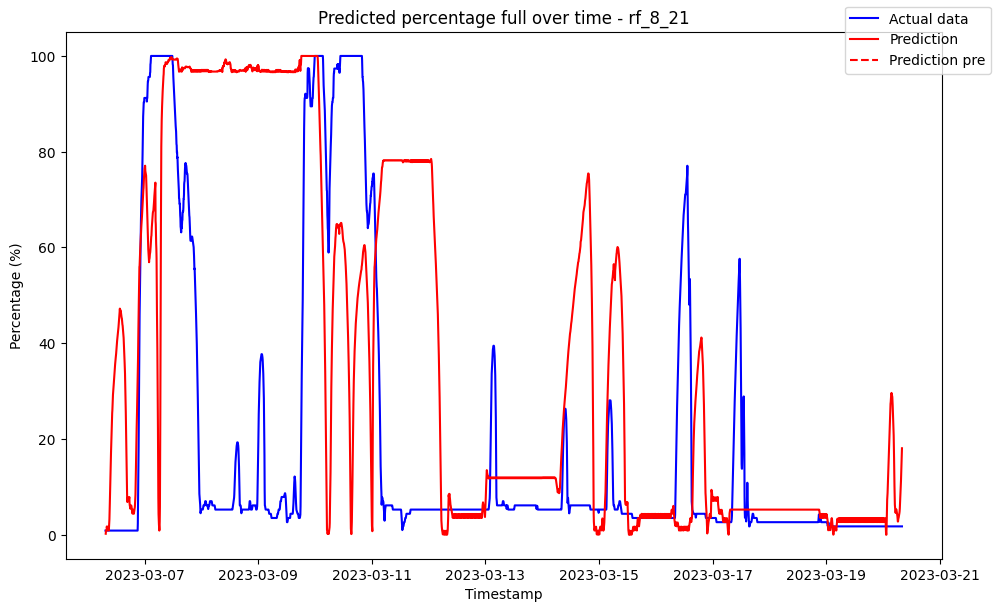

------------------------------------ rf_8_22 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.005656               0.0
1 2023-03-06 07:35:00            0.158666               0.0
2 2023-03-06 07:40:00            0.525937               0.0
3 2023-03-06 07:45:00            0.782625               0.0
4 2023-03-06 07:50:00            0.758364               0.0
5 2023-03-06 07:55:00            0.427217               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10666534672447066
Variance (R²) score: 1.00


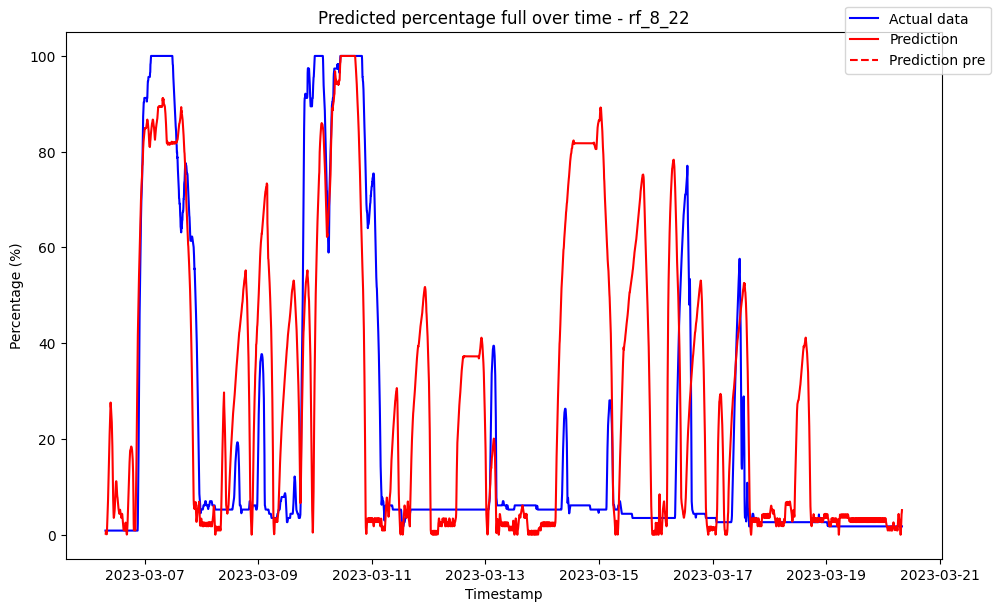

------------------------------------ rf_8_23 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000108               0.0
1 2023-03-06 07:35:00            0.000108               0.0
2 2023-03-06 07:40:00            0.000108               0.0
3 2023-03-06 07:45:00            0.000108               0.0
4 2023-03-06 07:50:00            0.000108               0.0
5 2023-03-06 07:55:00            0.000108               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09437765899035382
Variance (R²) score: 1.00


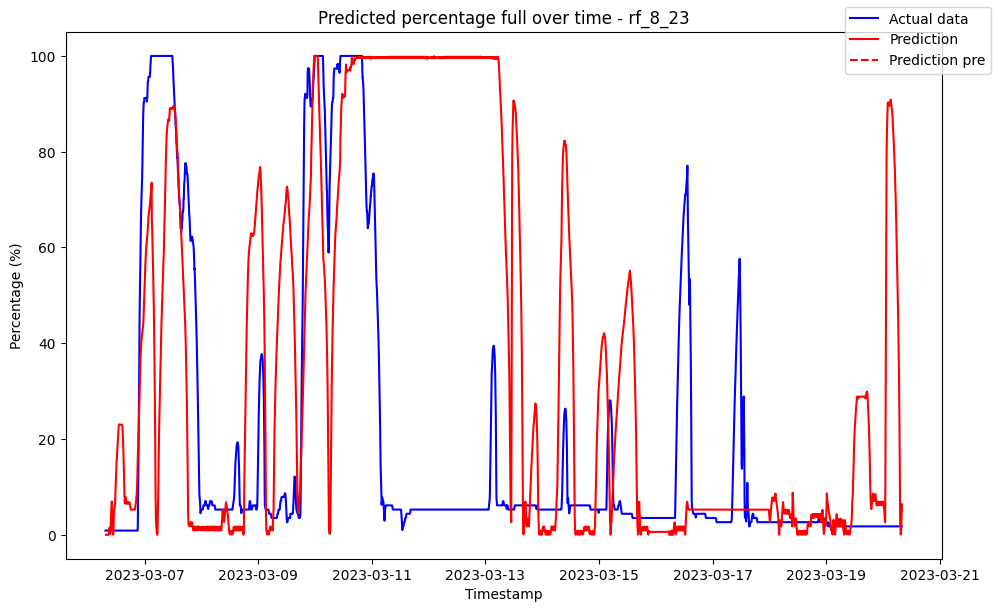

------------------------------------ rf_8_24 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.000713               0.0
1 2023-03-06 07:35:00            0.037588               0.0
2 2023-03-06 07:40:00            0.226375               0.0
3 2023-03-06 07:45:00            0.557295               0.0
4 2023-03-06 07:50:00            0.855875               0.0
5 2023-03-06 07:55:00            0.851396               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10957468231240931
Variance (R²) score: 1.00


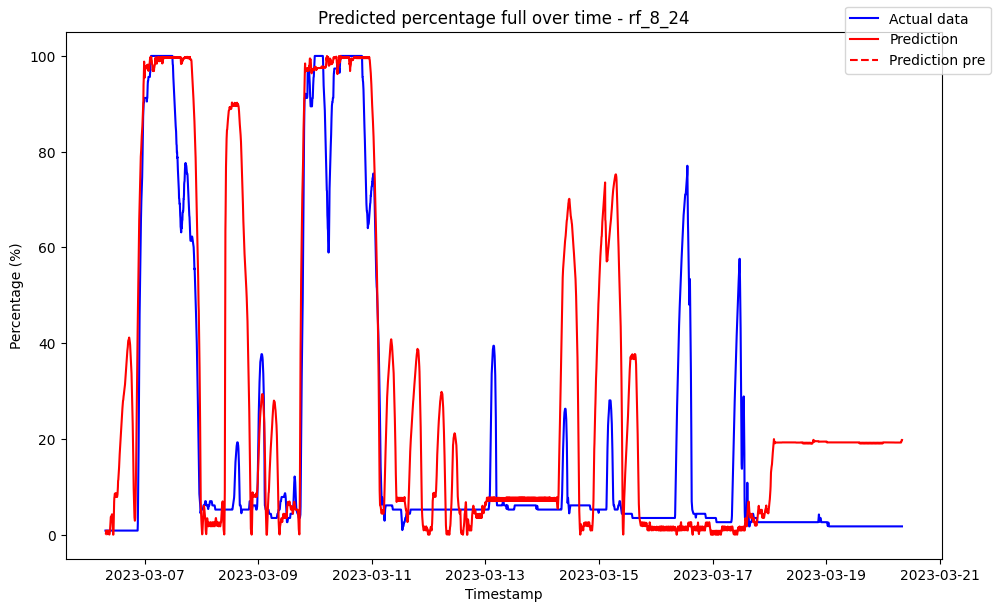

------------------------------------ rf_8_25 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10292728327542454
Variance (R²) score: 1.00


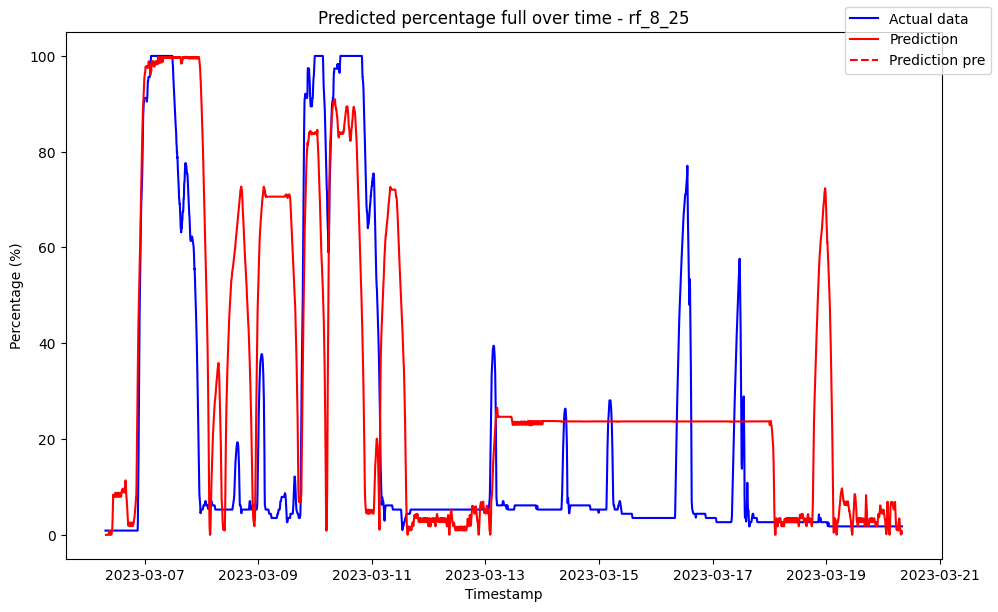

------------------------------------ rf_8_26 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.12079058723934259
Variance (R²) score: 1.00


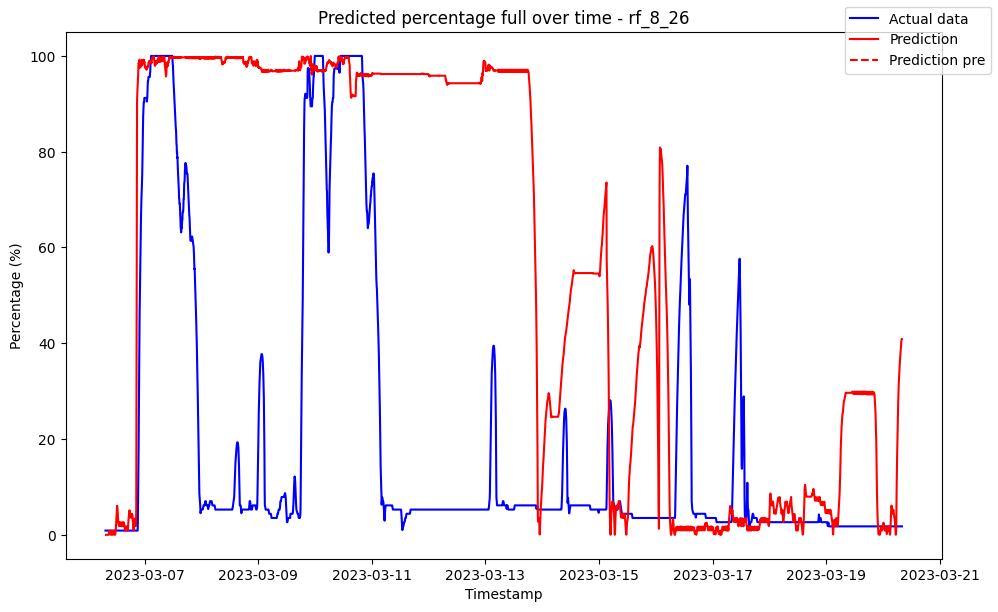

------------------------------------ rf_8_27 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.09992931939352072
Variance (R²) score: 1.00


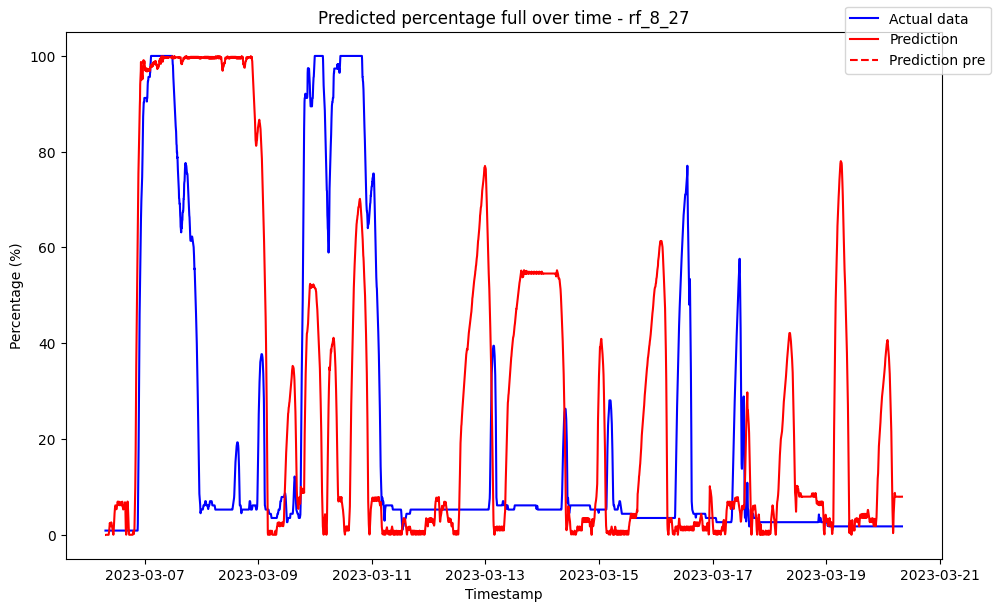

------------------------------------ rf_8_28 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11762164236616122
Variance (R²) score: 1.00


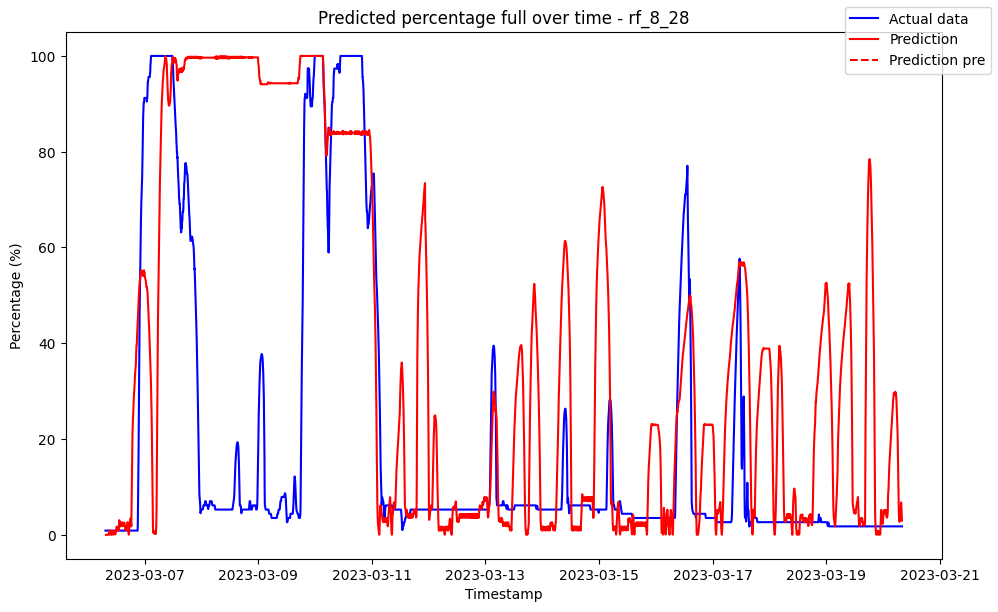

------------------------------------ rf_8_29 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11993403513120225
Variance (R²) score: 1.00


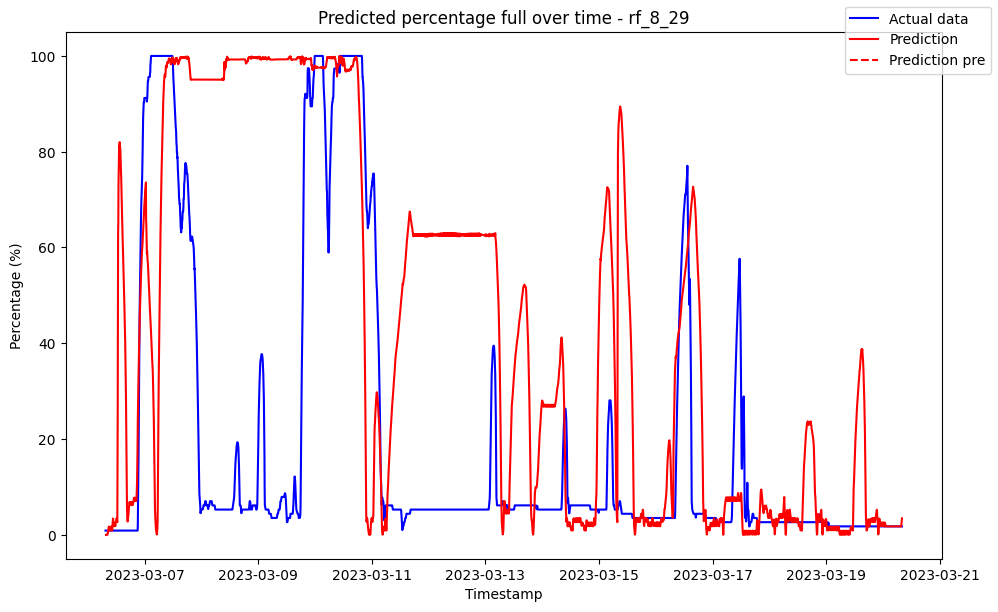

------------------------------------ rf_8_3 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00            0.367917               0.0
1 2023-03-06 07:35:00            0.367917               0.0
2 2023-03-06 07:40:00            0.367917               0.0
3 2023-03-06 07:45:00            0.367917               0.0
4 2023-03-06 07:50:00            0.367917               0.0
5 2023-03-06 07:55:00            0.367917               0.0

Metrics for this specific prediction:
Accuracy: 99.4%
Mean squared error: 6.171521954123464
Variance (R²) score: 0.99


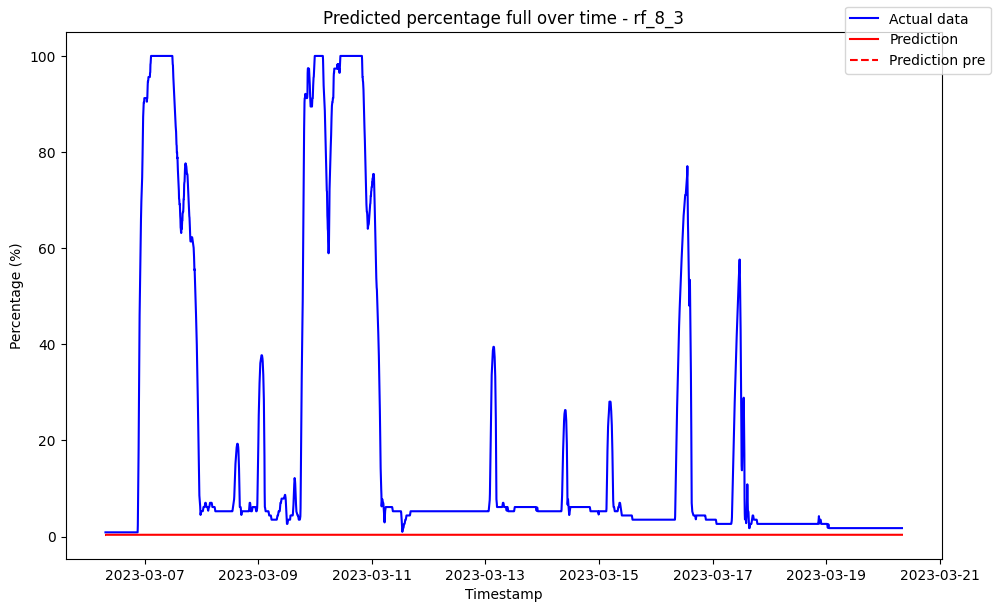

------------------------------------ rf_8_30 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.1168111630573568
Variance (R²) score: 1.00


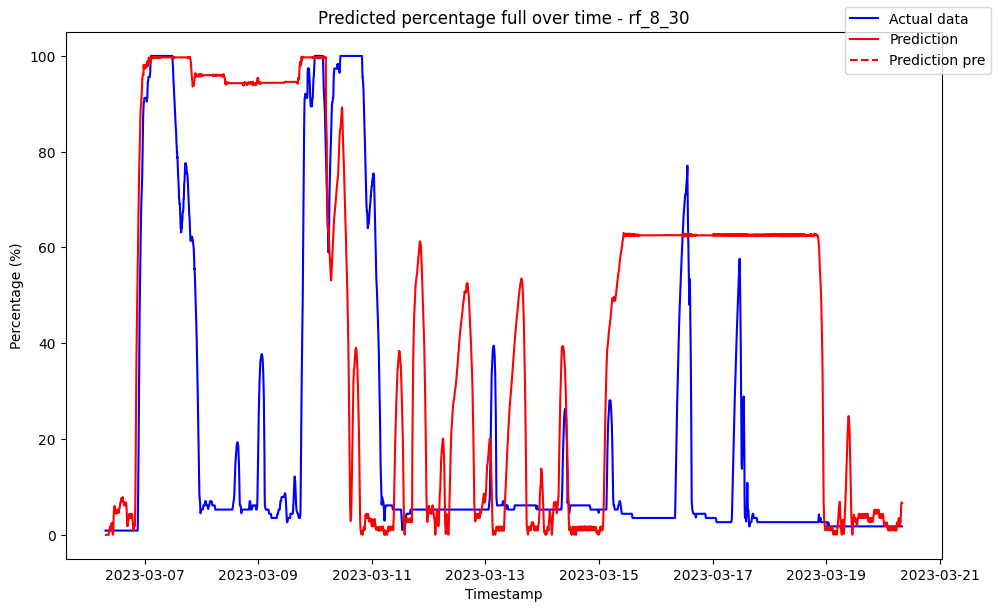

------------------------------------ rf_8_31 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.11958114274385936
Variance (R²) score: 1.00


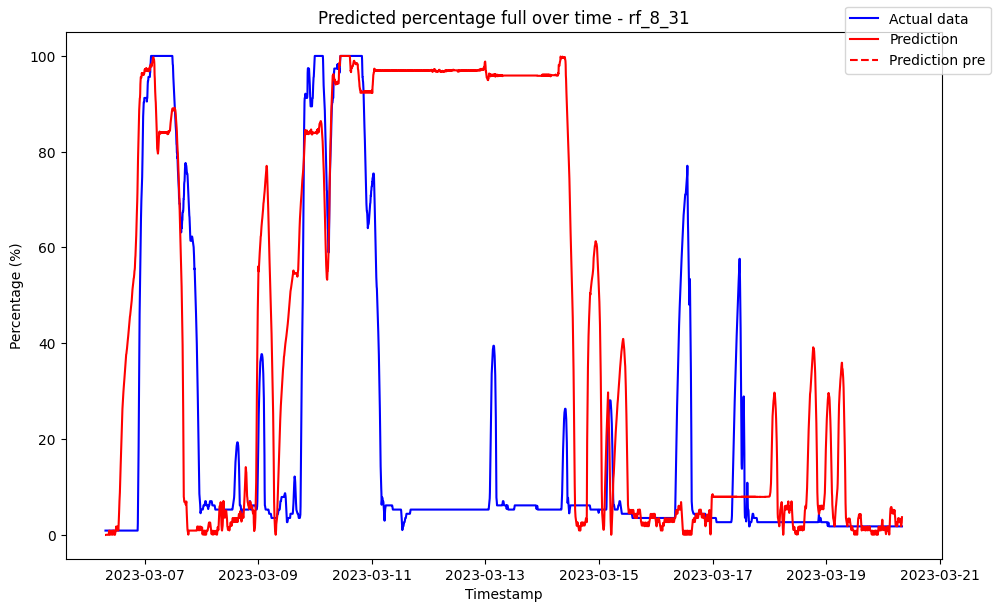

------------------------------------ rf_8_32 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0

Metrics for this specific prediction:
Accuracy: 99.99%
Mean squared error: 0.10813051401656111
Variance (R²) score: 1.00


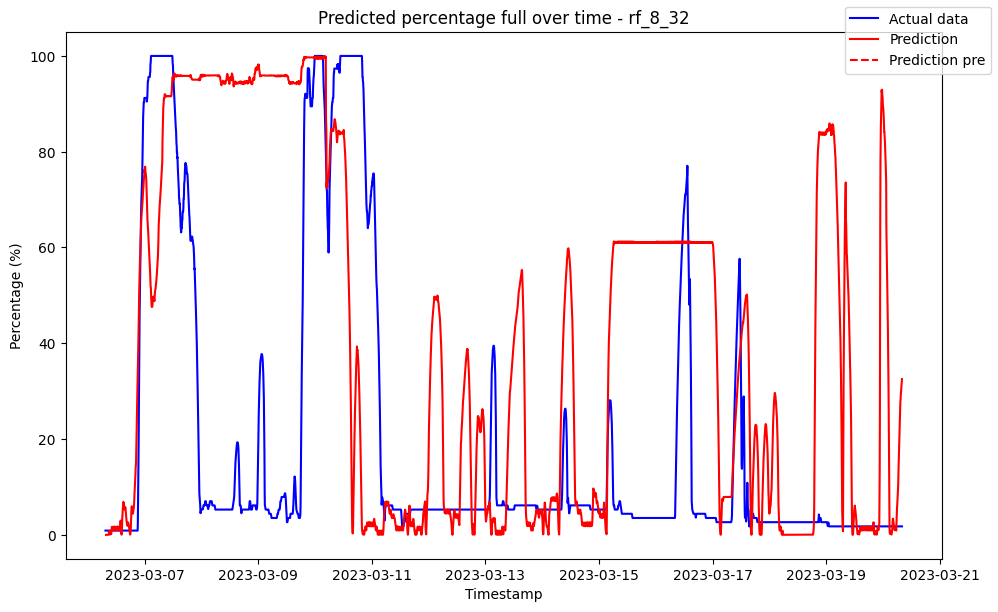

------------------------------------ rf_8_33 ------------------------------------
Pre-predictions:
             timestamp  percentage_current  rainfall_current
0 2023-03-06 07:30:00                 0.0               0.0
1 2023-03-06 07:35:00                 0.0               0.0
2 2023-03-06 07:40:00                 0.0               0.0
3 2023-03-06 07:45:00                 0.0               0.0
4 2023-03-06 07:50:00                 0.0               0.0
5 2023-03-06 07:55:00                 0.0               0.0


In [28]:
import glob

plot_against_actual = True

# if not train model
if not train_model:
    print('[[----- BEST MODELS ARE LOADED -----]]')
    # load all models from folder models\best_models, put them in a dictionary with the file name as key
    models = {}
    # files = glob.glob('models/best_models/model_*')
    files_linear_shuffled = glob.glob('models/best_models/fixed_data/linear_shuffled/model_*')
    # files_linear_shuffled_stf = glob.glob('models/best_models/fixed_data/linear_shuffled_stf/model_*')
    # files_randomforest_shuffled = glob.glob('models/best_models/fixed_data/random_forest_shuffled/model_*')
    # files_randomforest_shuffled_stf = glob.glob('models/best_models/fixed_data/random_forest_shuffled_stf/model_*')

    # files_linear_shuffled = glob.glob('models/best_models/old_data/linear_shuffled/model_*')
    # files_randomforest_shuffled = glob.glob('models/best_models/old_data/random_forest_shuffled/model_*')
    # files_randomforest_shuffled_stf = glob.glob('models/best_models/old_data/random_forest_shuffled_stf/model_*')


    # files_linear = glob.glob('models/best_models/linear/model_*')
    # files_randomforest = glob.glob('models/best_models/random_forest/model_*')

    # files = files_linear + files_randomforest + files_linear_shuffled + files_randomforest_shuffled
    files = glob.glob('models/random_forest/model_*')

    # Load the scaler from folder models\best_models
    scaler_path = glob.glob('models/best_models/scaler_*')
    scaler = pickle.load(open(scaler_path[0], 'rb'))

    for f in files:
        # model name is everything after model_ and before .pkl
        model_name = f.split('model_')[1].split('.pkl')[0]
        models[model_name] = pickle.load(open(f, 'rb'))

        # # save model with the same name
        # filename = f'models/best_models/random_forest_shuffled/model_{model_name}.pkl'
        # save_to_pickle_file(models[model_name], filename)

        weather_data_for_loaded_models = None

        if(plot_against_actual):
            weather_data_for_loaded_models = merged_df[(merged_df['timestamp'] >= start_timestamp_for_testing - pd.Timedelta(minutes=30)) & (merged_df['timestamp'] <= end_timestamp_for_testing)].copy()
        else:
            weather_data_for_loaded_models = weather_data_6_months_later

        predict_test_plot(models[model_name], scaler, model_name, start_timestamp_for_testing, end_timestamp_for_testing, weather_data_for_loaded_models, 'polygon_1663', plot_against_actual)
else:
    print('[[----- NEW MODEL USED -----]]')

    pred_df, pre_pred_df = create_predictions_df(start_timestamp_for_testing, end_timestamp_for_testing, weather_data_6_months_later, model, scaler, 'polygon_1663')

    plot_predictions_and_rainfall(pred_df, pre_pred_df, 'new model')

    if(predictions_to_excel):
        # write pred_df to excel in folder predictions
        pred_df.to_excel('predictions/pred_df_' + datetime.now().strftime("%Y%m%d-%H%M%S") + '.xlsx', index=False)
        pre_pred_df.to_excel('predictions/pre_pred_df_' + datetime.now().strftime("%Y%m%d-%H%M%S") + '.xlsx', index=False)